# ARIMAX_SE with GRIDSEARCH_CV and PCA on ADM0, QUARTERLY

In [1]:
import pandas as pd

# pd.set_option('display.max_rows', 500)
# pd.set_option('display.max_columns', 500)

import warnings
warnings.simplefilter('ignore')

import warnings
from statsmodels.tools.sm_exceptions import ConvergenceWarning
warnings.simplefilter('ignore', ConvergenceWarning)
    
import time
import datetime

import os

## Model Specifications

In [2]:
TARGET_VARIABLE = "SUM(FATALITIES)"
SEASONAL_PERIODICITY = 4 # for data frequency & seasonality S

SEASONALITY = False
NEIGHBORS = False # X_N
SOCIO_ECO_VARS = True # X_SE
N_LAGS_X = 1 # todo: remove or change behavior from max lags to lag
DIM_REDUCTION_METHOD = "PCA"

if SEASONALITY:
    CV_FOLDS = 5
else:
    CV_FOLDS = 5

In [3]:
MODEL_NAME = ""
if SEASONALITY:
    MODEL_NAME += "S" 
    
MODEL_NAME += "ARIMA"

if SOCIO_ECO_VARS and NEIGHBORS:
    MODEL_NAME += "X_SE+N"
    
if SOCIO_ECO_VARS and not NEIGHBORS:
    MODEL_NAME += "X_SE"
    
if not SOCIO_ECO_VARS and NEIGHBORS:
    MODEL_NAME += "X_N"
    
if SEASONAL_PERIODICITY ==  12:
    MODEL_NAME += "_MONTHLY"
elif SEASONAL_PERIODICITY == 4:
    MODEL_NAME += "_QUARTERLY"

MODEL_NAME

'ARIMAX_SE_QUARTERLY'

### Hyperparameter Grid

In [4]:
# create a set of sarima configs to try
PARAM_GRID = list()
# parameter options to try

### PCA
if NEIGHBORS or SOCIO_ECO_VARS:
    n_components = range(0, 4) # include up to three main components
else:
    n_components = [0]
    

### ARMA
p_params = range(4) # AR 3
d_params = range(2) # Differencing 1
q_params = range(4) # MA 3


### SEASONALITY
if SEASONALITY:
    P_params = range(3) # 5
    D_params = range(2) # 1
    Q_params = range(3) # 2
    
    ### TREND
    # t_params = ['n','c','t','ct'] # Form of Trend
    # t_params = ['n', 't', 'ct'] # Form of Trend
    t_params = ["n"]

    ### SEASONAL PERIODICITY
    m_params = [SEASONAL_PERIODICITY]   
else:
    P_params = [0]
    D_params = [0]
    Q_params = [0]

    t_params = ["n"] # Form of Trend

    m_params = [0] 

for n in n_components:
    for p in p_params:
        for d in d_params:
            for q in q_params:
                for P in P_params:
                    for D in D_params:
                        for Q in Q_params:
                            for m in m_params:
                                for t in t_params:
                                    cfg = [n, (p, d, q), (P, D, Q, m), t]
                                    PARAM_GRID.append(cfg)
len(PARAM_GRID)    

128

## Model Training

In [5]:
from common_functions import *
from forecasters import *

#### Training Method

In [6]:
def sarimax(target_variable="SUM(FATALITIES)", 
            target_country="MLI", 
            predictor_countries=["BFA"], 
            n_lags_X = N_LAGS_X, 
            seasonal_periodicity = SEASONAL_PERIODICITY):
        
    ### GET DATA
    y, X = getData(target_variable = target_variable, 
                   target_country = target_country, 
                   predictor_countries = predictor_countries,
                   socio_eco_vars = SOCIO_ECO_VARS,
                   n_lags_X = N_LAGS_X, 
                   seasonal_periodicity = SEASONAL_PERIODICITY)
    
    ### SPLIT DATA
    X_train, X_test, y_train, y_test = train_test_split(y = y,
                                                        X = X, 
                                                        forecast_horizon = SEASONAL_PERIODICITY)
    
    ### TRAINING WITH GRIDSEARCHCV
    gscv = GridSearchCV(param_grid = PARAM_GRID,
                        forecaster = TimeSeriesForecasterPCA_LinInt,
                        seasonal_periodicity = SEASONAL_PERIODICITY,
                        cv_folds = CV_FOLDS)
    training_res = gscv.train(X_train, y_train)

    if training_res is not None:
        model = gscv
        # print ARIMA summary
        print(training_res)
        print(model.best_model_result.mle_retvals)
        plt.tight_layout()
        try:
            model.best_model_result.plot_diagnostics(figsize=(16*0.7, 10*0.7), lags = SEASONAL_PERIODICITY+1)
        except: 
            pass
        best_parameters = str(model.best_model_cv_results)
        
    else:
        print("No model fitted --> Prediction with Naive Model ")
        model = NoChange().fit(X_train, y_train)
        best_parameters = np.nan
        
    ### PREDICTION
    prediction_results = model.evaluate_model(X_test, y_test, fh = SEASONAL_PERIODICITY)
    
    if prediction_results["FAT_PRED"].isnull().values.any():
        model = NoChange().fit(X_train, y_train)
        print("Model Prediction failed --> Prediction with Naive Model ")
        model = NoChange().fit(X_train, y_train)
        best_parameters = np.nan
        prediction_results = model.evaluate_model(X_test, y_test, fh = SEASONAL_PERIODICITY)
    
    ### ADJUST RESULT DF
    prediction_results["GID_0"] = target_country
    prediction_results["MONTH"] = pd.to_datetime(prediction_results["MONTH"].astype(str)) 
    prediction_results["PARAMETERS"] = best_parameters

    print(prediction_results)

    return prediction_results

#### Automated Training for all 234 Countries 

In [7]:
acled_monthly_adm0 = pd.read_csv("../data/TB003_EVENT_OUTCOMES_MONTHLY_START_DATE.csv")
gid0_neighbors = pd.read_csv("../data/GID_0_Neighbours.csv")
# gid_list = acled_monthly_adm0["GID_0"].unique()[::-1] #reverse
gid_list = acled_monthly_adm0["GID_0"].unique()
len(gid_list)

234

######## ABW (1/234) #########
0
Neighbor countries: []
Getting Data for ABW
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (13, 35)
y: (13, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ABW   No. Observations:                    9
Model:                         SARIMAX   Log Likelihood                  95.346
Date:                 Wed, 19 Oct 2022   AIC                           -188.692
Time:                         10:23:28   BIC                           -188.495
Sample:                     01-31-2019   HQIC                          -189.117
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err

<Figure size 432x288 with 0 Axes>

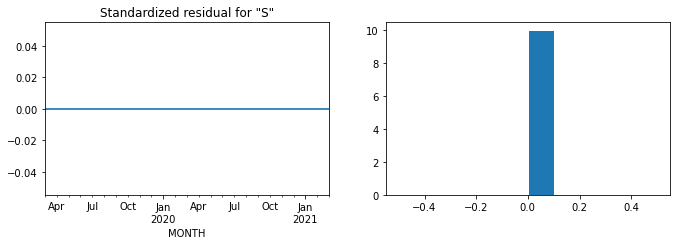

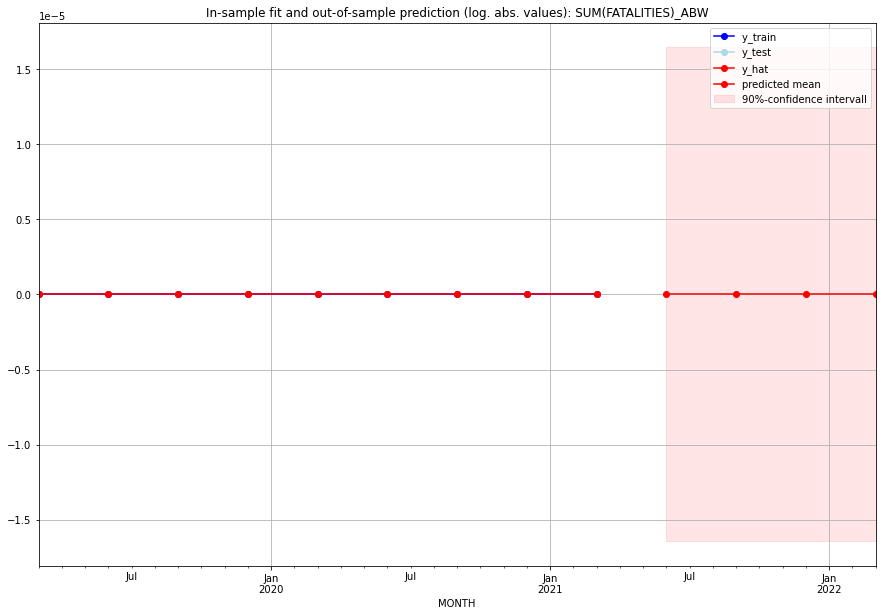

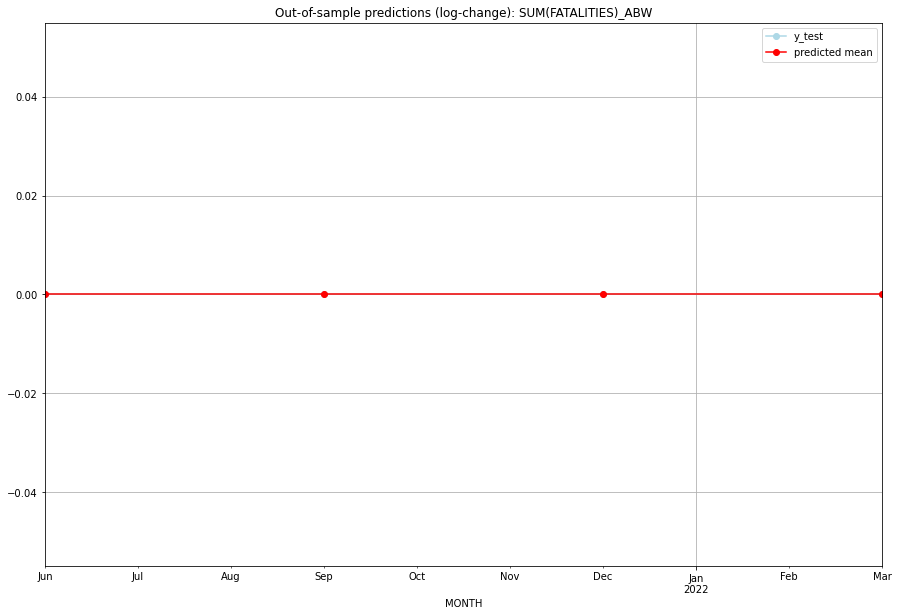

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ABW   
1 2021-07-01       0.0         0.0           0.0             0.0   ABW   
2 2021-10-01       0.0         0.0           0.0             0.0   ABW   
3 2022-01-01       0.0         0.0           0.0             0.0   ABW   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:05
######## AFG (2/234) #########
0
Neighbor countries: []
Getting Data for AFG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (21, 55)
y: (21, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.17358064382505733, 'fold_results': [0.18944796057995017, nan, 0.1577133270701645]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_AFG   No. Observations:                   17
Model:                SARIMAX(3, 0, 2)   Log Likelihood                  -0.398
Date:                 Wed, 19 Oct 2022   AIC                             14.797
Time:                         10:24:01   BIC                             20.629
Sample:                     01-31-2017   HQIC                            15.376
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0332 

<Figure size 432x288 with 0 Axes>

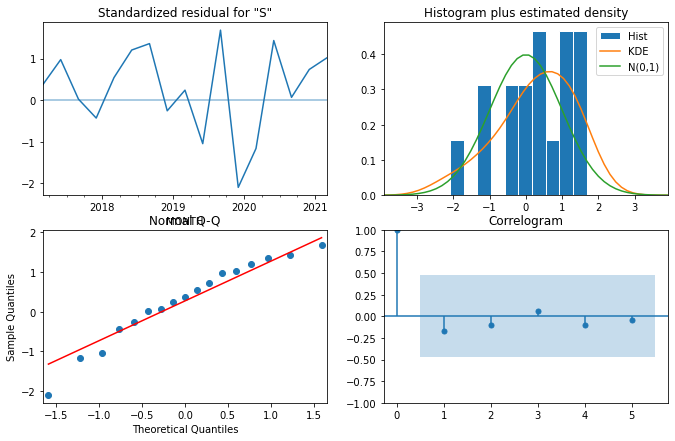

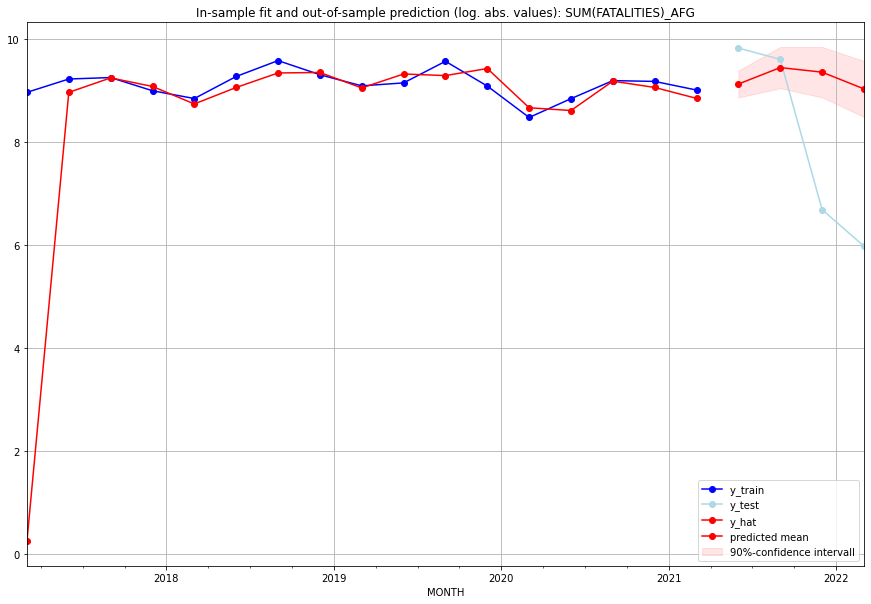

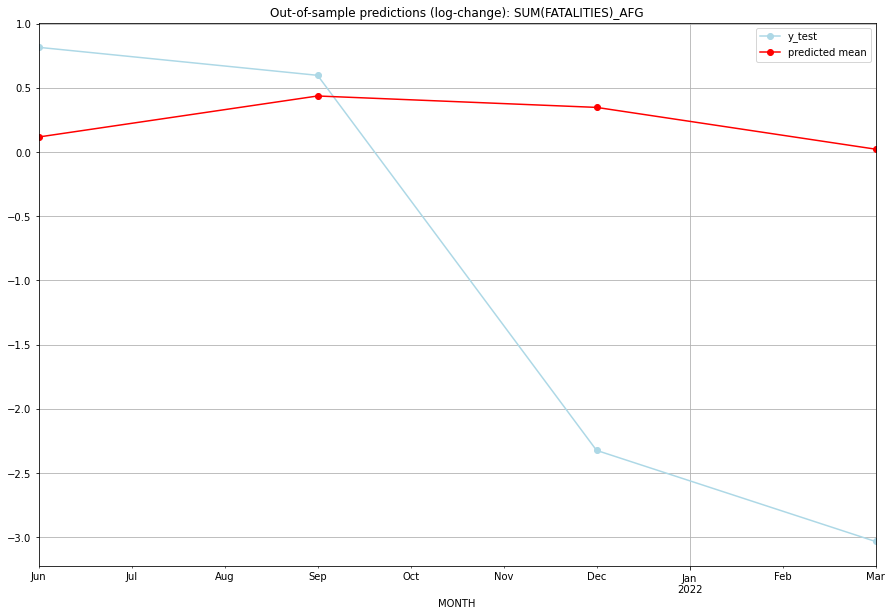

TADDA: 1.7388387284467677
Evaluation finished.
       MONTH      FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   9236.984675     18574.0      0.117119        0.815611   AFG   
1 2021-07-01  12714.040693     14933.0      0.436580        0.597435   AFG   
2 2021-10-01  11632.935615       804.0      0.347721       -2.323118   AFG   
3 2022-01-01   8402.559991       395.0      0.022450       -3.032546   AFG   

                                          PARAMETERS  
0  {'params': [1, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:35
######## AGO (3/234) #########
0
Neighbor countries: []
Getting Data for AGO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 60)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEA

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 1.337326770128405, 'fold_results': [2.8531033531564445, 0.9235588157846686, 0.6634954469135176, 1.257984644815724, 0.9884915899716716]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_AGO   No. Observations:                   96
Model:                SARIMAX(2, 1, 2)   Log Likelihood                -164.696
Date:                 Wed, 19 Oct 2022   AIC                            345.393
Time:                         10:24:27   BIC                            365.824
Sample:                     04-30-1997   HQIC                           353.648
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

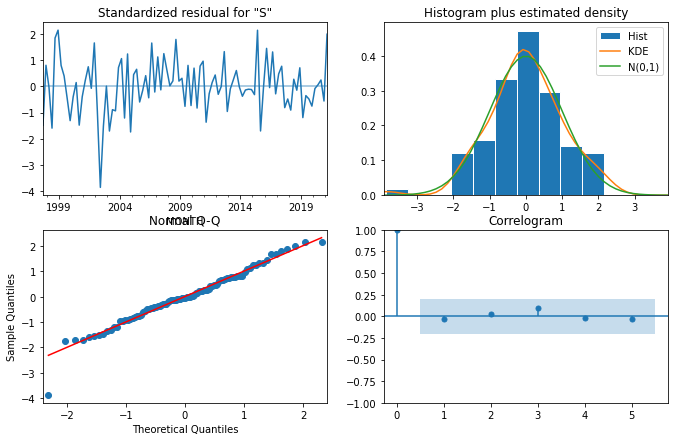

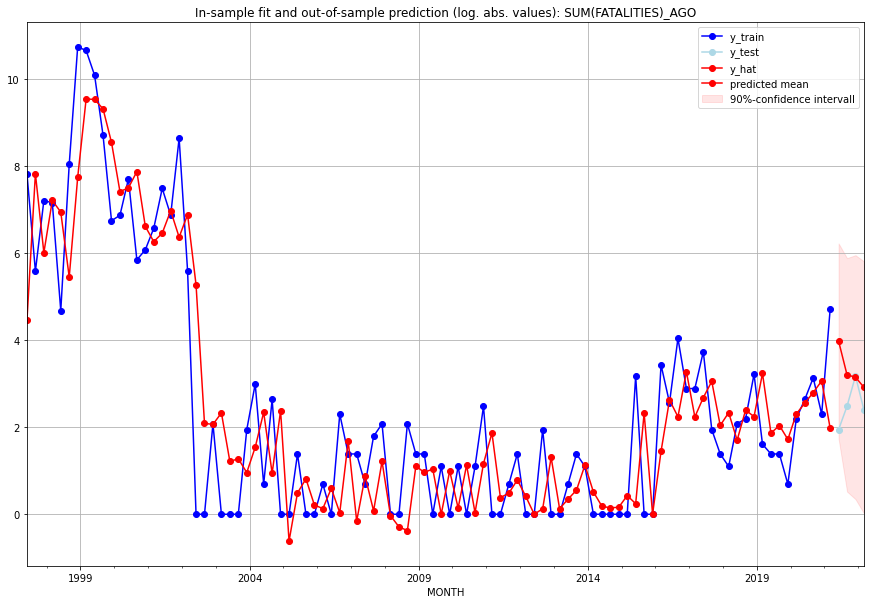

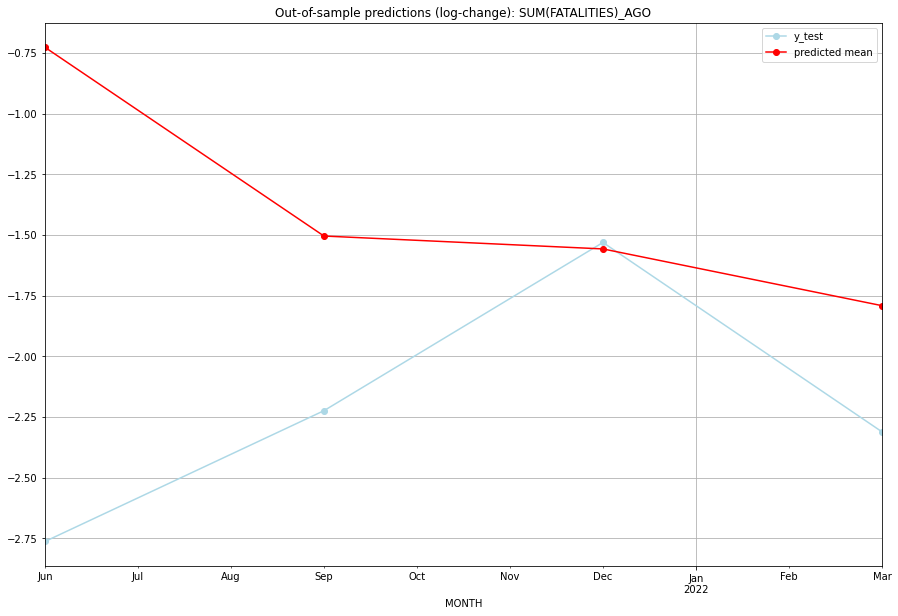

TADDA: 0.8256335405688191
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  52.640922         6.0     -0.727218       -2.763620   AGO   
1 2021-07-01  23.647066        11.0     -1.504872       -2.224624   AGO   
2 2021-10-01  22.370988        23.0     -1.558035       -1.531476   AGO   
3 2022-01-01  17.499019        10.0     -1.791813       -2.311635   AGO   

                                          PARAMETERS  
0  {'params': [3, (2, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (2, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (2, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (2, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## AIA (4/234) #########
0
Neighbor countries: []
Getting Data for AIA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient

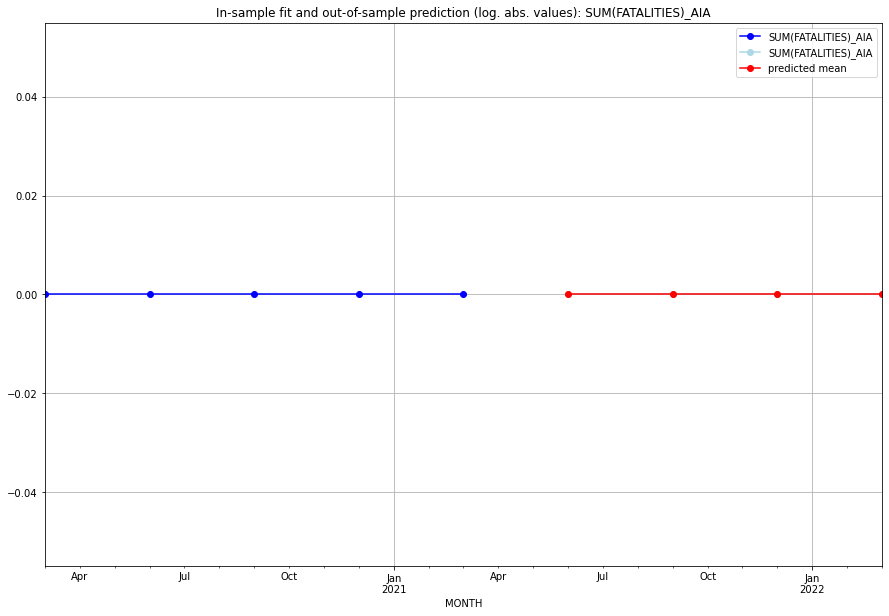

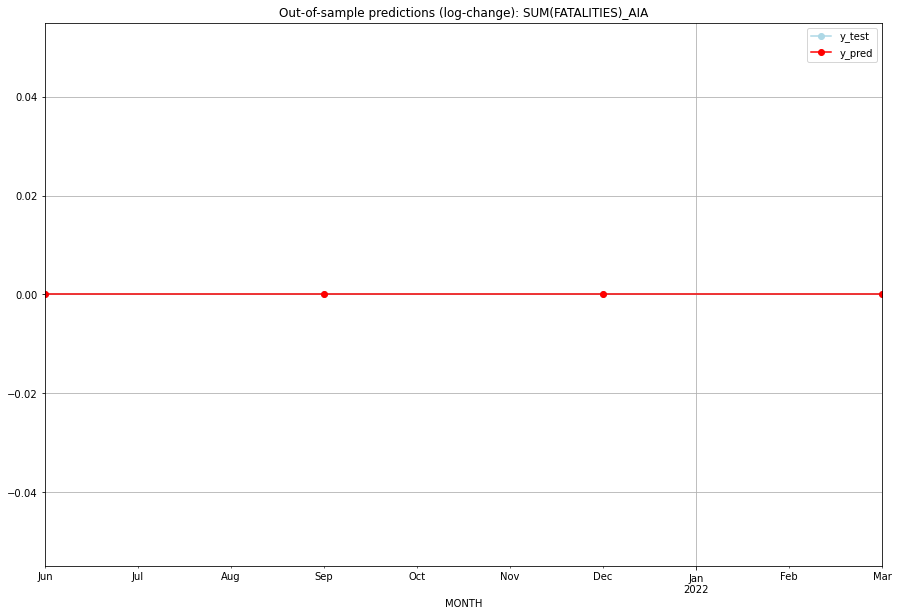

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   AIA   
1 2021-07-01       0.0         0.0           0.0             0.0   AIA   
2 2021-10-01       0.0         0.0           0.0             0.0   AIA   
3 2022-01-01       0.0         0.0           0.0             0.0   AIA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## ALA (5/234) #########
0
Neighbor countries: []
Getting Data for ALA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


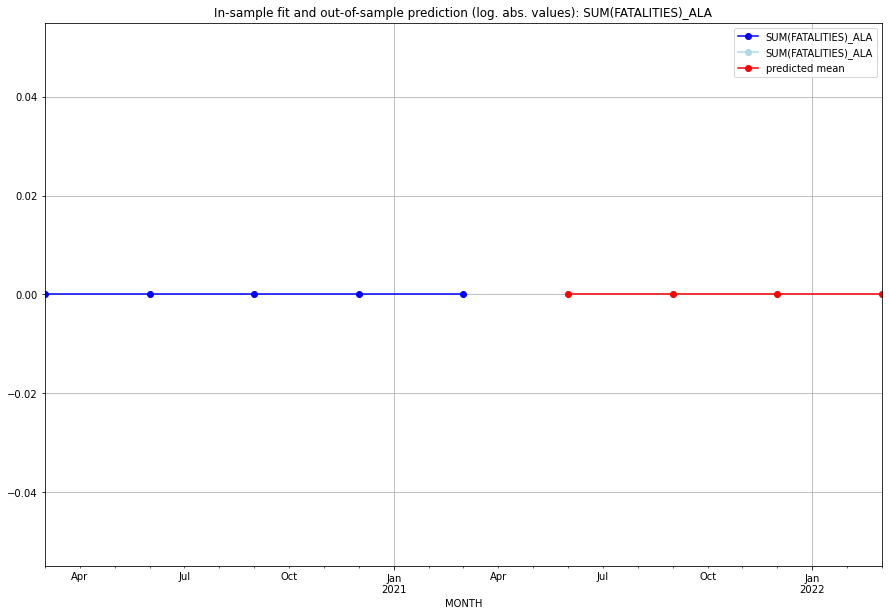

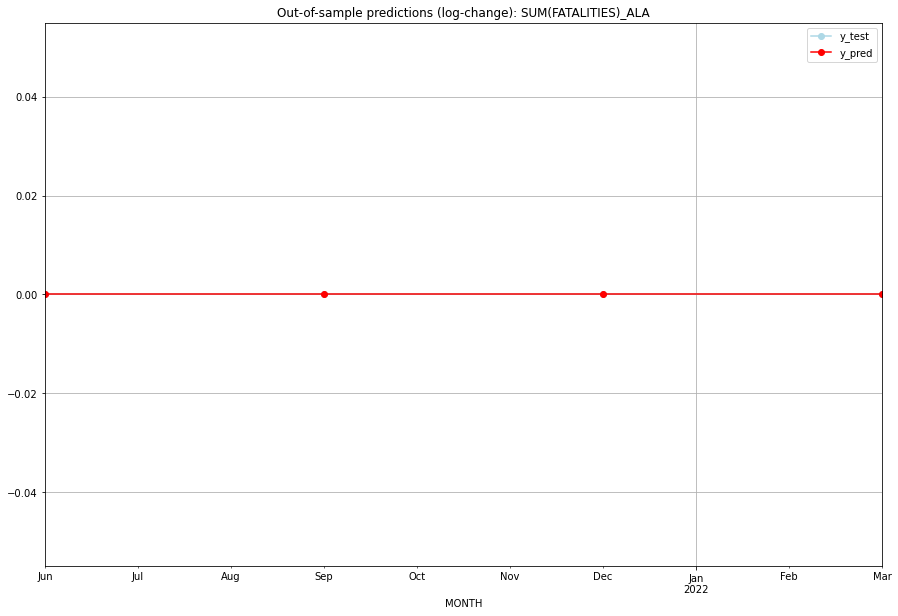

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ALA   
1 2021-07-01       0.0         0.0           0.0             0.0   ALA   
2 2021-10-01       0.0         0.0           0.0             0.0   ALA   
3 2022-01-01       0.0         0.0           0.0             0.0   ALA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## ALB (6/234) #########
0
Neighbor countries: []
Getting Data for ALB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 63)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ALB   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:24:34   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.245      0.000       0.025       0

<Figure size 432x288 with 0 Axes>

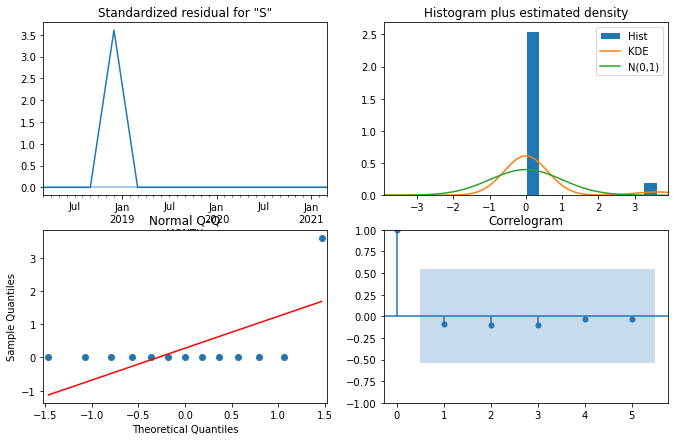

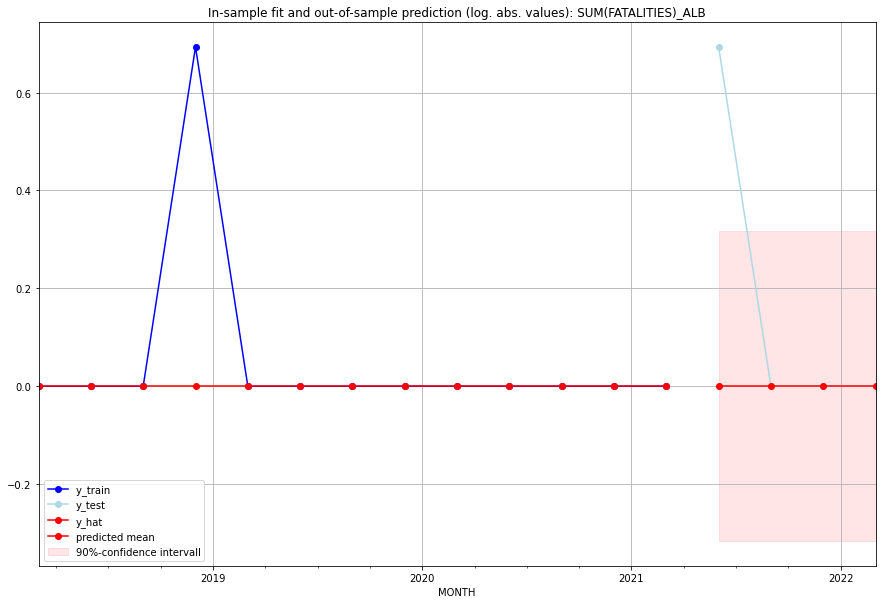

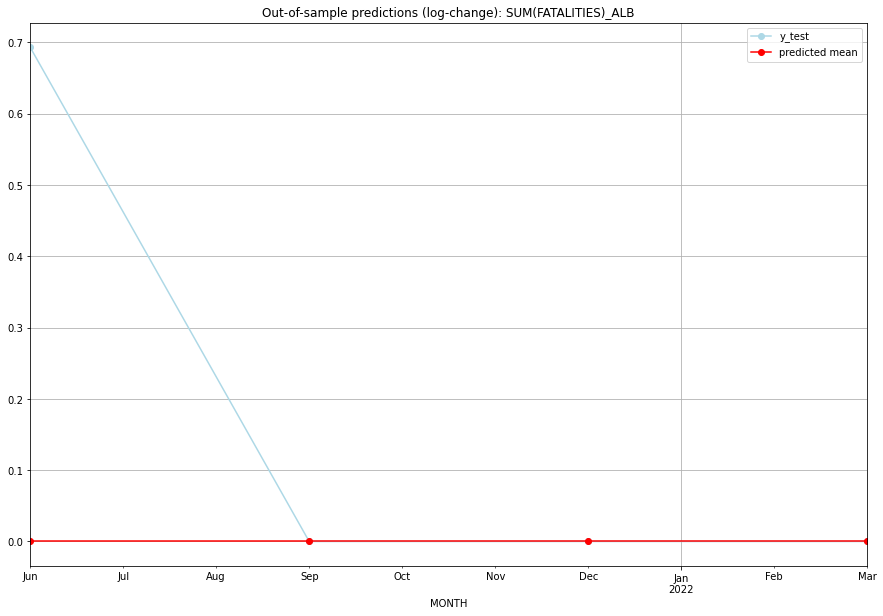

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         1.0           0.0        0.693147   ALB   
1 2021-07-01       0.0         0.0           0.0        0.000000   ALB   
2 2021-10-01       0.0         0.0           0.0        0.000000   ALB   
3 2022-01-01       0.0         0.0           0.0        0.000000   ALB   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:06
######## AND (7/234) #########
0
Neighbor countries: []
Getting Data for AND
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 30)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient da

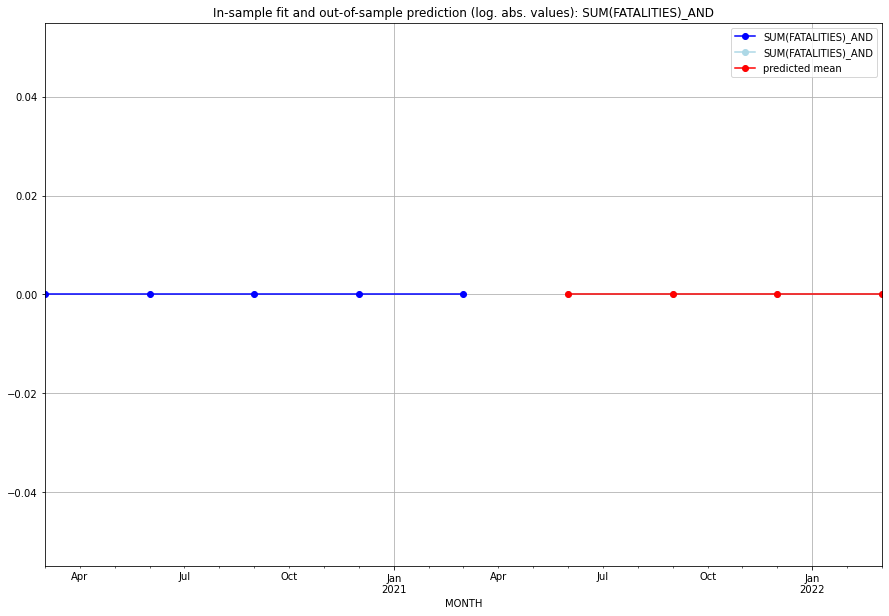

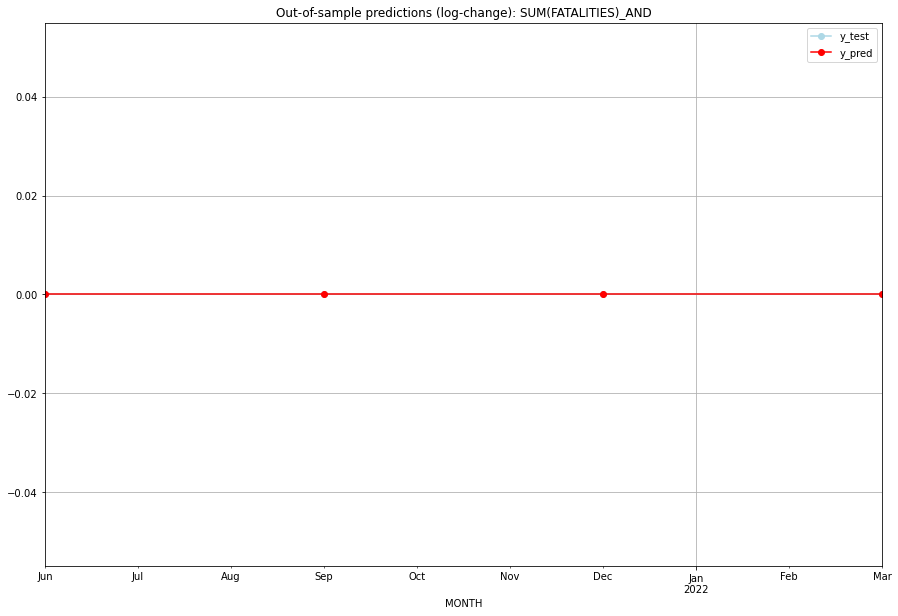

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   AND   
1 2021-07-01       0.0         0.0           0.0             0.0   AND   
2 2021-10-01       0.0         0.0           0.0             0.0   AND   
3 2022-01-01       0.0         0.0           0.0             0.0   AND   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## ARE (8/234) #########
0
Neighbor countries: []
Getting Data for ARE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (21, 54)
y: (21, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ARE   No. Observations:                   17
Model: 

<Figure size 432x288 with 0 Axes>

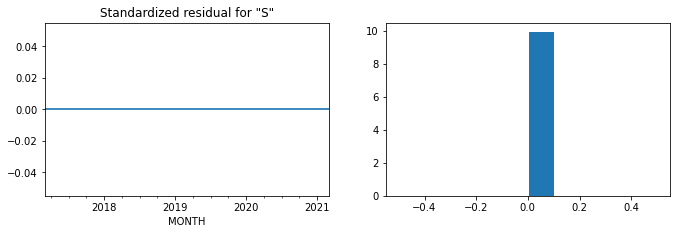

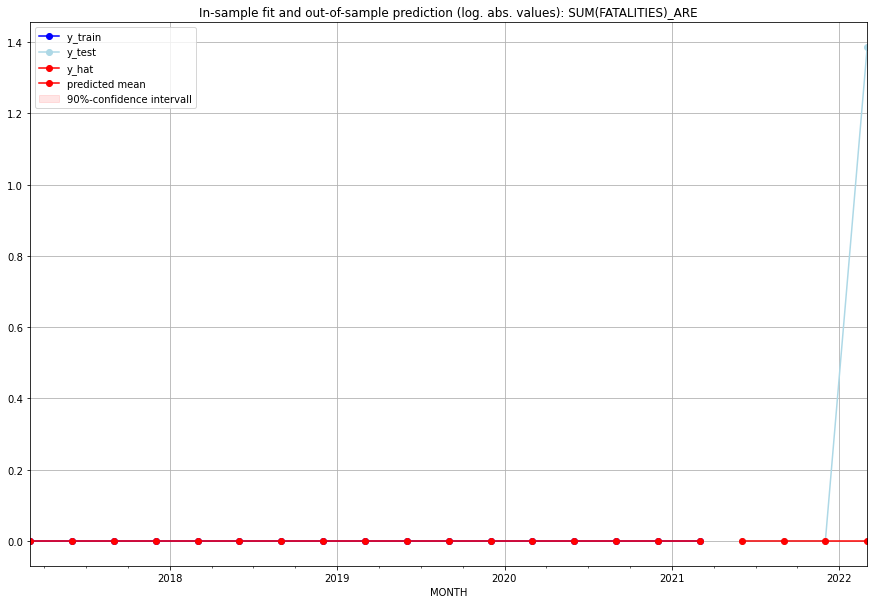

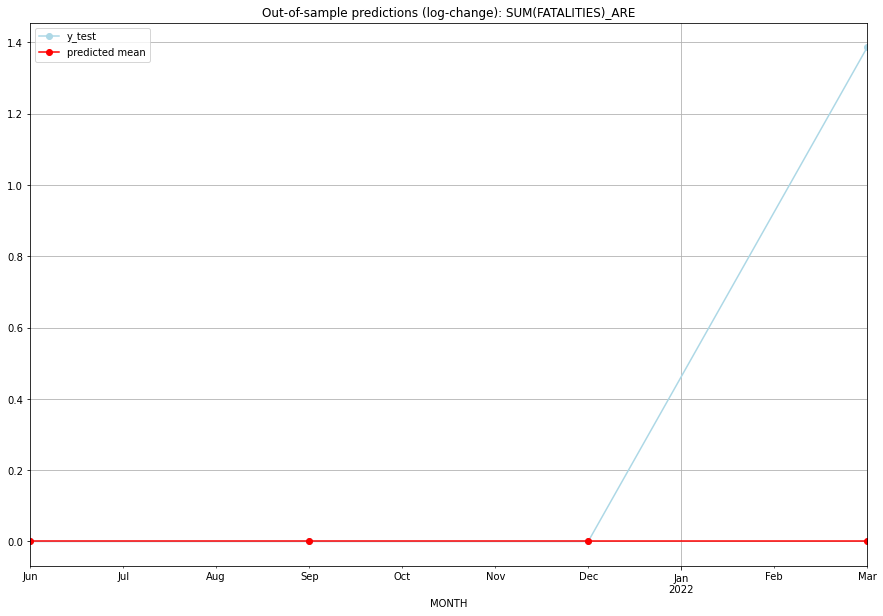

TADDA: 0.34657359027997264
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   ARE   
1 2021-07-01       0.0         0.0           0.0        0.000000   ARE   
2 2021-10-01       0.0         0.0           0.0        0.000000   ARE   
3 2022-01-01       0.0         3.0           0.0        1.386294   ARE   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:01
######## ARG (9/234) #########
0
Neighbor countries: []
Getting Data for ARG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 61)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.7679004127392066, 'fold_results': [0.7394839026917803, 0.7963169227866329]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ARG   No. Observations:                   13
Model:                SARIMAX(1, 0, 1)   Log Likelihood                 -11.304
Date:                 Wed, 19 Oct 2022   AIC                             28.607
Time:                         10:24:45   BIC                             30.302
Sample:                     01-31-2018   HQIC                            28.259
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9844      0.

<Figure size 432x288 with 0 Axes>

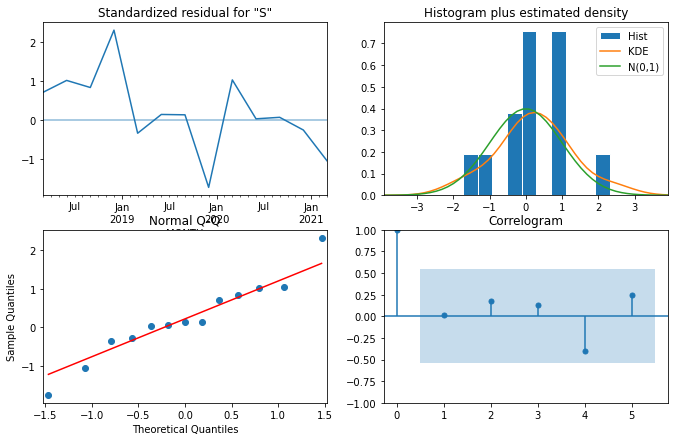

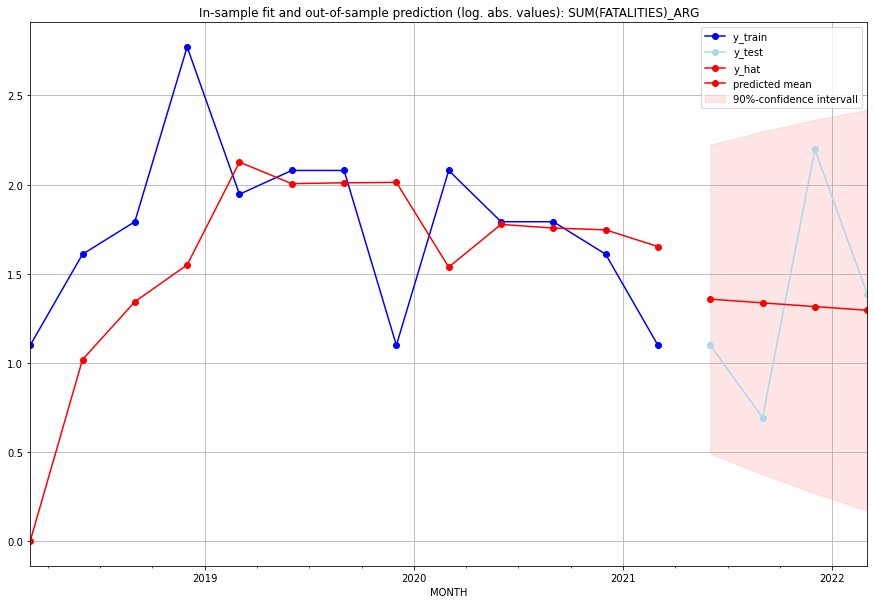

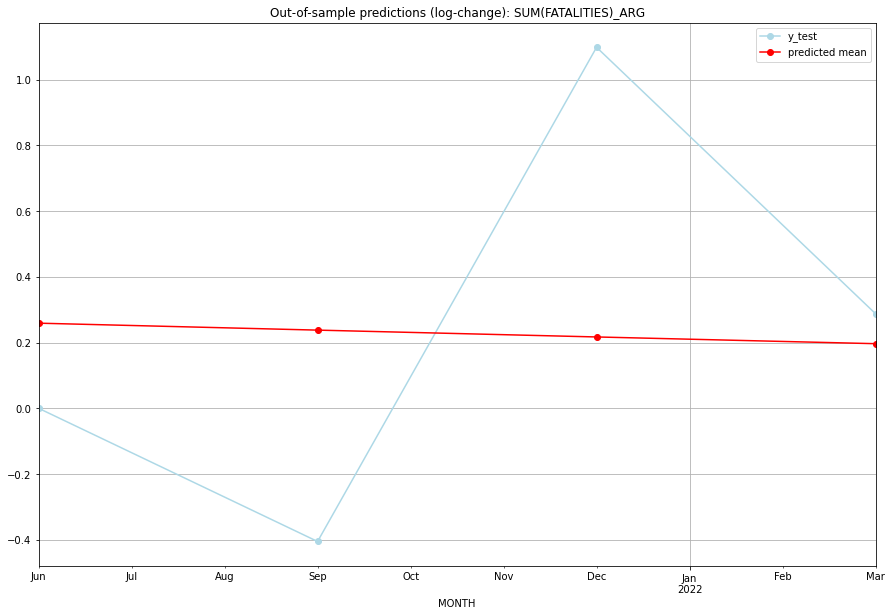

TADDA: 0.5282148076552571
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2.886891         2.0      0.258997        0.000000   ARG   
1 2021-07-01  2.805593         1.0      0.237859       -0.405465   ARG   
2 2021-10-01  2.727221         8.0      0.217051        1.098612   ARG   
3 2022-01-01  2.651646         3.0      0.196566        0.287682   ARG   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:06
######## ARM (10/234) #########
0
Neighbor countries: []
Getting Data for ARM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 62)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU core

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.34657359027997264, 'fold_results': [0.34657359027997264, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ARM   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                 -17.308
Date:                 Wed, 19 Oct 2022   AIC                             46.616
Time:                         10:24:54   BIC                             50.005
Sample:                     01-31-2018   HQIC                            45.919
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3138      1.669      0.18

<Figure size 432x288 with 0 Axes>

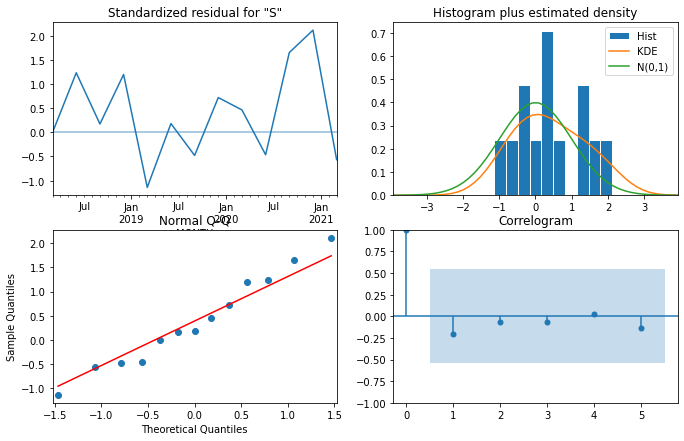

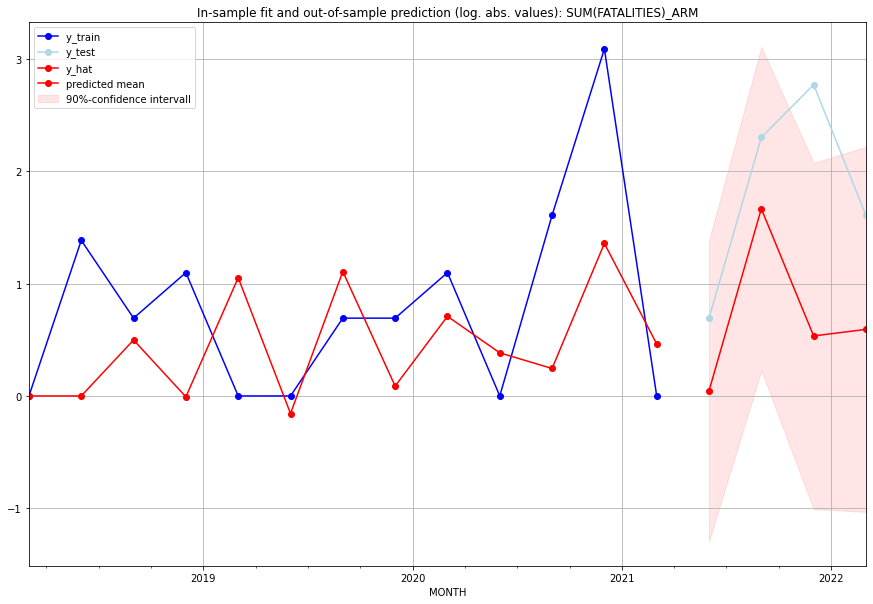

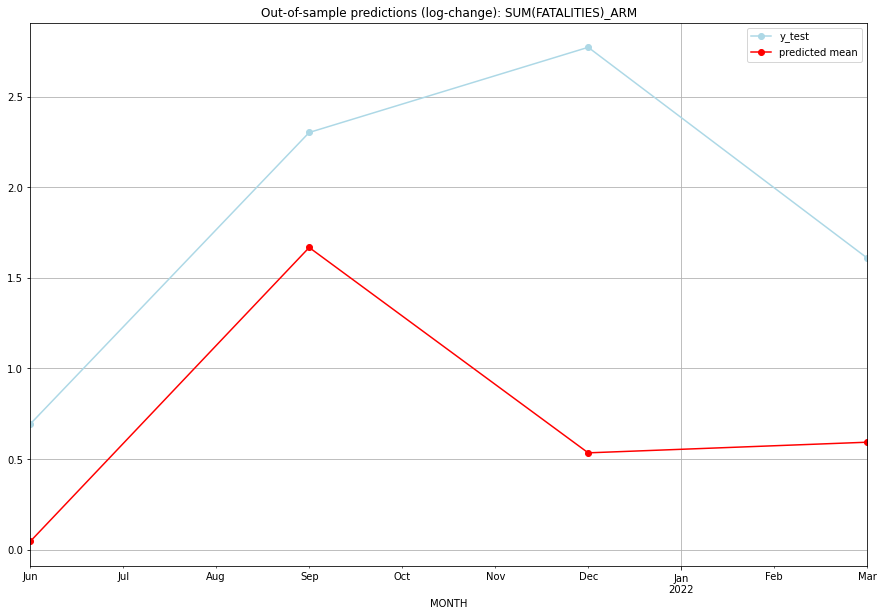

TADDA: 1.1342782796044708
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.046268         1.0      0.045230        0.693147   ARM   
1 2021-07-01  4.300419         9.0      1.667786        2.302585   ARM   
2 2021-10-01  0.706524        15.0      0.534458        2.772589   ARM   
3 2022-01-01  0.809719         4.0      0.593172        1.609438   ARM   

                                          PARAMETERS  
0  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:06
######## ASM (11/234) #########
0
Neighbor countries: []
Getting Data for ASM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 18)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient da

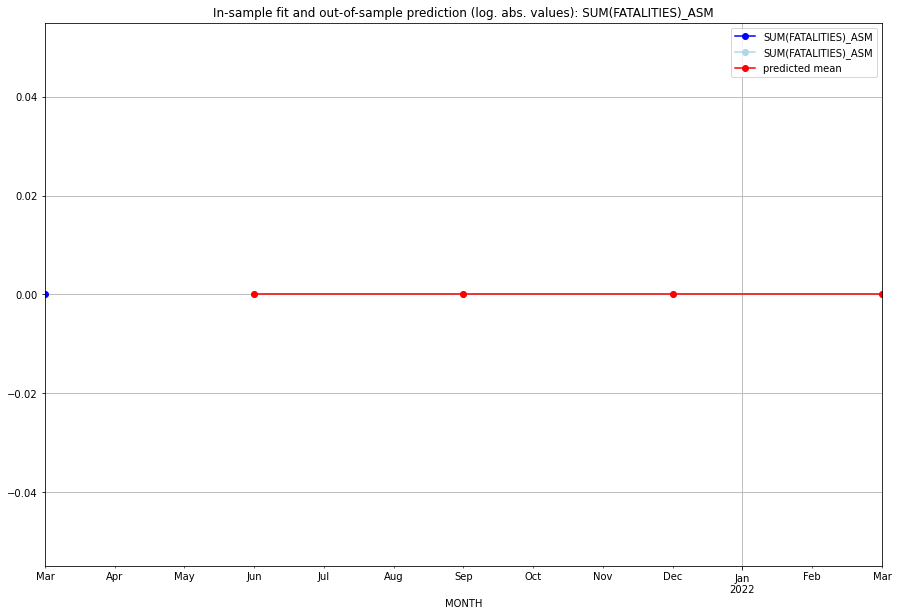

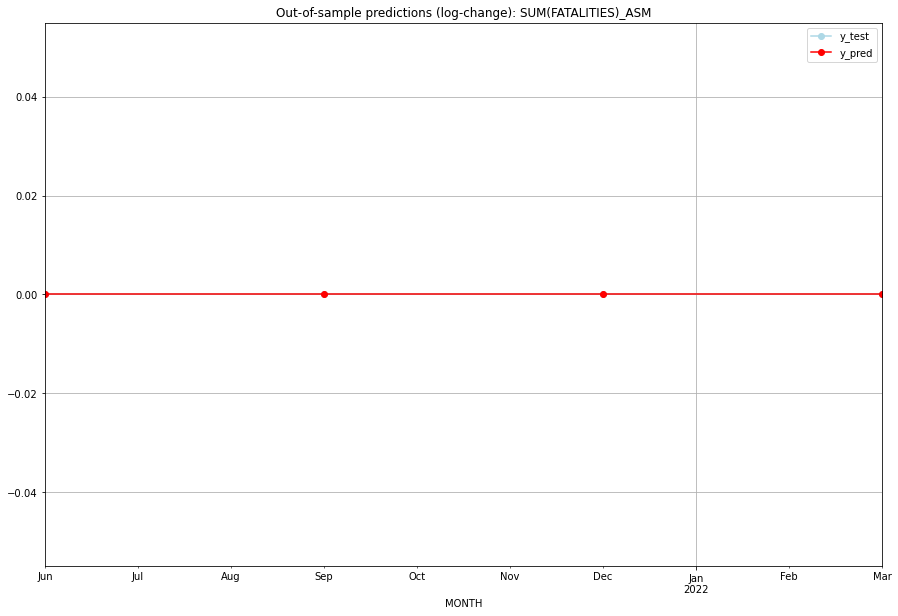

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ASM   
1 2021-07-01       0.0         0.0           0.0             0.0   ASM   
2 2021-10-01       0.0         0.0           0.0             0.0   ASM   
3 2022-01-01       0.0         0.0           0.0             0.0   ASM   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## ATA (12/234) #########
0
Neighbor countries: []
Getting Data for ATA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


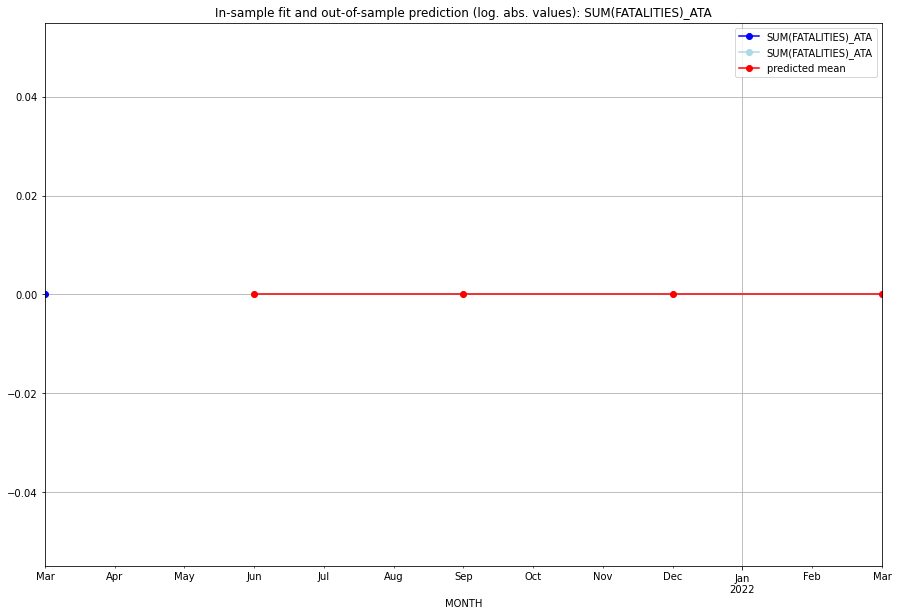

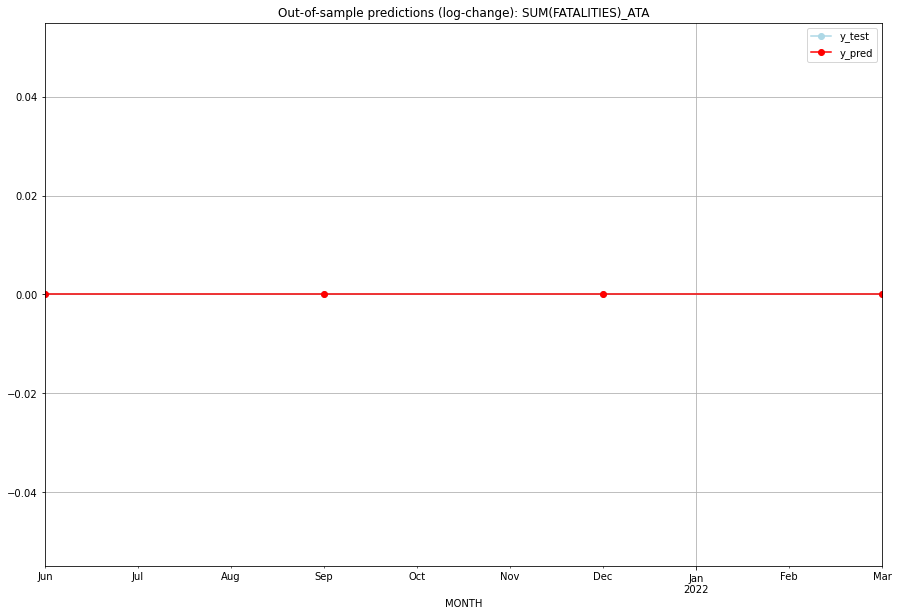

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ATA   
1 2021-07-01       0.0         0.0           0.0             0.0   ATA   
2 2021-10-01       0.0         0.0           0.0             0.0   ATA   
3 2022-01-01       0.0         0.0           0.0             0.0   ATA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## ATG (13/234) #########
0
Neighbor countries: []
Getting Data for ATG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 47)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ATG   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                              0.019
Time:                         10:25:06   BIC                              1.714
Sample:                     01-31-2018   HQIC                            -0.330
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1      -6.757e-07   1.14e+05  -5.93e-12      1.000   -2.23e+05    2.23

<Figure size 432x288 with 0 Axes>

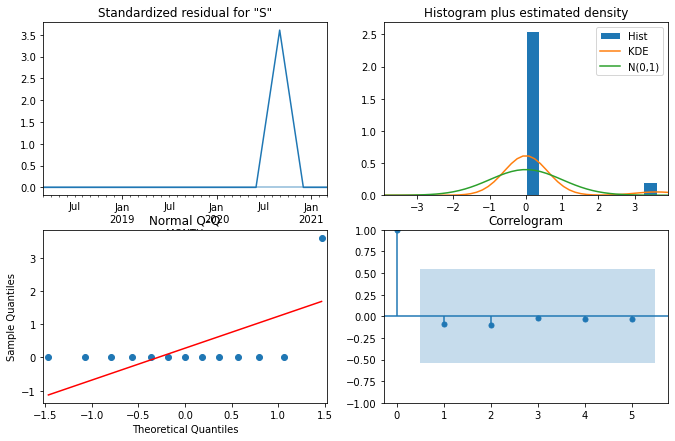

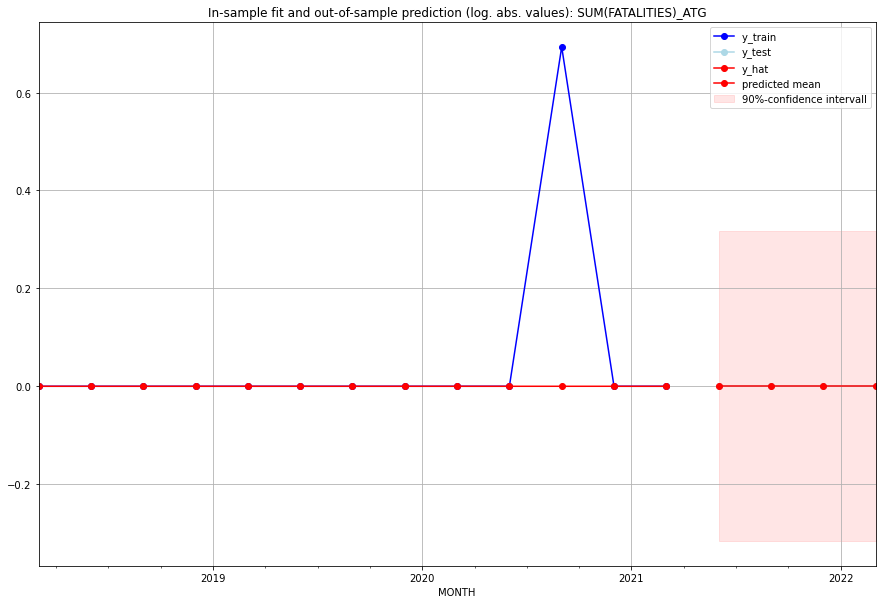

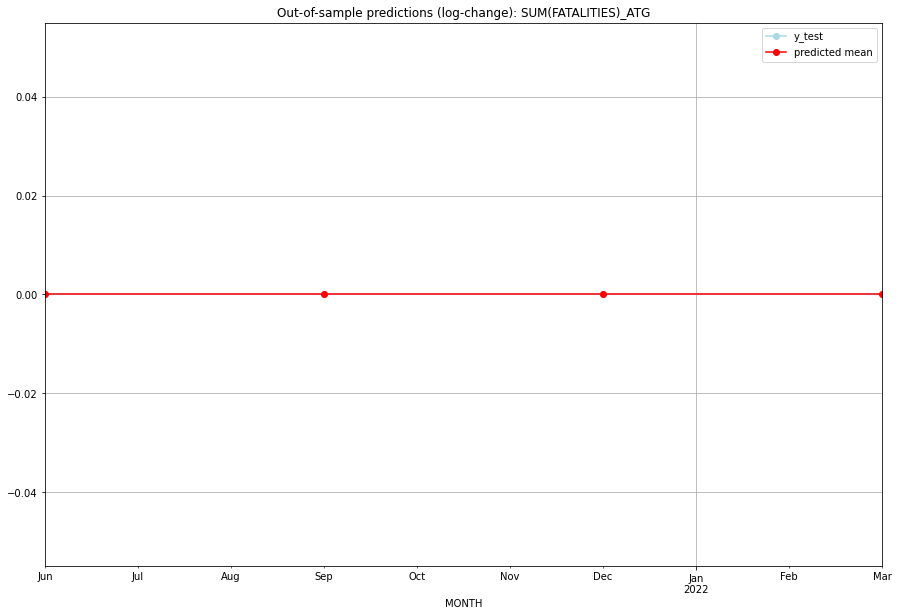

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ATG   
1 2021-07-01       0.0         0.0           0.0             0.0   ATG   
2 2021-10-01       0.0         0.0           0.0             0.0   ATG   
3 2022-01-01       0.0         0.0           0.0             0.0   ATG   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## AUS (14/234) #########
0
Neighbor countries: []
Getting Data for AUS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 60)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross va

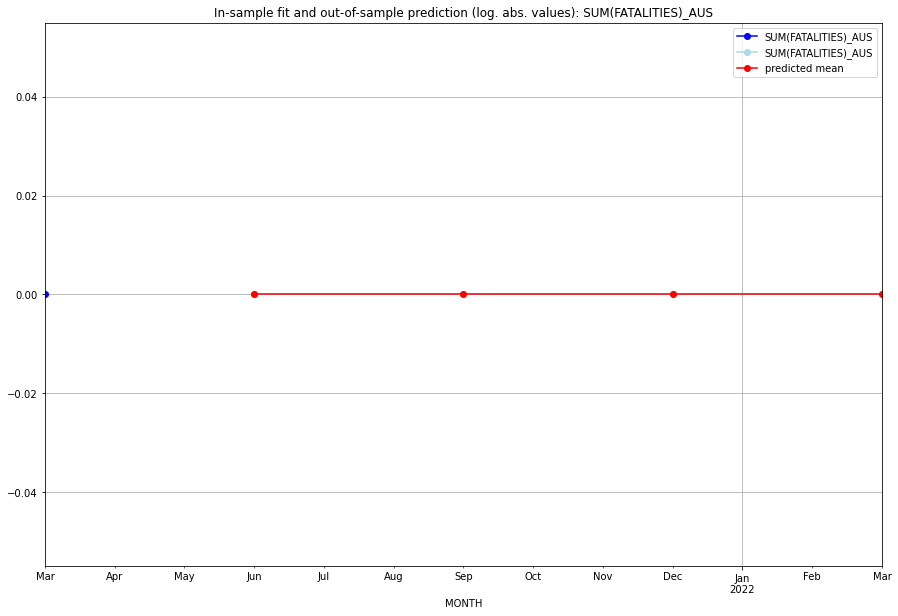

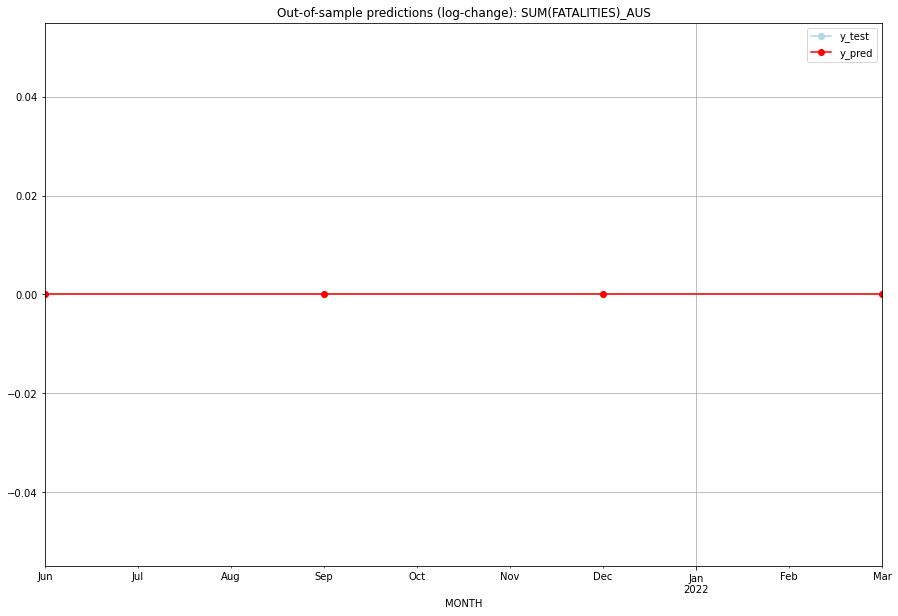

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   AUS   
1 2021-07-01       0.0         0.0           0.0             0.0   AUS   
2 2021-10-01       0.0         0.0           0.0             0.0   AUS   
3 2022-01-01       0.0         0.0           0.0             0.0   AUS   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## AUT (15/234) #########
0
Neighbor countries: []
Getting Data for AUT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 64)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


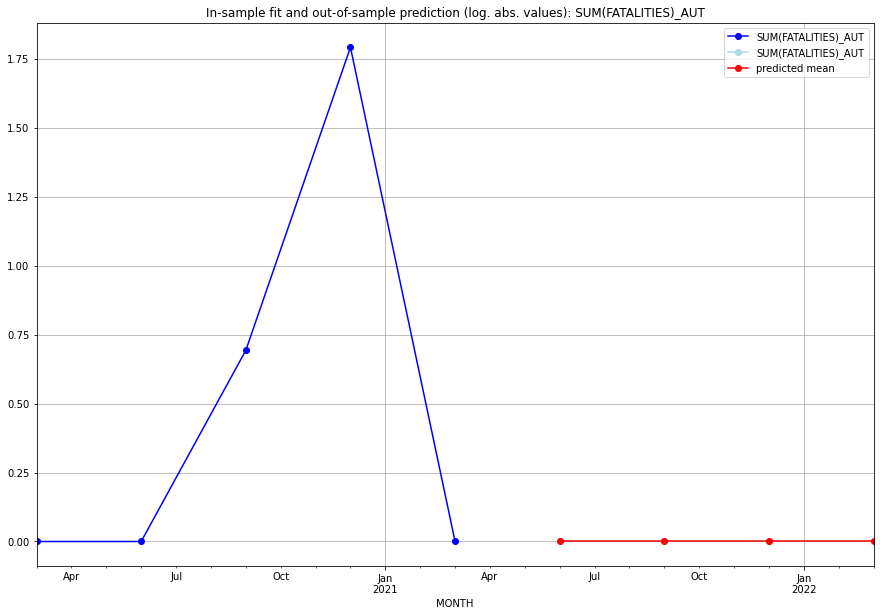

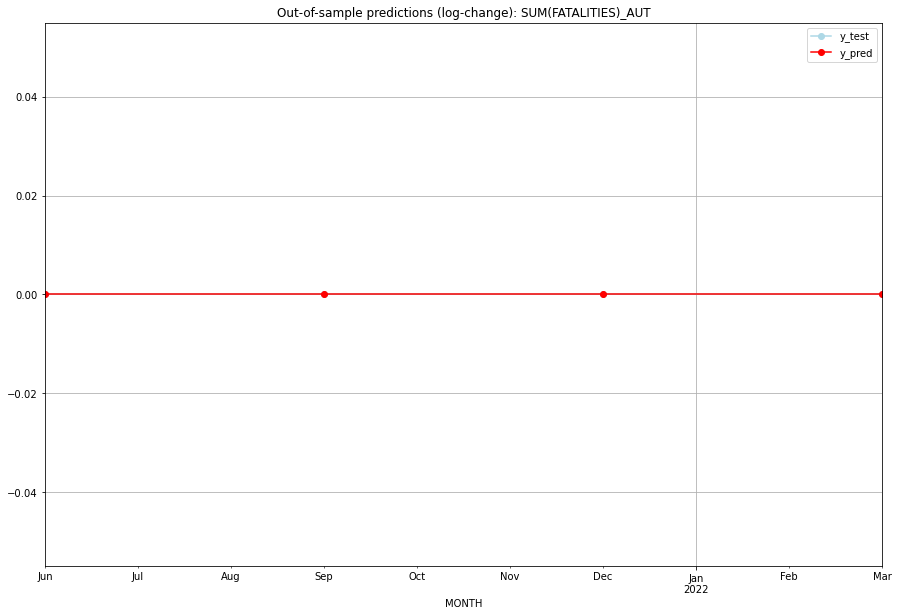

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   AUT   
1 2021-07-01       0.0         0.0           0.0             0.0   AUT   
2 2021-10-01       0.0         0.0           0.0             0.0   AUT   
3 2022-01-01       0.0         0.0           0.0             0.0   AUT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## AZE (16/234) #########
0
Neighbor countries: []
Getting Data for AZE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 62)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 1.0930574943431364, 'fold_results': [1.0930574943431364, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_AZE   No. Observations:                   13
Model:                SARIMAX(1, 0, 2)   Log Likelihood                 -26.957
Date:                 Wed, 19 Oct 2022   AIC                             61.913
Time:                         10:25:17   BIC                             64.173
Sample:                     01-31-2018   HQIC                            61.449
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.0000      0.095     10.521 

<Figure size 432x288 with 0 Axes>

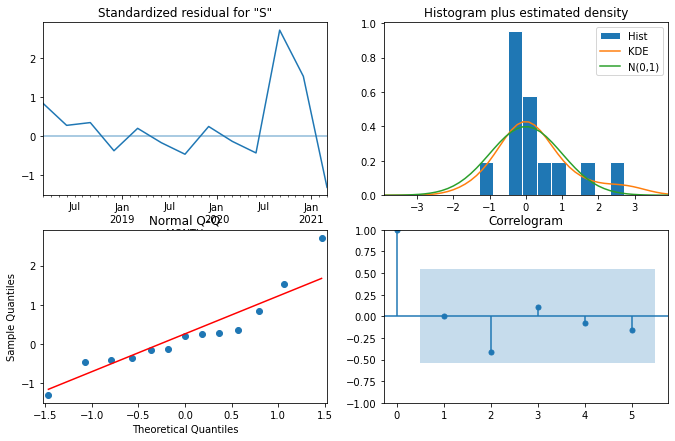

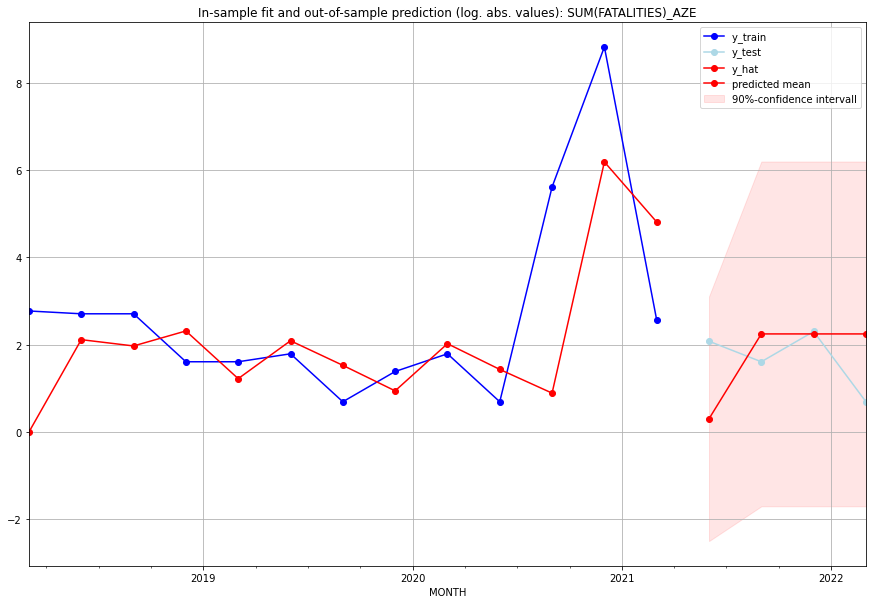

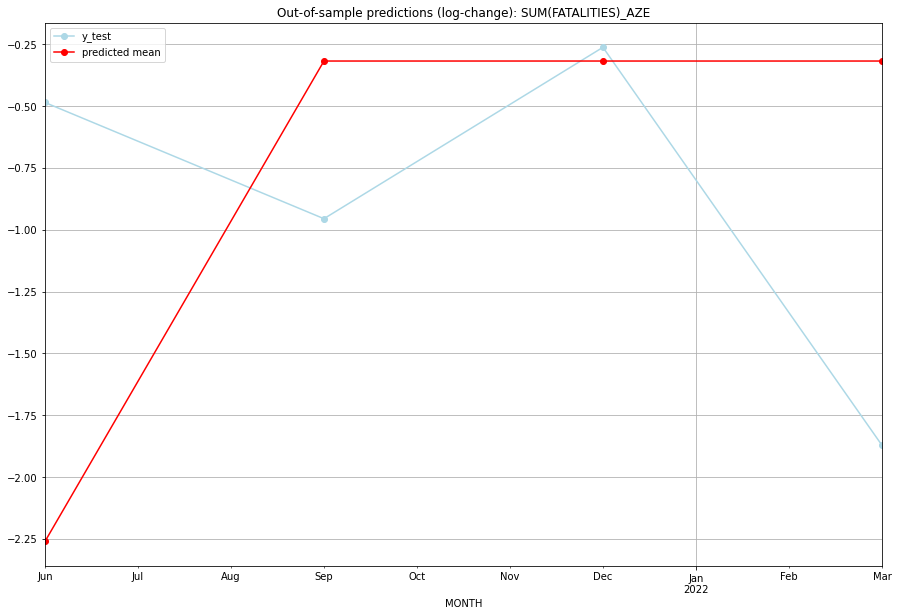

TADDA: 1.0056483356288841
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.355187         7.0     -2.261010       -0.485508   AZE   
1 2021-07-01  8.460334         4.0     -0.317842       -0.955511   AZE   
2 2021-10-01  8.460176         9.0     -0.317858       -0.262364   AZE   
3 2022-01-01  8.460017         1.0     -0.317875       -1.871802   AZE   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:06
######## BDI (17/234) #########
0
Neighbor countries: []
Getting Data for BDI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 60)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU co

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.2884657582332636, 'fold_results': [0.35130242500025866, 0.3307866367187139, 0.19385160097422616, 0.2782034779457563, 0.28818465052736286]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BDI   No. Observations:                   96
Model:                SARIMAX(3, 1, 3)   Log Likelihood                -113.442
Date:                 Wed, 19 Oct 2022   AIC                            244.883
Time:                         10:25:39   BIC                            267.868
Sample:                     04-30-1997   HQIC                           254.171
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

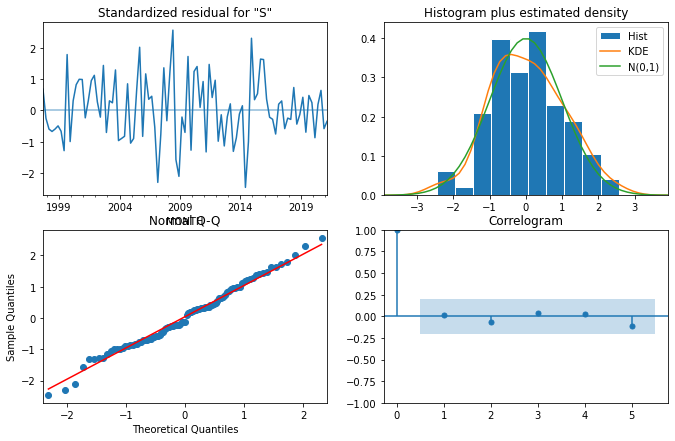

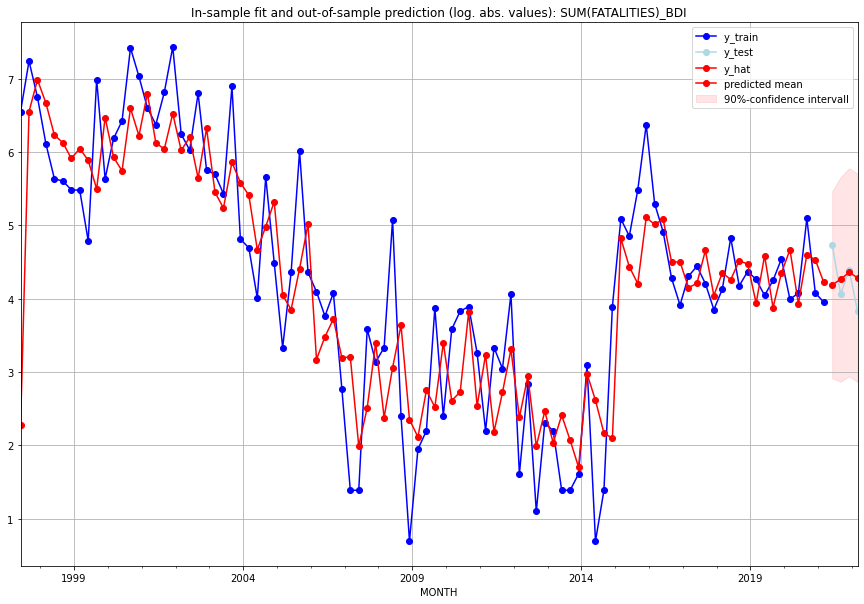

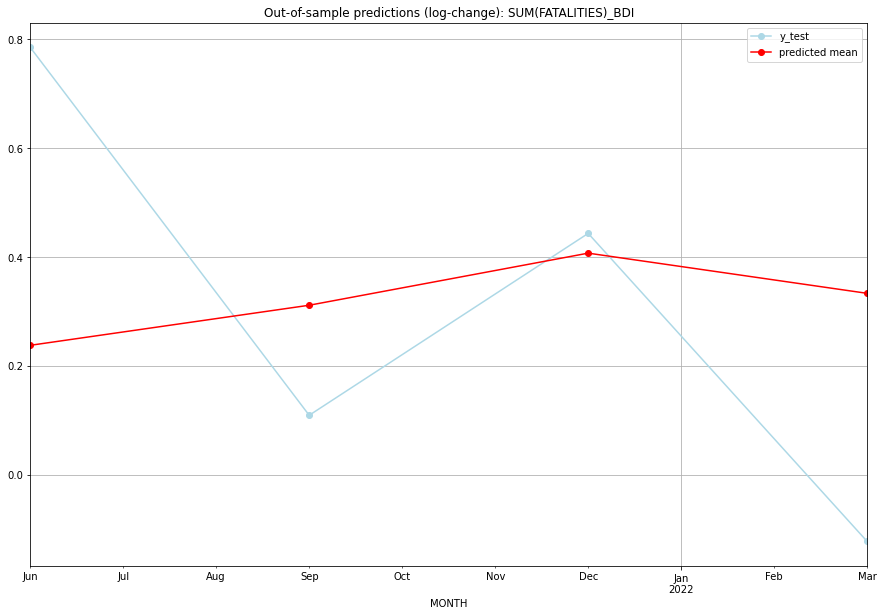

TADDA: 0.39361696299334525
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  64.950848       113.0      0.237666        0.784955   BDI   
1 2021-07-01  69.987878        57.0      0.311265        0.109199   BDI   
2 2021-10-01  77.114257        80.0      0.406929        0.443205   BDI   
3 2022-01-01  71.556153        45.0      0.333117       -0.122602   BDI   

                                          PARAMETERS  
0  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## BEL (18/234) #########
0
Neighbor countries: []
Getting Data for BEL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 65)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insuffici

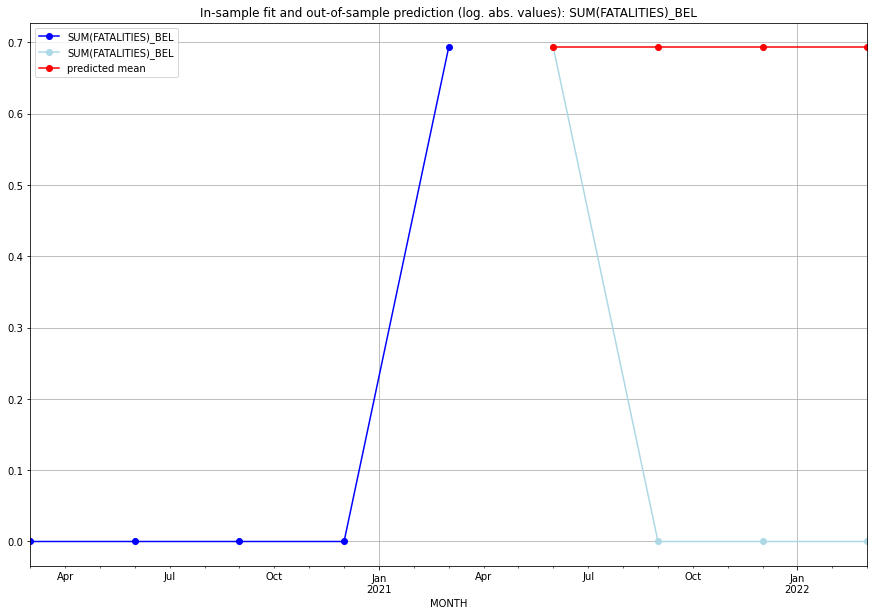

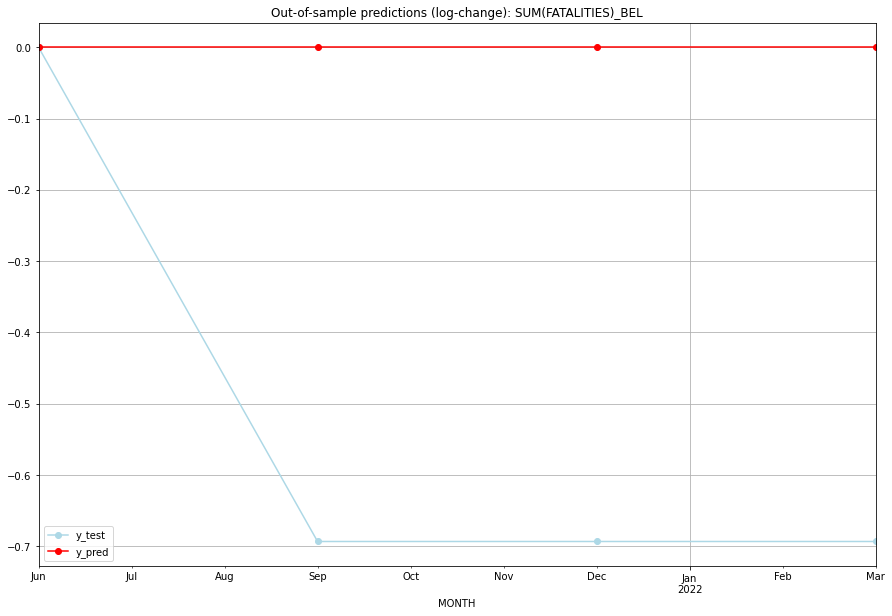

TADDA: 0.5198603854199589
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.693147    0.693147           0.0        0.000000   BEL   
1 2021-07-01  0.693147    0.000000           0.0       -0.693147   BEL   
2 2021-10-01  0.693147    0.000000           0.0       -0.693147   BEL   
3 2022-01-01  0.693147    0.000000           0.0       -0.693147   BEL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## BEN (19/234) #########
0
Neighbor countries: []
Getting Data for BEN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 60)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.9616617921730259, 'fold_results': [1.3968903995871962, 1.1594492393557891, 1.089512918503508, 0.6652390989044438, 0.49721730451419344]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BEN   No. Observations:                   96
Model:                SARIMAX(3, 1, 0)   Log Likelihood                 -75.831
Date:                 Wed, 19 Oct 2022   AIC                            161.662
Time:                         10:26:09   BIC                            174.431
Sample:                     04-30-1997   HQIC                           166.821
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

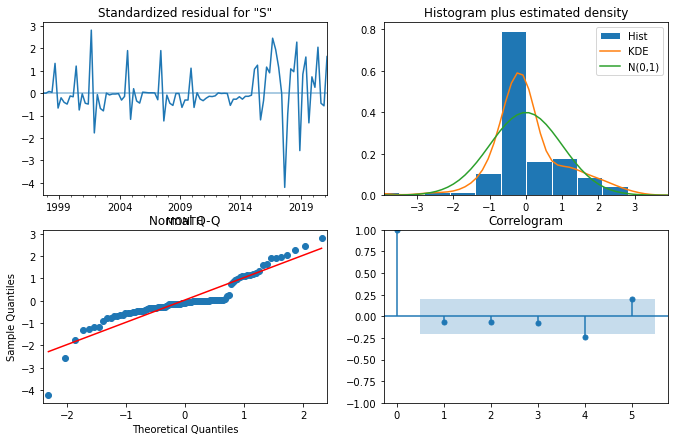

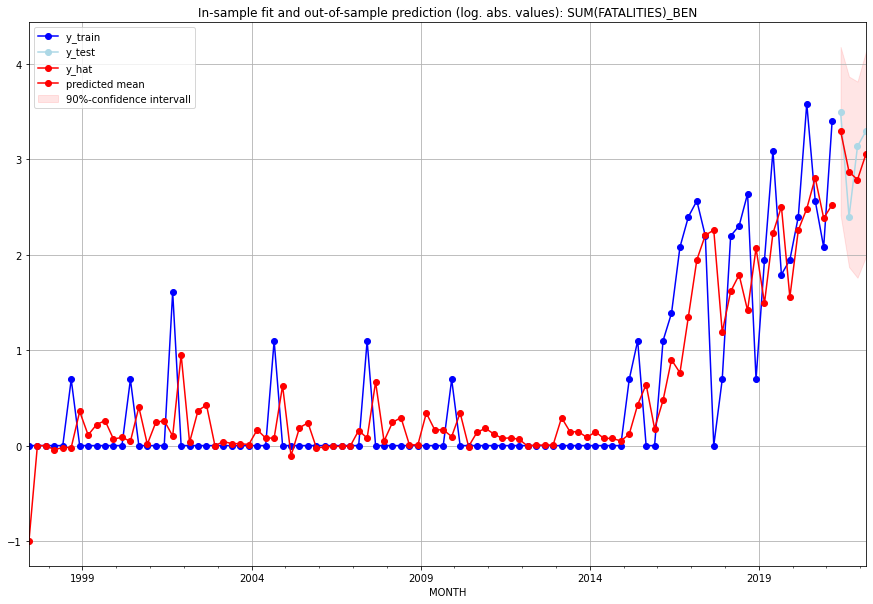

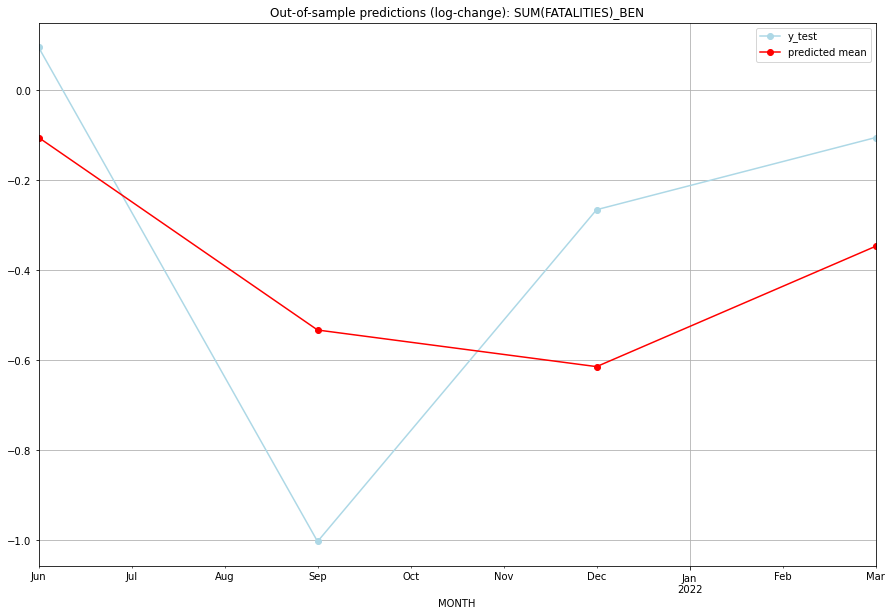

TADDA: 0.3416051317701997
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  26.004278        32.0     -0.105202        0.095310   BEN   
1 2021-07-01  16.602241        10.0     -0.533171       -1.003302   BEN   
2 2021-10-01  15.226263        22.0     -0.614566       -0.265703   BEN   
3 2022-01-01  20.202619        26.0     -0.347073       -0.105361   BEN   

                                          PARAMETERS  
0  {'params': [1, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:27
######## BES (20/234) #########
0
Neighbor countries: []
Getting Data for BES
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV

<Figure size 432x288 with 0 Axes>

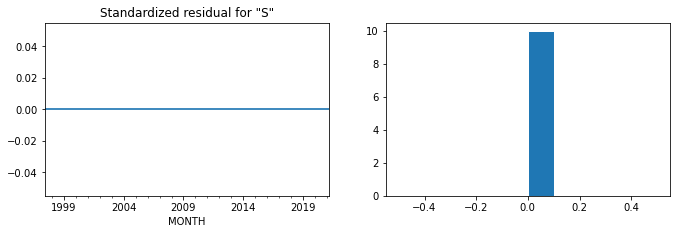

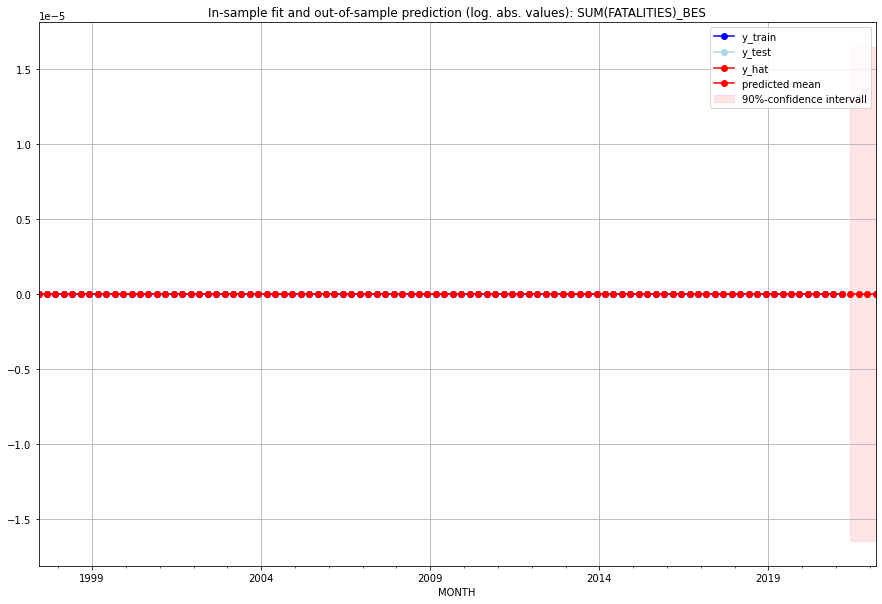

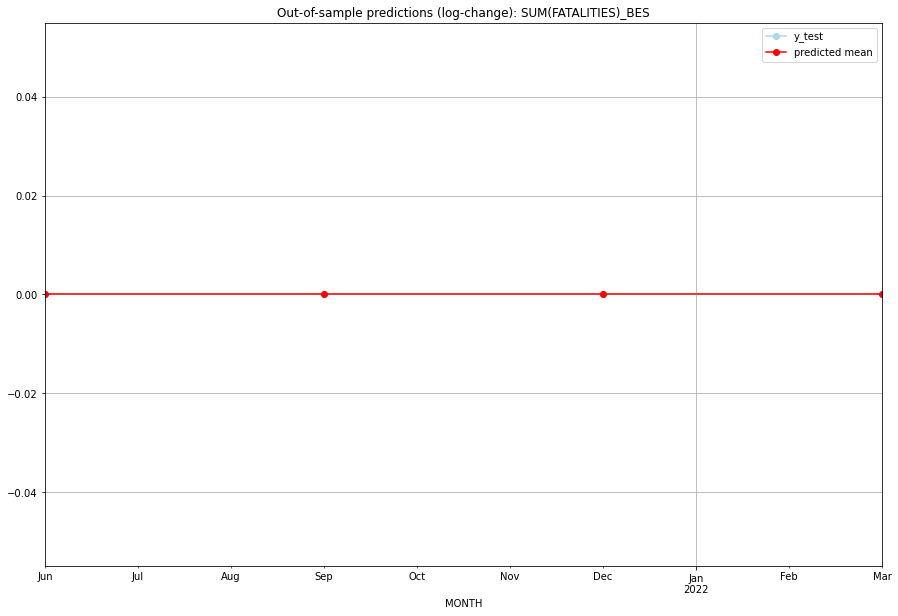

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BES   
1 2021-07-01       0.0         0.0           0.0             0.0   BES   
2 2021-10-01       0.0         0.0           0.0             0.0   BES   
3 2022-01-01       0.0         0.0           0.0             0.0   BES   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## BFA (21/234) #########
0
Neighbor countries: []
Getting Data for BFA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.7697993293092468, 'fold_results': [0.924165398638998, 0.37982170385995073, 0.8736529565753949, 1.1501656906489723, 0.521190896822918]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BFA   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -154.381
Date:                 Wed, 19 Oct 2022   AIC                            312.762
Time:                         10:26:32   BIC                            317.869
Sample:                     04-30-1997   HQIC                           314.826
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

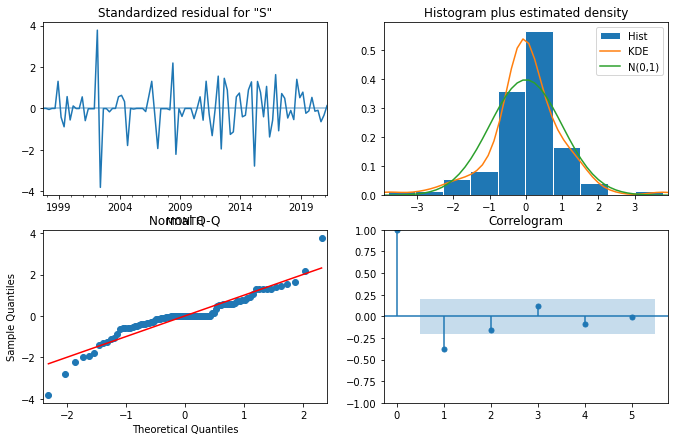

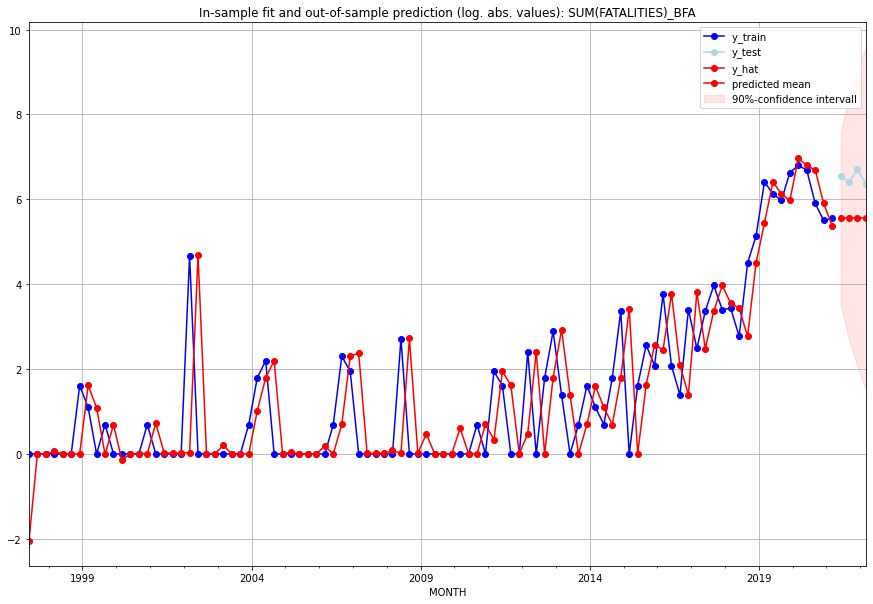

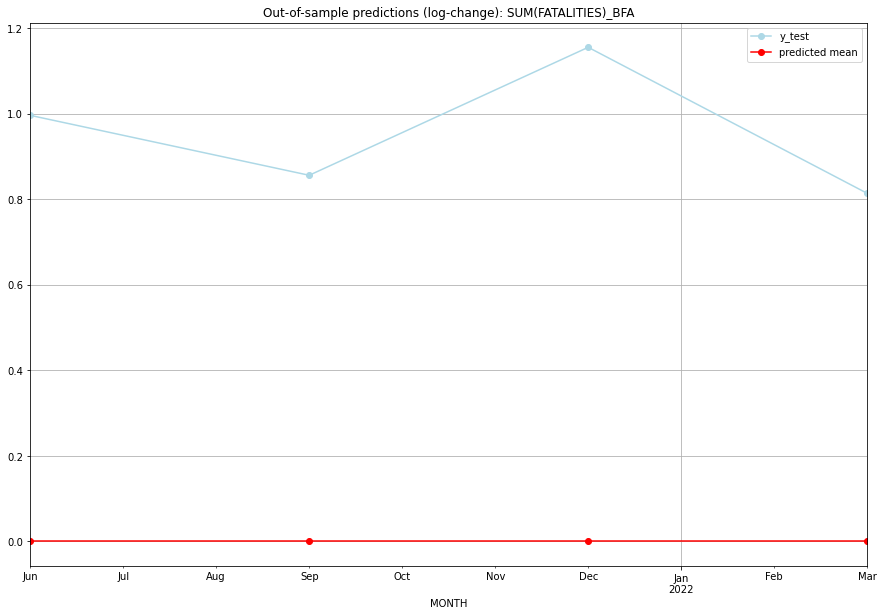

TADDA: 0.9554290593222374
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01     256.0       695.0  8.881784e-16        0.996274   BFA   
1 2021-07-01     256.0       604.0  8.881784e-16        0.856152   BFA   
2 2021-10-01     256.0       815.0  8.881784e-16        1.155338   BFA   
3 2022-01-01     256.0       579.0  8.881784e-16        0.813952   BFA   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## BGD (22/234) #########
0
Neighbor countries: []
Getting Data for BGD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 61)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU core

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.40128785473336404, 'fold_results': [0.2615150531027268, 0.7051465774511199, 0.6309068719749077, 0.31914462763834894, 0.08972614349971697]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BGD   No. Observations:                   45
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -33.761
Date:                 Wed, 19 Oct 2022   AIC                             69.521
Time:                         10:26:55   BIC                             71.306
Sample:                     01-31-2010   HQIC                            70.183
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

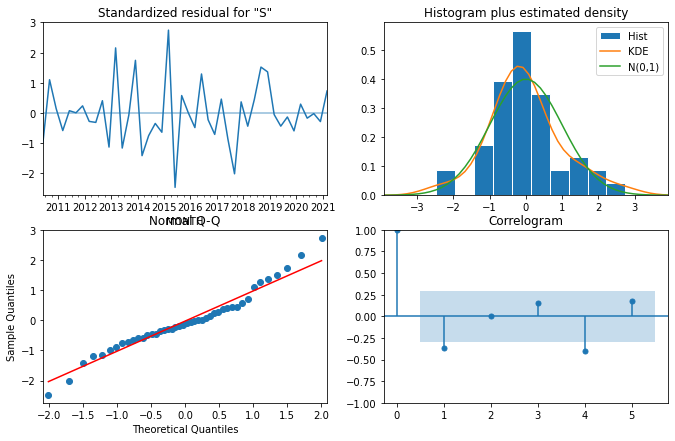

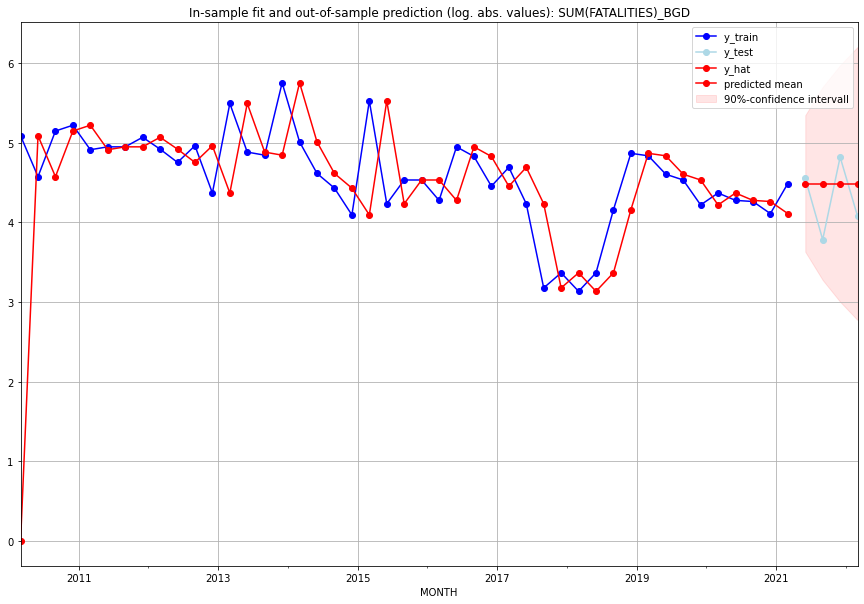

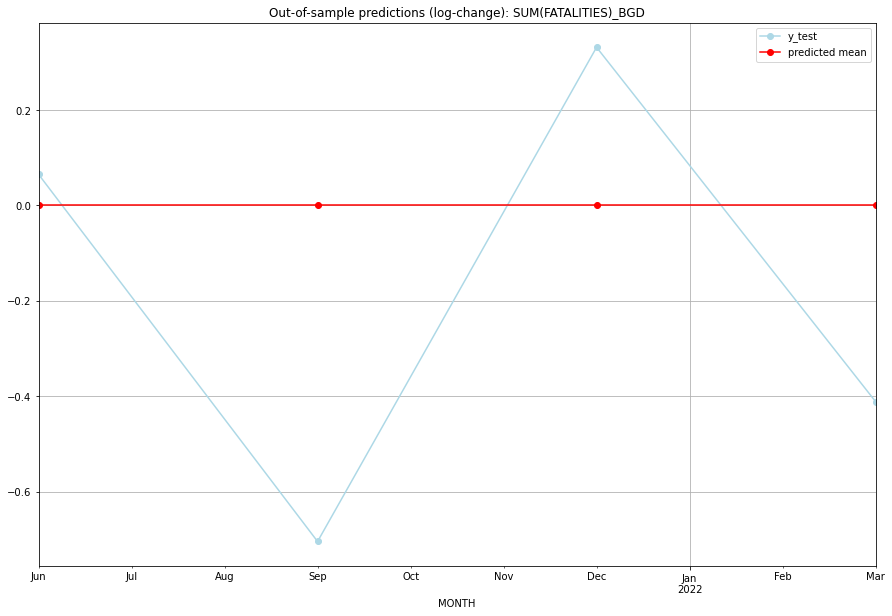

TADDA: 0.3781078448453993
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01      88.0        94.0           0.0        0.065241   BGD   
1 2021-07-01      88.0        43.0           0.0       -0.704447   BGD   
2 2021-10-01      88.0       123.0           0.0        0.331645   BGD   
3 2022-01-01      88.0        58.0           0.0       -0.411099   BGD   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:23
######## BGR (23/234) #########
0
Neighbor countries: []
Getting Data for BGR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 64)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV neces

<Figure size 432x288 with 0 Axes>

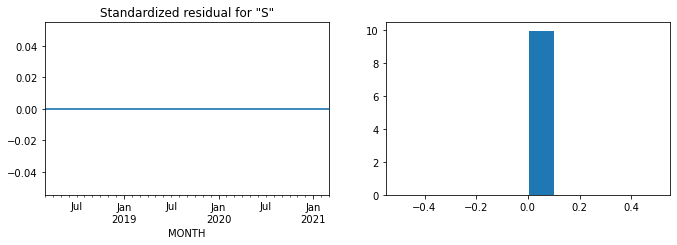

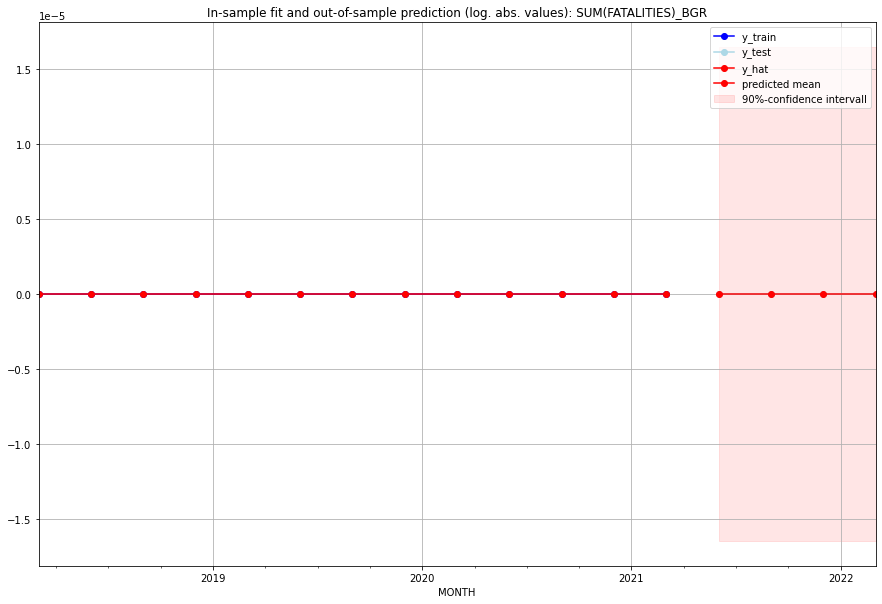

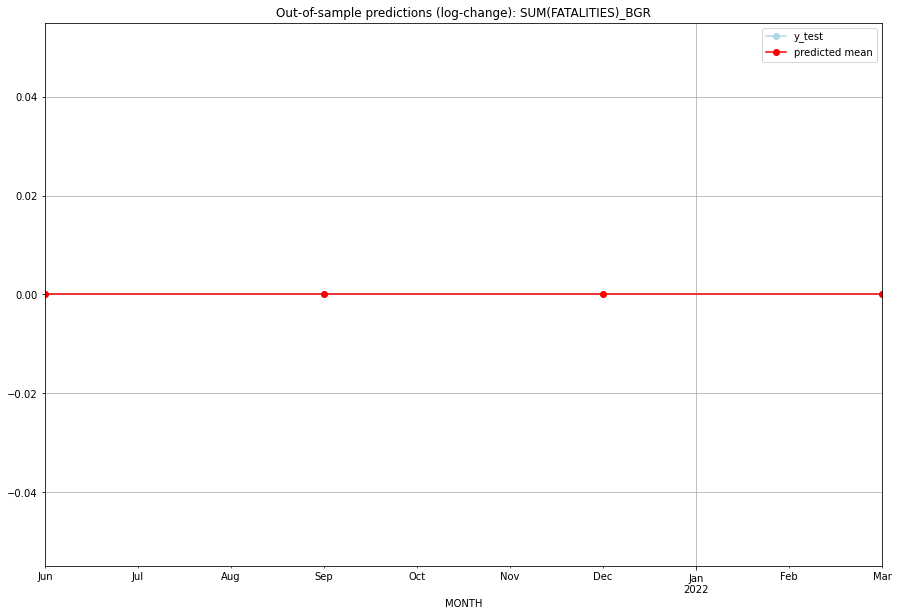

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BGR   
1 2021-07-01       0.0         0.0           0.0             0.0   BGR   
2 2021-10-01       0.0         0.0           0.0             0.0   BGR   
3 2022-01-01       0.0         0.0           0.0             0.0   BGR   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## BHR (24/234) #########
0
Neighbor countries: []
Getting Data for BHR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 53)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.29744437984063, 'fold_results': [0.8616074989836914, 0.0, 0.17460571797614838, 0.15356430240268024]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BHR   No. Observations:                   21
Model:                SARIMAX(2, 1, 1)   Log Likelihood                 -21.162
Date:                 Wed, 19 Oct 2022   AIC                             52.325
Time:                         10:27:12   BIC                             57.303
Sample:                     01-31-2016   HQIC                            53.297
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1  

<Figure size 432x288 with 0 Axes>

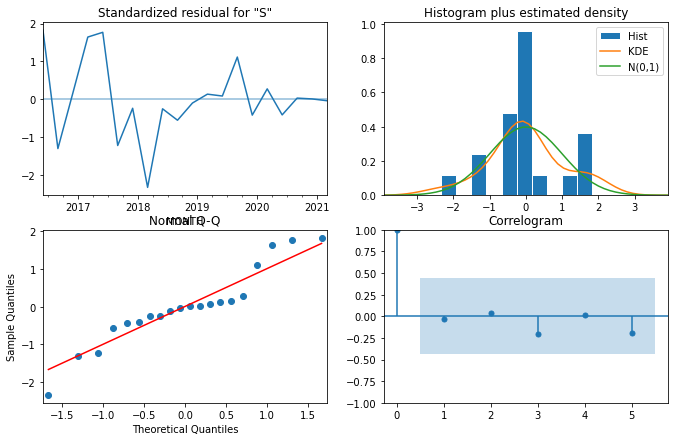

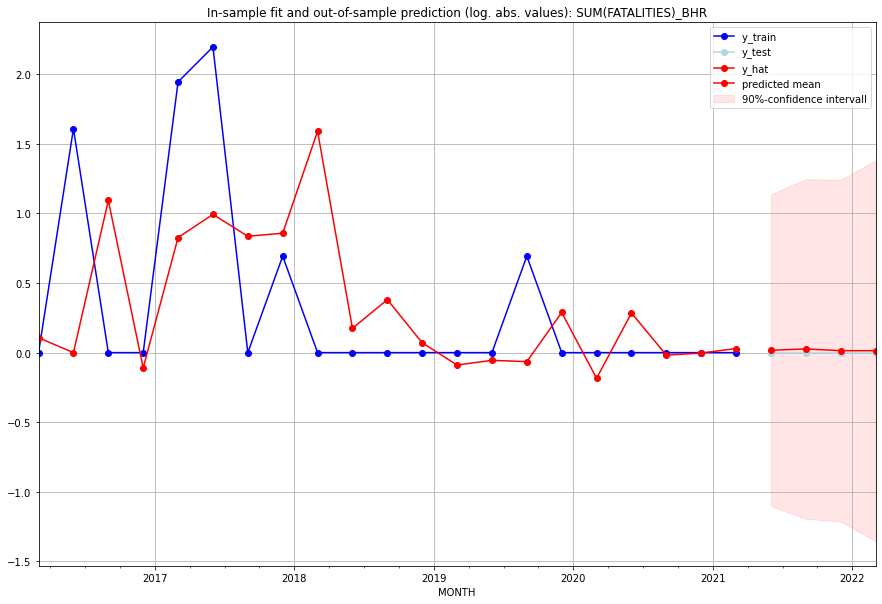

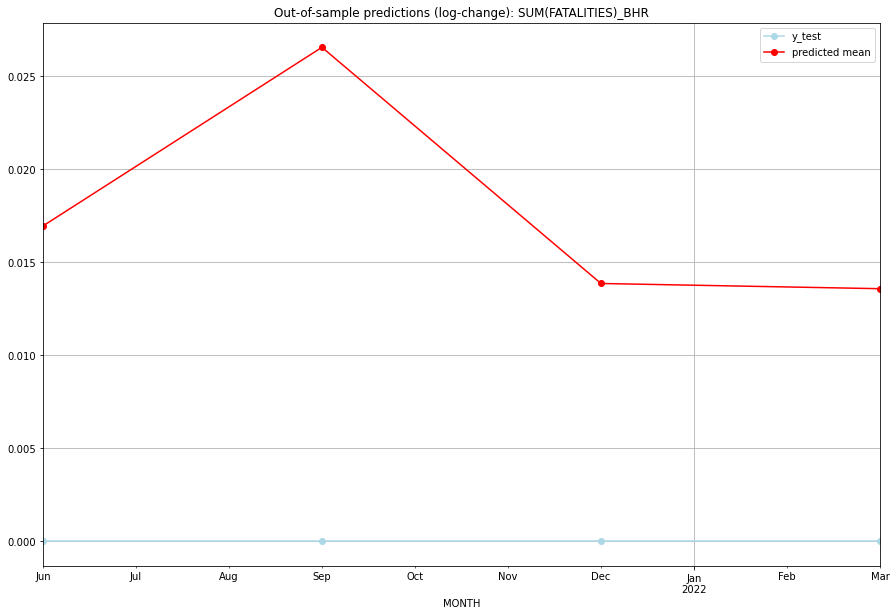

TADDA: 0.017736894525818232
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.017097         0.0      0.016953             0.0   BHR   
1 2021-07-01  0.026906         0.0      0.026551             0.0   BHR   
2 2021-10-01  0.013958         0.0      0.013862             0.0   BHR   
3 2022-01-01  0.013675         0.0      0.013582             0.0   BHR   

                                          PARAMETERS  
0  {'params': [1, (2, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (2, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (2, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (2, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## BHS (25/234) #########
0
Neighbor countries: []
Getting Data for BHS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 52)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU co

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BHS   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                  -6.138
Date:                 Wed, 19 Oct 2022   AIC                             18.277
Time:                         10:27:24   BIC                             19.972
Sample:                     01-31-2018   HQIC                            17.929
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.4703      0.314      1.499      0.134      -0.144       1

<Figure size 432x288 with 0 Axes>

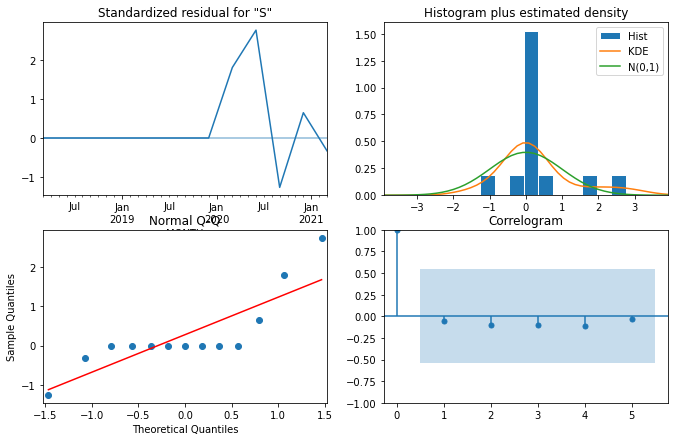

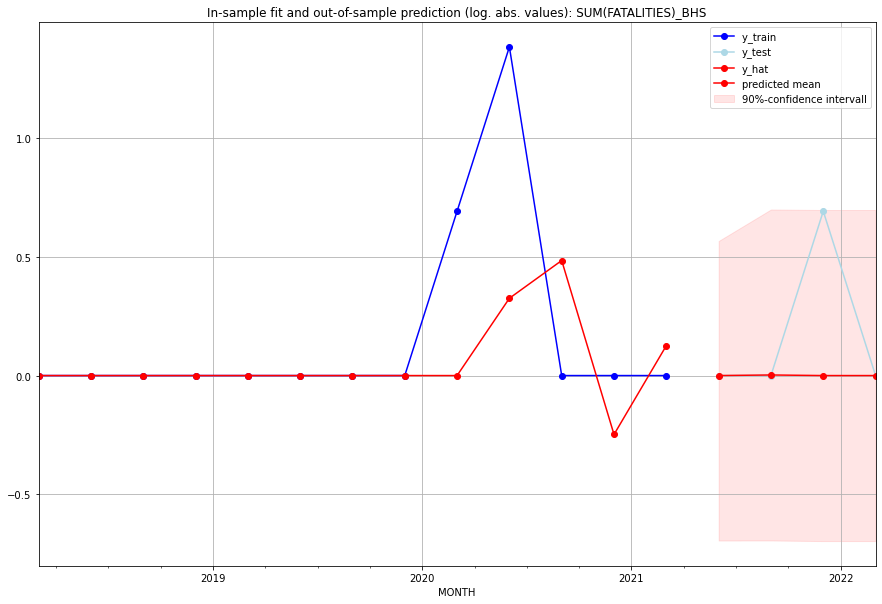

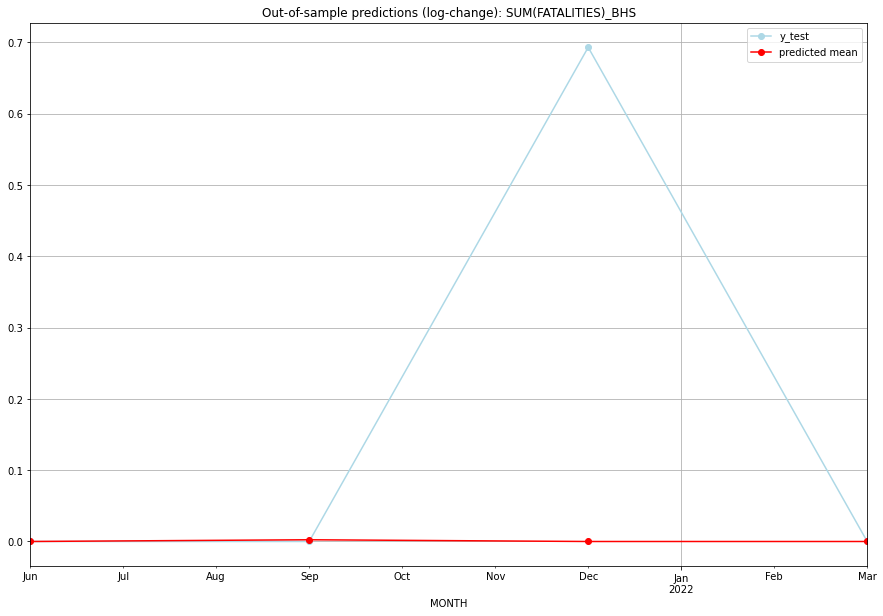

TADDA: 0.17389465902325324
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.000000         0.0      0.000000        0.000000   BHS   
1 2021-07-01  0.002434         0.0      0.002431        0.000000   BHS   
2 2021-10-01  0.000000         1.0      0.000000        0.693147   BHS   
3 2022-01-01  0.000000         0.0      0.000000        0.000000   BHS   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## BIH (26/234) #########
0
Neighbor countries: []
Getting Data for BIH
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 61)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 7.747845836802057e-06, 'fold_results': [1.4992885990382752e-05, 5.028056832213625e-07]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BIH   No. Observations:                   13
Model:                SARIMAX(3, 1, 1)   Log Likelihood                   0.678
Date:                 Wed, 19 Oct 2022   AIC                              8.644
Time:                         10:27:35   BIC                             11.068
Sample:                     01-31-2018   HQIC                             7.746
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.76

<Figure size 432x288 with 0 Axes>

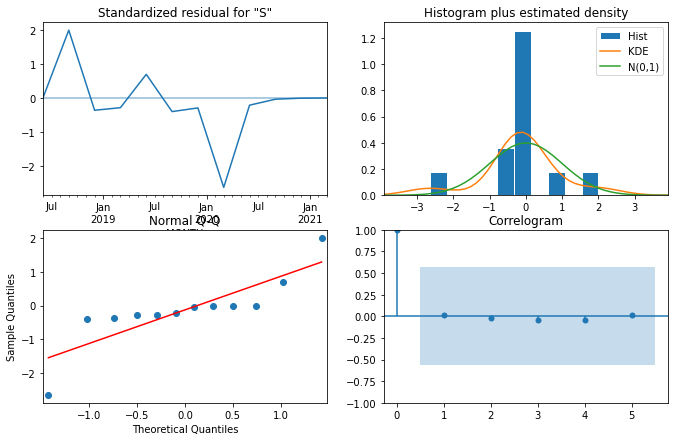

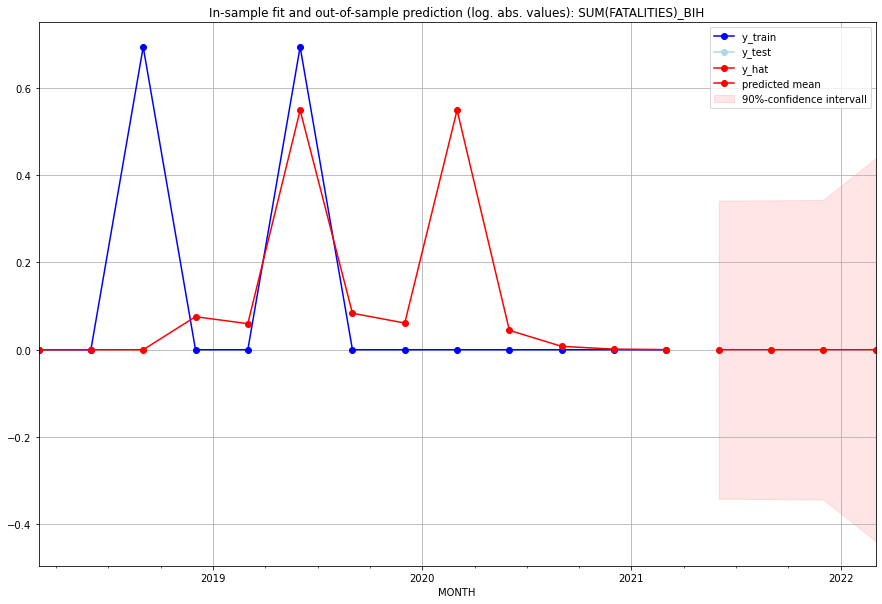

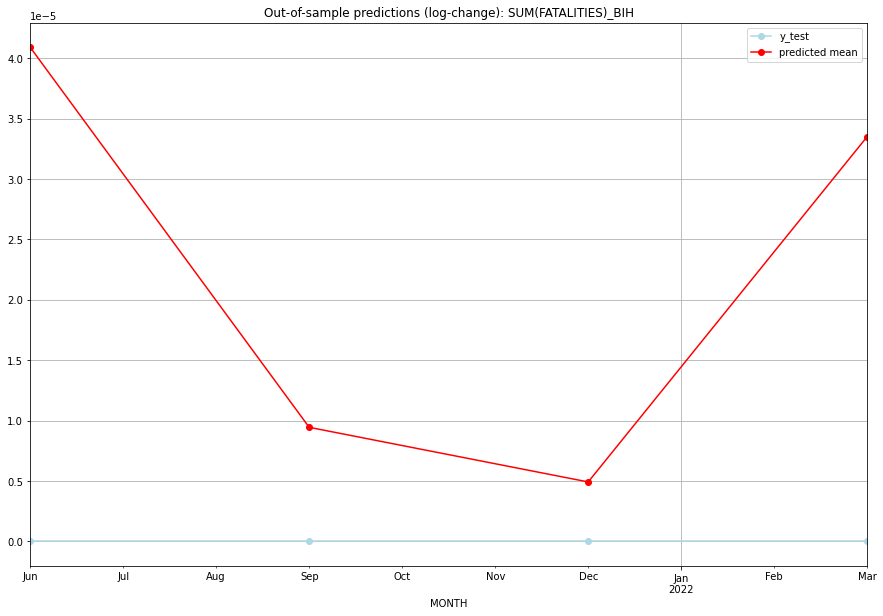

TADDA: 2.2199771436197002e-05
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.000041         0.0      0.000041             0.0   BIH   
1 2021-07-01  0.000009         0.0      0.000009             0.0   BIH   
2 2021-10-01  0.000005         0.0      0.000005             0.0   BIH   
3 2022-01-01  0.000034         0.0      0.000034             0.0   BIH   

                                          PARAMETERS  
0  {'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## BLM (27/234) #########
0
Neighbor countries: []
Getting Data for BLM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV 

<Figure size 432x288 with 0 Axes>

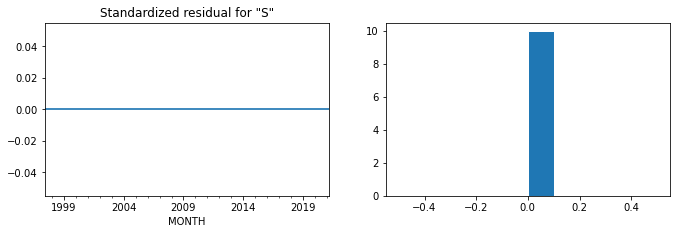

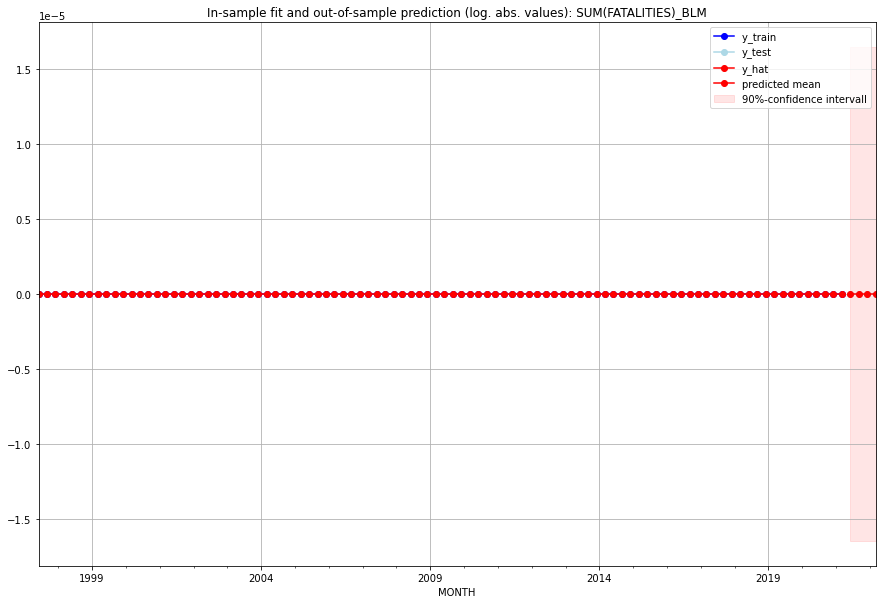

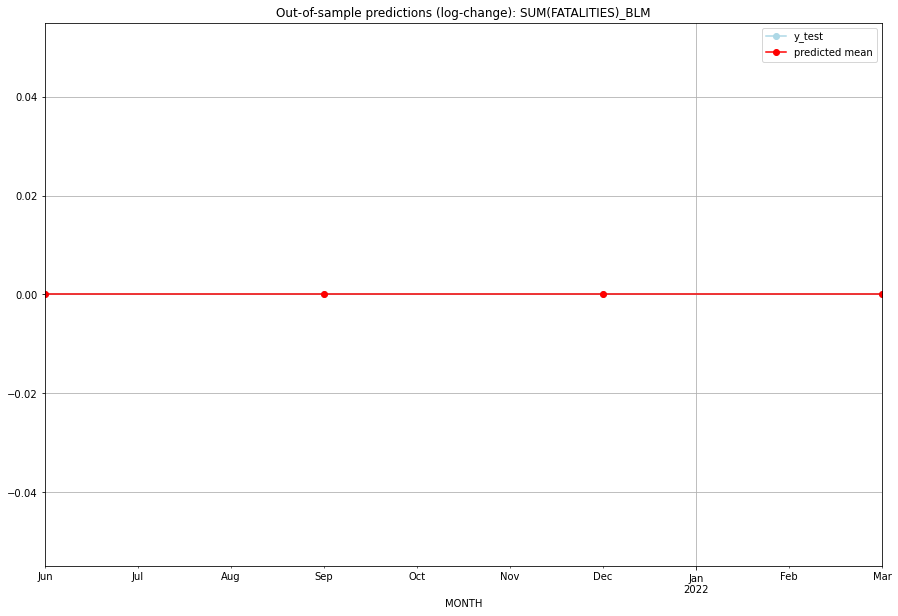

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BLM   
1 2021-07-01       0.0         0.0           0.0             0.0   BLM   
2 2021-10-01       0.0         0.0           0.0             0.0   BLM   
3 2022-01-01       0.0         0.0           0.0             0.0   BLM   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:07
######## BLR (28/234) #########
0
Neighbor countries: []
Getting Data for BLR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 62)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BLR   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                  -9.430
Date:                 Wed, 19 Oct 2022   AIC                             24.861
Time:                         10:27:55   BIC                             26.555
Sample:                     01-31-2018   HQIC                            24.512
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.3589      2.067      0.174      0.862      -3.692       4

<Figure size 432x288 with 0 Axes>

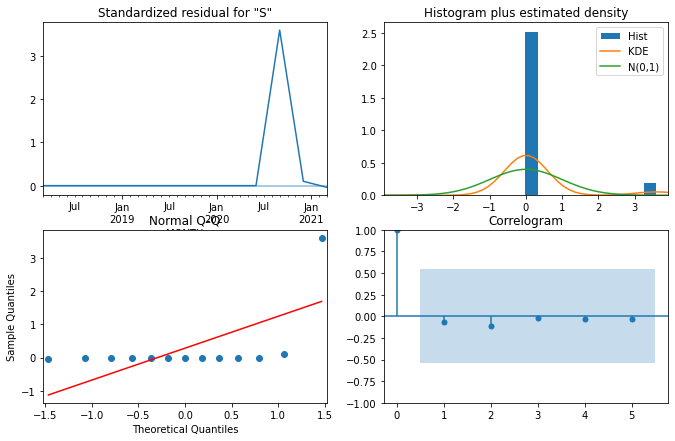

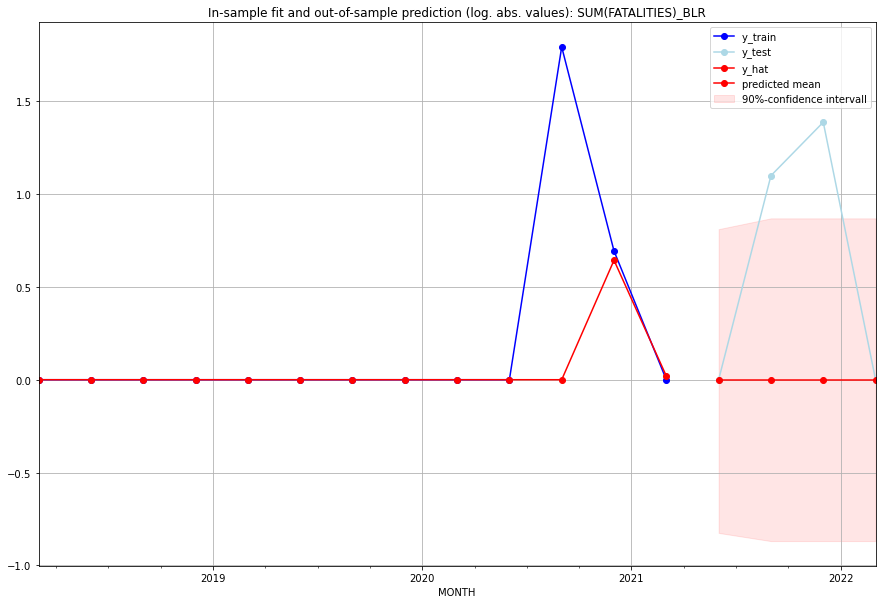

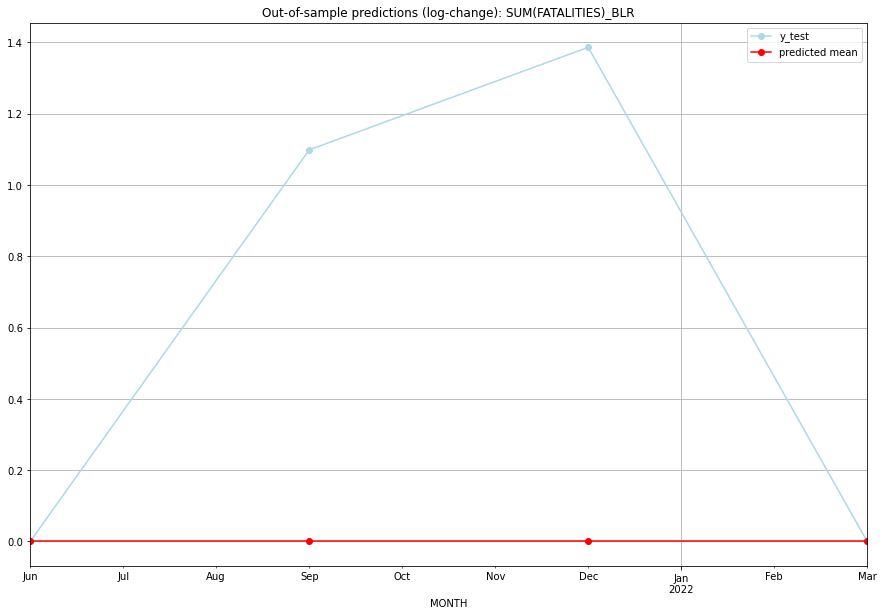

TADDA: 0.6212266624470001
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   BLR   
1 2021-07-01       0.0         2.0           0.0        1.098612   BLR   
2 2021-10-01       0.0         3.0           0.0        1.386294   BLR   
3 2022-01-01       0.0         0.0           0.0        0.000000   BLR   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## BLZ (29/234) #########
0
Neighbor countries: []
Getting Data for BLZ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 57)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU core

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.31495479682929317, 'fold_results': [0.34892706949548646, 0.2809825241630999]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BLZ   No. Observations:                   13
Model:                SARIMAX(0, 1, 1)   Log Likelihood                  -7.750
Date:                 Wed, 19 Oct 2022   AIC                             19.501
Time:                         10:28:04   BIC                             20.471
Sample:                     01-31-2018   HQIC                            19.142
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.9985     8

<Figure size 432x288 with 0 Axes>

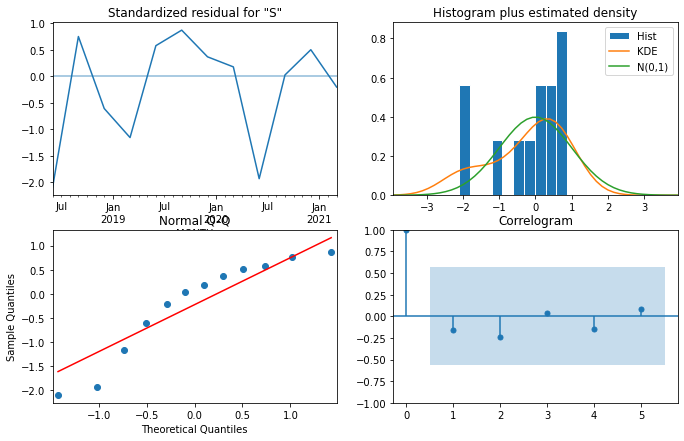

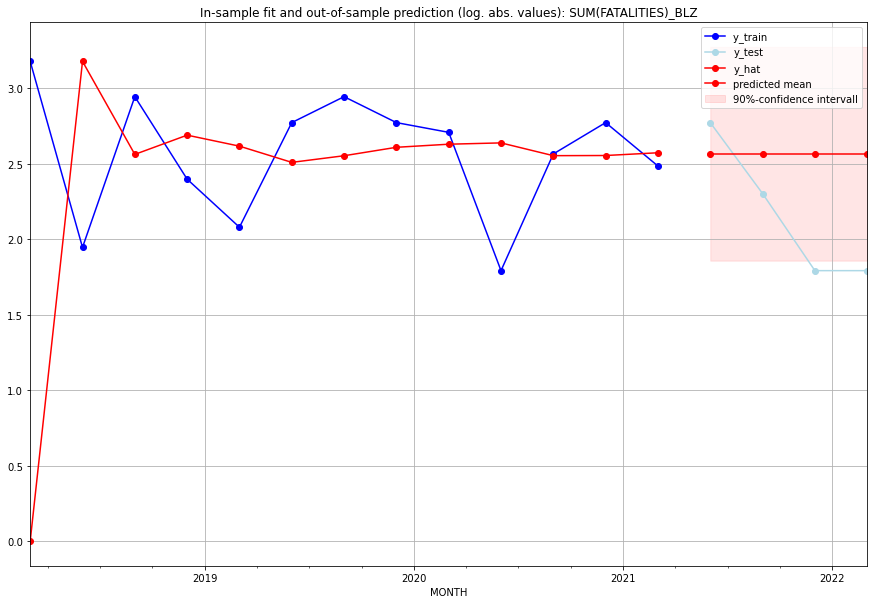

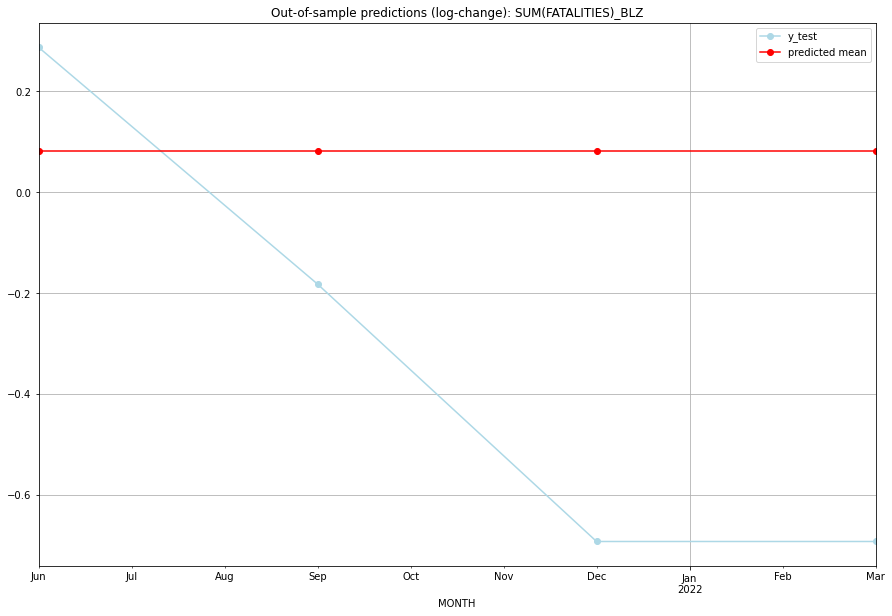

TADDA: 0.5654014438381235
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  12.013252        15.0      0.081062        0.287682   BLZ   
1 2021-07-01  12.013252         9.0      0.081062       -0.182322   BLZ   
2 2021-10-01  12.013252         5.0      0.081062       -0.693147   BLZ   
3 2022-01-01  12.013252         5.0      0.081062       -0.693147   BLZ   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:11
######## BMU (30/234) #########
0
Neighbor countries: []
Getting Data for BMU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 25)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficie

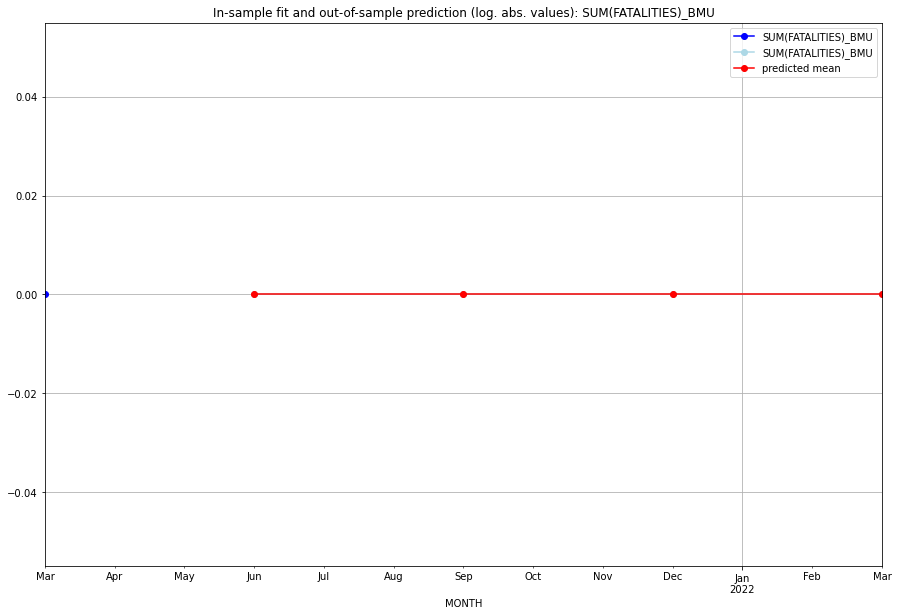

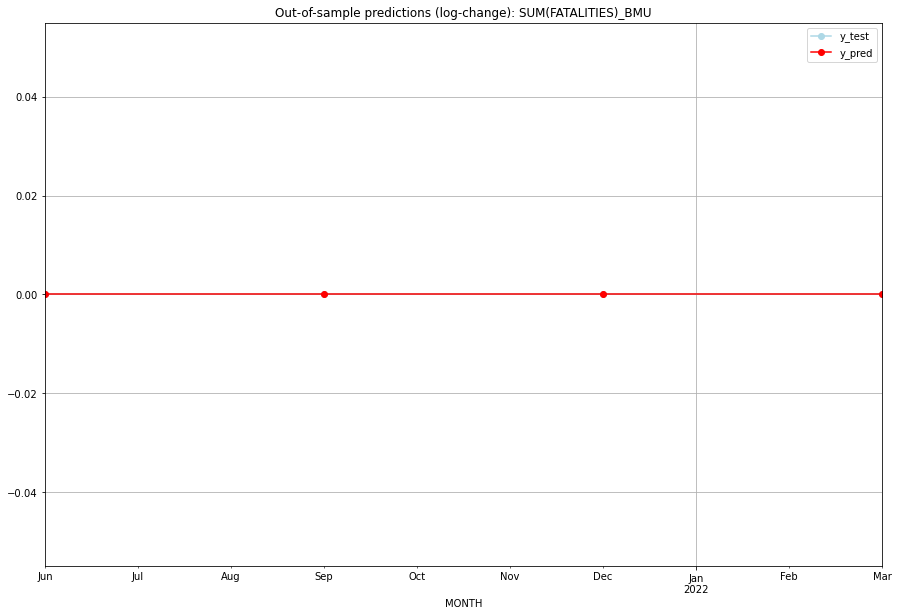

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BMU   
1 2021-07-01       0.0         0.0           0.0             0.0   BMU   
2 2021-10-01       0.0         0.0           0.0             0.0   BMU   
3 2022-01-01       0.0         0.0           0.0             0.0   BMU   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:07
######## BOL (31/234) #########
0
Neighbor countries: []
Getting Data for BOL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 63)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8776354955361425, 'fold_results': [1.5819841959322987, 0.17328679513998635]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BOL   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                 -23.068
Date:                 Wed, 19 Oct 2022   AIC                             48.136
Time:                         10:28:22   BIC                             48.701
Sample:                     01-31-2018   HQIC                            48.020
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         2.0361      0

<Figure size 432x288 with 0 Axes>

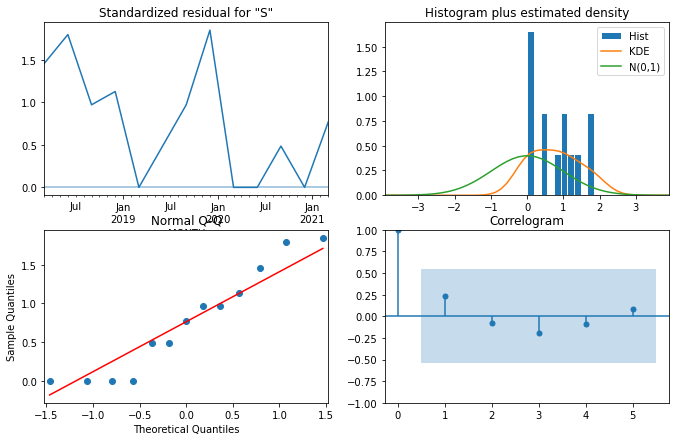

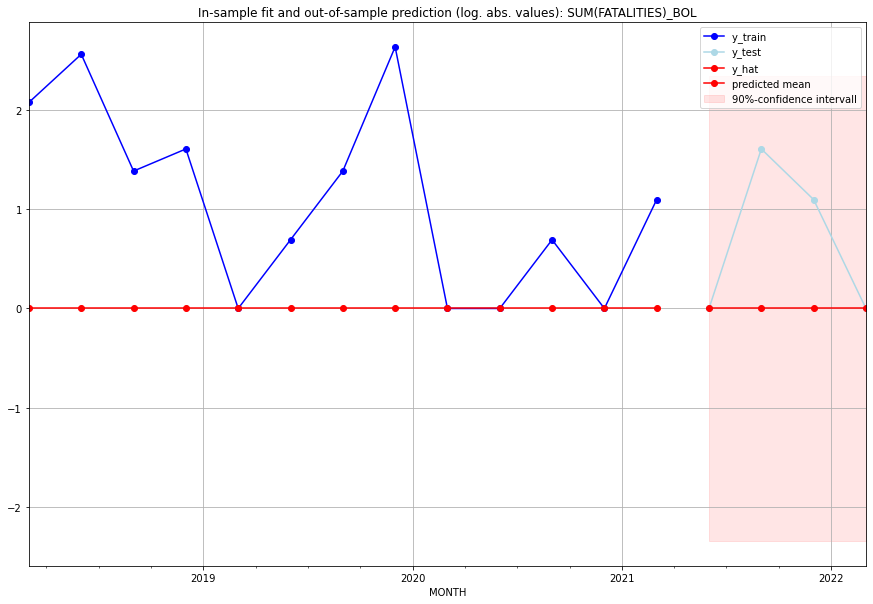

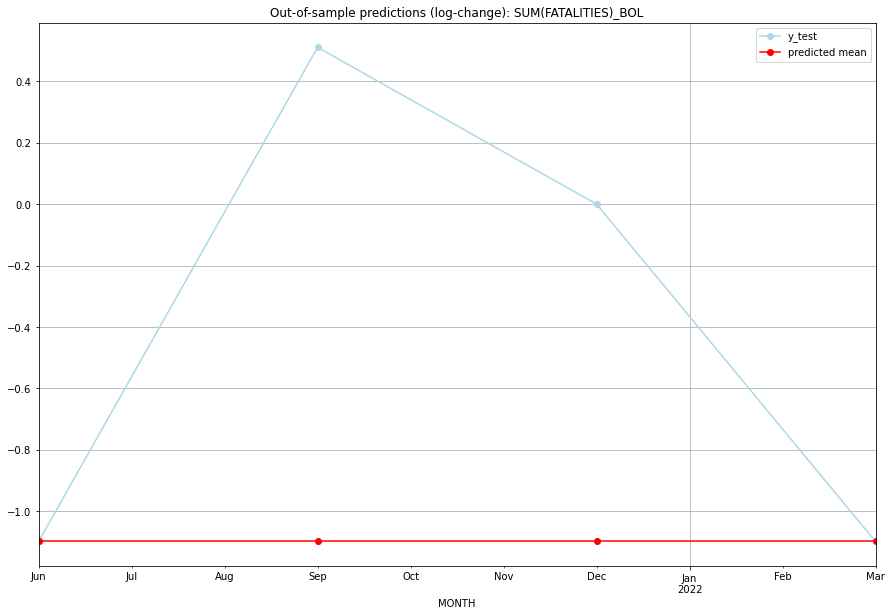

TADDA: 0.9516656224425801
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0     -1.098612       -1.098612   BOL   
1 2021-07-01       0.0         4.0     -1.098612        0.510826   BOL   
2 2021-10-01       0.0         2.0     -1.098612        0.000000   BOL   
3 2022-01-01       0.0         0.0     -1.098612       -1.098612   BOL   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## BRA (32/234) #########
0
Neighbor countries: []
Getting Data for BRA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 63)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU core

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0766354104190834, 'fold_results': [0.05241306099057641, 0.10085775984759038]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BRA   No. Observations:                   13
Model:                SARIMAX(1, 0, 0)   Log Likelihood                   5.218
Date:                 Wed, 19 Oct 2022   AIC                             -6.437
Time:                         10:28:30   BIC                             -5.307
Sample:                     01-31-2018   HQIC                            -6.669
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9999      

<Figure size 432x288 with 0 Axes>

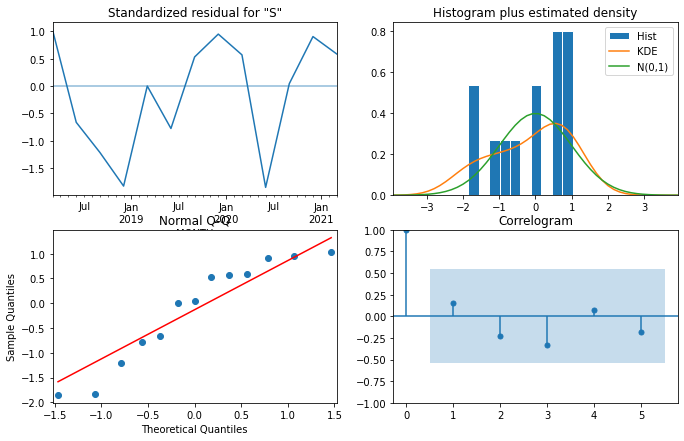

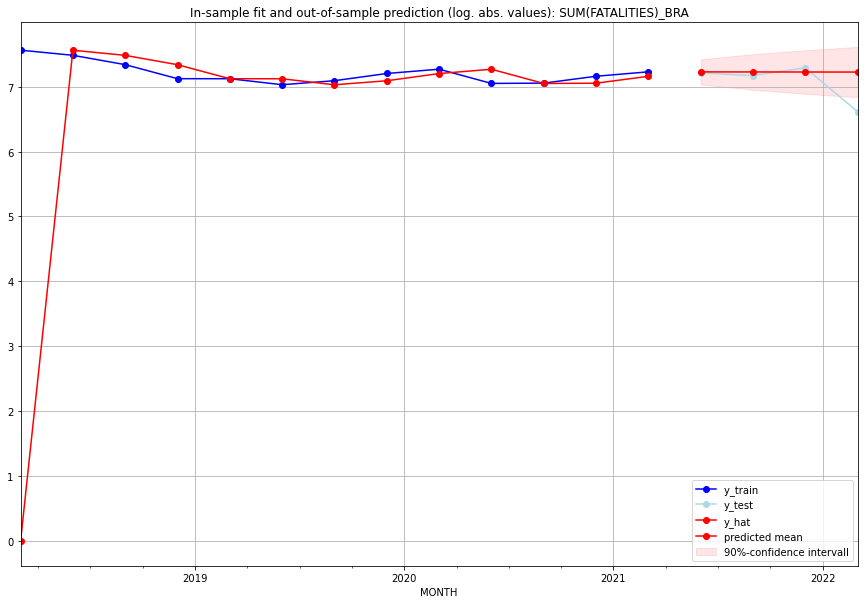

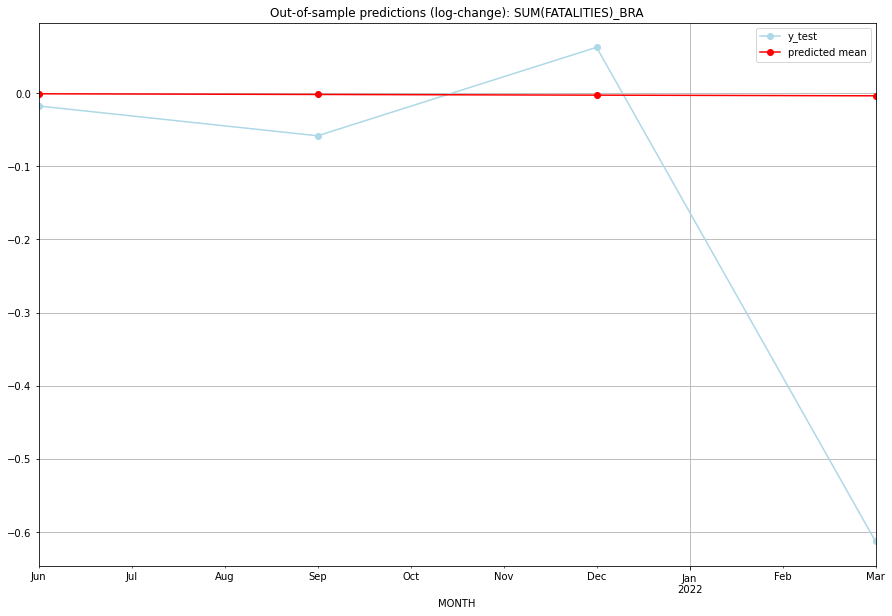

TADDA: 0.18763649407789895
Evaluation finished.
       MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1374.738180      1352.0     -0.000917       -0.017583   BRA   
1 2021-07-01  1373.477675      1298.0     -0.001833       -0.058312   BRA   
2 2021-10-01  1372.218486      1465.0     -0.002750        0.062630   BRA   
3 2022-01-01  1370.960609       745.0     -0.003666       -0.612937   BRA   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## BRB (33/234) #########
0
Neighbor countries: []
Getting Data for BRB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 54)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH C

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BRB   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                  -2.997
Date:                 Wed, 19 Oct 2022   AIC                             11.993
Time:                         10:28:47   BIC                             13.688
Sample:                     01-31-2018   HQIC                            11.645
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1      -1.276e-06   6.03e+04  -2.11e-11      1.000   -1.18e+05    1.18

<Figure size 432x288 with 0 Axes>

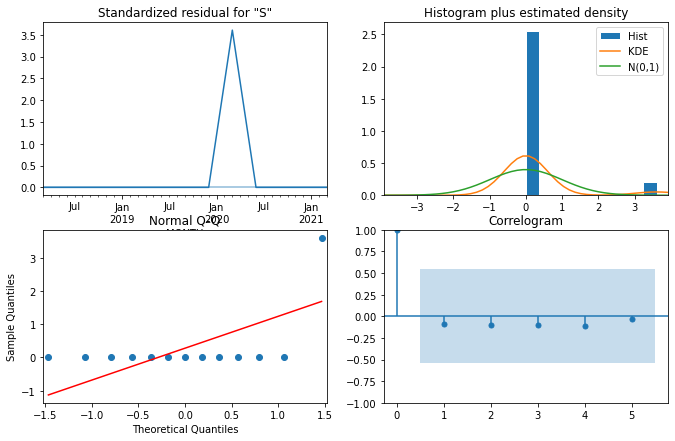

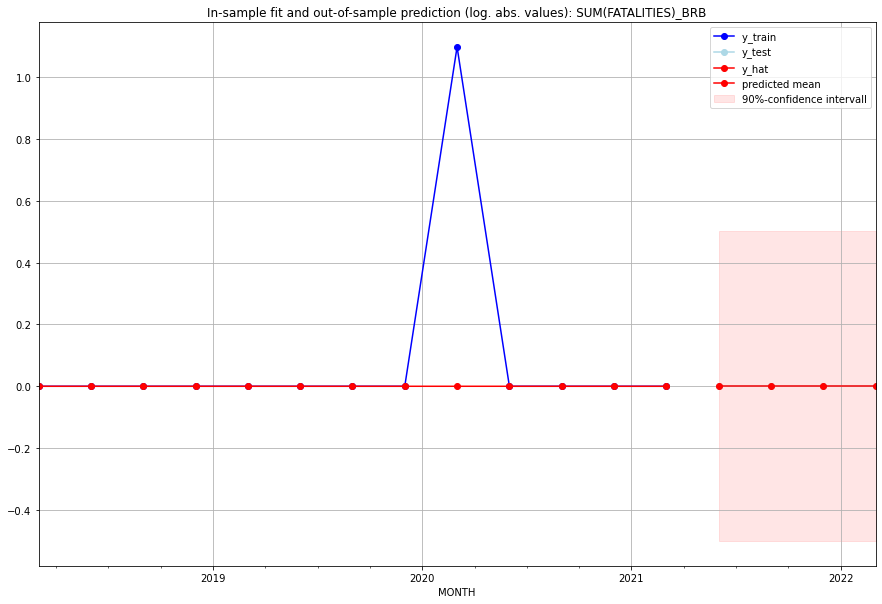

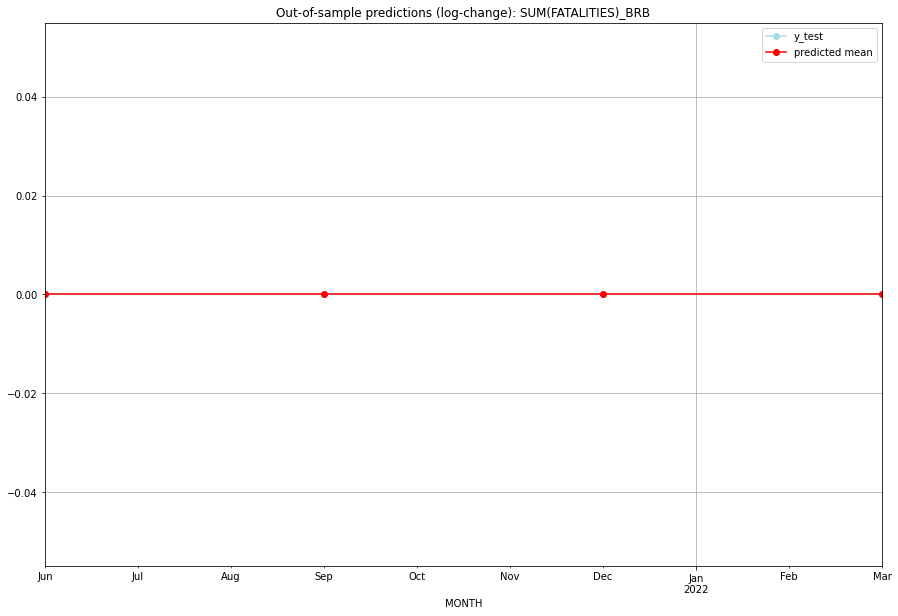

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BRB   
1 2021-07-01       0.0         0.0           0.0             0.0   BRB   
2 2021-10-01       0.0         0.0           0.0             0.0   BRB   
3 2022-01-01       0.0         0.0           0.0             0.0   BRB   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## BRN (34/234) #########
0
Neighbor countries: []
Getting Data for BRN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 52)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross va

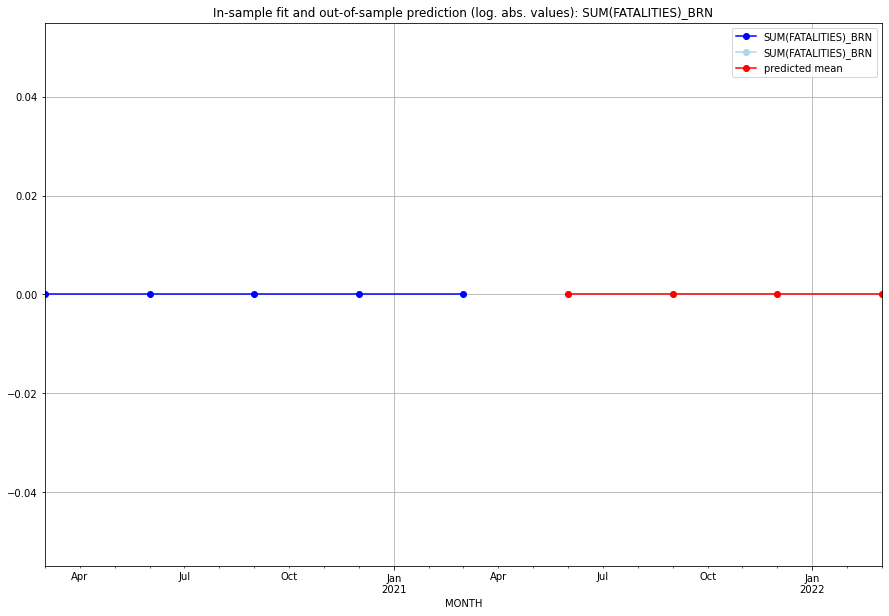

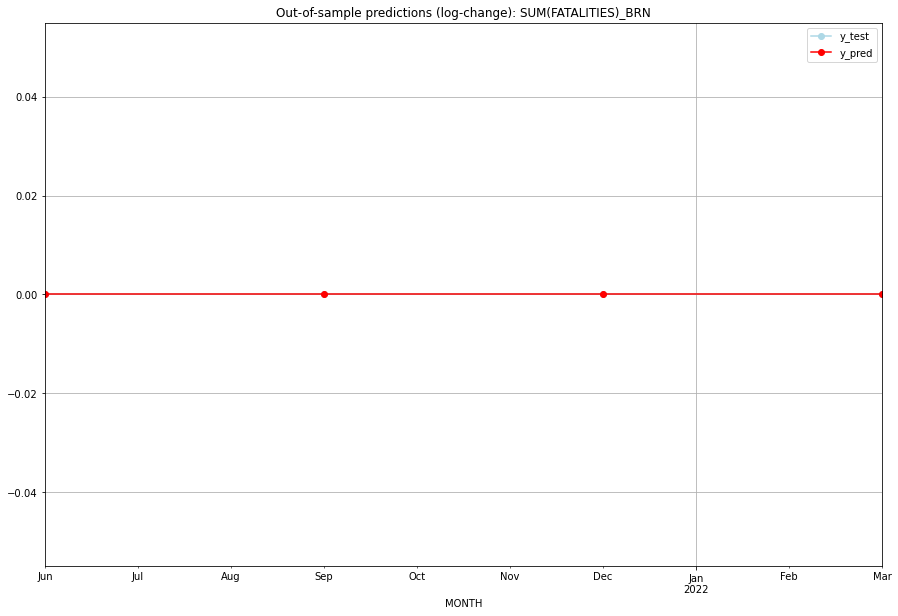

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BRN   
1 2021-07-01       0.0         0.0           0.0             0.0   BRN   
2 2021-10-01       0.0         0.0           0.0             0.0   BRN   
3 2022-01-01       0.0         0.0           0.0             0.0   BRN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## BTN (35/234) #########
0
Neighbor countries: []
Getting Data for BTN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 59)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


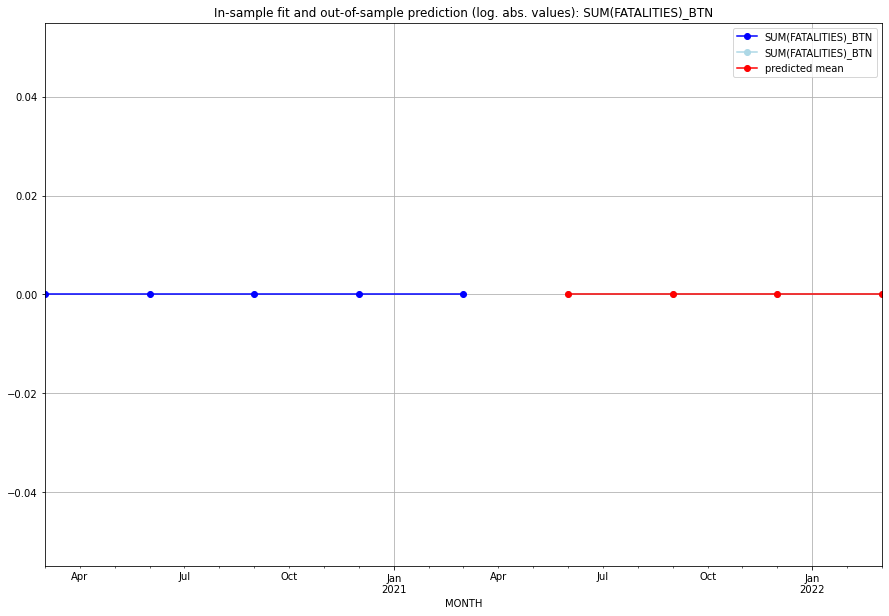

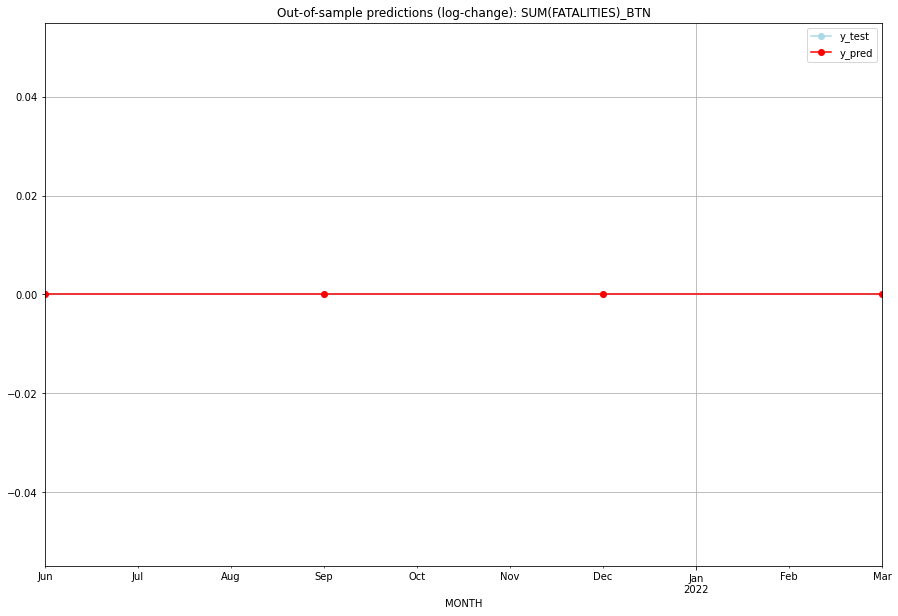

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   BTN   
1 2021-07-01       0.0         0.0           0.0             0.0   BTN   
2 2021-10-01       0.0         0.0           0.0             0.0   BTN   
3 2022-01-01       0.0         0.0           0.0             0.0   BTN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## BWA (36/234) #########
0
Neighbor countries: []
Getting Data for BWA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.18437494125677586, 'fold_results': [0.0, 0.0, 0.17328679513998632, 0.0001980017153775382, 0.7483899094285155]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BWA   No. Observations:                   96
Model:                SARIMAX(0, 0, 1)   Log Likelihood                   5.731
Date:                 Wed, 19 Oct 2022   AIC                             -1.463
Time:                         10:29:15   BIC                             11.359
Sample:                     04-30-1997   HQIC                             3.720
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

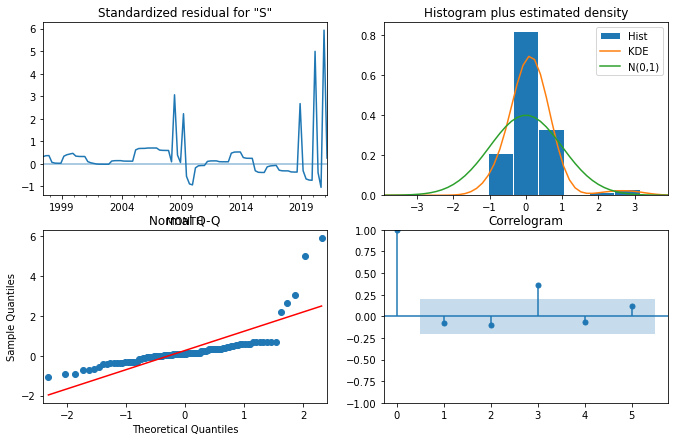

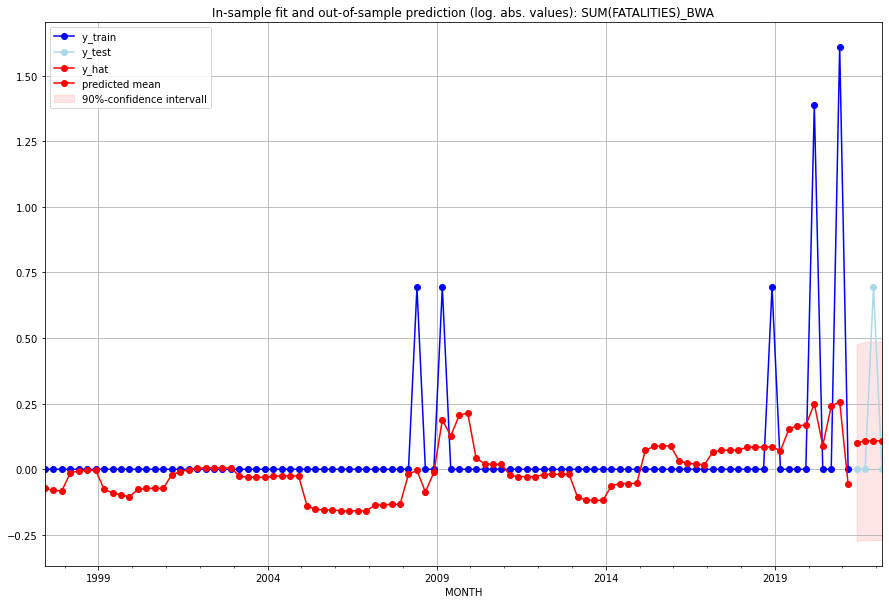

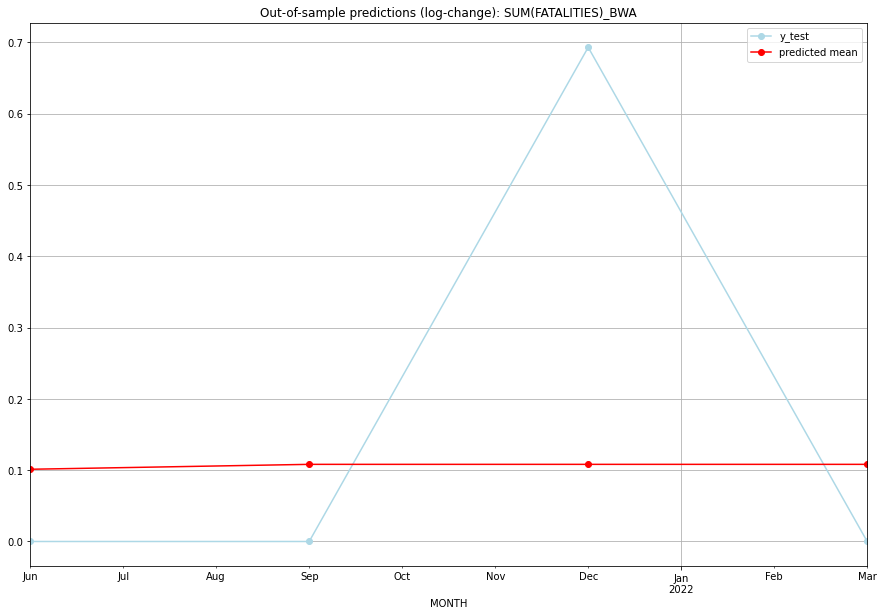

TADDA: 0.22566416543587825
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.106619         0.0      0.101309        0.000000   BWA   
1 2021-07-01  0.114271         0.0      0.108200        0.000000   BWA   
2 2021-10-01  0.114271         1.0      0.108200        0.693147   BWA   
3 2022-01-01  0.114271         0.0      0.108200        0.000000   BWA   

                                          PARAMETERS  
0  {'params': [3, (0, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:24
######## CAF (37/234) #########
0
Neighbor countries: []
Getting Data for CAF
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 59)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU c

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.449823989215545, 'fold_results': [0.6684507640645416, 0.25897487773843153, 0.4709640101456003, 0.37489857263747317, 0.4758317214916785]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CAF   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -178.143
Date:                 Wed, 19 Oct 2022   AIC                            364.287
Time:                         10:29:34   BIC                            374.502
Sample:                     04-30-1997   HQIC                           368.415
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

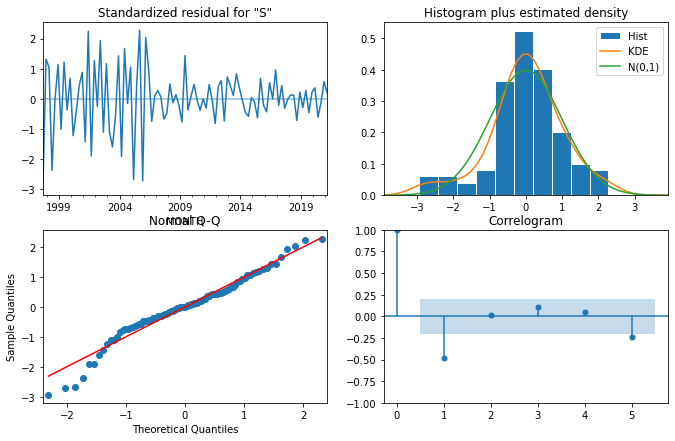

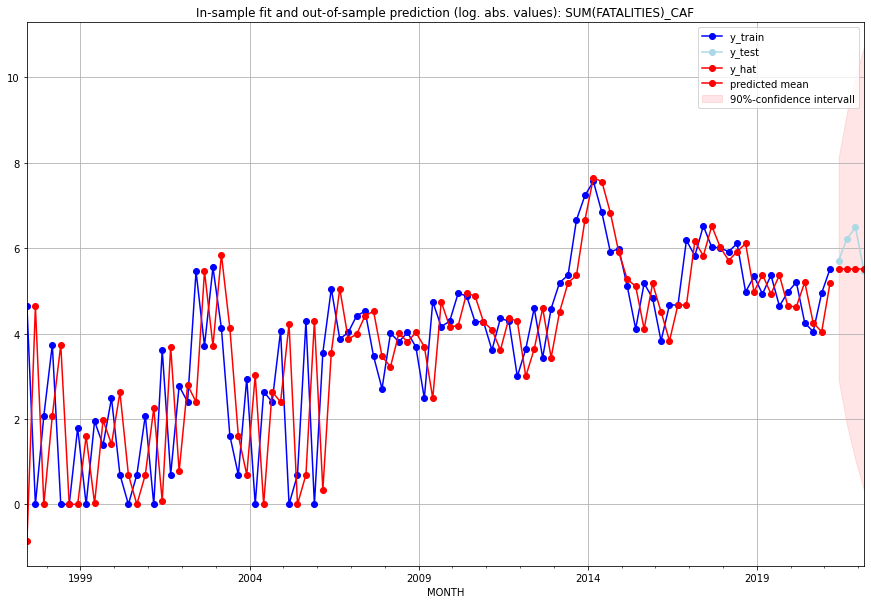

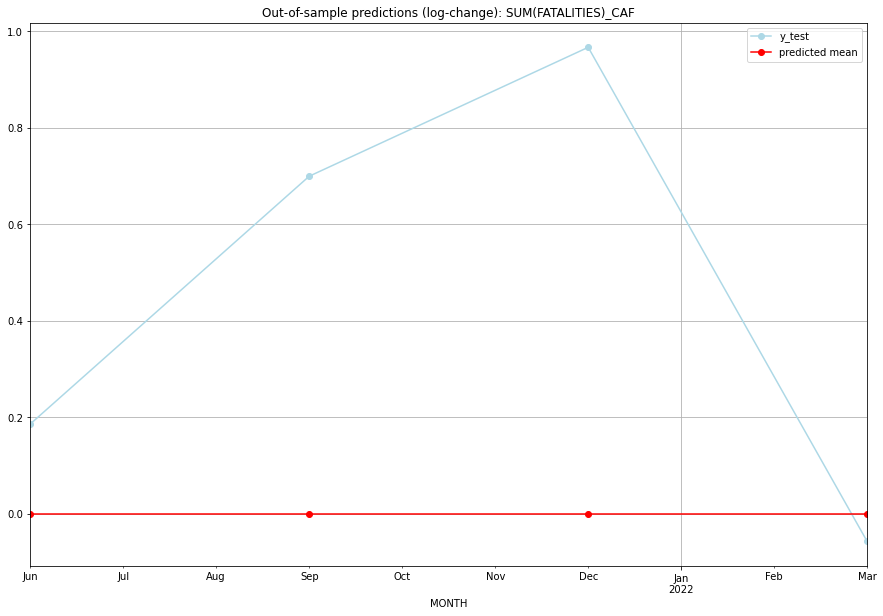

TADDA: 0.4771577031457839
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01     249.0       300.0 -2.664535e-15        0.185649   CAF   
1 2021-07-01     249.0       502.0 -2.664535e-15        0.699129   CAF   
2 2021-10-01     249.0       656.0 -2.664535e-15        0.966223   CAF   
3 2022-01-01     249.0       235.0 -2.664535e-15       -0.057629   CAF   

                                          PARAMETERS  
0  {'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## CAN (38/234) #########
0
Neighbor countries: []
Getting Data for CAN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 63)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient da

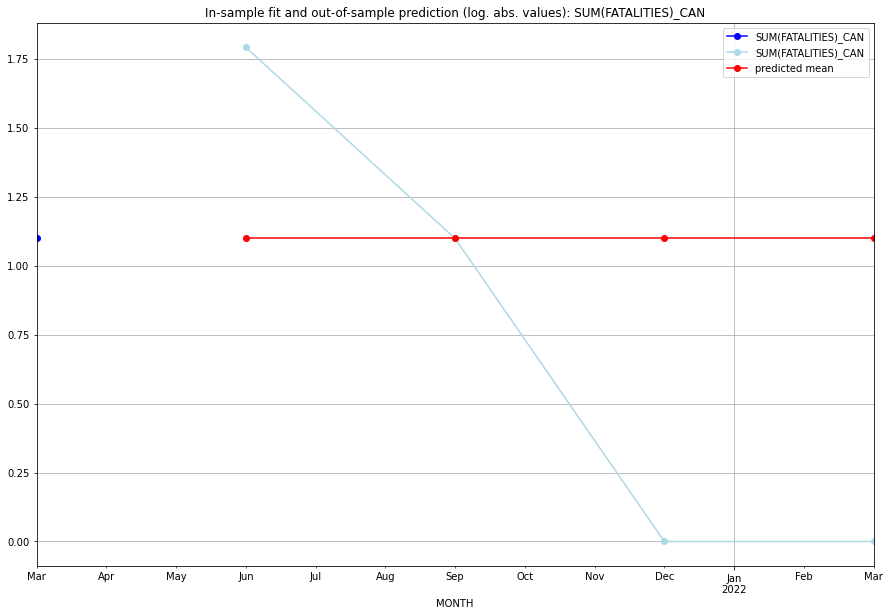

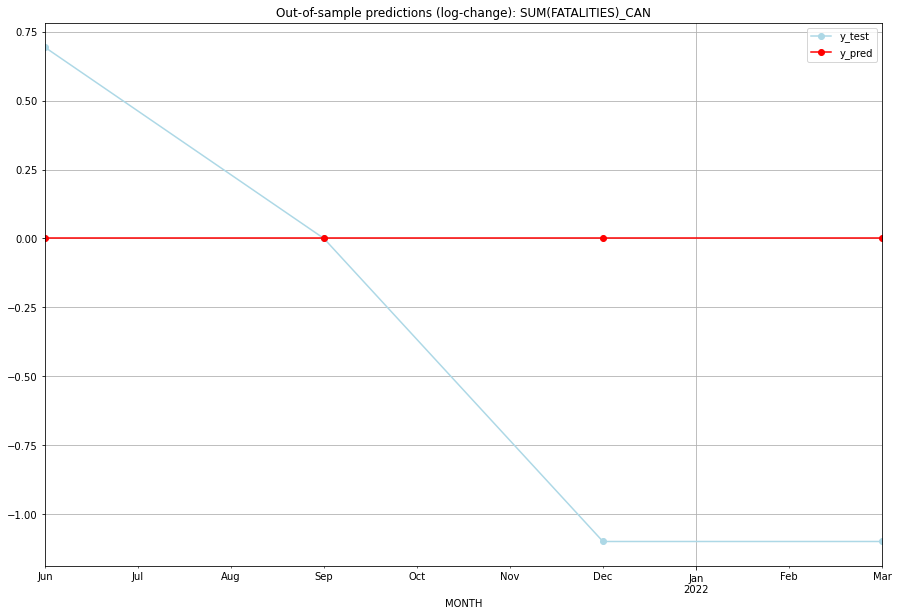

TADDA: 0.7225929394740411
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.098612    1.791759           0.0        0.693147   CAN   
1 2021-07-01  1.098612    1.098612           0.0        0.000000   CAN   
2 2021-10-01  1.098612    0.000000           0.0       -1.098612   CAN   
3 2022-01-01  1.098612    0.000000           0.0       -1.098612   CAN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## CHE (39/234) #########
0
Neighbor countries: []
Getting Data for CHE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 63)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


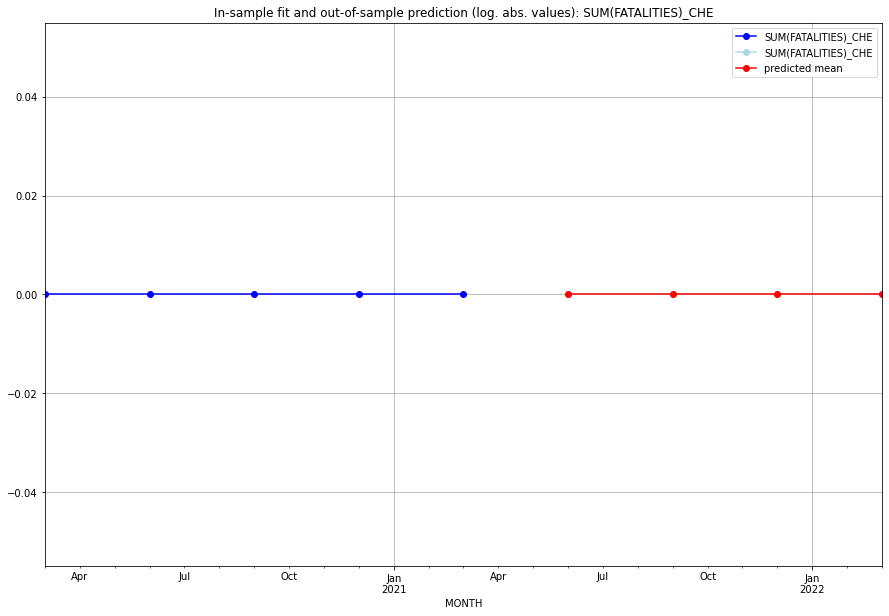

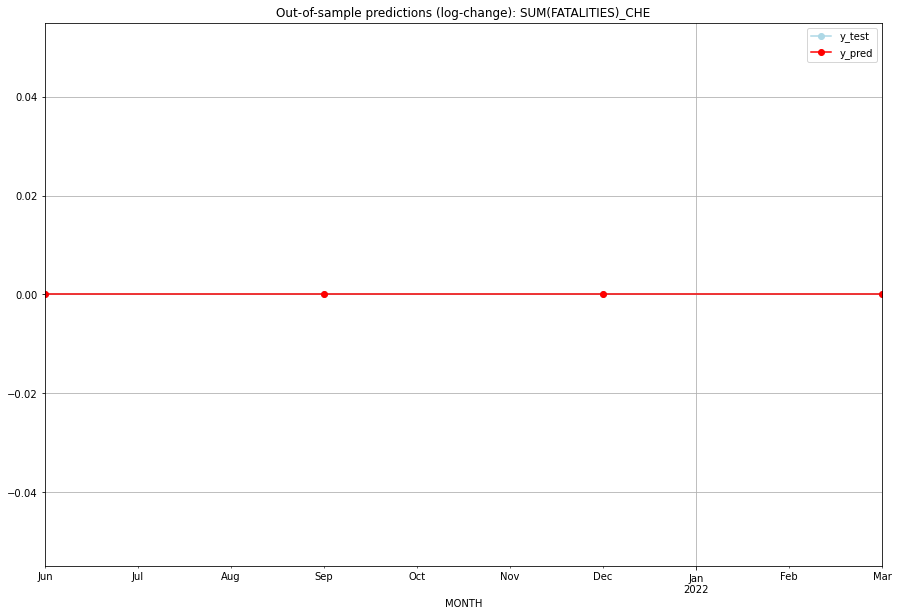

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   CHE   
1 2021-07-01       0.0         0.0           0.0             0.0   CHE   
2 2021-10-01       0.0         0.0           0.0             0.0   CHE   
3 2022-01-01       0.0         0.0           0.0             0.0   CHE   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## CHL (40/234) #########
0
Neighbor countries: []
Getting Data for CHL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 64)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.7242374831931746, 'fold_results': [1.199906488634107, 0.24856847775224222]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CHL   No. Observations:                   13
Model:                SARIMAX(0, 1, 2)   Log Likelihood                 -16.980
Date:                 Wed, 19 Oct 2022   AIC                             41.959
Time:                         10:29:50   BIC                             43.899
Sample:                     01-31-2018   HQIC                            41.241
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.1697      0.

<Figure size 432x288 with 0 Axes>

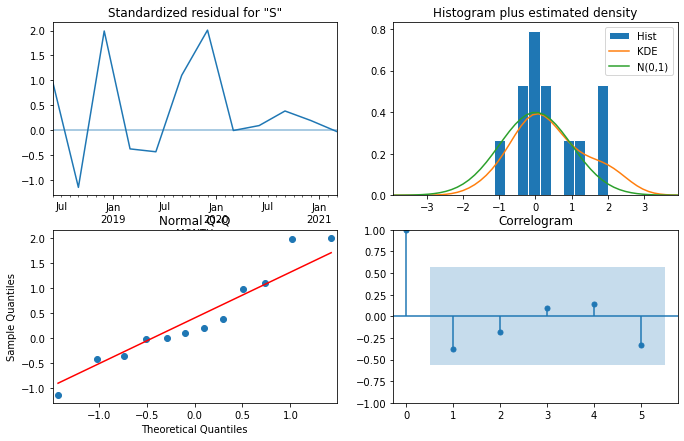

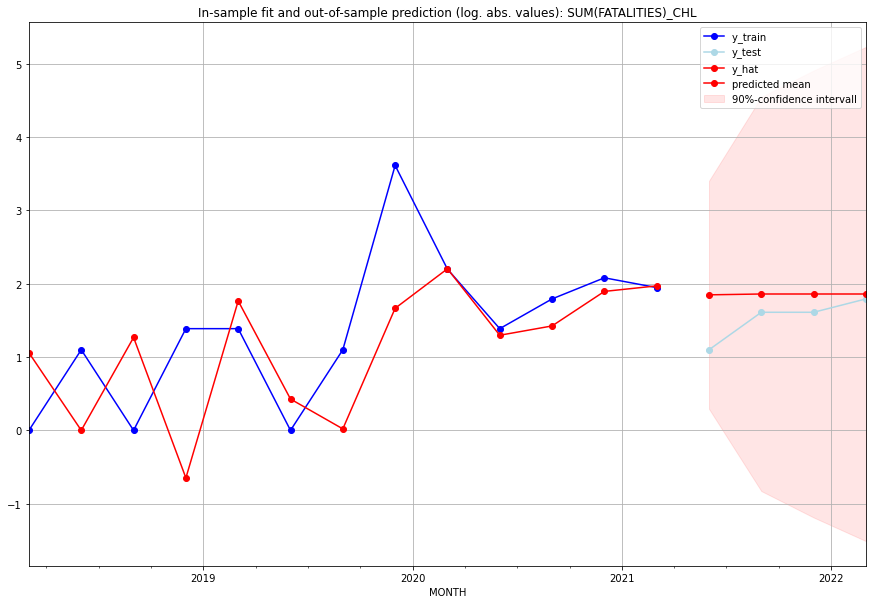

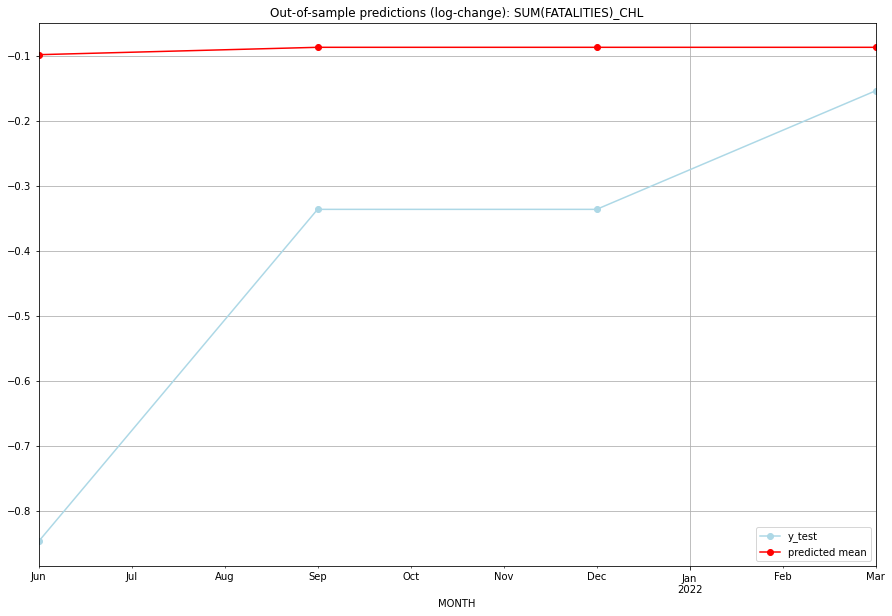

TADDA: 0.3285273189360321
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  5.342855         2.0     -0.098581       -0.847298   CHL   
1 2021-07-01  5.415237         4.0     -0.087234       -0.336472   CHL   
2 2021-10-01  5.415237         4.0     -0.087234       -0.336472   CHL   
3 2022-01-01  5.415237         5.0     -0.087234       -0.154151   CHL   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## CHN (41/234) #########
0
Neighbor countries: []
Getting Data for CHN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 62)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU core

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.7042602792529208, 'fold_results': [1.0182240717324569, 0.39029648677338474]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CHN   No. Observations:                   13
Model:                SARIMAX(1, 1, 0)   Log Likelihood                  -9.804
Date:                 Wed, 19 Oct 2022   AIC                             23.608
Time:                         10:30:07   BIC                             24.577
Sample:                     01-31-2018   HQIC                            23.249
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2537      0

<Figure size 432x288 with 0 Axes>

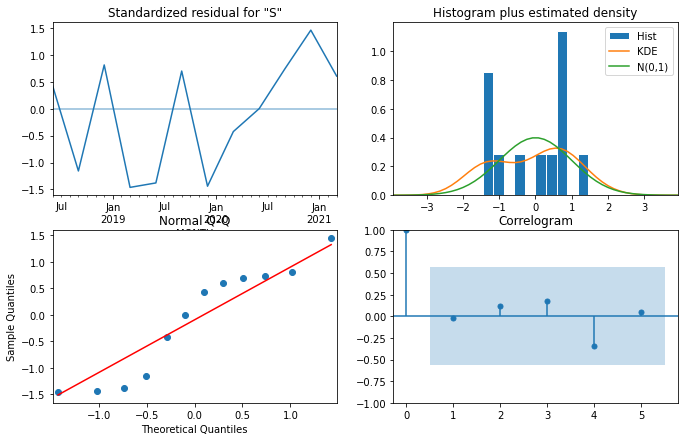

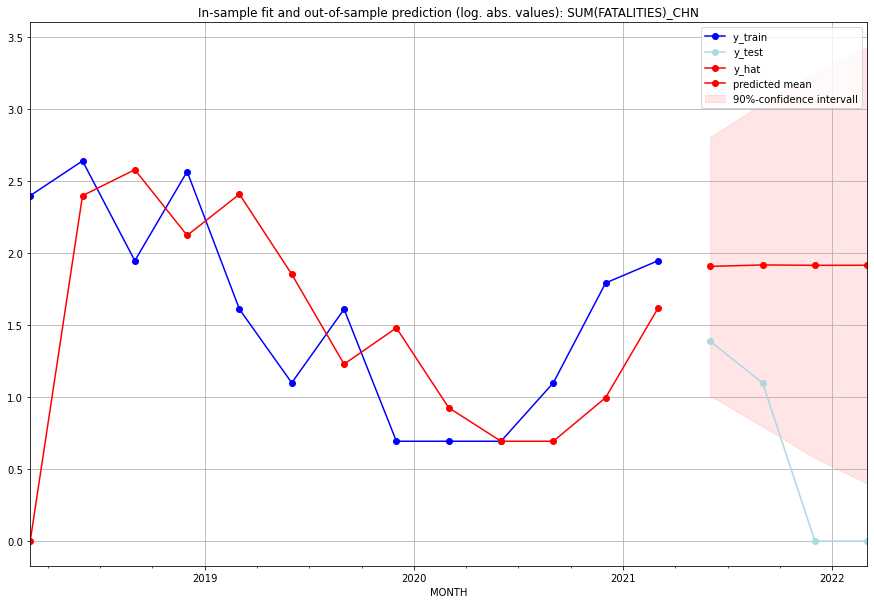

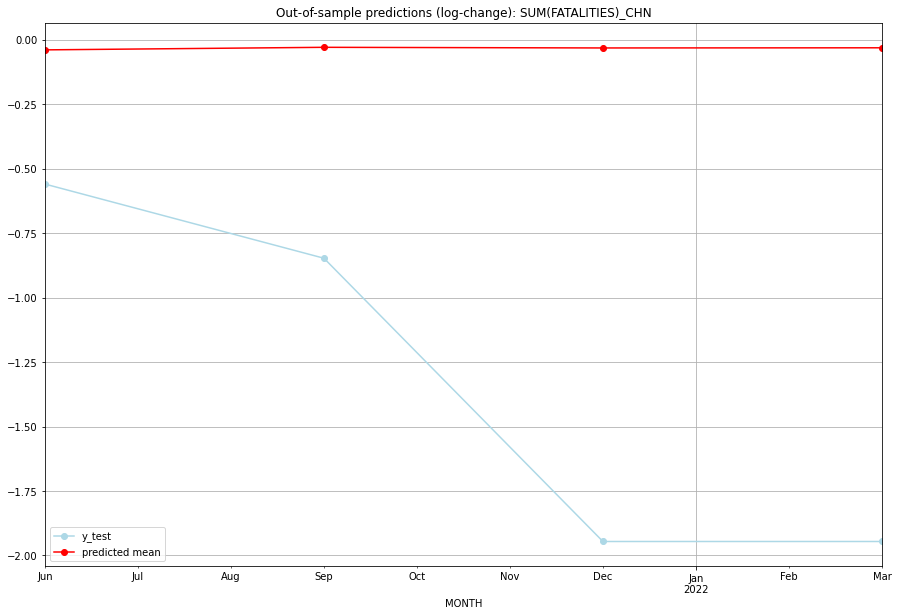

TADDA: 1.2919155904887951
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  5.731506         3.0     -0.039111       -0.559616   CHN   
1 2021-07-01  5.798638         2.0     -0.029188       -0.847298   CHN   
2 2021-10-01  5.781542         0.0     -0.031706       -1.945910   CHN   
3 2022-01-01  5.785875         0.0     -0.031067       -1.945910   CHN   

                                          PARAMETERS  
0  {'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:05
######## CIV (42/234) #########
0
Neighbor countries: []
Getting Data for CIV
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU co

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.8587704913937445, 'fold_results': [1.0109109770070788, 0.44634223121909533, 0.9699537686795727, 0.7675890880000227, 1.0990563920629526]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CIV   No. Observations:                   96
Model:                SARIMAX(2, 0, 3)   Log Likelihood                -171.497
Date:                 Wed, 19 Oct 2022   AIC                            360.994
Time:                         10:30:31   BIC                            384.073
Sample:                     04-30-1997   HQIC                           370.323
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

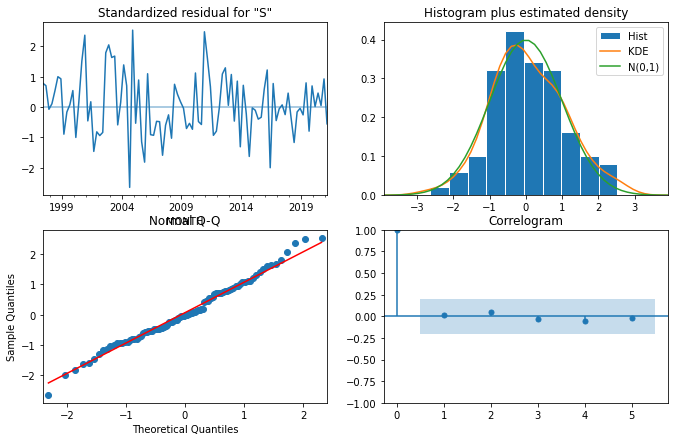

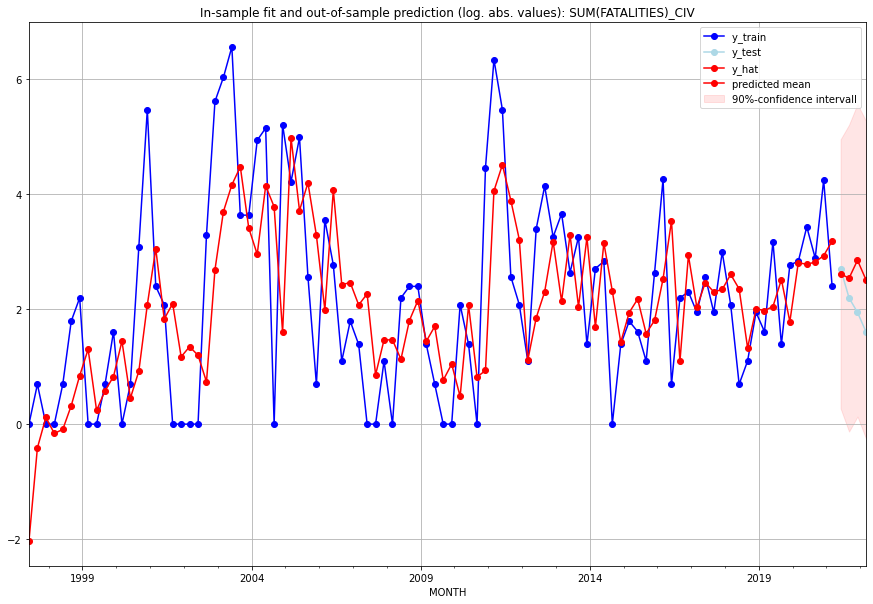

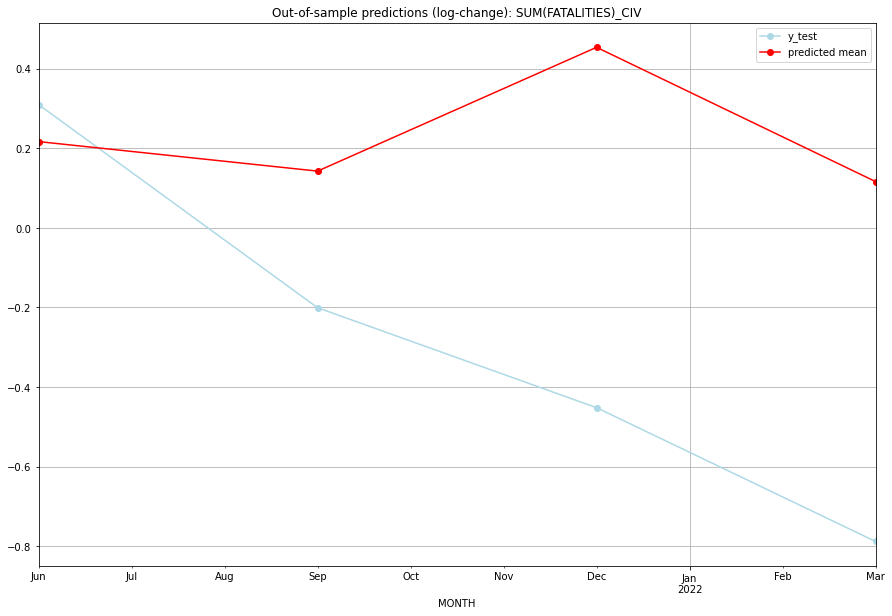

TADDA: 0.7403368850461396
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  12.667292        14.0      0.217110        0.310155   CIV   
1 2021-07-01  11.689428         8.0      0.142874       -0.200671   CIV   
2 2021-10-01  16.323828         6.0      0.454188       -0.451985   CIV   
3 2022-01-01  11.359544         4.0      0.116533       -0.788457   CIV   

                                          PARAMETERS  
0  {'params': [3, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:25
######## CMR (43/234) #########
0
Neighbor countries: []
Getting Data for CMR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 C

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.37336093811277815, 'fold_results': [0.2053189113628393, 0.21874819169395687, 0.7114668998704266, 0.347033262534461, 0.38423742510220715]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CMR   No. Observations:                   96
Model:                SARIMAX(1, 1, 3)   Log Likelihood                -144.894
Date:                 Wed, 19 Oct 2022   AIC                            303.789
Time:                         10:30:48   BIC                            321.666
Sample:                     04-30-1997   HQIC                           311.012
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

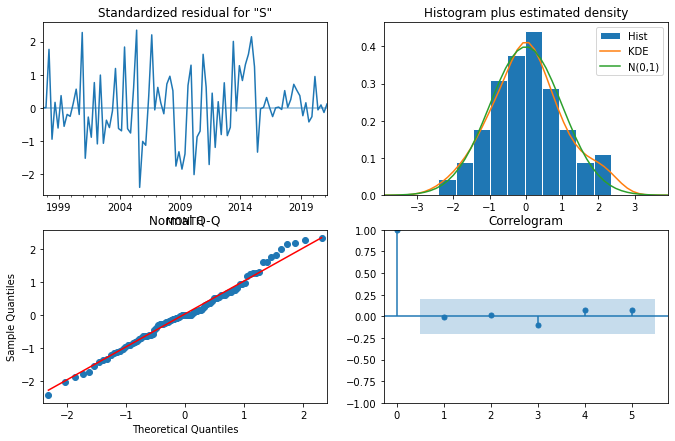

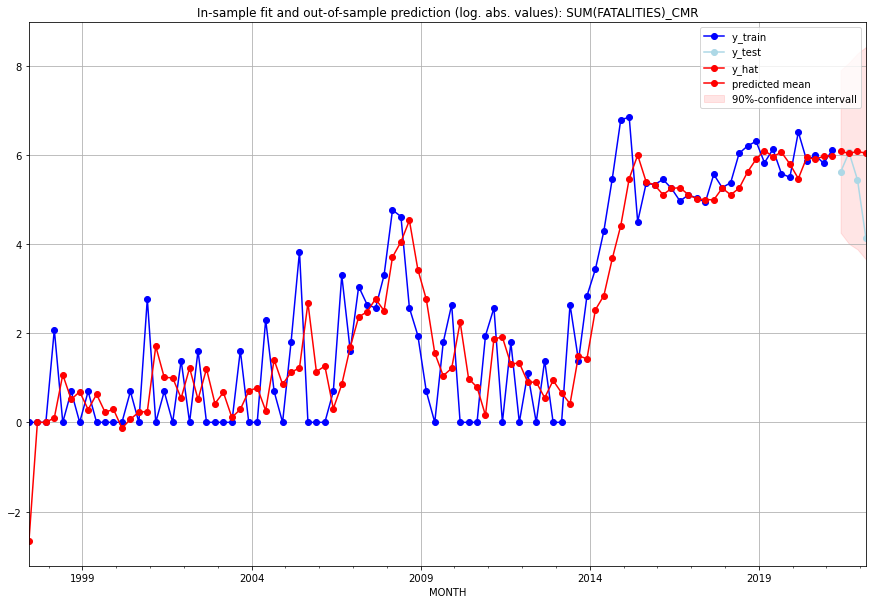

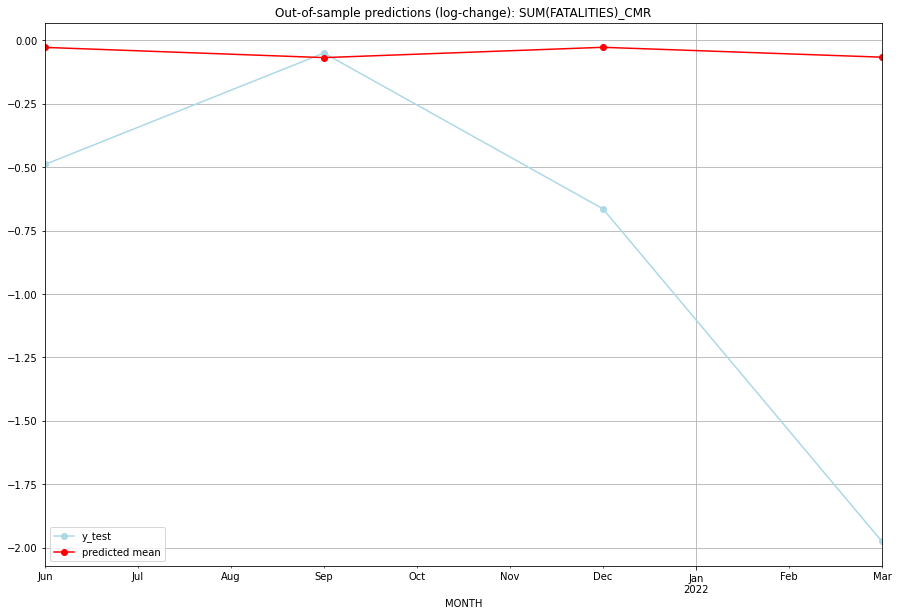

TADDA: 0.7561243178255042
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  433.559311       273.0     -0.028226       -0.489430   CMR   
1 2021-07-01  416.398560       424.0     -0.068517       -0.050469   CMR   
2 2021-10-01  433.704400       229.0     -0.027892       -0.664479   CMR   
3 2022-01-01  417.130151        61.0     -0.066766       -1.975424   CMR   

                                          PARAMETERS  
0  {'params': [2, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## COD (44/234) #########
0
Neighbor countries: []
Getting Data for COD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.33325516356732693, 'fold_results': [0.297198721299448, 0.32551496276824077, 0.3534509987212131, 0.2842448177721719, 0.4058663172755608]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COD   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -155.947
Date:                 Wed, 19 Oct 2022   AIC                            313.894
Time:                         10:31:08   BIC                            316.448
Sample:                     04-30-1997   HQIC                           314.926
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

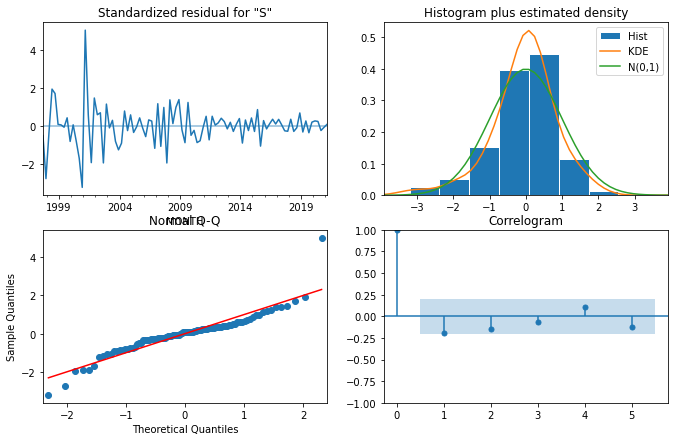

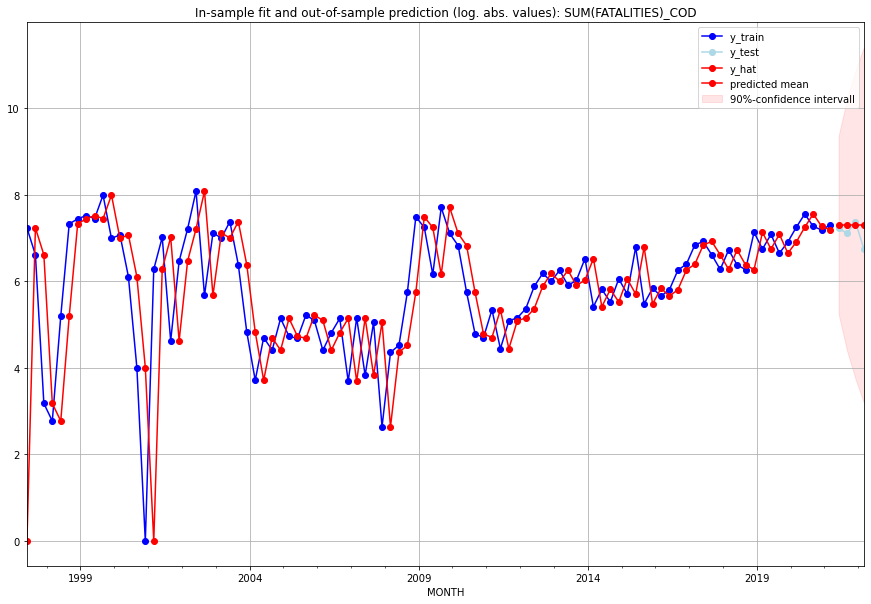

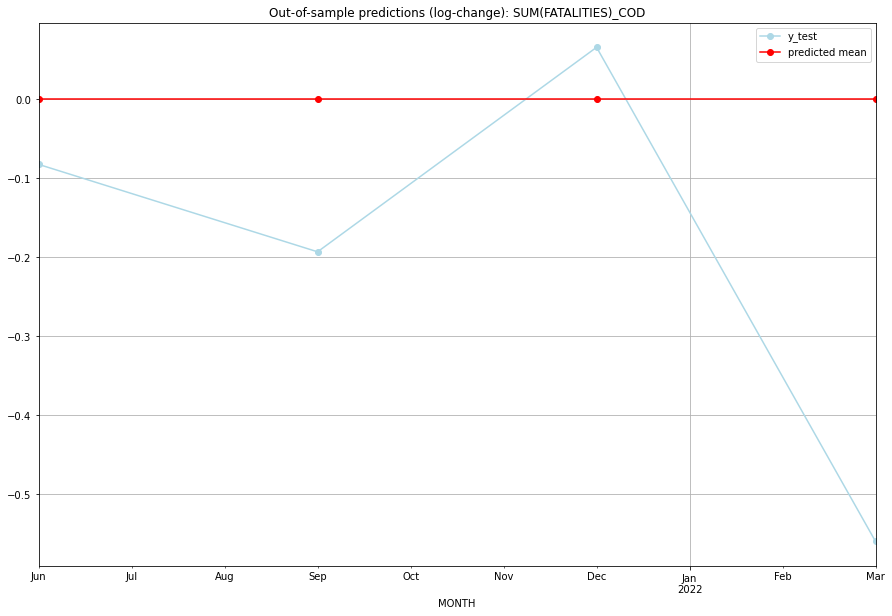

TADDA: 0.2253172761857154
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01    1480.0      1363.0           0.0       -0.082296   COD   
1 2021-07-01    1480.0      1220.0           0.0       -0.193047   COD   
2 2021-10-01    1480.0      1581.0           0.0        0.065972   COD   
3 2022-01-01    1480.0       845.0           0.0       -0.559953   COD   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## COG (45/234) #########
0
Neighbor countries: []
Getting Data for COG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 60)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU co

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 1.15930458370117, 'fold_results': [1.4630506199436188, 1.1796247178237735, 1.170532806781055, 0.9158904115324116, 1.0674243624249906]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COG   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -187.421
Date:                 Wed, 19 Oct 2022   AIC                            376.843
Time:                         10:31:23   BIC                            379.396
Sample:                     04-30-1997   HQIC                           377.874
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------

<Figure size 432x288 with 0 Axes>

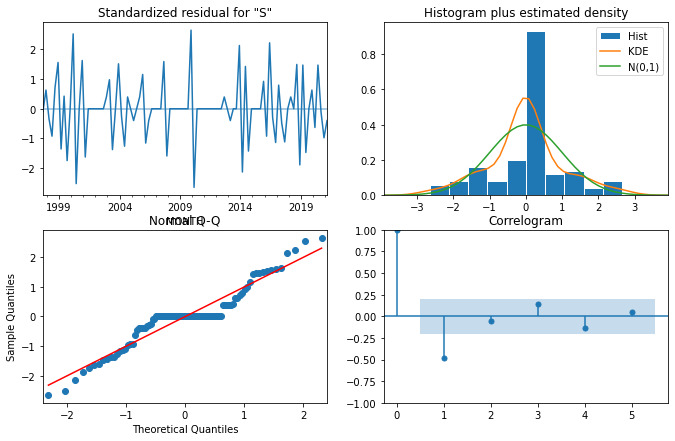

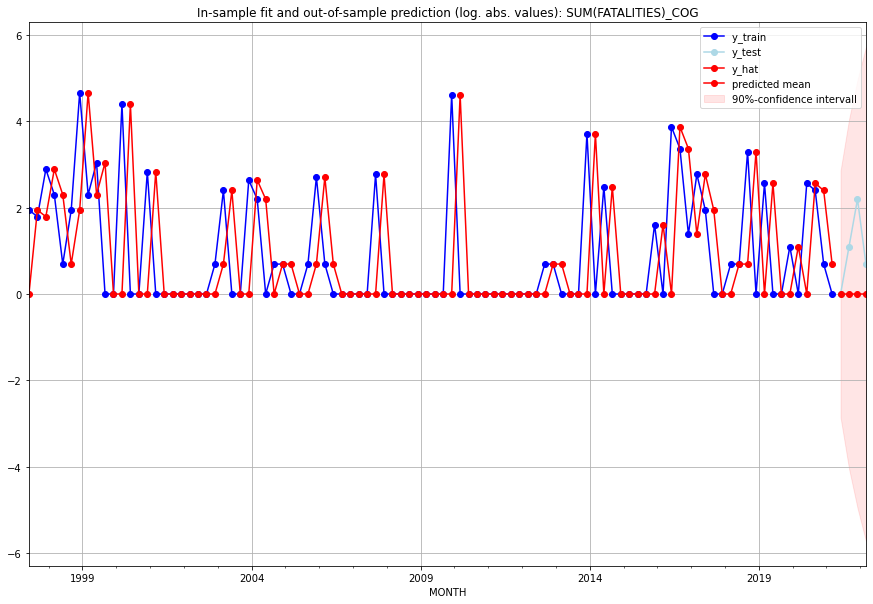

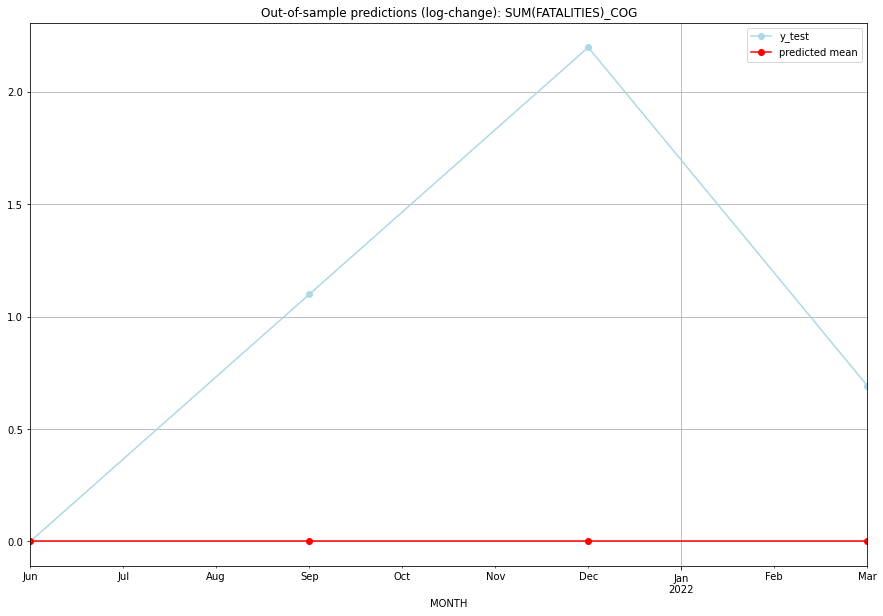

TADDA: 0.9972460116410689
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   COG   
1 2021-07-01       0.0         2.0           0.0        1.098612   COG   
2 2021-10-01       0.0         8.0           0.0        2.197225   COG   
3 2022-01-01       0.0         1.0           0.0        0.693147   COG   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## COK (46/234) #########
0
Neighbor countries: []
Getting Data for COK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient dat

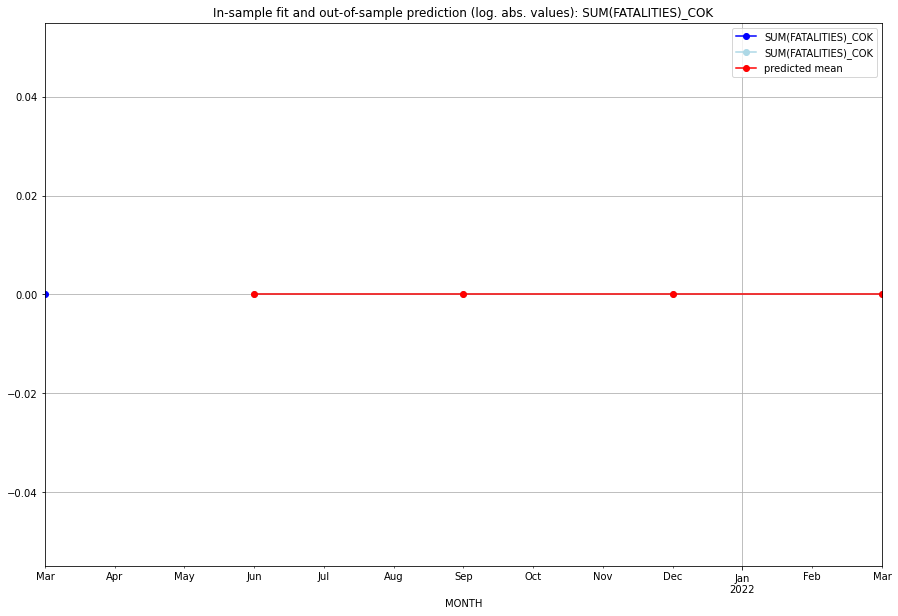

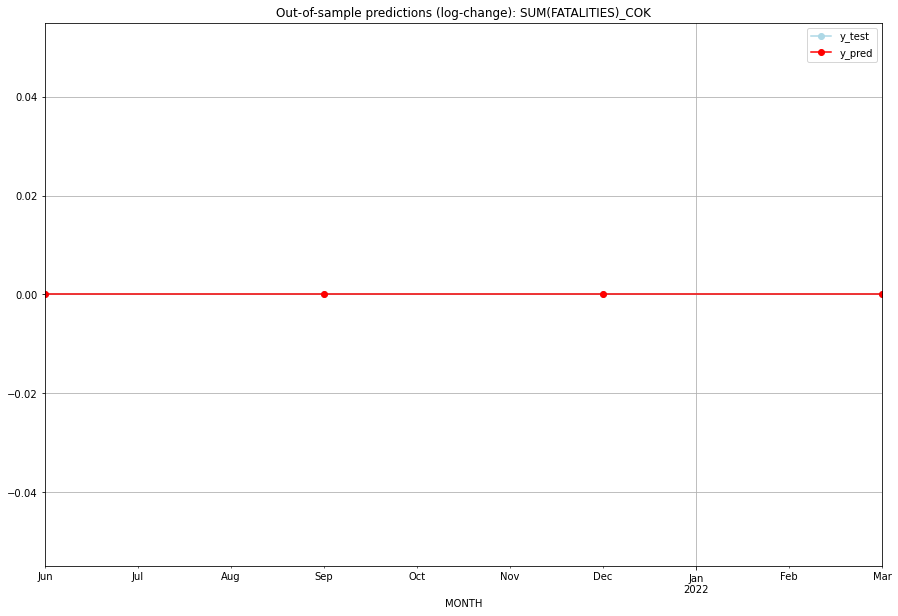

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   COK   
1 2021-07-01       0.0         0.0           0.0             0.0   COK   
2 2021-10-01       0.0         0.0           0.0             0.0   COK   
3 2022-01-01       0.0         0.0           0.0             0.0   COK   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## COL (47/234) #########
0
Neighbor countries: []
Getting Data for COL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 65)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.1497519741324087, 'fold_results': [0.1497519741324087, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COL   No. Observations:                   13
Model:                SARIMAX(1, 0, 2)   Log Likelihood                  -0.866
Date:                 Wed, 19 Oct 2022   AIC                              9.732
Time:                         10:31:39   BIC                             11.992
Sample:                     01-31-2018   HQIC                             9.268
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9997      0.008    127.912 

<Figure size 432x288 with 0 Axes>

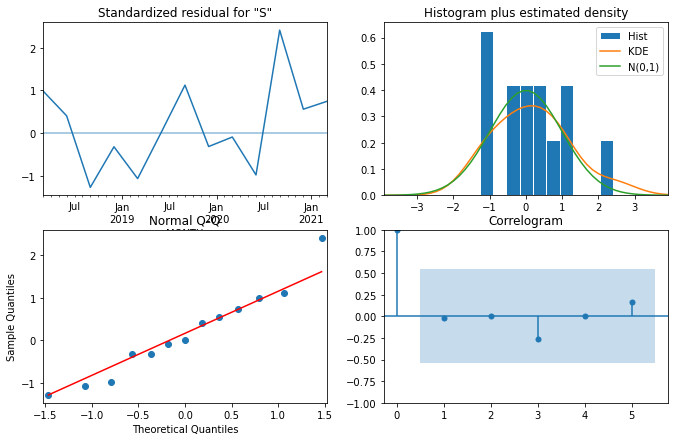

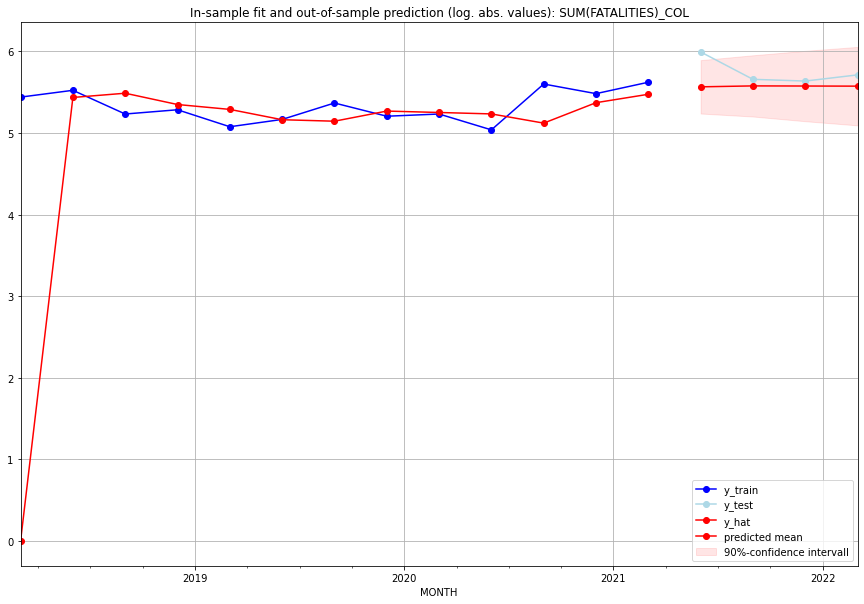

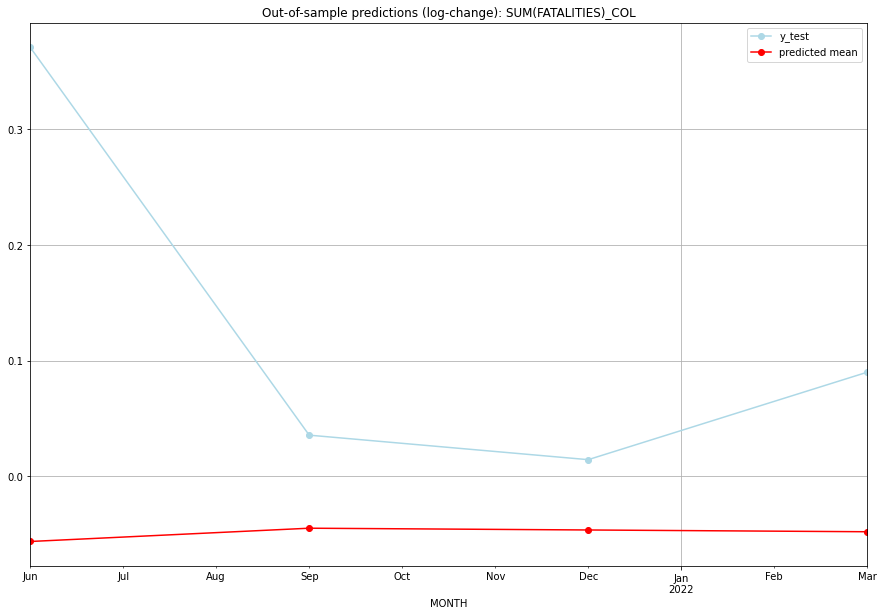

TADDA: 0.22560348507315142
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  259.867819       399.0     -0.056387        0.371064   COL   
1 2021-07-01  262.882790       285.0     -0.044896        0.035591   COL   
2 2021-10-01  262.478647       279.0     -0.046429        0.014389   COL   
3 2022-01-01  262.075235       301.0     -0.047961        0.090026   COL   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## COM (48/234) #########
0
Neighbor countries: []
Getting Data for COM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 54)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV o

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.03465735902799726, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COM   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                 118.056
Date:                 Wed, 19 Oct 2022   AIC                           -234.112
Time:                         10:32:27   BIC                           -231.547
Sample:                     04-30-1997   HQIC                          -233.075
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0050      

<Figure size 432x288 with 0 Axes>

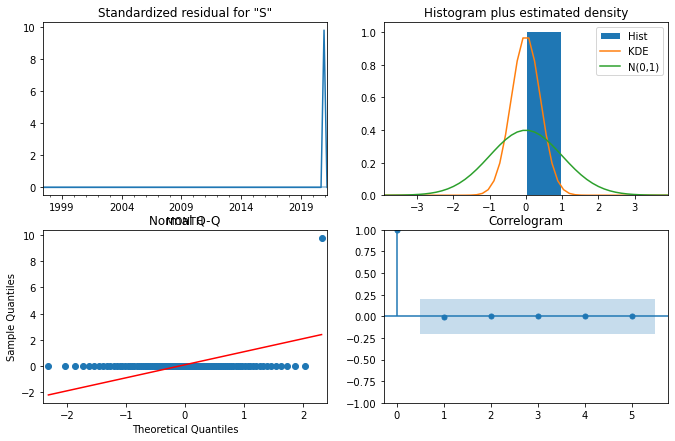

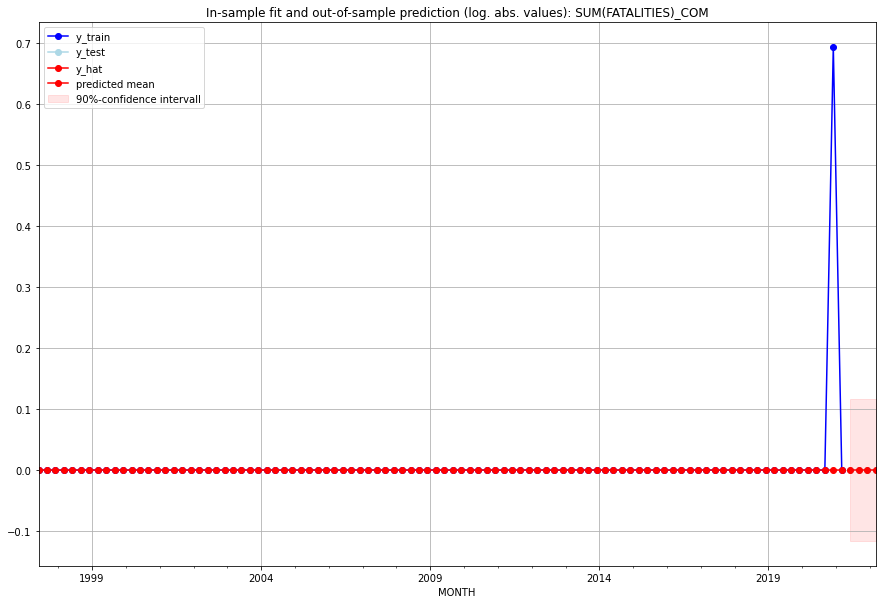

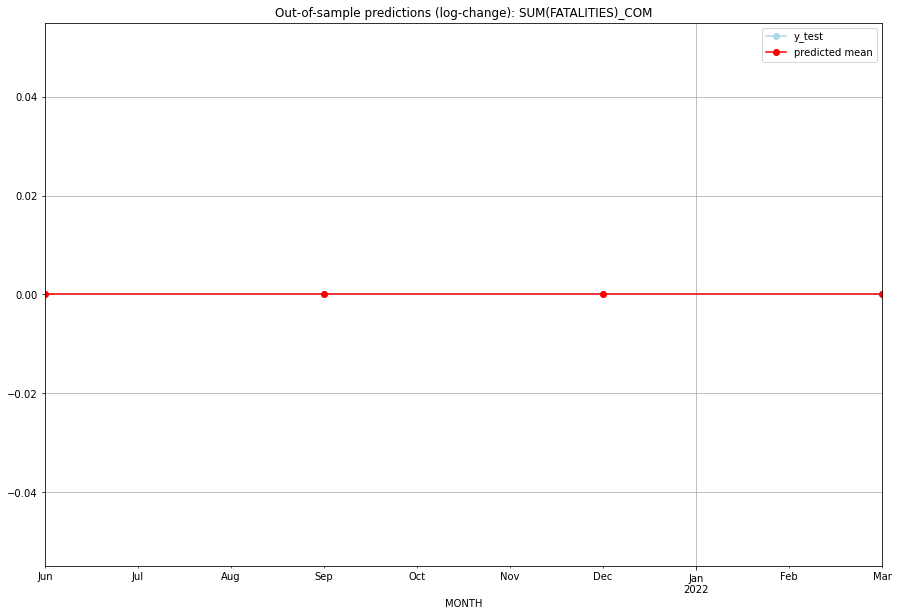

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   COM   
1 2021-07-01       0.0         0.0           0.0             0.0   COM   
2 2021-10-01       0.0         0.0           0.0             0.0   COM   
3 2022-01-01       0.0         0.0           0.0             0.0   COM   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:42
######## CPV (49/234) #########
0
Neighbor countries: []
Getting Data for CPV
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 60)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV

<Figure size 432x288 with 0 Axes>

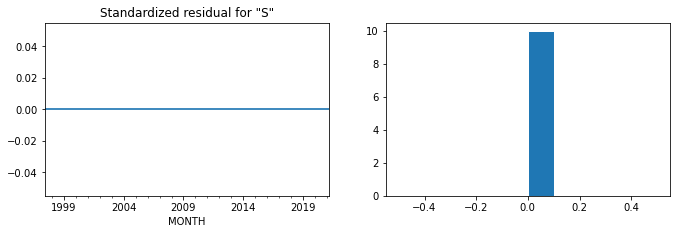

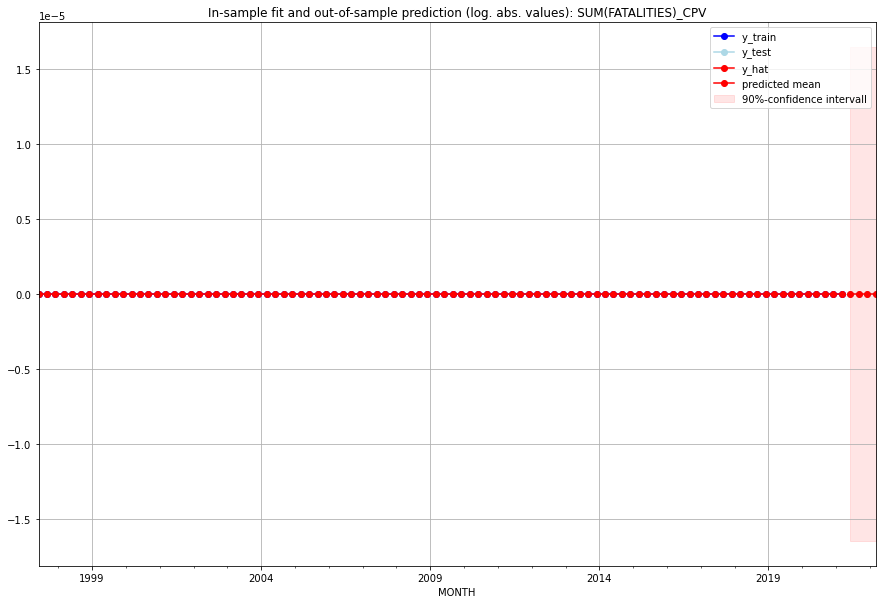

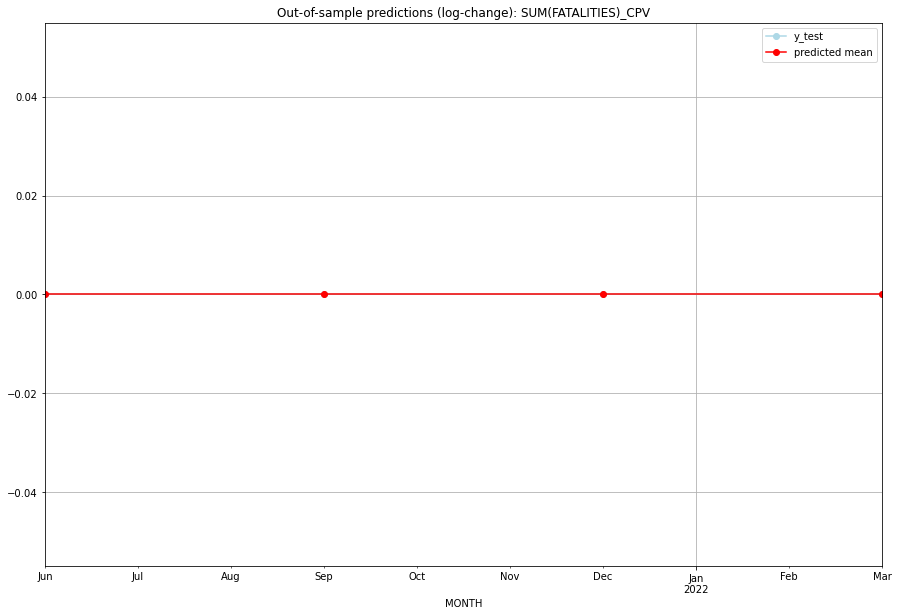

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   CPV   
1 2021-07-01       0.0         0.0           0.0             0.0   CPV   
2 2021-10-01       0.0         0.0           0.0             0.0   CPV   
3 2022-01-01       0.0         0.0           0.0             0.0   CPV   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:04
######## CRI (50/234) #########
0
Neighbor countries: []
Getting Data for CRI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 63)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.7425598575114017, 'fold_results': [1.0691665297540138, 0.41595318526878966]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CRI   No. Observations:                   13
Model:                SARIMAX(0, 0, 3)   Log Likelihood                 -13.517
Date:                 Wed, 19 Oct 2022   AIC                             39.033
Time:                         10:32:41   BIC                             42.423
Sample:                     01-31-2018   HQIC                            38.337
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0776      0

<Figure size 432x288 with 0 Axes>

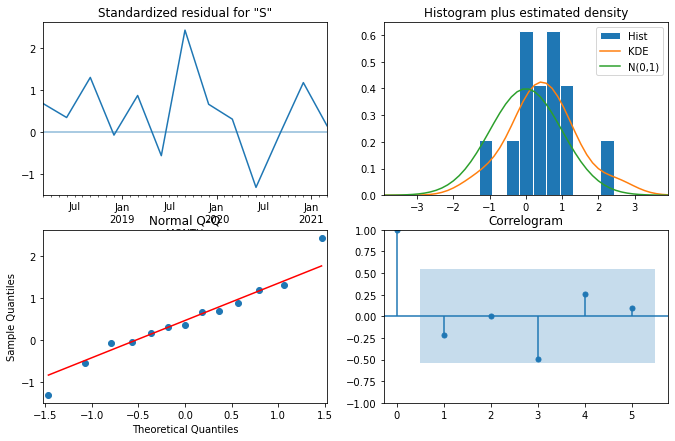

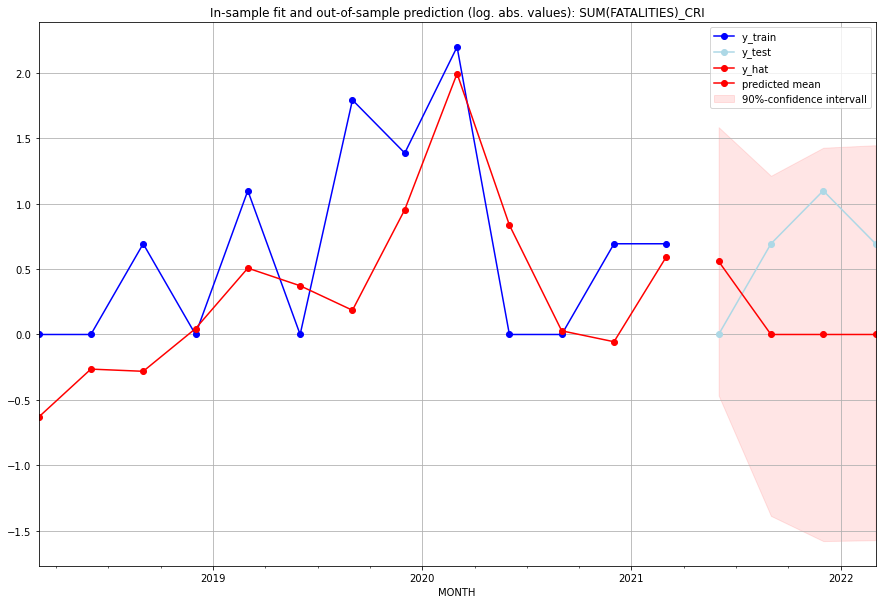

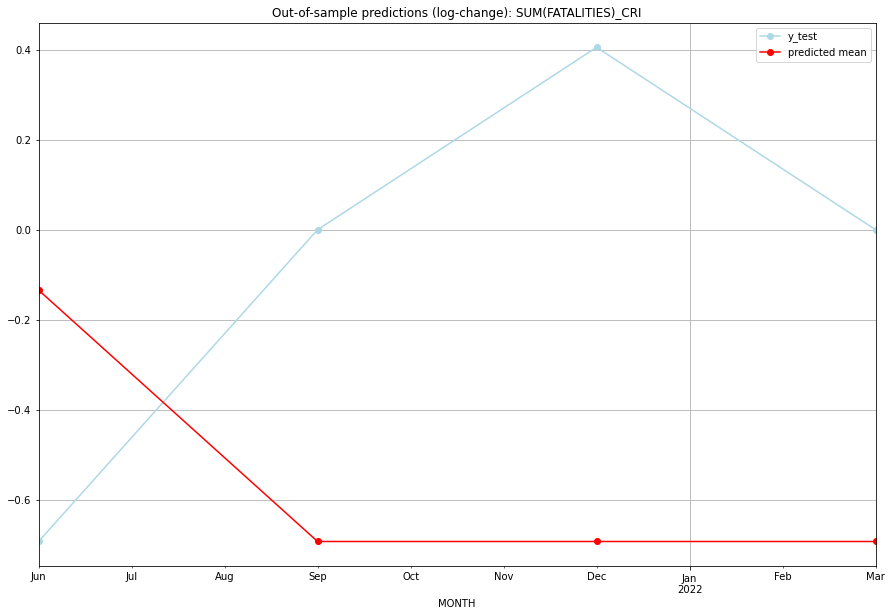

TADDA: 0.9342326437294919
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.748707         0.0     -0.134270       -0.693147   CRI   
1 2021-07-01  0.000000         1.0     -0.693147        0.000000   CRI   
2 2021-10-01  0.000000         2.0     -0.693147        0.405465   CRI   
3 2022-01-01  0.000000         1.0     -0.693147        0.000000   CRI   

                                          PARAMETERS  
0  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## CUB (51/234) #########
0
Neighbor countries: []
Getting Data for CUB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 35)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU core

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.31061333122350004, 'fold_results': [0.34657359027997264, 0.27465307216702745]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CUB   No. Observations:                   13
Model:                SARIMAX(0, 1, 0)   Log Likelihood                  -9.746
Date:                 Wed, 19 Oct 2022   AIC                             23.492
Time:                         10:32:47   BIC                             24.461
Sample:                     01-31-2018   HQIC                            23.133
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0527     

<Figure size 432x288 with 0 Axes>

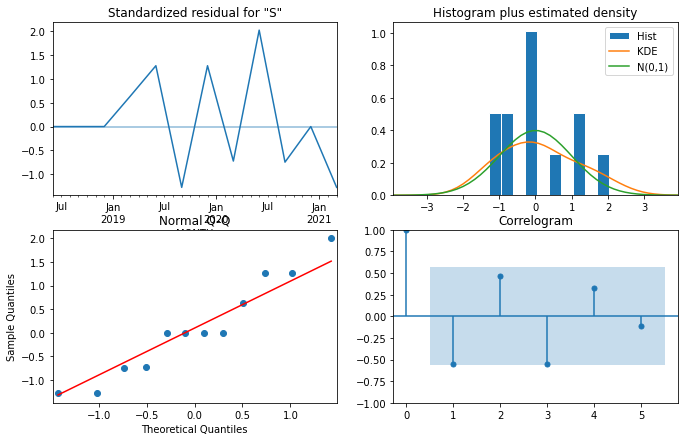

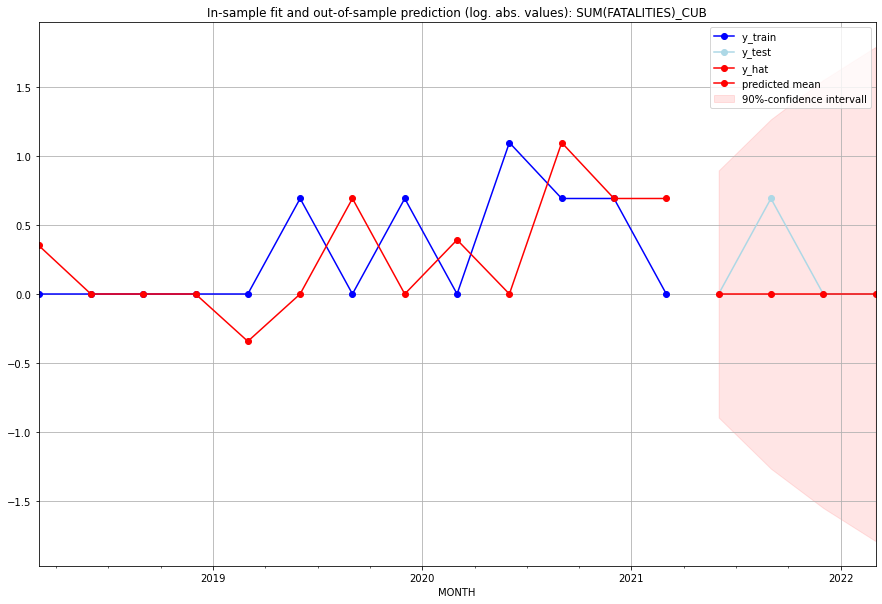

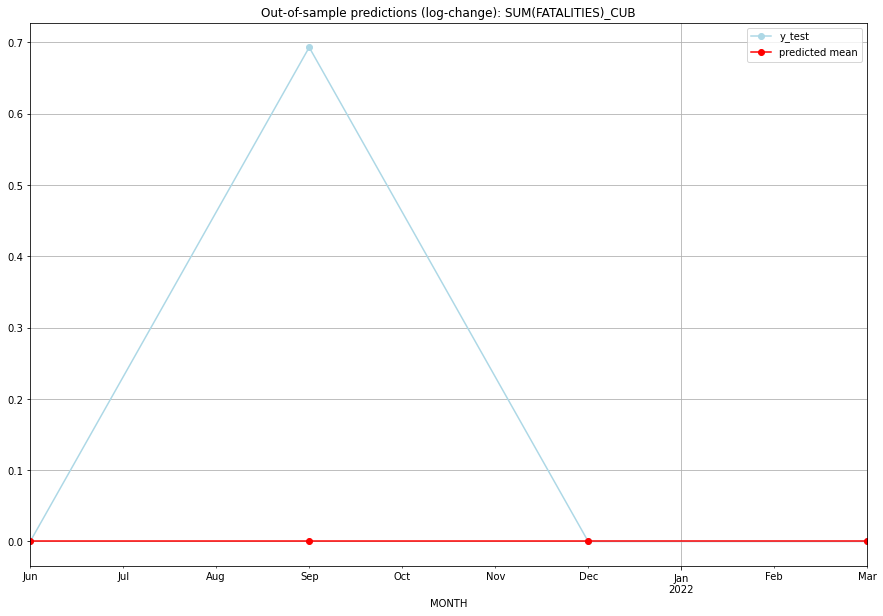

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   CUB   
1 2021-07-01       0.0         1.0           0.0        0.693147   CUB   
2 2021-10-01       0.0         0.0           0.0        0.000000   CUB   
3 2022-01-01       0.0         0.0           0.0        0.000000   CUB   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:11
######## CUW (52/234) #########
0
Neighbor countries: []
Getting Data for CUW
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV neces

<Figure size 432x288 with 0 Axes>

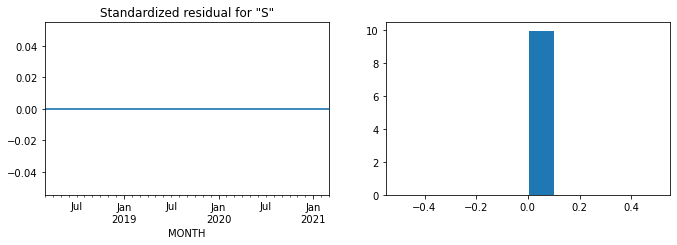

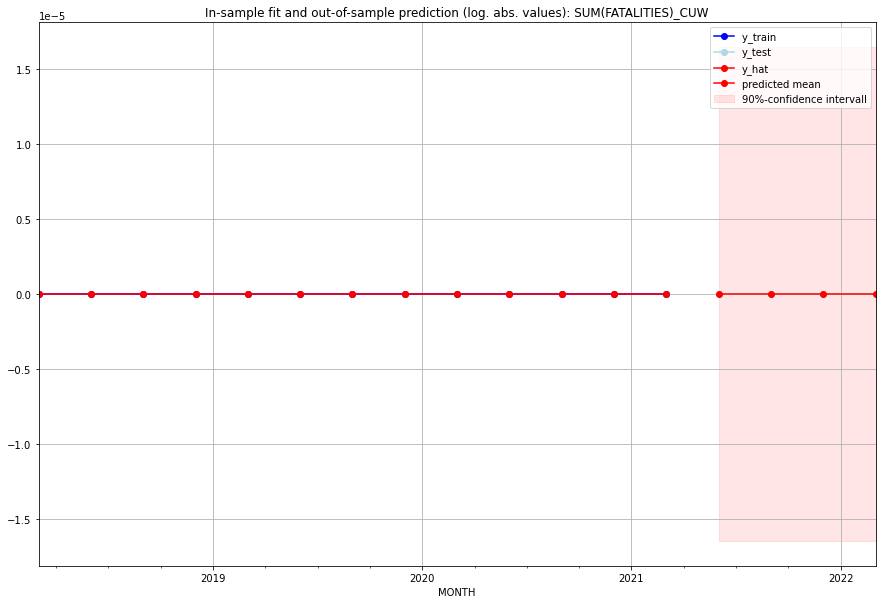

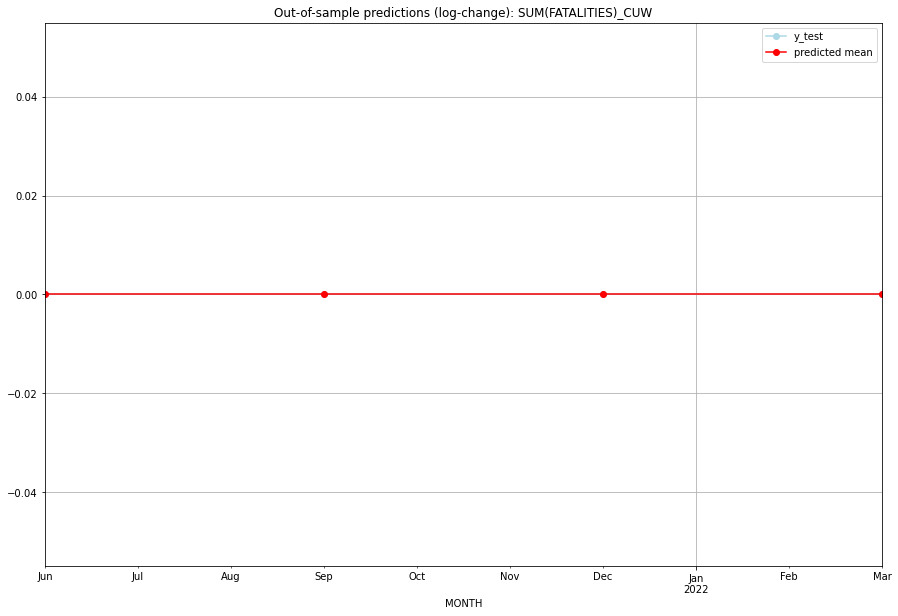

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   CUW   
1 2021-07-01       0.0         0.0           0.0             0.0   CUW   
2 2021-10-01       0.0         0.0           0.0             0.0   CUW   
3 2022-01-01       0.0         0.0           0.0             0.0   CUW   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:07
######## CYM (53/234) #########
0
Neighbor countries: []
Getting Data for CYM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (13, 27)
y: (13, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CYM   No. Observations:                    9
Model:     

<Figure size 432x288 with 0 Axes>

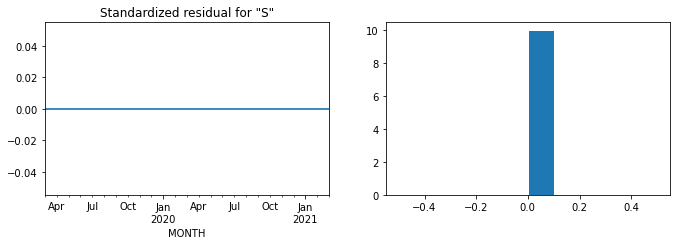

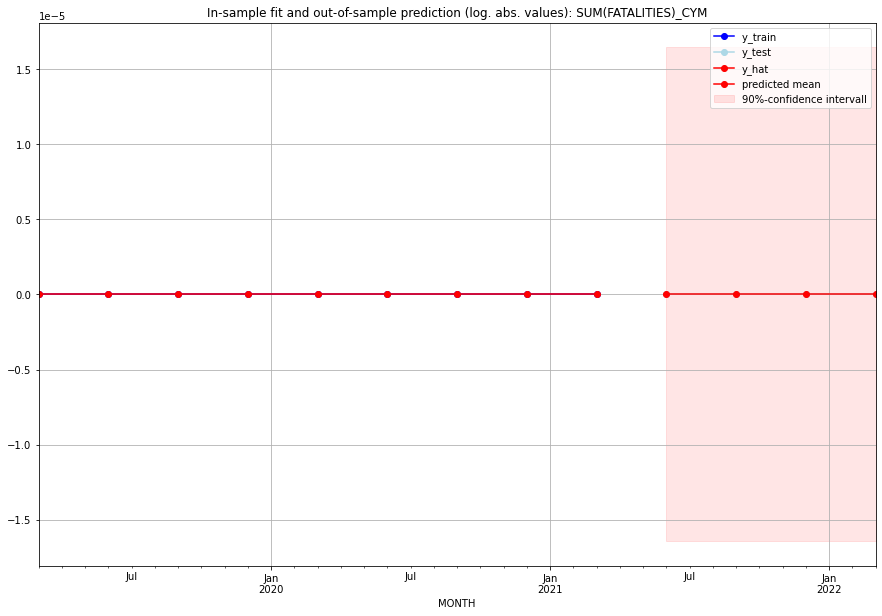

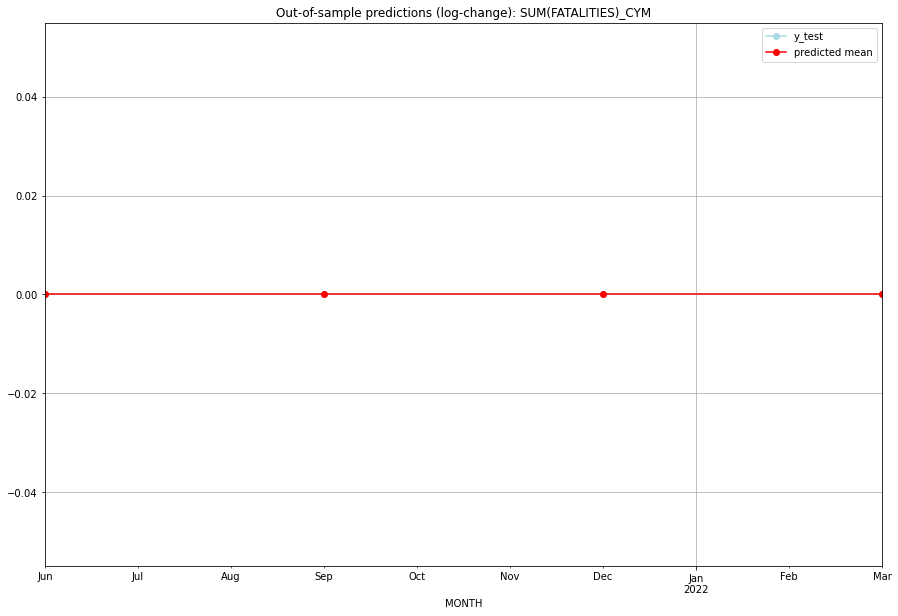

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   CYM   
1 2021-07-01       0.0         0.0           0.0             0.0   CYM   
2 2021-10-01       0.0         0.0           0.0             0.0   CYM   
3 2022-01-01       0.0         0.0           0.0             0.0   CYM   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:06
######## CYP (54/234) #########
0
Neighbor countries: []
Getting Data for CYP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 65)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CYP   No. Observations:                   13
Model:     

<Figure size 432x288 with 0 Axes>

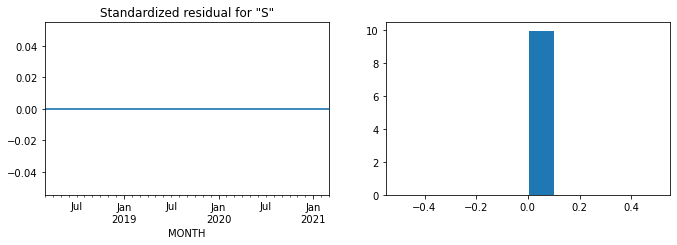

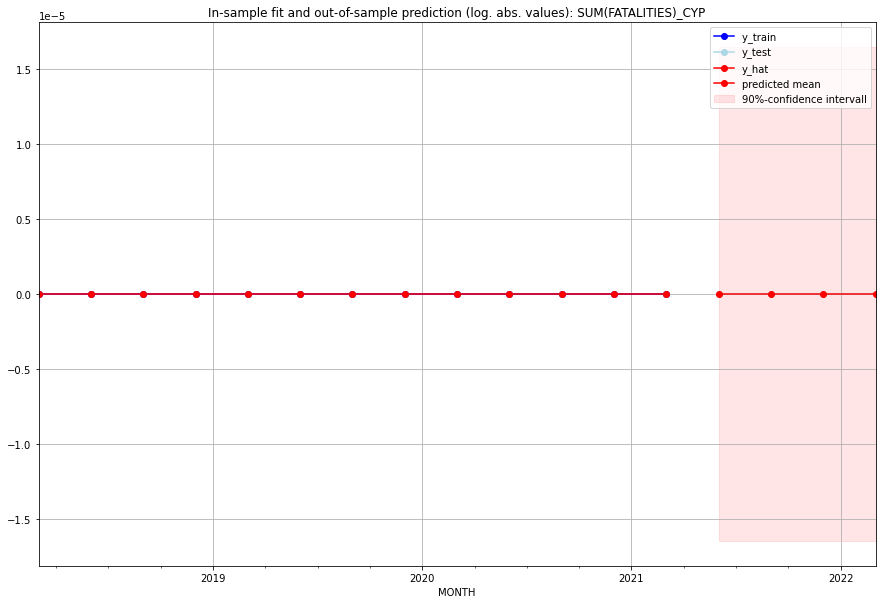

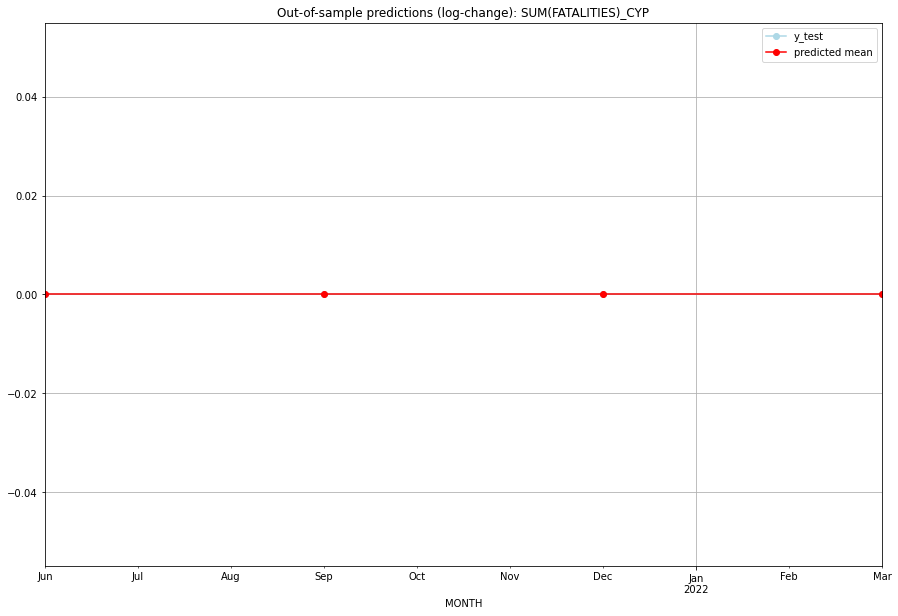

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   CYP   
1 2021-07-01       0.0         0.0           0.0             0.0   CYP   
2 2021-10-01       0.0         0.0           0.0             0.0   CYP   
3 2022-01-01       0.0         0.0           0.0             0.0   CYP   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:03
######## CZE (55/234) #########
0
Neighbor countries: []
Getting Data for CZE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 64)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


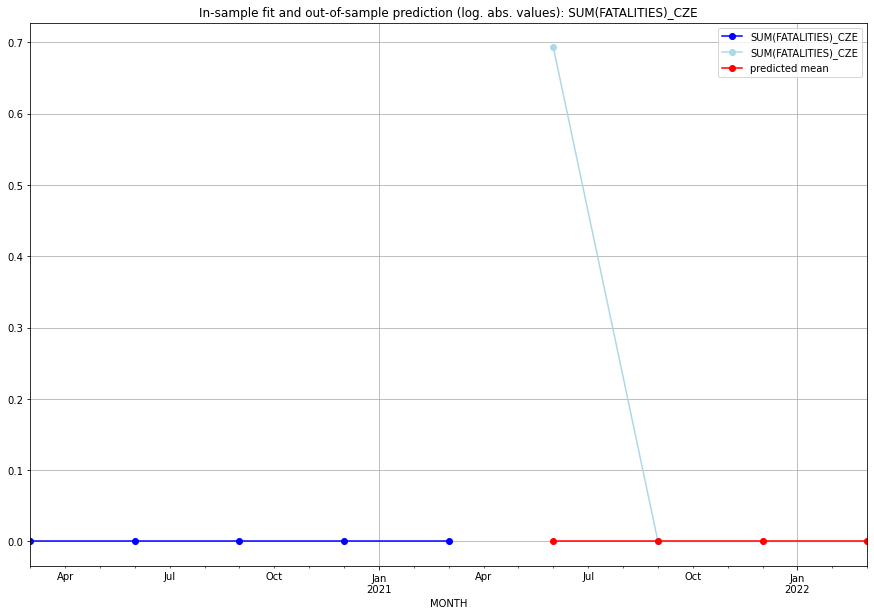

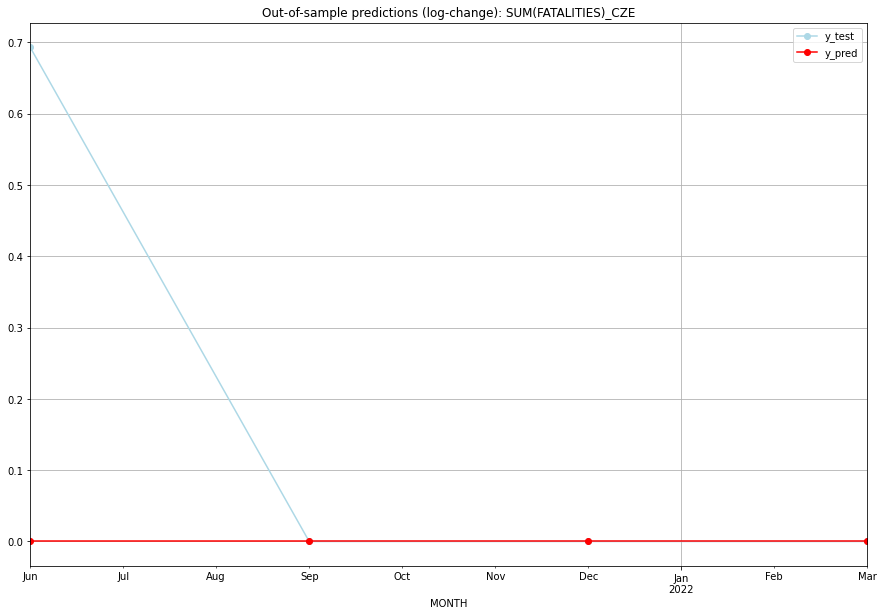

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.693147           0.0        0.693147   CZE   
1 2021-07-01       0.0    0.000000           0.0        0.000000   CZE   
2 2021-10-01       0.0    0.000000           0.0        0.000000   CZE   
3 2022-01-01       0.0    0.000000           0.0        0.000000   CZE   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## DEU (56/234) #########
0
Neighbor countries: []
Getting Data for DEU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 65)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


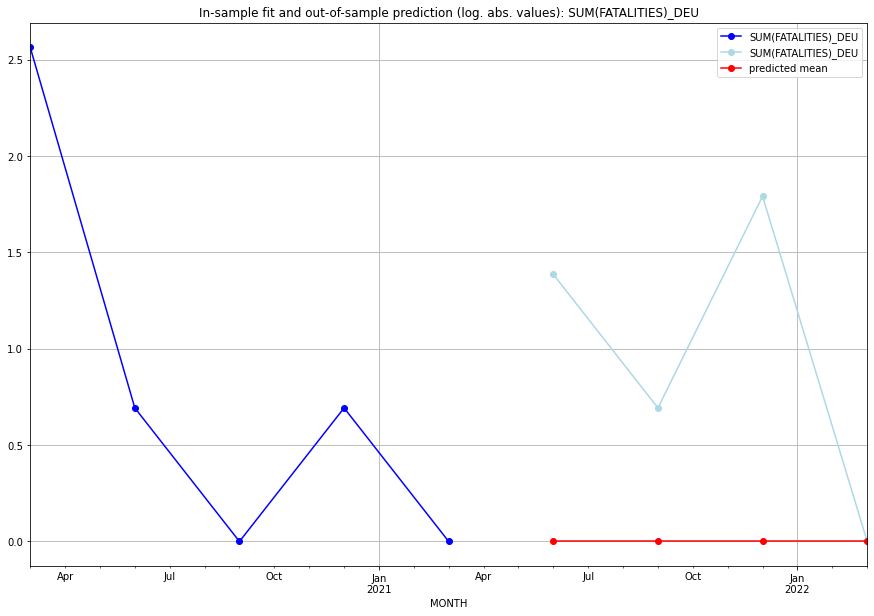

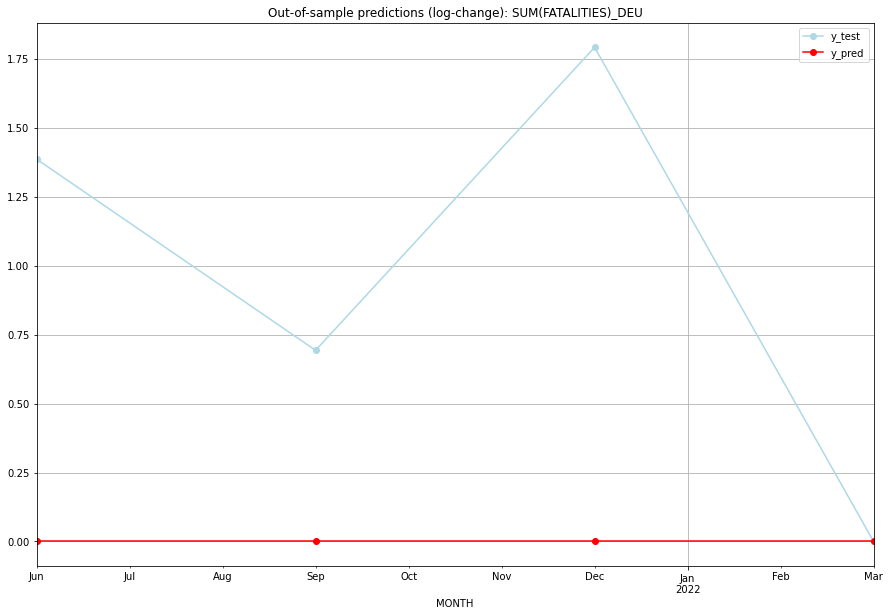

TADDA: 0.9678002527269727
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    1.386294           0.0        1.386294   DEU   
1 2021-07-01       0.0    0.693147           0.0        0.693147   DEU   
2 2021-10-01       0.0    1.791759           0.0        1.791759   DEU   
3 2022-01-01       0.0    0.000000           0.0        0.000000   DEU   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## DJI (57/234) #########
0
Neighbor countries: []
Getting Data for DJI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 58)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.10397207708399178, 'fold_results': [0.0, 0.0, 0.0, 0.5198603854199589, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DJI   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                -101.745
Date:                 Wed, 19 Oct 2022   AIC                            205.489
Time:                         10:33:34   BIC                            208.054
Sample:                     04-30-1997   HQIC                           206.526
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.4876      0

<Figure size 432x288 with 0 Axes>

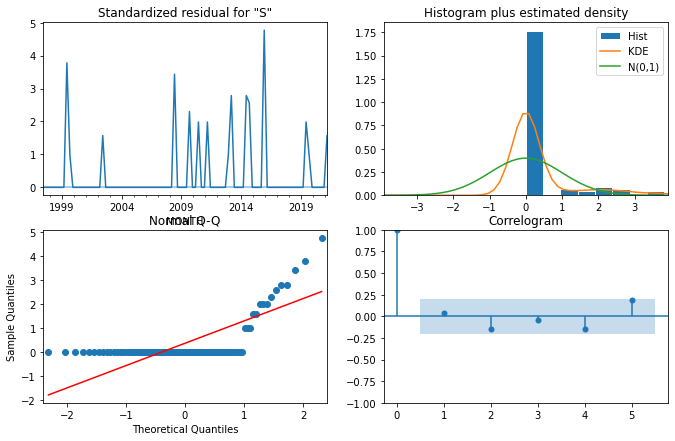

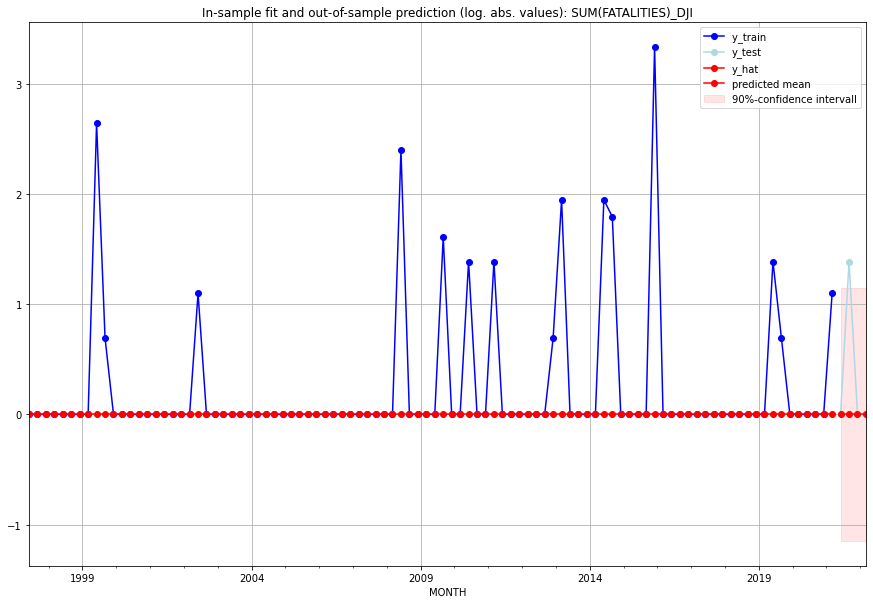

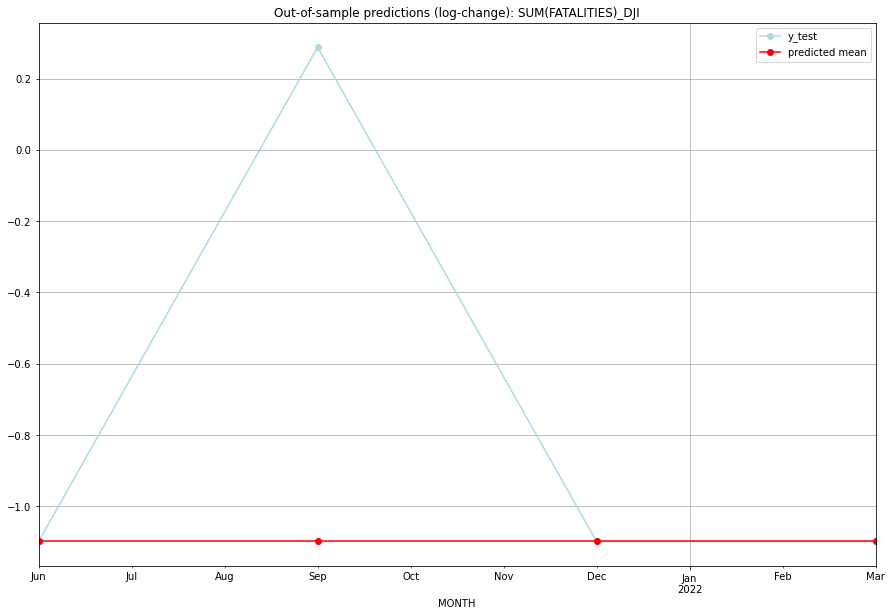

TADDA: 0.6212266624470001
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0     -1.098612       -1.098612   DJI   
1 2021-07-01       0.0         3.0     -1.098612        0.287682   DJI   
2 2021-10-01       0.0         0.0     -1.098612       -1.098612   DJI   
3 2022-01-01       0.0         0.0     -1.098612       -1.098612   DJI   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## DMA (58/234) #########
0
Neighbor countries: []
Getting Data for DMA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 45)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU core

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08664339756999316, 'fold_results': [0.17328679513998632, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DMA   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:33:43   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.24

<Figure size 432x288 with 0 Axes>

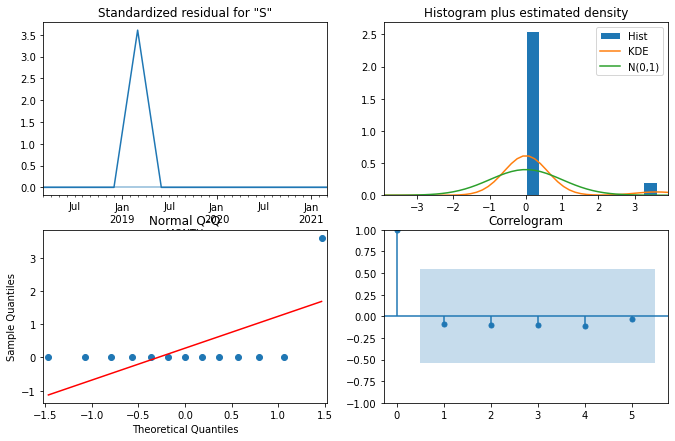

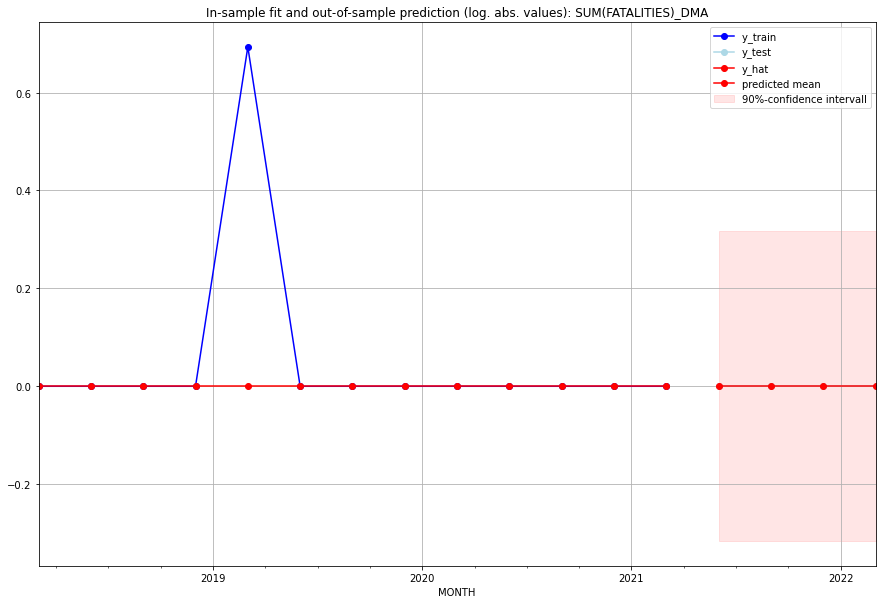

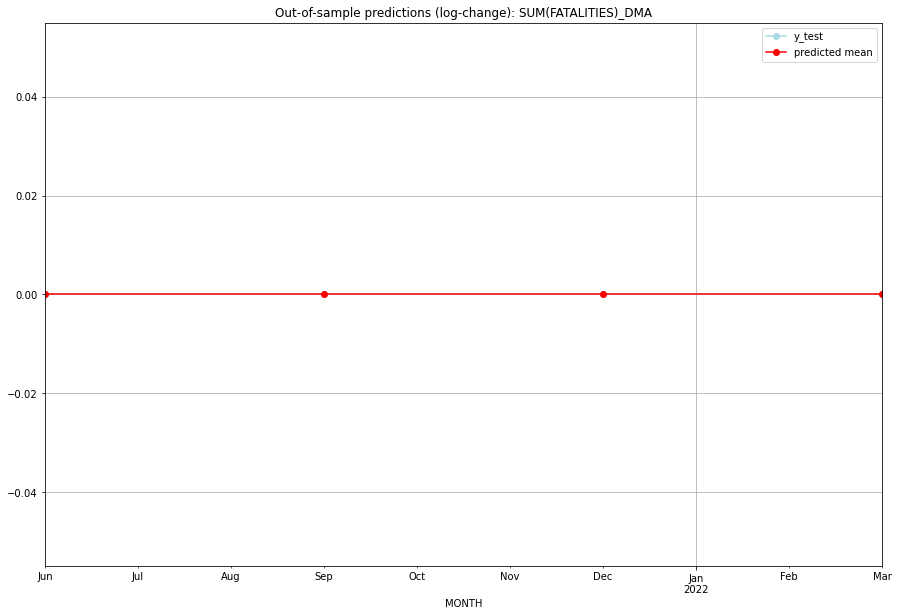

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   DMA   
1 2021-07-01       0.0         0.0           0.0             0.0   DMA   
2 2021-10-01       0.0         0.0           0.0             0.0   DMA   
3 2022-01-01       0.0         0.0           0.0             0.0   DMA   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## DNK (59/234) #########
0
Neighbor countries: []
Getting Data for DNK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 64)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross va

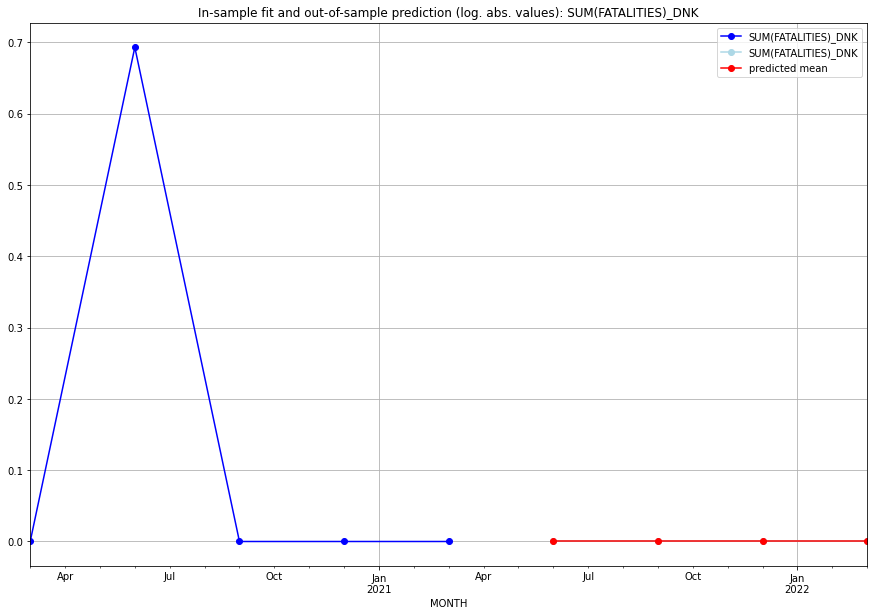

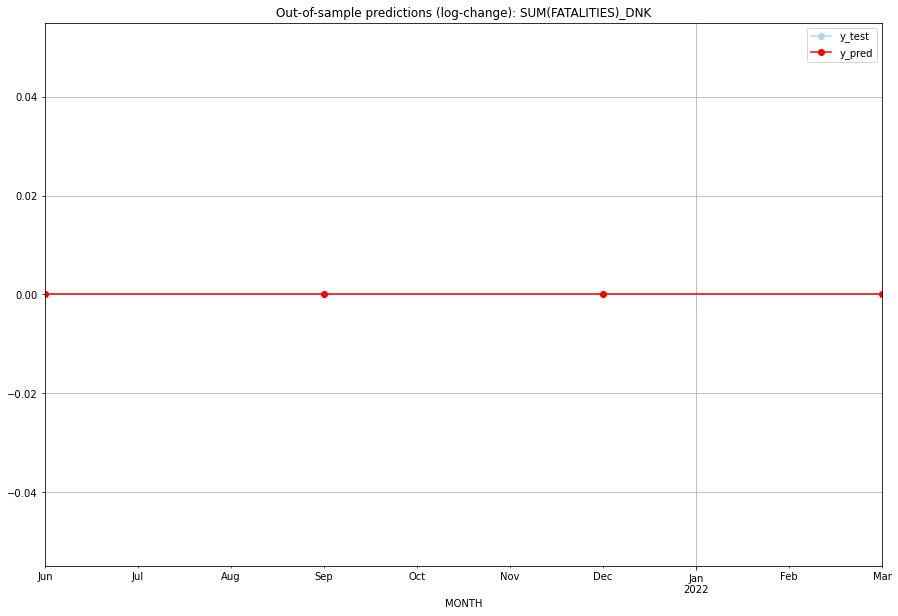

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   DNK   
1 2021-07-01       0.0         0.0           0.0             0.0   DNK   
2 2021-10-01       0.0         0.0           0.0             0.0   DNK   
3 2022-01-01       0.0         0.0           0.0             0.0   DNK   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## DOM (60/234) #########
0
Neighbor countries: []
Getting Data for DOM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 62)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.042692853315589585, 'fold_results': [0.042692853315589585, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DOM   No. Observations:                   13
Model:                SARIMAX(2, 0, 2)   Log Likelihood                  -9.606
Date:                 Wed, 19 Oct 2022   AIC                             29.213
Time:                         10:33:53   BIC                             32.037
Sample:                     01-31-2018   HQIC                            28.632
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.1300      0.529      2.

<Figure size 432x288 with 0 Axes>

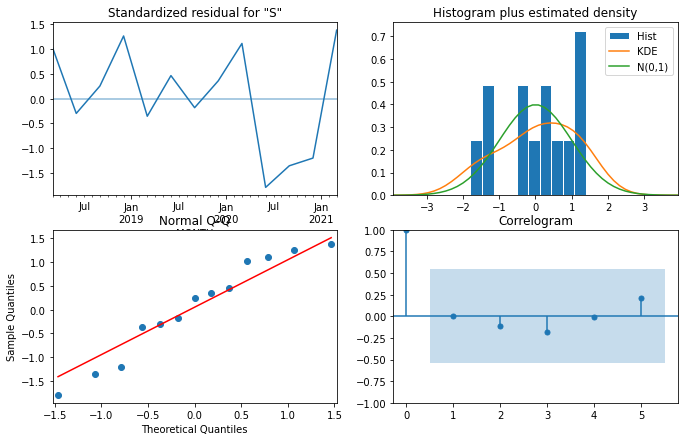

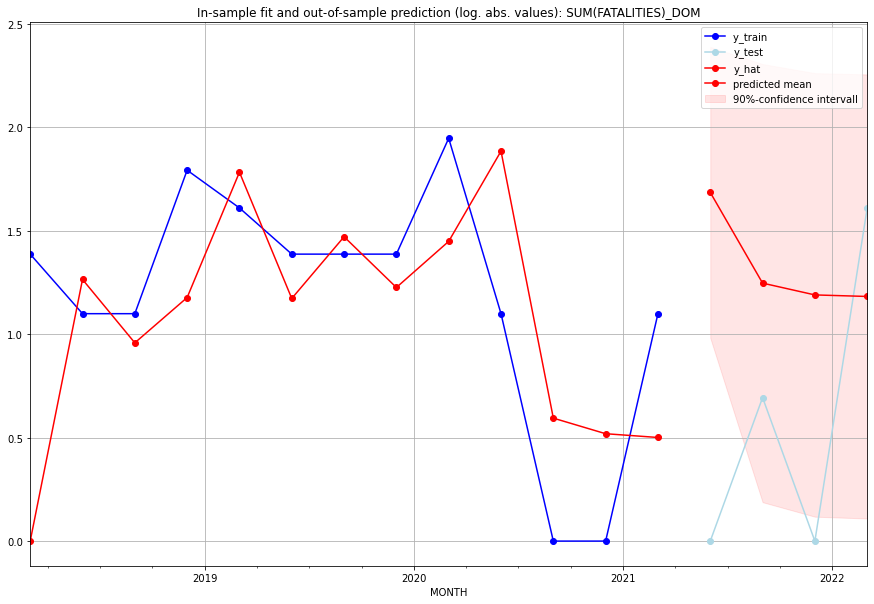

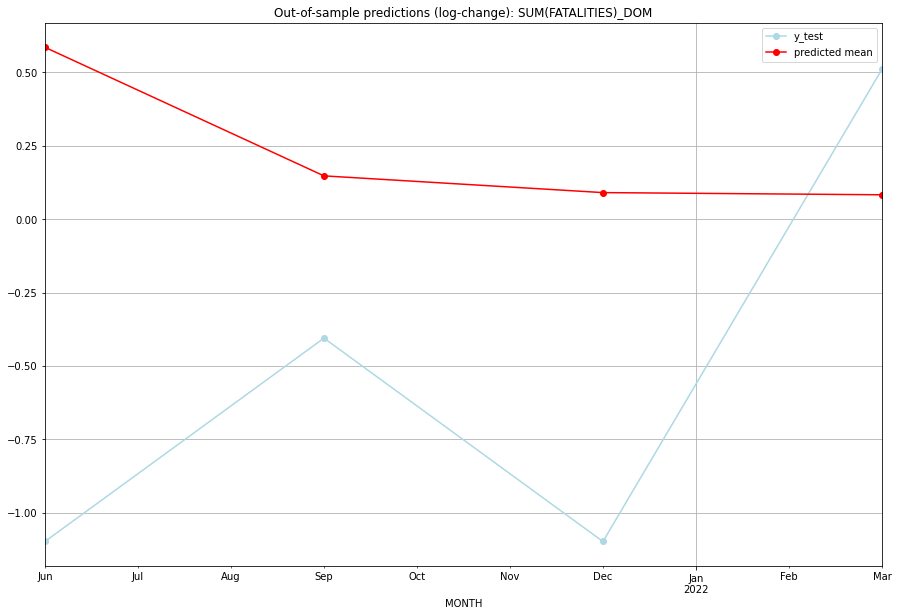

TADDA: 1.1695987990158212
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  4.389392         0.0      0.585820       -1.098612   DOM   
1 2021-07-01  2.477167         1.0      0.147606       -0.405465   DOM   
2 2021-10-01  2.284499         0.0      0.090602       -1.098612   DOM   
3 2022-01-01  2.260200         4.0      0.083176        0.510826   DOM   

                                          PARAMETERS  
0  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## DZA (61/234) #########
0
Neighbor countries: []
Getting Data for DZA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 63)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU co

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5770516427951243, 'fold_results': [0.6314321610770641, 0.9116659600151598, 0.49990888710286907, 0.6061358035703155, 0.2361154022102132]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DZA   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -109.174
Date:                 Wed, 19 Oct 2022   AIC                            220.349
Time:                         10:34:14   BIC                            222.903
Sample:                     04-30-1997   HQIC                           221.381
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

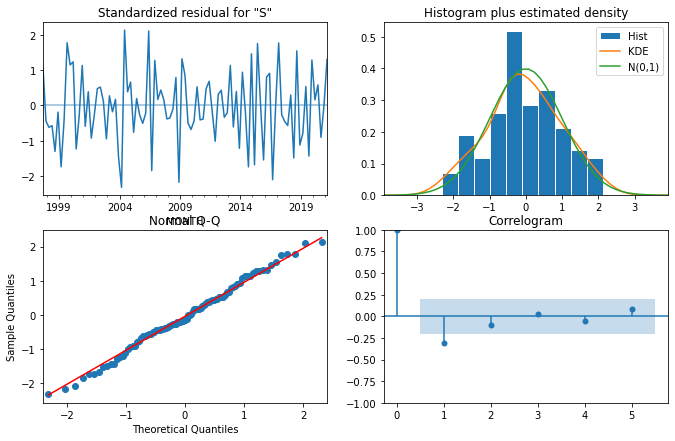

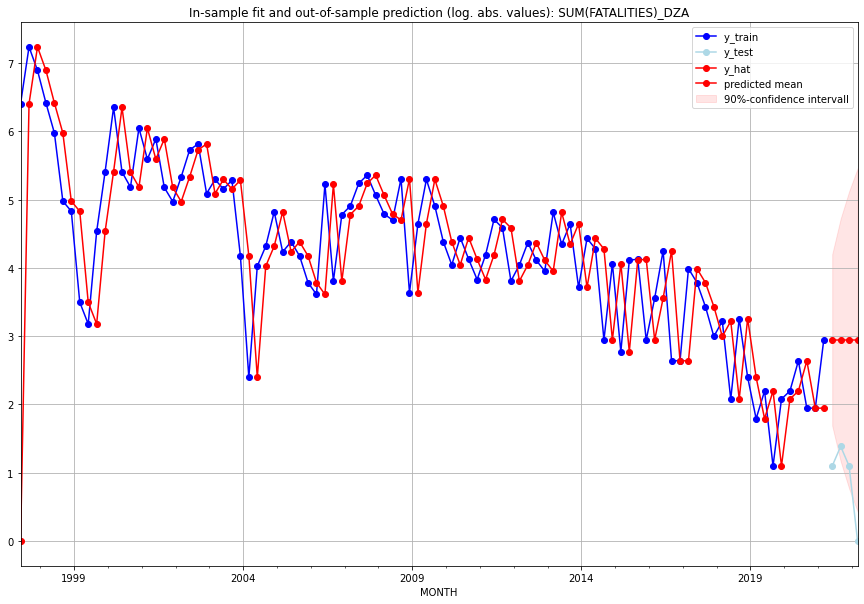

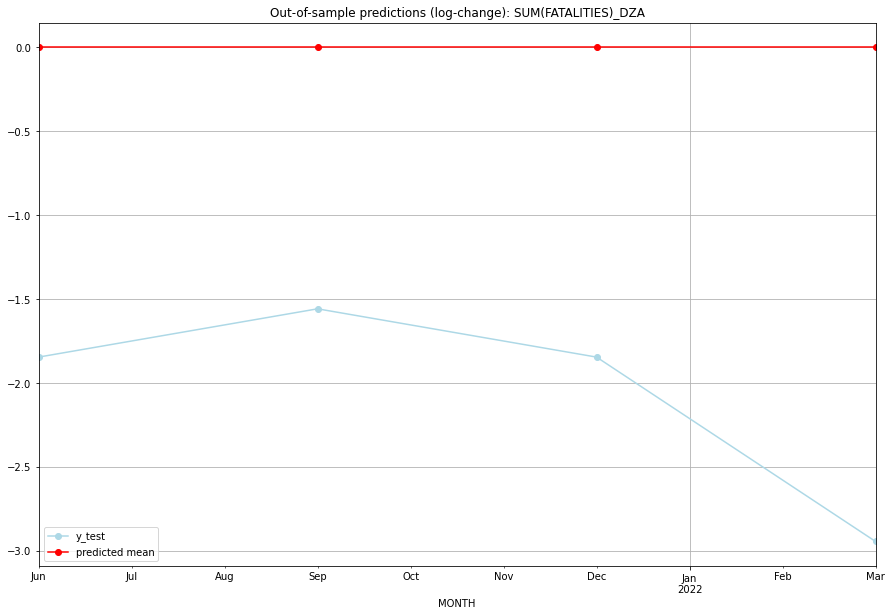

TADDA: 2.048559244552413
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01      18.0         2.0           0.0       -1.845827   DZA   
1 2021-07-01      18.0         3.0           0.0       -1.558145   DZA   
2 2021-10-01      18.0         2.0           0.0       -1.845827   DZA   
3 2022-01-01      18.0         0.0           0.0       -2.944439   DZA   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## ECU (62/234) #########
0
Neighbor countries: []
Getting Data for ECU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 64)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.47386727304083215, 'fold_results': [0.47386727304083215, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ECU   No. Observations:                   13
Model:                SARIMAX(2, 0, 2)   Log Likelihood                 -13.906
Date:                 Wed, 19 Oct 2022   AIC                             37.812
Time:                         10:34:23   BIC                             40.637
Sample:                     01-31-2018   HQIC                            37.231
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6054      0.457      1.32

<Figure size 432x288 with 0 Axes>

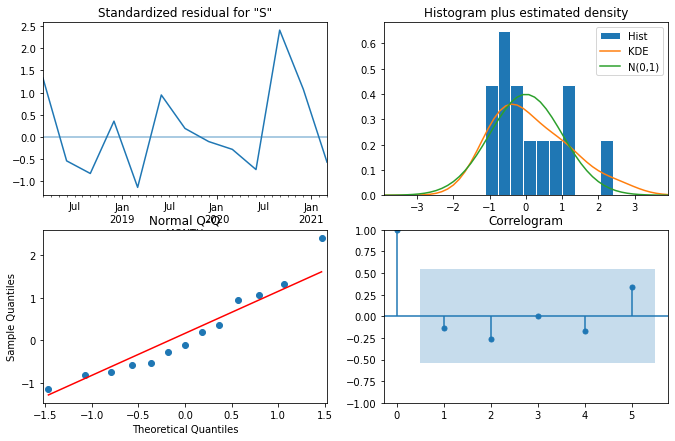

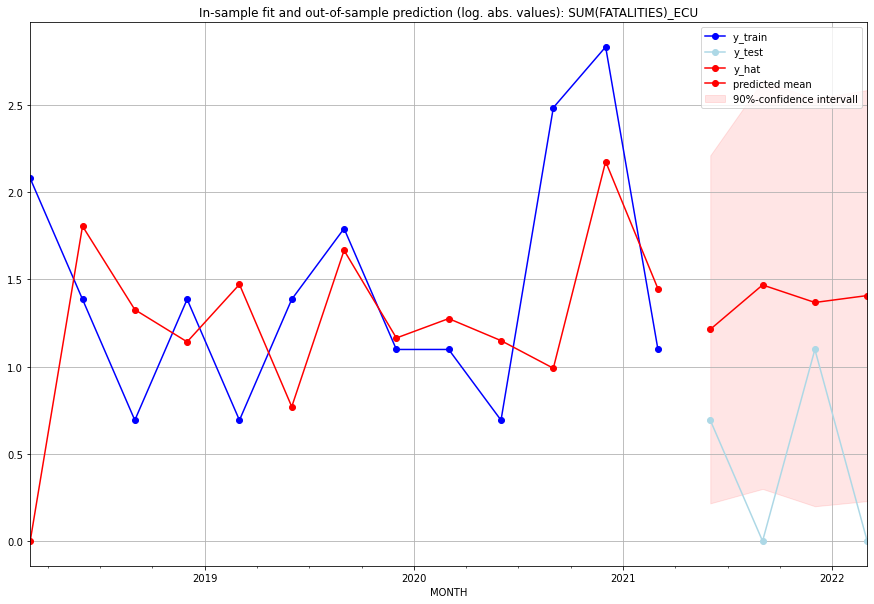

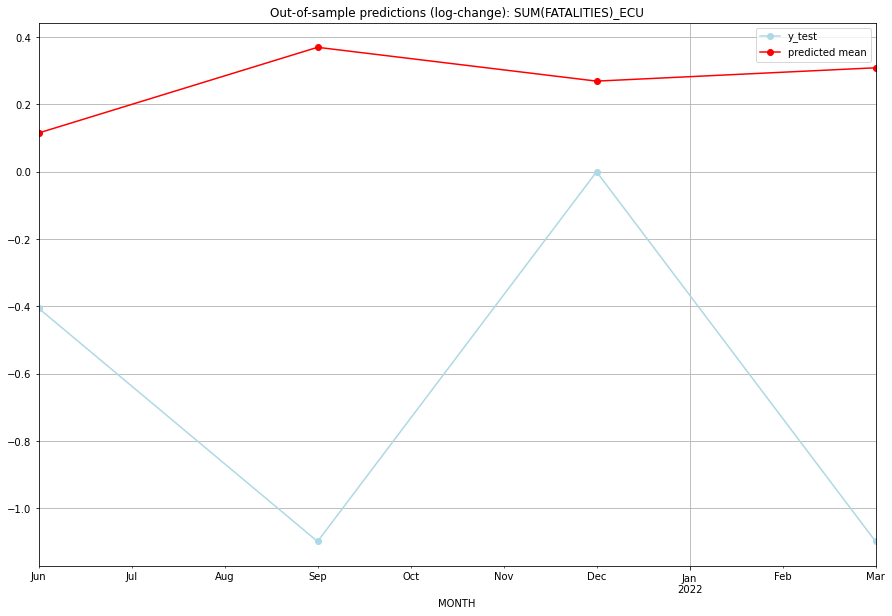

TADDA: 1.115054388674332
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2.366303         1.0      0.115203       -0.405465   ECU   
1 2021-07-01  3.342597         0.0      0.369860       -1.098612   ECU   
2 2021-10-01  2.927428         2.0      0.269372        0.000000   ECU   
3 2022-01-01  3.086246         0.0      0.309015       -1.098612   ECU   

                                          PARAMETERS  
0  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## EGY (63/234) #########
0
Neighbor countries: []
Getting Data for EGY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 64)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.2482701160652223, 'fold_results': [0.1881366297970808, 0.43193050135952804, 0.2814286783239681, 0.16185784984060336, 0.17799692100493125]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_EGY   No. Observations:                   96
Model:                SARIMAX(3, 0, 0)   Log Likelihood                -160.443
Date:                 Wed, 19 Oct 2022   AIC                            328.885
Time:                         10:34:44   BIC                            339.143
Sample:                     04-30-1997   HQIC                           333.032
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

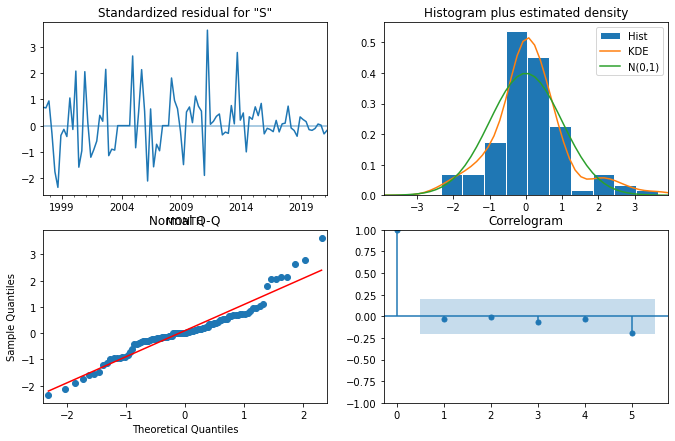

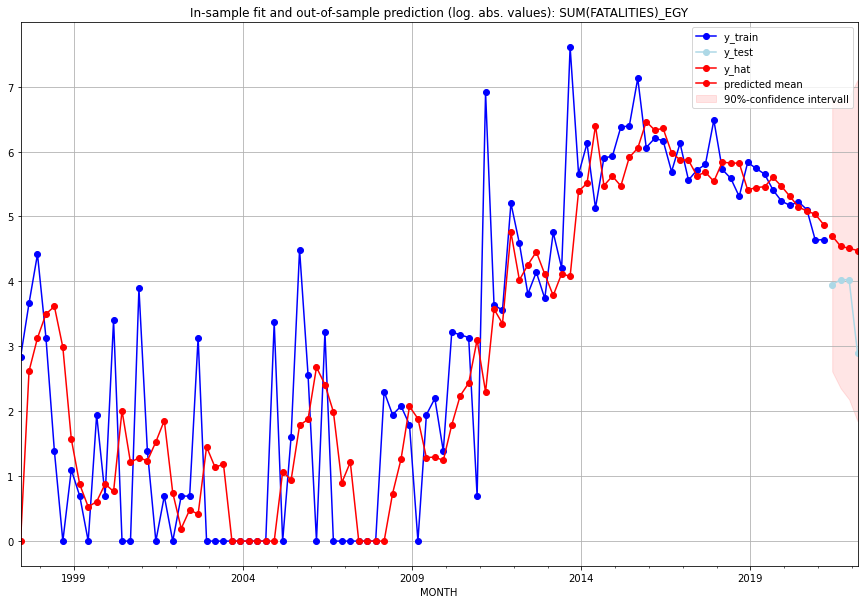

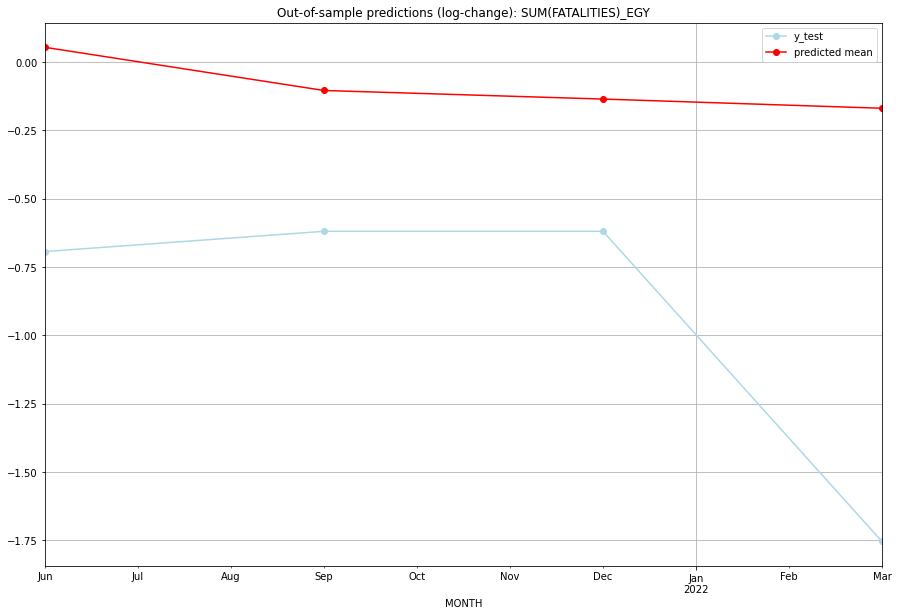

TADDA: 0.8465060776803239
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  108.794454        51.0      0.054219       -0.693147   EGY   
1 2021-07-01   92.751291        55.0     -0.103745       -0.619039   EGY   
2 2021-10-01   89.854791        55.0     -0.135128       -0.619039   EGY   
3 2022-01-01   86.847826        17.0     -0.168785       -1.754019   EGY   

                                          PARAMETERS  
0  {'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## ERI (64/234) #########
0
Neighbor countries: []
Getting Data for ERI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 53)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4811886824866762, 'fold_results': [1.6114299548463946, 0.17328679513998632, 0.44793986730701374, 0.0, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ERI   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                -216.159
Date:                 Wed, 19 Oct 2022   AIC                            434.318
Time:                         10:34:55   BIC                            436.883
Sample:                     04-30-1997   HQIC                           435.355
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

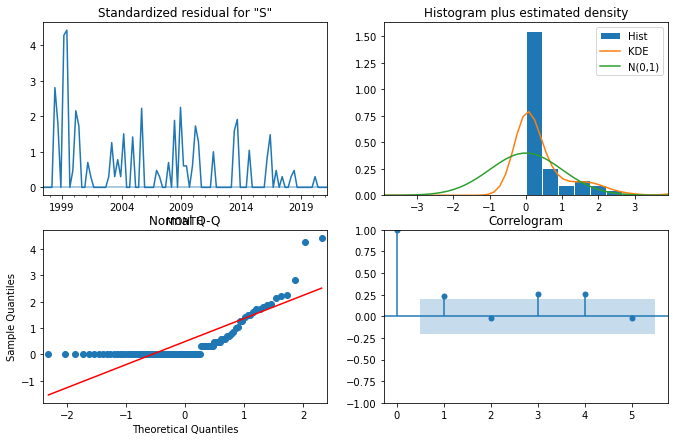

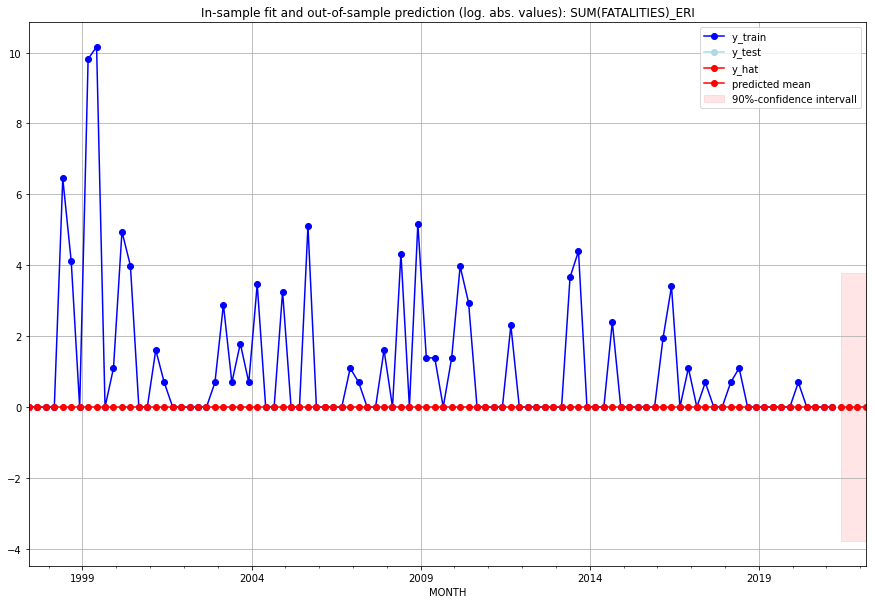

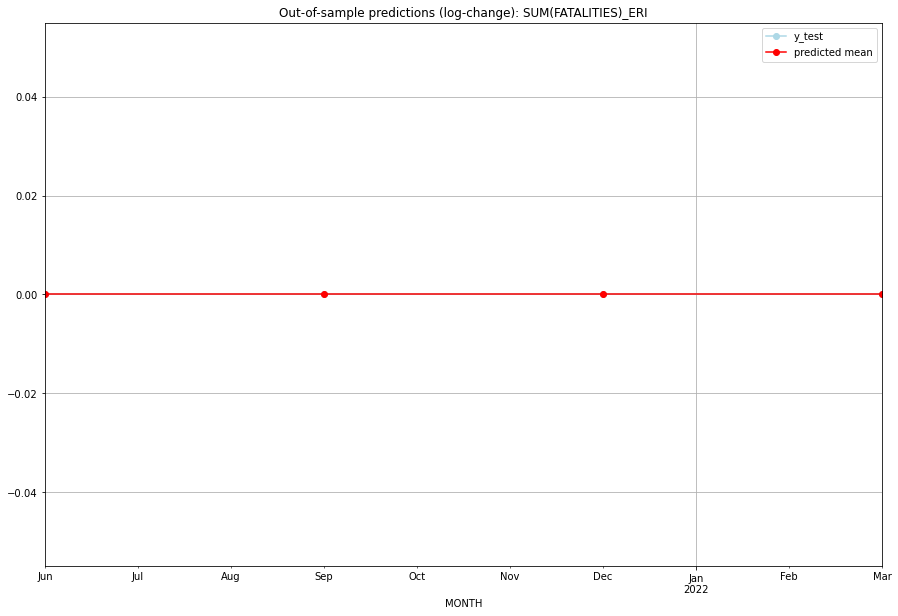

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ERI   
1 2021-07-01       0.0         0.0           0.0             0.0   ERI   
2 2021-10-01       0.0         0.0           0.0             0.0   ERI   
3 2022-01-01       0.0         0.0           0.0             0.0   ERI   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## ESH (65/234) #########
0
Neighbor countries: []
Getting Data for ESH
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 paramet

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.29740842935118755, 'fold_results': [0.5198597307213739, 0.0, 0.0, 0.44793986730701374, 0.51924254872755]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ESH   No. Observations:                   96
Model:                SARIMAX(0, 0, 2)   Log Likelihood                 -73.133
Date:                 Wed, 19 Oct 2022   AIC                            152.266
Time:                         10:35:16   BIC                            159.959
Sample:                     04-30-1997   HQIC                           155.376
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

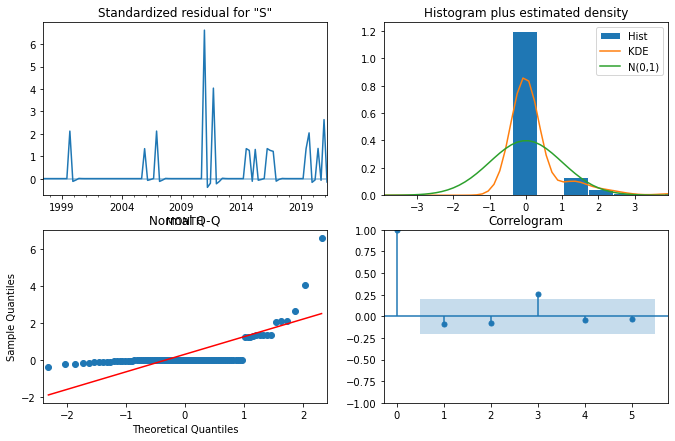

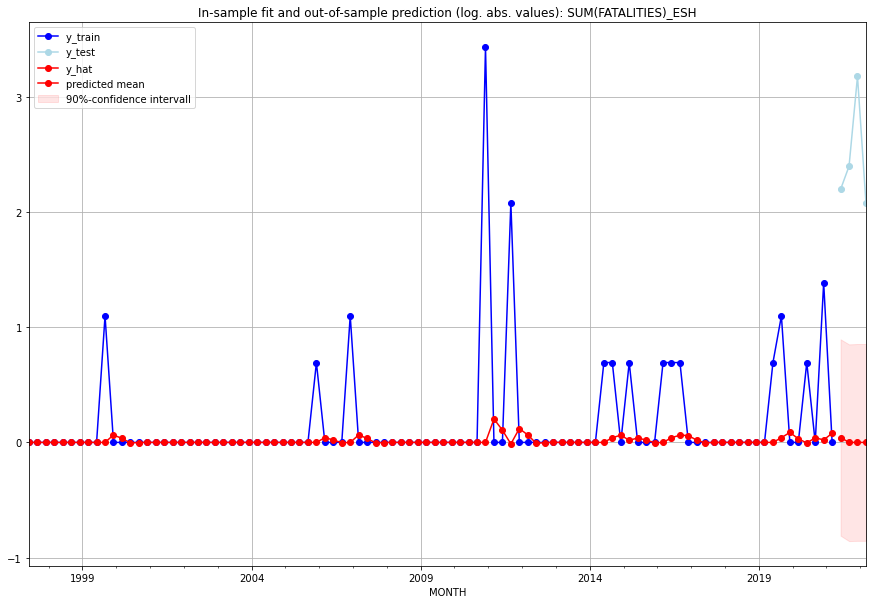

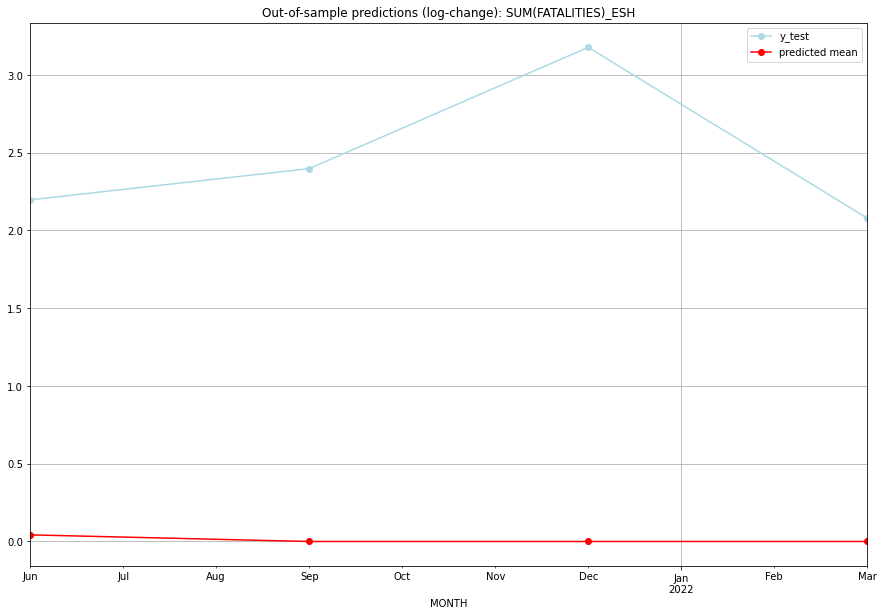

TADDA: 2.4525075792988114
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.043505         8.0      0.042585        2.197225   ESH   
1 2021-07-01  0.000000        10.0      0.000000        2.397895   ESH   
2 2021-10-01  0.000000        23.0      0.000000        3.178054   ESH   
3 2022-01-01  0.000000         7.0      0.000000        2.079442   ESH   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## ESP (66/234) #########
0
Neighbor countries: []
Getting Data for ESP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 65)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient da

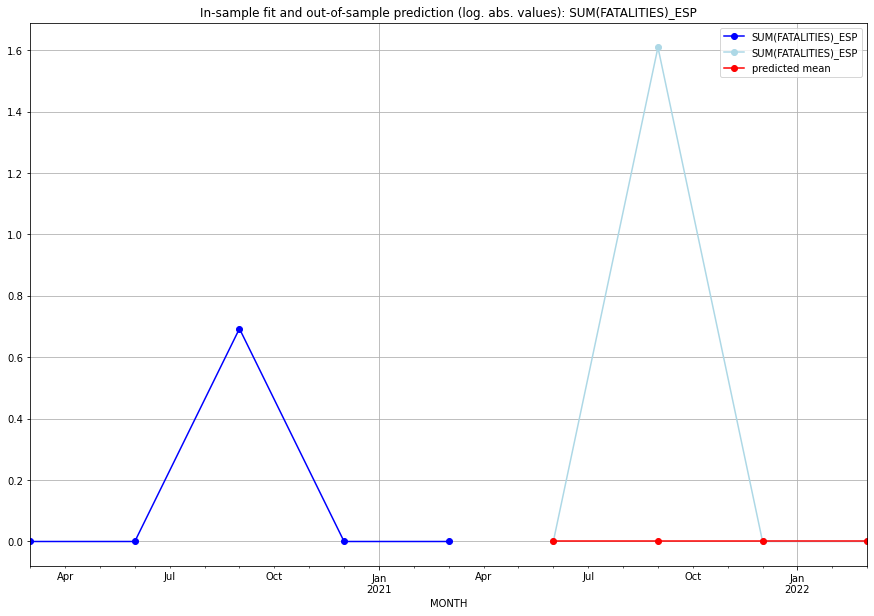

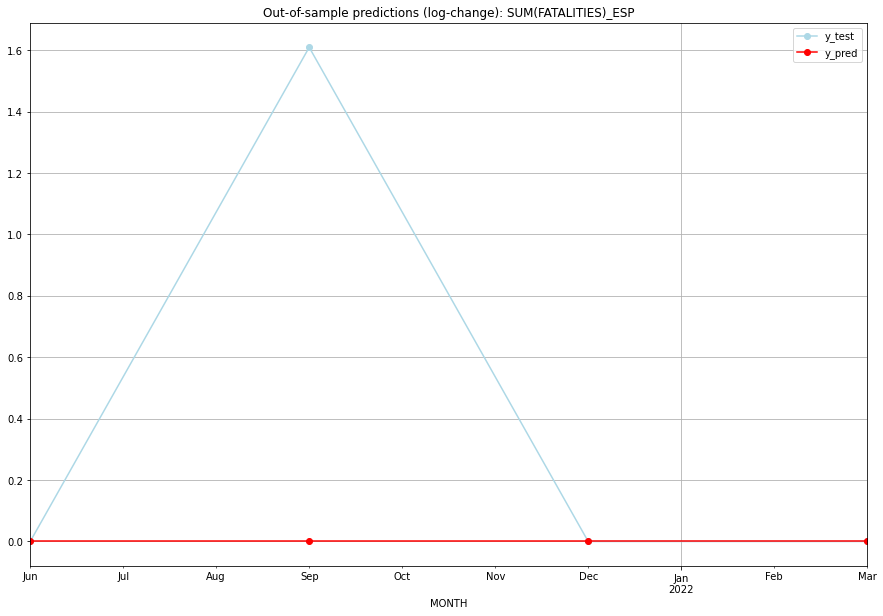

TADDA: 0.4023594781085251
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.000000           0.0        0.000000   ESP   
1 2021-07-01       0.0    1.609438           0.0        1.609438   ESP   
2 2021-10-01       0.0    0.000000           0.0        0.000000   ESP   
3 2022-01-01       0.0    0.000000           0.0        0.000000   ESP   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## EST (67/234) #########
0
Neighbor countries: []
Getting Data for EST
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 64)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


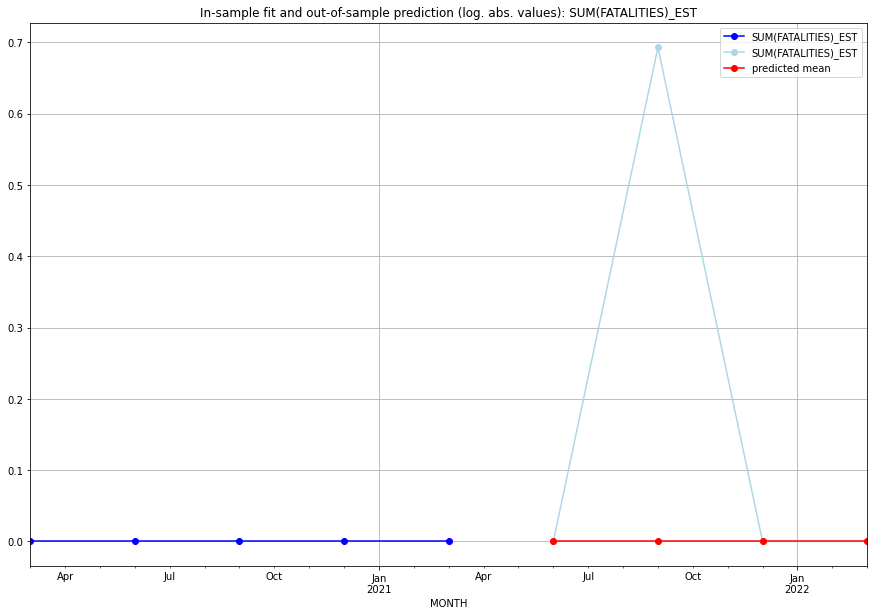

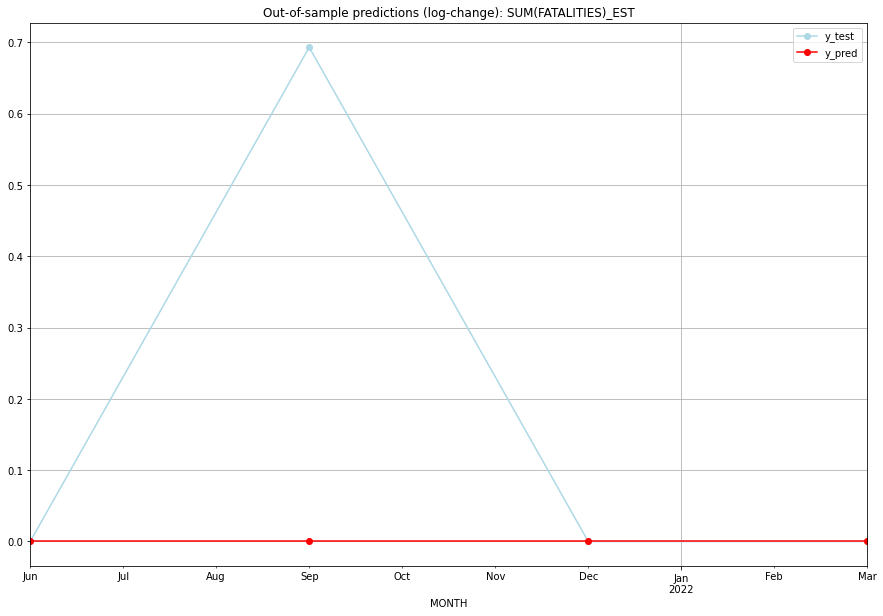

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.000000           0.0        0.000000   EST   
1 2021-07-01       0.0    0.693147           0.0        0.693147   EST   
2 2021-10-01       0.0    0.000000           0.0        0.000000   EST   
3 2022-01-01       0.0    0.000000           0.0        0.000000   EST   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## ETH (68/234) #########
0
Neighbor countries: []
Getting Data for ETH
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 63)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.64095613581193, 'fold_results': [0.26048391856021325, 0.8378980042255615, 0.15560188075393855, 0.9154933696767509, 1.035303505843186]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ETH   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -189.911
Date:                 Wed, 19 Oct 2022   AIC                            381.822
Time:                         10:35:40   BIC                            384.375
Sample:                     04-30-1997   HQIC                           382.854
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

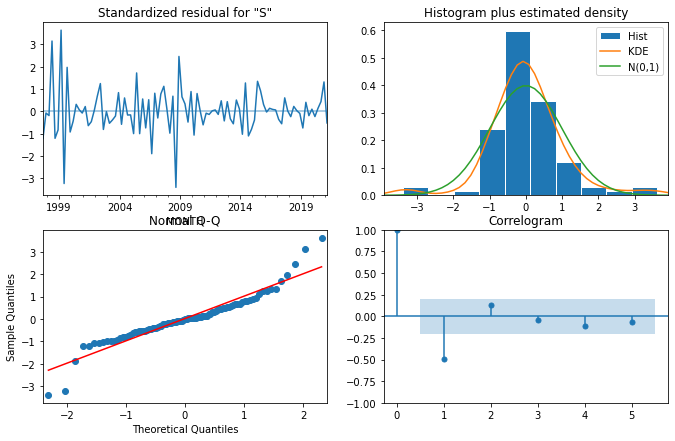

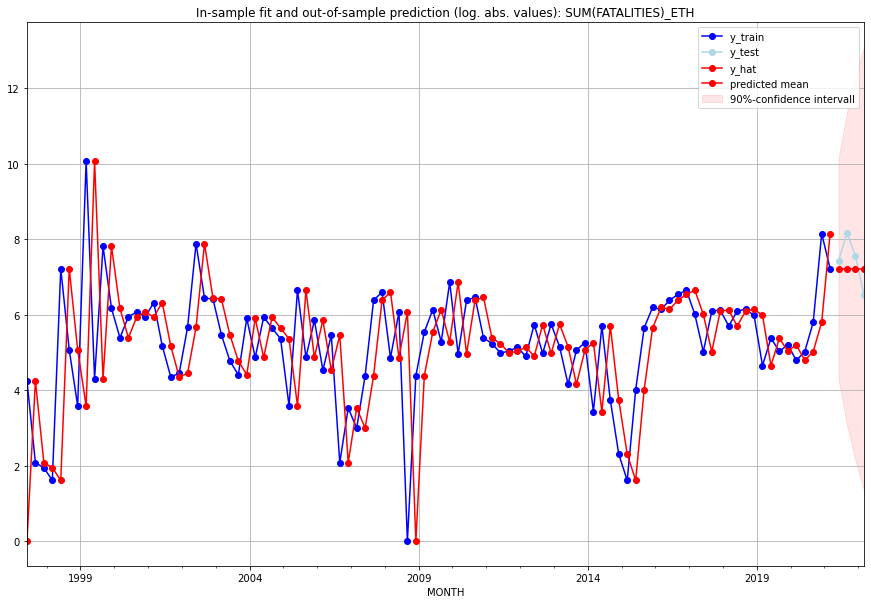

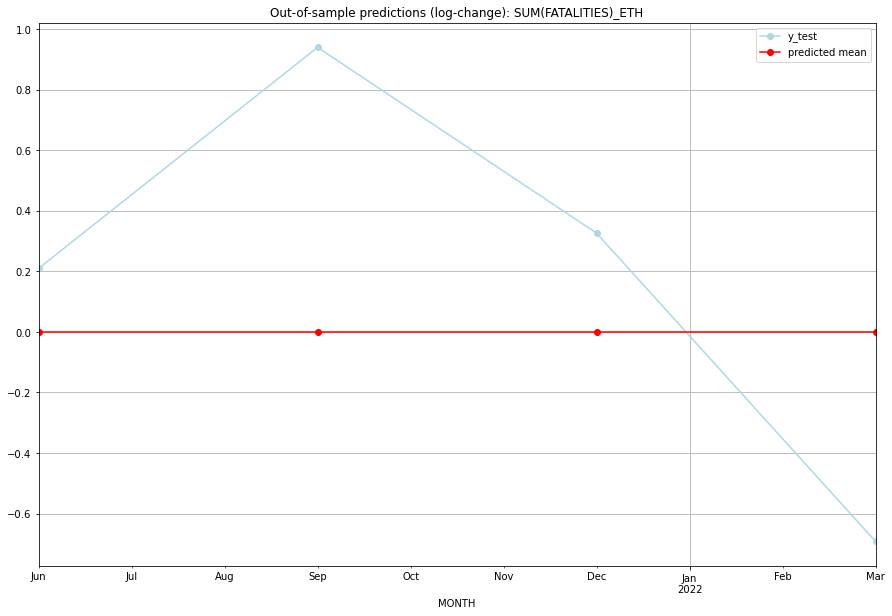

TADDA: 0.5422179258427575
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01    1370.0      1690.0  8.881784e-16        0.209780   ETH   
1 2021-07-01    1370.0      3510.0  8.881784e-16        0.940360   ETH   
2 2021-10-01    1370.0      1899.0  8.881784e-16        0.326313   ETH   
3 2022-01-01    1370.0       685.0  8.881784e-16       -0.692418   ETH   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## FIN (69/234) #########
0
Neighbor countries: []
Getting Data for FIN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 65)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient da

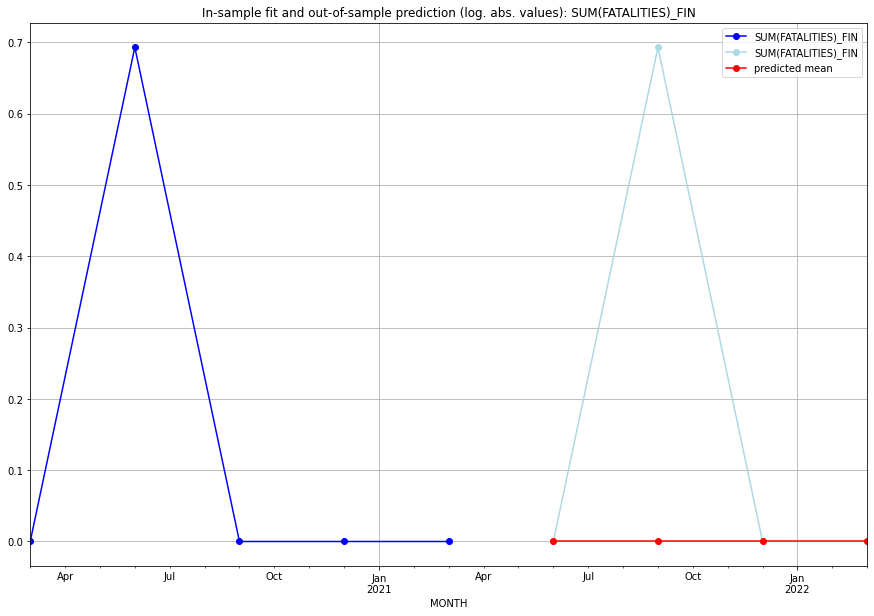

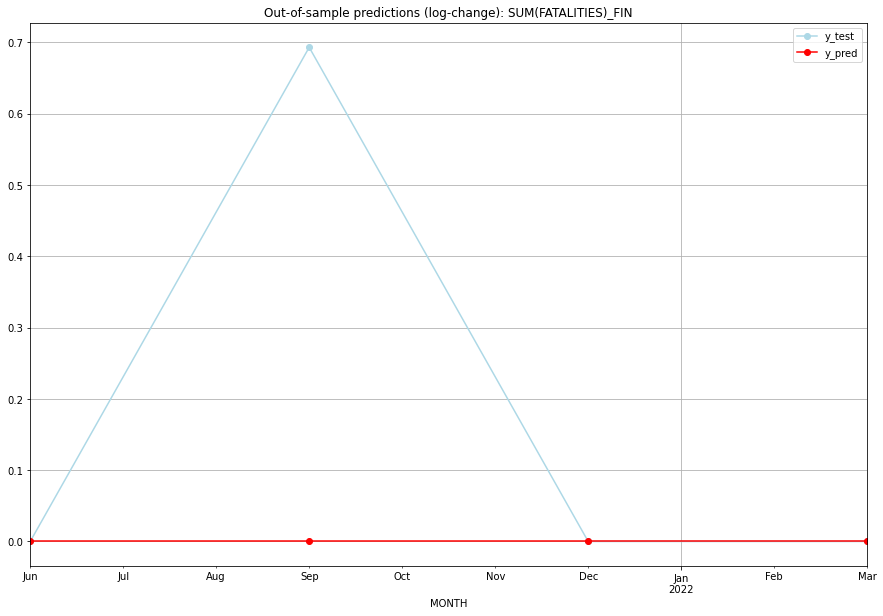

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.000000           0.0        0.000000   FIN   
1 2021-07-01       0.0    0.693147           0.0        0.693147   FIN   
2 2021-10-01       0.0    0.000000           0.0        0.000000   FIN   
3 2022-01-01       0.0    0.000000           0.0        0.000000   FIN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## FJI (70/234) #########
0
Neighbor countries: []
Getting Data for FJI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 56)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


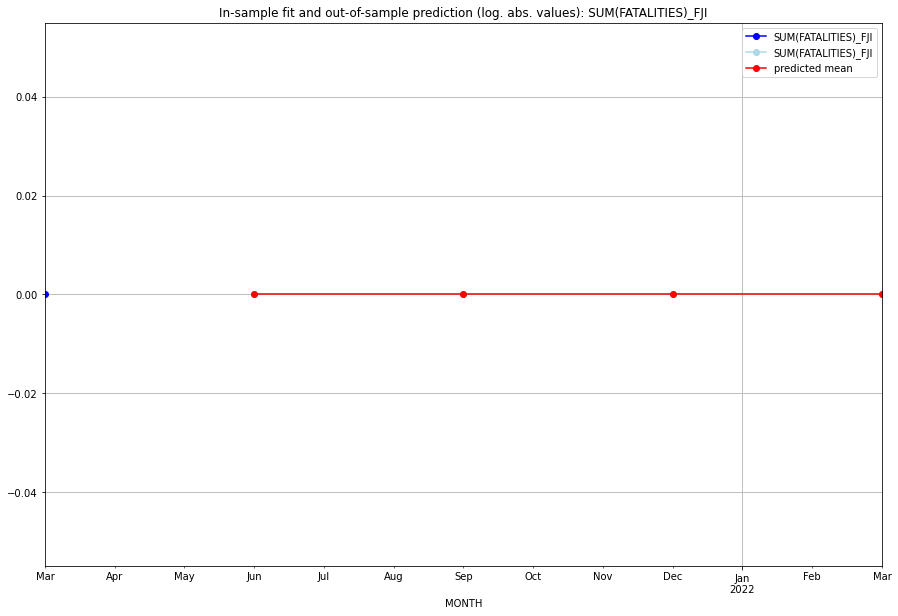

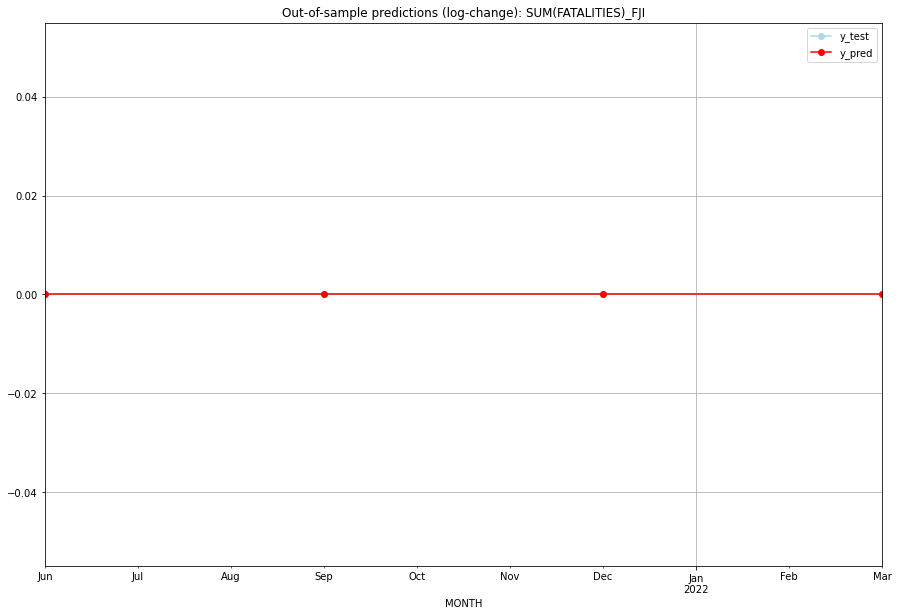

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   FJI   
1 2021-07-01       0.0         0.0           0.0             0.0   FJI   
2 2021-10-01       0.0         0.0           0.0             0.0   FJI   
3 2022-01-01       0.0         0.0           0.0             0.0   FJI   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## FLK (71/234) #########
0
Neighbor countries: []
Getting Data for FLK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


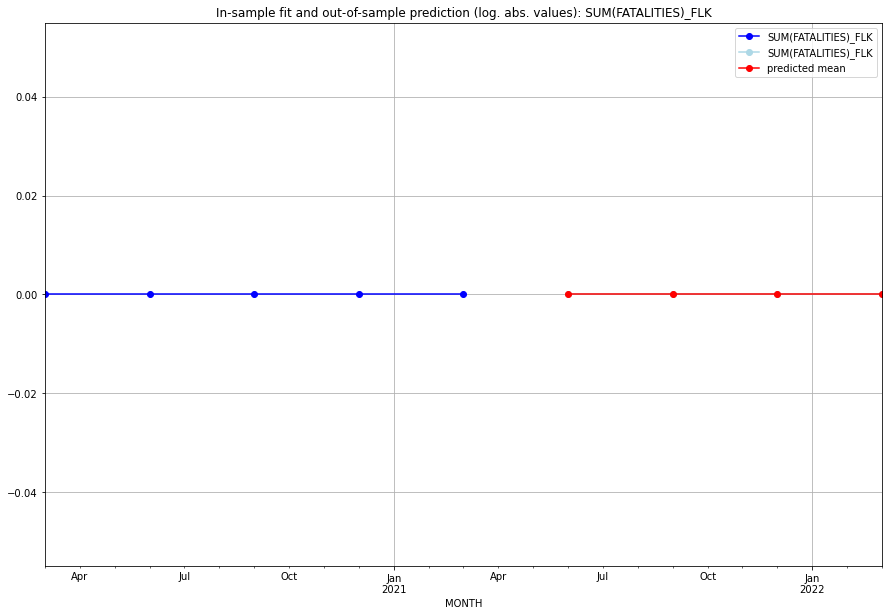

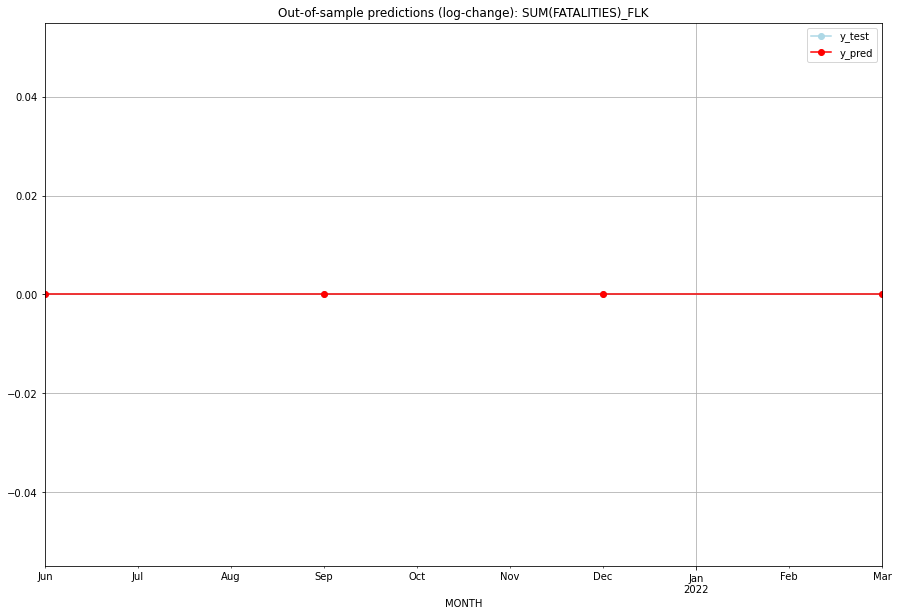

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   FLK   
1 2021-07-01       0.0         0.0           0.0             0.0   FLK   
2 2021-10-01       0.0         0.0           0.0             0.0   FLK   
3 2022-01-01       0.0         0.0           0.0             0.0   FLK   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## FRA (72/234) #########
0
Neighbor countries: []
Getting Data for FRA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 64)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


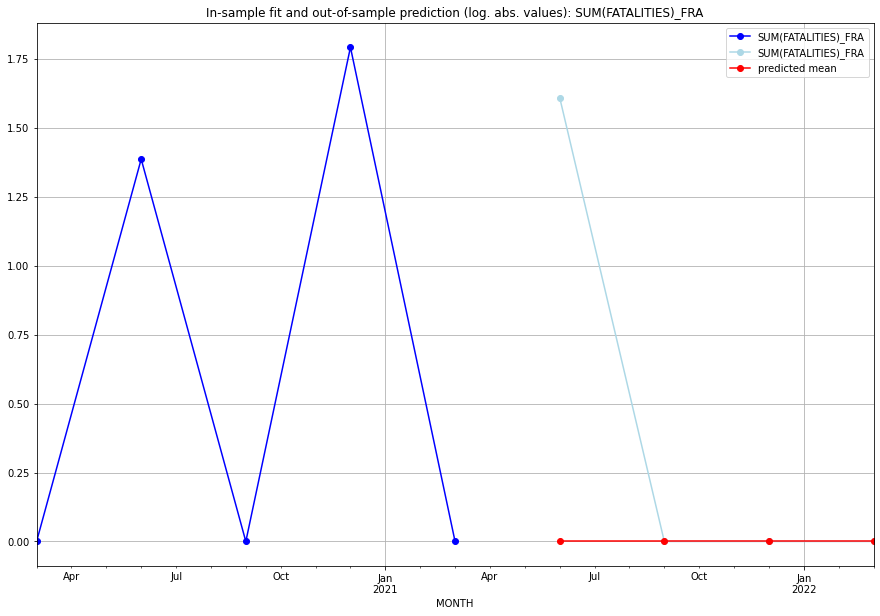

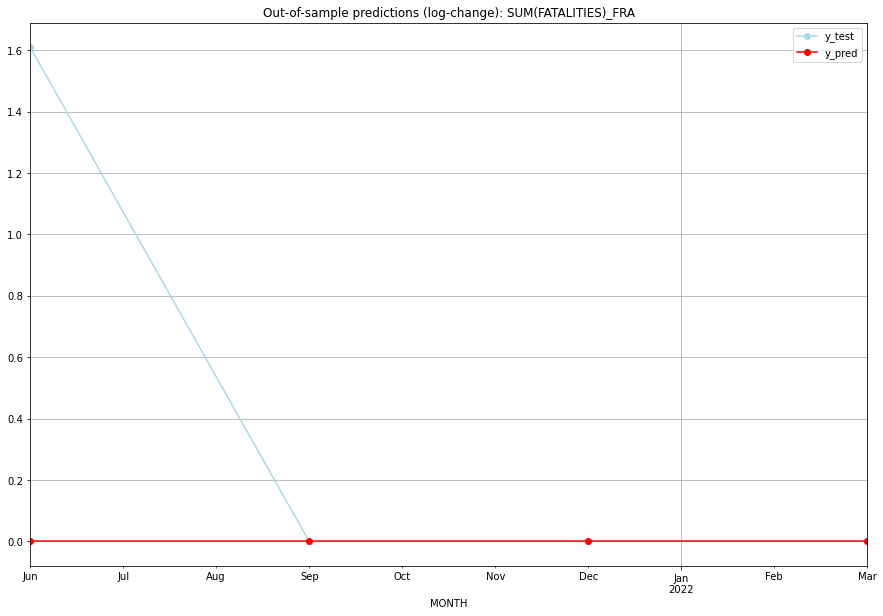

TADDA: 0.4023594781085251
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    1.609438           0.0        1.609438   FRA   
1 2021-07-01       0.0    0.000000           0.0        0.000000   FRA   
2 2021-10-01       0.0    0.000000           0.0        0.000000   FRA   
3 2022-01-01       0.0    0.000000           0.0        0.000000   FRA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## FRO (73/234) #########
0
Neighbor countries: []
Getting Data for FRO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


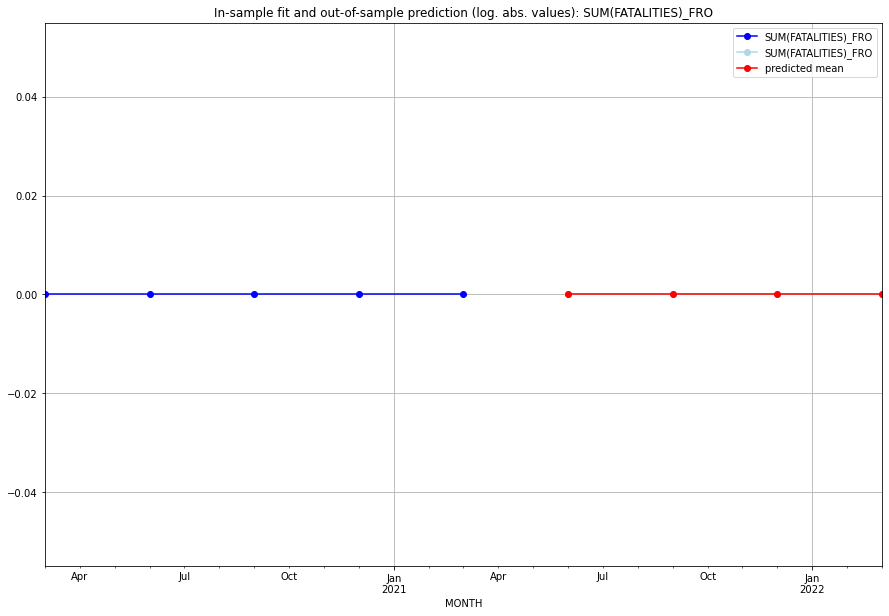

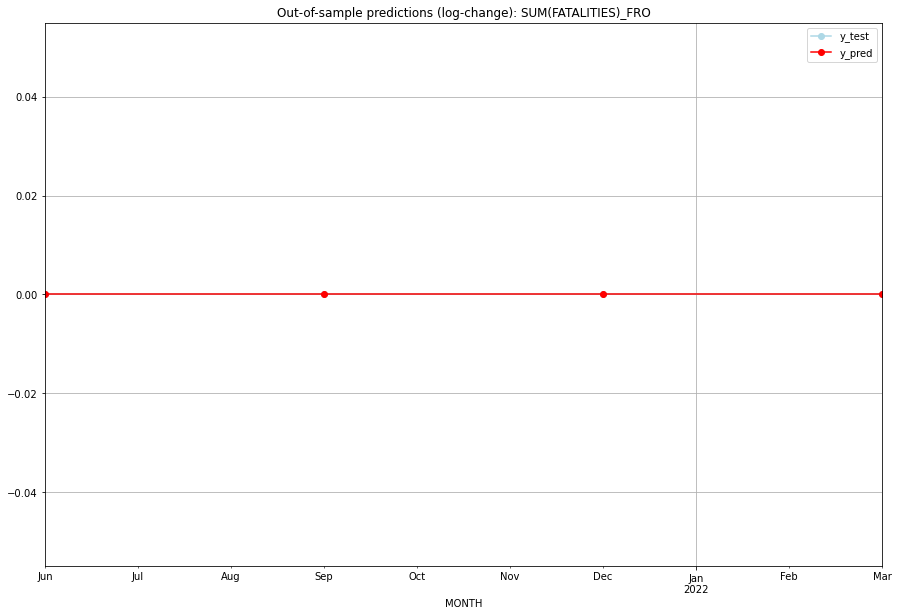

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   FRO   
1 2021-07-01       0.0         0.0           0.0             0.0   FRO   
2 2021-10-01       0.0         0.0           0.0             0.0   FRO   
3 2022-01-01       0.0         0.0           0.0             0.0   FRO   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## FSM (74/234) #########
0
Neighbor countries: []
Getting Data for FSM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 40)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


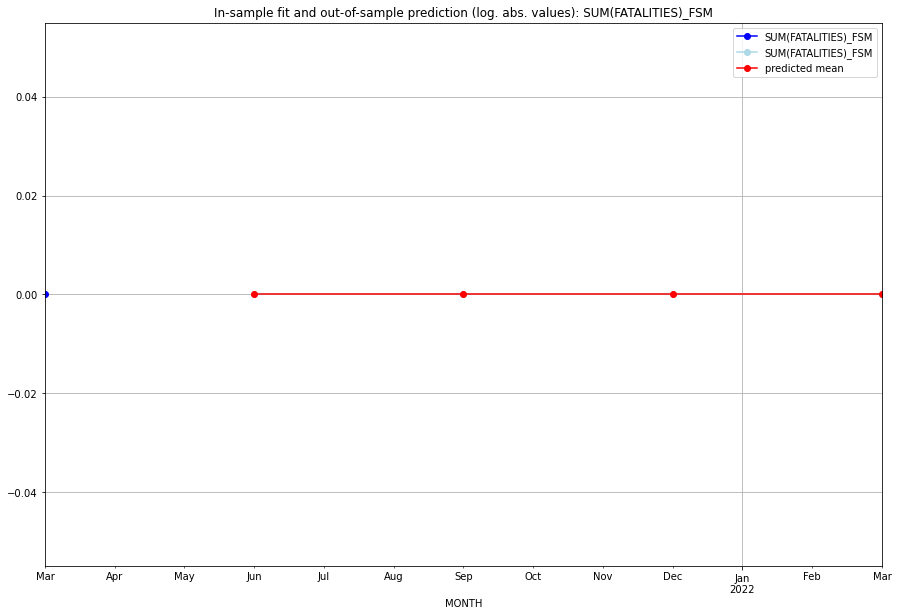

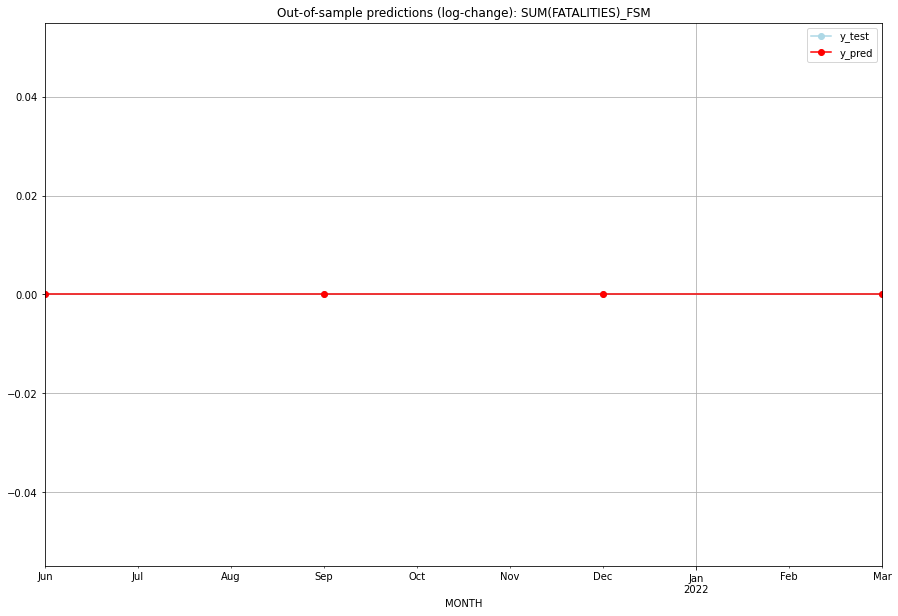

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   FSM   
1 2021-07-01       0.0         0.0           0.0             0.0   FSM   
2 2021-10-01       0.0         0.0           0.0             0.0   FSM   
3 2022-01-01       0.0         0.0           0.0             0.0   FSM   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:05
######## GAB (75/234) #########
0
Neighbor countries: []
Getting Data for GAB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 58)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.3635987547491645, 'fold_results': [0.5200010015242823, 0.00221175660303038, 0.17328697001456111, 0.6212262683280748, 0.5012677772758738]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GAB   No. Observations:                   96
Model:                SARIMAX(2, 0, 3)   Log Likelihood                 -63.442
Date:                 Wed, 19 Oct 2022   AIC                            138.883
Time:                         10:36:35   BIC                            154.270
Sample:                     04-30-1997   HQIC                           145.103
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

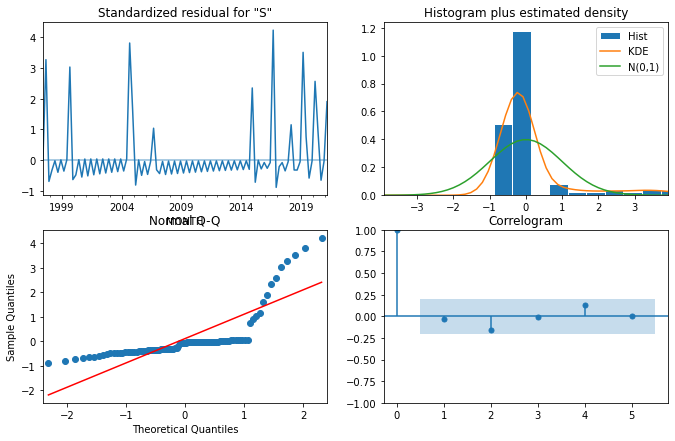

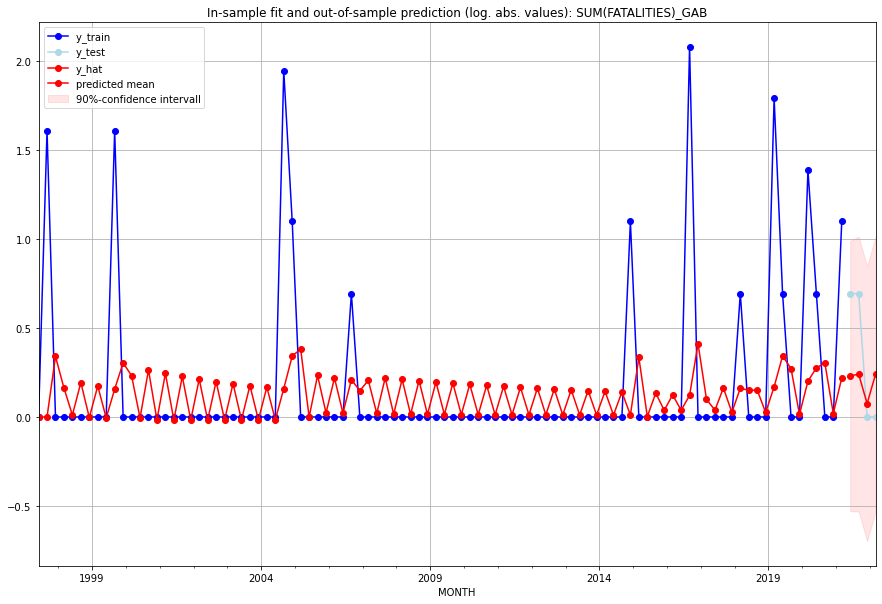

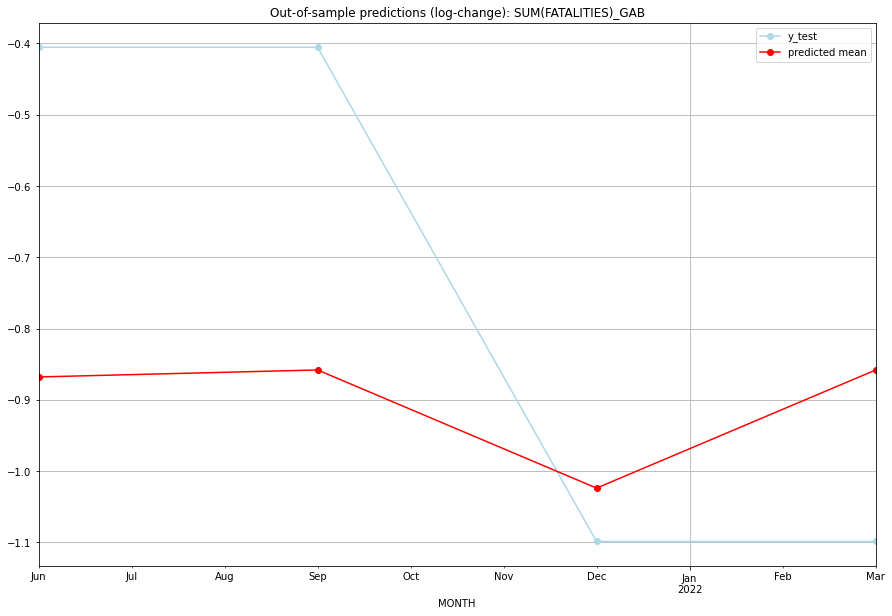

TADDA: 0.3075763845494407
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.259585         1.0     -0.867830       -0.405465   GAB   
1 2021-07-01  0.271999         1.0     -0.858023       -0.405465   GAB   
2 2021-10-01  0.077769         0.0     -1.023719       -1.098612   GAB   
3 2022-01-01  0.271872         0.0     -0.858123       -1.098612   GAB   

                                          PARAMETERS  
0  {'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:33
######## GBR (76/234) #########
0
Neighbor countries: []
Getting Data for GBR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 64)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient da

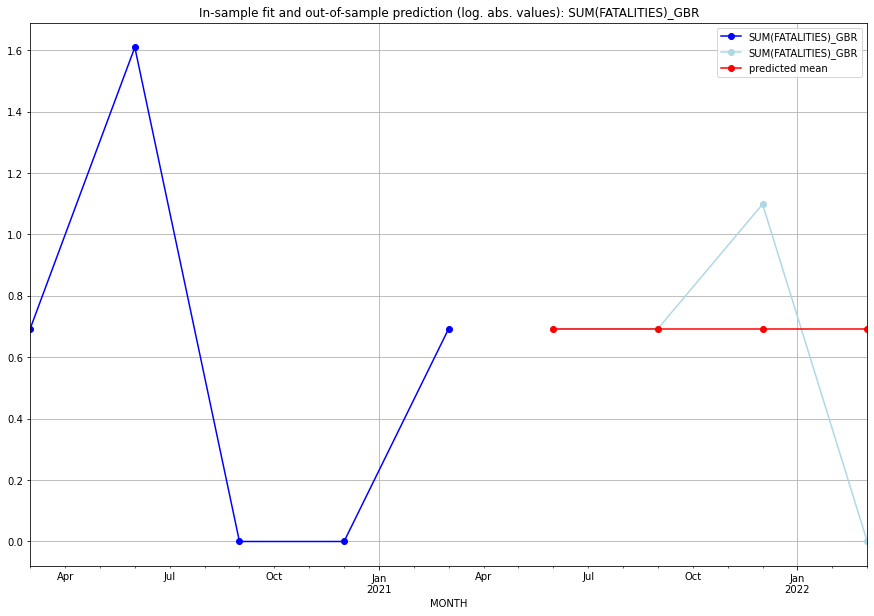

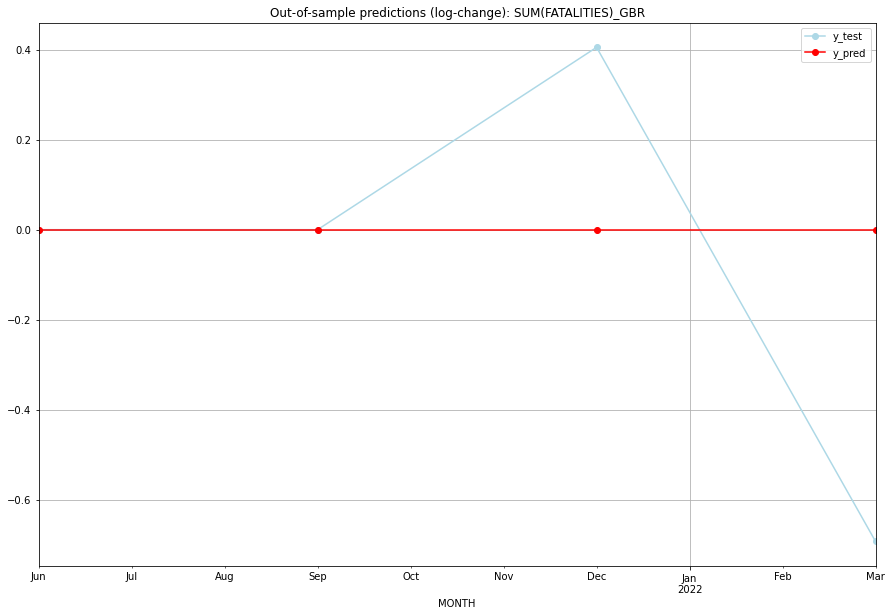

TADDA: 0.27465307216702745
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.693147    0.693147           0.0        0.000000   GBR   
1 2021-07-01  0.693147    0.693147           0.0        0.000000   GBR   
2 2021-10-01  0.693147    1.098612           0.0        0.405465   GBR   
3 2022-01-01  0.693147    0.000000           0.0       -0.693147   GBR   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## GEO (77/234) #########
0
Neighbor countries: []
Getting Data for GEO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 63)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.27107320736295104, 'fold_results': [0.22084199016920852, 0.3213044245566936]}
Training finished.

                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GEO   No. Observations:                   13
Model:                SARIMAX(0, 1, 3)   Log Likelihood                     nan
Date:                 Wed, 19 Oct 2022   AIC                                nan
Time:                         10:36:47   BIC                                nan
Sample:                     01-31-2018   HQIC                               nan
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0151     

<Figure size 432x288 with 0 Axes>

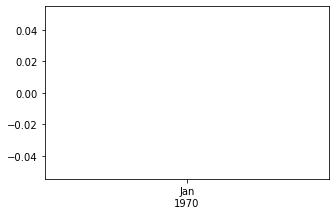

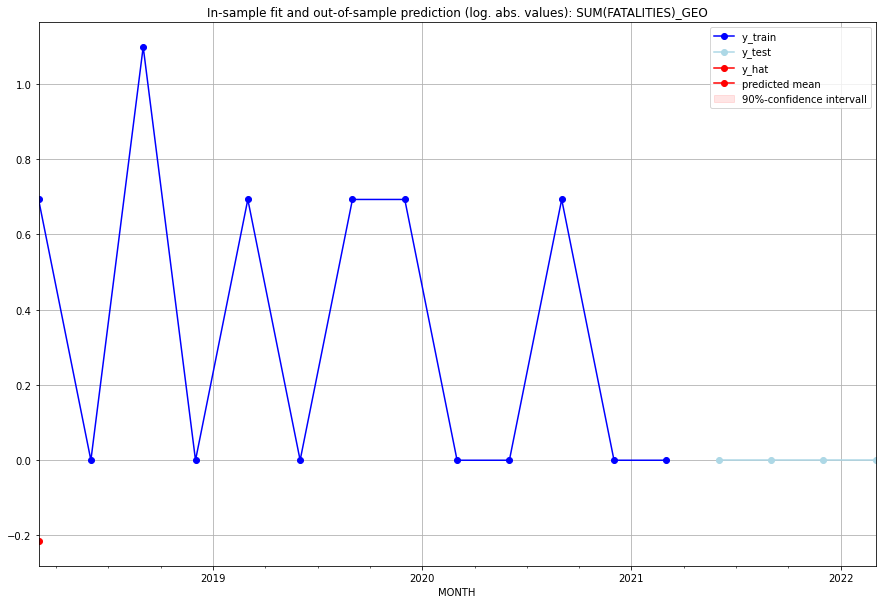

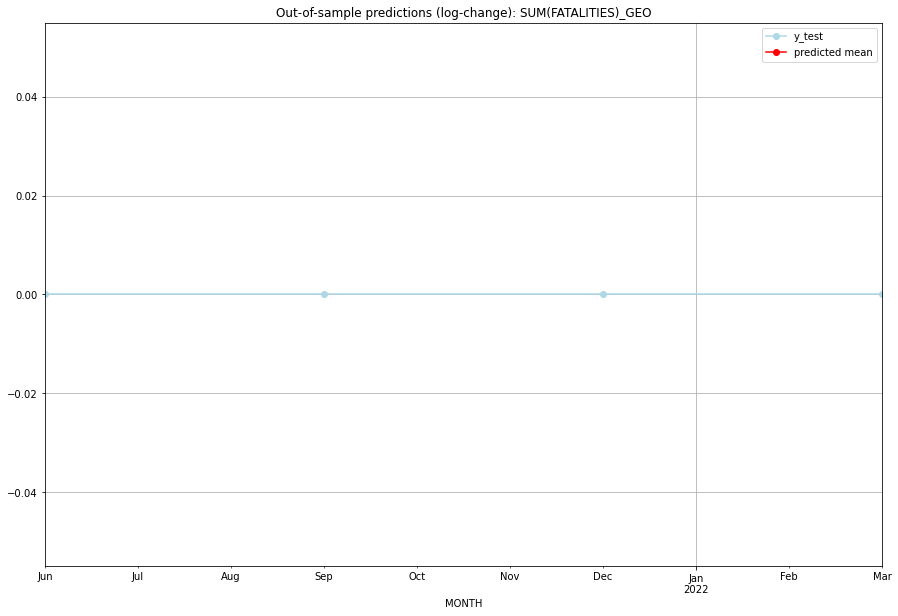

TADDA: nan
Evaluation finished.
Model Prediction failed --> Prediction with Naive Model 


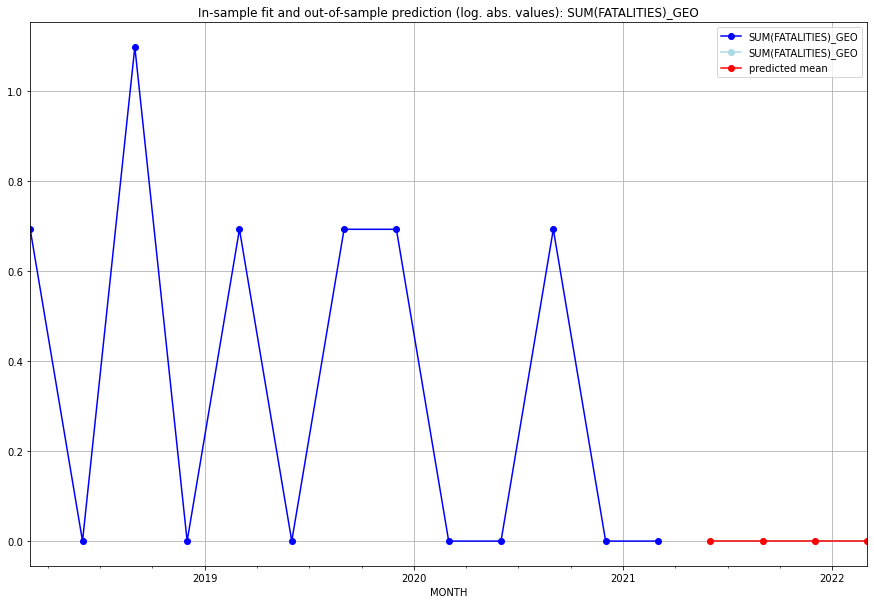

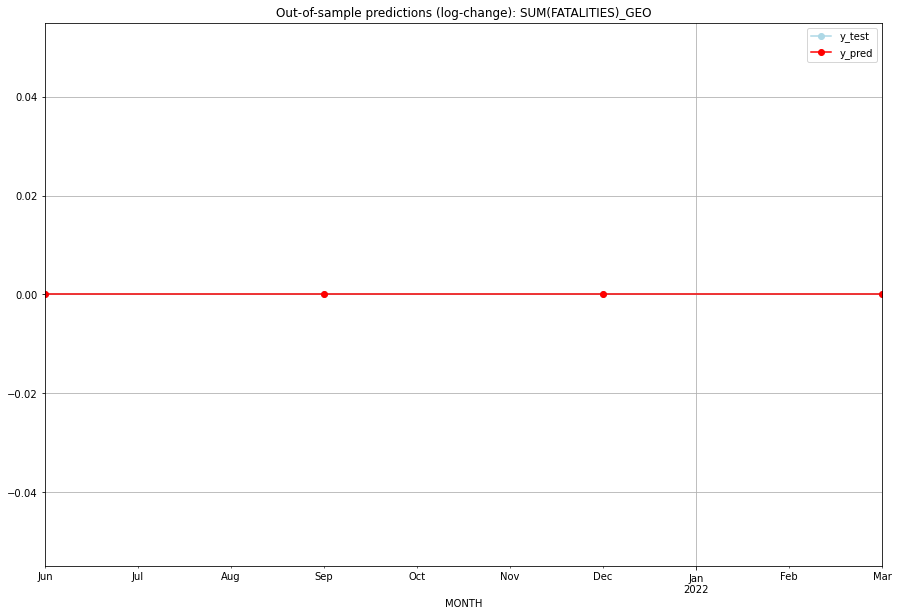

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GEO   
1 2021-07-01       0.0         0.0           0.0             0.0   GEO   
2 2021-10-01       0.0         0.0           0.0             0.0   GEO   
3 2022-01-01       0.0         0.0           0.0             0.0   GEO   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:10
######## GGY (78/234) #########
0
Neighbor countries: []
Getting Data for GGY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GGY   No. Observations:                   96
Model

<Figure size 432x288 with 0 Axes>

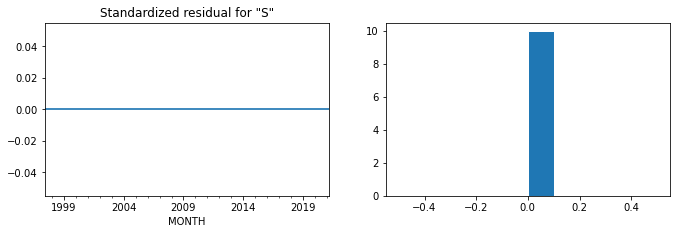

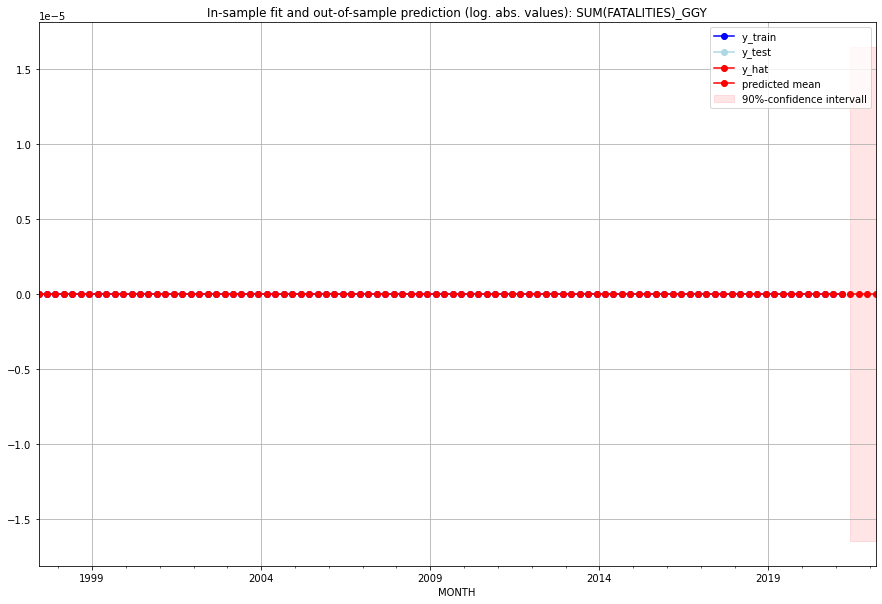

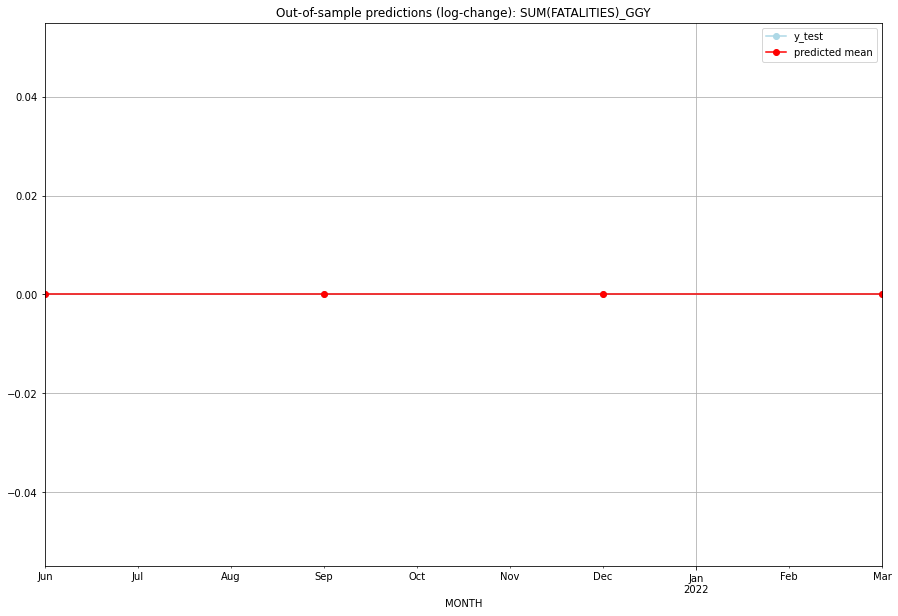

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GGY   
1 2021-07-01       0.0         0.0           0.0             0.0   GGY   
2 2021-10-01       0.0         0.0           0.0             0.0   GGY   
3 2022-01-01       0.0         0.0           0.0             0.0   GGY   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:05
######## GHA (79/234) #########
0
Neighbor countries: []
Getting Data for GHA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 63)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5948705000517108, 'fold_results': [0.6134012237430608, 1.1513988533450603, 0.5182337055608168, 0.28172515720919145, 0.409593560400425]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GHA   No. Observations:                   96
Model:                SARIMAX(0, 1, 3)   Log Likelihood                -139.345
Date:                 Wed, 19 Oct 2022   AIC                            292.689
Time:                         10:37:24   BIC                            310.566
Sample:                     04-30-1997   HQIC                           299.913
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

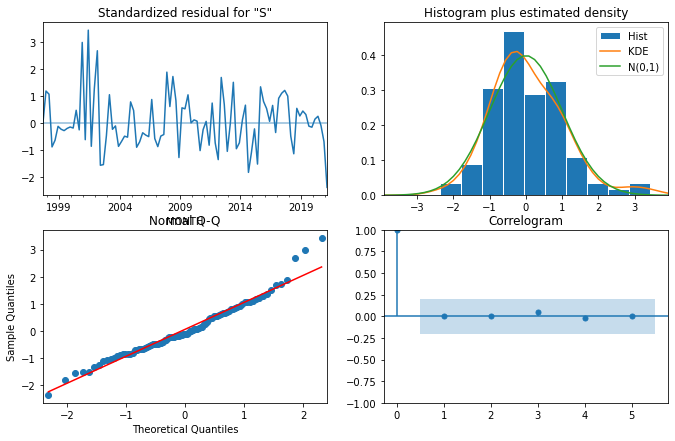

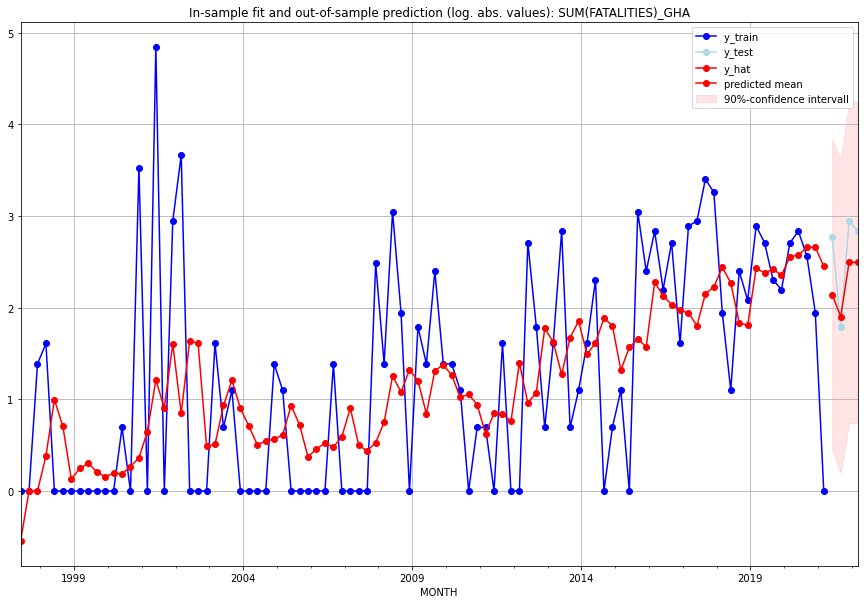

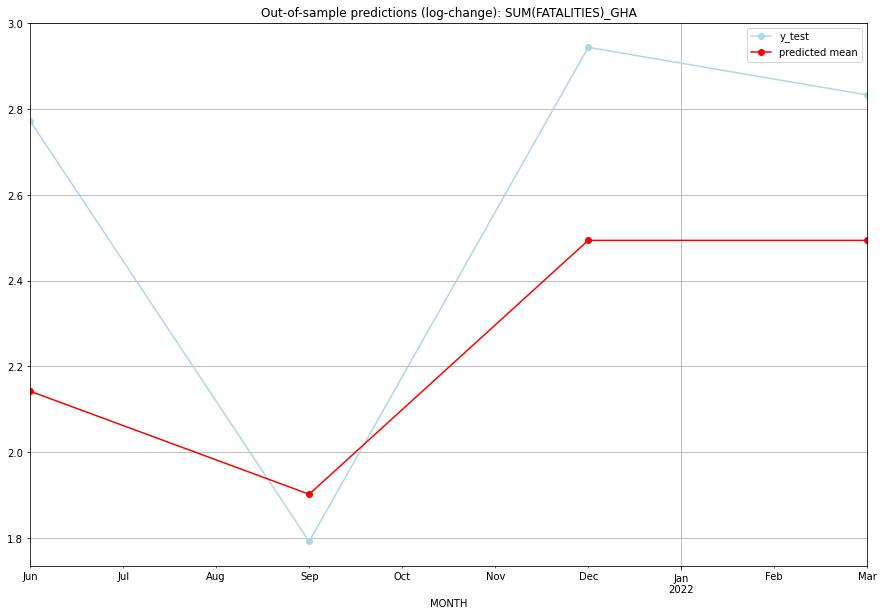

TADDA: 0.38250429041798345
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   7.518259        15.0      2.142212        2.772589   GHA   
1 2021-07-01   5.699065         5.0      1.901968        1.791759   GHA   
2 2021-10-01  11.110953        18.0      2.494110        2.944439   GHA   
3 2022-01-01  11.110953        16.0      2.494110        2.833213   GHA   

                                          PARAMETERS  
0  {'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:31
######## GIB (80/234) #########
0
Neighbor countries: []
Getting Data for GIB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficie

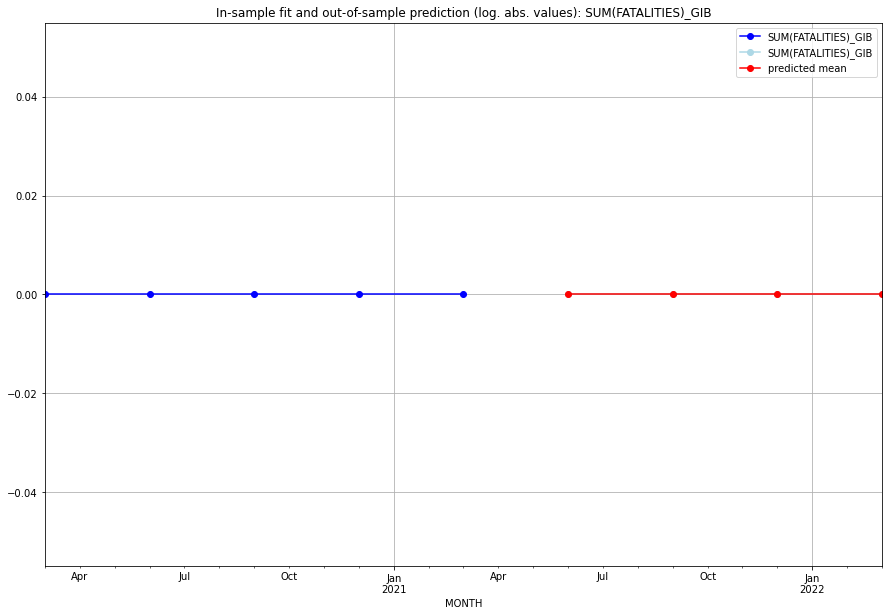

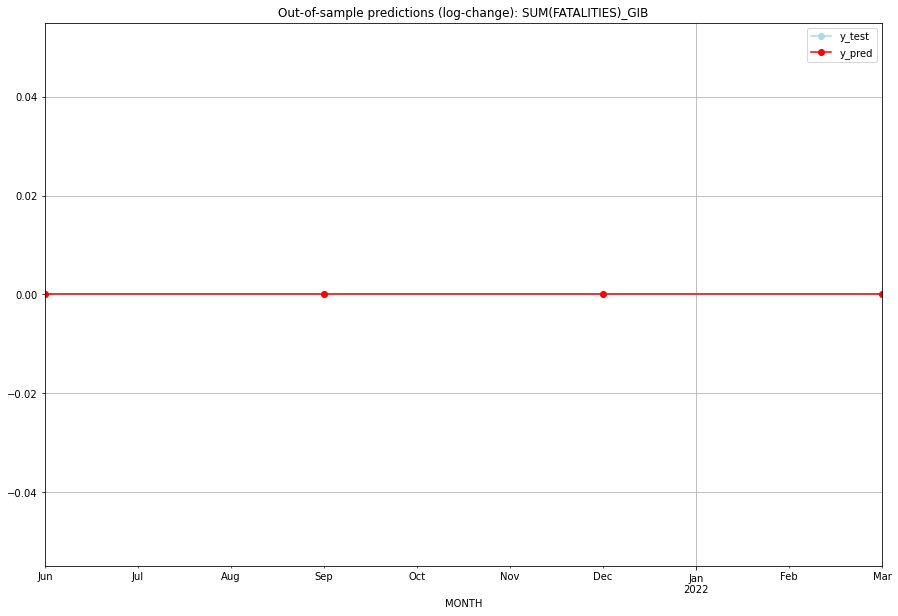

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GIB   
1 2021-07-01       0.0         0.0           0.0             0.0   GIB   
2 2021-10-01       0.0         0.0           0.0             0.0   GIB   
3 2022-01-01       0.0         0.0           0.0             0.0   GIB   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## GIN (81/234) #########
0
Neighbor countries: []
Getting Data for GIN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 58)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 1.0893322484890813, 'fold_results': [0.8991821485444369, 1.494704144876799, 0.38543393790074365, 0.8872672386375873, 1.7800737724858395]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GIN   No. Observations:                   96
Model:                SARIMAX(1, 1, 1)   Log Likelihood                -173.762
Date:                 Wed, 19 Oct 2022   AIC                            355.524
Time:                         10:37:45   BIC                            365.740
Sample:                     04-30-1997   HQIC                           359.652
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

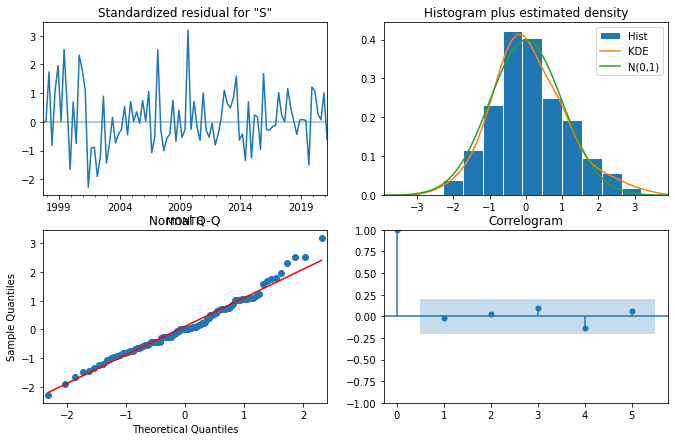

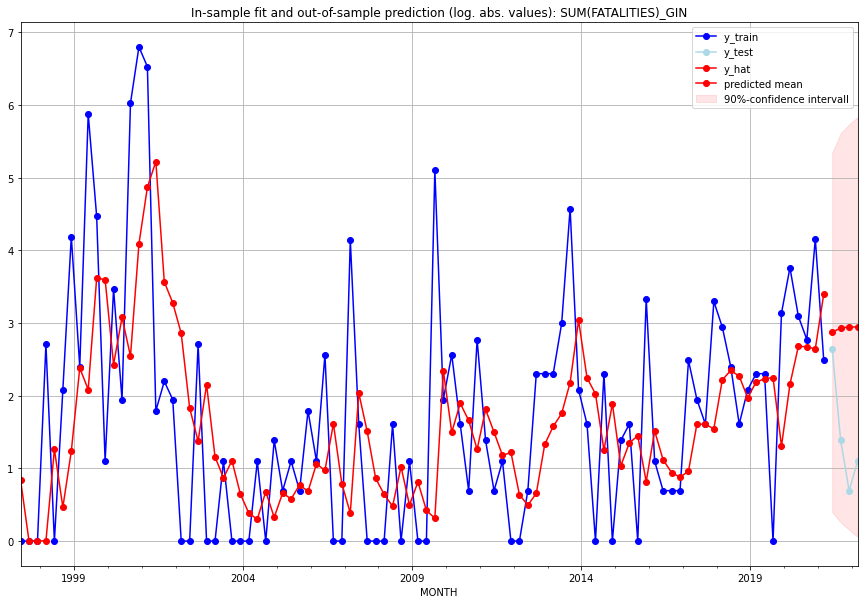

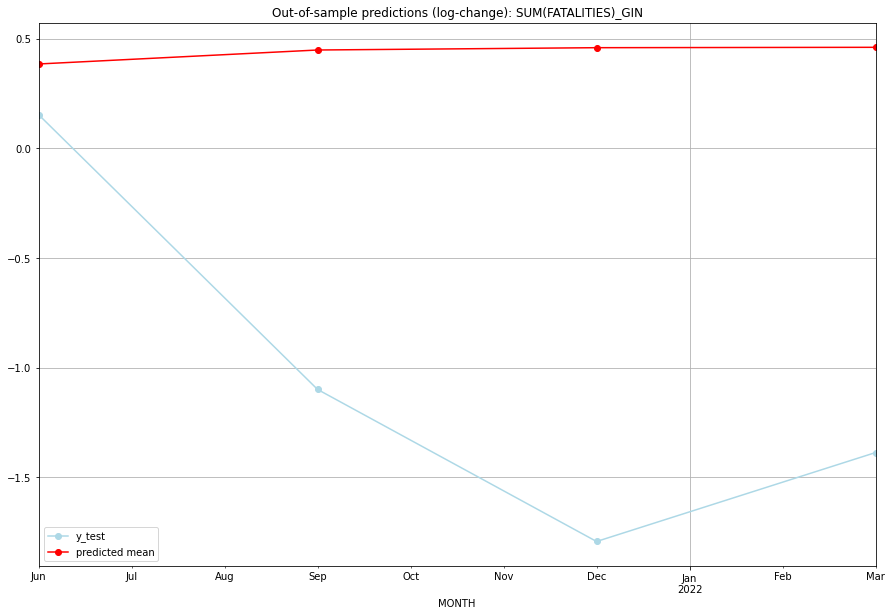

TADDA: 1.8115485251113235
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  16.637129        13.0      0.385100        0.154151   GIN   
1 2021-07-01  17.797542         3.0      0.448819       -1.098612   GIN   
2 2021-10-01  17.996778         1.0      0.459363       -1.791759   GIN   
3 2022-01-01  18.029948         2.0      0.461107       -1.386294   GIN   

                                          PARAMETERS  
0  {'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## GLP (82/234) #########
0
Neighbor countries: []
Getting Data for GLP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV n

<Figure size 432x288 with 0 Axes>

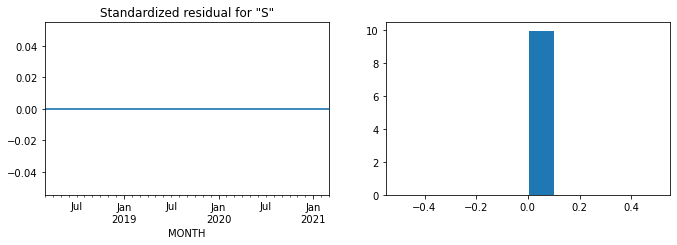

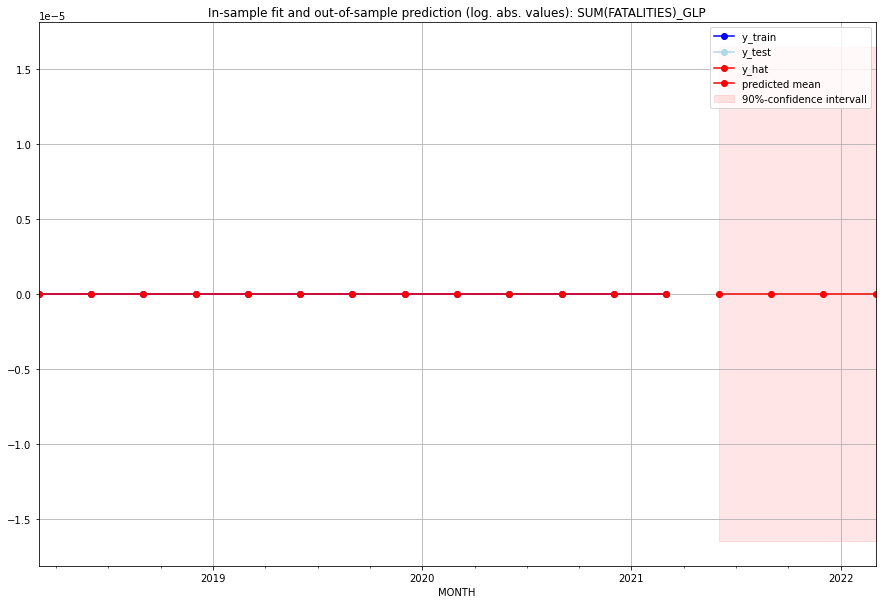

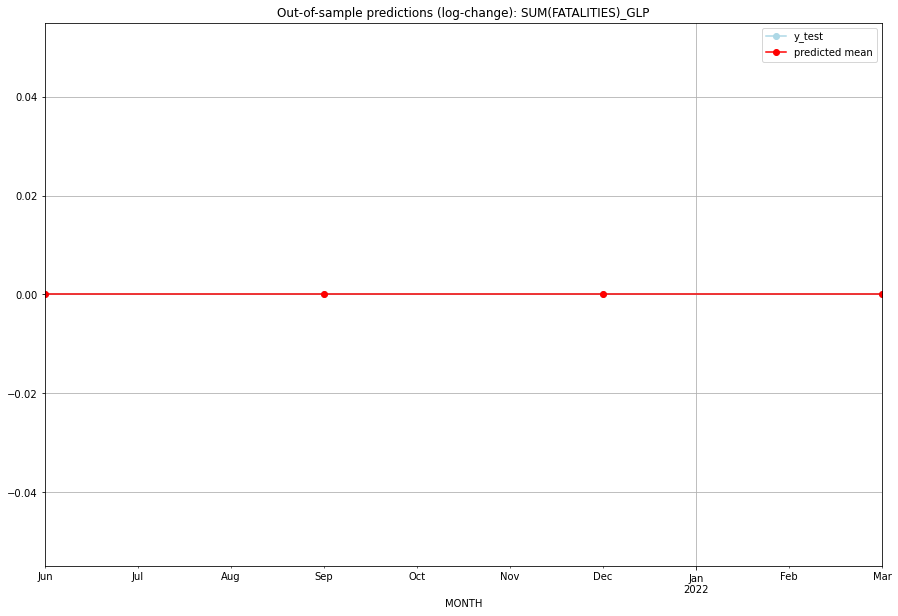

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GLP   
1 2021-07-01       0.0         0.0           0.0             0.0   GLP   
2 2021-10-01       0.0         0.0           0.0             0.0   GLP   
3 2022-01-01       0.0         0.0           0.0             0.0   GLP   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## GMB (83/234) #########
0
Neighbor countries: []
Getting Data for GMB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.43943800703874986, 'fold_results': [0.4029094733494411, 0.7626921793321142, 0.3562583400137333, 0.30697785207347783, 0.3683521904249826]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GMB   No. Observations:                   96
Model:                SARIMAX(0, 0, 3)   Log Likelihood                -116.615
Date:                 Wed, 19 Oct 2022   AIC                            241.230
Time:                         10:38:04   BIC                            251.488
Sample:                     04-30-1997   HQIC                           245.377
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

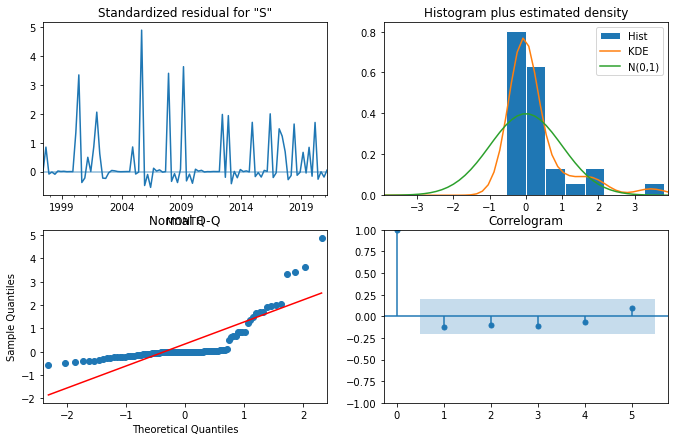

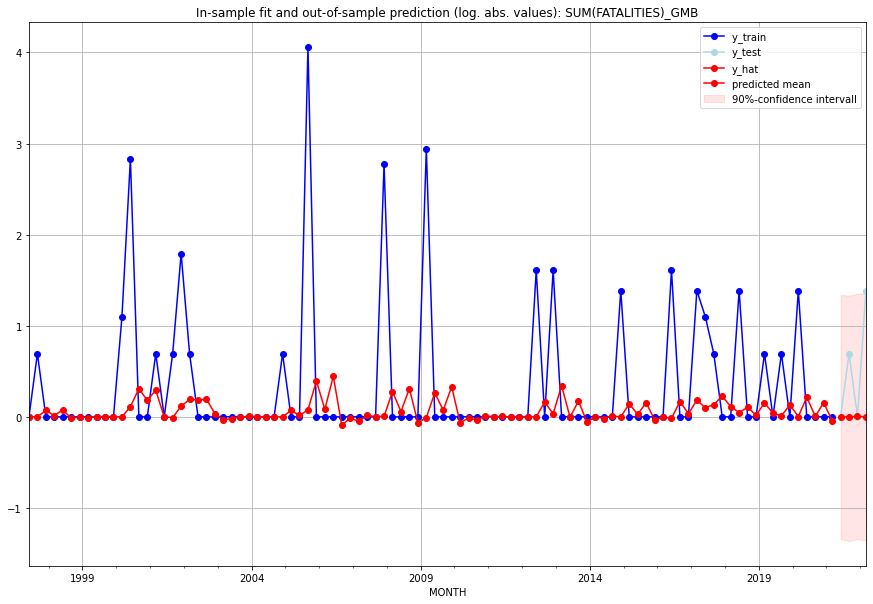

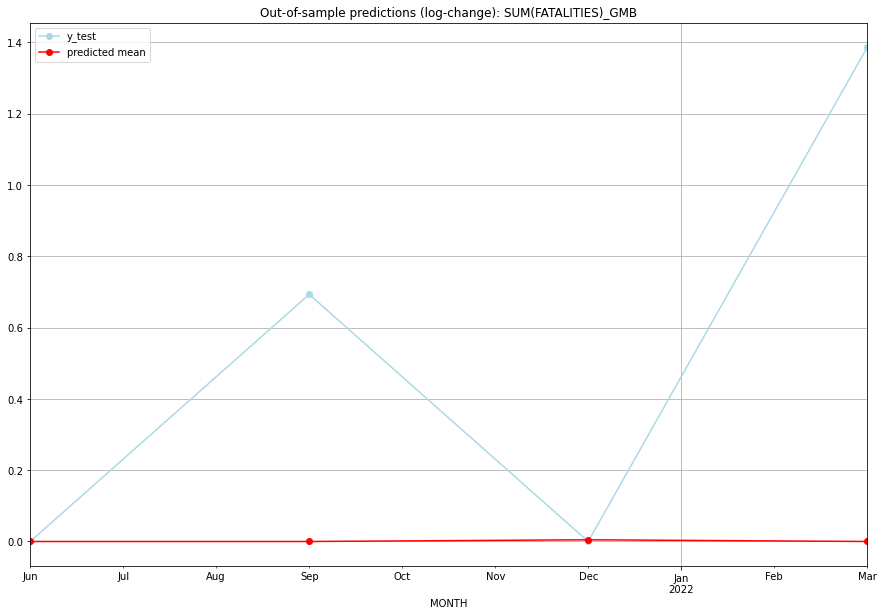

TADDA: 0.521057597646773
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01    0.0000         0.0      0.000000        0.000000   GMB   
1 2021-07-01    0.0000         1.0      0.000000        0.693147   GMB   
2 2021-10-01    0.0048         0.0      0.004789        0.000000   GMB   
3 2022-01-01    0.0000         3.0      0.000000        1.386294   GMB   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## GNB (84/234) #########
0
Neighbor countries: []
Getting Data for GNB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 59)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.14978661367769958, 'fold_results': [0.0, 0.0, 6.560425886295985e-142, 0.17328679513998632, 0.5756462732485115]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GNB   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -158.739
Date:                 Wed, 19 Oct 2022   AIC                            319.478
Time:                         10:38:22   BIC                            322.032
Sample:                     04-30-1997   HQIC                           320.510
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

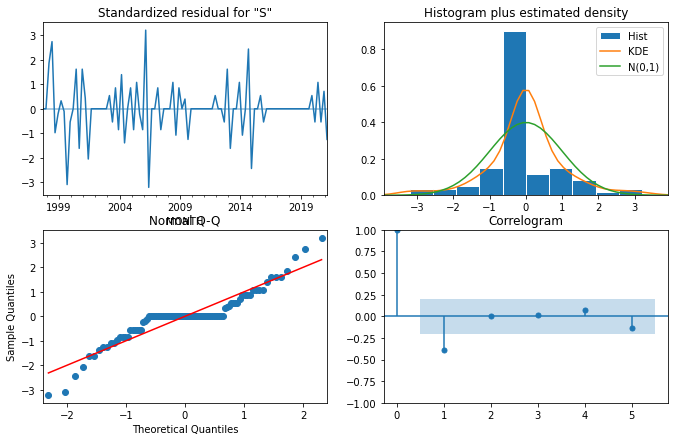

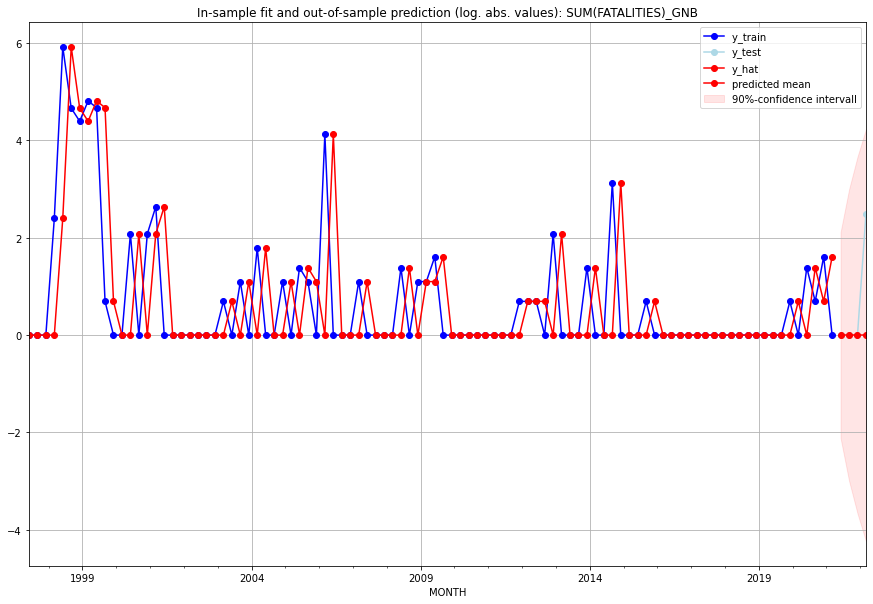

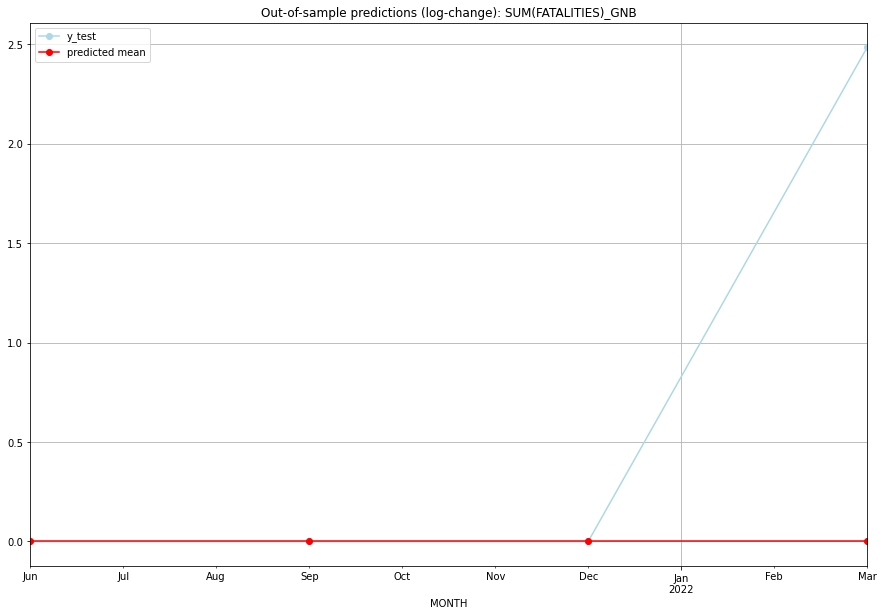

TADDA: 0.6212266624470001
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   GNB   
1 2021-07-01       0.0         0.0           0.0        0.000000   GNB   
2 2021-10-01       0.0         0.0           0.0        0.000000   GNB   
3 2022-01-01       0.0        11.0           0.0        2.484907   GNB   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## GNQ (85/234) #########
0
Neighbor countries: []
Getting Data for GNQ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 53)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU co

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.2138333059508028, 'fold_results': [0.0, 0.7225929394740412, 0.17328679513998646, 0.17328679513998632, 1.3684555315672042e-48]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GNQ   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -94.726
Date:                 Wed, 19 Oct 2022   AIC                            191.452
Time:                         10:38:50   BIC                            194.006
Sample:                     04-30-1997   HQIC                           192.484
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------

<Figure size 432x288 with 0 Axes>

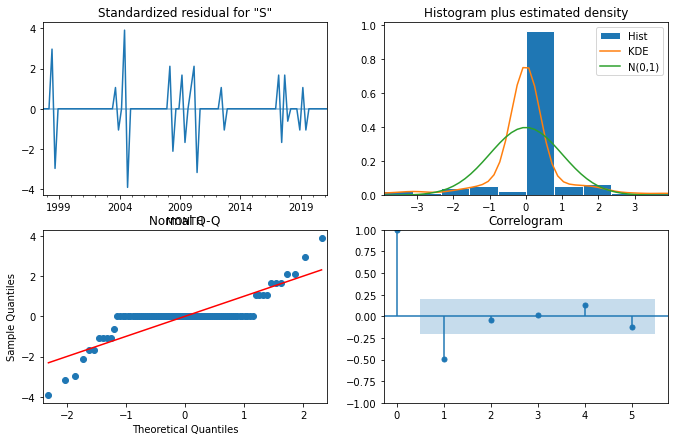

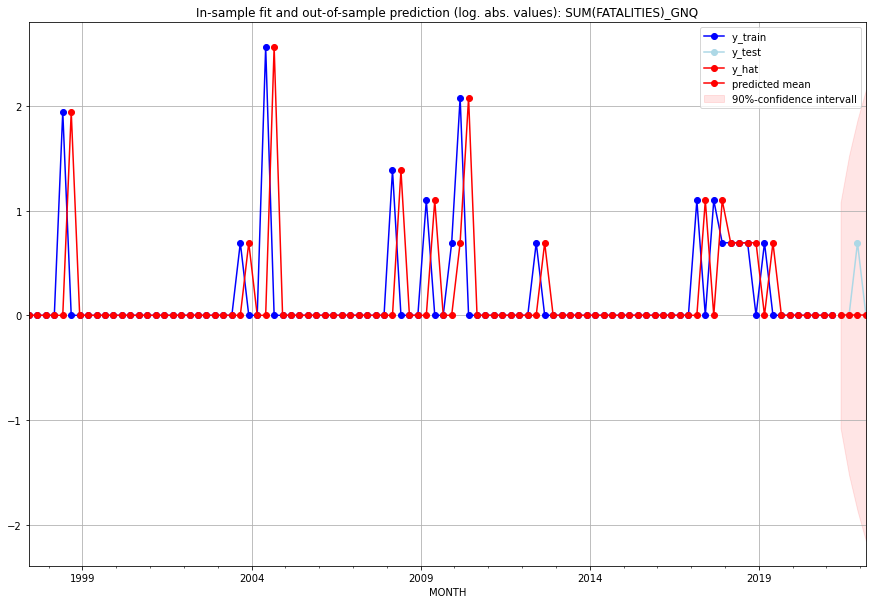

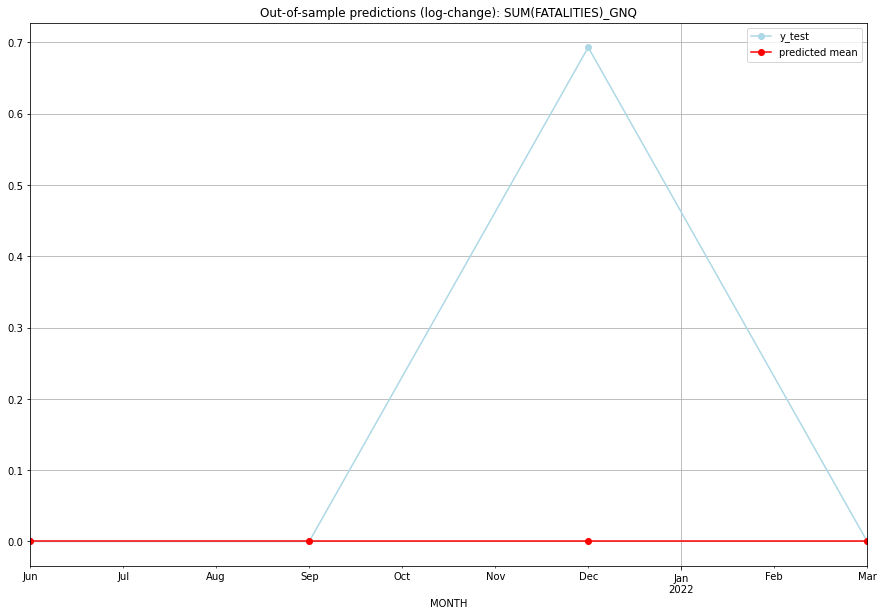

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   GNQ   
1 2021-07-01       0.0         0.0           0.0        0.000000   GNQ   
2 2021-10-01       0.0         1.0           0.0        0.693147   GNQ   
3 2022-01-01       0.0         0.0           0.0        0.000000   GNQ   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:26
######## GRC (86/234) #########
0
Neighbor countries: []
Getting Data for GRC
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 64)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4024753517405437, 'fold_results': [0.421115476371729, 0.3838352271093584]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GRC   No. Observations:                   13
Model:                SARIMAX(2, 0, 0)   Log Likelihood                 -13.016
Date:                 Wed, 19 Oct 2022   AIC                             36.032
Time:                         10:38:56   BIC                             38.856
Sample:                     01-31-2018   HQIC                            35.451
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0239      0.0

<Figure size 432x288 with 0 Axes>

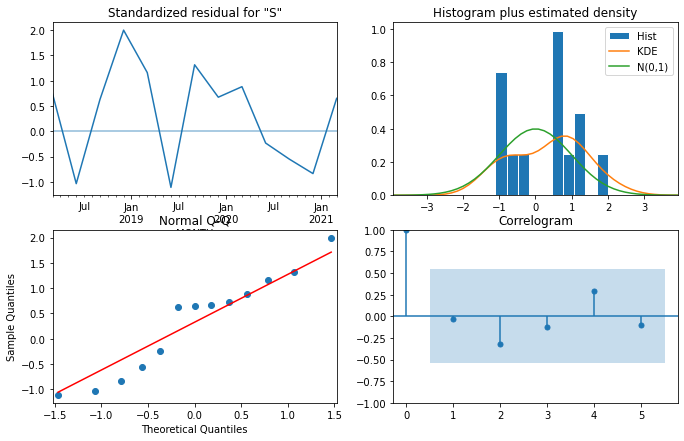

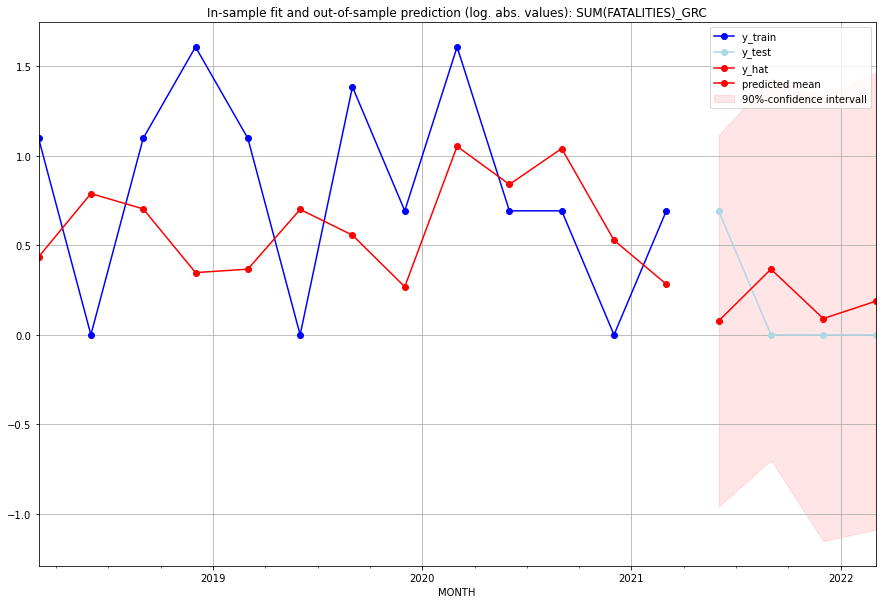

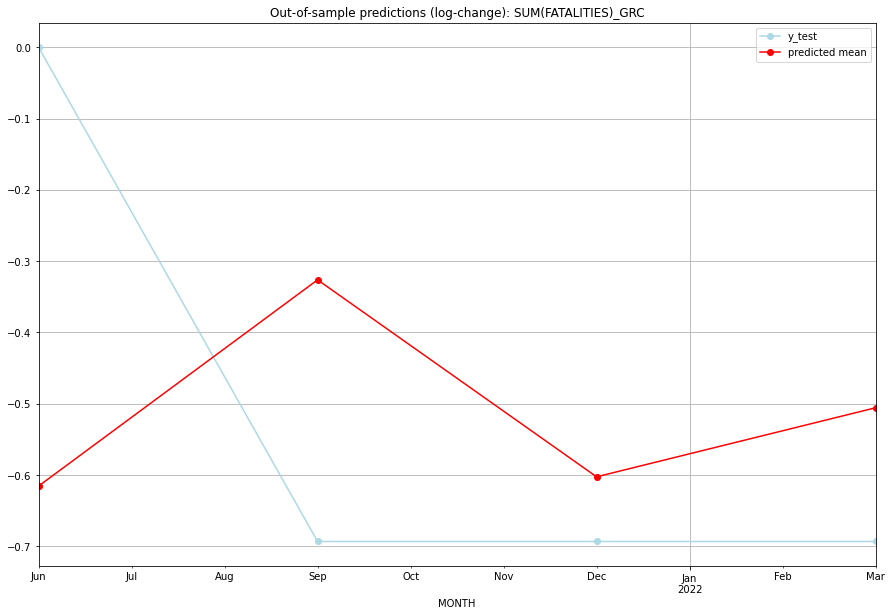

TADDA: 0.3151764109490057
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.080837         1.0     -0.615411        0.000000   GRC   
1 2021-07-01  0.443381         0.0     -0.326159       -0.693147   GRC   
2 2021-10-01  0.094977         0.0     -0.602414       -0.693147   GRC   
3 2022-01-01  0.206319         0.0     -0.505574       -0.693147   GRC   

                                          PARAMETERS  
0  {'params': [2, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## GRD (87/234) #########
0
Neighbor countries: []
Getting Data for GRD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 46)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV neces

<Figure size 432x288 with 0 Axes>

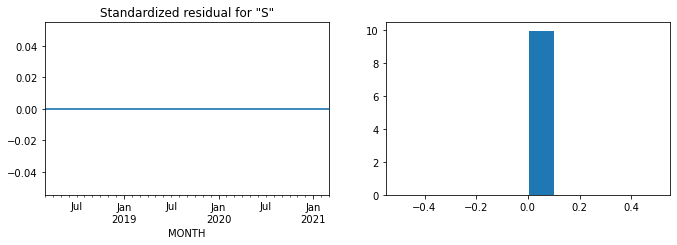

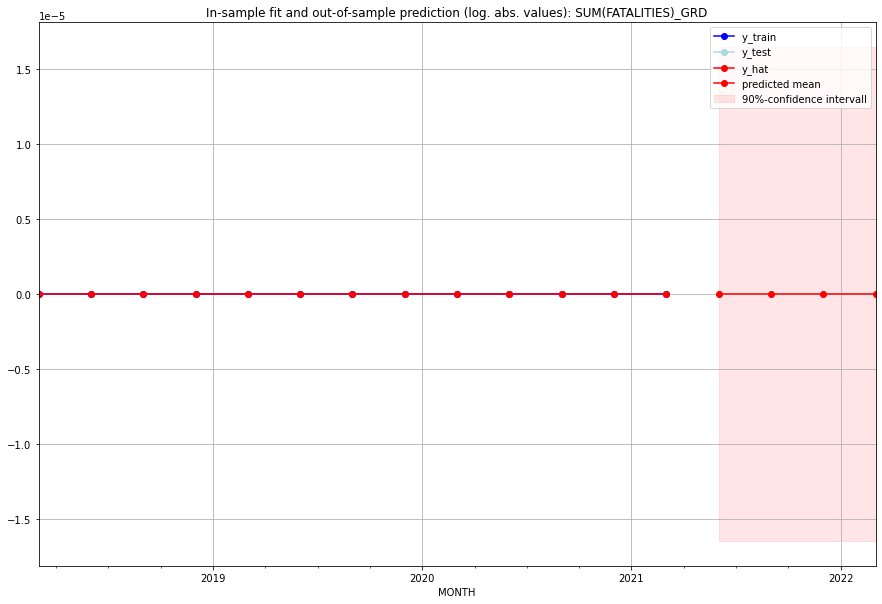

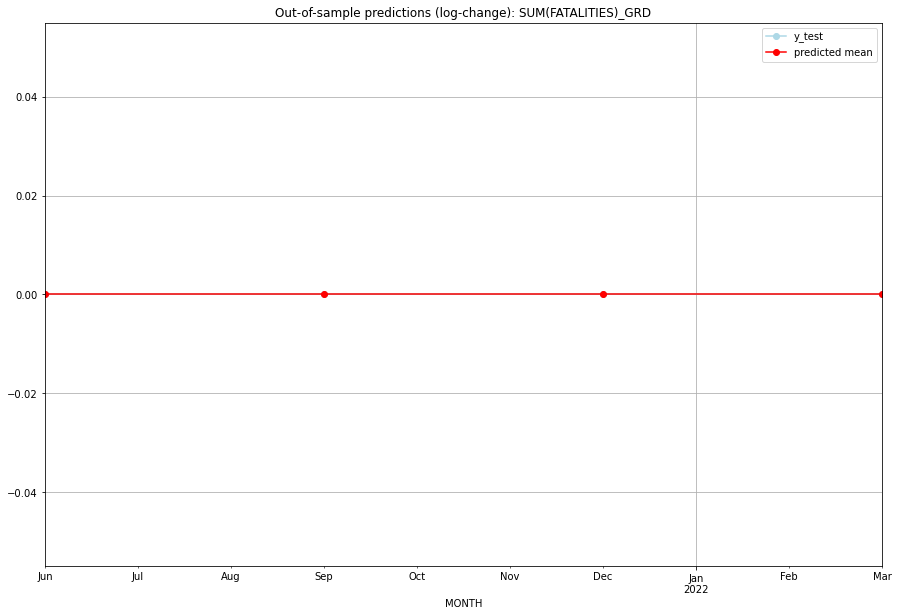

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GRD   
1 2021-07-01       0.0         0.0           0.0             0.0   GRD   
2 2021-10-01       0.0         0.0           0.0             0.0   GRD   
3 2022-01-01       0.0         0.0           0.0             0.0   GRD   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## GRL (88/234) #########
0
Neighbor countries: []
Getting Data for GRL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 23)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


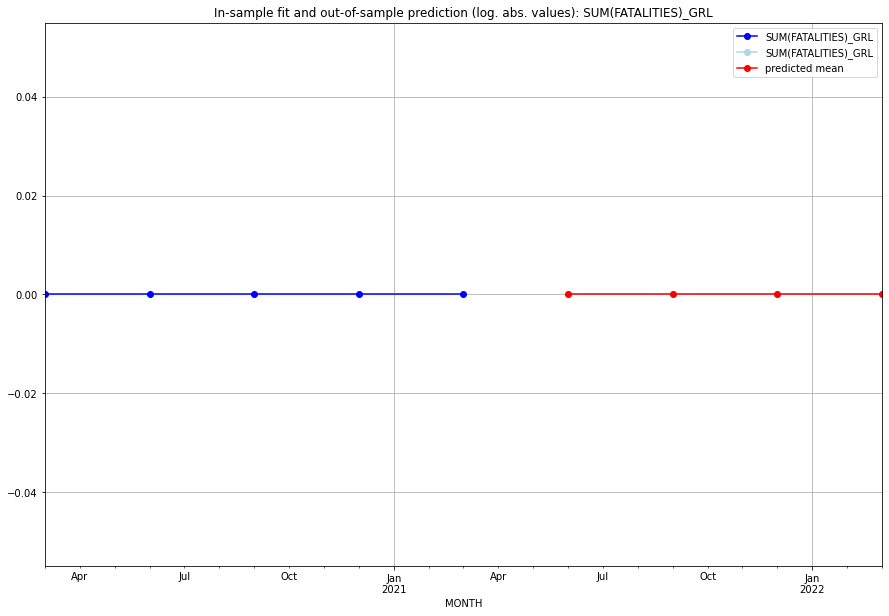

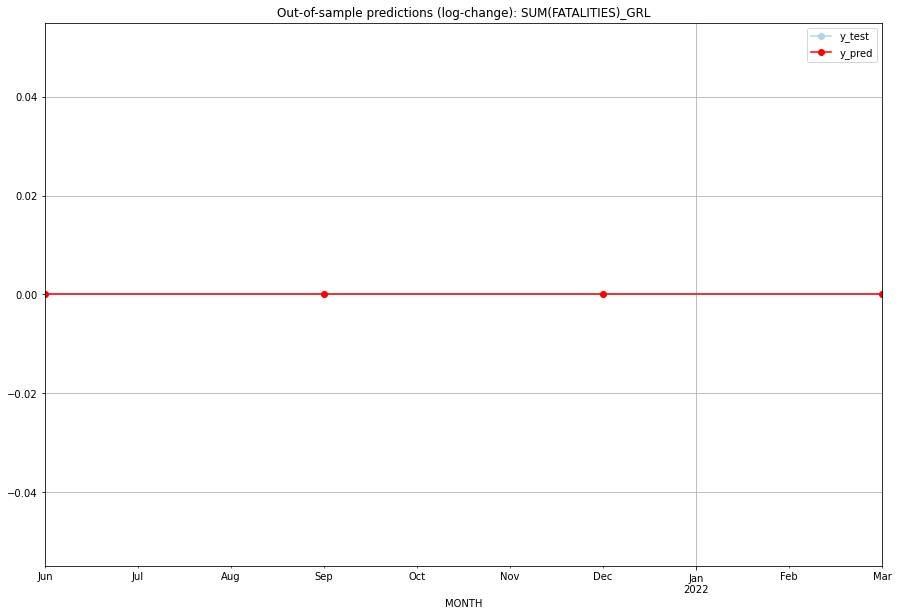

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GRL   
1 2021-07-01       0.0         0.0           0.0             0.0   GRL   
2 2021-10-01       0.0         0.0           0.0             0.0   GRL   
3 2022-01-01       0.0         0.0           0.0             0.0   GRL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## GTM (89/234) #########
0
Neighbor countries: []
Getting Data for GTM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 62)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.23621521484967345, 'fold_results': [0.34499367797222136, 0.12743675172712554]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GTM   No. Observations:                   13
Model:                SARIMAX(1, 0, 1)   Log Likelihood                  -5.413
Date:                 Wed, 19 Oct 2022   AIC                             18.827
Time:                         10:39:13   BIC                             21.086
Sample:                     01-31-2018   HQIC                            18.362
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0301     

<Figure size 432x288 with 0 Axes>

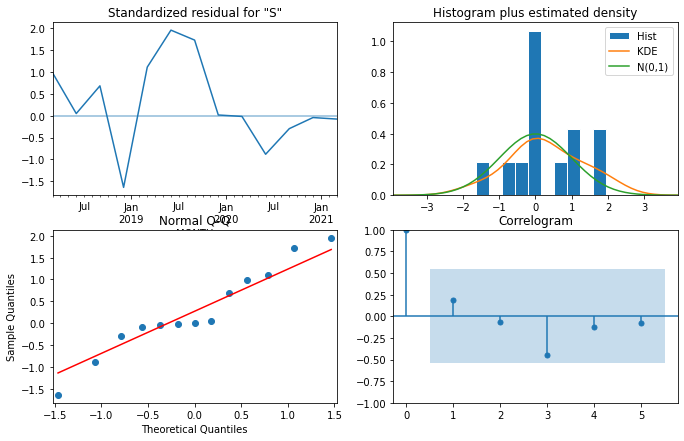

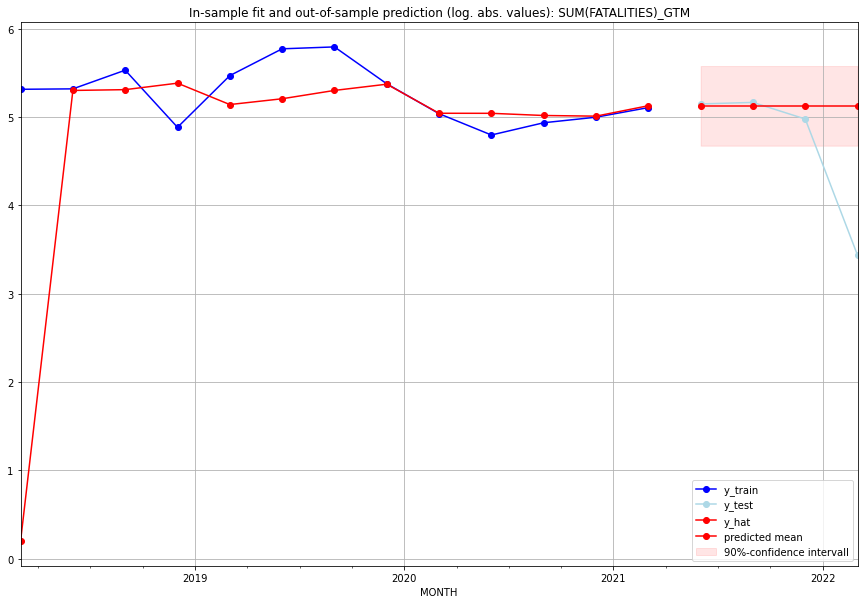

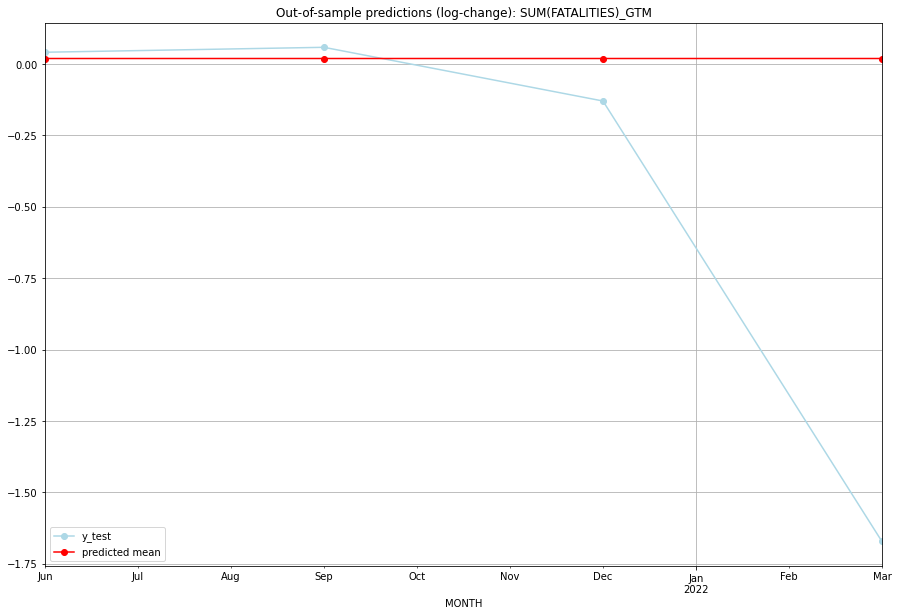

TADDA: 0.4852054160404373
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  167.271970       171.0      0.019636        0.041549   GTM   
1 2021-07-01  167.271783       174.0      0.019635        0.058841   GTM   
2 2021-10-01  167.271597       144.0      0.019634       -0.129212   GTM   
3 2022-01-01  167.271411        30.0      0.019633       -1.671958   GTM   

                                          PARAMETERS  
0  {'params': [1, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:09
######## GUF (90/234) #########
0
Neighbor countries: []
Getting Data for GUF
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No G

<Figure size 432x288 with 0 Axes>

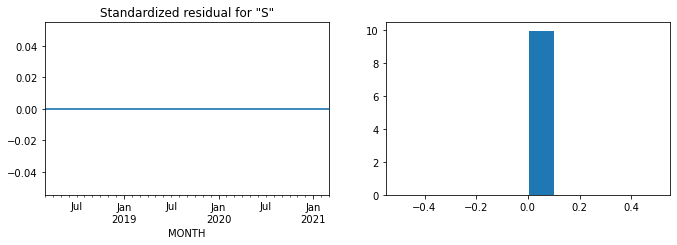

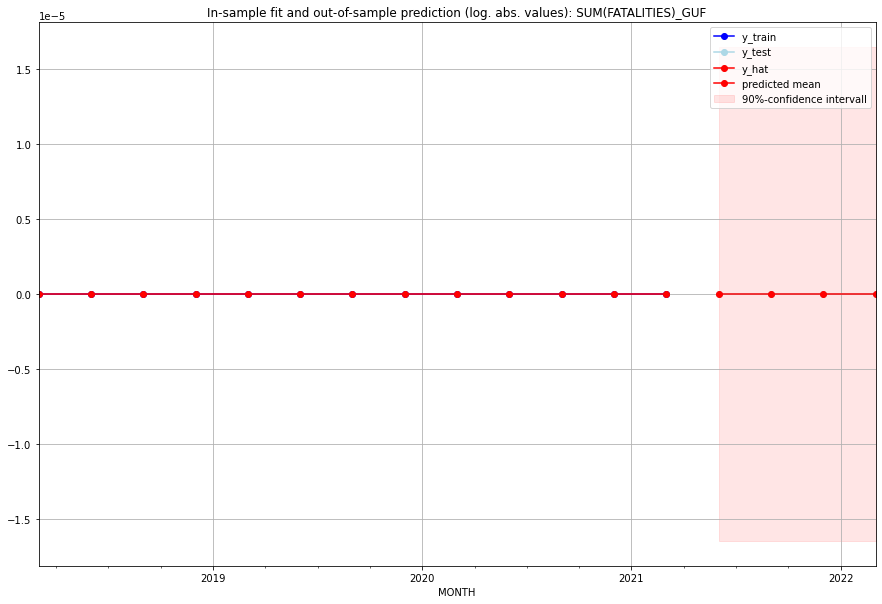

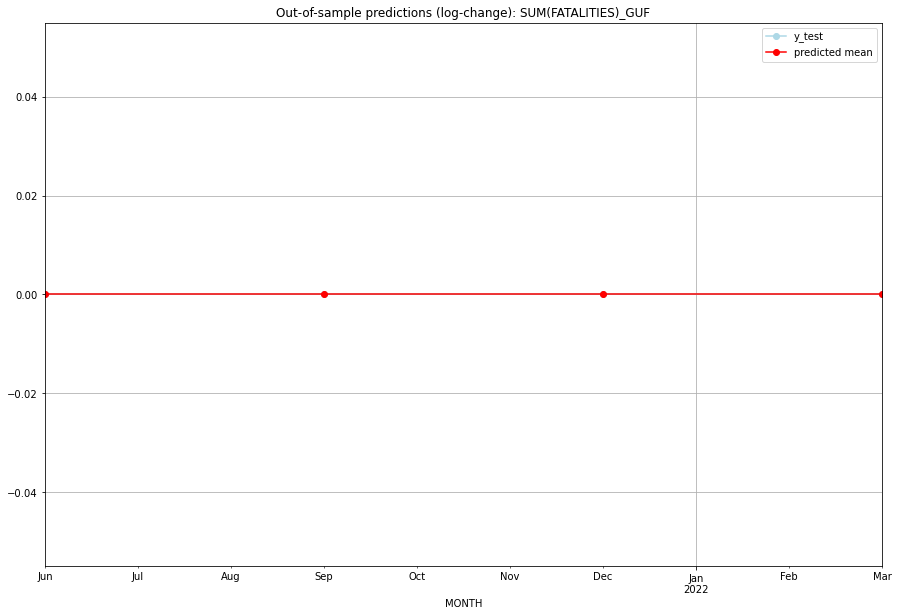

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GUF   
1 2021-07-01       0.0         0.0           0.0             0.0   GUF   
2 2021-10-01       0.0         0.0           0.0             0.0   GUF   
3 2022-01-01       0.0         0.0           0.0             0.0   GUF   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:03
######## GUM (91/234) #########
0
Neighbor countries: []
Getting Data for GUM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 24)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


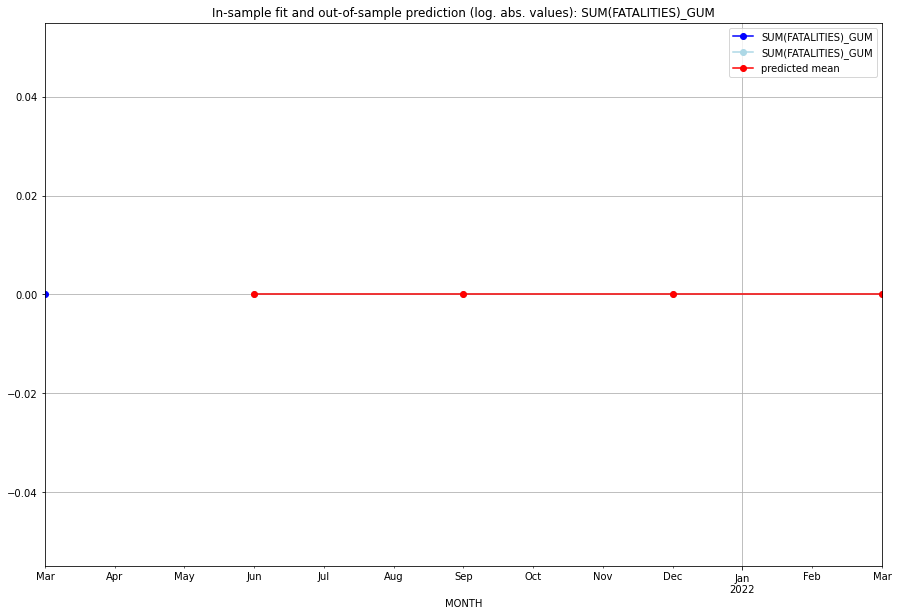

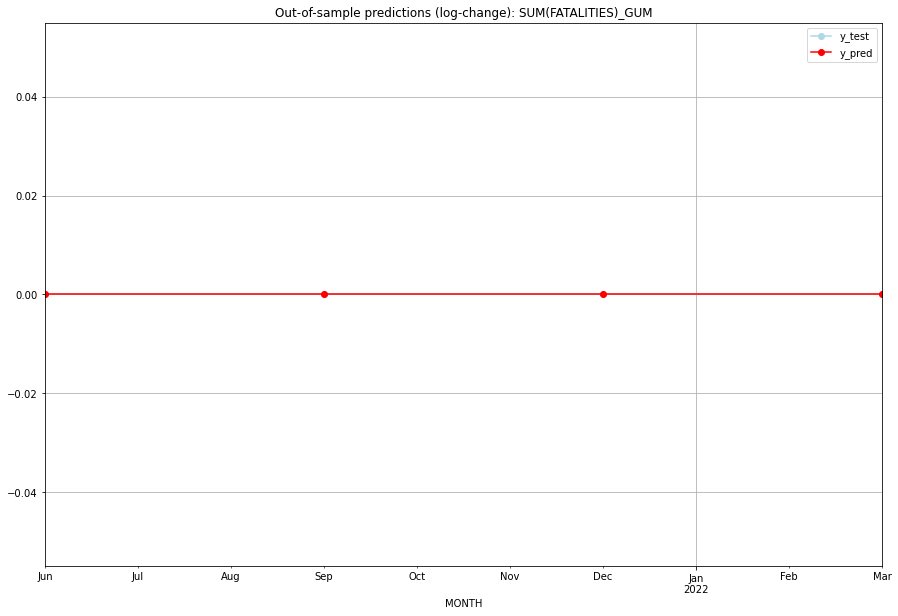

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   GUM   
1 2021-07-01       0.0         0.0           0.0             0.0   GUM   
2 2021-10-01       0.0         0.0           0.0             0.0   GUM   
3 2022-01-01       0.0         0.0           0.0             0.0   GUM   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## GUY (92/234) #########
0
Neighbor countries: []
Getting Data for GUY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 59)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.34657359027997264, 'fold_results': [0.34657359027997264, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GUY   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                 -10.411
Date:                 Wed, 19 Oct 2022   AIC                             26.822
Time:                         10:39:31   BIC                             28.517
Sample:                     01-31-2018   HQIC                            26.474
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.0198      0.757     -0.02

<Figure size 432x288 with 0 Axes>

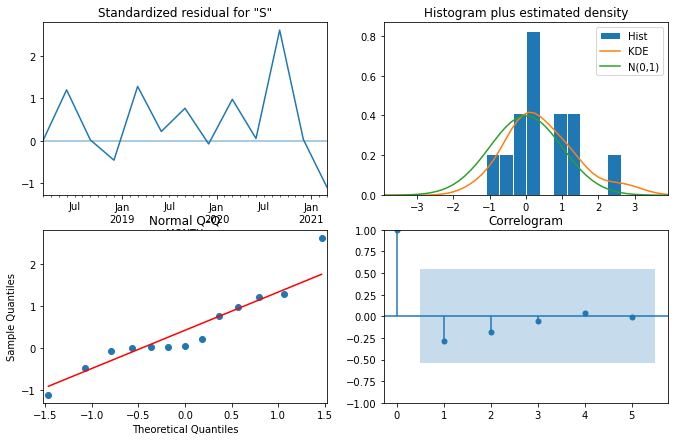

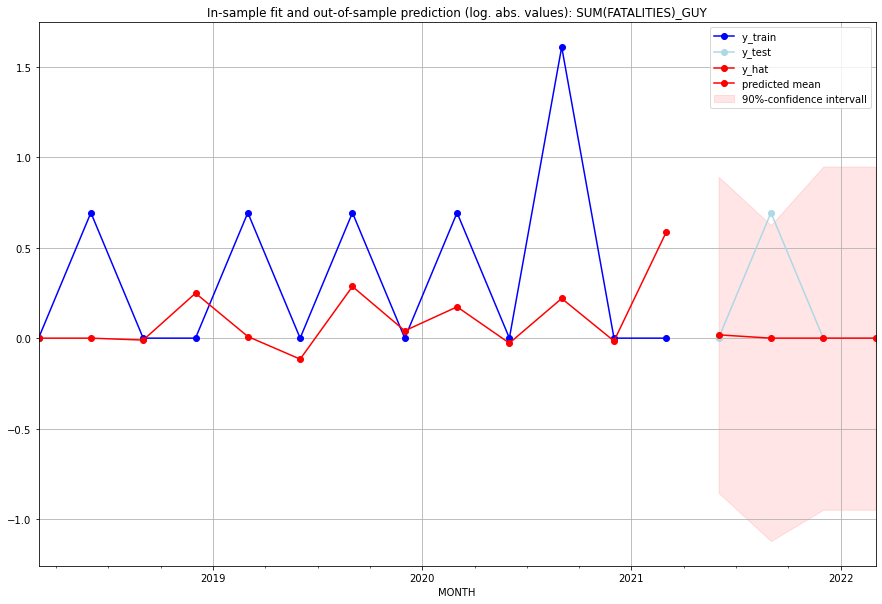

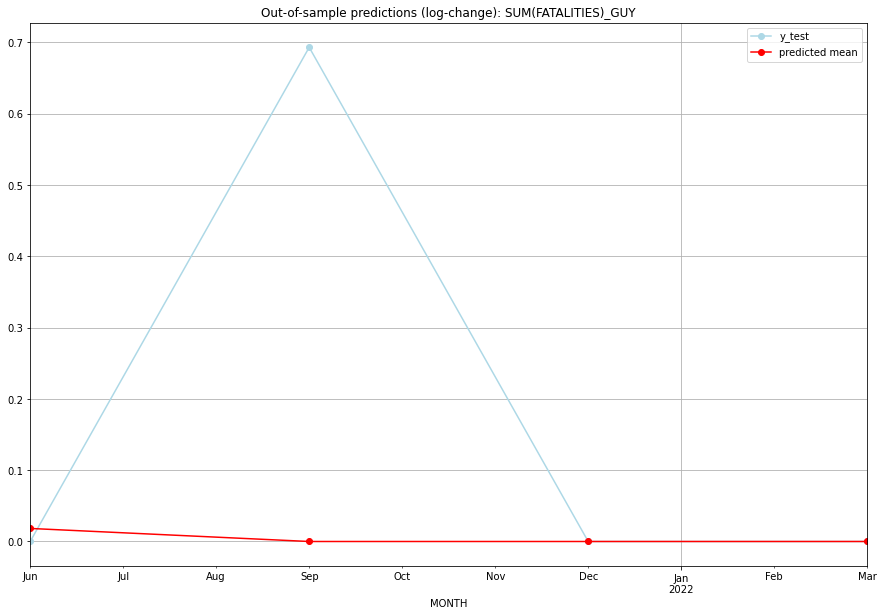

TADDA: 0.177861636522387
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.018468         0.0      0.018299        0.000000   GUY   
1 2021-07-01  0.000000         1.0      0.000000        0.693147   GUY   
2 2021-10-01  0.000000         0.0      0.000000        0.000000   GUY   
3 2022-01-01  0.000000         0.0      0.000000        0.000000   GUY   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## HKG (93/234) #########
0
Neighbor countries: []
Getting Data for HKG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 52)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08664339756999316, 'fold_results': [0.17328679513998632, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HKG   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:39:46   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.24

<Figure size 432x288 with 0 Axes>

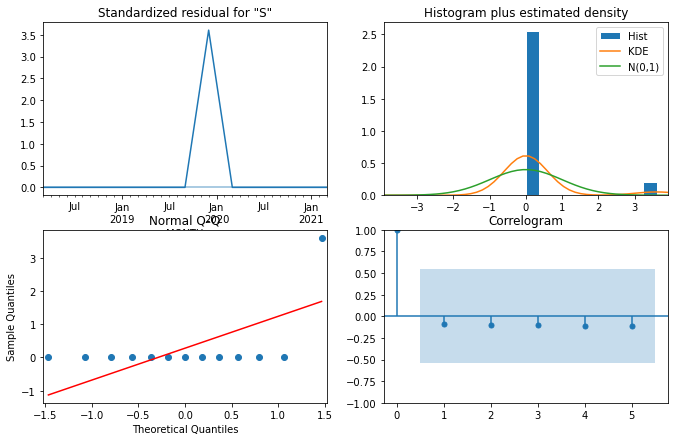

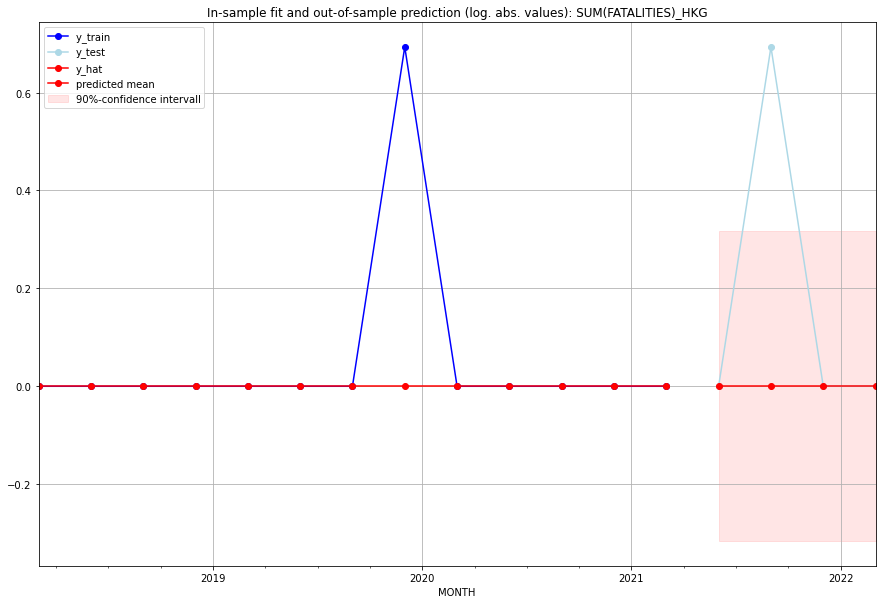

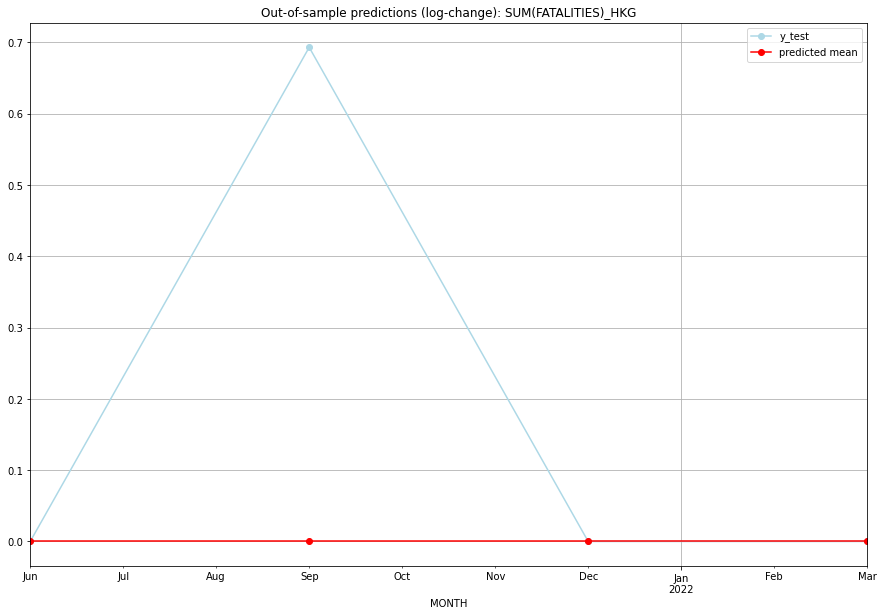

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   HKG   
1 2021-07-01       0.0         1.0           0.0        0.693147   HKG   
2 2021-10-01       0.0         0.0           0.0        0.000000   HKG   
3 2022-01-01       0.0         0.0           0.0        0.000000   HKG   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## HND (94/234) #########
0
Neighbor countries: []
Getting Data for HND
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 62)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.46697180262667304, 'fold_results': [0.5645336232004654, 0.36940998205288067]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HND   No. Observations:                   13
Model:                SARIMAX(1, 0, 3)   Log Likelihood                  -7.944
Date:                 Wed, 19 Oct 2022   AIC                             25.889
Time:                         10:39:58   BIC                             28.713
Sample:                     01-31-2018   HQIC                            25.308
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.0000      

<Figure size 432x288 with 0 Axes>

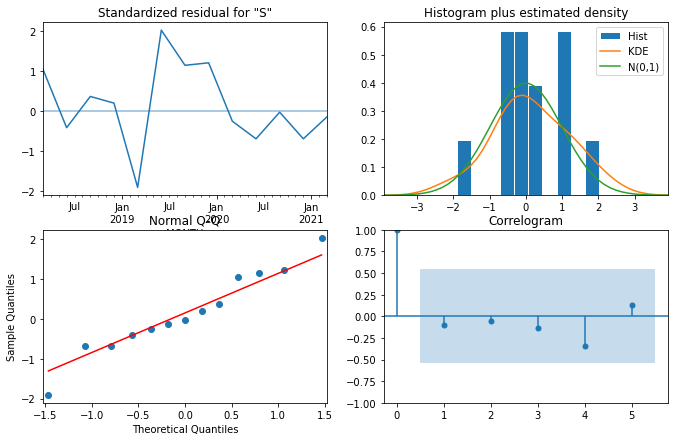

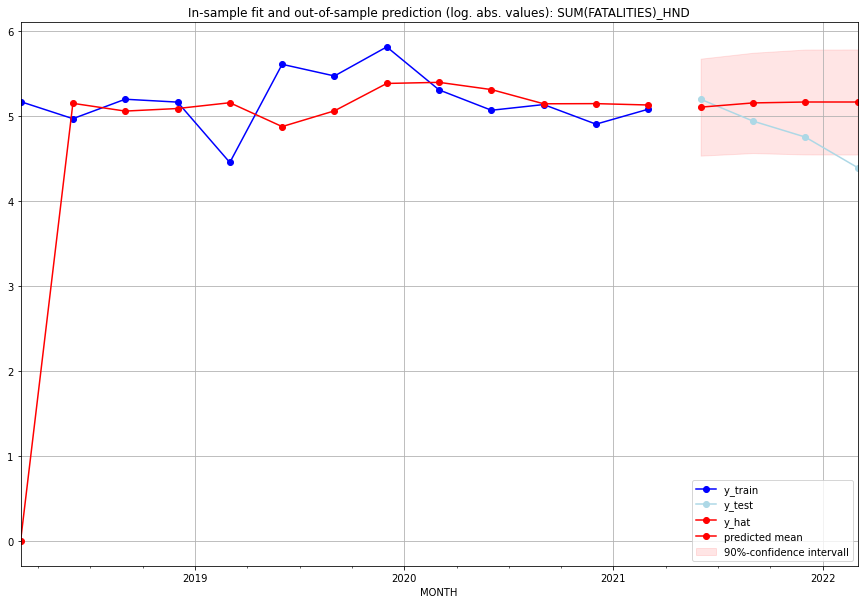

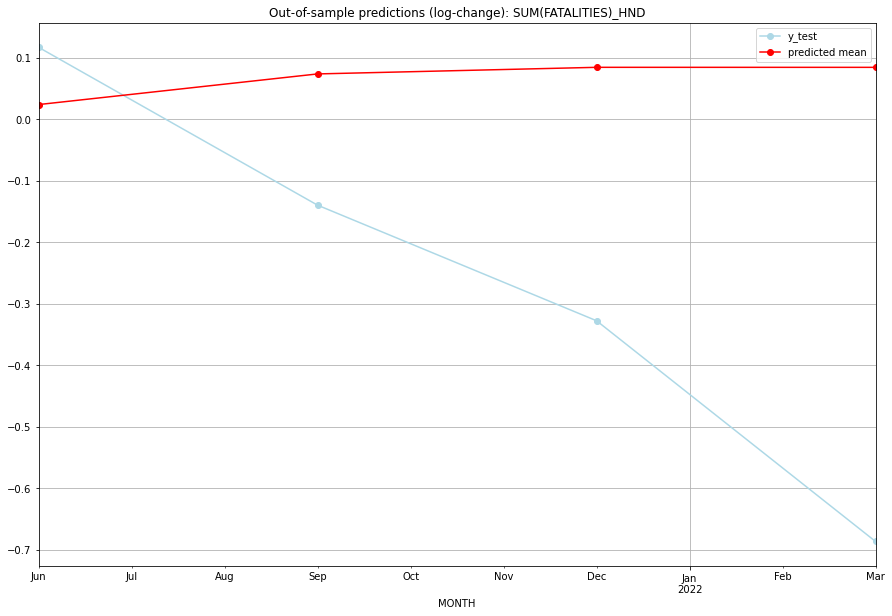

TADDA: 0.43333231276515005
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  163.900127       180.0      0.023936        0.117093   HND   
1 2021-07-01  172.329183       139.0      0.073788       -0.139762   HND   
2 2021-10-01  174.202137       115.0      0.084536       -0.327814   HND   
3 2022-01-01  174.195166        80.0      0.084496       -0.686955   HND   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## HRV (95/234) #########
0
Neighbor countries: []
Getting Data for HRV
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 64)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.17328679513998632, 'fold_results': [0.34657359027997264, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HRV   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                  -4.150
Date:                 Wed, 19 Oct 2022   AIC                             10.301
Time:                         10:40:09   BIC                             10.866
Sample:                     01-31-2018   HQIC                            10.185
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1109      0.034      3.29

<Figure size 432x288 with 0 Axes>

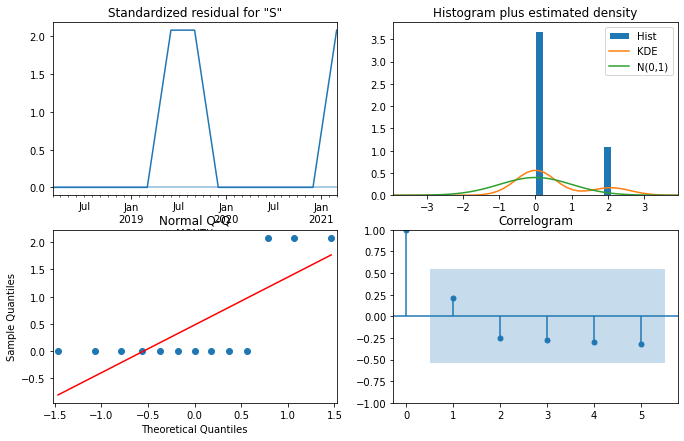

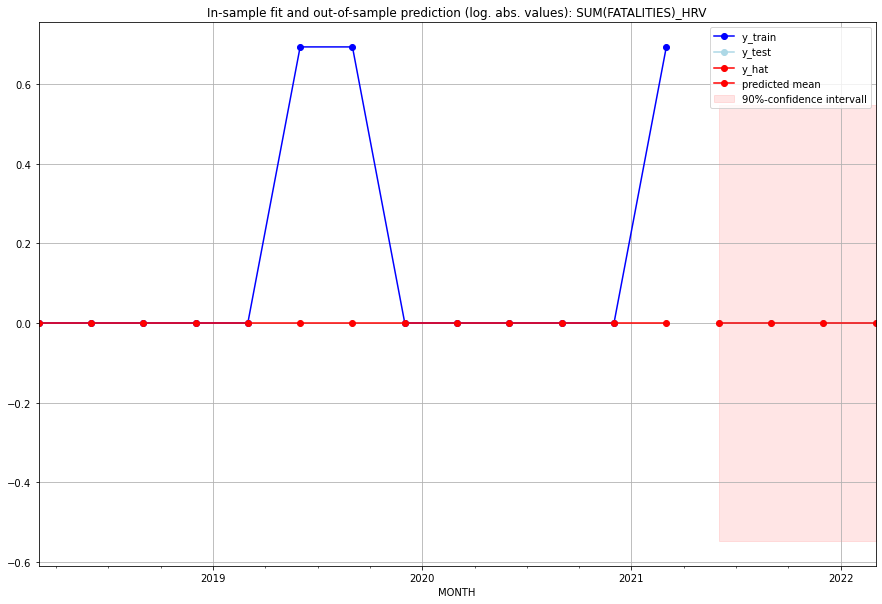

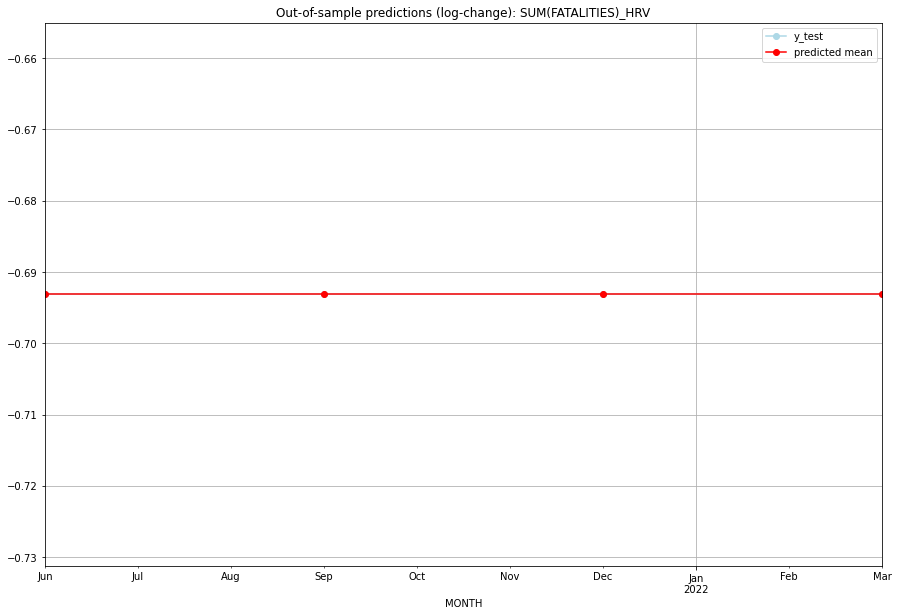

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0     -0.693147       -0.693147   HRV   
1 2021-07-01       0.0         0.0     -0.693147       -0.693147   HRV   
2 2021-10-01       0.0         0.0     -0.693147       -0.693147   HRV   
3 2022-01-01       0.0         0.0     -0.693147       -0.693147   HRV   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## HTI (96/234) #########
0
Neighbor countries: []
Getting Data for HTI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 57)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 paramete

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.35628508884422216, 'fold_results': [0.5504281967170588, 0.16214198097138555]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HTI   No. Observations:                   13
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -13.203
Date:                 Wed, 19 Oct 2022   AIC                             28.406
Time:                         10:40:17   BIC                             28.891
Sample:                     01-31-2018   HQIC                            28.226
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.5287      

<Figure size 432x288 with 0 Axes>

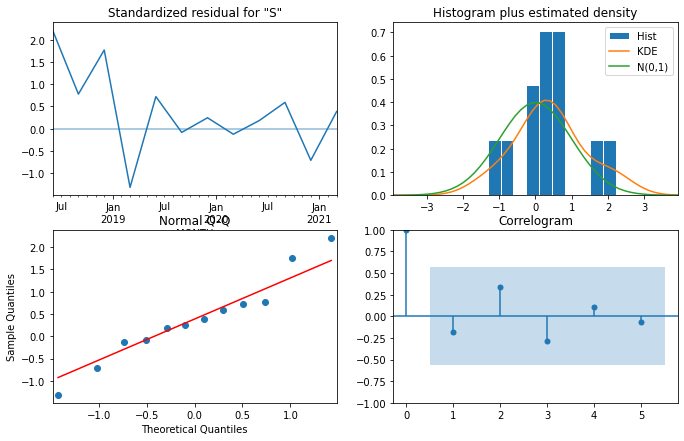

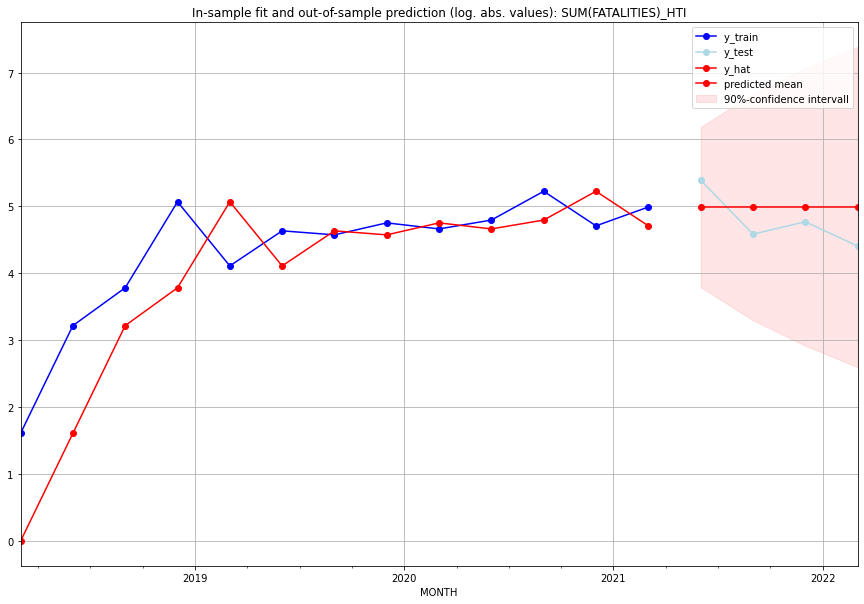

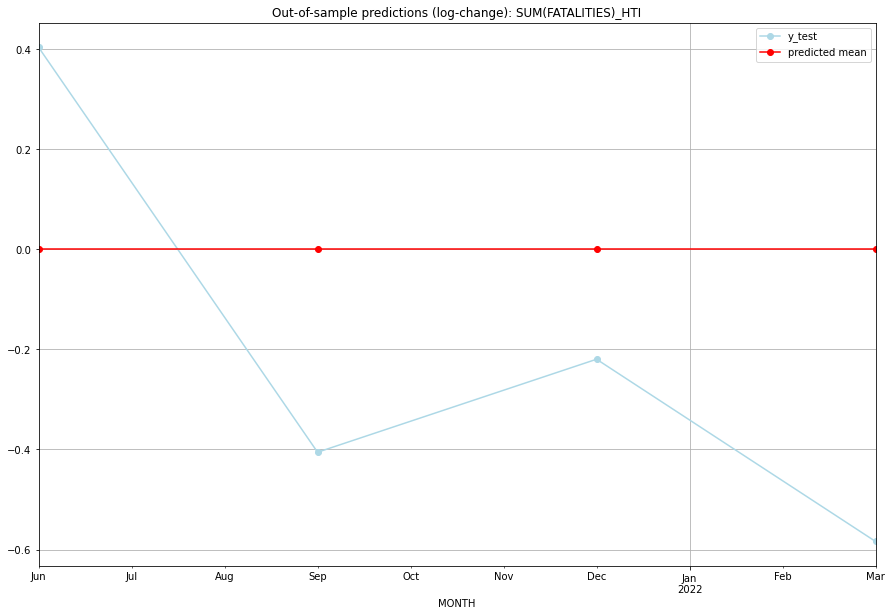

TADDA: 0.4030303423773358
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01     146.0       219.0           0.0        0.403195   HTI   
1 2021-07-01     146.0        97.0           0.0       -0.405465   HTI   
2 2021-10-01     146.0       117.0           0.0       -0.219748   HTI   
3 2022-01-01     146.0        81.0           0.0       -0.583713   HTI   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:11
######## HUN (97/234) #########
0
Neighbor countries: []
Getting Data for HUN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 64)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient da

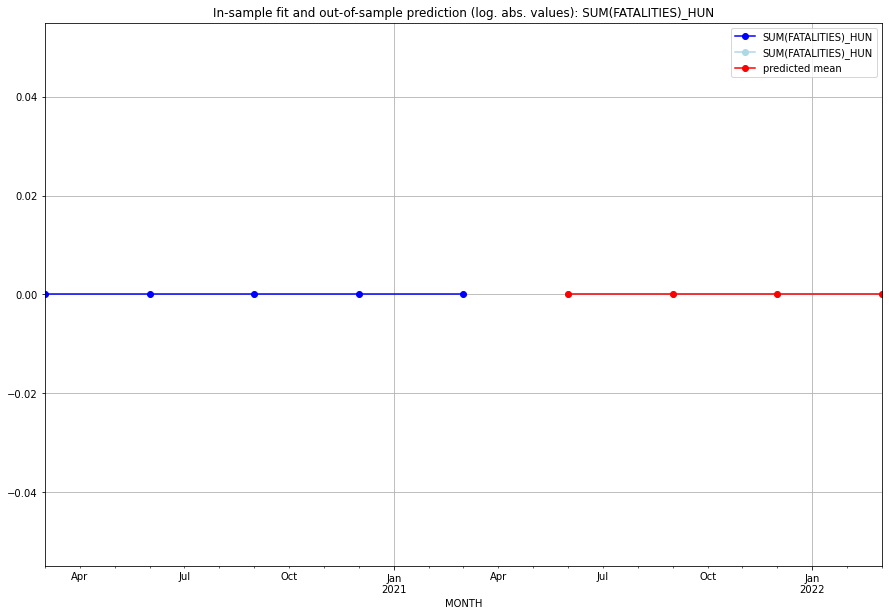

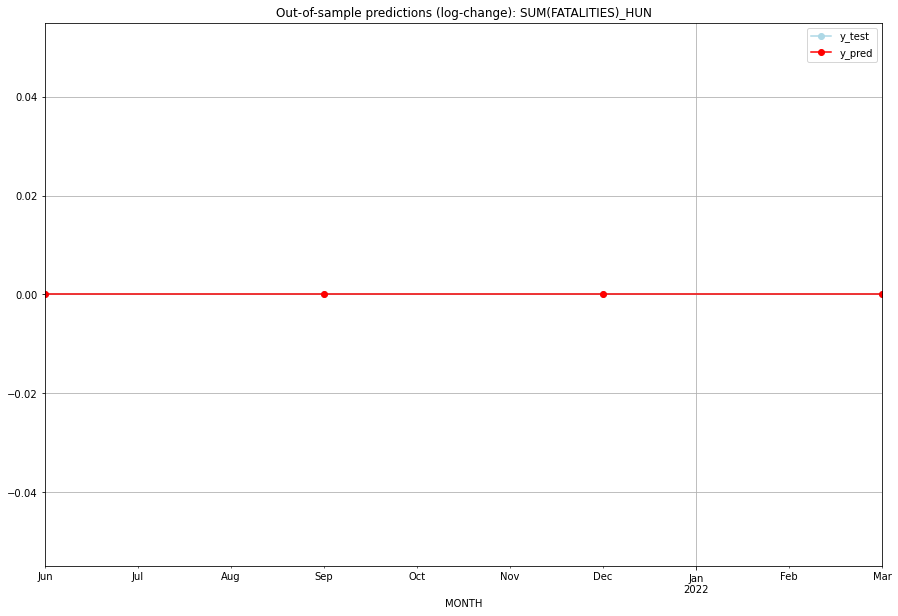

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   HUN   
1 2021-07-01       0.0         0.0           0.0             0.0   HUN   
2 2021-10-01       0.0         0.0           0.0             0.0   HUN   
3 2022-01-01       0.0         0.0           0.0             0.0   HUN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## IDN (98/234) #########
0
Neighbor countries: []
Getting Data for IDN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (29, 64)
y: (29, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.6244211797053545, 'fold_results': [0.6853965251538154, 0.8104361299272778, nan, 0.5321223863757077, 0.4697296773646167]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IDN   No. Observations:                   25
Model:                SARIMAX(3, 0, 3)   Log Likelihood                 -26.726
Date:                 Wed, 19 Oct 2022   AIC                             67.453
Time:                         10:40:44   BIC                             75.985
Sample:                     01-31-2015   HQIC                            69.819
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

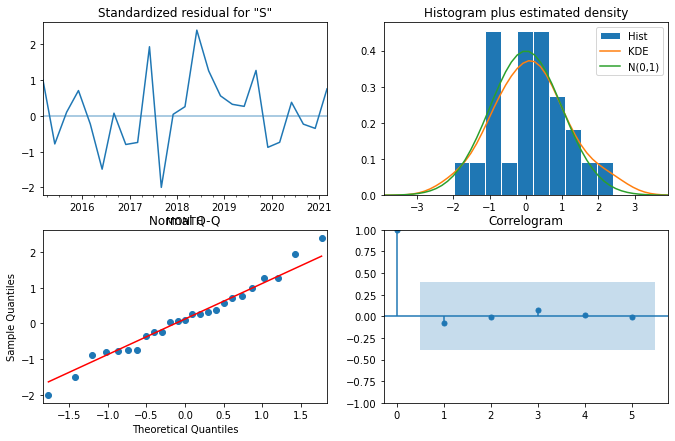

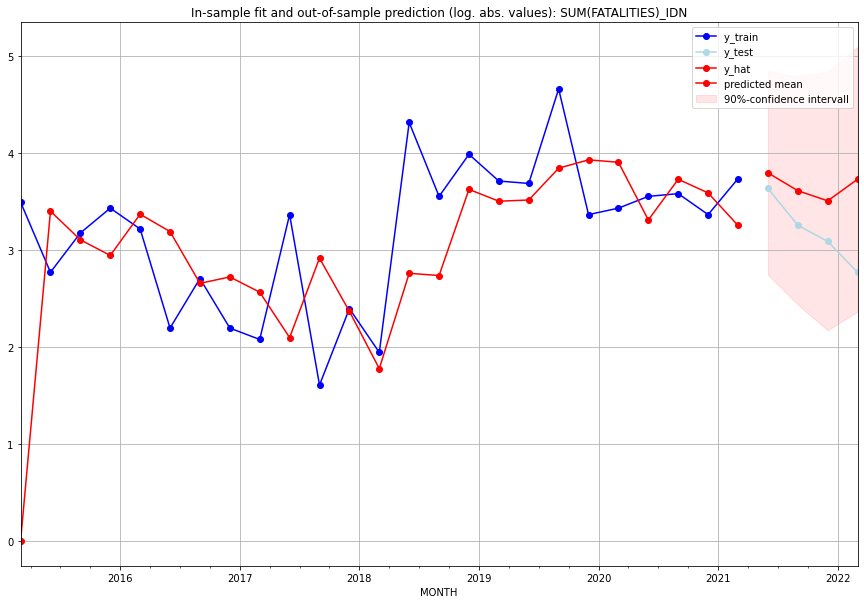

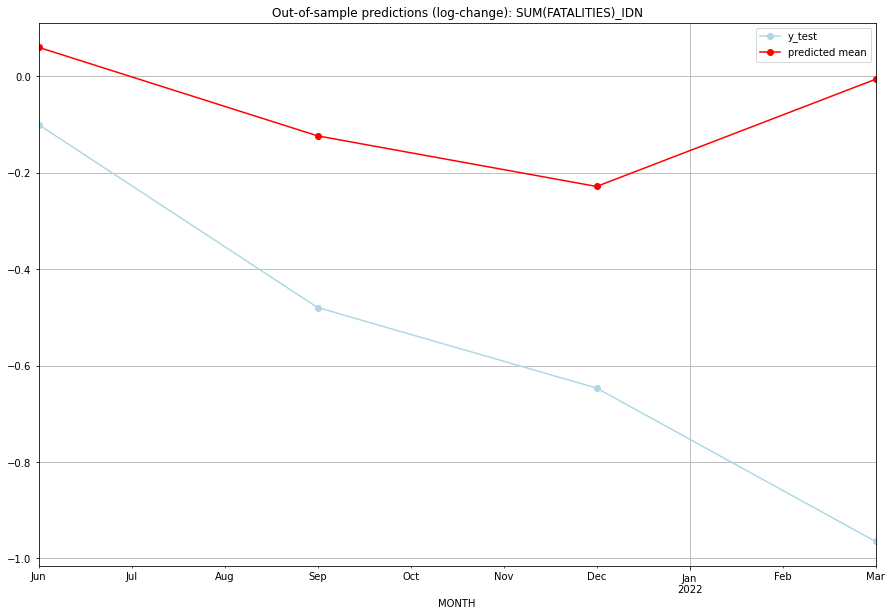

TADDA: 0.4886575997231497
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  43.615829        37.0      0.060419       -0.100083   IDN   
1 2021-07-01  36.126653        25.0     -0.123334       -0.479573   IDN   
2 2021-10-01  32.425751        21.0     -0.228343       -0.646627   IDN   
3 2022-01-01  40.753145        15.0     -0.005895       -0.965081   IDN   

                                          PARAMETERS  
0  {'params': [0, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## IMN (99/234) #########
0
Neighbor countries: []
Getting Data for IMN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV

<Figure size 432x288 with 0 Axes>

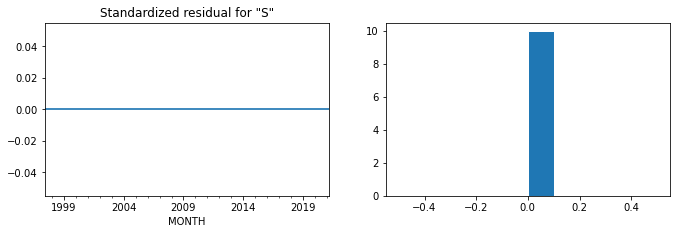

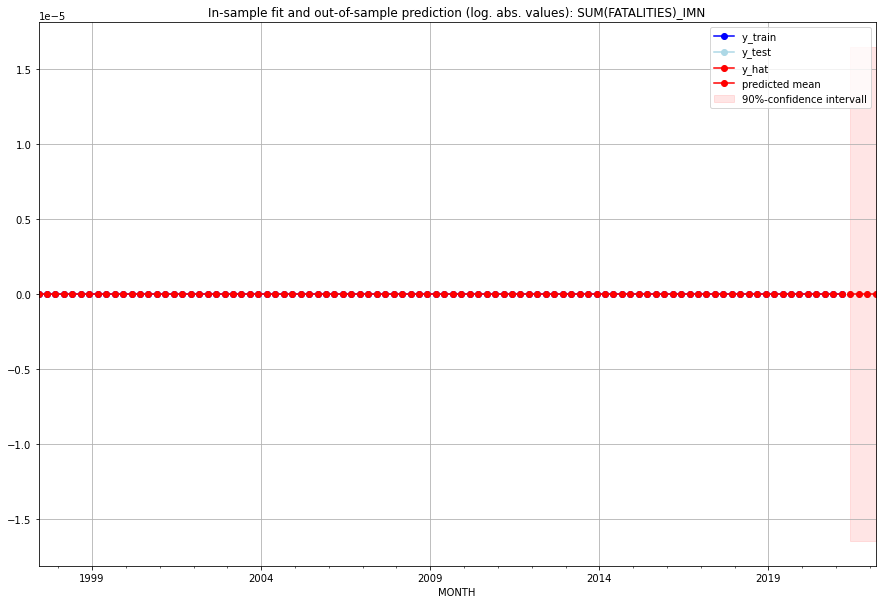

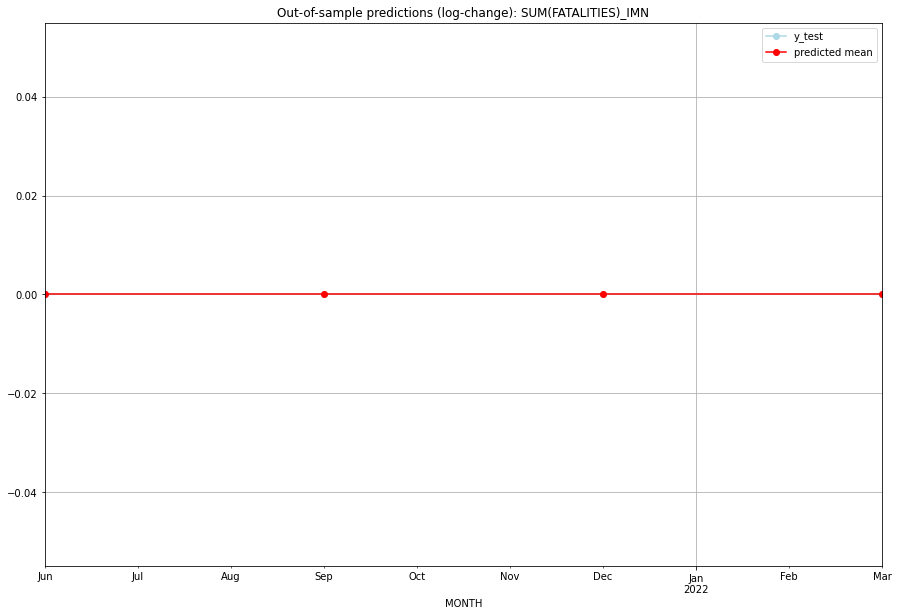

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   IMN   
1 2021-07-01       0.0         0.0           0.0             0.0   IMN   
2 2021-10-01       0.0         0.0           0.0             0.0   IMN   
3 2022-01-01       0.0         0.0           0.0             0.0   IMN   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## IND (100/234) #########
0
Neighbor countries: []
Getting Data for IND
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 62)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.2081866454401755, 'fold_results': [0.21679691305270654, nan, 0.28629253630801355, 0.12147048695980645]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IND   No. Observations:                   21
Model:                SARIMAX(2, 0, 2)   Log Likelihood                  -4.252
Date:                 Wed, 19 Oct 2022   AIC                             20.504
Time:                         10:41:04   BIC                             26.771
Sample:                     01-31-2016   HQIC                            21.864
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x

<Figure size 432x288 with 0 Axes>

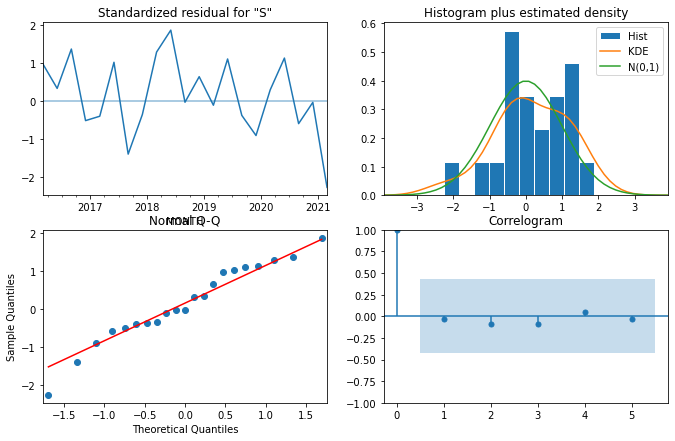

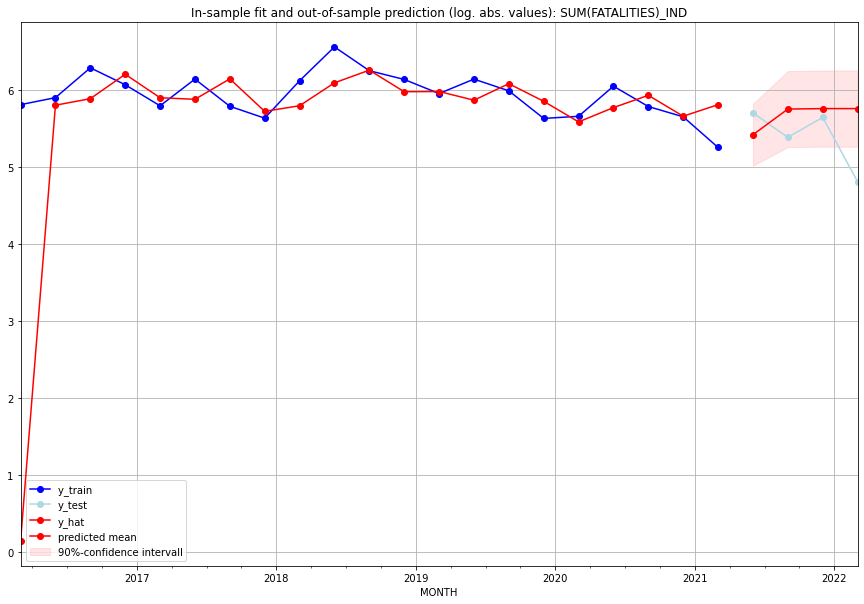

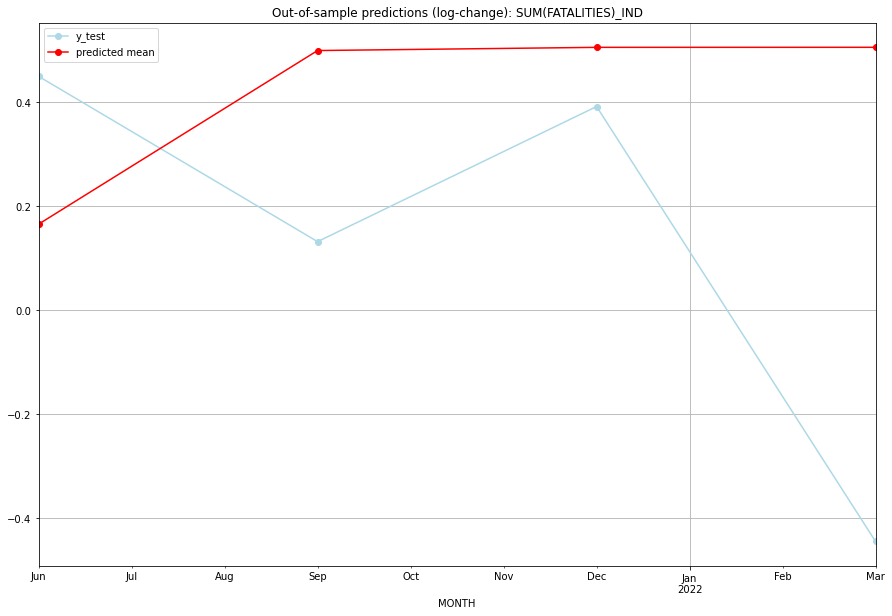

TADDA: 0.5555245866607044
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  225.482295       300.0      0.165171        0.449615   IND   
1 2021-07-01  315.304319       218.0      0.499209        0.131576   IND   
2 2021-10-01  317.250565       283.0      0.505344        0.391479   IND   
3 2022-01-01  317.275823       122.0      0.505423       -0.445311   IND   

                                          PARAMETERS  
0  {'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## IRL (101/234) #########
0
Neighbor countries: []
Getting Data for IRL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 65)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insu

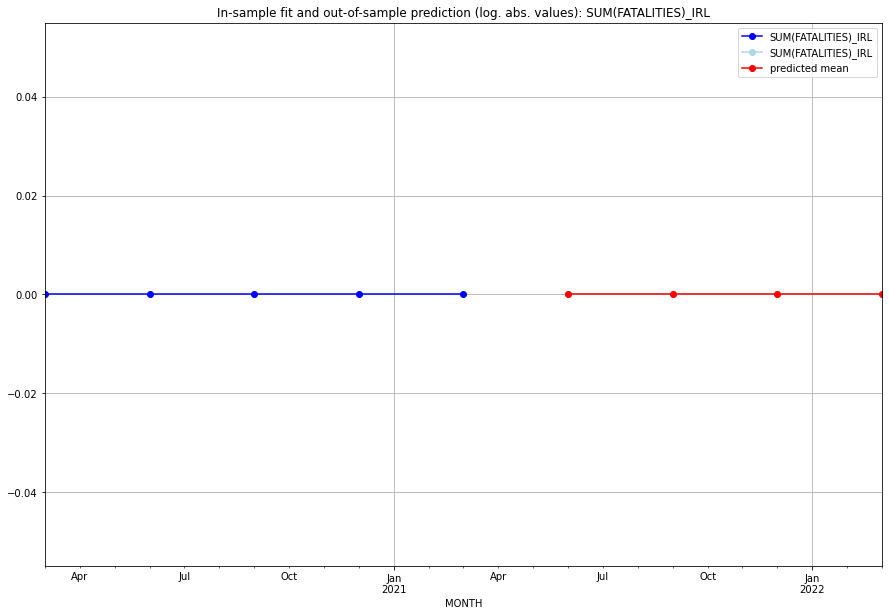

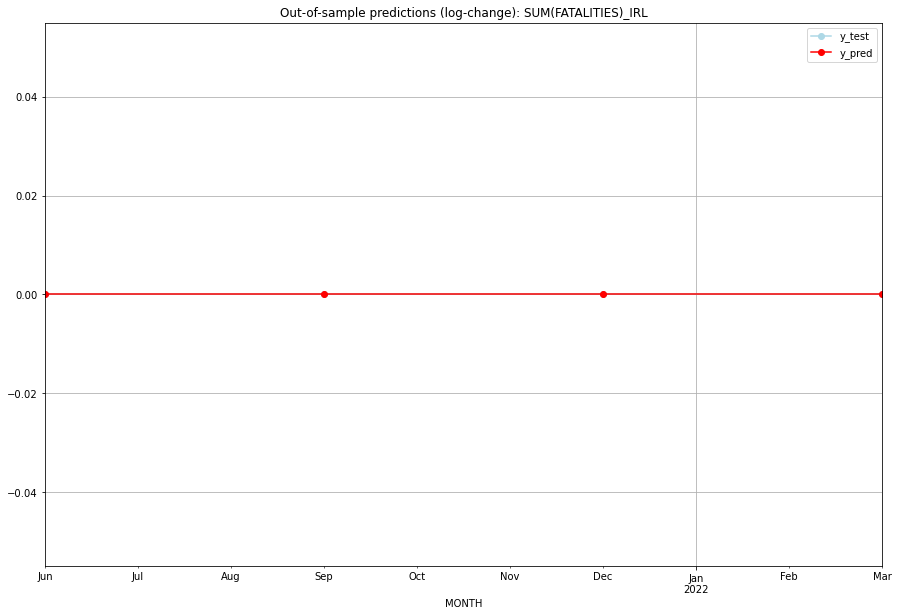

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   IRL   
1 2021-07-01       0.0         0.0           0.0             0.0   IRL   
2 2021-10-01       0.0         0.0           0.0             0.0   IRL   
3 2022-01-01       0.0         0.0           0.0             0.0   IRL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## IRN (102/234) #########
0
Neighbor countries: []
Getting Data for IRN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 61)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.8917668002849736, 'fold_results': [0.929329533503037, 0.8405654950357838, nan, 0.9054053723161]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IRN   No. Observations:                   21
Model:                SARIMAX(0, 1, 3)   Log Likelihood                 -30.514
Date:                 Wed, 19 Oct 2022   AIC                             69.028
Time:                         10:41:26   BIC                             73.011
Sample:                     01-31-2016   HQIC                            69.805
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1   

<Figure size 432x288 with 0 Axes>

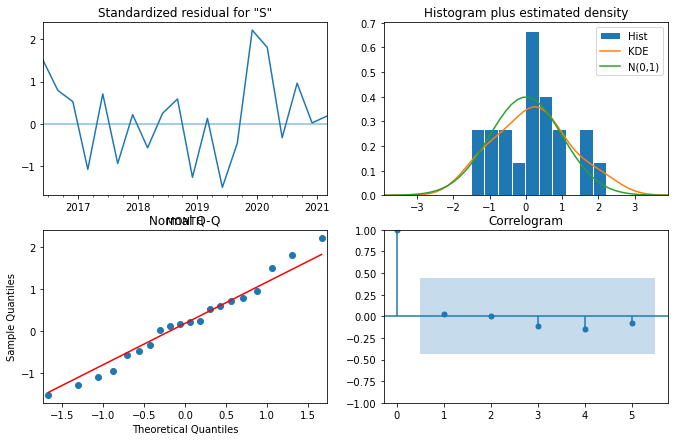

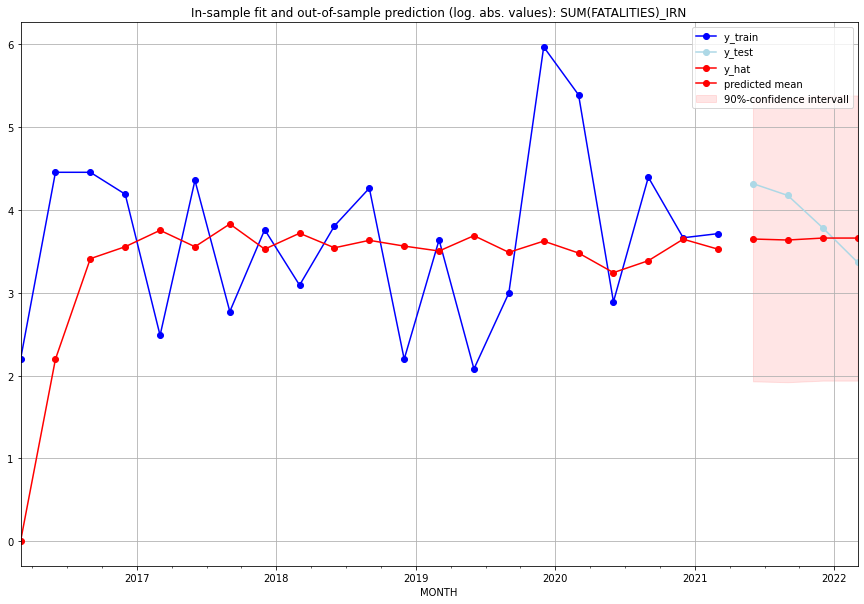

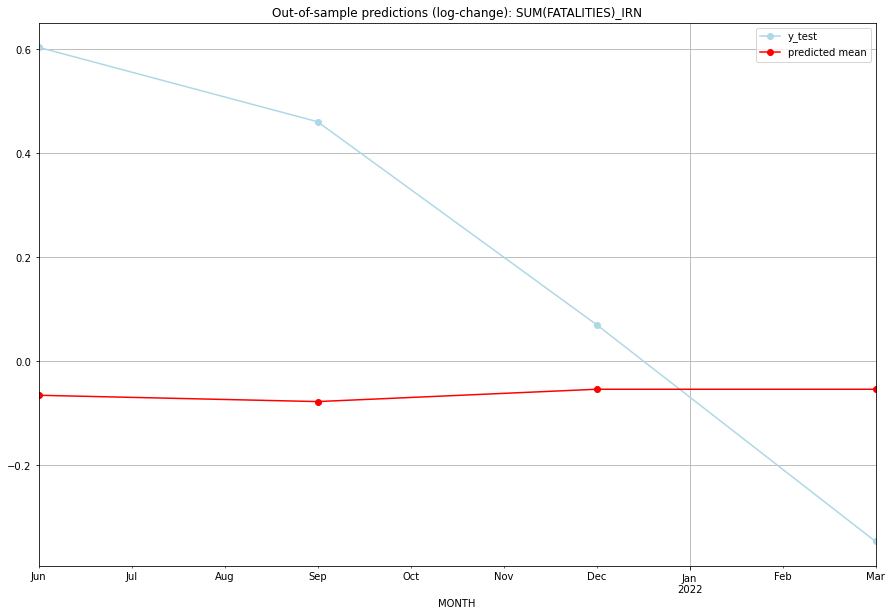

TADDA: 0.45498792669386434
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  37.415576        74.0     -0.065109        0.603916   IRN   
1 2021-07-01  36.951383        64.0     -0.077266        0.460815   IRN   
2 2021-10-01  37.861179        43.0     -0.053576        0.070618   IRN   
3 2022-01-01  37.861179        28.0     -0.053576       -0.346276   IRN   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:11
######## IRQ (103/234) #########
0
Neighbor countries: []
Getting Data for IRQ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 57)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 C

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.4322427619463346, 'fold_results': [0.7853539266316902, 0.19962089781005887, 0.24080219456357077, 0.5031940287800185]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IRQ   No. Observations:                   21
Model:                SARIMAX(2, 0, 1)   Log Likelihood                 -12.763
Date:                 Wed, 19 Oct 2022   AIC                             33.526
Time:                         10:41:43   BIC                             37.704
Sample:                     01-31-2016   HQIC                            34.433
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

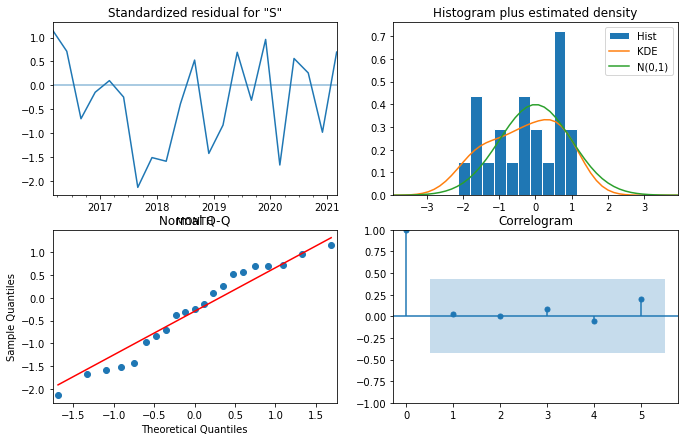

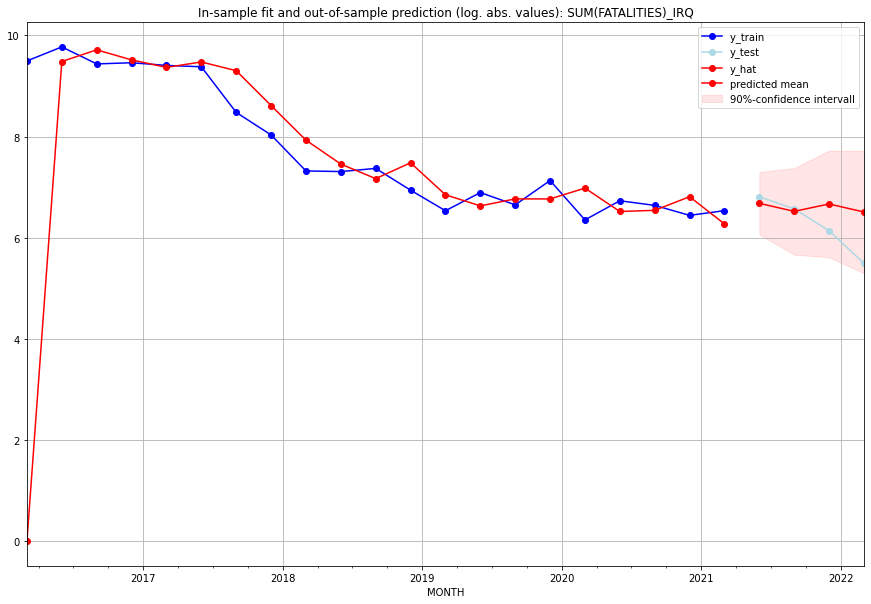

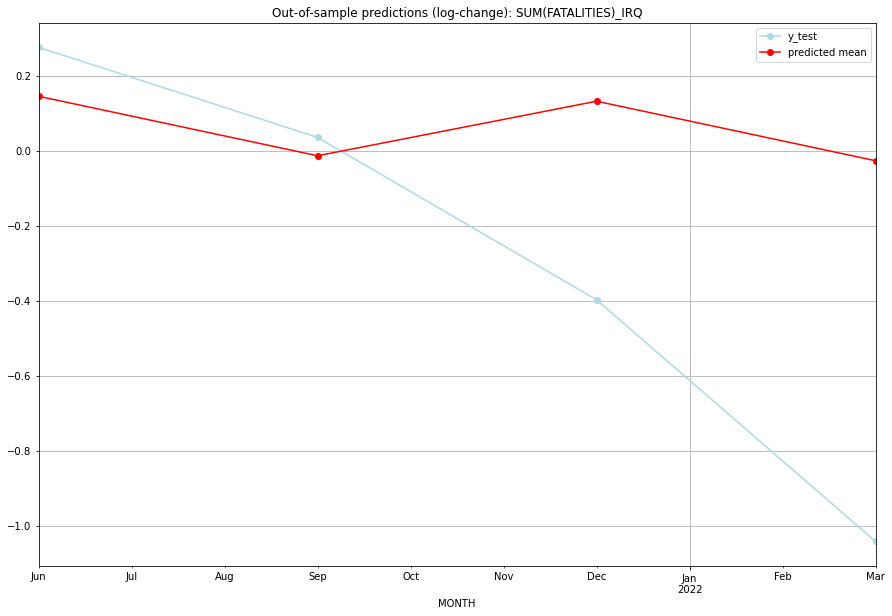

TADDA: 0.46757091997000555
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  795.866465       907.0      0.145446        0.276003   IRQ   
1 2021-07-01  678.918892       713.0     -0.013268        0.035642   IRQ   
2 2021-10-01  785.366753       462.0      0.132182       -0.397514   IRQ   
3 2022-01-01  669.975353       242.0     -0.026509       -1.042180   IRQ   

                                          PARAMETERS  
0  {'params': [0, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## ISL (104/234) #########
0
Neighbor countries: []
Getting Data for ISL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 62)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Ins

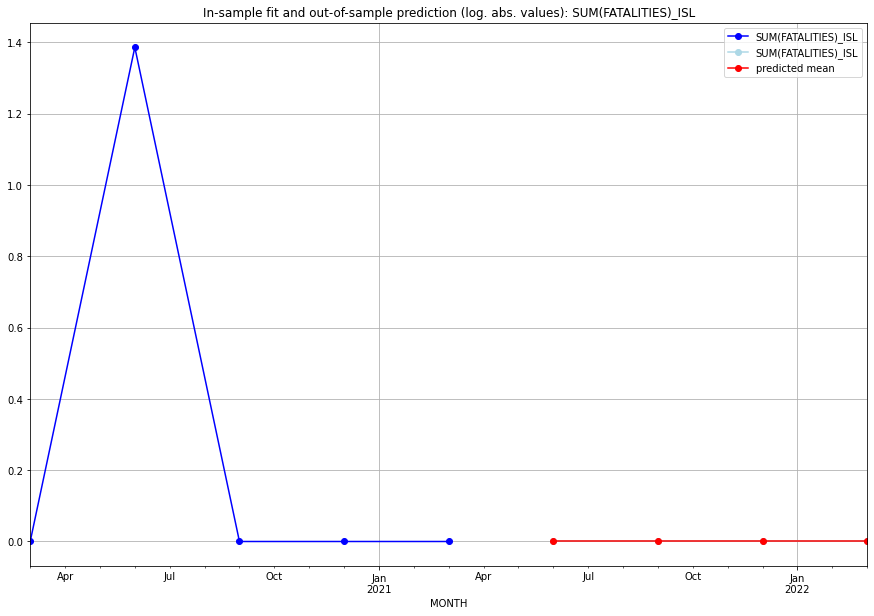

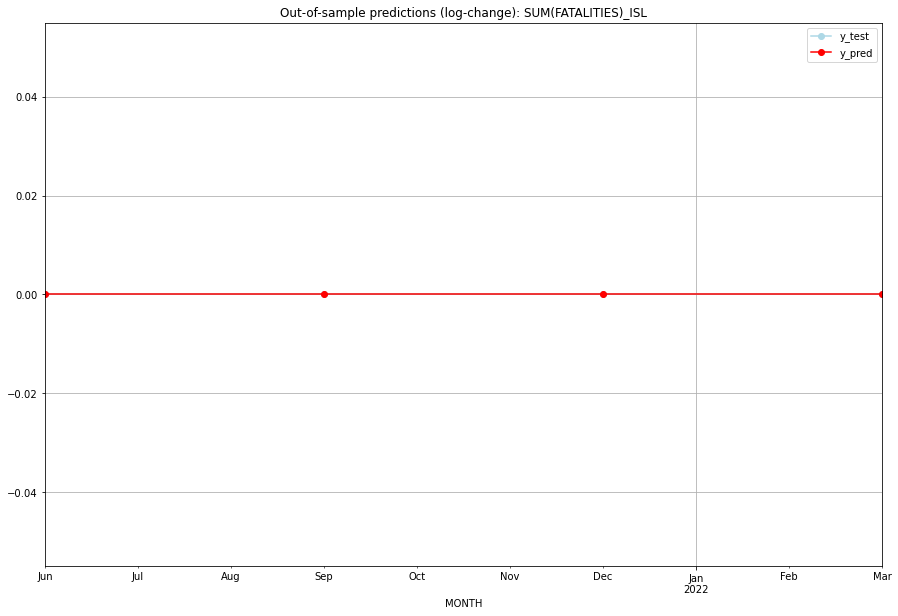

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   ISL   
1 2021-07-01       0.0         0.0           0.0             0.0   ISL   
2 2021-10-01       0.0         0.0           0.0             0.0   ISL   
3 2022-01-01       0.0         0.0           0.0             0.0   ISL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## ISR (105/234) #########
0
Neighbor countries: []
Getting Data for ISR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 64)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 1.2846924289450088, 'fold_results': [2.3200984545641234, 0.8787267477748777, 0.974646073083145, 0.9652984403578891]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ISR   No. Observations:                   21
Model:                SARIMAX(2, 1, 1)   Log Likelihood                 -29.084
Date:                 Wed, 19 Oct 2022   AIC                             70.168
Time:                         10:42:00   BIC                             76.142
Sample:                     01-31-2016   HQIC                            71.334
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

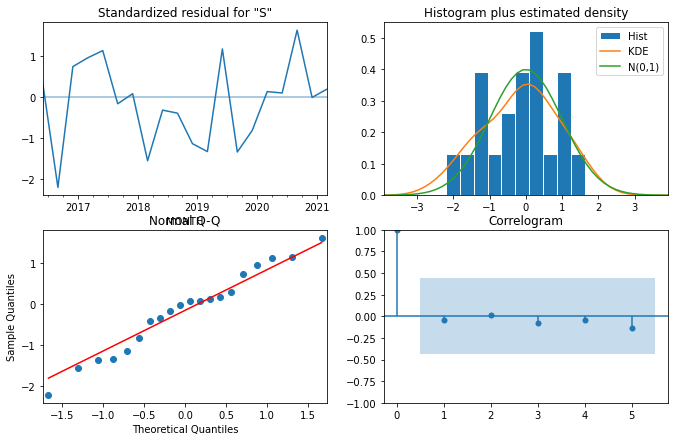

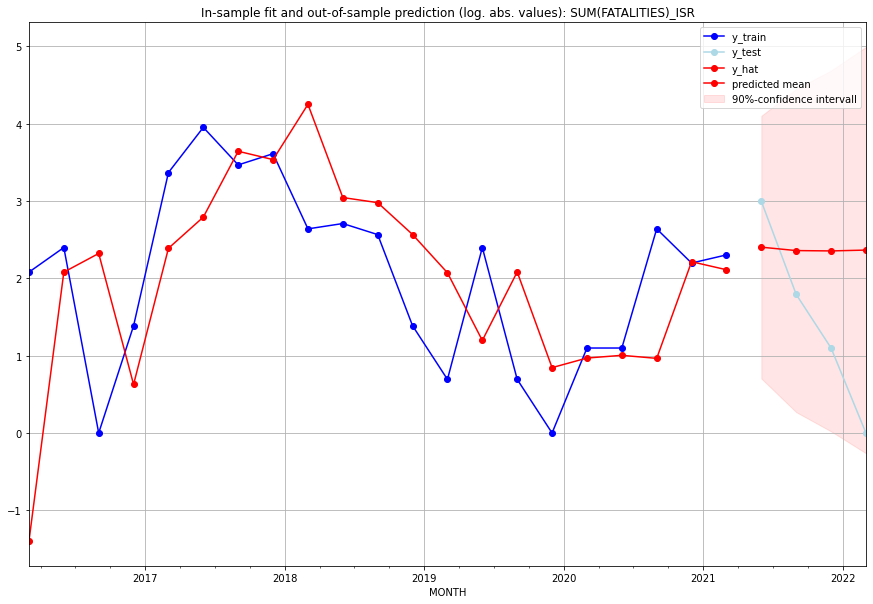

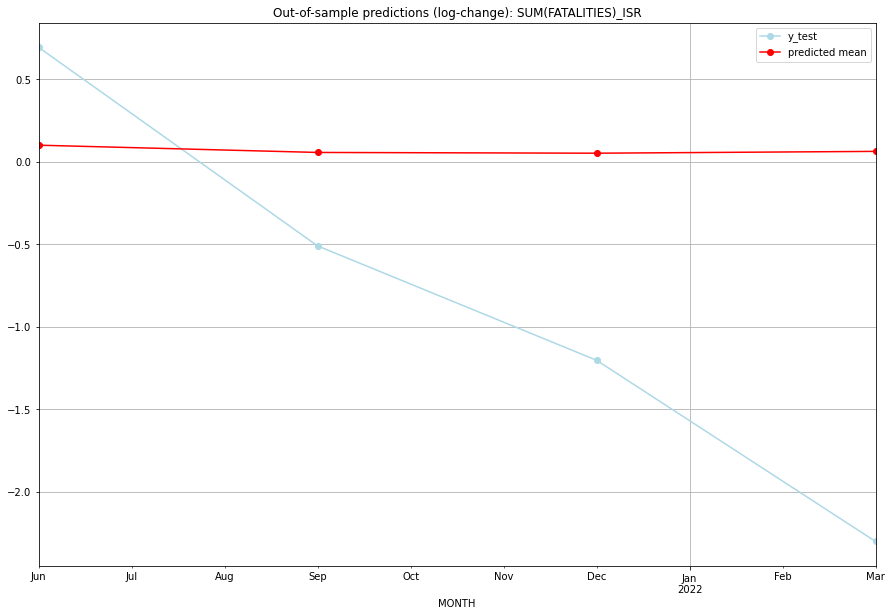

TADDA: 1.2373372888940402
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  10.049561        19.0      0.099806        0.693147   ISR   
1 2021-07-01   9.573946         5.0      0.055808       -0.510826   ISR   
2 2021-10-01   9.525711         2.0      0.051236       -1.203973   ISR   
3 2022-01-01   9.642478         0.0      0.062268       -2.302585   ISR   

                                          PARAMETERS  
0  {'params': [2, (2, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (2, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (2, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (2, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## ITA (106/234) #########
0
Neighbor countries: []
Getting Data for ITA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 65)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insuffici

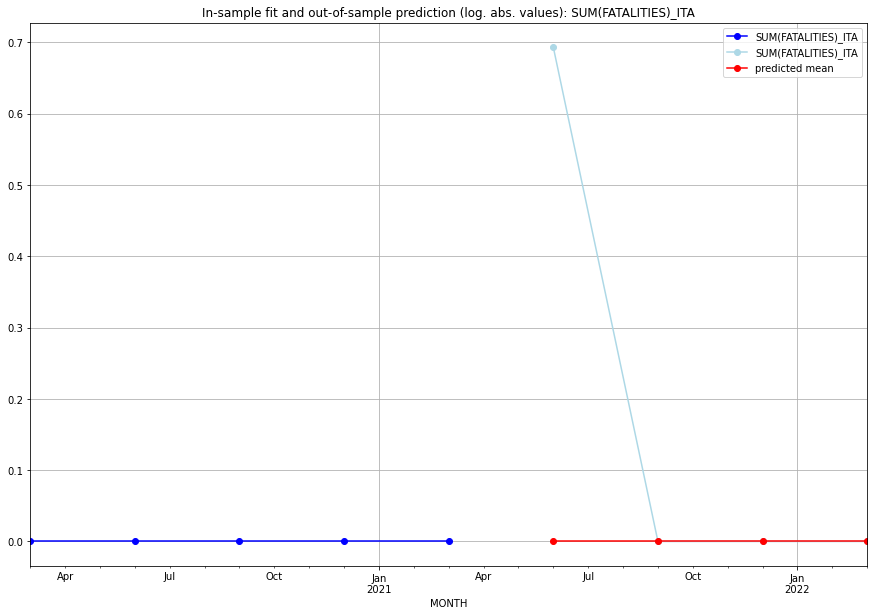

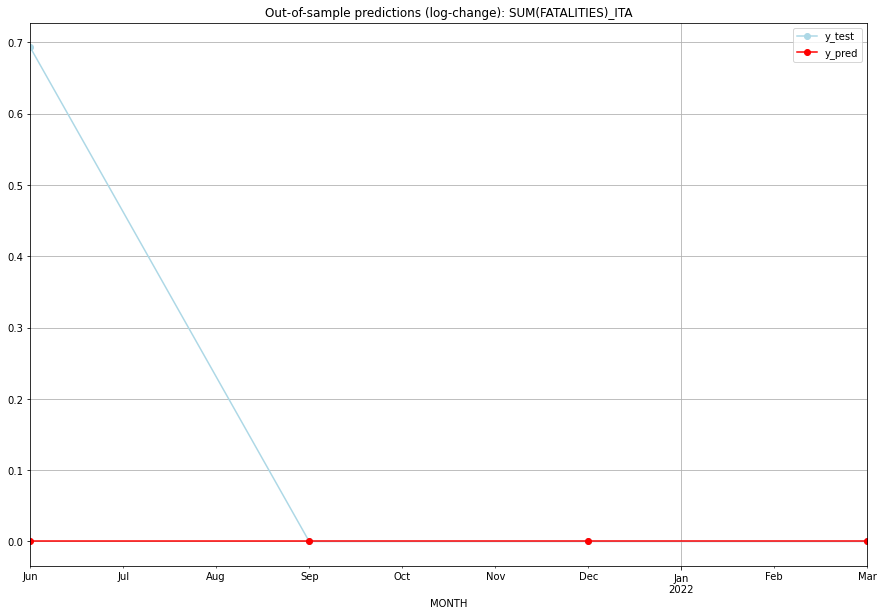

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.693147           0.0        0.693147   ITA   
1 2021-07-01       0.0    0.000000           0.0        0.000000   ITA   
2 2021-10-01       0.0    0.000000           0.0        0.000000   ITA   
3 2022-01-01       0.0    0.000000           0.0        0.000000   ITA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## JAM (107/234) #########
0
Neighbor countries: []
Getting Data for JAM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 60)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.11134739671002081, 'fold_results': [0.16647715824286413, 0.05621763517717748]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_JAM   No. Observations:                   13
Model:                SARIMAX(3, 0, 1)   Log Likelihood                  -1.340
Date:                 Wed, 19 Oct 2022   AIC                             14.679
Time:                         10:42:16   BIC                             18.069
Sample:                     01-31-2018   HQIC                            13.982
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0249     

<Figure size 432x288 with 0 Axes>

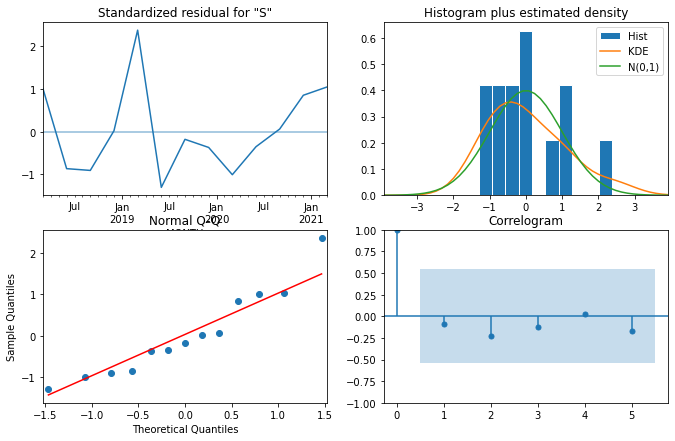

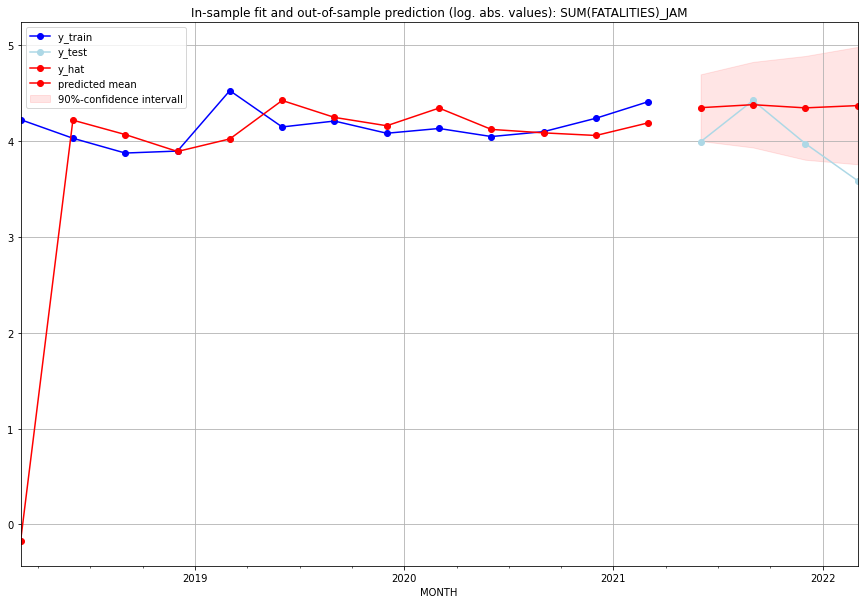

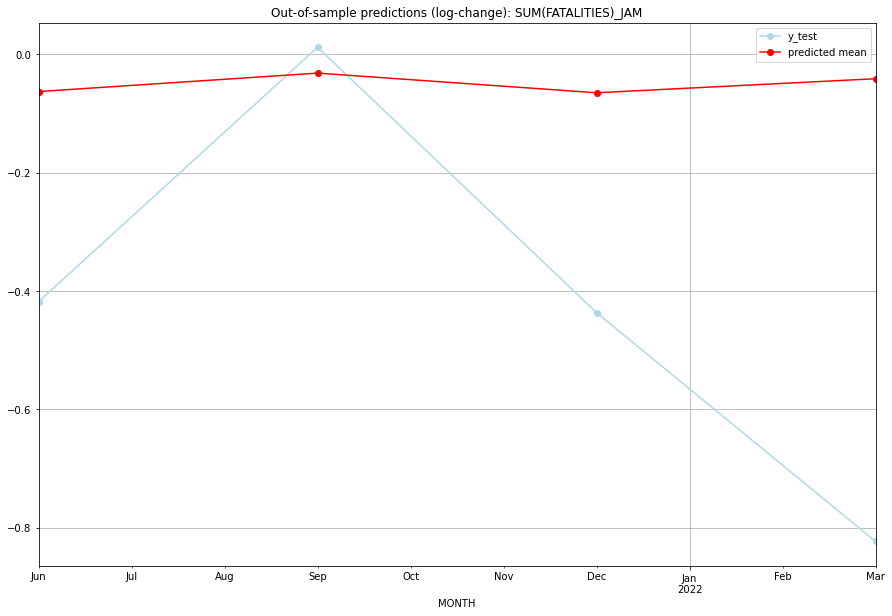

TADDA: 0.3881573509667483
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  76.018862        53.0     -0.062669       -0.417735   JAM   
1 2021-07-01  78.457058        82.0     -0.031503        0.012121   JAM   
2 2021-10-01  75.860839        52.0     -0.064723       -0.436427   JAM   
3 2022-01-01  77.708690        35.0     -0.040966       -0.823200   JAM   

                                          PARAMETERS  
0  {'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (3, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## JEY (108/234) #########
0
Neighbor countries: []
Getting Data for JEY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSC

<Figure size 432x288 with 0 Axes>

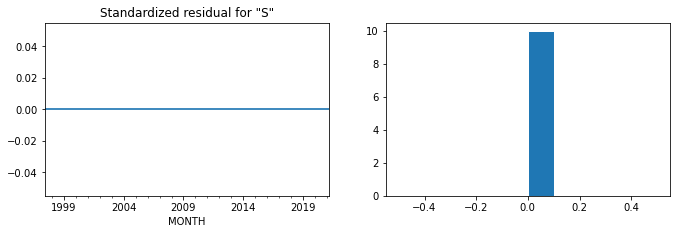

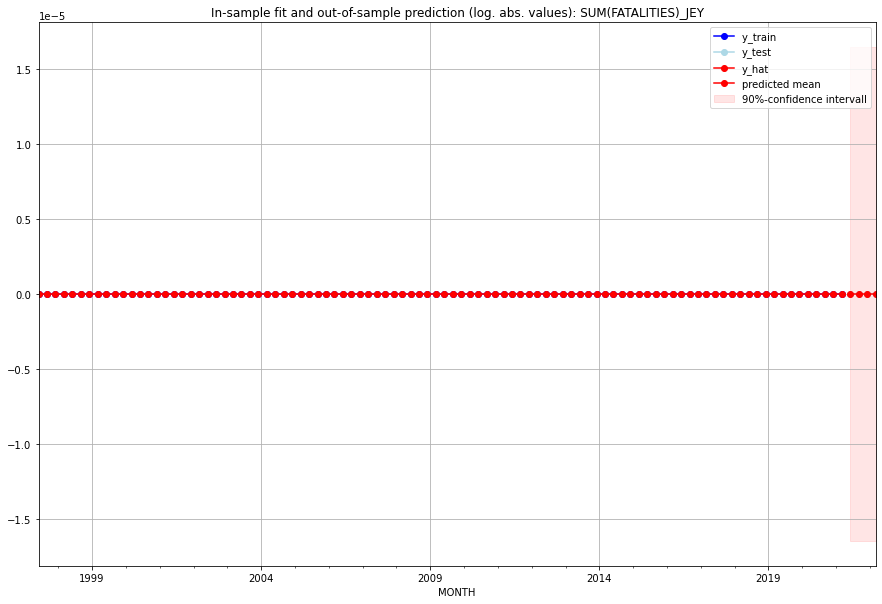

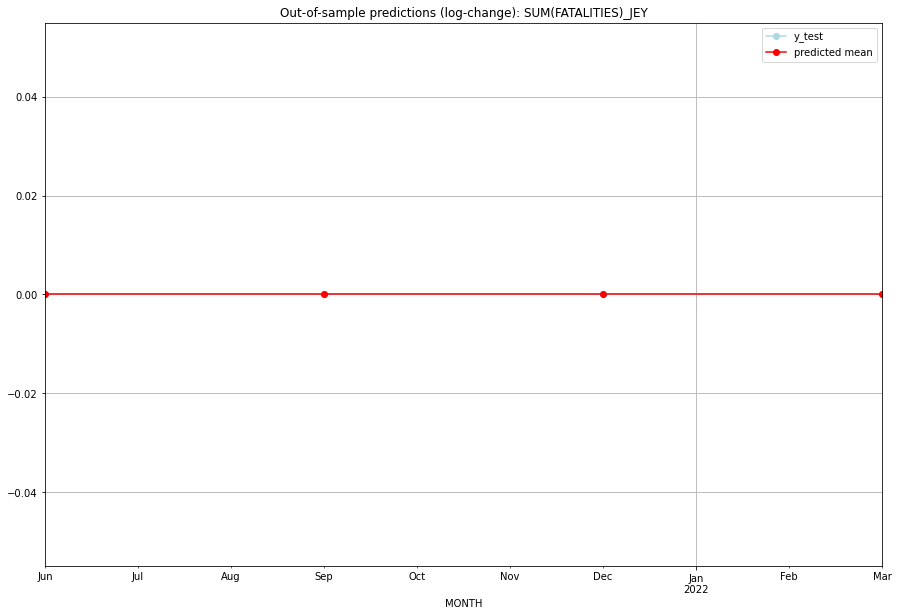

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   JEY   
1 2021-07-01       0.0         0.0           0.0             0.0   JEY   
2 2021-10-01       0.0         0.0           0.0             0.0   JEY   
3 2022-01-01       0.0         0.0           0.0             0.0   JEY   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:06
######## JOR (109/234) #########
0
Neighbor countries: []
Getting Data for JOR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 64)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.667024306337942, 'fold_results': [0.6606957604688368, 0.7489330683884978, 0.5352925250480576, 0.7231758714463755]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_JOR   No. Observations:                   21
Model:                SARIMAX(1, 0, 0)   Log Likelihood                 -31.498
Date:                 Wed, 19 Oct 2022   AIC                             70.996
Time:                         10:42:39   BIC                             75.174
Sample:                     01-31-2016   HQIC                            71.903
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

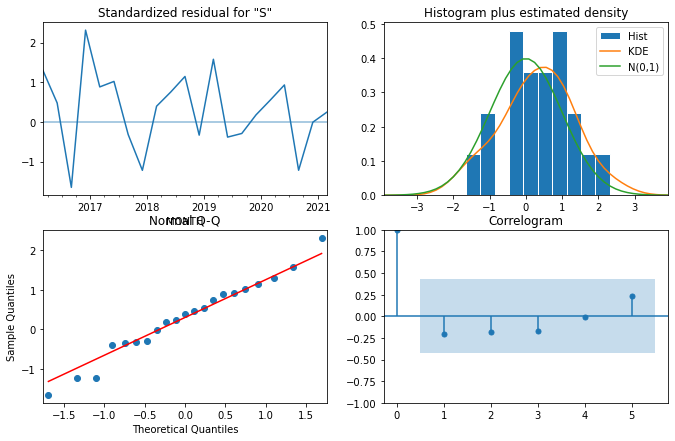

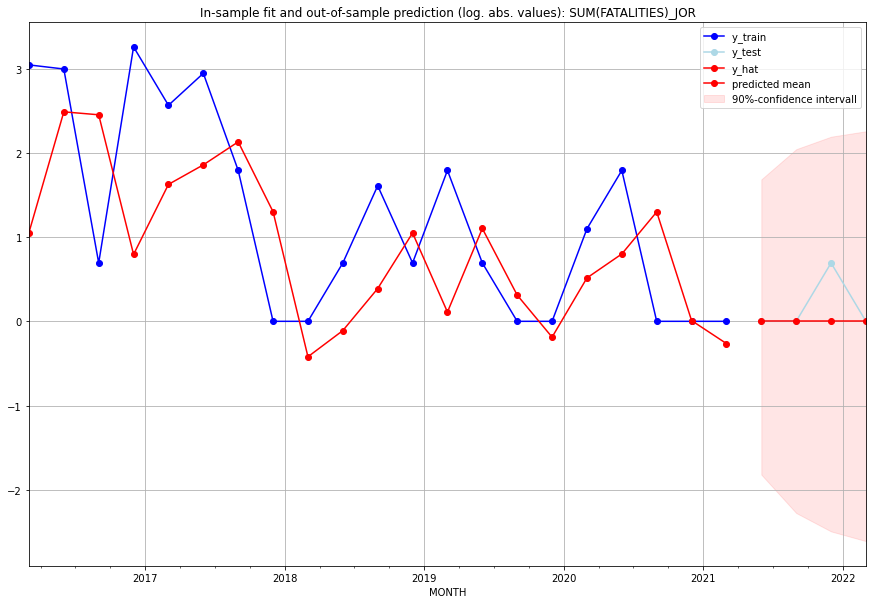

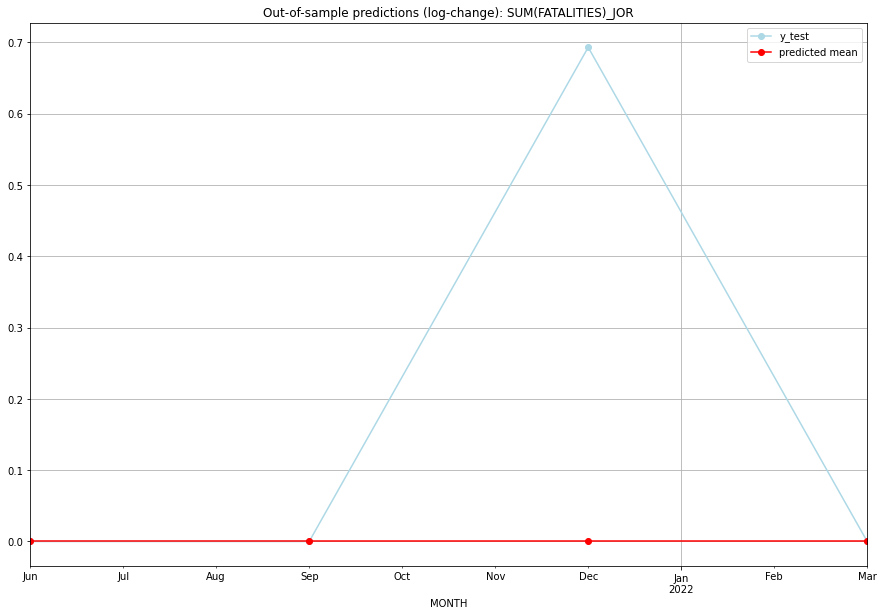

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   JOR   
1 2021-07-01       0.0         0.0           0.0        0.000000   JOR   
2 2021-10-01       0.0         1.0           0.0        0.693147   JOR   
3 2022-01-01       0.0         0.0           0.0        0.000000   JOR   

                                          PARAMETERS  
0  {'params': [2, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## JPN (110/234) #########
0
Neighbor countries: []
Getting Data for JPN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 60)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV nec

<Figure size 432x288 with 0 Axes>

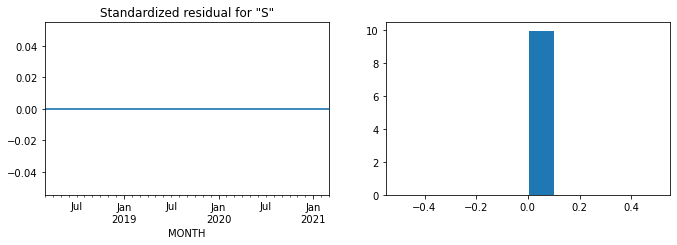

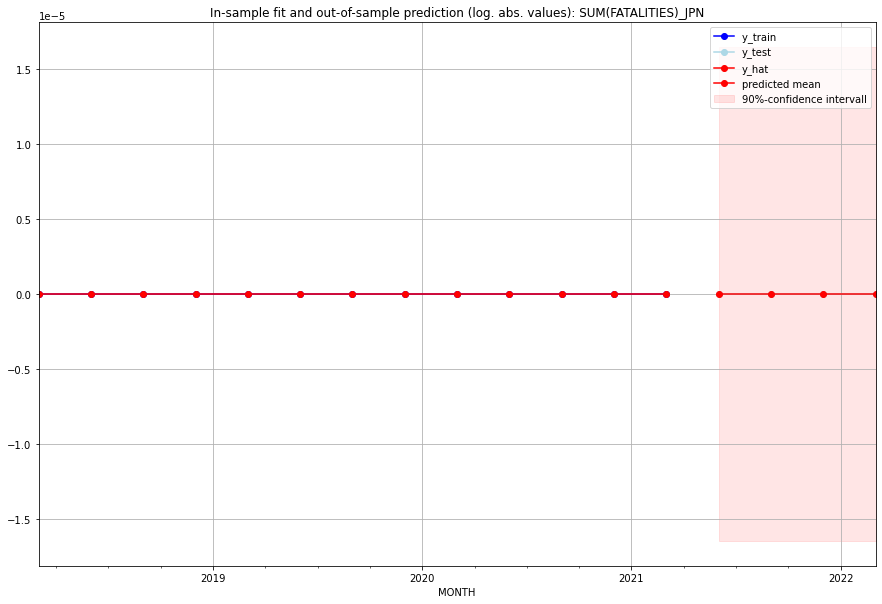

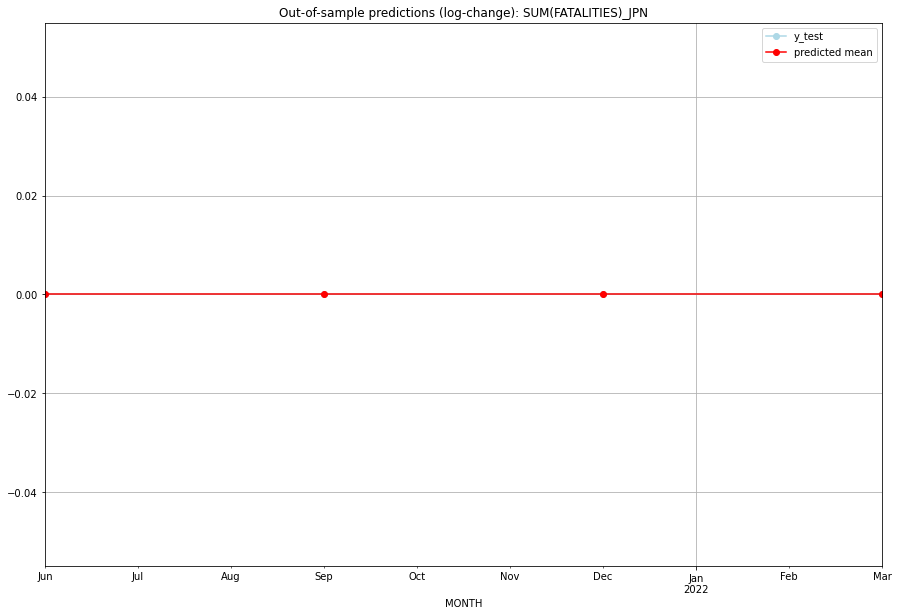

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   JPN   
1 2021-07-01       0.0         0.0           0.0             0.0   JPN   
2 2021-10-01       0.0         0.0           0.0             0.0   JPN   
3 2022-01-01       0.0         0.0           0.0             0.0   JPN   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:01
######## KAZ (111/234) #########
0
Neighbor countries: []
Getting Data for KAZ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 64)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.7600330938958665, 'fold_results': [0.7600330938958665, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KAZ   No. Observations:                   13
Model:                SARIMAX(1, 0, 2)   Log Likelihood                 -17.299
Date:                 Wed, 19 Oct 2022   AIC                             42.598
Time:                         10:42:54   BIC                             44.858
Sample:                     01-31-2018   HQIC                            42.134
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2079      1.067      0.195 

<Figure size 432x288 with 0 Axes>

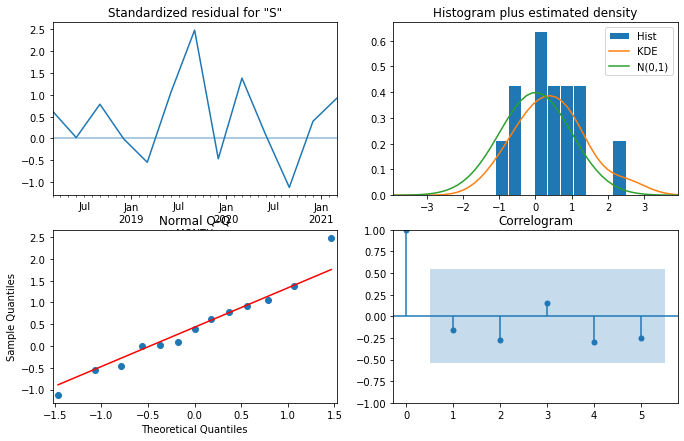

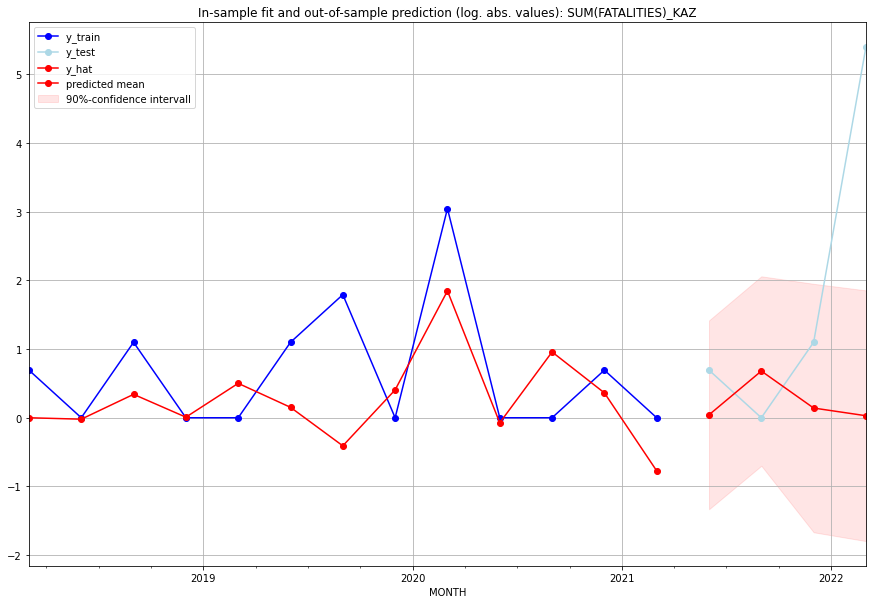

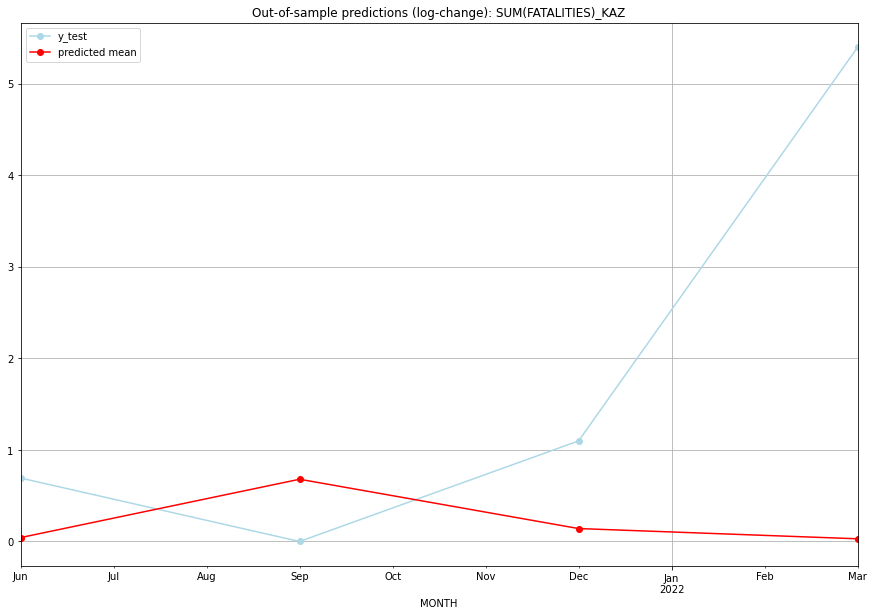

TADDA: 1.914131865712255
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.043492         1.0      0.042573        0.693147   KAZ   
1 2021-07-01  0.973688         0.0      0.679904        0.000000   KAZ   
2 2021-10-01  0.151819         2.0      0.141343        1.098612   KAZ   
3 2022-01-01  0.029819       220.0      0.029383        5.398163   KAZ   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## KEN (112/234) #########
0
Neighbor countries: []
Getting Data for KEN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU co

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.445935637561613, 'fold_results': [0.306231181530469, 0.9538376987142125, 0.28035590457073156, 0.4456861343407885, 0.2435672686518633]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KEN   No. Observations:                   96
Model:                SARIMAX(1, 0, 3)   Log Likelihood                -126.580
Date:                 Wed, 19 Oct 2022   AIC                            263.159
Time:                         10:43:15   BIC                            275.981
Sample:                     04-30-1997   HQIC                           268.342
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

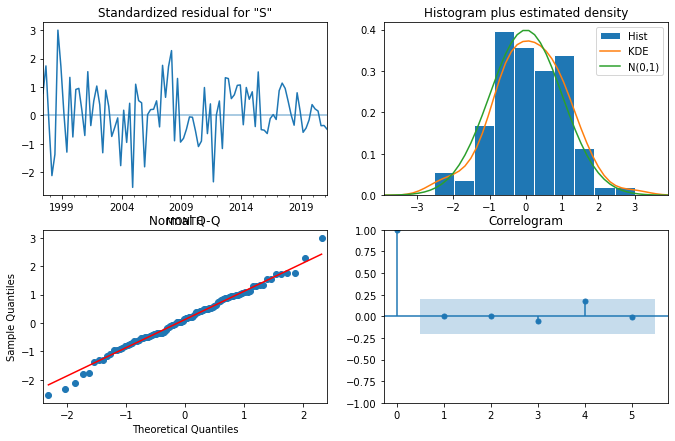

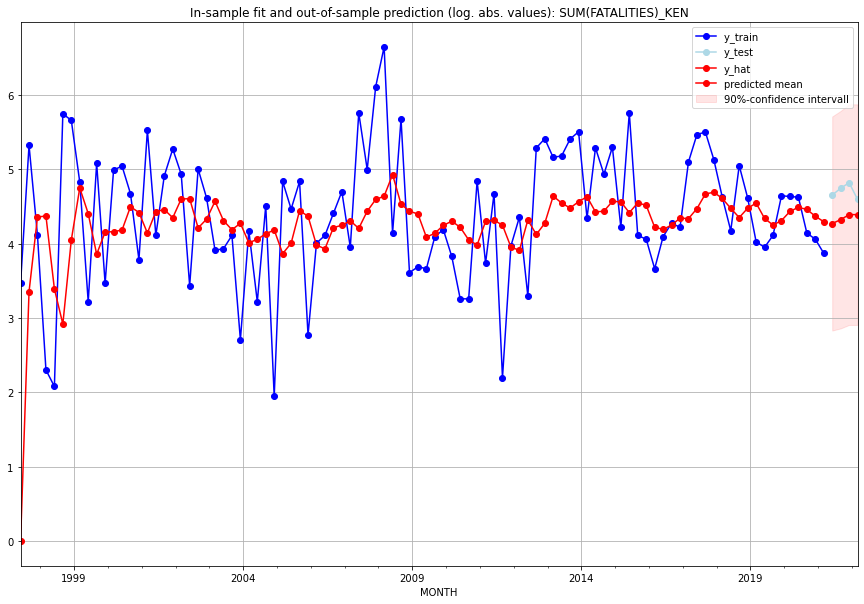

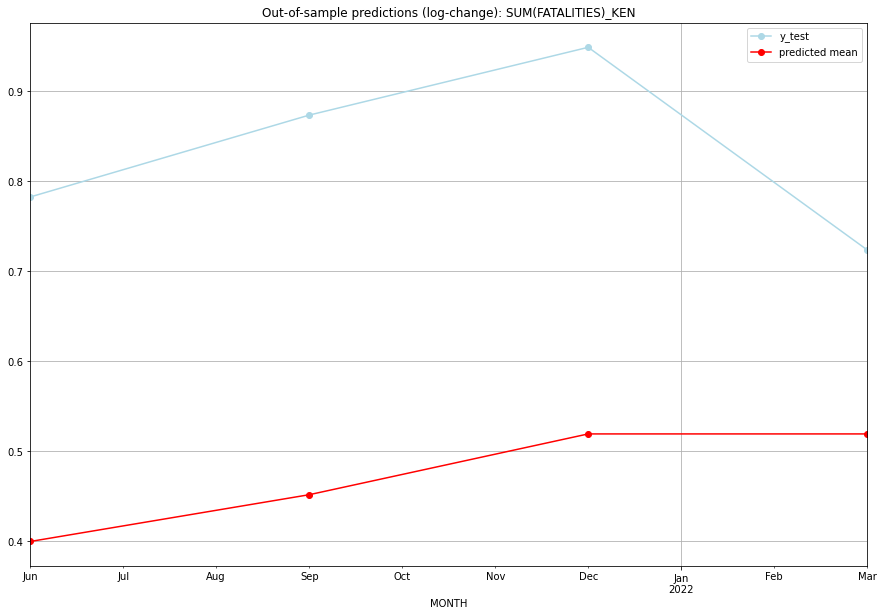

TADDA: 0.3597053870291804
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  70.600518       104.0      0.399901        0.782759   KEN   
1 2021-07-01  74.420964       114.0      0.451884        0.873731   KEN   
2 2021-10-01  79.692275       123.0      0.519442        0.949081   KEN   
3 2022-01-01  79.692201        98.0      0.519441        0.723919   KEN   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## KGZ (113/234) #########
0
Neighbor countries: []
Getting Data for KGZ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 64)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CP

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5898123589118867, 'fold_results': [0.9049716456567459, 0.27465307216702745]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KGZ   No. Observations:                   13
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -18.020
Date:                 Wed, 19 Oct 2022   AIC                             38.040
Time:                         10:43:24   BIC                             38.525
Sample:                     01-31-2018   HQIC                            37.861
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         1.1799      0

<Figure size 432x288 with 0 Axes>

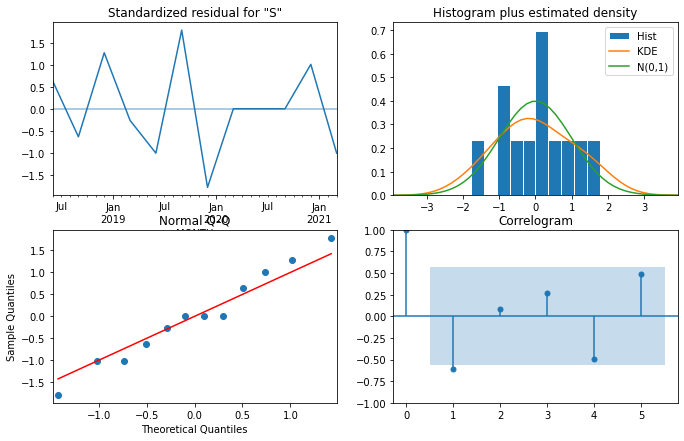

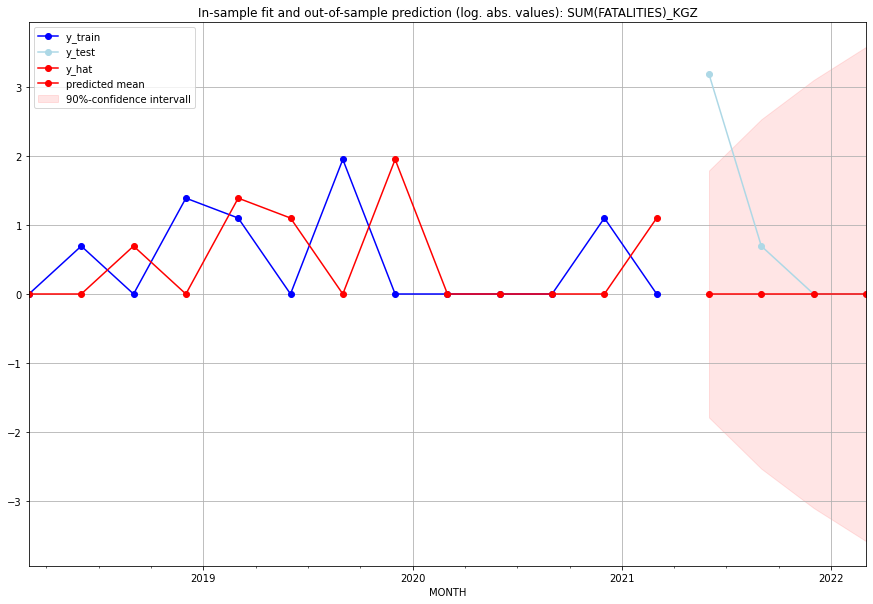

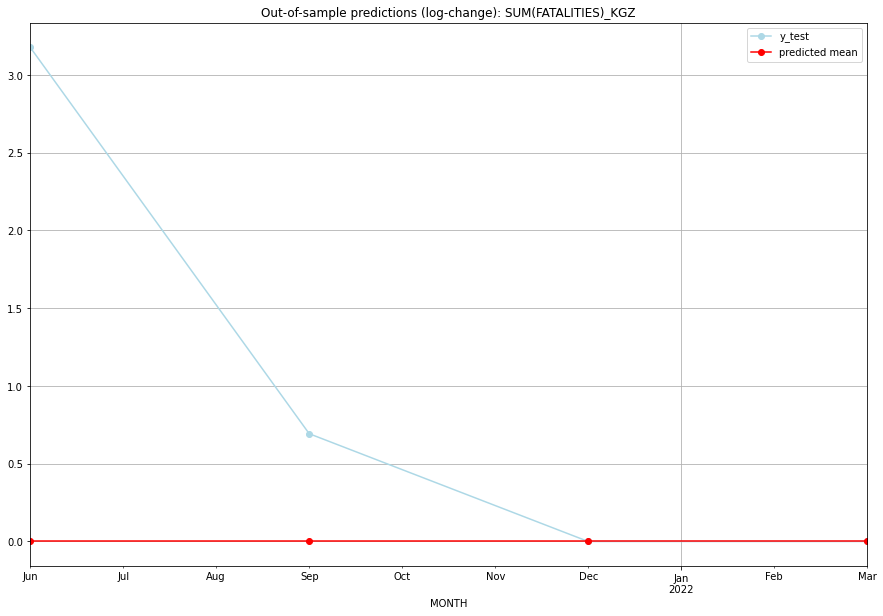

TADDA: 0.9678002527269728
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0        23.0           0.0        3.178054   KGZ   
1 2021-07-01       0.0         1.0           0.0        0.693147   KGZ   
2 2021-10-01       0.0         0.0           0.0        0.000000   KGZ   
3 2022-01-01       0.0         0.0           0.0        0.000000   KGZ   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## KHM (114/234) #########
0
Neighbor countries: []
Getting Data for KHM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 58)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5228951738943145, 'fold_results': [0.6407130809324081, 0.43084319153260464, 0.6383874951777254, 0.39768313579444786, 0.5068489660343866]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KHM   No. Observations:                   45
Model:                SARIMAX(0, 1, 1)   Log Likelihood                 -51.698
Date:                 Wed, 19 Oct 2022   AIC                            113.396
Time:                         10:43:43   BIC                            122.317
Sample:                     01-31-2010   HQIC                           116.704
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

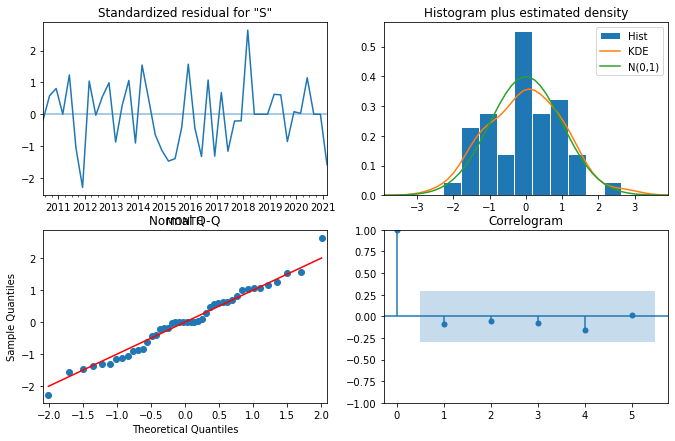

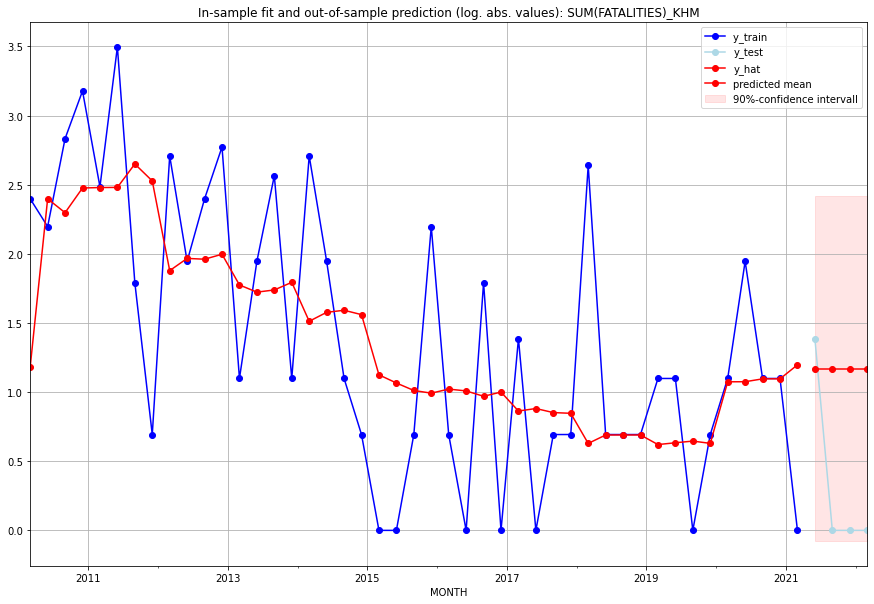

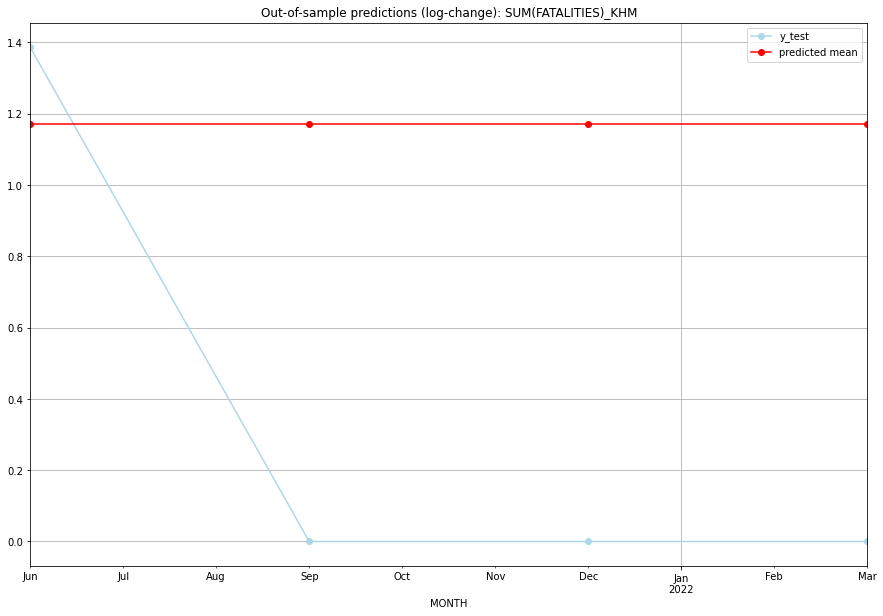

TADDA: 0.9317942768957419
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2.223415         3.0      1.170441        1.386294   KHM   
1 2021-07-01  2.223415         0.0      1.170441        0.000000   KHM   
2 2021-10-01  2.223415         0.0      1.170441        0.000000   KHM   
3 2022-01-01  2.223415         0.0      1.170441        0.000000   KHM   

                                          PARAMETERS  
0  {'params': [3, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## KNA (115/234) #########
0
Neighbor countries: []
Getting Data for KNA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 43)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KNA   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:43:50   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.245      0.000       0.025       0

<Figure size 432x288 with 0 Axes>

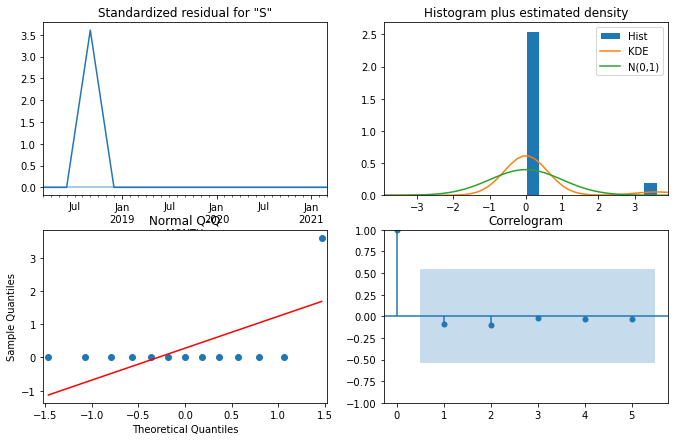

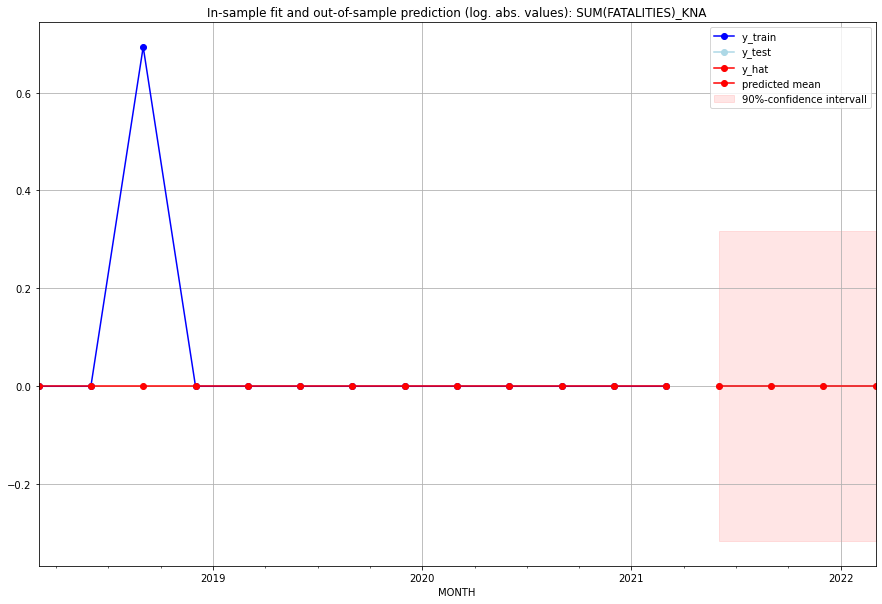

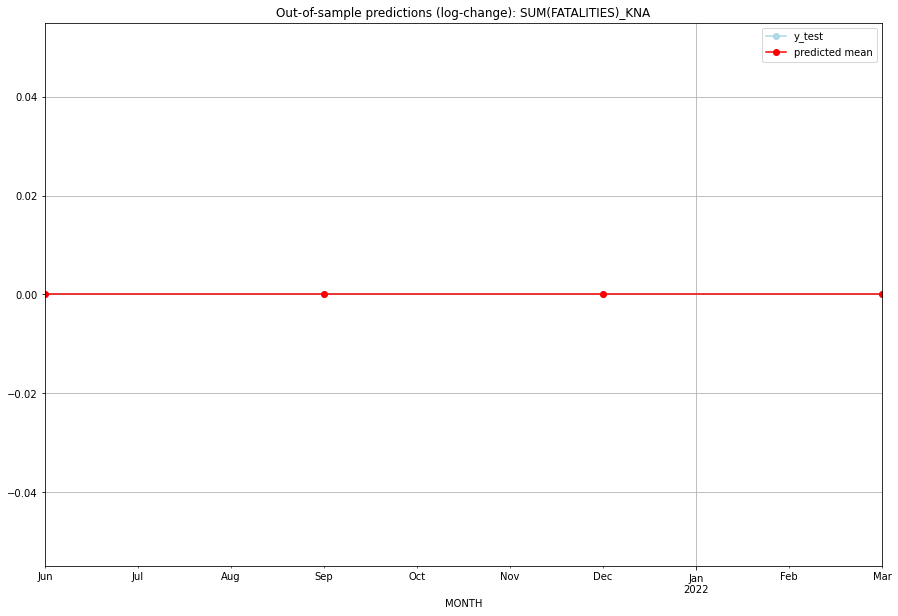

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   KNA   
1 2021-07-01       0.0         0.0           0.0             0.0   KNA   
2 2021-10-01       0.0         0.0           0.0             0.0   KNA   
3 2022-01-01       0.0         0.0           0.0             0.0   KNA   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:09
######## KOR (116/234) #########
0
Neighbor countries: []
Getting Data for KOR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 62)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-

<Figure size 432x288 with 0 Axes>

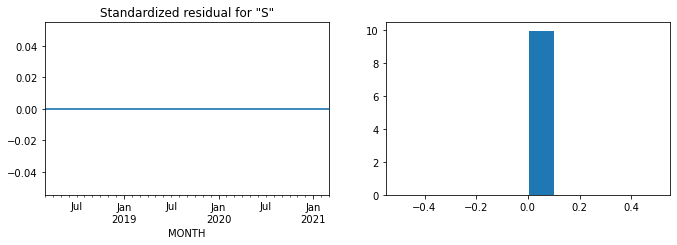

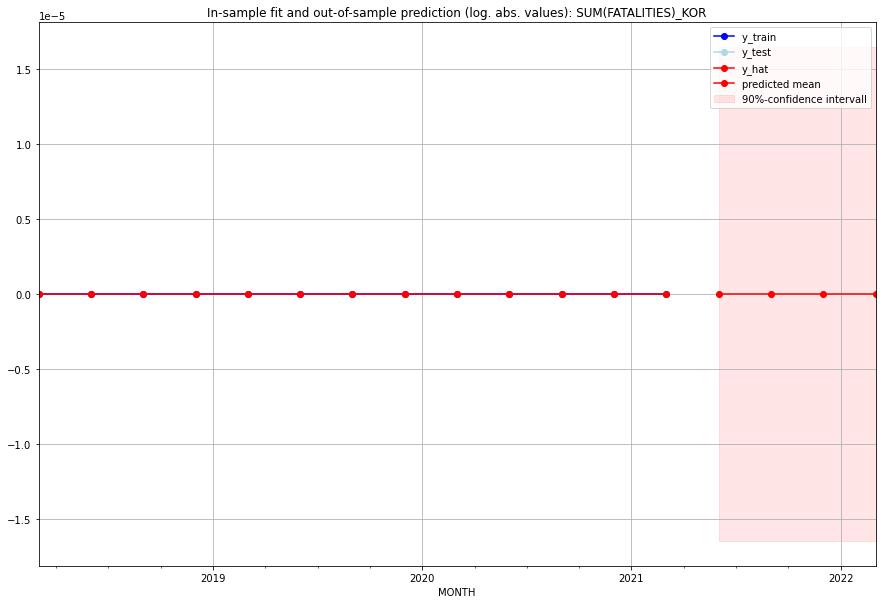

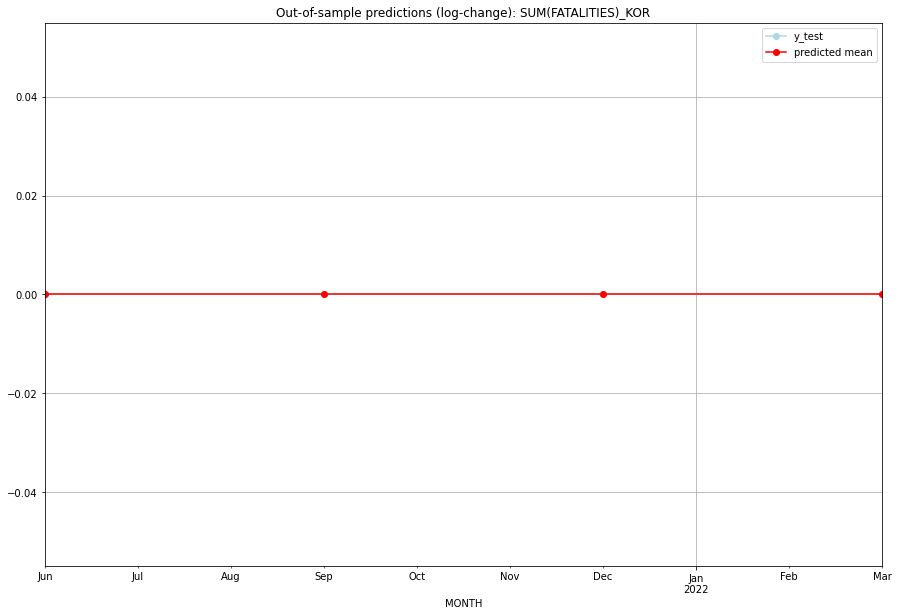

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   KOR   
1 2021-07-01       0.0         0.0           0.0             0.0   KOR   
2 2021-10-01       0.0         0.0           0.0             0.0   KOR   
3 2022-01-01       0.0         0.0           0.0             0.0   KOR   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## KWT (117/234) #########
0
Neighbor countries: []
Getting Data for KWT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 54)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.04332169878499658, 'fold_results': [0.0, 0.0, 0.0, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KWT   No. Observations:                   21
Model:                         SARIMAX   Log Likelihood                   9.867
Date:                 Wed, 19 Oct 2022   AIC                            -17.733
Time:                         10:44:15   BIC                            -16.689
Sample:                     01-31-2016   HQIC                           -17.506
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0229      0.002

<Figure size 432x288 with 0 Axes>

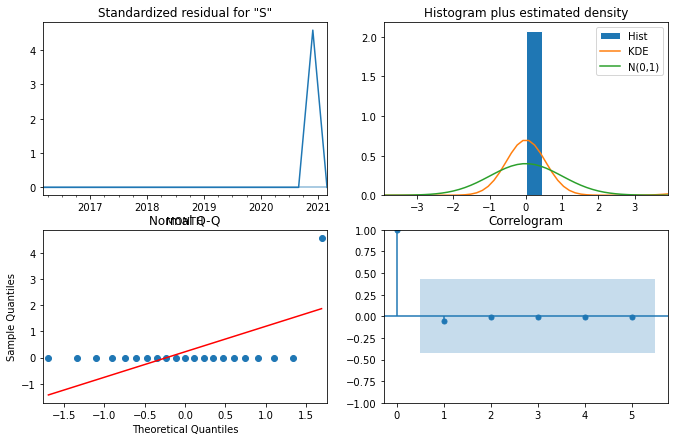

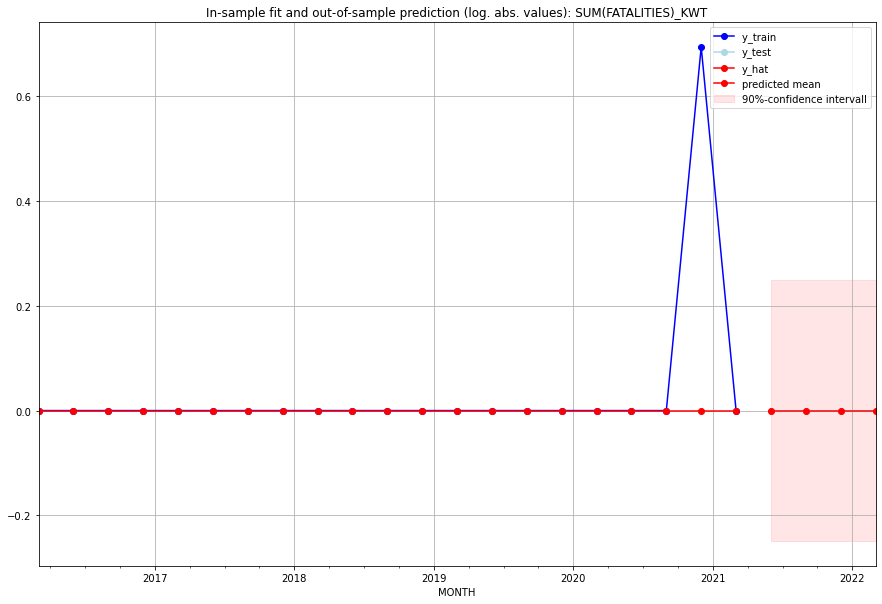

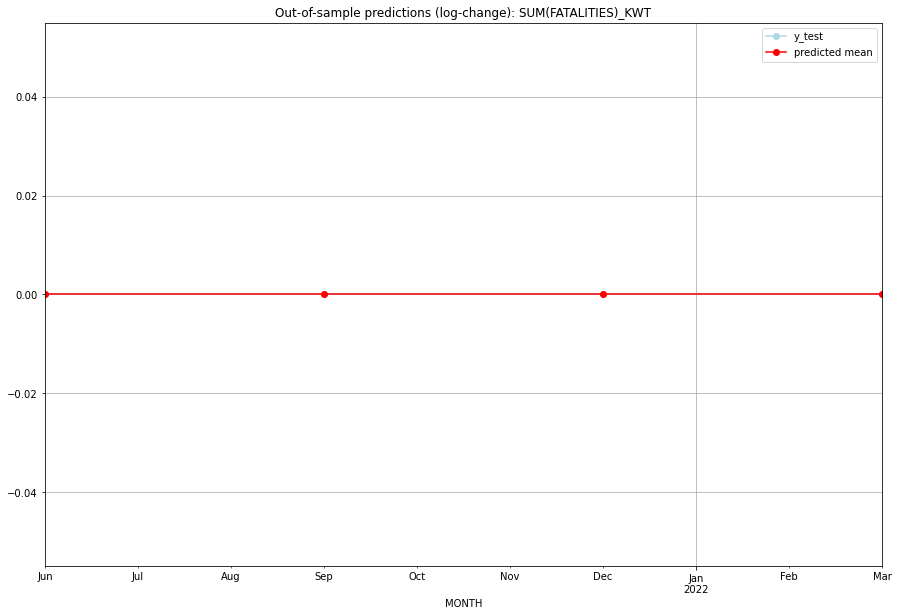

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   KWT   
1 2021-07-01       0.0         0.0           0.0             0.0   KWT   
2 2021-10-01       0.0         0.0           0.0             0.0   KWT   
3 2022-01-01       0.0         0.0           0.0             0.0   KWT   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:24
######## LAO (118/234) #########
0
Neighbor countries: []
Getting Data for LAO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 58)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 paramet

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.41392786198728454, 'fold_results': [0.9271755996857276, 0.4493165296907497, 2.7260602420095746e-18, 0.34657359027997264, 0.34657359027997264]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LAO   No. Observations:                   45
Model:                SARIMAX(1, 0, 0)   Log Likelihood                 -43.817
Date:                 Wed, 19 Oct 2022   AIC                             91.633
Time:                         10:44:39   BIC                             95.247
Sample:                     01-31-2010   HQIC                            92.980
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------

<Figure size 432x288 with 0 Axes>

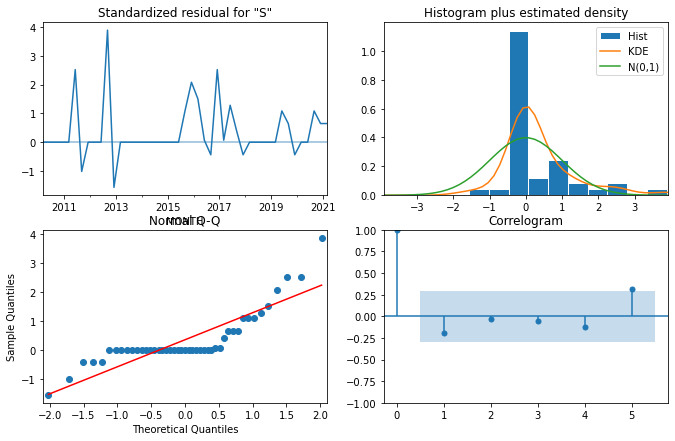

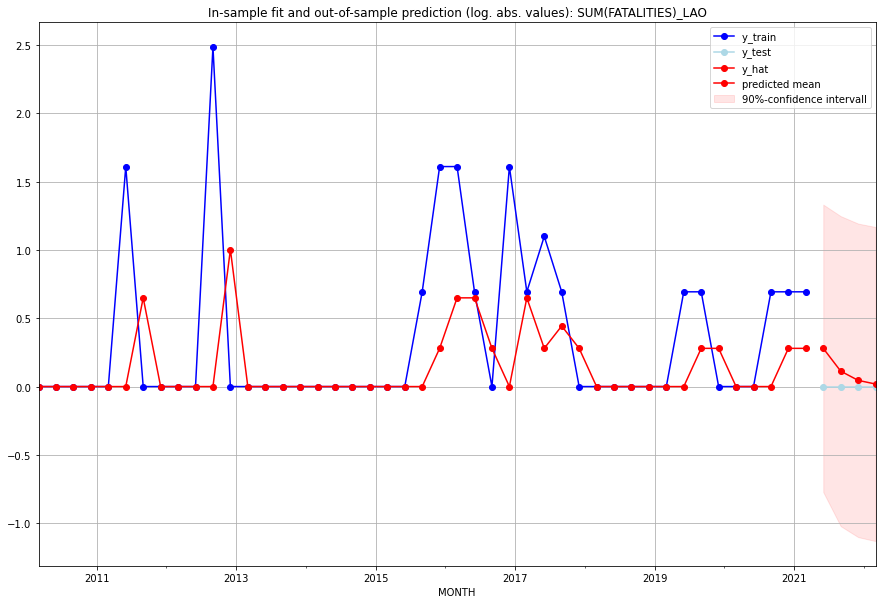

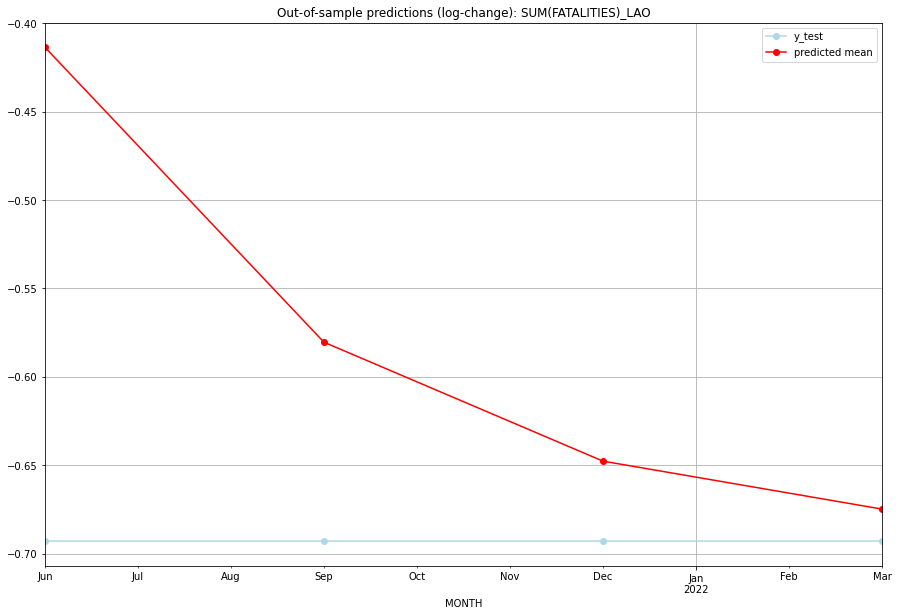

TADDA: 0.1139981130574017
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.322478         0.0     -0.413640       -0.693147   LAO   
1 2021-07-01  0.119306         0.0     -0.580438       -0.693147   LAO   
2 2021-10-01  0.046498         0.0     -0.647698       -0.693147   LAO   
3 2022-01-01  0.018496         0.0     -0.674820       -0.693147   LAO   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## LBN (119/234) #########
0
Neighbor countries: []
Getting Data for LBN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 57)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.9045296773821714, 'fold_results': [1.3670244516695615, nan, 0.371055192281959, 0.9755093881949938]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LBN   No. Observations:                   21
Model:                SARIMAX(3, 0, 2)   Log Likelihood                 -29.573
Date:                 Wed, 19 Oct 2022   AIC                             75.147
Time:                         10:44:51   BIC                             83.503
Sample:                     01-31-2016   HQIC                            76.960
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1   

<Figure size 432x288 with 0 Axes>

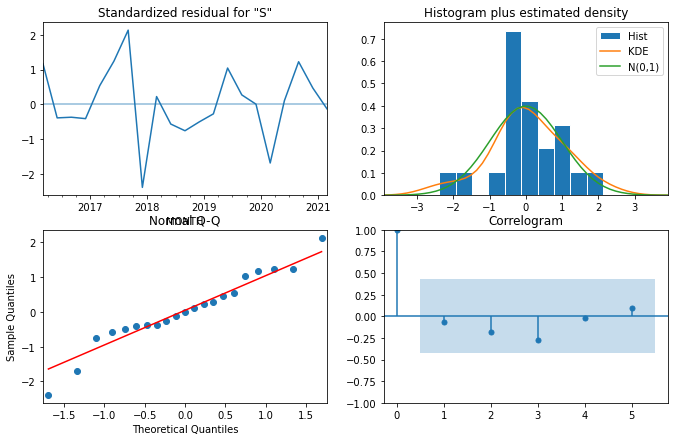

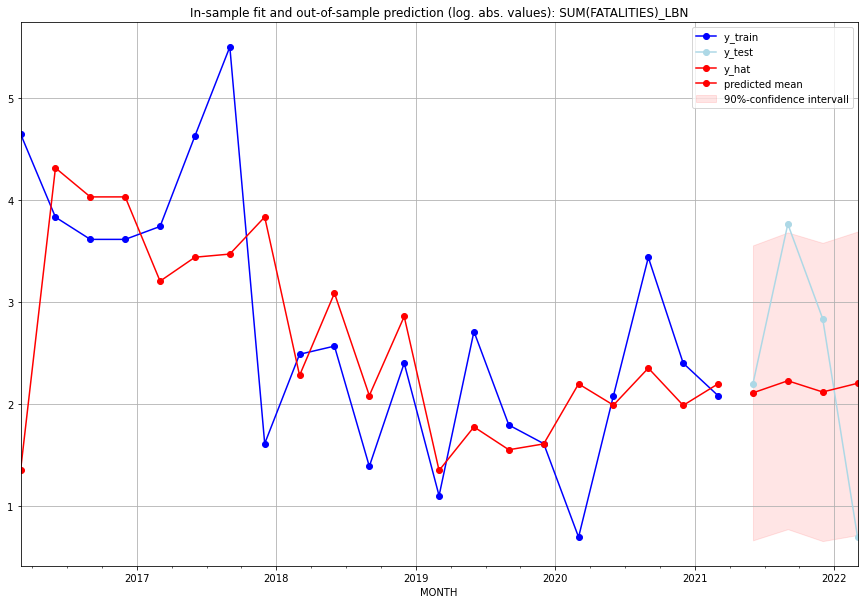

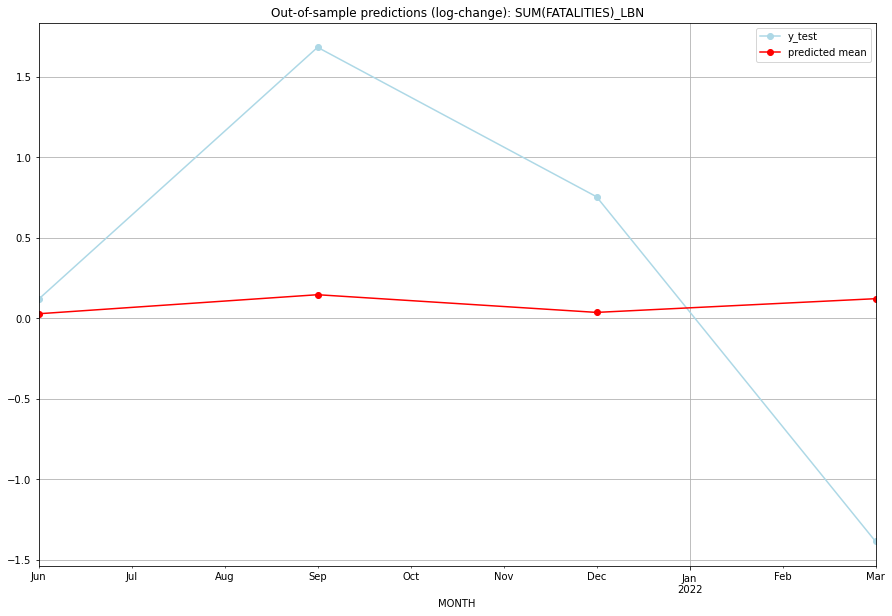

TADDA: 0.9931339498023558
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  7.223378         8.0      0.027539        0.117783   LBN   
1 2021-07-01  8.255695        42.0      0.145798        1.681759   LBN   
2 2021-10-01  7.292893        16.0      0.035957        0.753772   LBN   
3 2022-01-01  8.030003         1.0      0.121111       -1.386294   LBN   

                                          PARAMETERS  
0  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## LBR (120/234) #########
0
Neighbor countries: []
Getting Data for LBR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 55)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU c

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5134065333062019, 'fold_results': [0.9516656224425801, 0.5198603854199589, 0.17328679513998638, 0.5756462732485114, 0.34657359027997264]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LBR   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -183.270
Date:                 Wed, 19 Oct 2022   AIC                            368.540
Time:                         10:45:15   BIC                            371.094
Sample:                     04-30-1997   HQIC                           369.572
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

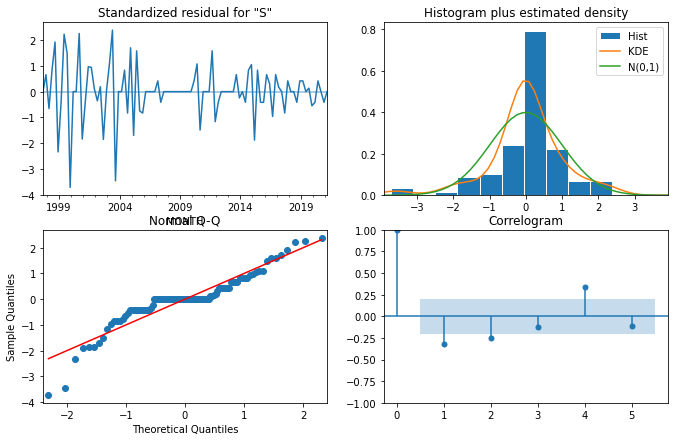

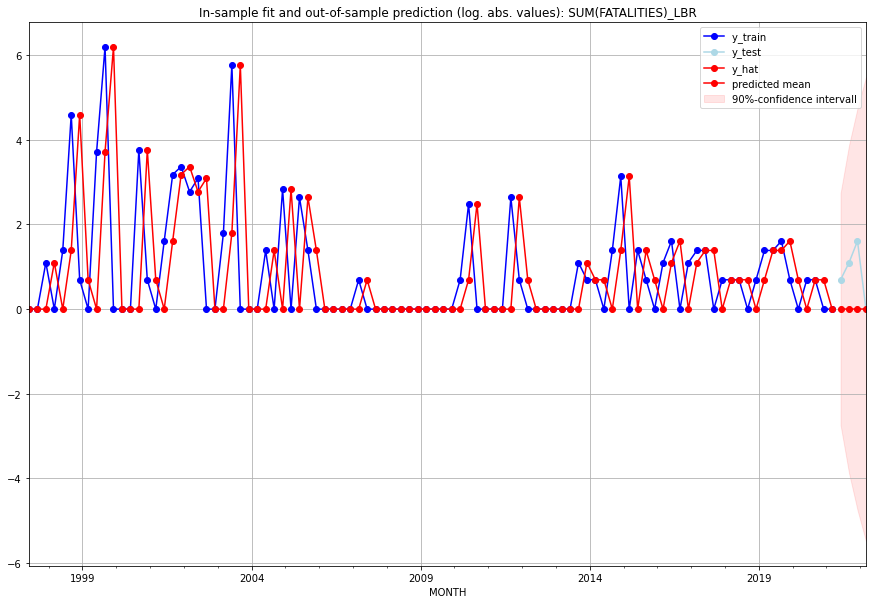

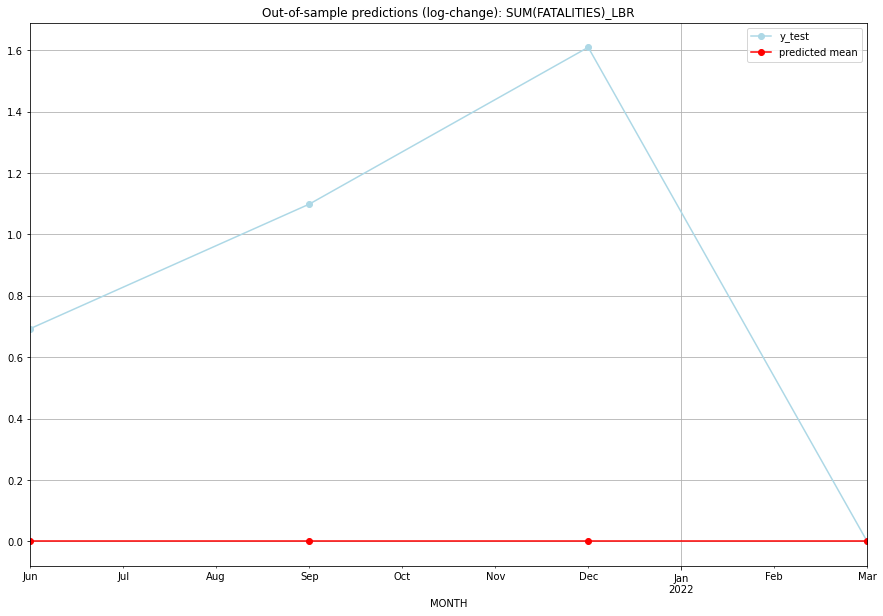

TADDA: 0.8502993454155389
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         1.0  1.232595e-32        0.693147   LBR   
1 2021-07-01       0.0         2.0  1.232595e-32        1.098612   LBR   
2 2021-10-01       0.0         4.0  1.232595e-32        1.609438   LBR   
3 2022-01-01       0.0         0.0  1.232595e-32        0.000000   LBR   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:26
######## LBY (121/234) #########
0
Neighbor countries: []
Getting Data for LBY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 50)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU c

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.7099981149670029, 'fold_results': [0.5334571779097619, 0.478361281759593, 0.07126579776941622, 1.0855238096829394, 1.3813825077133042]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LBY   No. Observations:                   96
Model:                SARIMAX(3, 0, 3)   Log Likelihood                -151.879
Date:                 Wed, 19 Oct 2022   AIC                            323.757
Time:                         10:45:37   BIC                            349.401
Sample:                     04-30-1997   HQIC                           334.123
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

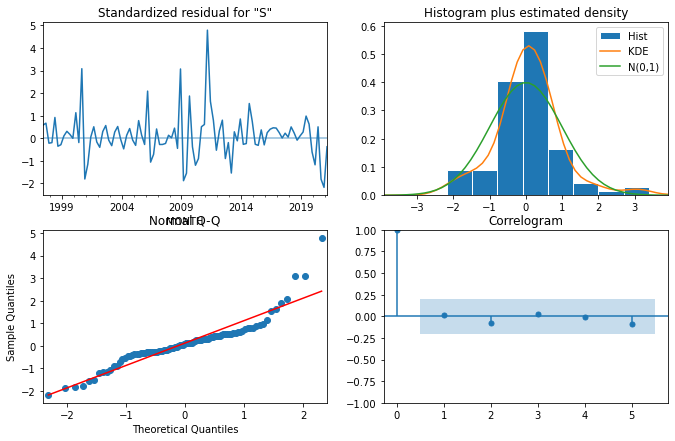

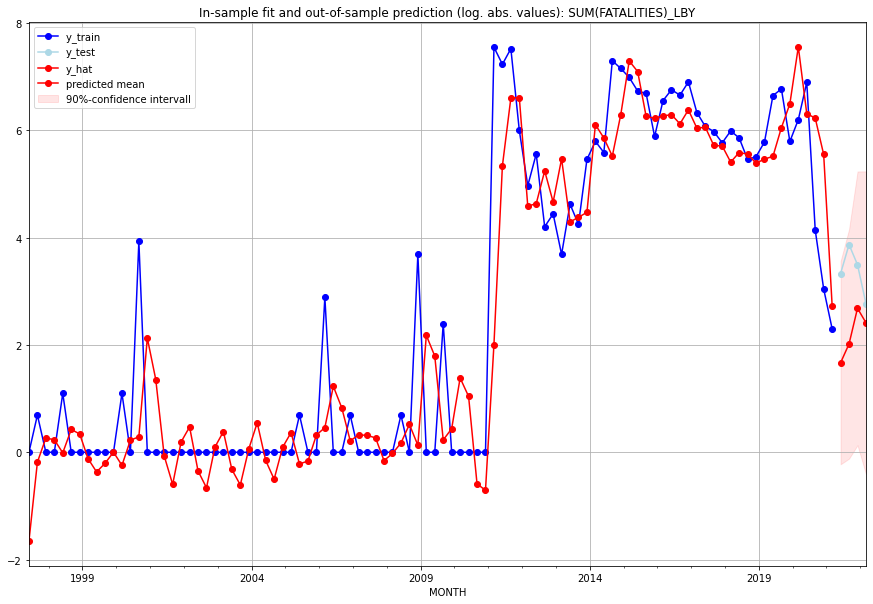

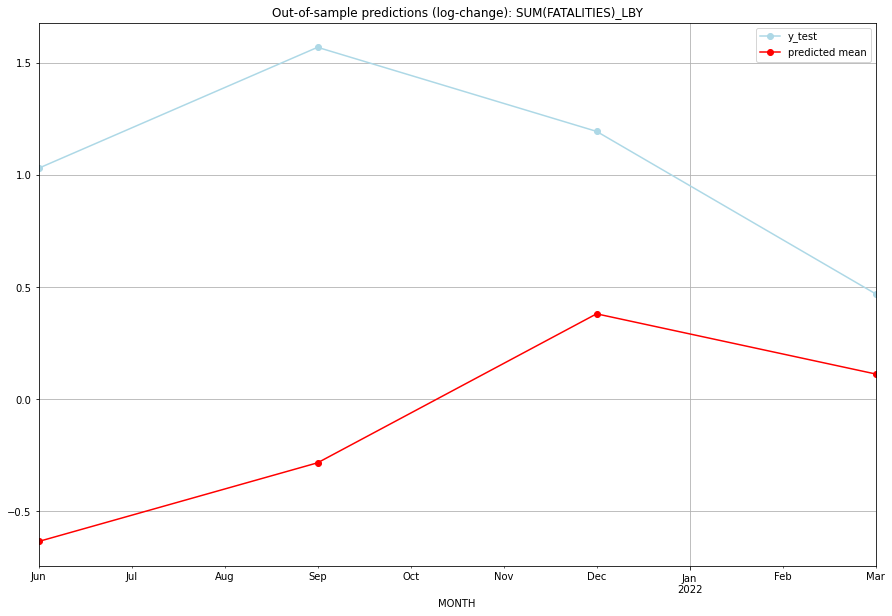

TADDA: 1.400633165179347
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   4.305612        27.0     -0.633820        1.029619   LBY   
1 2021-07-01   6.534278        47.0     -0.283122        1.568616   LBY   
2 2021-10-01  13.634184        32.0      0.380775        1.193922   LBY   
3 2022-01-01  10.193384        15.0      0.112738        0.470004   LBY   

                                          PARAMETERS  
0  {'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## LCA (122/234) #########
0
Neighbor countries: []
Getting Data for LCA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 54)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV 

<Figure size 432x288 with 0 Axes>

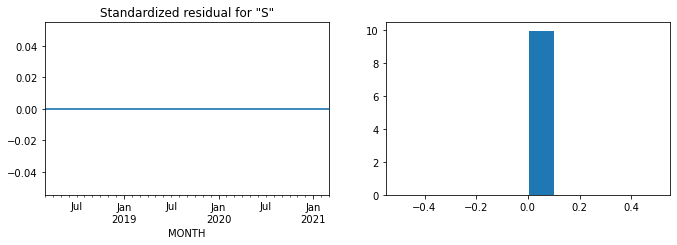

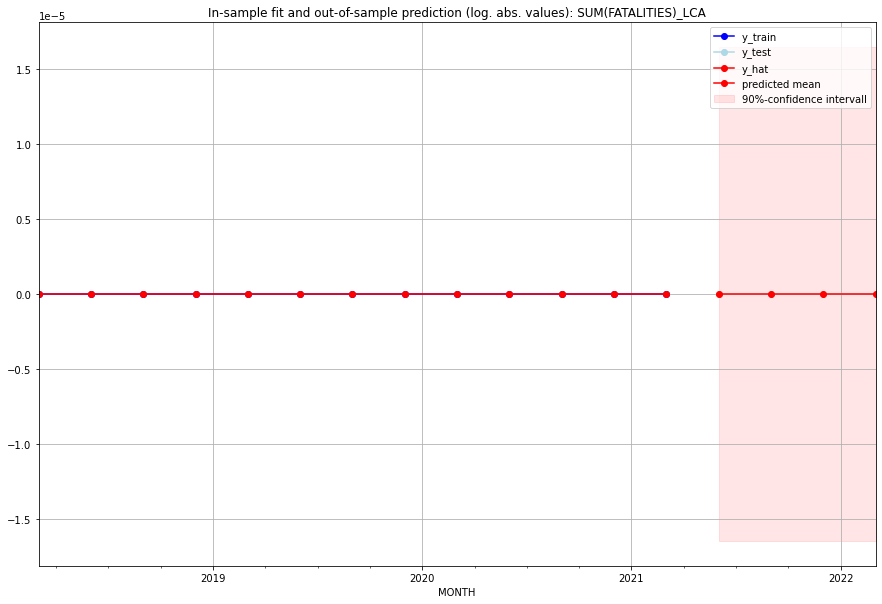

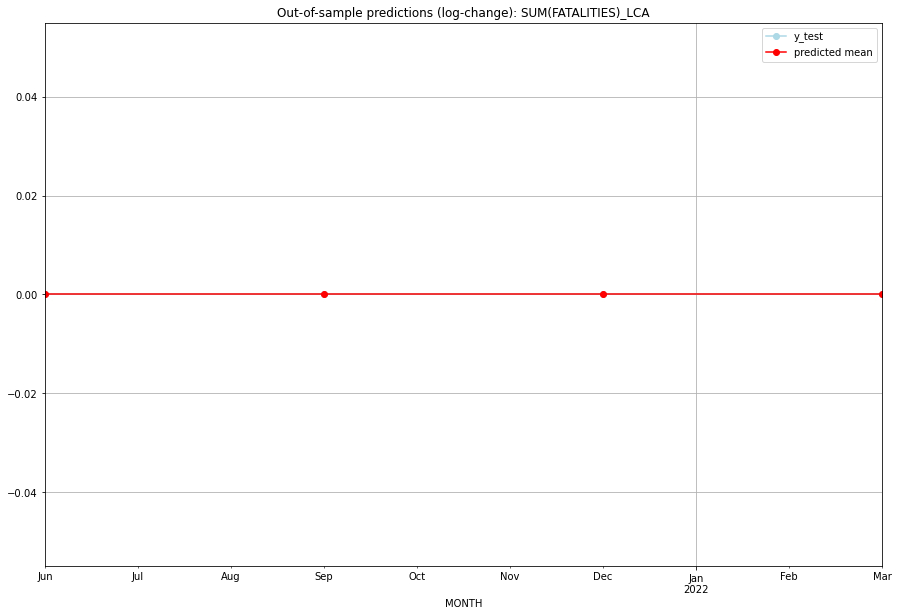

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   LCA   
1 2021-07-01       0.0         0.0           0.0             0.0   LCA   
2 2021-10-01       0.0         0.0           0.0             0.0   LCA   
3 2022-01-01       0.0         0.0           0.0             0.0   LCA   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:03
######## LIE (123/234) #########
0
Neighbor countries: []
Getting Data for LIE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 19)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


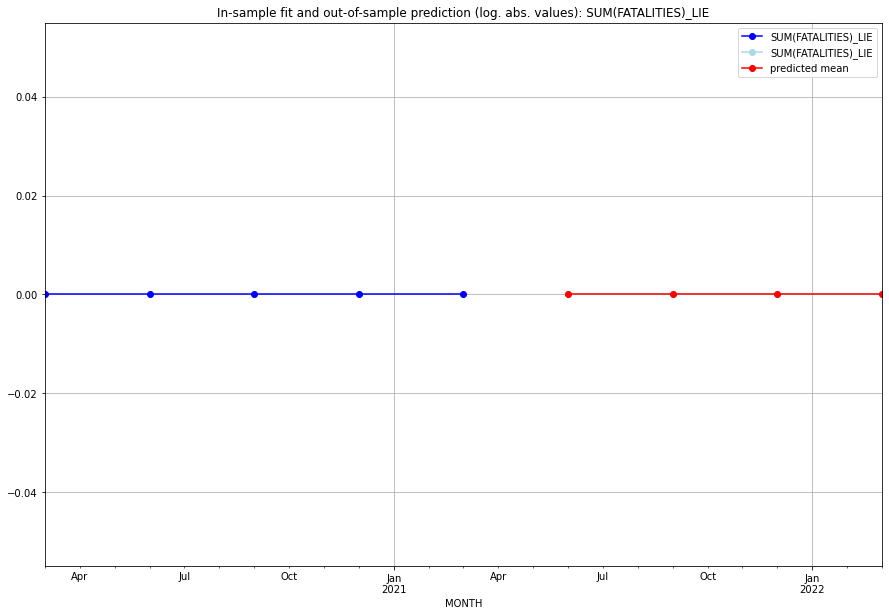

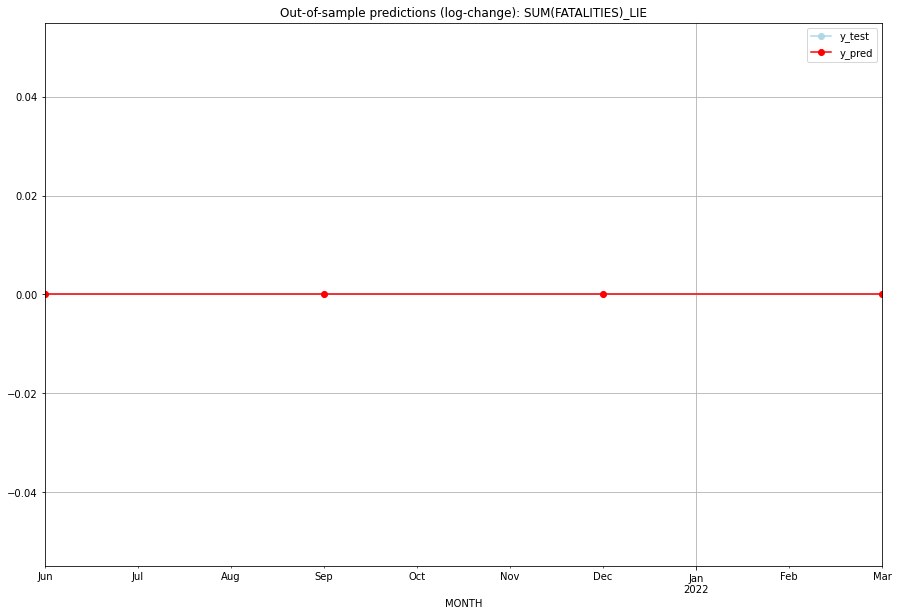

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   LIE   
1 2021-07-01       0.0         0.0           0.0             0.0   LIE   
2 2021-10-01       0.0         0.0           0.0             0.0   LIE   
3 2022-01-01       0.0         0.0           0.0             0.0   LIE   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:05
######## LKA (124/234) #########
0
Neighbor countries: []
Getting Data for LKA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 62)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8932957655909014, 'fold_results': [0.5508751700999264, 0.4507140703085925, 1.6940983469215203, 1.4474720438877549, 0.3233191967367128]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LKA   No. Observations:                   45
Model:                SARIMAX(3, 0, 0)   Log Likelihood                 -64.323
Date:                 Wed, 19 Oct 2022   AIC                            136.646
Time:                         10:46:10   BIC                            143.873
Sample:                     01-31-2010   HQIC                           139.341
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

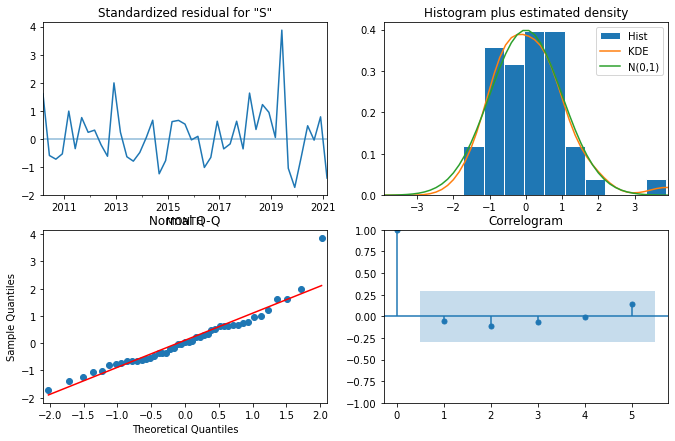

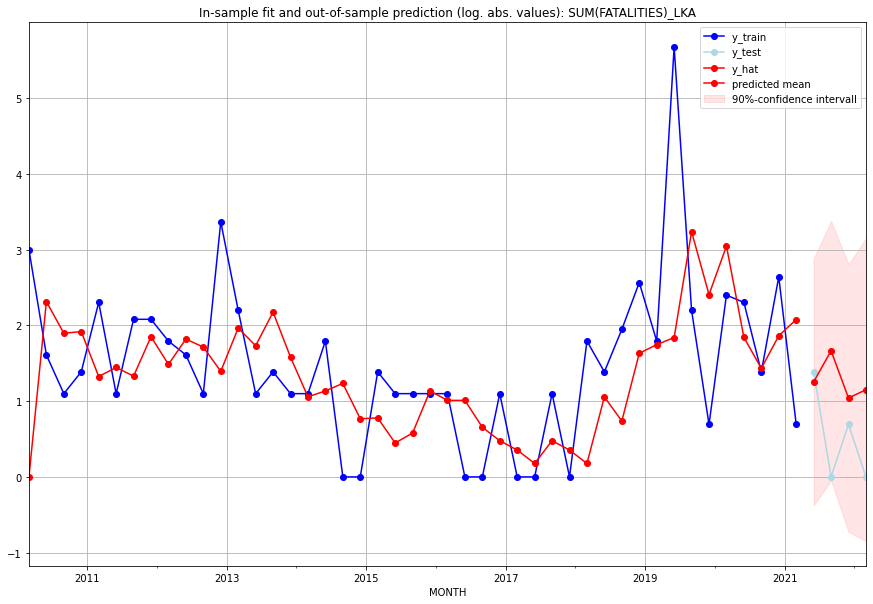

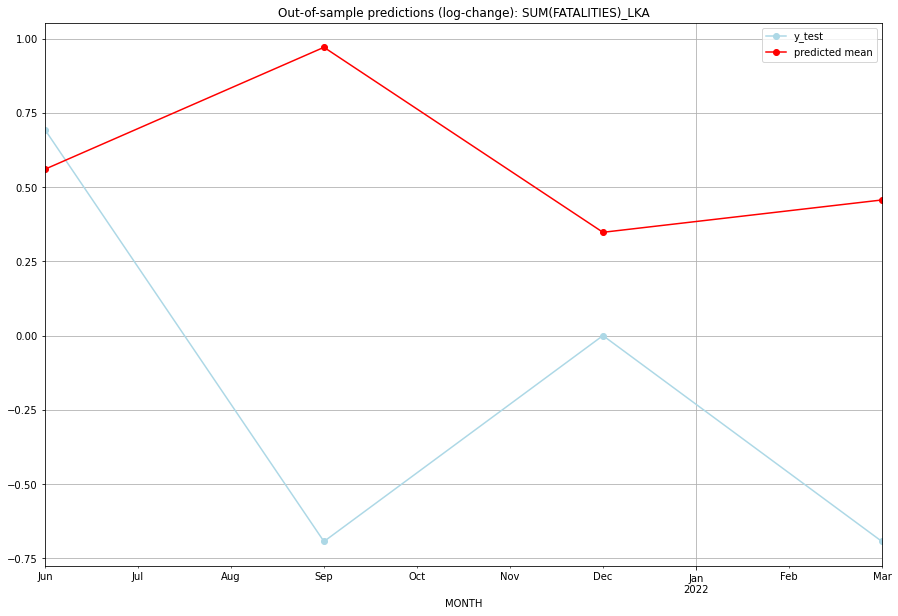

TADDA: 1.18026927971303
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2.501460         3.0      0.560033        0.693147   LKA   
1 2021-07-01  4.278230         0.0      0.970444       -0.693147   LKA   
2 2021-10-01  1.831567         1.0      0.347683        0.000000   LKA   
3 2022-01-01  2.157234         0.0      0.456549       -0.693147   LKA   

                                          PARAMETERS  
0  {'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:24
######## LSO (125/234) #########
0
Neighbor countries: []
Getting Data for LSO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4856705131415747, 'fold_results': [0.5756462732485115, 0.5198603854199589, 0.0, 0.7225929394740412, 0.6102529675653623]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LSO   No. Observations:                   96
Model:                SARIMAX(1, 0, 0)   Log Likelihood                -119.987
Date:                 Wed, 19 Oct 2022   AIC                            245.974
Time:                         10:46:29   BIC                            253.667
Sample:                     04-30-1997   HQIC                           249.083
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

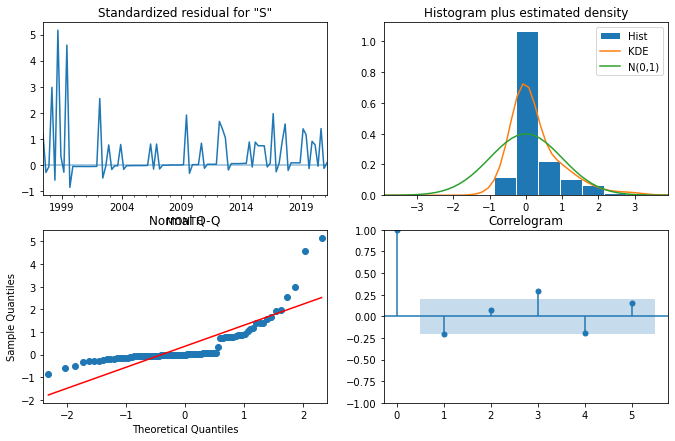

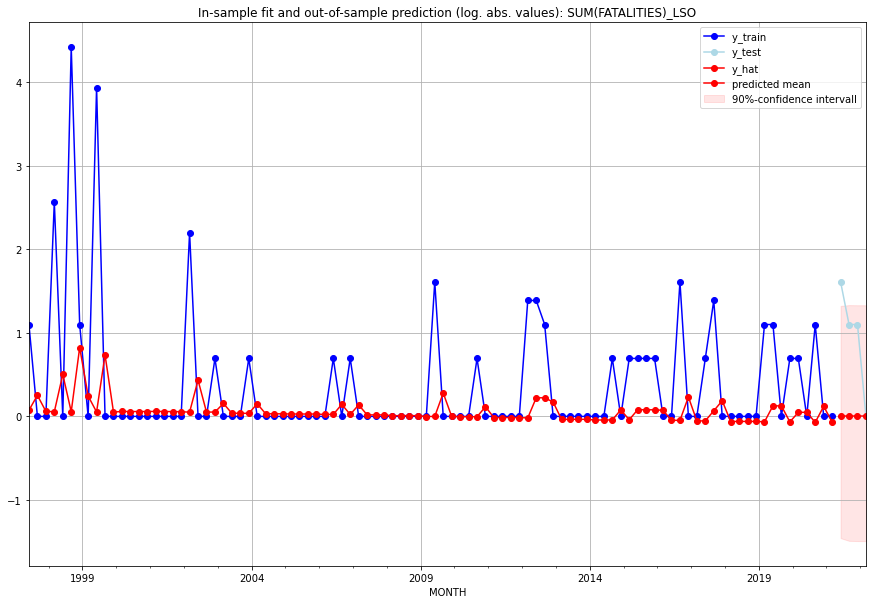

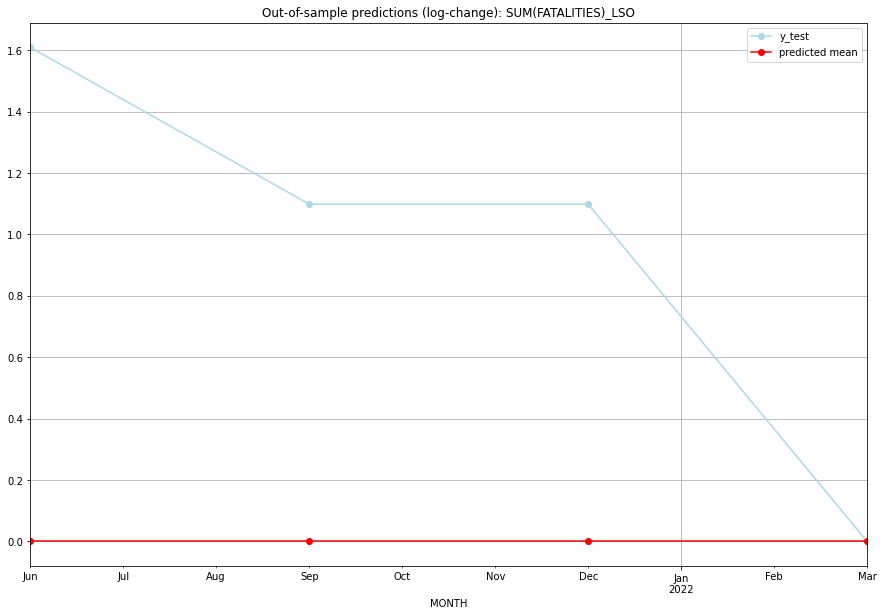

TADDA: 0.9516656224425801
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         4.0           0.0        1.609438   LSO   
1 2021-07-01       0.0         2.0           0.0        1.098612   LSO   
2 2021-10-01       0.0         2.0           0.0        1.098612   LSO   
3 2022-01-01       0.0         0.0           0.0        0.000000   LSO   

                                          PARAMETERS  
0  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## LTU (126/234) #########
0
Neighbor countries: []
Getting Data for LTU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 61)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient d

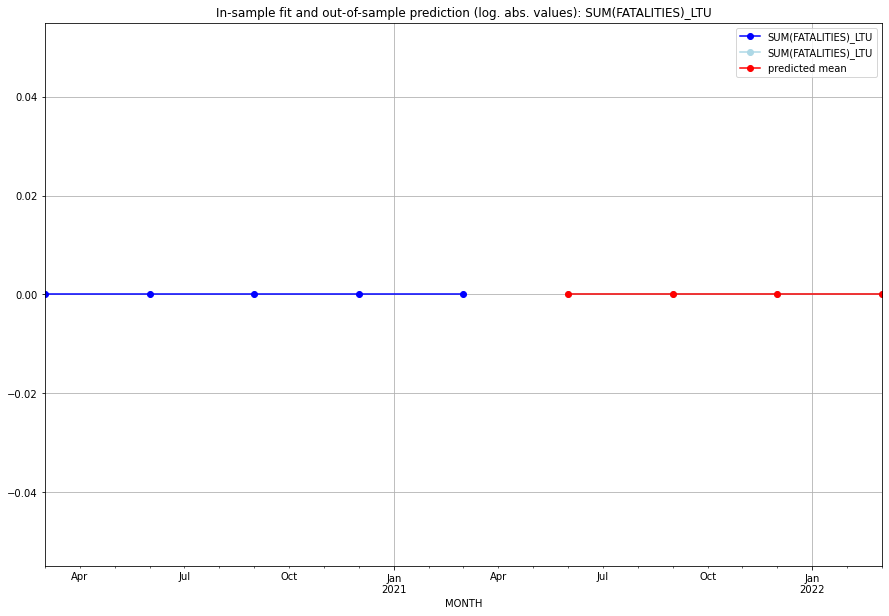

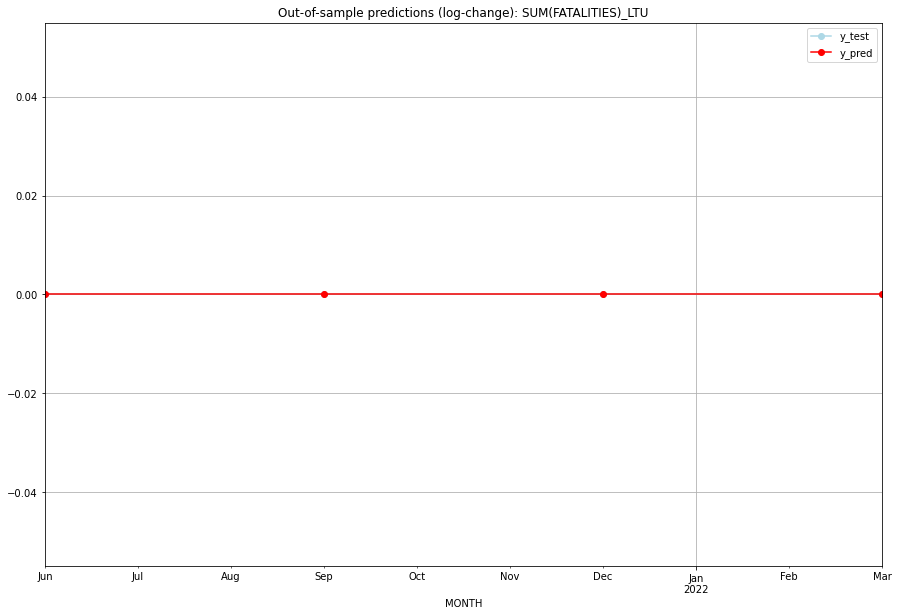

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   LTU   
1 2021-07-01       0.0         0.0           0.0             0.0   LTU   
2 2021-10-01       0.0         0.0           0.0             0.0   LTU   
3 2022-01-01       0.0         0.0           0.0             0.0   LTU   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:07
######## LUX (127/234) #########
0
Neighbor countries: []
Getting Data for LUX
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 65)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


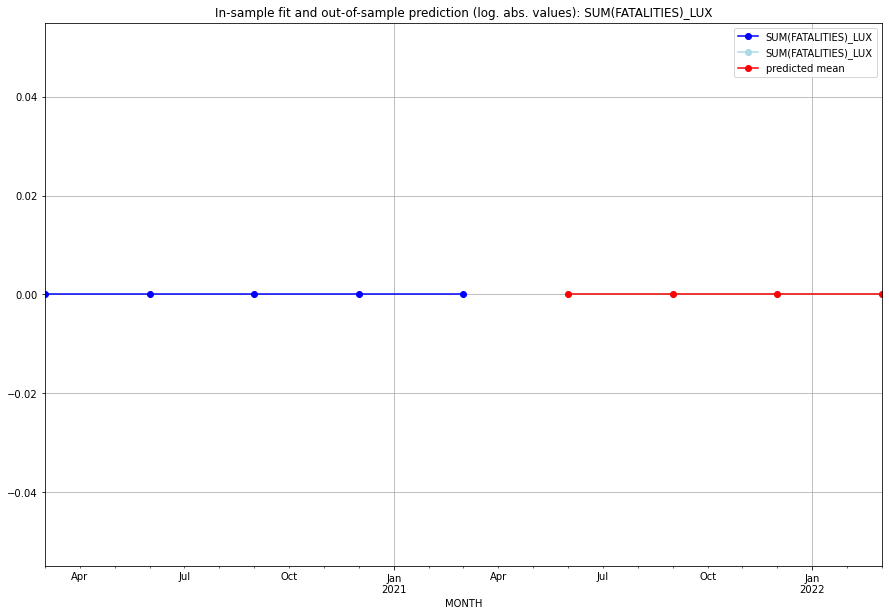

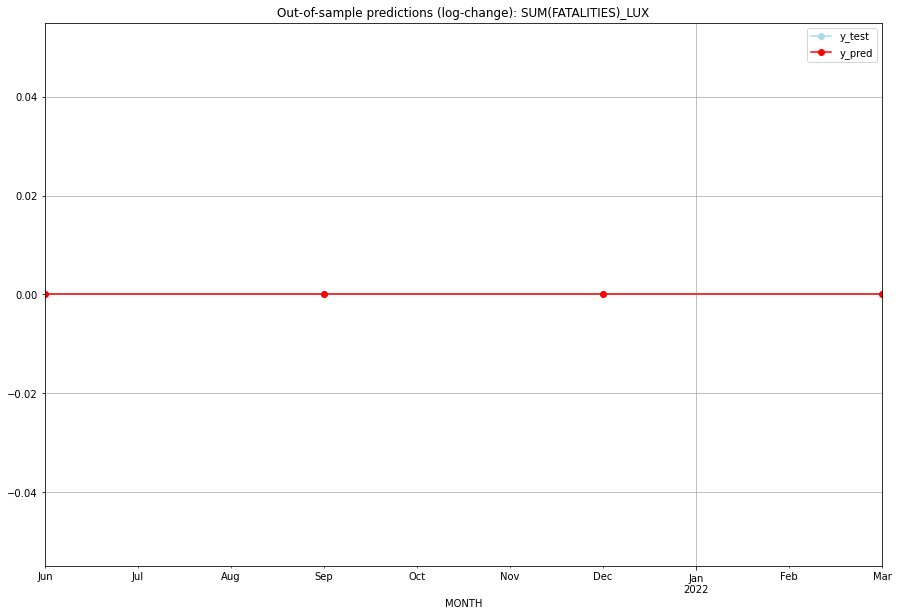

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   LUX   
1 2021-07-01       0.0         0.0           0.0             0.0   LUX   
2 2021-10-01       0.0         0.0           0.0             0.0   LUX   
3 2022-01-01       0.0         0.0           0.0             0.0   LUX   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:08
######## LVA (128/234) #########
0
Neighbor countries: []
Getting Data for LVA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 64)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


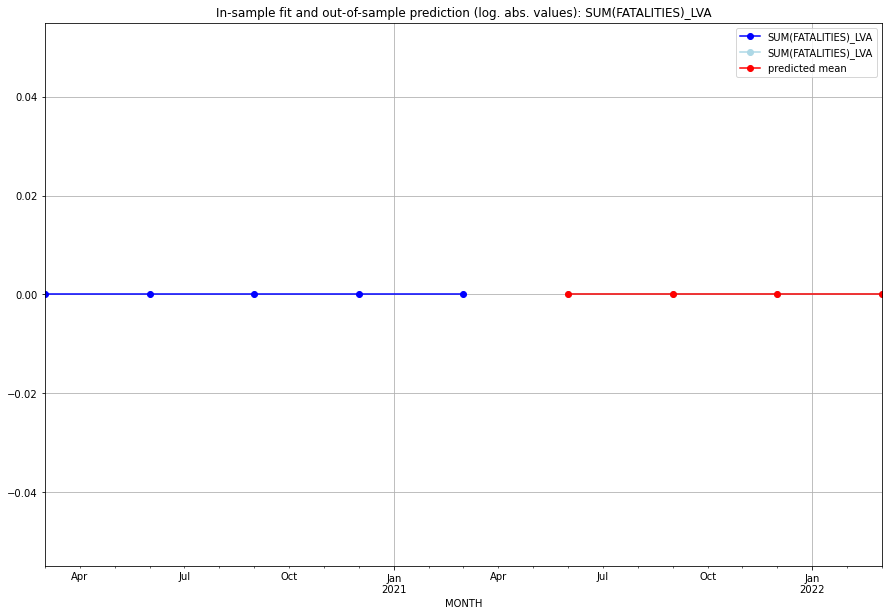

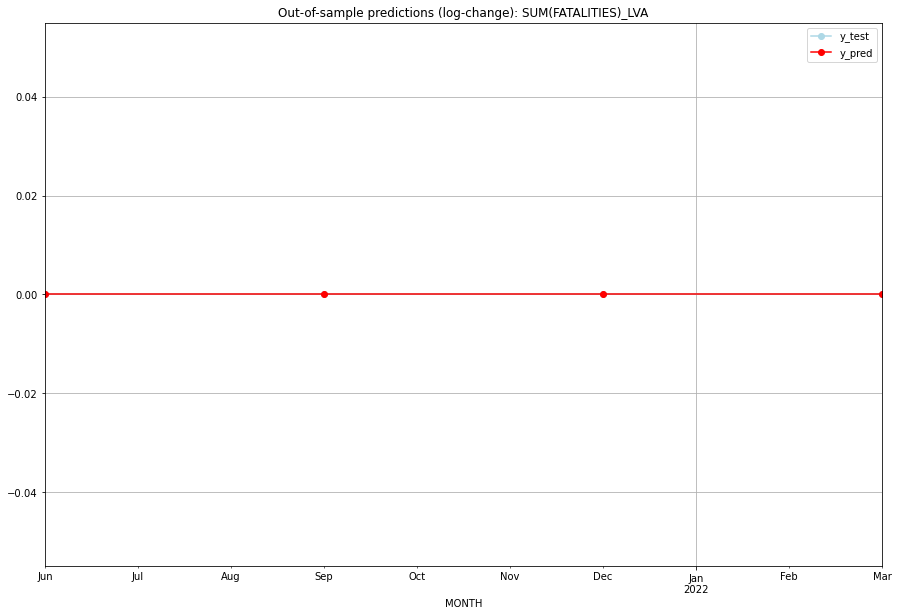

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   LVA   
1 2021-07-01       0.0         0.0           0.0             0.0   LVA   
2 2021-10-01       0.0         0.0           0.0             0.0   LVA   
3 2022-01-01       0.0         0.0           0.0             0.0   LVA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## MAC (129/234) #########
0
Neighbor countries: []
Getting Data for MAC
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 44)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MAC   No. Observations:                   13
Model

<Figure size 432x288 with 0 Axes>

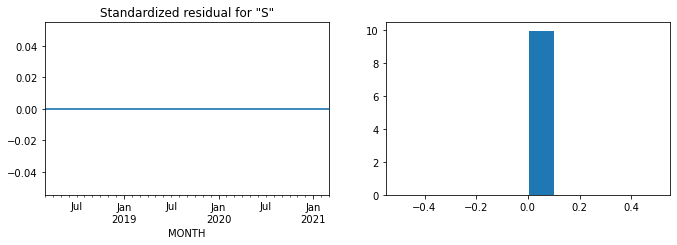

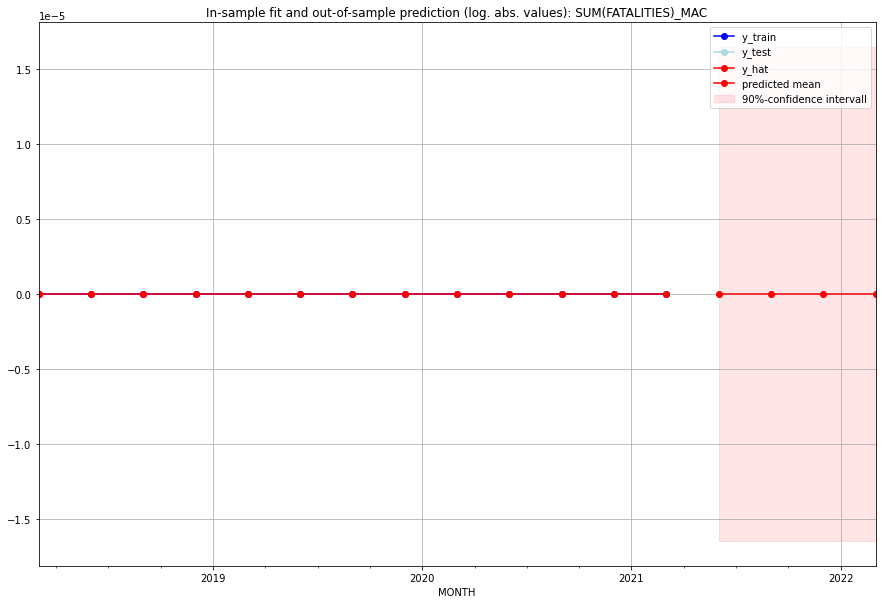

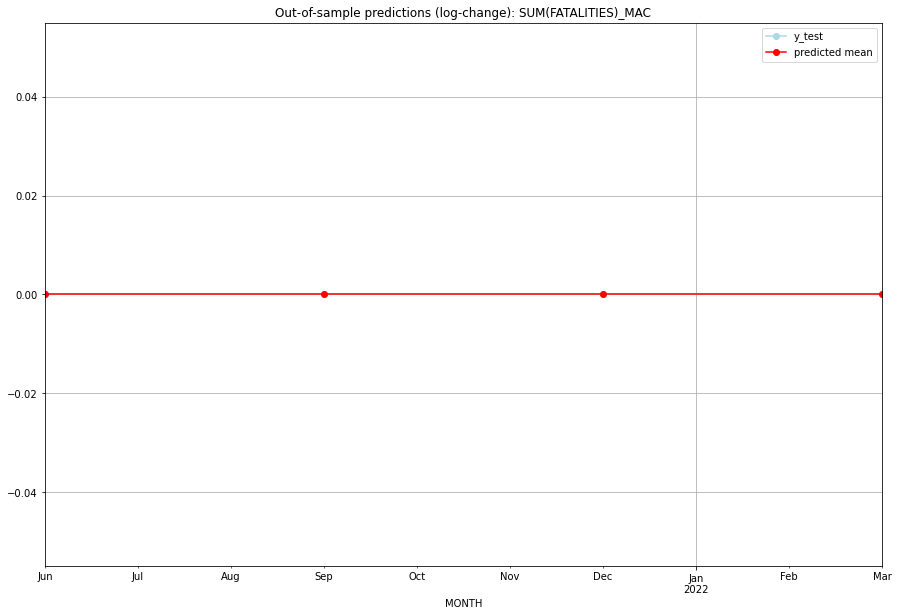

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MAC   
1 2021-07-01       0.0         0.0           0.0             0.0   MAC   
2 2021-10-01       0.0         0.0           0.0             0.0   MAC   
3 2022-01-01       0.0         0.0           0.0             0.0   MAC   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:04
######## MAR (130/234) #########
0
Neighbor countries: []
Getting Data for MAR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 63)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4329346376844968, 'fold_results': [0.34657359027997264, 0.5198603854199589, 0.8502993454155389, 0.44793986730701374, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MAR   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                -114.279
Date:                 Wed, 19 Oct 2022   AIC                            230.558
Time:                         10:47:20   BIC                            233.122
Sample:                     04-30-1997   HQIC                           231.594
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

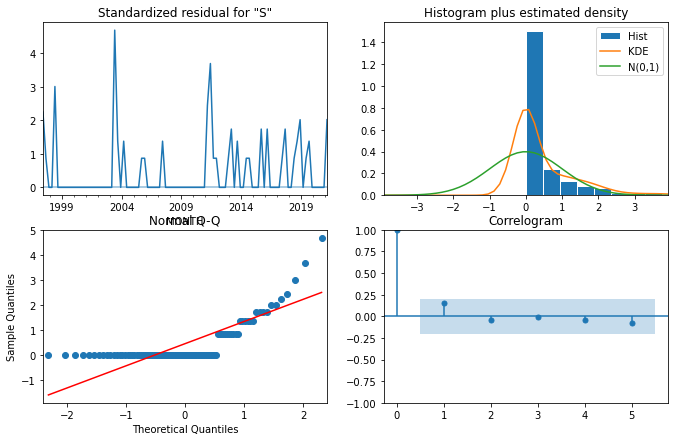

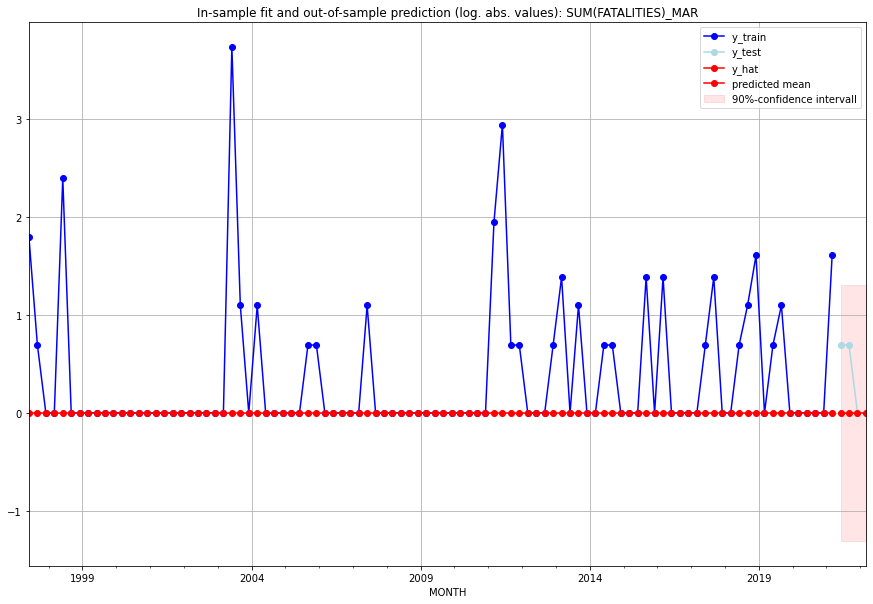

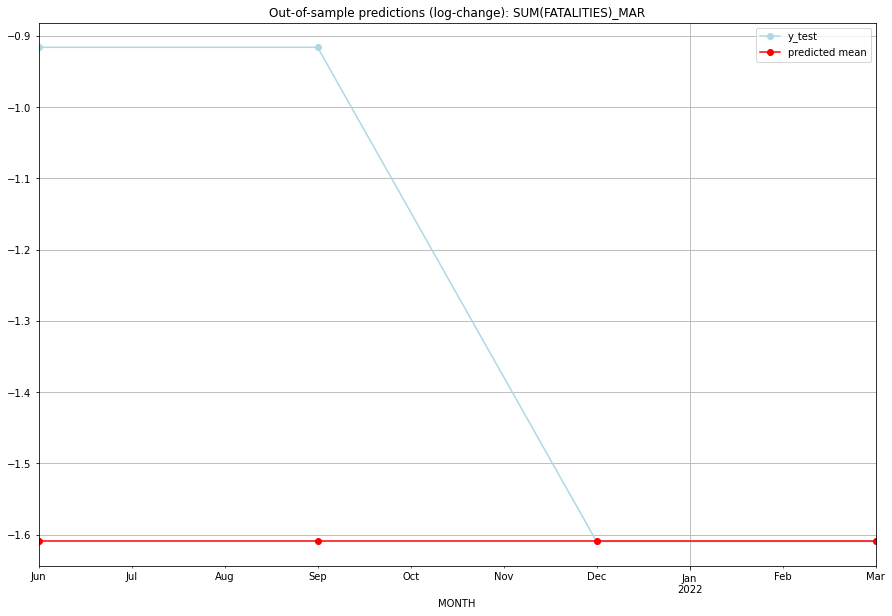

TADDA: 0.34657359027997264
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         1.0     -1.609438       -0.916291   MAR   
1 2021-07-01       0.0         1.0     -1.609438       -0.916291   MAR   
2 2021-10-01       0.0         0.0     -1.609438       -1.609438   MAR   
3 2022-01-01       0.0         0.0     -1.609438       -1.609438   MAR   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:24
######## MCO (131/234) #########
0
Neighbor countries: []
Getting Data for MCO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 15)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient 

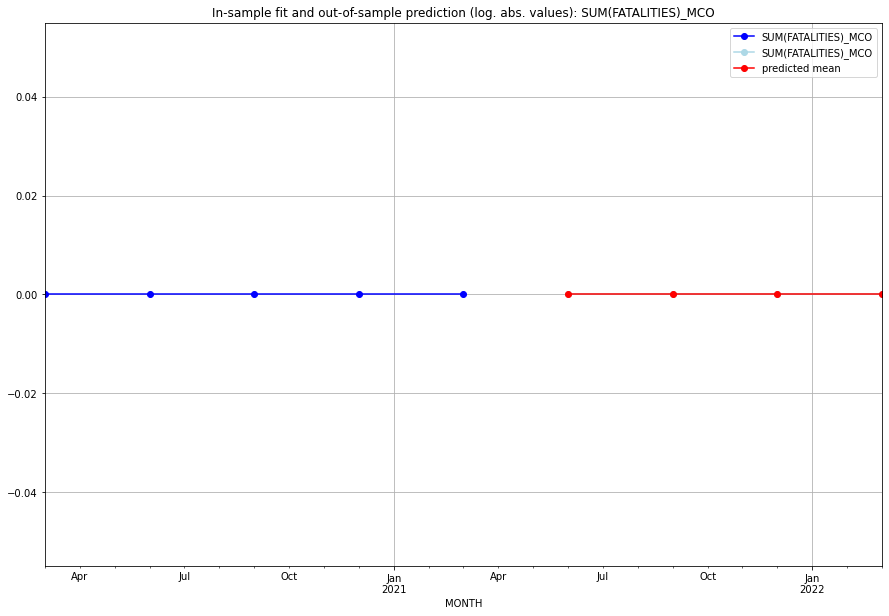

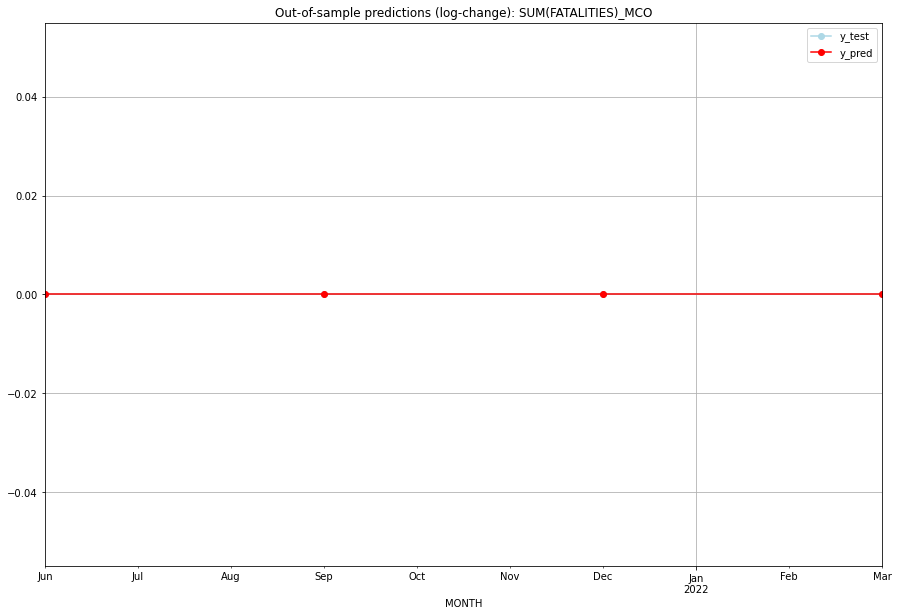

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MCO   
1 2021-07-01       0.0         0.0           0.0             0.0   MCO   
2 2021-10-01       0.0         0.0           0.0             0.0   MCO   
3 2022-01-01       0.0         0.0           0.0             0.0   MCO   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## MDA (132/234) #########
0
Neighbor countries: []
Getting Data for MDA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 62)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MDA   No. Observations:                   13
Model

<Figure size 432x288 with 0 Axes>

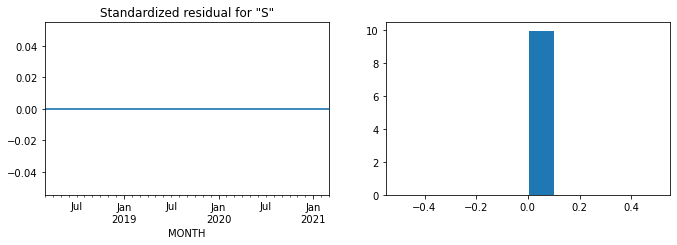

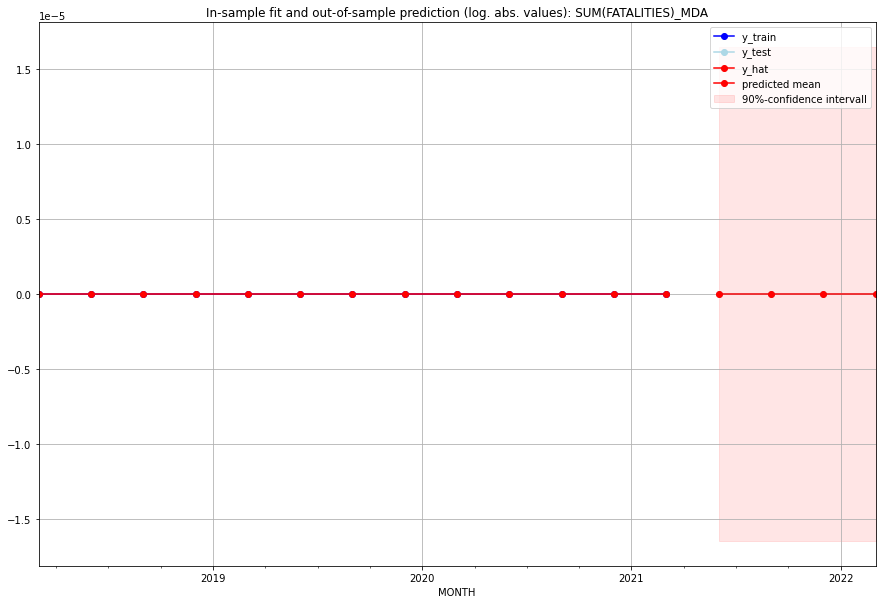

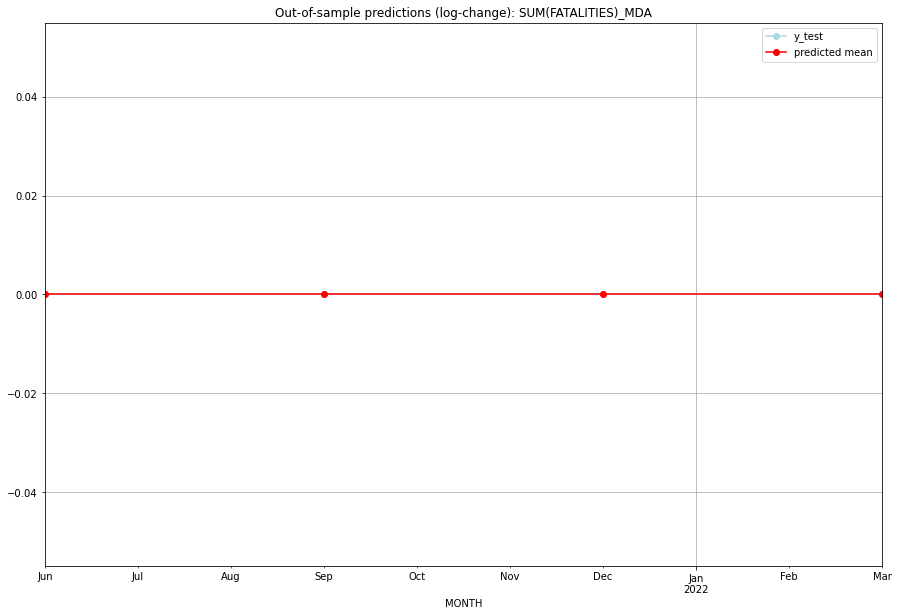

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MDA   
1 2021-07-01       0.0         0.0           0.0             0.0   MDA   
2 2021-10-01       0.0         0.0           0.0             0.0   MDA   
3 2022-01-01       0.0         0.0           0.0             0.0   MDA   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## MDG (133/234) #########
0
Neighbor countries: []
Getting Data for MDG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.40895855057820396, 'fold_results': [0.6548923296861379, 0.3060275865624794, 0.23193834764247712, 0.5391648461330554, 0.31276964286687026]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MDG   No. Observations:                   96
Model:                SARIMAX(3, 1, 2)   Log Likelihood                -135.032
Date:                 Wed, 19 Oct 2022   AIC                            288.064
Time:                         10:47:41   BIC                            311.049
Sample:                     04-30-1997   HQIC                           297.351
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

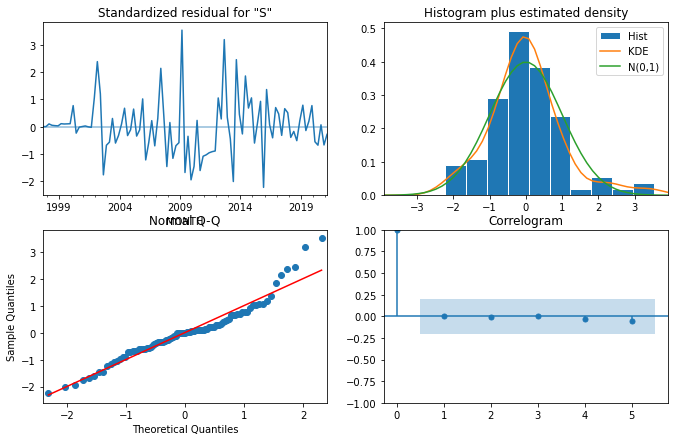

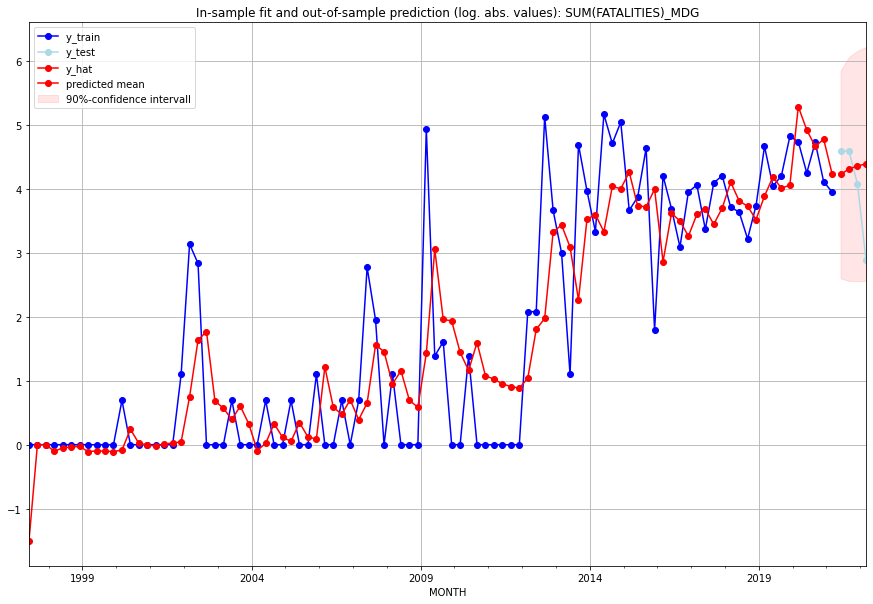

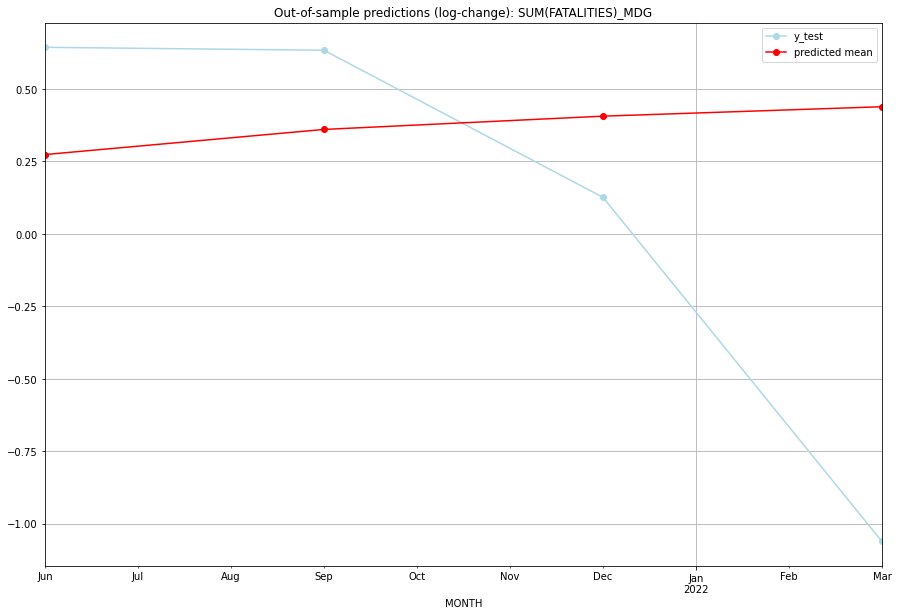

TADDA: 0.7154598250552755
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  67.385154        98.0      0.273912        0.643876   MDG   
1 2021-07-01  73.574418        97.0      0.360554        0.633724   MDG   
2 2021-10-01  77.066677        58.0      0.406320        0.126294   MDG   
3 2022-01-01  79.652309        17.0      0.438904       -1.060872   MDG   

                                          PARAMETERS  
0  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:18
######## MDV (134/234) #########
0
Neighbor countries: []
Getting Data for MDV
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 55)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insuffici

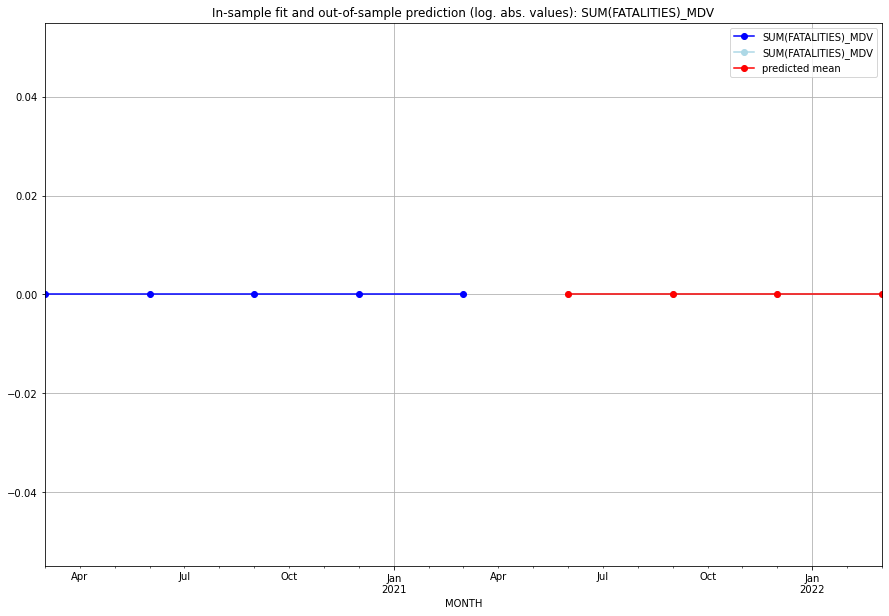

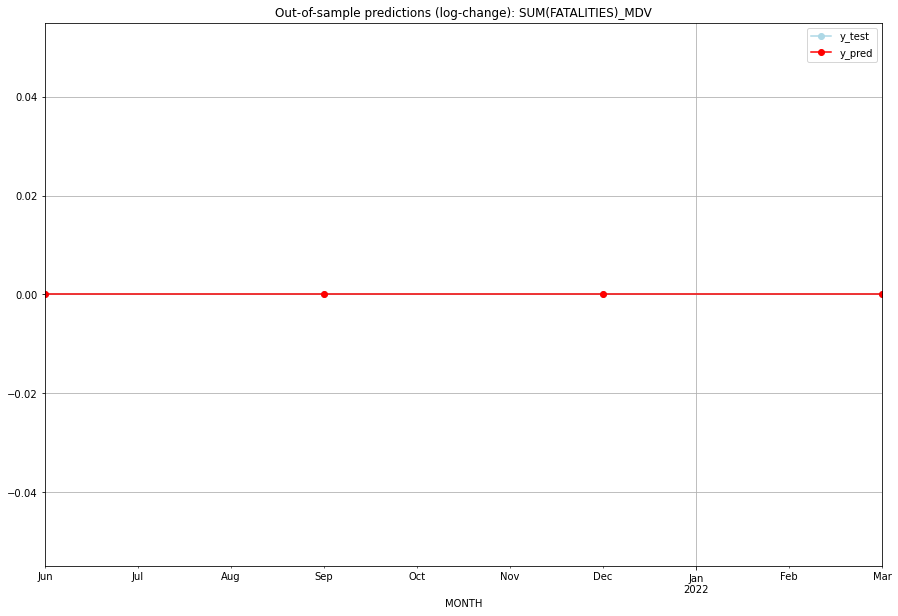

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MDV   
1 2021-07-01       0.0         0.0           0.0             0.0   MDV   
2 2021-10-01       0.0         0.0           0.0             0.0   MDV   
3 2022-01-01       0.0         0.0           0.0             0.0   MDV   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:05
######## MEX (135/234) #########
0
Neighbor countries: []
Getting Data for MEX
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 65)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.09319360067263871, 'fold_results': [0.11849602889239841, 0.06789117245287901]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MEX   No. Observations:                   13
Model:                SARIMAX(1, 0, 0)   Log Likelihood                   5.474
Date:                 Wed, 19 Oct 2022   AIC                             -6.948
Time:                         10:48:01   BIC                             -5.818
Sample:                     01-31-2018   HQIC                            -7.180
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9999     

<Figure size 432x288 with 0 Axes>

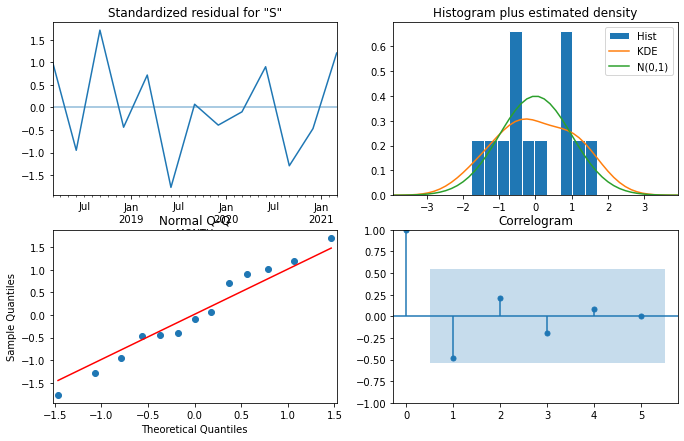

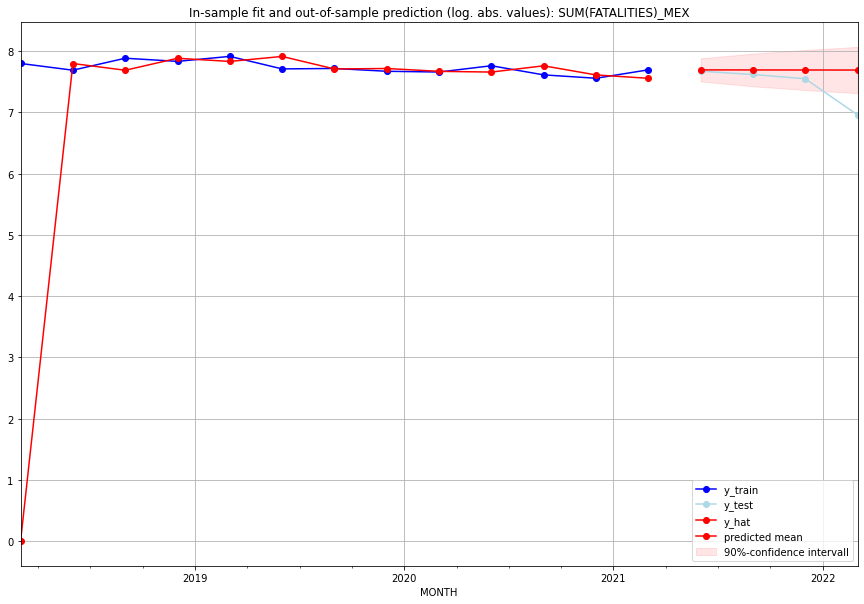

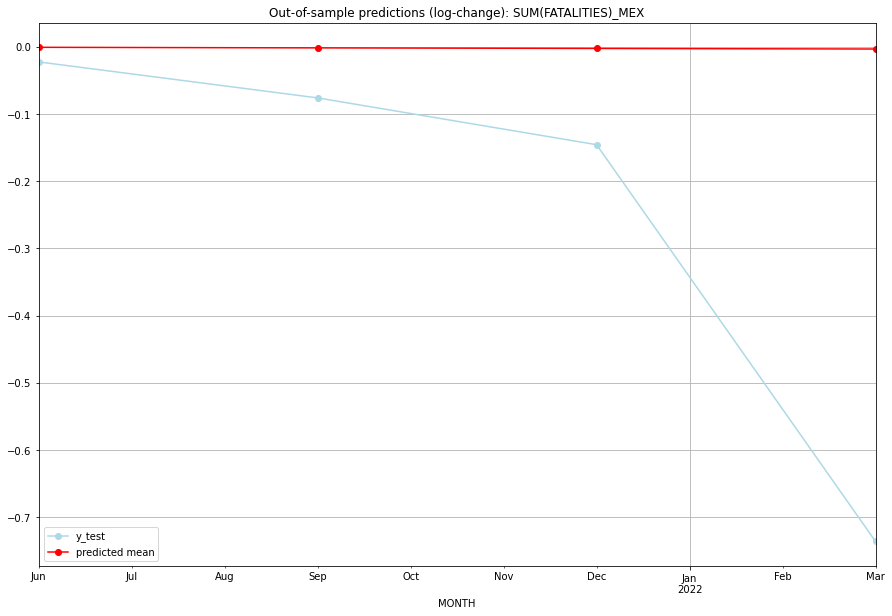

TADDA: 0.24293917452108094
Evaluation finished.
       MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2195.141766      2148.0     -0.000846       -0.022545   MEX   
1 2021-07-01  2193.285306      2036.0     -0.001691       -0.076070   MEX   
2 2021-10-01  2191.430620      1899.0     -0.002537       -0.145694   MEX   
3 2022-01-01  2189.577705      1052.0     -0.003383       -0.735905   MEX   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:11
######## MKD (136/234) #########
0
Neighbor countries: []
Getting Data for MKD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 62)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MKD   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:48:09   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.245      0.000       0.025       0

<Figure size 432x288 with 0 Axes>

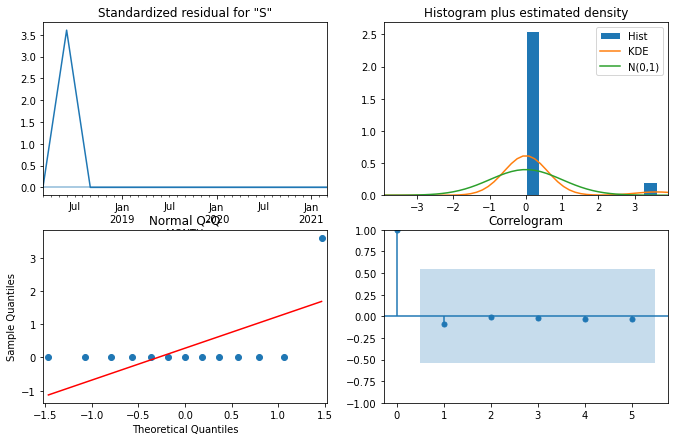

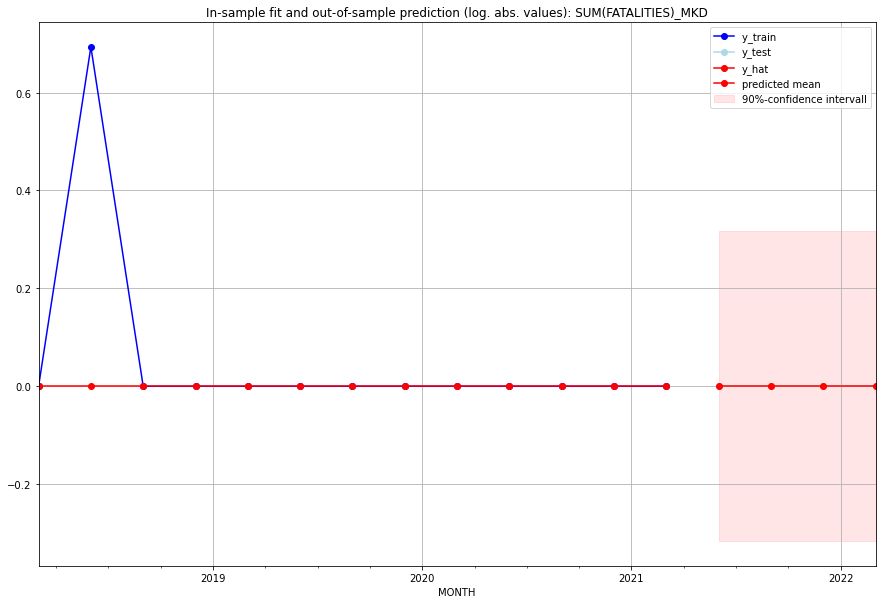

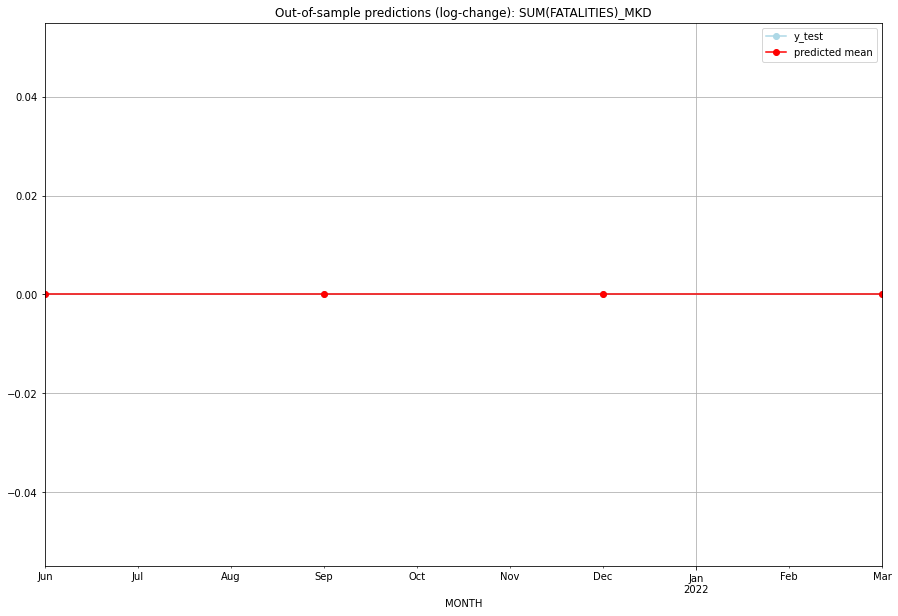

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MKD   
1 2021-07-01       0.0         0.0           0.0             0.0   MKD   
2 2021-10-01       0.0         0.0           0.0             0.0   MKD   
3 2022-01-01       0.0         0.0           0.0             0.0   MKD   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:05
######## MLI (137/234) #########
0
Neighbor countries: []
Getting Data for MLI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 param

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5752259569357879, 'fold_results': [0.33012554616390677, 1.0198335636514622, 0.7117067491805988, 0.22545909372759199, 0.5890048319553798]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MLI   No. Observations:                   96
Model:                SARIMAX(3, 1, 0)   Log Likelihood                -152.838
Date:                 Wed, 19 Oct 2022   AIC                            313.676
Time:                         10:48:25   BIC                            323.891
Sample:                     04-30-1997   HQIC                           317.804
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

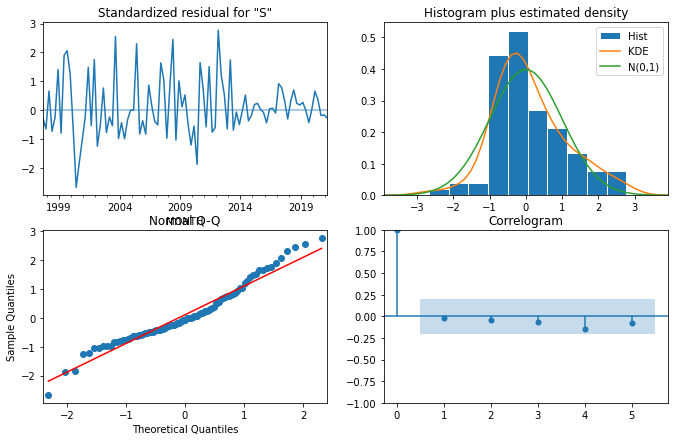

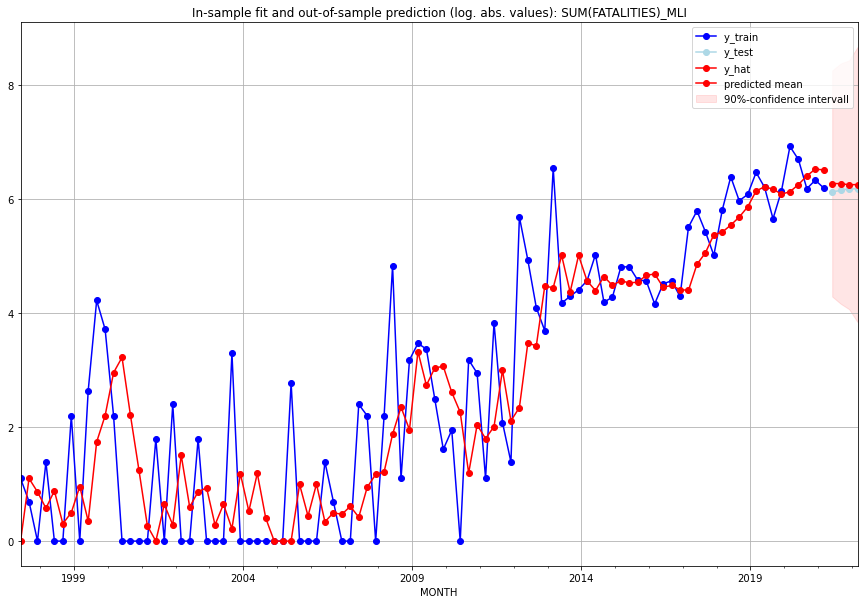

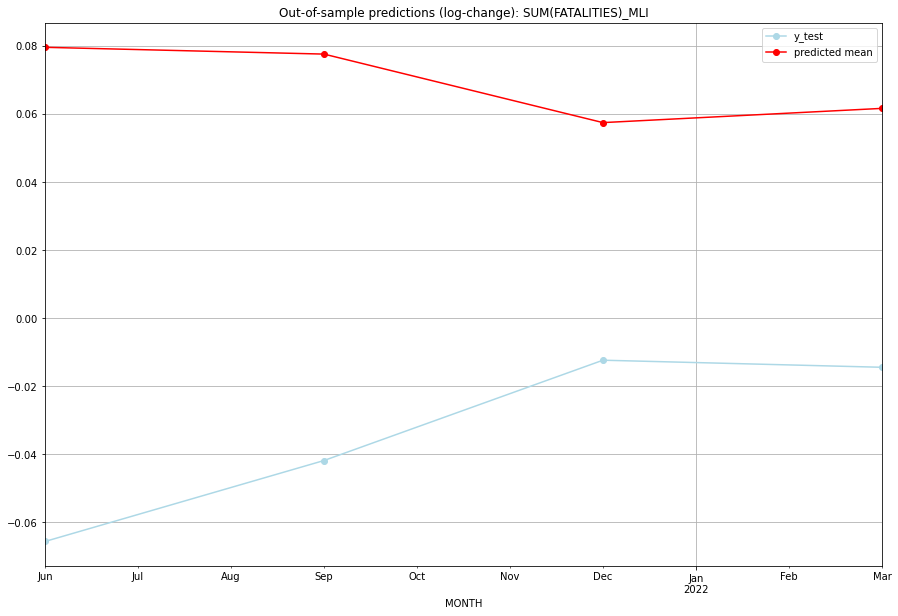

TADDA: 0.17166034776672645
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  527.410111       456.0      0.079557       -0.065632   MLI   
1 2021-07-01  526.357986       467.0      0.077564       -0.041847   MLI   
2 2021-10-01  515.849086       481.0      0.057436       -0.012371   MLI   
3 2022-01-01  518.013450       480.0      0.061614       -0.014448   MLI   

                                          PARAMETERS  
0  {'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## MLT (138/234) #########
0
Neighbor countries: []
Getting Data for MLT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 64)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Ins

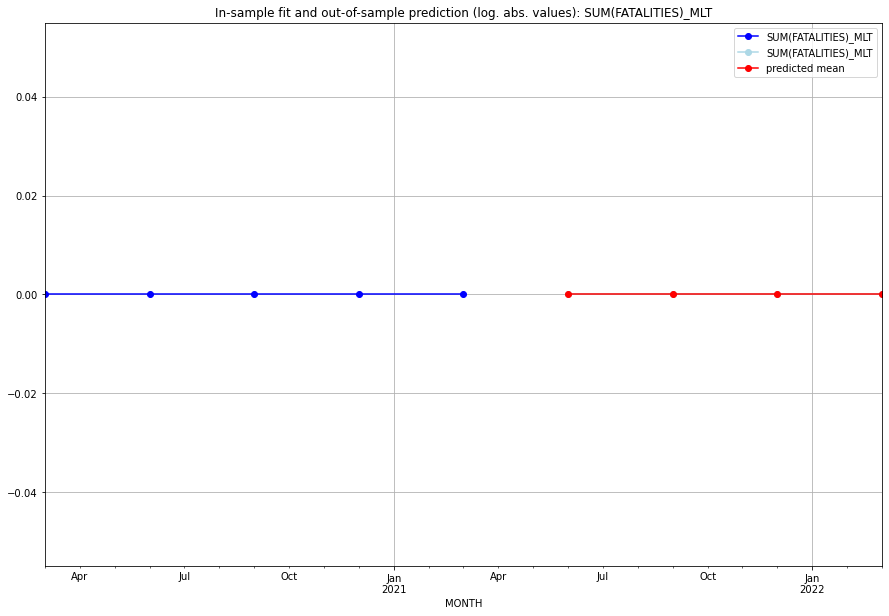

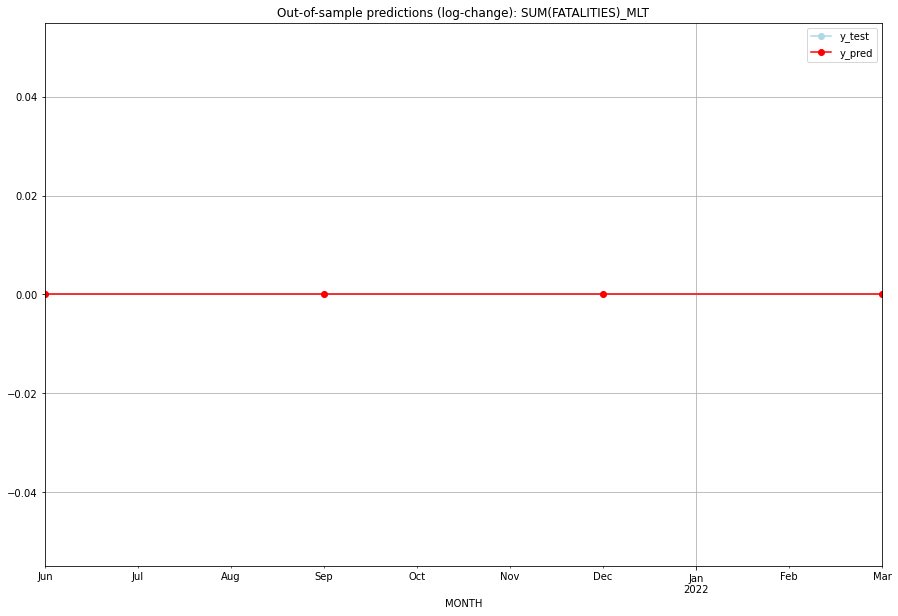

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MLT   
1 2021-07-01       0.0         0.0           0.0             0.0   MLT   
2 2021-10-01       0.0         0.0           0.0             0.0   MLT   
3 2022-01-01       0.0         0.0           0.0             0.0   MLT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## MMR (139/234) #########
0
Neighbor countries: []
Getting Data for MMR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 61)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8382573915454709, 'fold_results': [0.58848334258273, 1.3170815354506846, 0.21020633647039644, 1.5155939581051991, 0.559921785118344]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MMR   No. Observations:                   45
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -63.029
Date:                 Wed, 19 Oct 2022   AIC                            128.058
Time:                         10:48:50   BIC                            129.842
Sample:                     01-31-2010   HQIC                           128.720
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

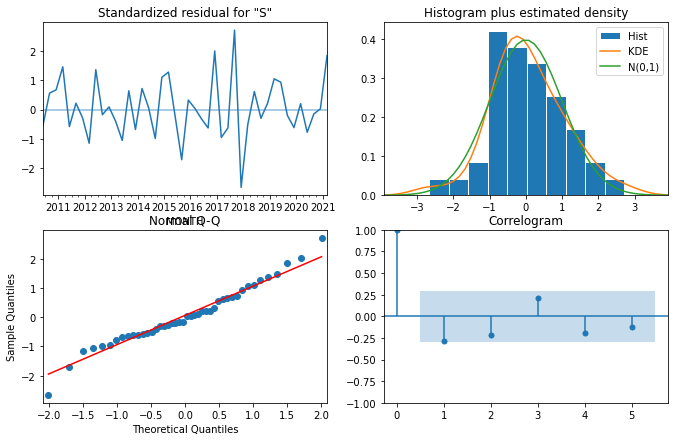

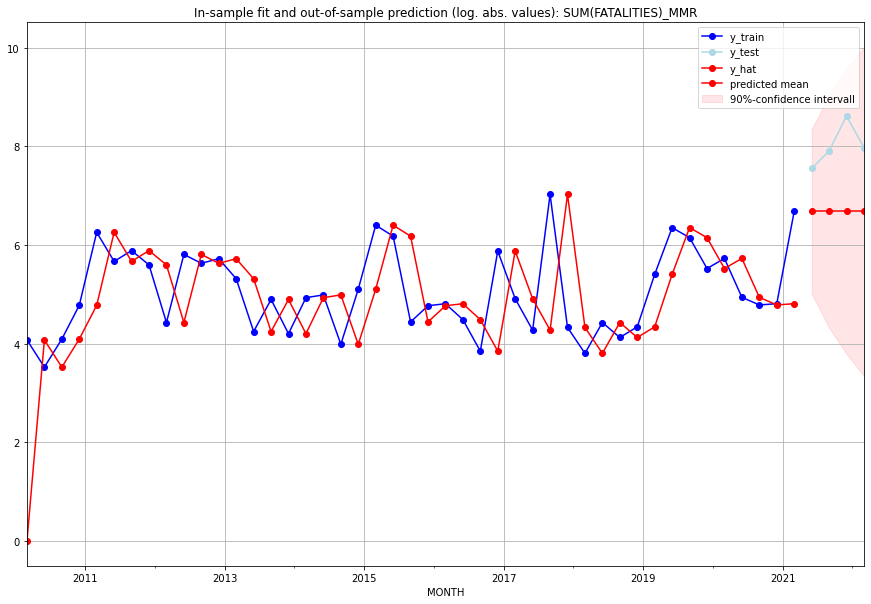

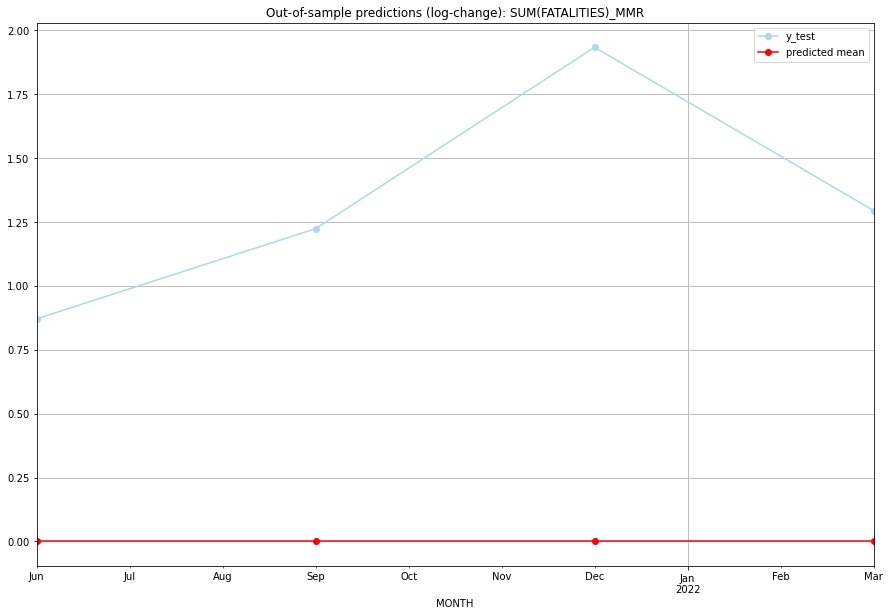

TADDA: 1.3305675037394713
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01     798.0      1908.0           0.0        0.870974   MMR   
1 2021-07-01     798.0      2715.0           0.0        1.223555   MMR   
2 2021-10-01     798.0      5521.0           0.0        1.933134   MMR   
3 2022-01-01     798.0      2915.0           0.0        1.294607   MMR   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## MNE (140/234) #########
0
Neighbor countries: []
Getting Data for MNE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 60)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MNE   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                  -2.997
Date:                 Wed, 19 Oct 2022   AIC                              7.993
Time:                         10:48:56   BIC                              8.558
Sample:                     01-31-2018   HQIC                             7.877
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0928      0.015      6.245      0.000       0.064       0

<Figure size 432x288 with 0 Axes>

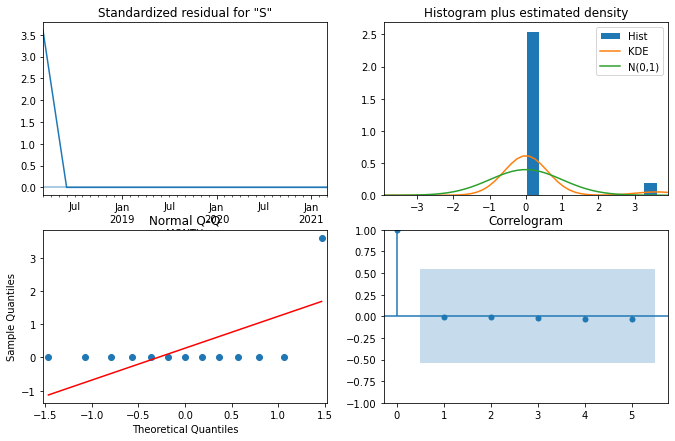

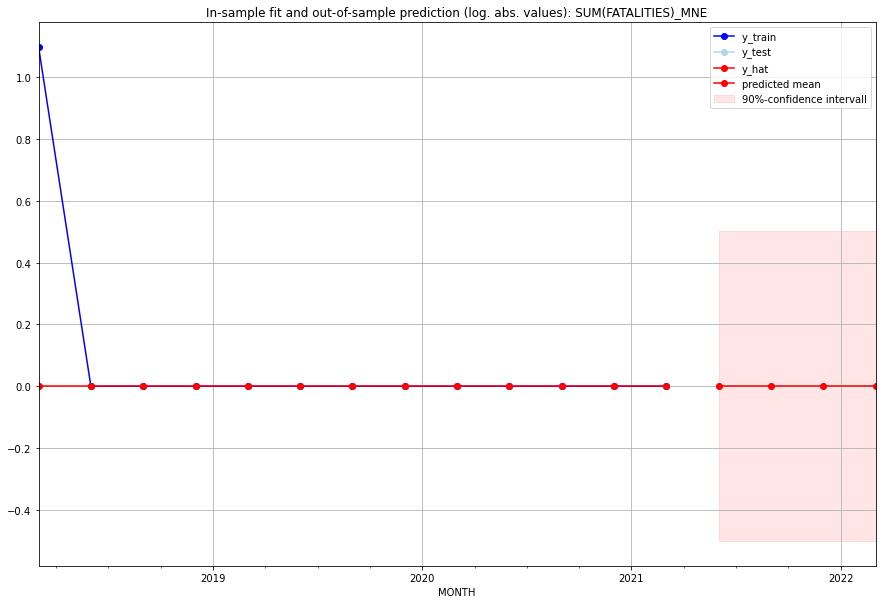

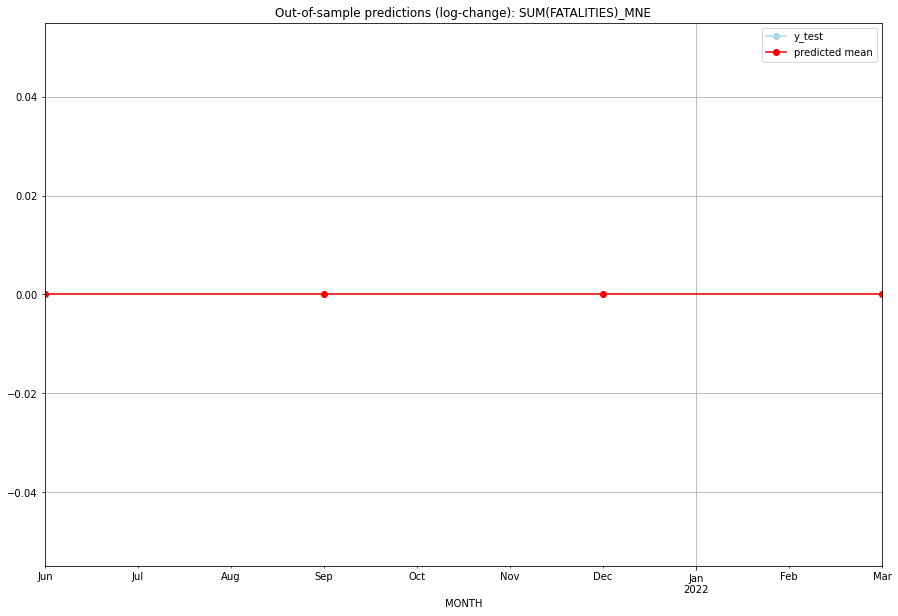

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MNE   
1 2021-07-01       0.0         0.0           0.0             0.0   MNE   
2 2021-10-01       0.0         0.0           0.0             0.0   MNE   
3 2022-01-01       0.0         0.0           0.0             0.0   MNE   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## MNG (141/234) #########
0
Neighbor countries: []
Getting Data for MNG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 62)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 paramet

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MNG   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                   2.991
Date:                 Wed, 19 Oct 2022   AIC                             -3.981
Time:                         10:49:05   BIC                             -3.416
Sample:                     01-31-2018   HQIC                            -4.097
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0370      0.006      6.245      0.000       0.025       0

<Figure size 432x288 with 0 Axes>

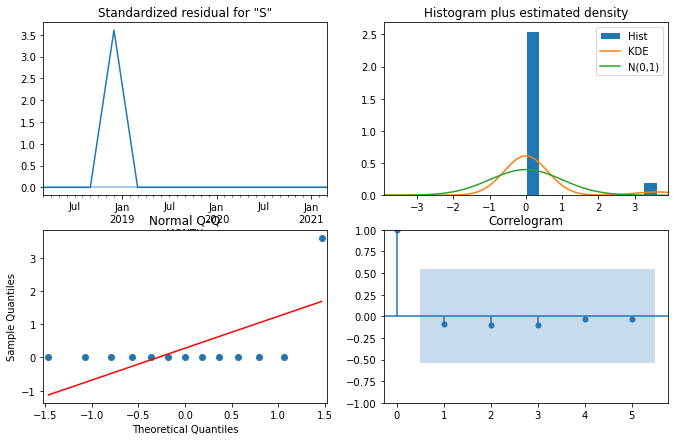

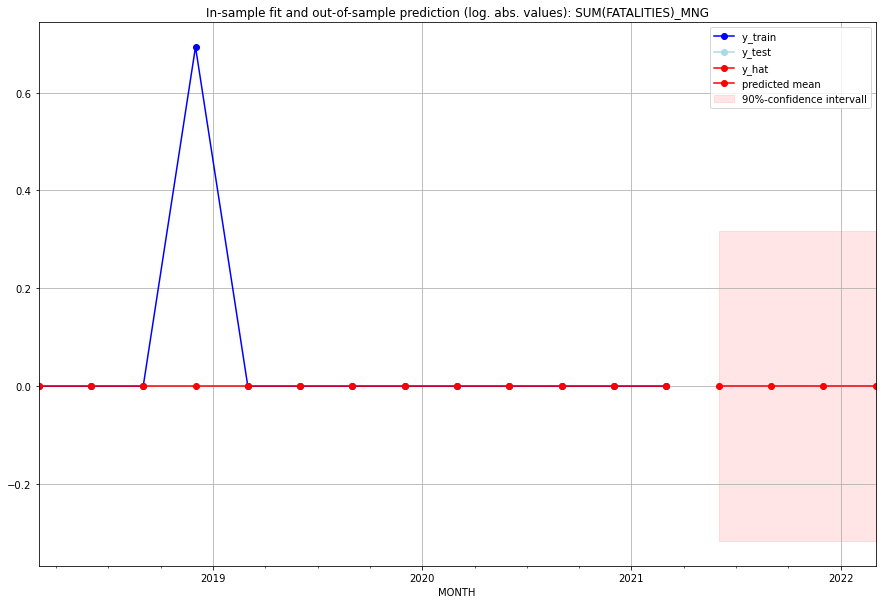

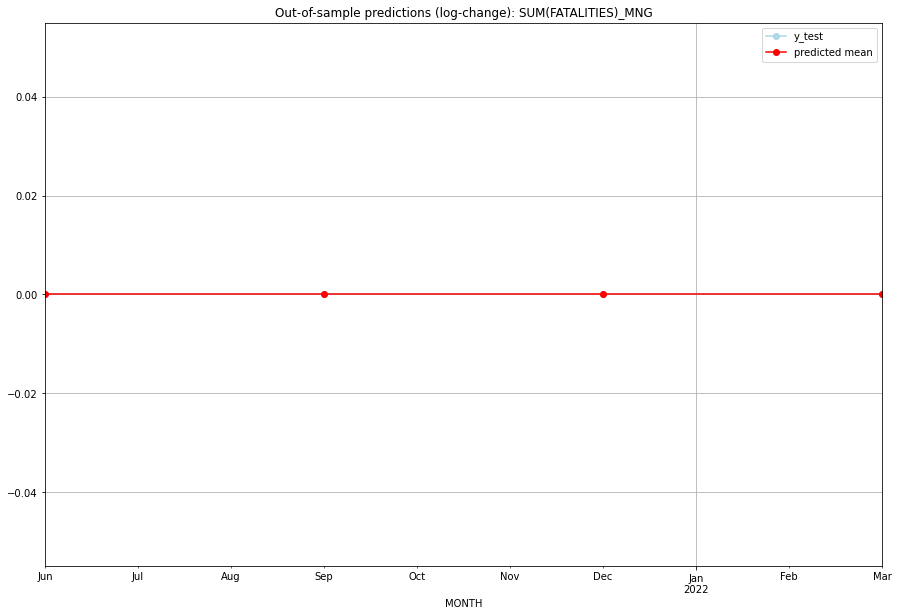

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MNG   
1 2021-07-01       0.0         0.0           0.0             0.0   MNG   
2 2021-10-01       0.0         0.0           0.0             0.0   MNG   
3 2022-01-01       0.0         0.0           0.0             0.0   MNG   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:06
######## MNP (142/234) #########
0
Neighbor countries: []
Getting Data for MNP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross va

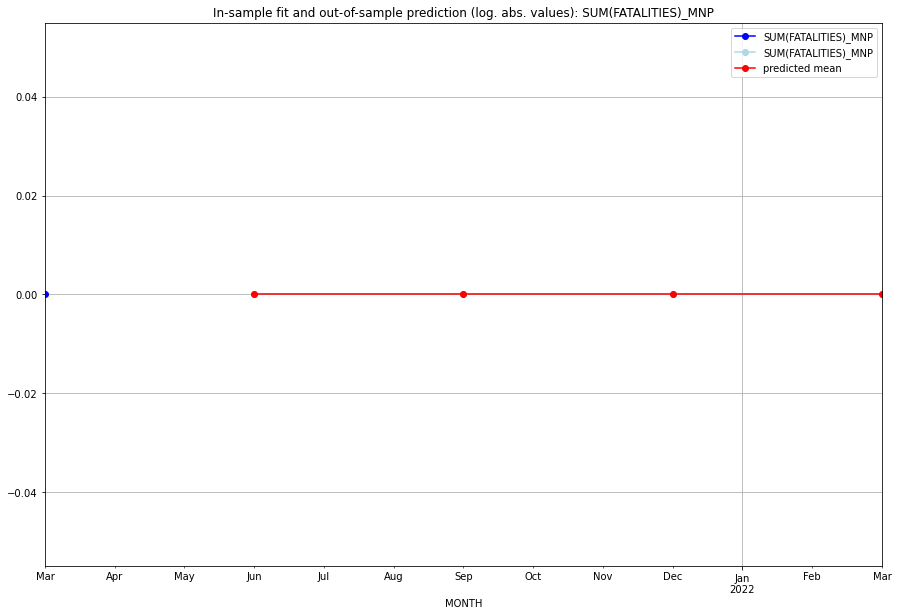

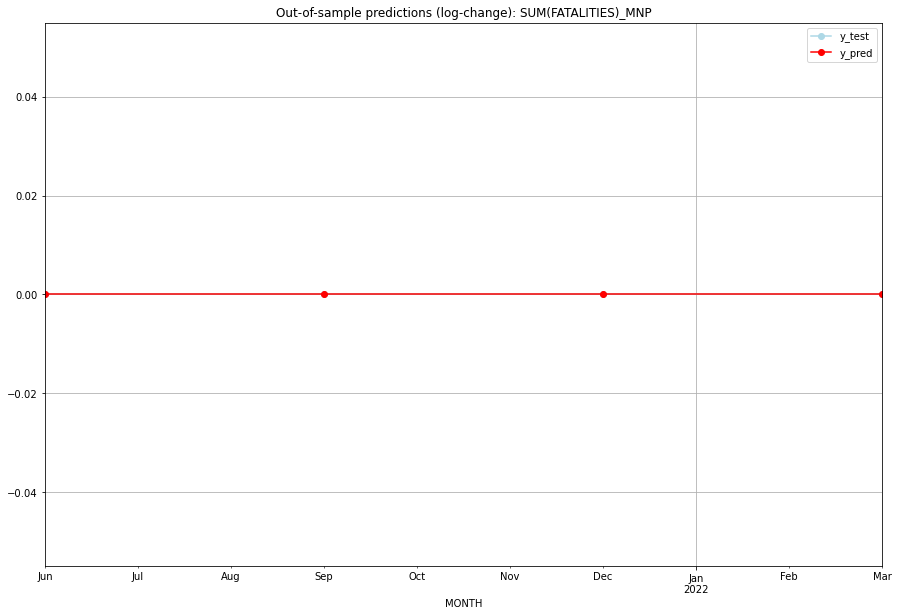

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MNP   
1 2021-07-01       0.0         0.0           0.0             0.0   MNP   
2 2021-10-01       0.0         0.0           0.0             0.0   MNP   
3 2022-01-01       0.0         0.0           0.0             0.0   MNP   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## MOZ (143/234) #########
0
Neighbor countries: []
Getting Data for MOZ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.7212017297603575, 'fold_results': [0.7819692575583999, 0.530907324660409, 0.7099635447256628, 0.9028679987976025, 0.680300523059713]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MOZ   No. Observations:                   96
Model:                SARIMAX(1, 1, 0)   Log Likelihood                -127.722
Date:                 Wed, 19 Oct 2022   AIC                            259.444
Time:                         10:49:29   BIC                            264.552
Sample:                     04-30-1997   HQIC                           261.508
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

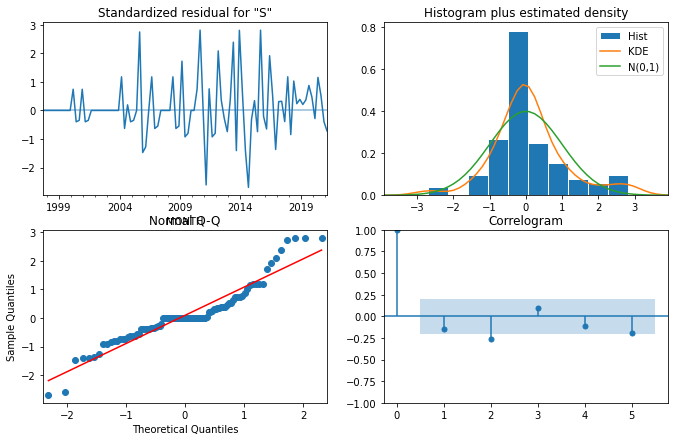

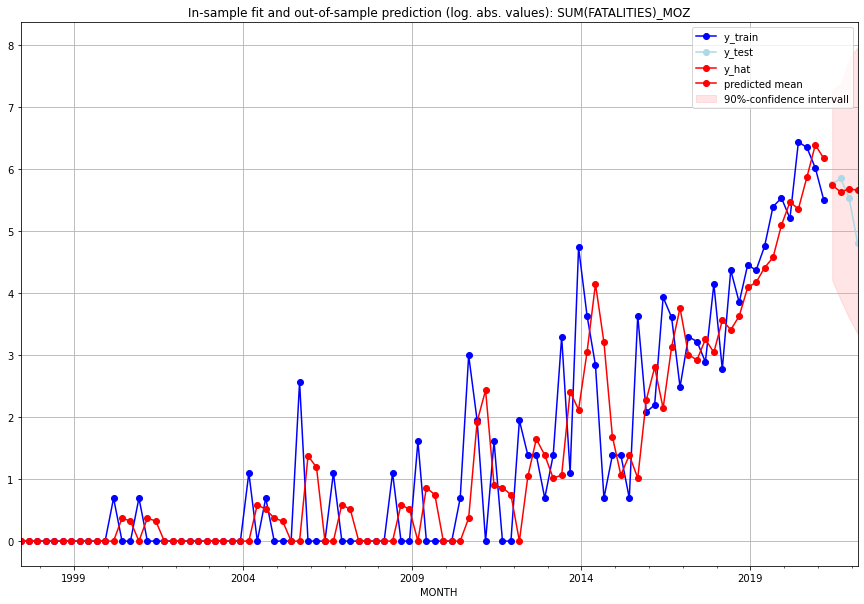

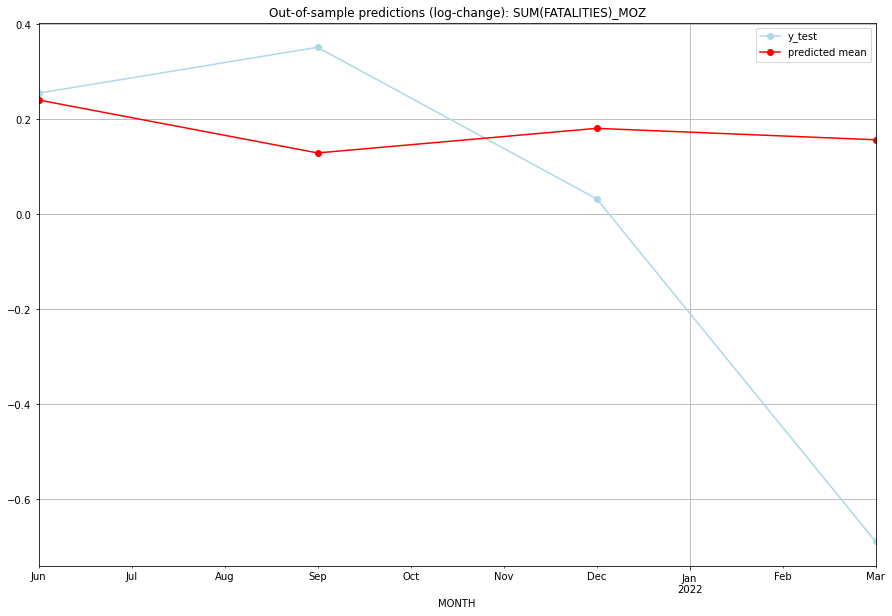

TADDA: 0.3466866505952064
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  310.481539       315.0      0.240082        0.254484   MOZ   
1 2021-07-01  277.641012       347.0      0.128666        0.350944   MOZ   
2 2021-10-01  292.427171       252.0      0.180371        0.032131   MOZ   
3 2022-01-01  285.470170       122.0      0.156376       -0.689074   MOZ   

                                          PARAMETERS  
0  {'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:23
######## MRT (144/234) #########
0
Neighbor countries: []
Getting Data for MRT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 60)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV o

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3786251492510192, 'fold_results': [0.0, 0.27465307216702745, 0.44793986730701374, 0.4479398673070139, 0.7225929394740411]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MRT   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -142.129
Date:                 Wed, 19 Oct 2022   AIC                            288.259
Time:                         10:49:48   BIC                            293.366
Sample:                     04-30-1997   HQIC                           290.322
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

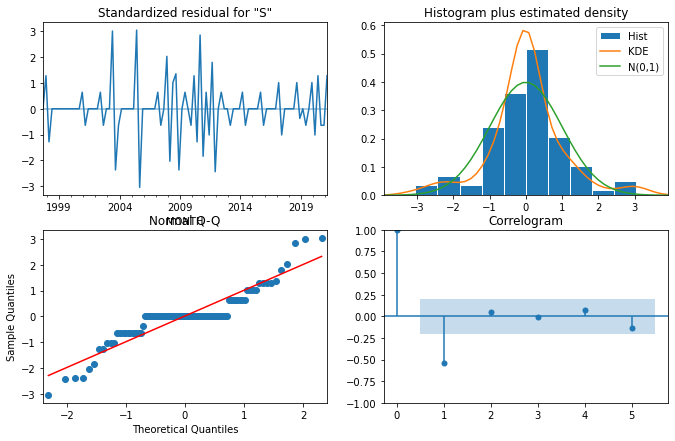

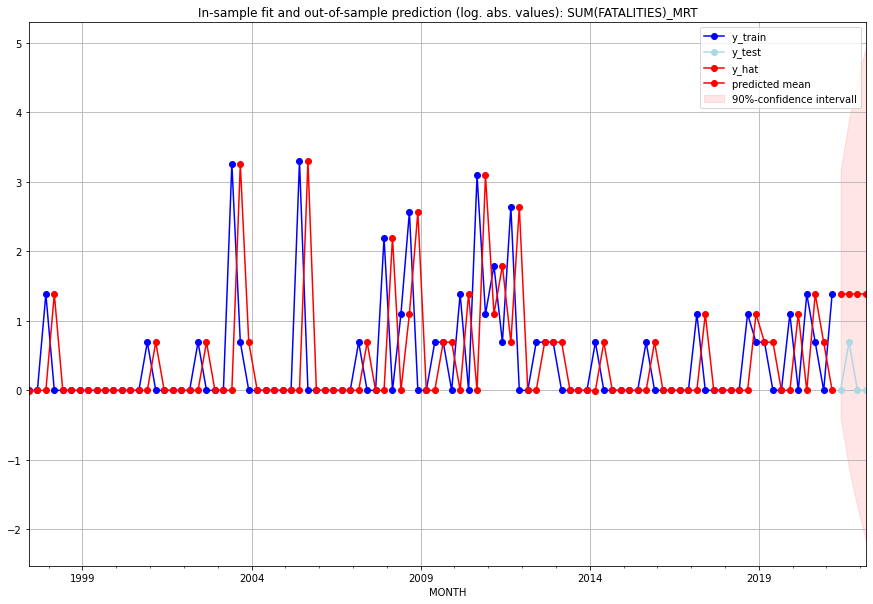

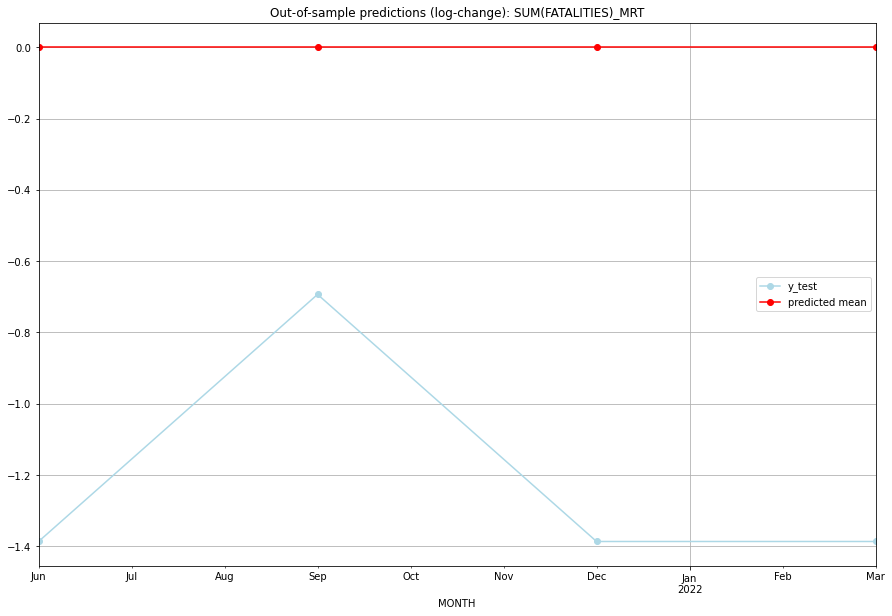

TADDA: 1.2130075659799042
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       3.0         0.0           0.0       -1.386294   MRT   
1 2021-07-01       3.0         1.0           0.0       -0.693147   MRT   
2 2021-10-01       3.0         0.0           0.0       -1.386294   MRT   
3 2022-01-01       3.0         0.0           0.0       -1.386294   MRT   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## MSR (145/234) #########
0
Neighbor countries: []
Getting Data for MSR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient da

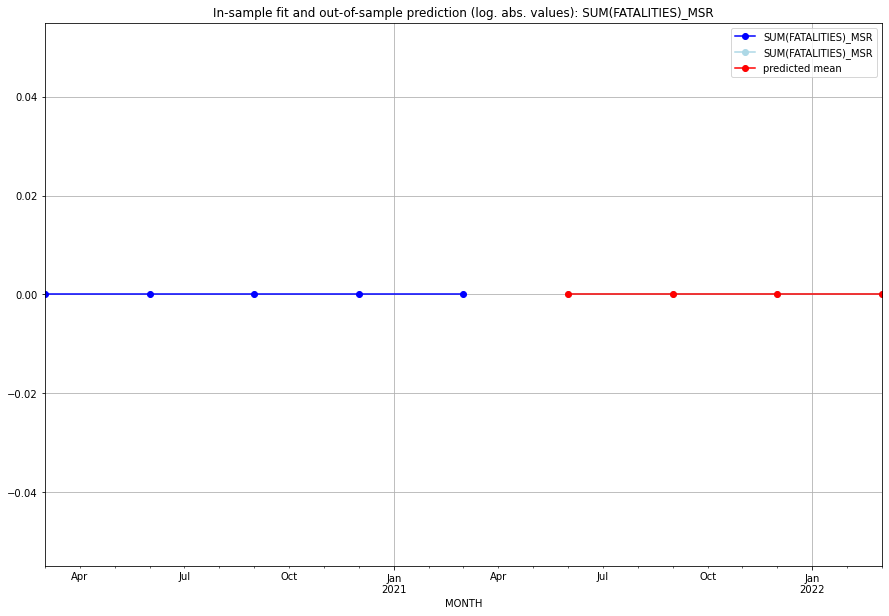

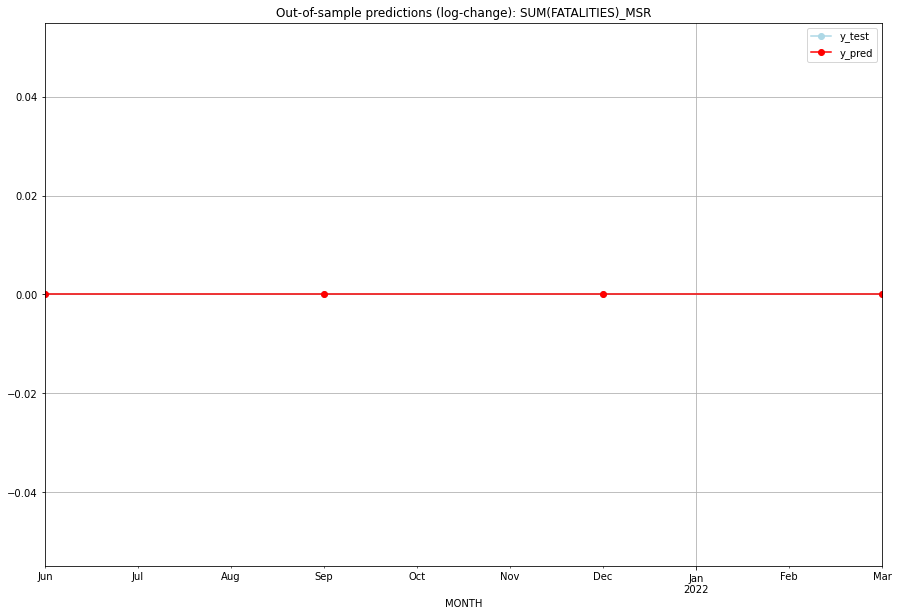

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MSR   
1 2021-07-01       0.0         0.0           0.0             0.0   MSR   
2 2021-10-01       0.0         0.0           0.0             0.0   MSR   
3 2022-01-01       0.0         0.0           0.0             0.0   MSR   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:07
######## MTQ (146/234) #########
0
Neighbor countries: []
Getting Data for MTQ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MTQ   No. Observations:                   13
Model:

<Figure size 432x288 with 0 Axes>

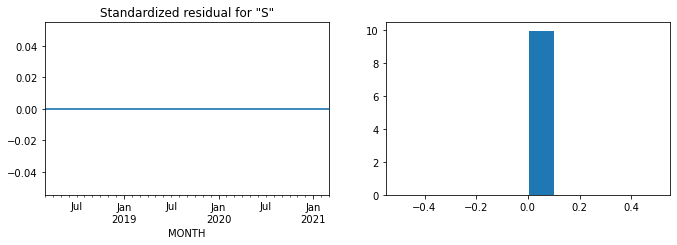

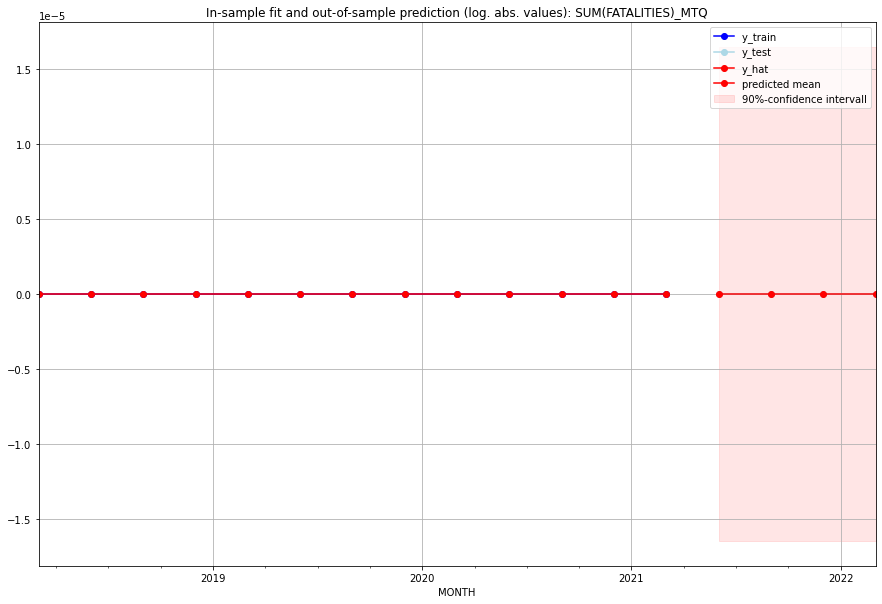

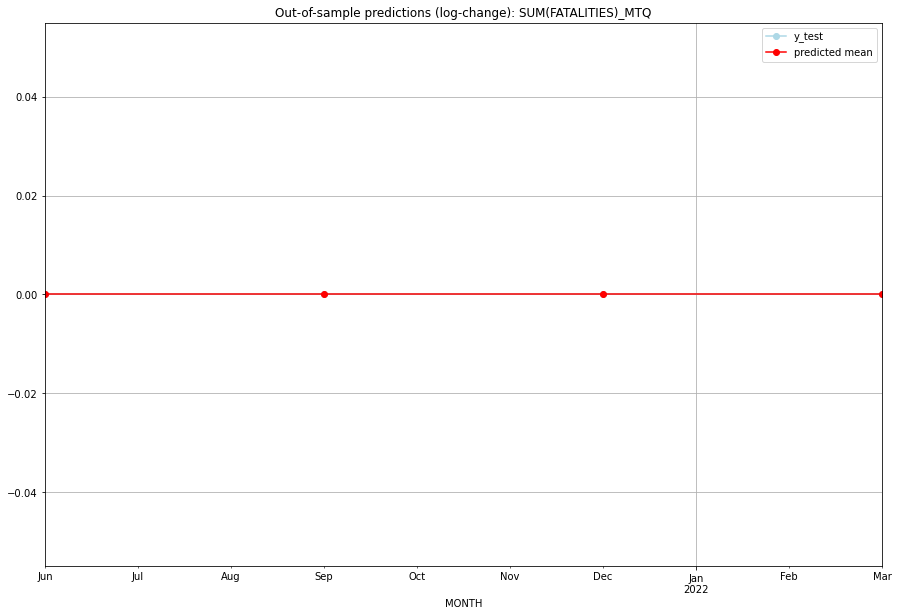

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   MTQ   
1 2021-07-01       0.0         0.0           0.0             0.0   MTQ   
2 2021-10-01       0.0         0.0           0.0             0.0   MTQ   
3 2022-01-01       0.0         0.0           0.0             0.0   MTQ   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## MUS (147/234) #########
0
Neighbor countries: []
Getting Data for MUS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 62)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.06931471805599453, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.34657359027997264]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MUS   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                  65.322
Date:                 Wed, 19 Oct 2022   AIC                           -128.645
Time:                         10:50:48   BIC                           -126.081
Sample:                     04-30-1997   HQIC                          -127.608
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0150      

<Figure size 432x288 with 0 Axes>

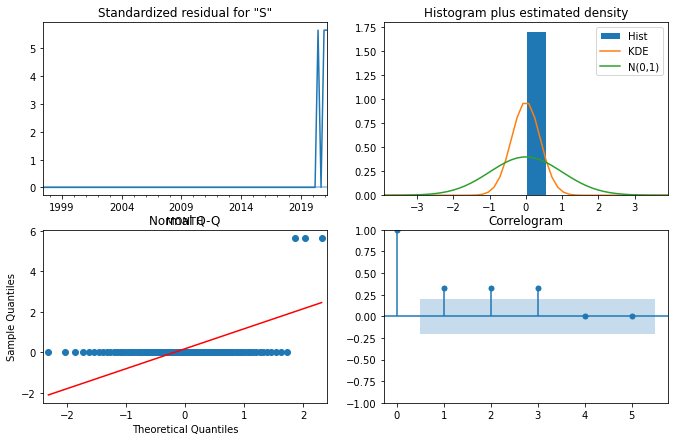

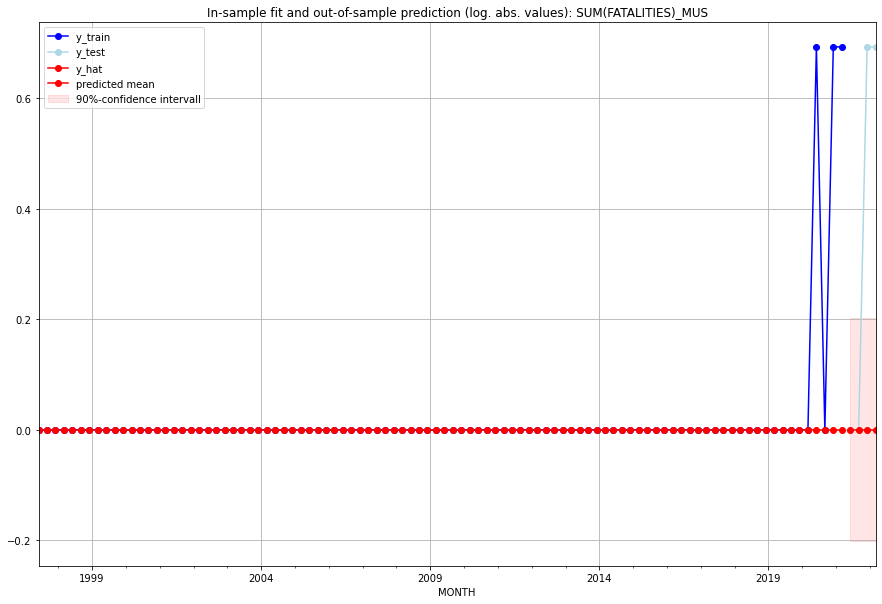

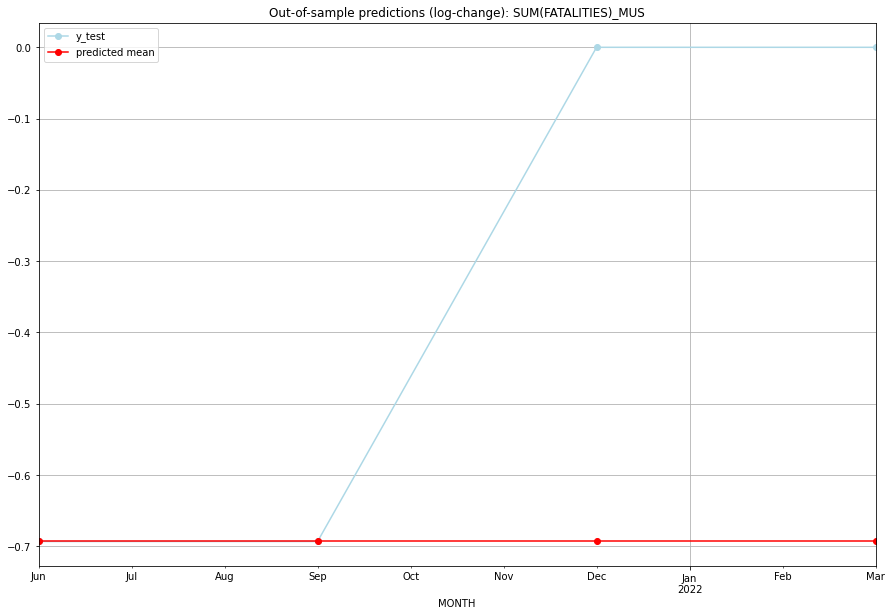

TADDA: 0.34657359027997264
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0     -0.693147       -0.693147   MUS   
1 2021-07-01       0.0         0.0     -0.693147       -0.693147   MUS   
2 2021-10-01       0.0         1.0     -0.693147        0.000000   MUS   
3 2022-01-01       0.0         1.0     -0.693147        0.000000   MUS   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:48
######## MWI (148/234) #########
0
Neighbor countries: []
Getting Data for MWI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 57)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.851163723593688, 'fold_results': [1.172581998582099, 0.6181210324473607, 0.5037257551355664, 1.3834708594652012, 0.5779189723382119]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MWI   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -119.478
Date:                 Wed, 19 Oct 2022   AIC                            240.957
Time:                         10:51:16   BIC                            243.511
Sample:                     04-30-1997   HQIC                           241.989
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

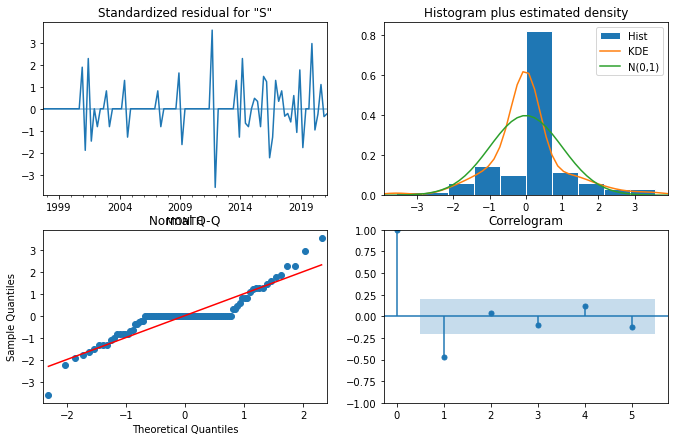

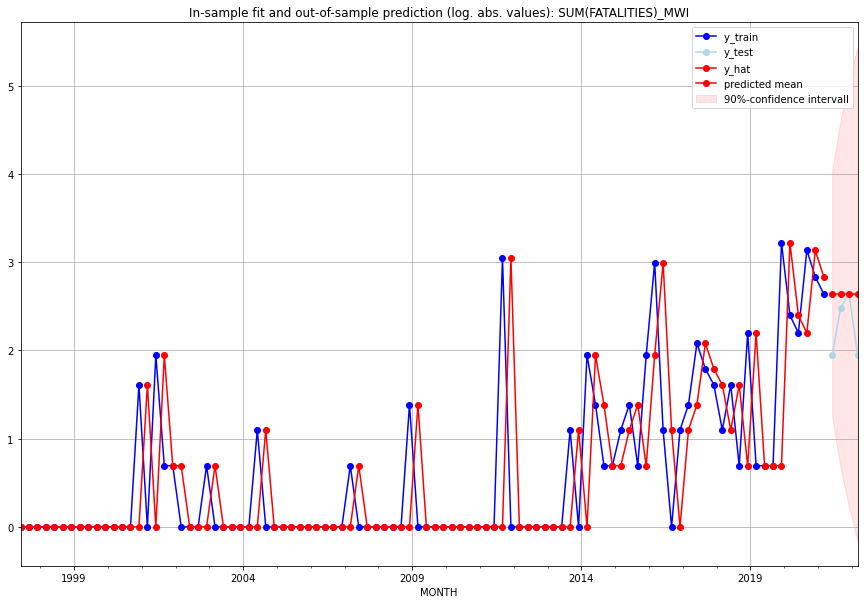

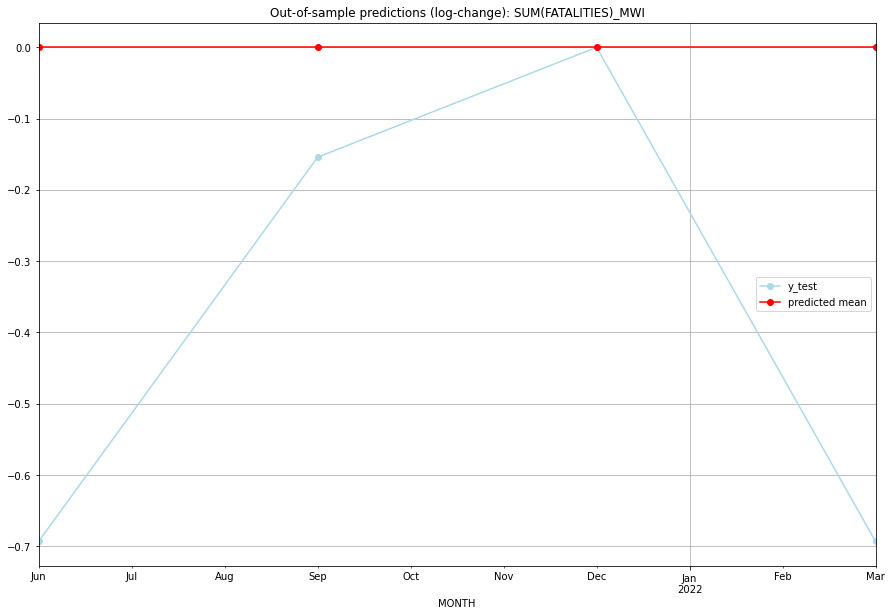

TADDA: 0.3851112602367873
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01      13.0         6.0           0.0       -0.693147   MWI   
1 2021-07-01      13.0        11.0           0.0       -0.154151   MWI   
2 2021-10-01      13.0        13.0           0.0        0.000000   MWI   
3 2022-01-01      13.0         6.0           0.0       -0.693147   MWI   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:26
######## MYS (149/234) #########
0
Neighbor countries: []
Getting Data for MYS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 63)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.6868833400350294, 'fold_results': [0.6868833400350294, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MYS   No. Observations:                   13
Model:                SARIMAX(2, 0, 2)   Log Likelihood                 -10.899
Date:                 Wed, 19 Oct 2022   AIC                             31.798
Time:                         10:51:23   BIC                             34.623
Sample:                     01-31-2018   HQIC                            31.217
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9606      0.634      1.515 

<Figure size 432x288 with 0 Axes>

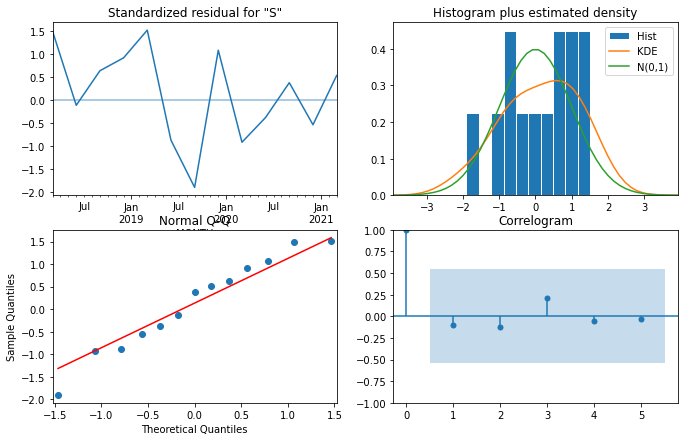

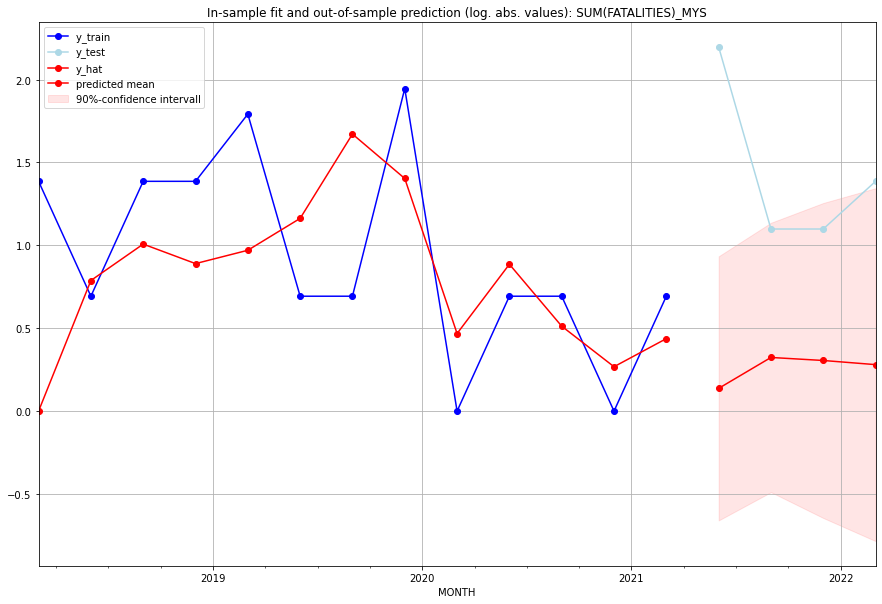

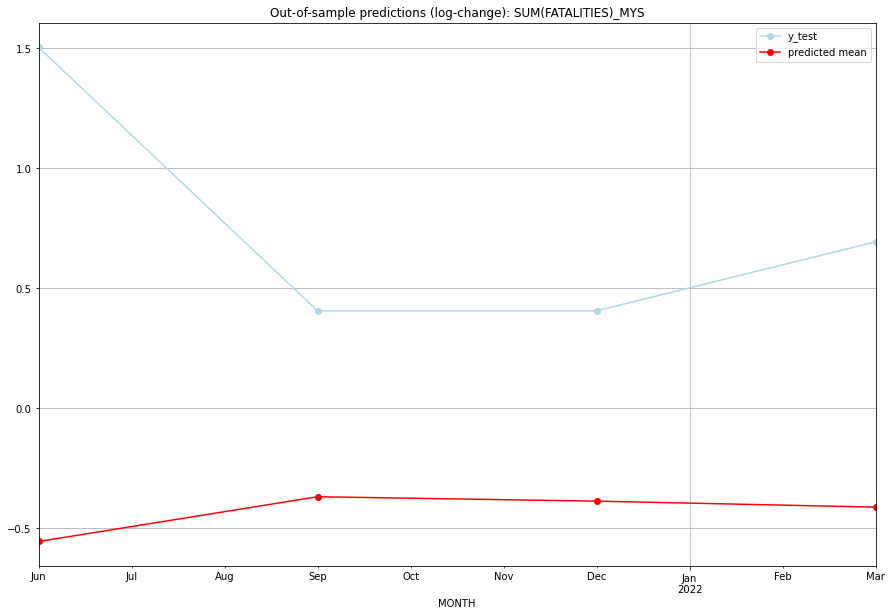

TADDA: 1.6150540901186758
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.146976         8.0     -0.556018        1.504077   MYS   
1 2021-07-01  0.382177         2.0     -0.369488        0.405465   MYS   
2 2021-10-01  0.357163         2.0     -0.387750        0.405465   MYS   
3 2022-01-01  0.323623         3.0     -0.412774        0.693147   MYS   

                                          PARAMETERS  
0  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## MYT (150/234) #########
0
Neighbor countries: []
Getting Data for MYT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV nec

<Figure size 432x288 with 0 Axes>

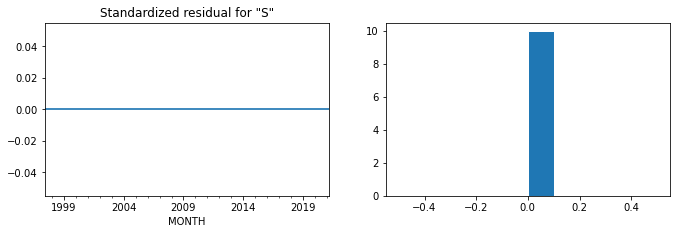

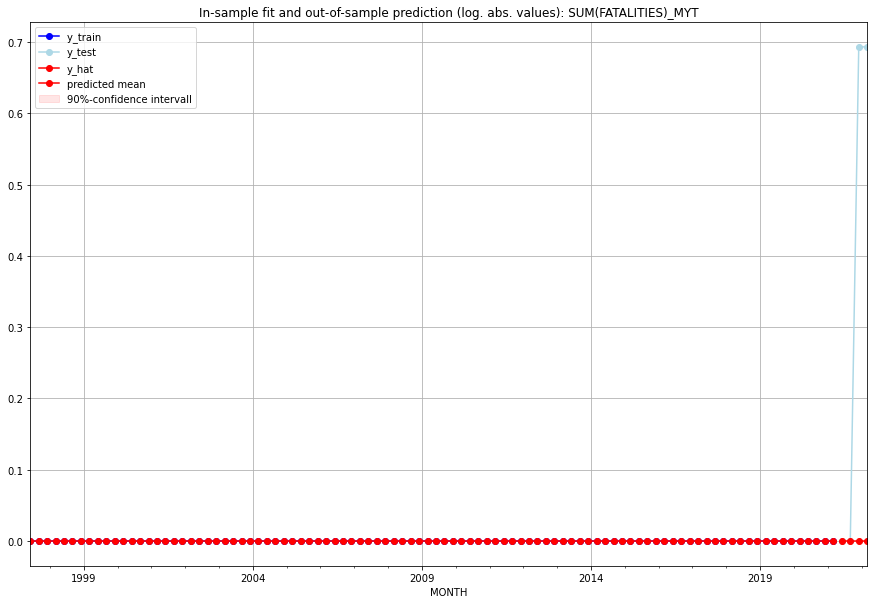

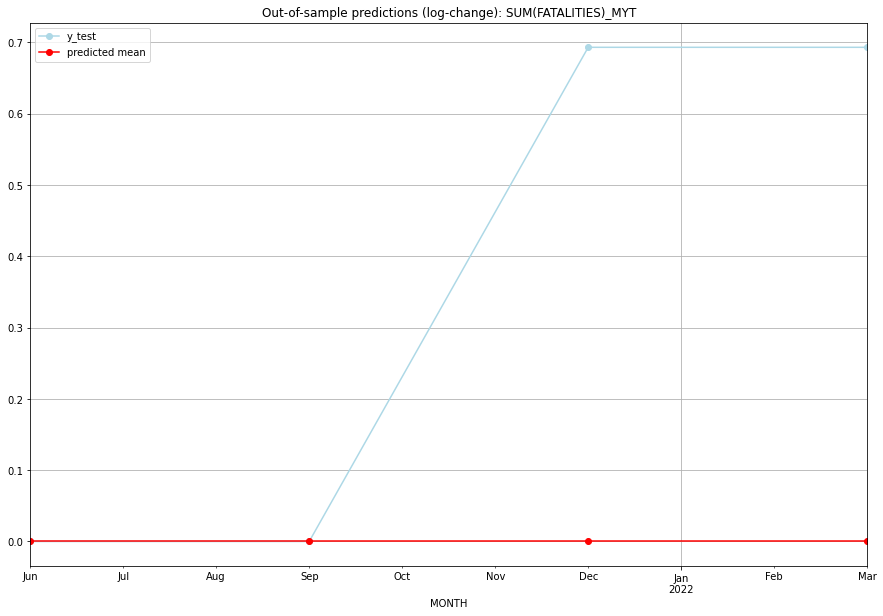

TADDA: 0.34657359027997264
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   MYT   
1 2021-07-01       0.0         0.0           0.0        0.000000   MYT   
2 2021-10-01       0.0         1.0           0.0        0.693147   MYT   
3 2022-01-01       0.0         1.0           0.0        0.693147   MYT   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:03
######## NAM (151/234) #########
0
Neighbor countries: []
Getting Data for NAM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.22821740957339182, 'fold_results': [0.0, 0.34657359027997264, 0.17328679513998632, 0.6212266624470001, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NAM   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                -137.924
Date:                 Wed, 19 Oct 2022   AIC                            277.848
Time:                         10:51:43   BIC                            280.413
Sample:                     04-30-1997   HQIC                           278.885
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

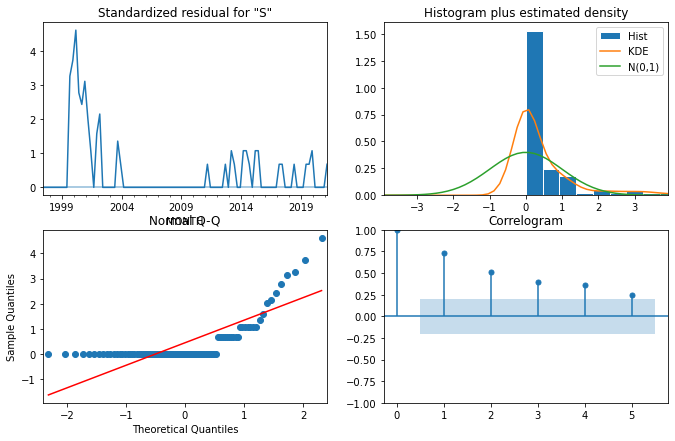

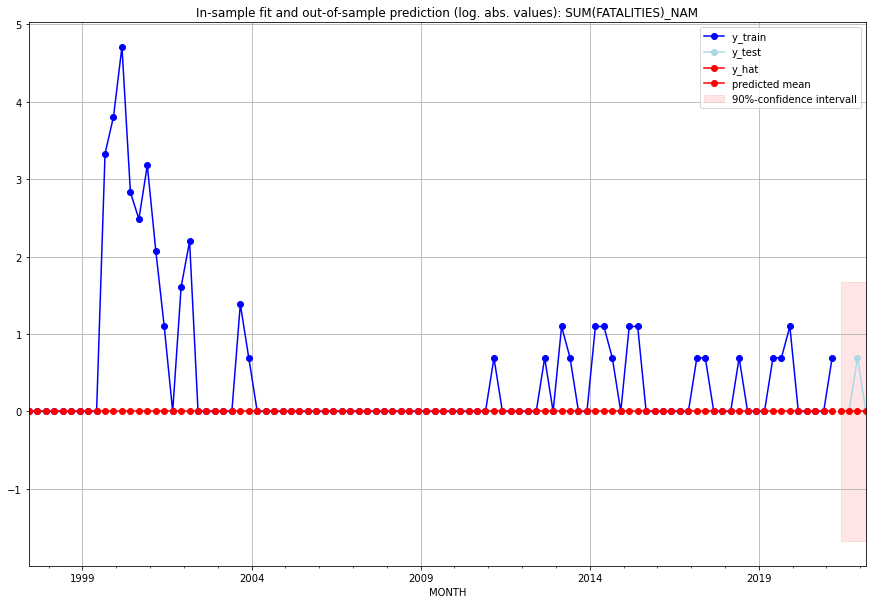

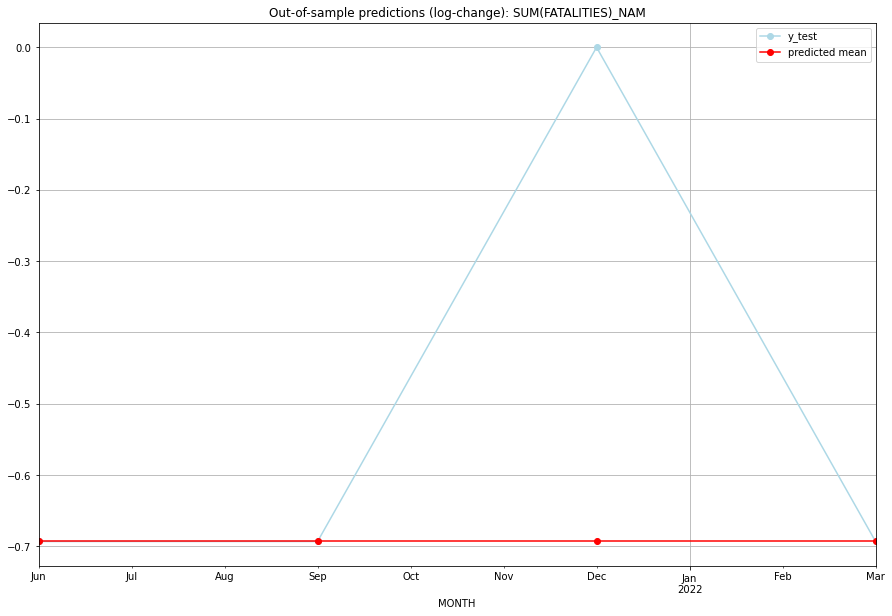

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0     -0.693147       -0.693147   NAM   
1 2021-07-01       0.0         0.0     -0.693147       -0.693147   NAM   
2 2021-10-01       0.0         1.0     -0.693147        0.000000   NAM   
3 2022-01-01       0.0         0.0     -0.693147       -0.693147   NAM   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## NCL (152/234) #########
0
Neighbor countries: []
Getting Data for NCL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient d

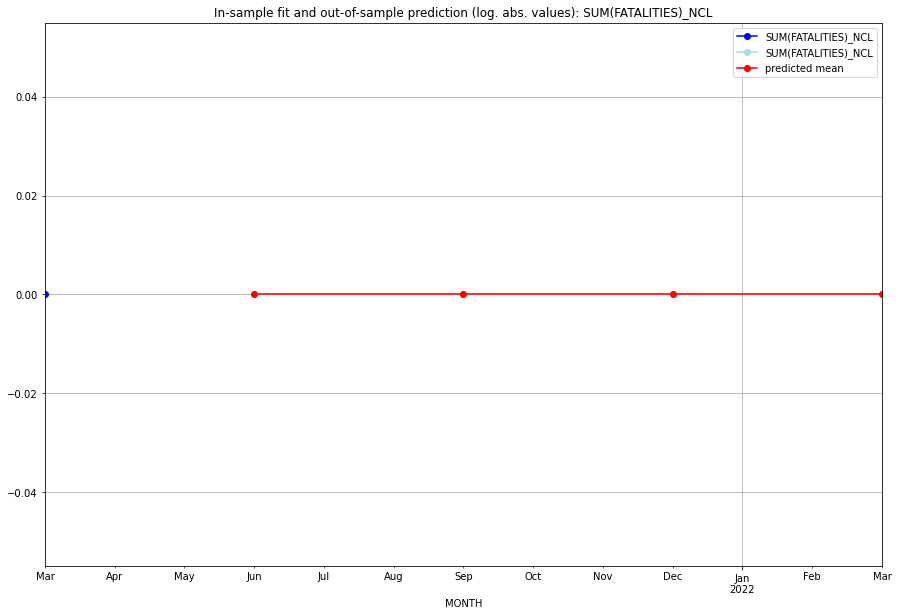

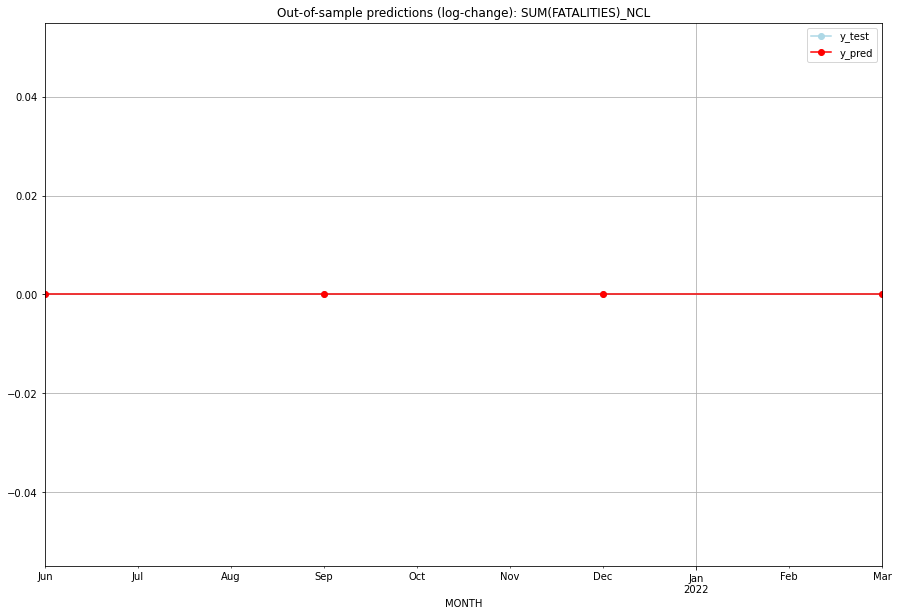

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   NCL   
1 2021-07-01       0.0         0.0           0.0             0.0   NCL   
2 2021-10-01       0.0         0.0           0.0             0.0   NCL   
3 2022-01-01       0.0         0.0           0.0             0.0   NCL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## NER (153/234) #########
0
Neighbor countries: []
Getting Data for NER
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.6682749082597634, 'fold_results': [0.658444622911405, 0.6515555726225266, 0.879088848248046, 0.5104530421031581, 0.6418324554136814]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NER   No. Observations:                   96
Model:                SARIMAX(0, 1, 2)   Log Likelihood                -164.999
Date:                 Wed, 19 Oct 2022   AIC                            341.998
Time:                         10:52:03   BIC                            357.321
Sample:                     04-30-1997   HQIC                           348.190
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

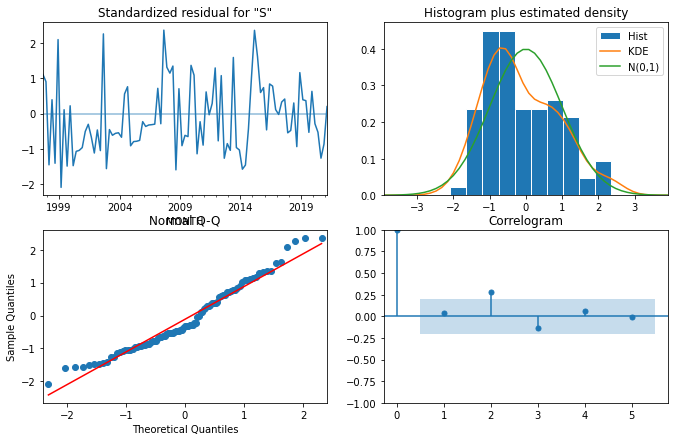

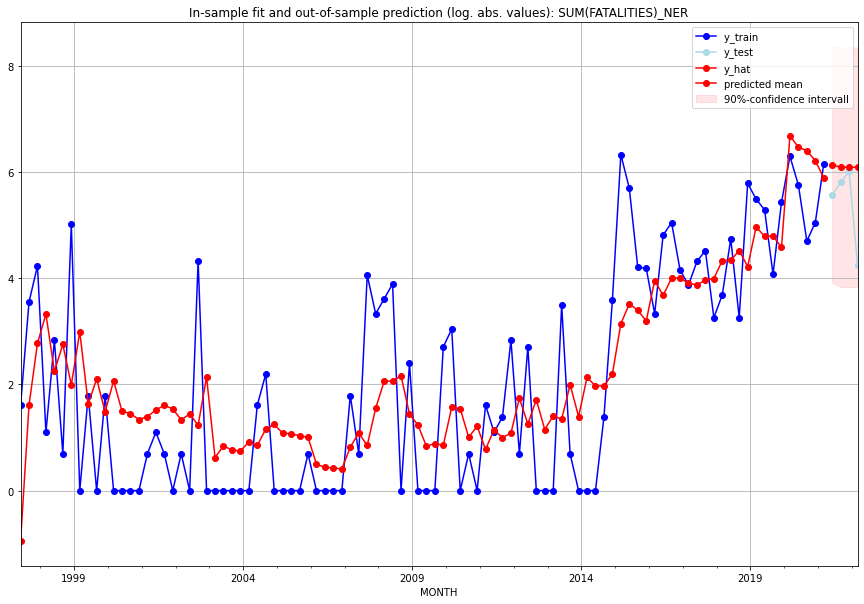

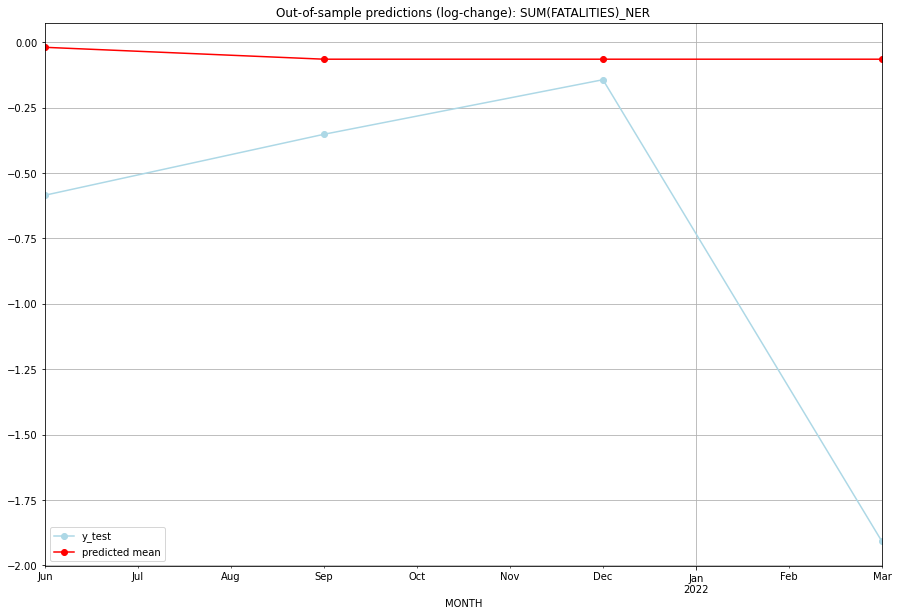

TADDA: 0.6936676263761195
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  461.955026       262.0     -0.019349       -0.584825   NER   
1 2021-07-01  441.384758       331.0     -0.064799       -0.351844   NER   
2 2021-10-01  441.384758       408.0     -0.064799       -0.143264   NER   
3 2022-01-01  441.384758        69.0     -0.064799       -1.908484   NER   

                                          PARAMETERS  
0  {'params': [3, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## NGA (154/234) #########
0
Neighbor countries: []
Getting Data for NGA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 63)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV o

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.40612630822572876, 'fold_results': [0.434872909442531, 0.4071674725900425, 0.3357965290495275, 0.3872977747450439, 0.4654968553014991]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NGA   No. Observations:                   96
Model:                SARIMAX(2, 1, 1)   Log Likelihood                -130.376
Date:                 Wed, 19 Oct 2022   AIC                            272.751
Time:                         10:52:25   BIC                            288.074
Sample:                     04-30-1997   HQIC                           278.943
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

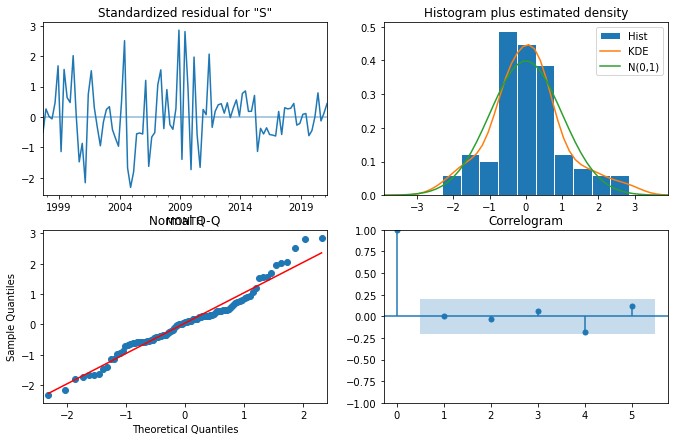

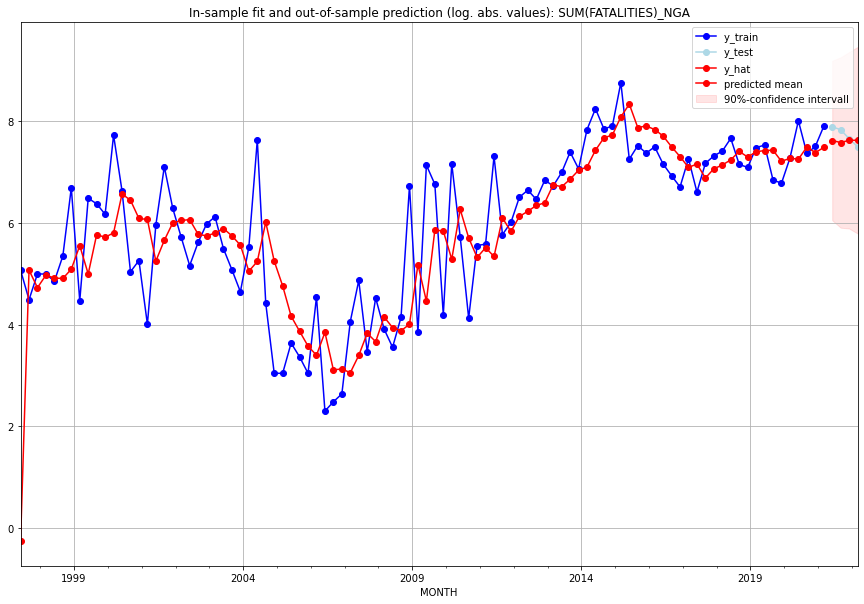

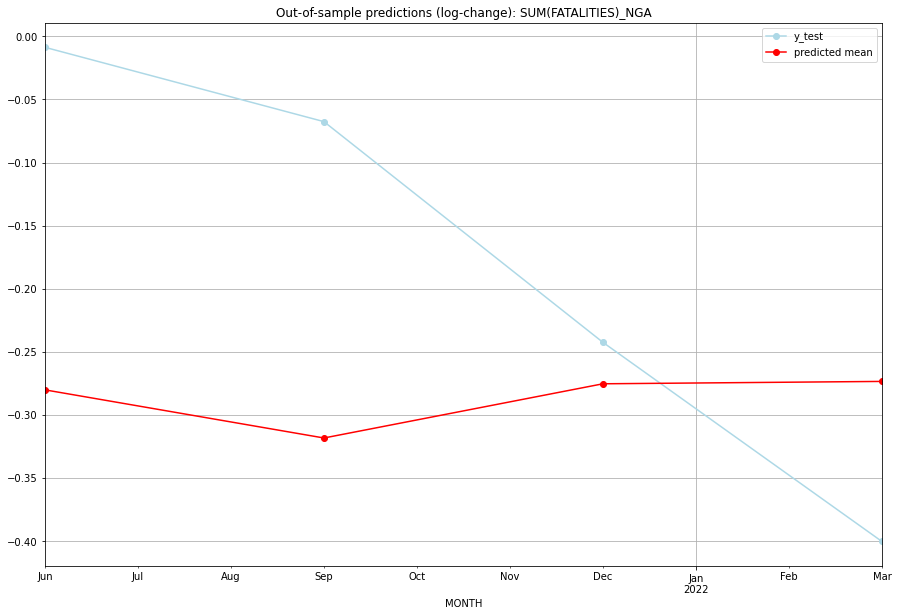

TADDA: 0.17054588638327273
Evaluation finished.
       MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2023.310938      2655.0     -0.280214       -0.008622   NGA   
1 2021-07-01  1947.506740      2503.0     -0.318380       -0.067554   NGA   
2 2021-10-01  2033.073741      2101.0     -0.275403       -0.242554   NGA   
3 2022-01-01  2036.904005      1794.0     -0.273522       -0.400439   NGA   

                                          PARAMETERS  
0  {'params': [2, (2, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (2, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (2, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (2, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:21
######## NIC (155/234) #########
0
Neighbor countries: []
Getting Data for NIC
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 62)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.5300325275650474, 'fold_results': [0.3182877846267337, 0.7417772705033611]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NIC   No. Observations:                   13
Model:                SARIMAX(0, 1, 2)   Log Likelihood                 -22.476
Date:                 Wed, 19 Oct 2022   AIC                             50.953
Time:                         10:52:36   BIC                             52.407
Sample:                     01-31-2018   HQIC                            50.414
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.1957    114.

<Figure size 432x288 with 0 Axes>

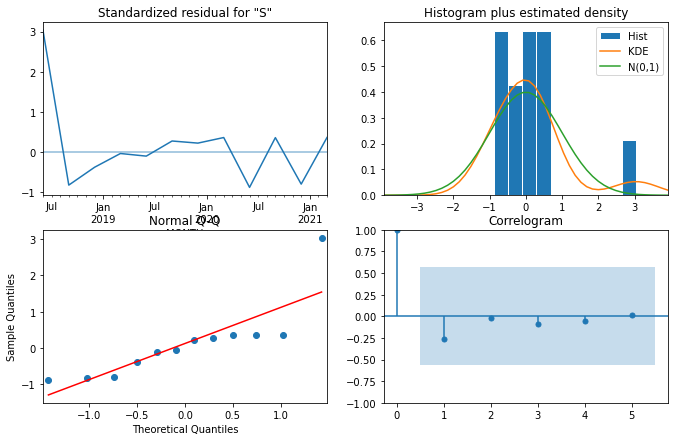

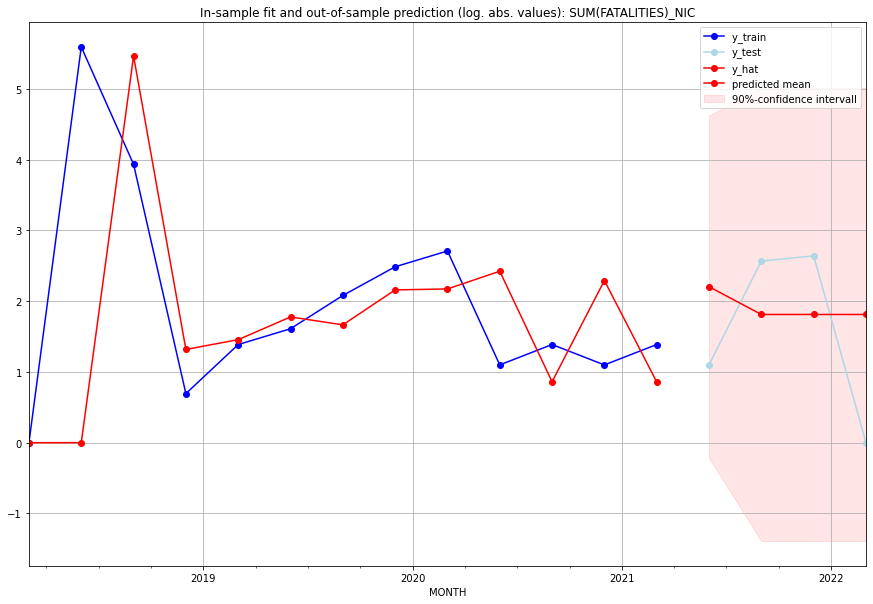

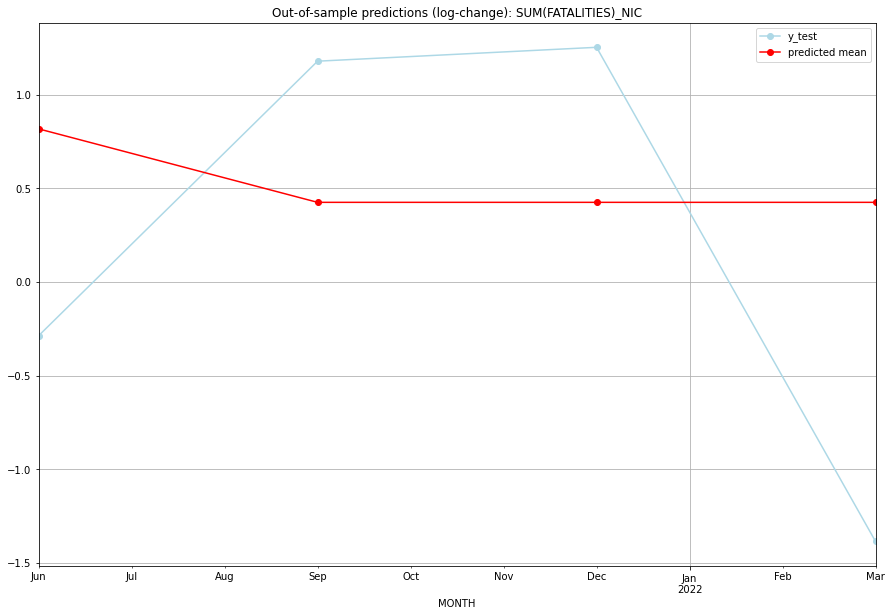

TADDA: 1.4349847445243604
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   8.05726         2.0      0.817272       -0.287682   NIC   
1 2021-07-01   5.11763        12.0      0.424880        1.178655   NIC   
2 2021-10-01   5.11763        13.0      0.424880        1.252763   NIC   
3 2022-01-01   5.11763         0.0      0.424880       -1.386294   NIC   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## NLD (156/234) #########
0
Neighbor countries: []
Getting Data for NLD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 65)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient d

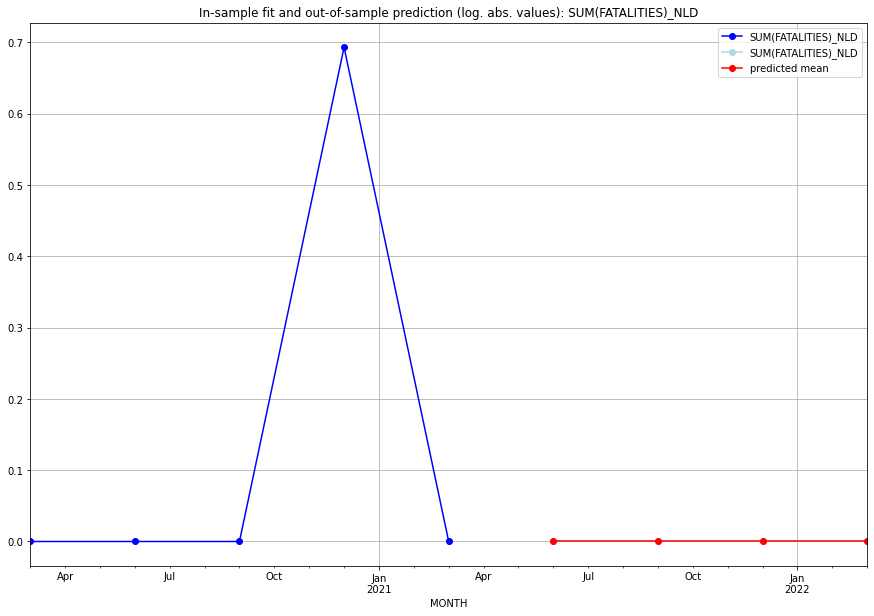

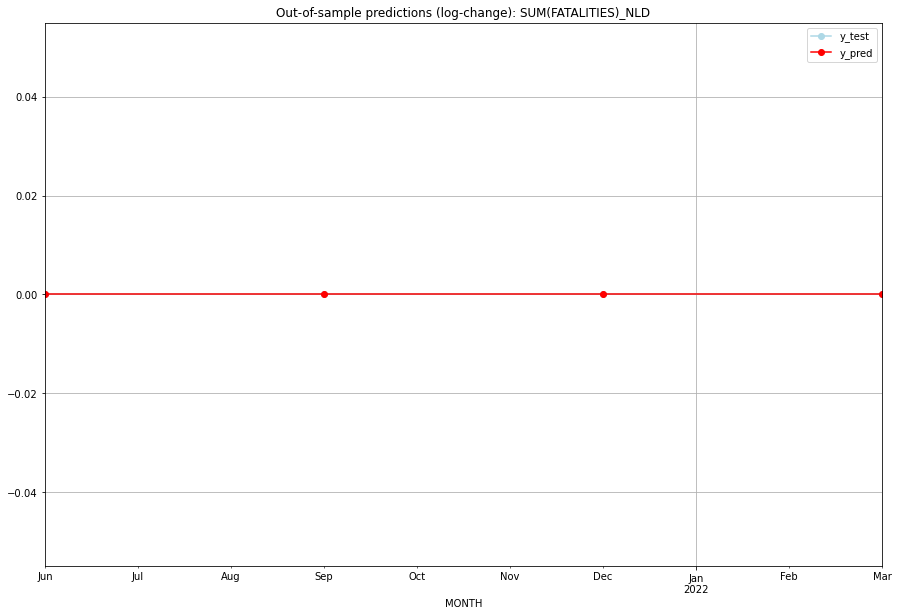

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   NLD   
1 2021-07-01       0.0         0.0           0.0             0.0   NLD   
2 2021-10-01       0.0         0.0           0.0             0.0   NLD   
3 2022-01-01       0.0         0.0           0.0             0.0   NLD   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## NOR (157/234) #########
0
Neighbor countries: []
Getting Data for NOR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 64)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


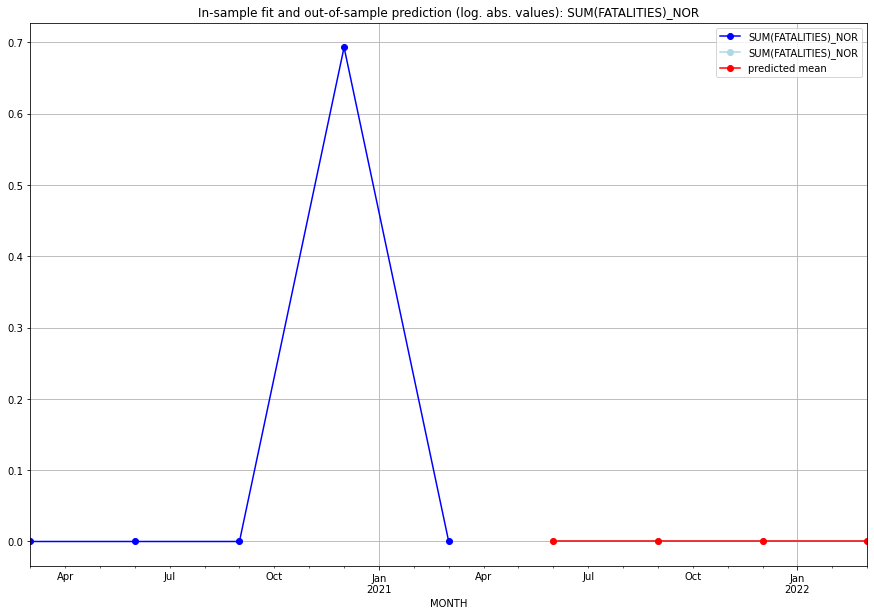

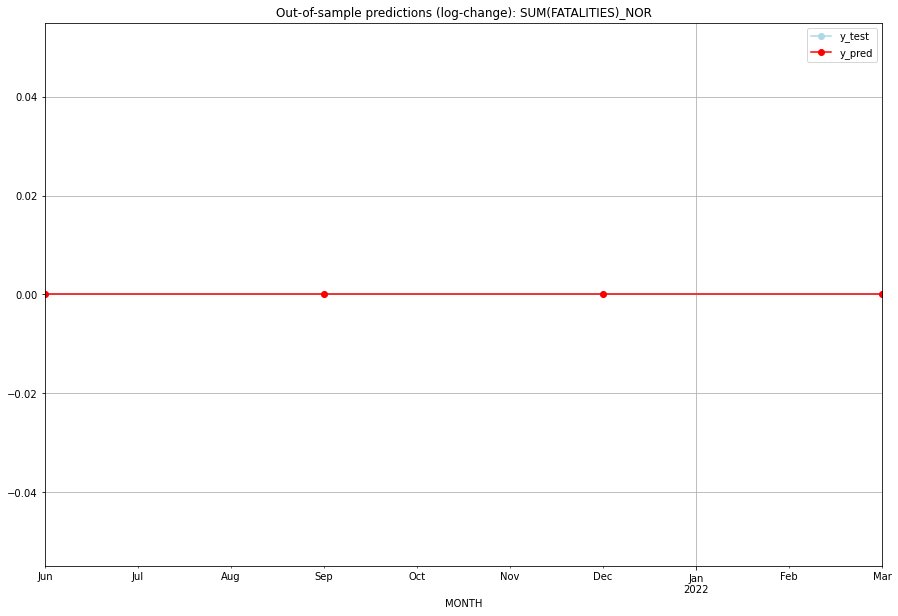

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   NOR   
1 2021-07-01       0.0         0.0           0.0             0.0   NOR   
2 2021-10-01       0.0         0.0           0.0             0.0   NOR   
3 2022-01-01       0.0         0.0           0.0             0.0   NOR   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## NPL (158/234) #########
0
Neighbor countries: []
Getting Data for NPL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 58)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8068316385978365, 'fold_results': [1.1847795396244571, 0.6181210324473607, 0.9972460116410687, 0.6289195771136885, 0.6050920321626075]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NPL   No. Observations:                   45
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -65.694
Date:                 Wed, 19 Oct 2022   AIC                            133.389
Time:                         10:53:03   BIC                            135.173
Sample:                     01-31-2010   HQIC                           134.051
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

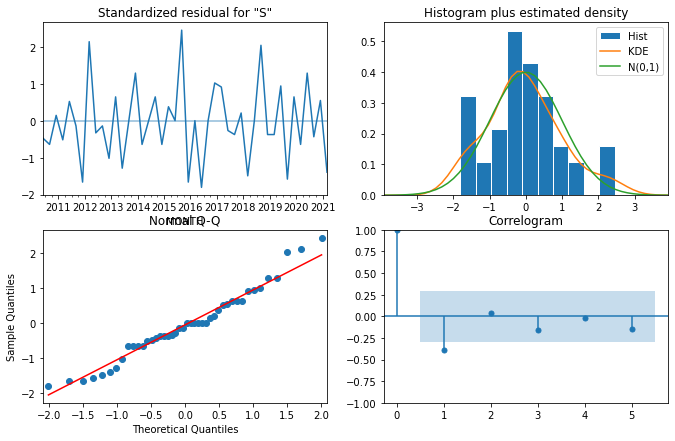

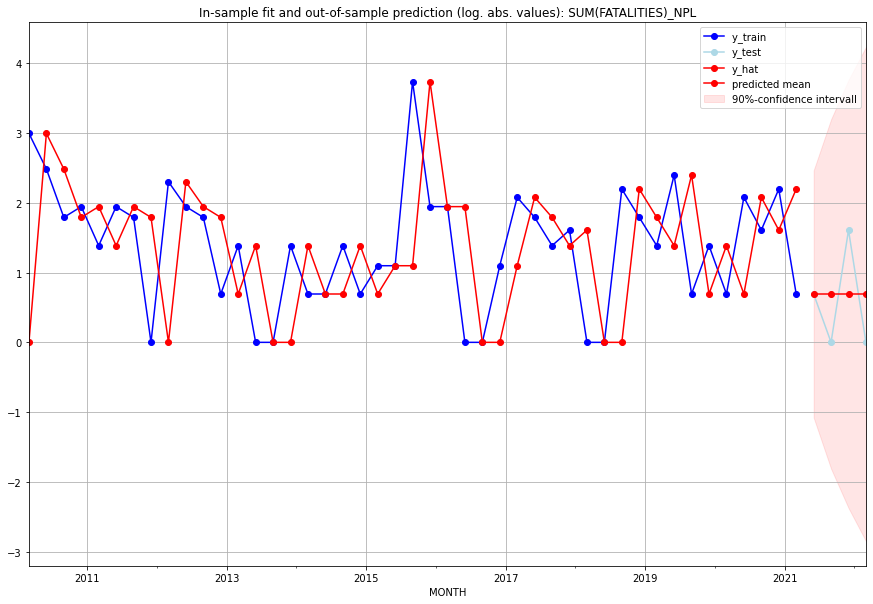

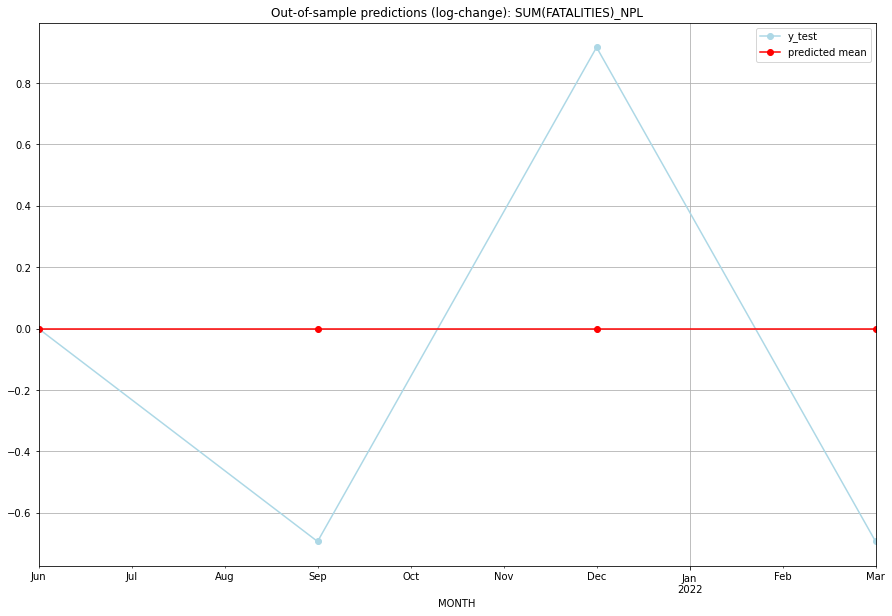

TADDA: 0.5756462732485118
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       1.0         1.0  3.330669e-16        0.000000   NPL   
1 2021-07-01       1.0         0.0  3.330669e-16       -0.693147   NPL   
2 2021-10-01       1.0         4.0  3.330669e-16        0.916291   NPL   
3 2022-01-01       1.0         0.0  3.330669e-16       -0.693147   NPL   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## NZL (159/234) #########
0
Neighbor countries: []
Getting Data for NZL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 60)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient d

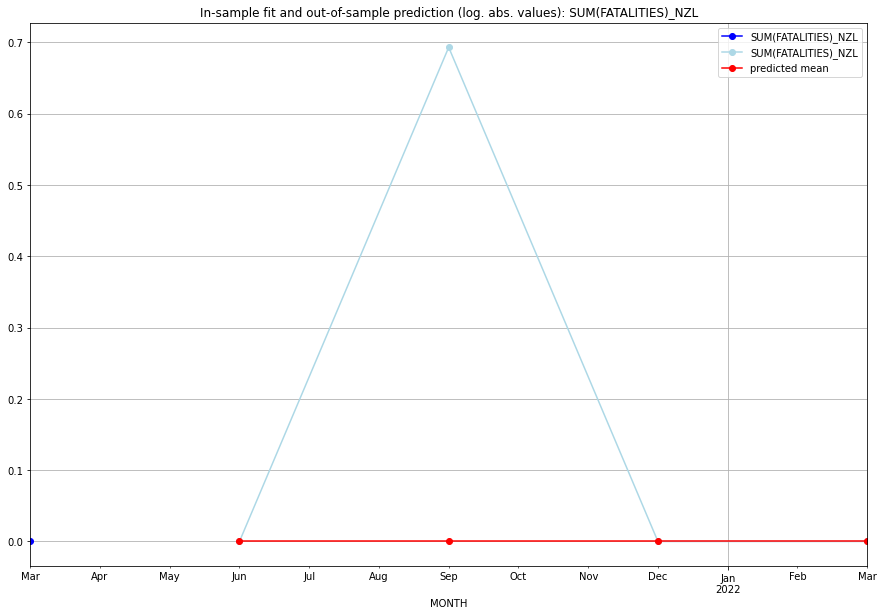

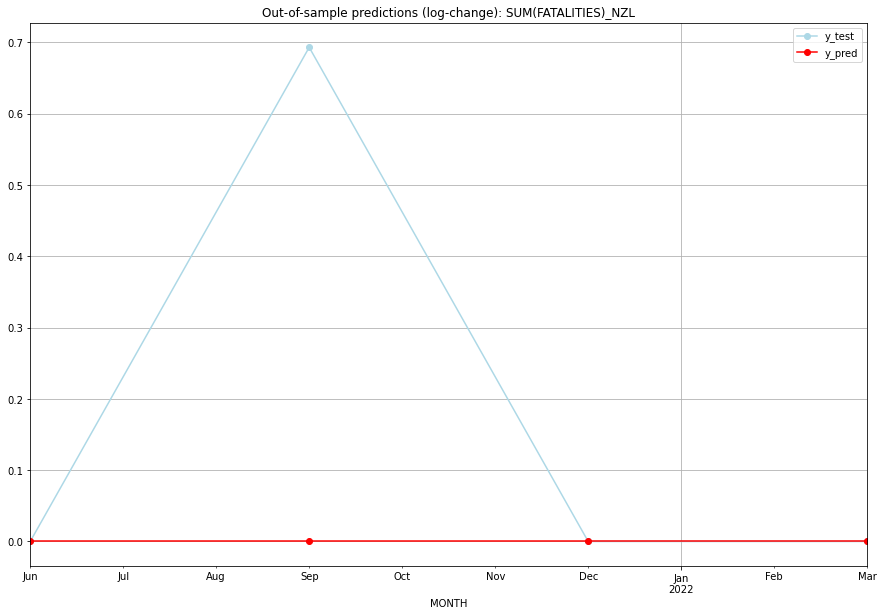

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.000000           0.0        0.000000   NZL   
1 2021-07-01       0.0    0.693147           0.0        0.693147   NZL   
2 2021-10-01       0.0    0.000000           0.0        0.000000   NZL   
3 2022-01-01       0.0    0.000000           0.0        0.000000   NZL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## OMN (160/234) #########
0
Neighbor countries: []
Getting Data for OMN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 57)
y: (25, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_OMN   No. Observations:           

<Figure size 432x288 with 0 Axes>

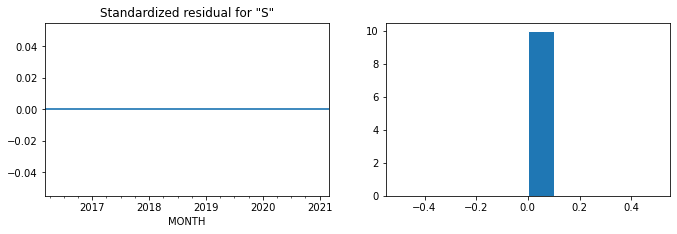

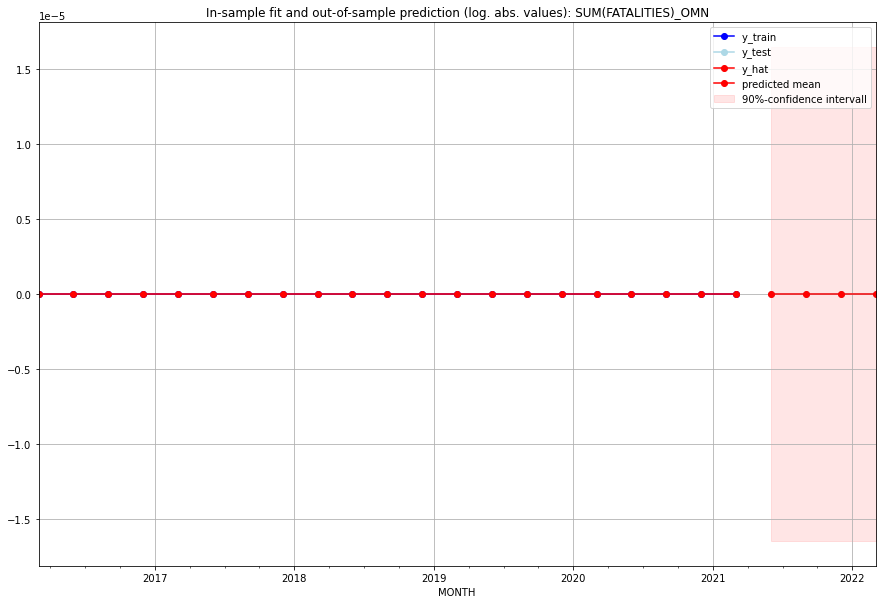

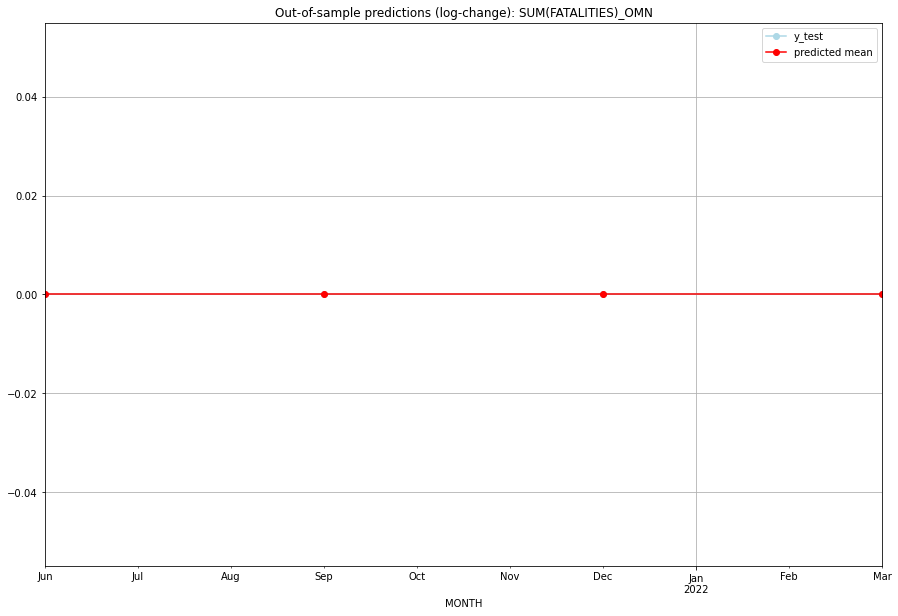

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   OMN   
1 2021-07-01       0.0         0.0           0.0             0.0   OMN   
2 2021-10-01       0.0         0.0           0.0             0.0   OMN   
3 2022-01-01       0.0         0.0           0.0             0.0   OMN   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## PAK (161/234) #########
0
Neighbor countries: []
Getting Data for PAK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 64)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.22813684288467026, 'fold_results': [0.29633250108190556, 0.2457018892009748, 0.3062292585148161, 0.16452541910879126, 0.12789514651686362]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PAK   No. Observations:                   45
Model:                SARIMAX(2, 0, 1)   Log Likelihood                 -21.088
Date:                 Wed, 19 Oct 2022   AIC                             56.176
Time:                         10:53:26   BIC                             68.823
Sample:                     01-31-2010   HQIC                            60.890
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------

<Figure size 432x288 with 0 Axes>

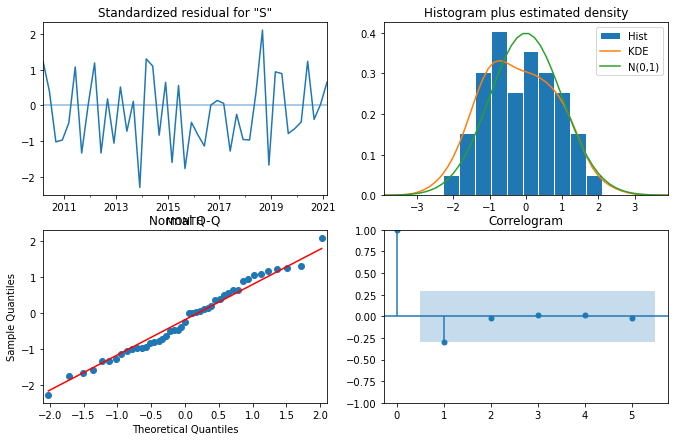

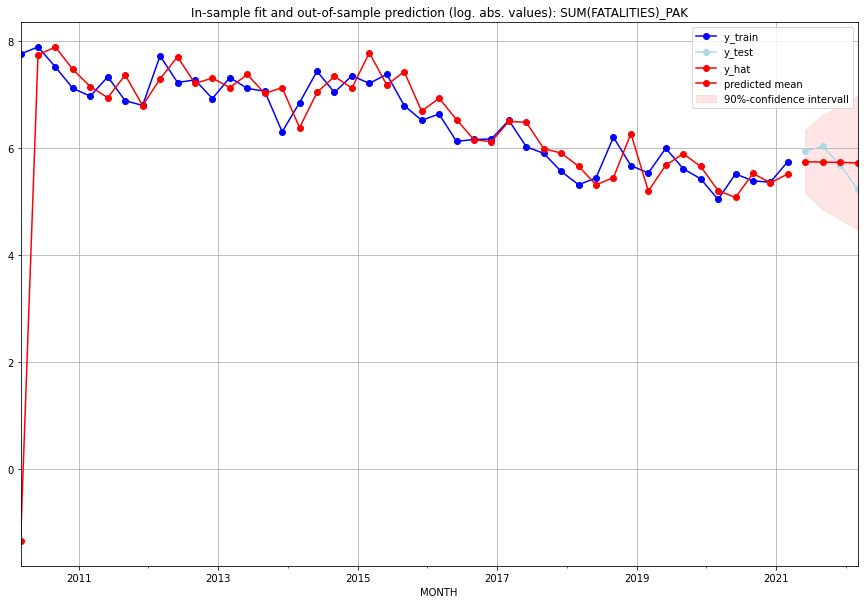

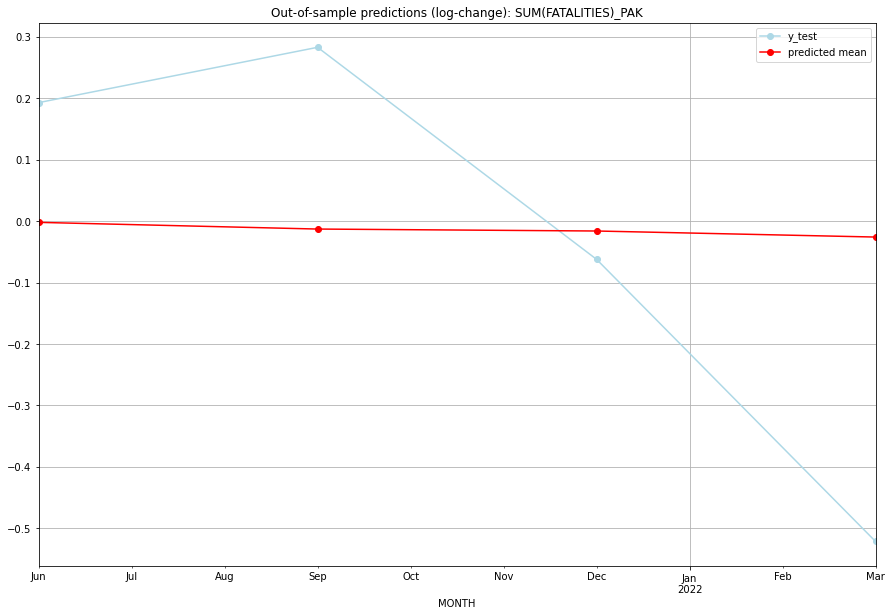

TADDA: 0.2618194148981636
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  313.361413       381.0     -0.002029        0.192848   PAK   
1 2021-07-01  309.960619       417.0     -0.012906        0.282909   PAK   
2 2021-10-01  308.970715       295.0     -0.016095       -0.062213   PAK   
3 2022-01-01  305.936162       186.0     -0.025933       -0.521464   PAK   

                                          PARAMETERS  
0  {'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (2, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## PAN (162/234) #########
0
Neighbor countries: []
Getting Data for PAN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 63)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.3477683308718644, 'fold_results': [0.3477683308718644, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PAN   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                  -7.050
Date:                 Wed, 19 Oct 2022   AIC                             26.099
Time:                         10:53:38   BIC                             29.489
Sample:                     01-31-2018   HQIC                            25.403
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4240      0.677      0.627 

<Figure size 432x288 with 0 Axes>

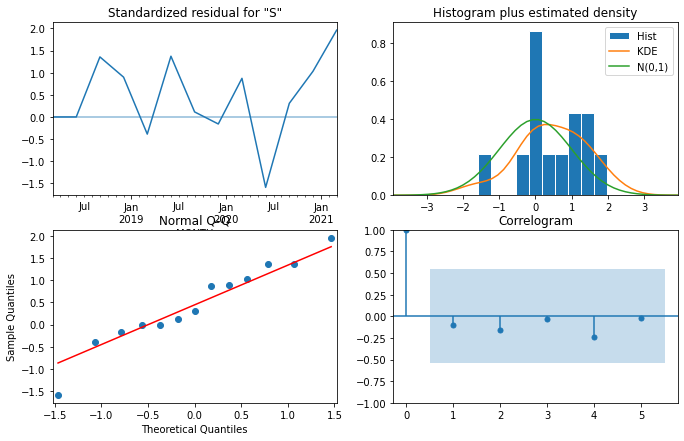

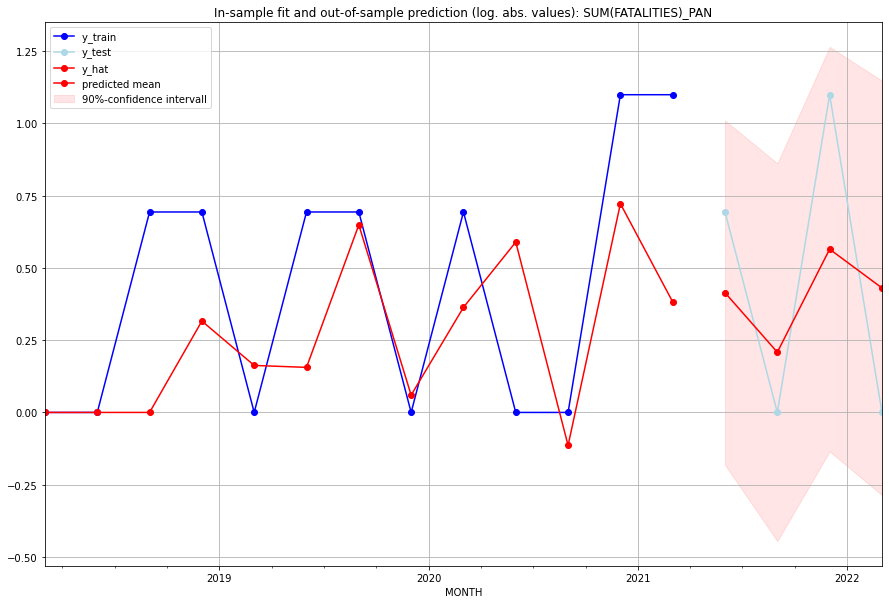

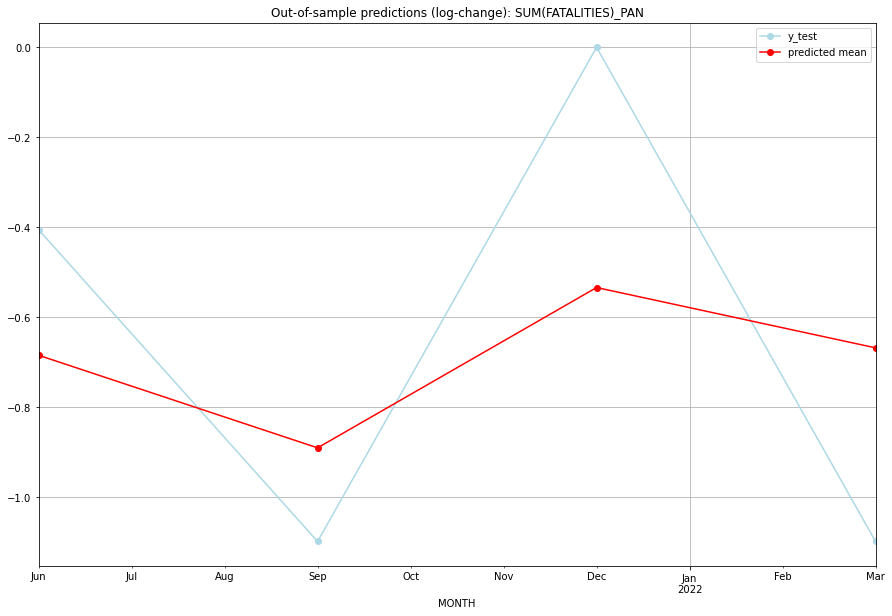

TADDA: 0.36295385075169745
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.512919         1.0     -0.684571       -0.405465   PAN   
1 2021-07-01  0.231436         0.0     -0.890431       -1.098612   PAN   
2 2021-10-01  0.758693         2.0     -0.534041        0.000000   PAN   
3 2022-01-01  0.538006         0.0     -0.668125       -1.098612   PAN   

                                          PARAMETERS  
0  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## PER (163/234) #########
0
Neighbor countries: []
Getting Data for PER
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 65)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU co

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.6001193227790249, 'fold_results': [0.6836502953345013, 0.5165883502235484]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PER   No. Observations:                   13
Model:                SARIMAX(0, 1, 1)   Log Likelihood                 -13.318
Date:                 Wed, 19 Oct 2022   AIC                             30.636
Time:                         10:53:50   BIC                             31.606
Sample:                     01-31-2018   HQIC                            30.277
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.7029      0.

<Figure size 432x288 with 0 Axes>

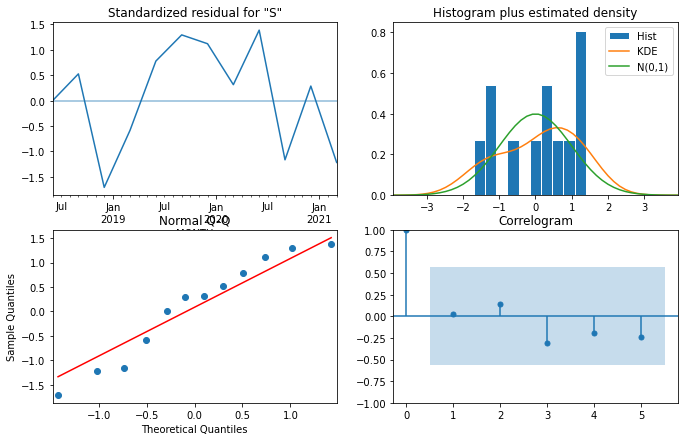

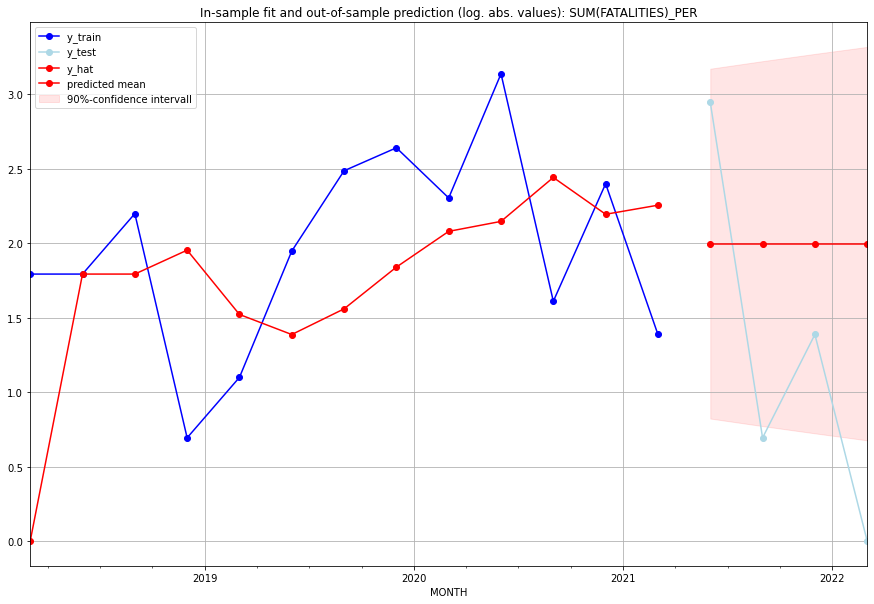

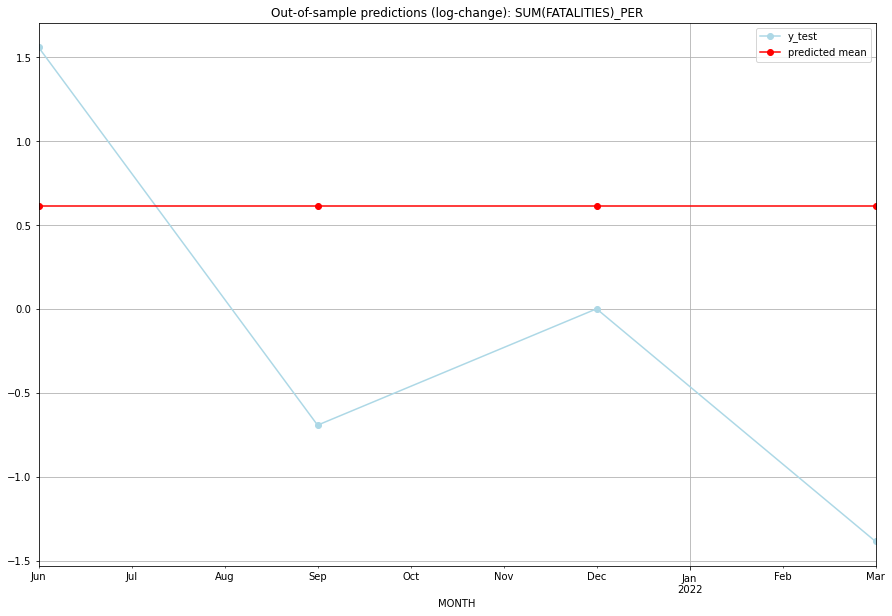

TADDA: 1.5192032641575837
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  6.360303        18.0      0.609807        1.558145   PER   
1 2021-07-01  6.360303         1.0      0.609807       -0.693147   PER   
2 2021-10-01  6.360303         3.0      0.609807        0.000000   PER   
3 2022-01-01  6.360303         0.0      0.609807       -1.386294   PER   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:09
######## PHL (164/234) #########
0
Neighbor countries: []
Getting Data for PHL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 64)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.19895821170953193, 'fold_results': [0.38443633702911906, 0.15641085552761713, 0.1685553596076632, 0.08643029467372831]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PHL   No. Observations:                   21
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -16.747
Date:                 Wed, 19 Oct 2022   AIC                             37.493
Time:                         10:54:02   BIC                             39.485
Sample:                     01-31-2016   HQIC                            37.882
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

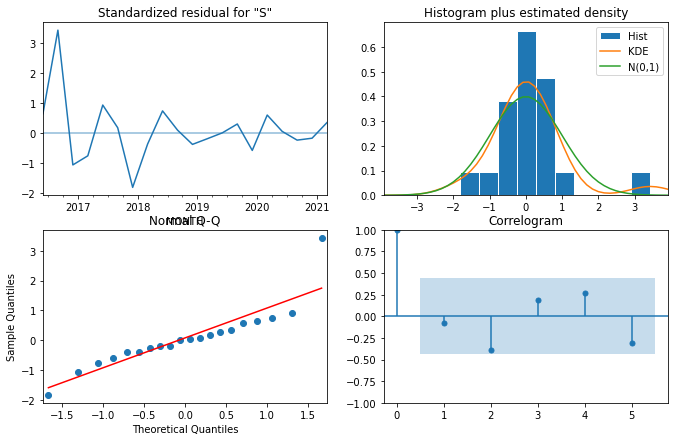

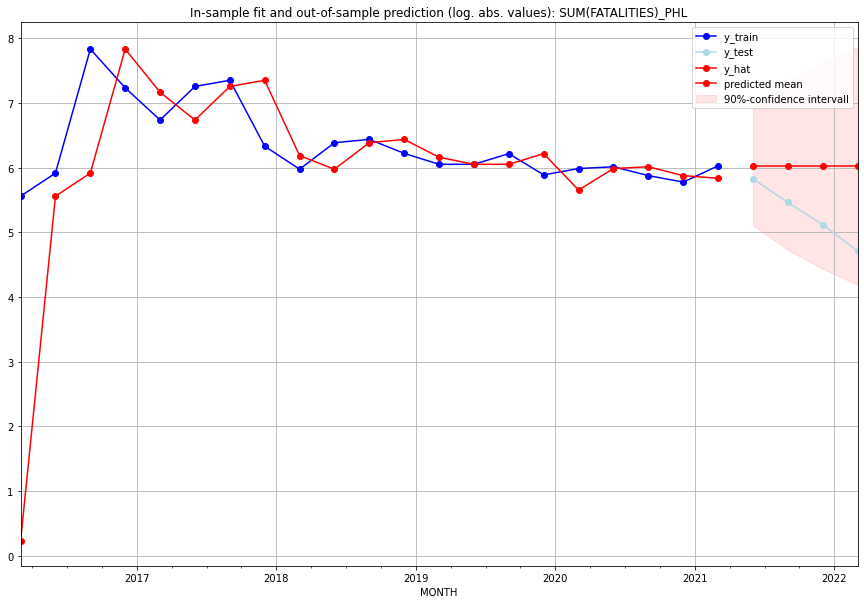

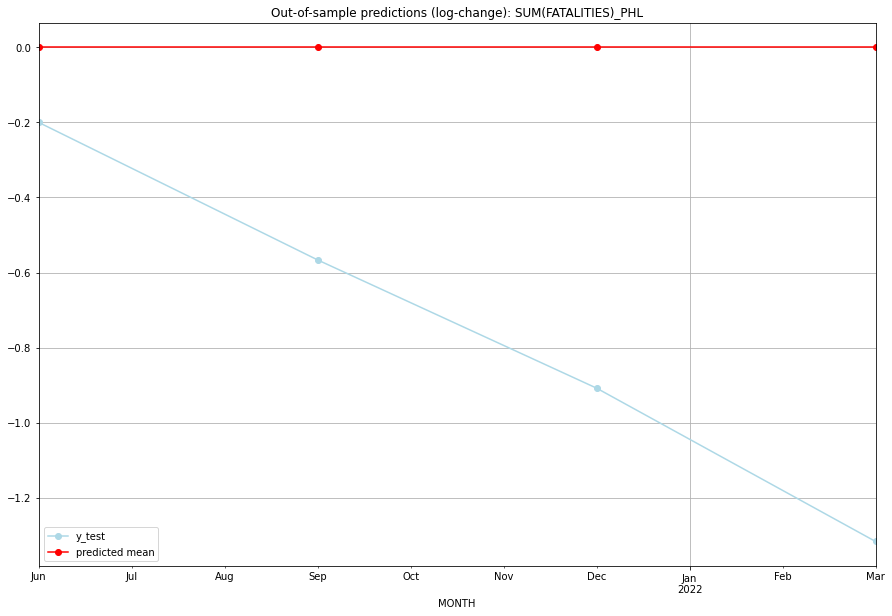

TADDA: 0.7475885650118896
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01     413.0       338.0           0.0       -0.199866   PHL   
1 2021-07-01     413.0       234.0           0.0       -0.566280   PHL   
2 2021-10-01     413.0       166.0           0.0       -0.907872   PHL   
3 2022-01-01     413.0       110.0           0.0       -1.316336   PHL   

                                          PARAMETERS  
0  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## PNG (165/234) #########
0
Neighbor countries: []
Getting Data for PNG
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 58)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient d

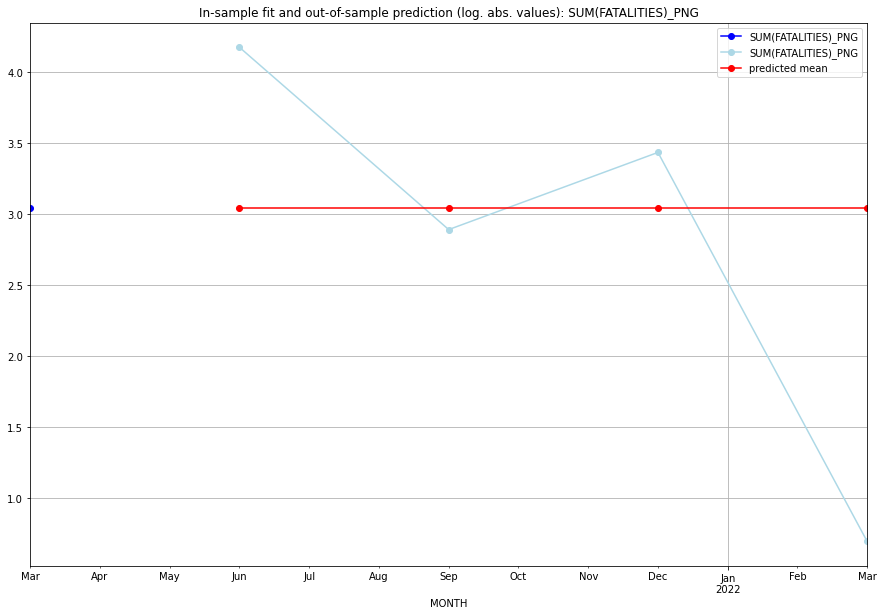

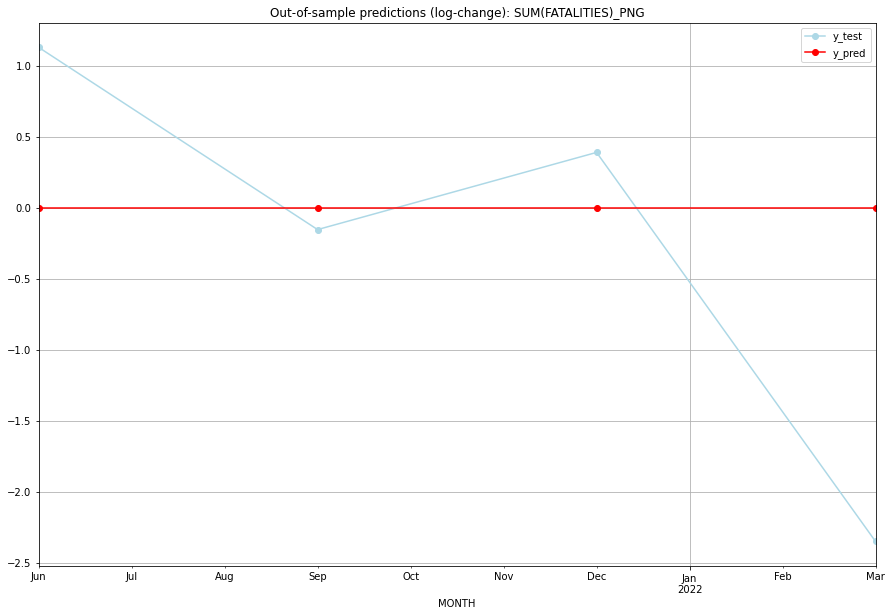

TADDA: 1.0062138839811683
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  3.044522    4.174387           0.0        1.129865   PNG   
1 2021-07-01  3.044522    2.890372           0.0       -0.154151   PNG   
2 2021-10-01  3.044522    3.433987           0.0        0.389465   PNG   
3 2022-01-01  3.044522    0.693147           0.0       -2.351375   PNG   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:00
######## POL (166/234) #########
0
Neighbor countries: []
Getting Data for POL
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 64)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


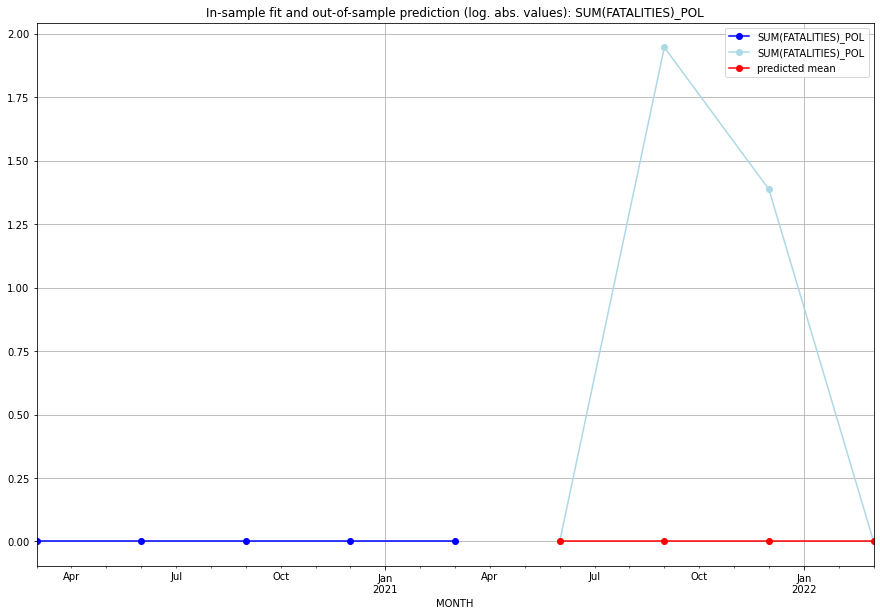

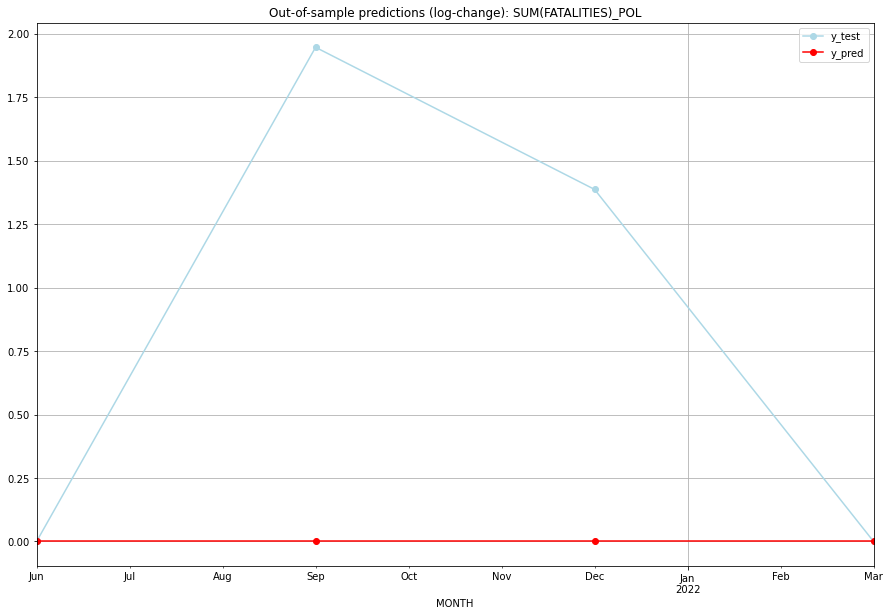

TADDA: 0.8330511275438008
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0    0.000000           0.0        0.000000   POL   
1 2021-07-01       0.0    1.945910           0.0        1.945910   POL   
2 2021-10-01       0.0    1.386294           0.0        1.386294   POL   
3 2022-01-01       0.0    0.000000           0.0        0.000000   POL   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## PRI (167/234) #########
0
Neighbor countries: []
Getting Data for PRI
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 41)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.24362870553587718, 'fold_results': [0.3143955637328293, 0.17286184733892507]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PRI   No. Observations:                   13
Model:                SARIMAX(0, 1, 0)   Log Likelihood                  -5.769
Date:                 Wed, 19 Oct 2022   AIC                             17.537
Time:                         10:54:20   BIC                             18.992
Sample:                     01-31-2018   HQIC                            16.998
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0910      

<Figure size 432x288 with 0 Axes>

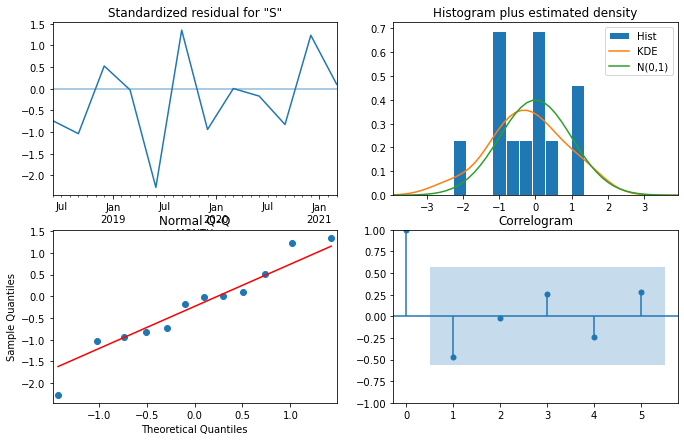

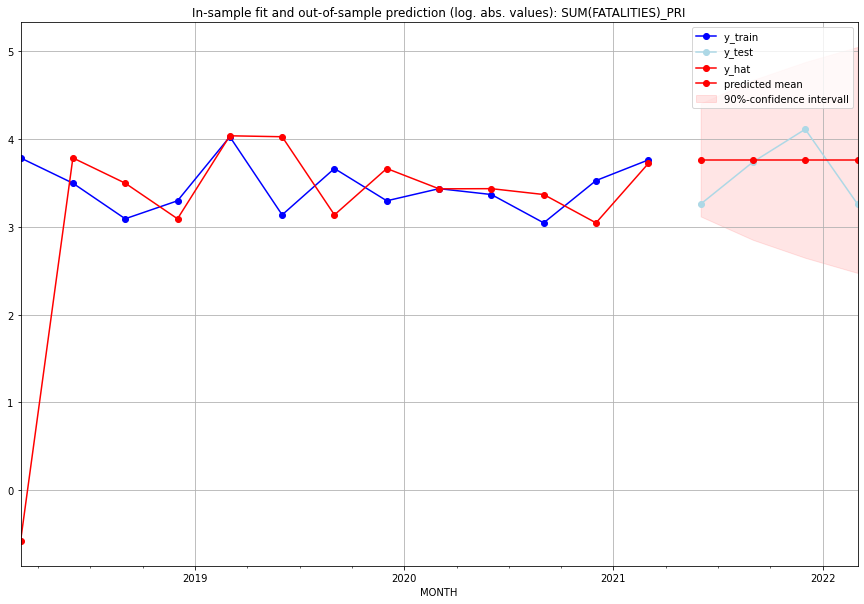

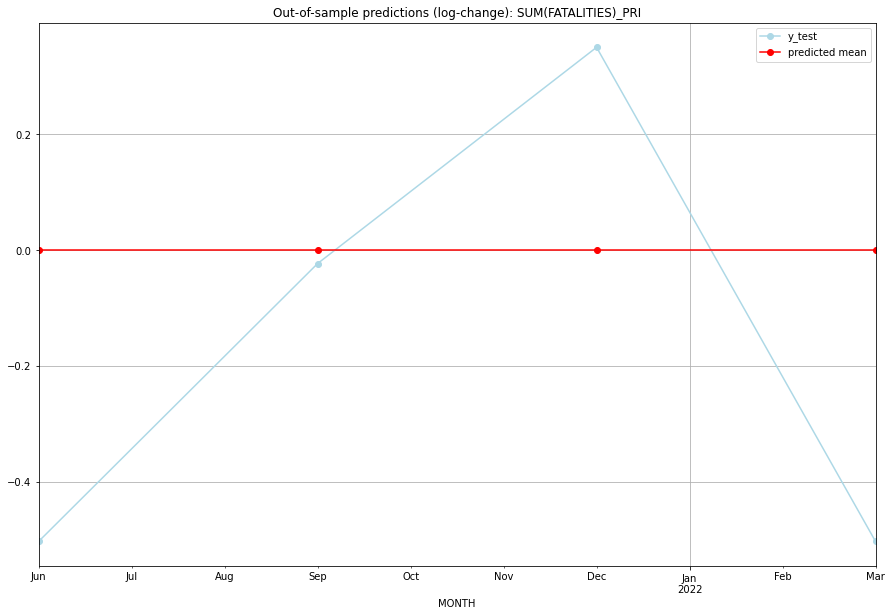

TADDA: 0.3448528503085255
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01      42.0        25.0           0.0       -0.503104   PRI   
1 2021-07-01      42.0        41.0           0.0       -0.023530   PRI   
2 2021-10-01      42.0        60.0           0.0        0.349674   PRI   
3 2022-01-01      42.0        25.0           0.0       -0.503104   PRI   

                                          PARAMETERS  
0  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## PRK (168/234) #########
0
Neighbor countries: []
Getting Data for PRK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 24)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.7558076074240152, 'fold_results': [0.8502993454155389, 0.6613158694324914]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PRK   No. Observations:                   13
Model:                SARIMAX(2, 0, 0)   Log Likelihood                 -15.945
Date:                 Wed, 19 Oct 2022   AIC                             43.889
Time:                         10:54:27   BIC                             47.279
Sample:                     01-31-2018   HQIC                            43.192
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.1920      0.

<Figure size 432x288 with 0 Axes>

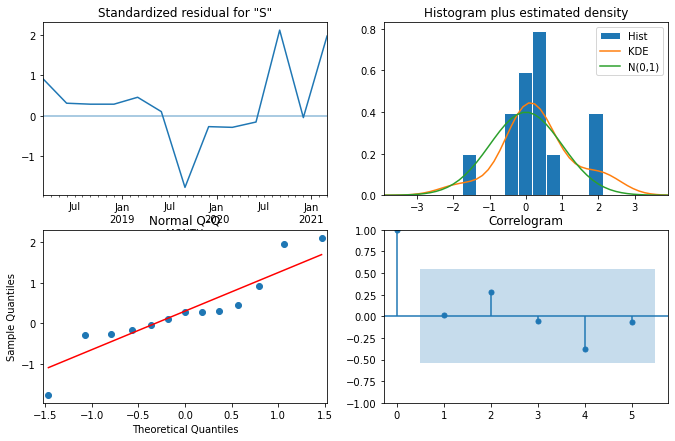

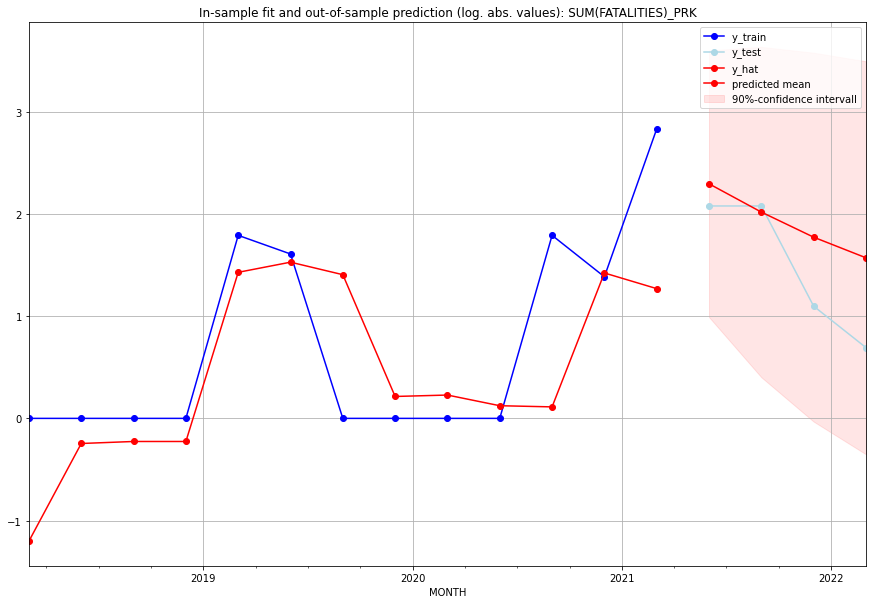

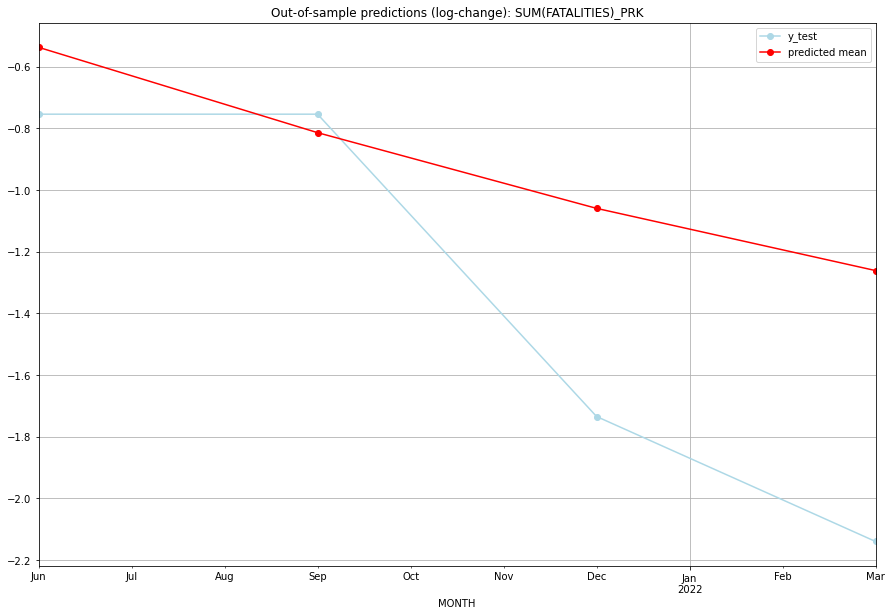

TADDA: 0.4577770602618635
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  8.938294         7.0     -0.536818       -0.753772   PRK   
1 2021-07-01  6.534471         7.0     -0.813725       -0.753772   PRK   
2 2021-10-01  4.893833         2.0     -1.059307       -1.734601   PRK   
3 2022-01-01  3.816533         1.0     -1.261159       -2.140066   PRK   

                                          PARAMETERS  
0  {'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## PRT (169/234) #########
0
Neighbor countries: []
Getting Data for PRT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 65)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient d

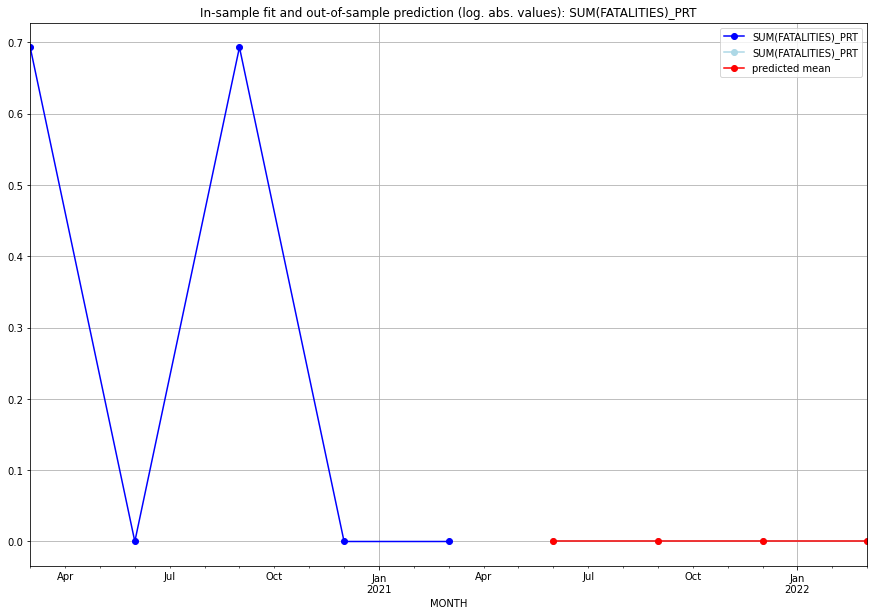

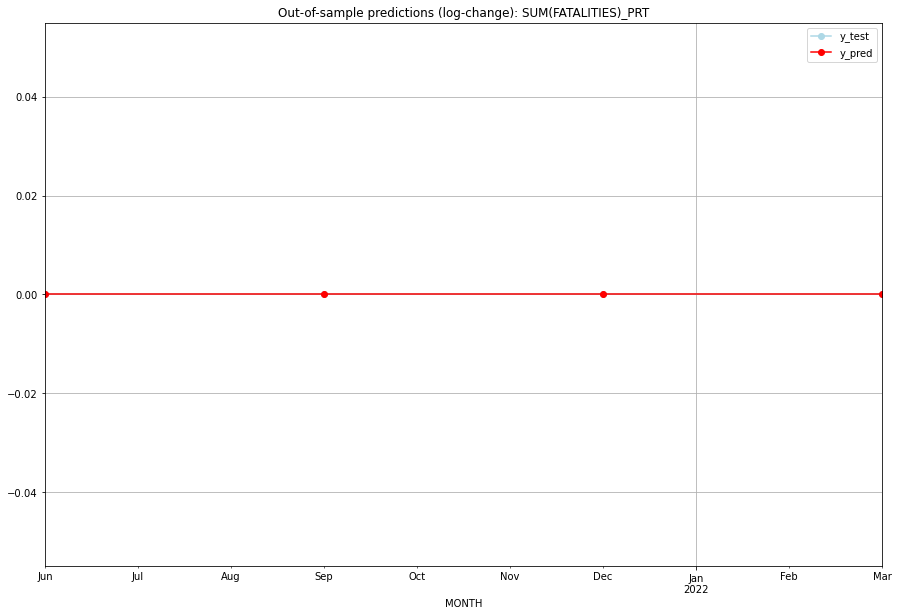

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   PRT   
1 2021-07-01       0.0         0.0           0.0             0.0   PRT   
2 2021-10-01       0.0         0.0           0.0             0.0   PRT   
3 2022-01-01       0.0         0.0           0.0             0.0   PRT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## PRY (170/234) #########
0
Neighbor countries: []
Getting Data for PRY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 64)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.48309887207317415, 'fold_results': [0.6770221094320565, 0.2891756347142918]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PRY   No. Observations:                   13
Model:                SARIMAX(1, 1, 1)   Log Likelihood                 -11.544
Date:                 Wed, 19 Oct 2022   AIC                             31.087
Time:                         10:54:42   BIC                             33.027
Sample:                     01-31-2018   HQIC                            30.369
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0687      0

<Figure size 432x288 with 0 Axes>

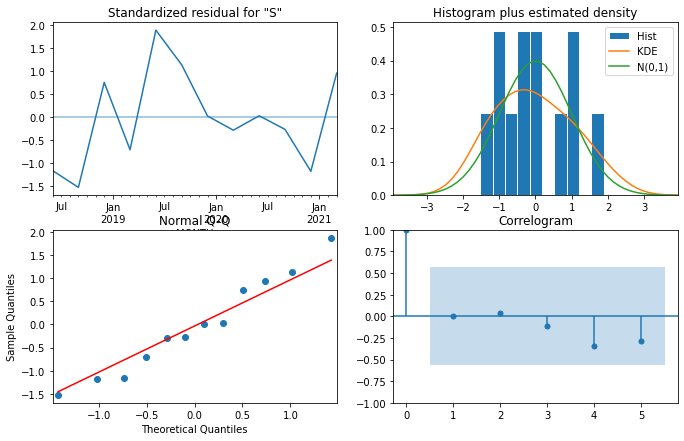

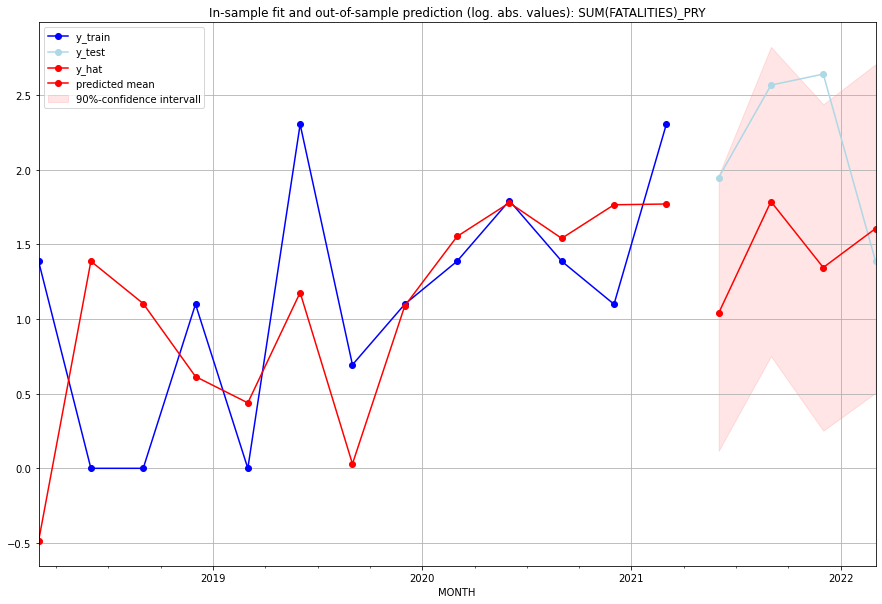

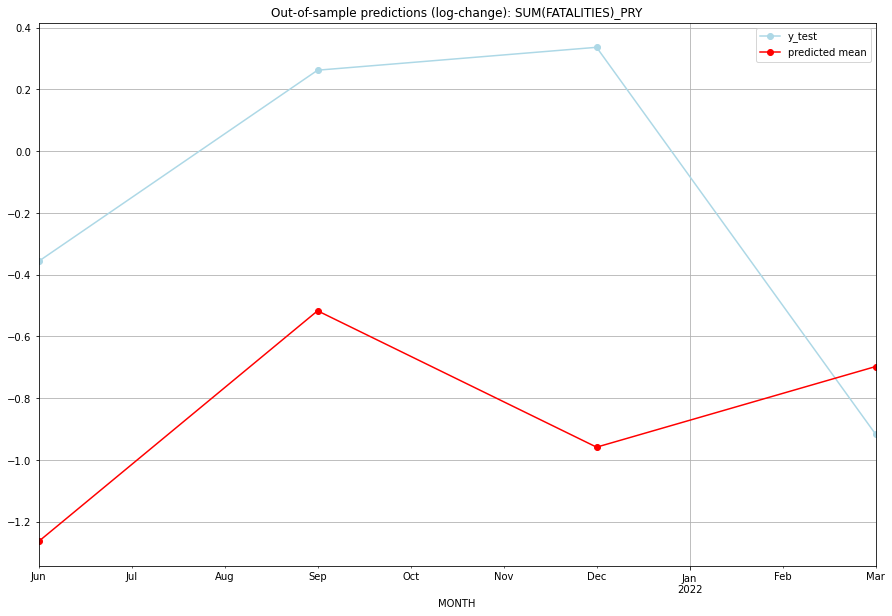

TADDA: 1.1688208077170297
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.825639         6.0     -1.263851       -0.356675   PRY   
1 2021-07-01  4.964302        12.0     -0.516793        0.262364   PRY   
2 2021-10-01  2.835152        13.0     -0.958376        0.336472   PRY   
3 2022-01-01  3.978990         3.0     -0.697358       -0.916291   PRY   

                                          PARAMETERS  
0  {'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## PSE (171/234) #########
0
Neighbor countries: []
Getting Data for PSE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 44)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.6482802771122209, 'fold_results': [0.09291375597283547, nan, 0.5581582886642533, 1.293768786699574]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PSE   No. Observations:                   21
Model:                SARIMAX(2, 0, 2)   Log Likelihood                 -17.239
Date:                 Wed, 19 Oct 2022   AIC                             44.478
Time:                         10:54:57   BIC                             49.701
Sample:                     01-31-2016   HQIC                            45.612
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L

<Figure size 432x288 with 0 Axes>

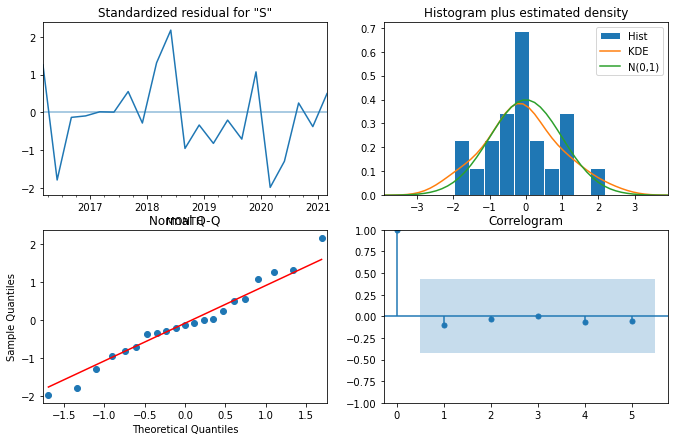

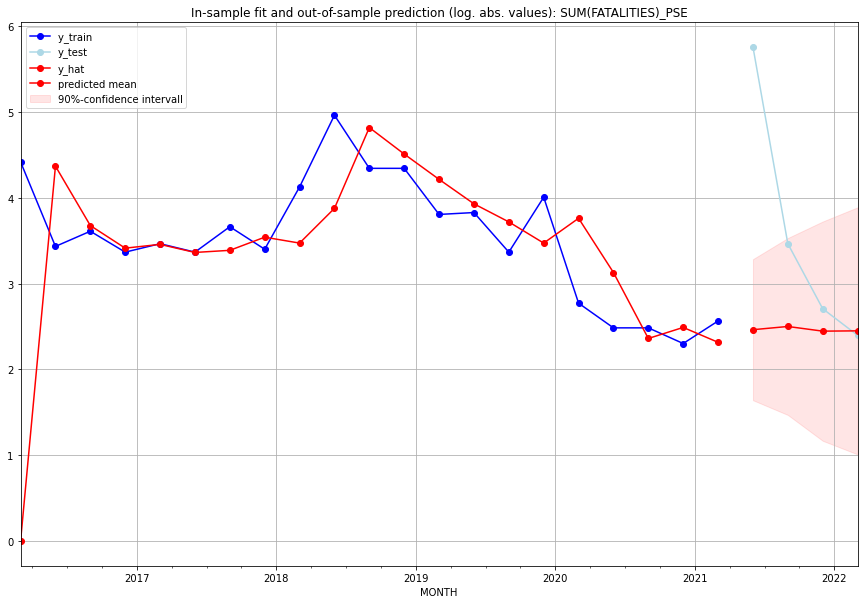

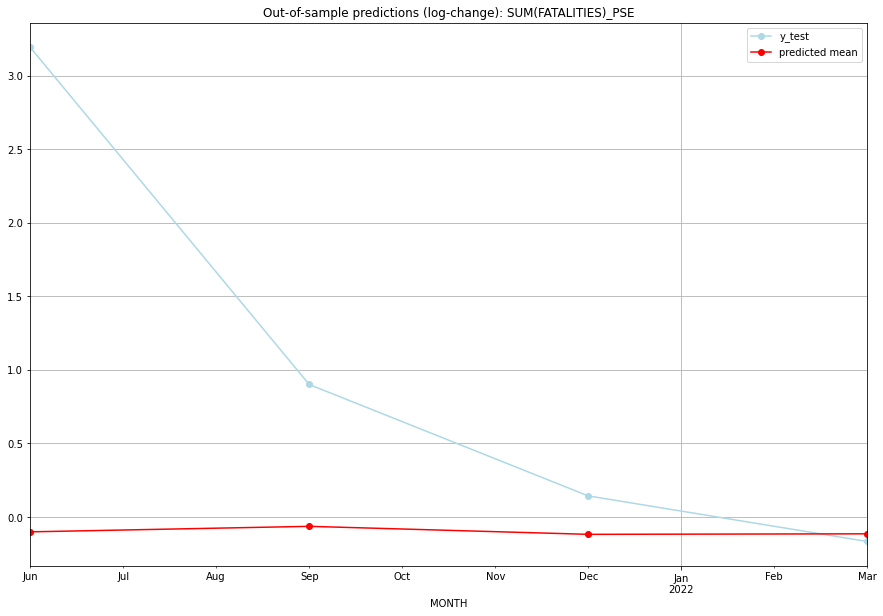

TADDA: 1.214426103936061
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  10.745482       316.0     -0.101481        3.193952   PSE   
1 2021-07-01  11.194067        31.0     -0.064000        0.900787   PSE   
2 2021-10-01  10.548840        14.0     -0.118364        0.143101   PSE   
3 2022-01-01  10.589158        10.0     -0.114879       -0.167054   PSE   

                                          PARAMETERS  
0  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## PYF (172/234) #########
0
Neighbor countries: []
Getting Data for PYF
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficien

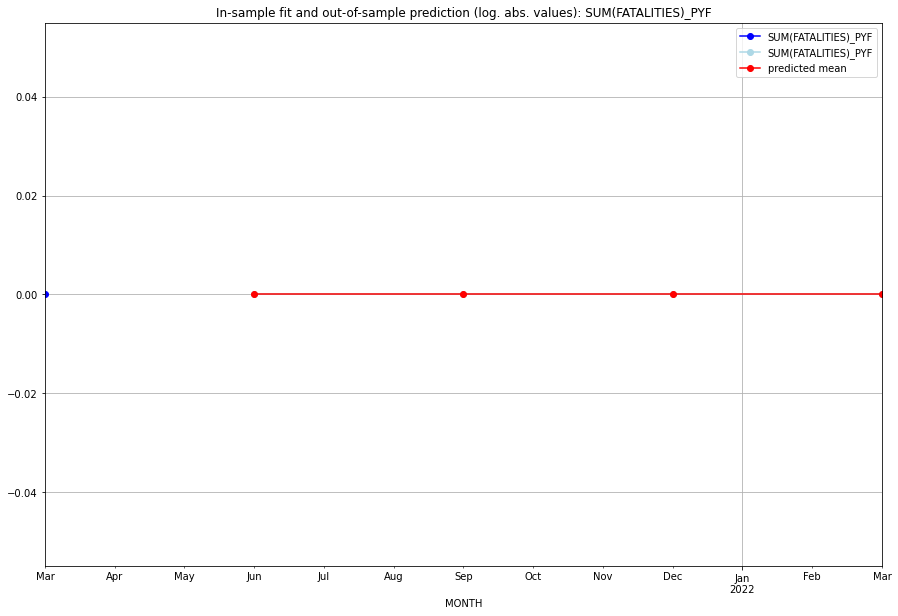

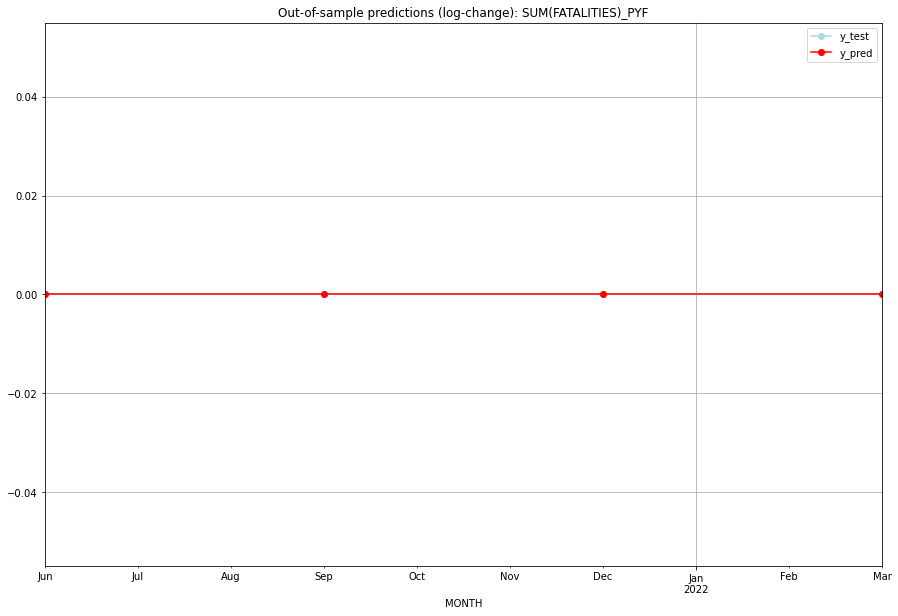

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   PYF   
1 2021-07-01       0.0         0.0           0.0             0.0   PYF   
2 2021-10-01       0.0         0.0           0.0             0.0   PYF   
3 2022-01-01       0.0         0.0           0.0             0.0   PYF   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:05
######## QAT (173/234) #########
0
Neighbor countries: []
Getting Data for QAT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (21, 52)
y: (21, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_QAT   No. Observations:                   17
Model

<Figure size 432x288 with 0 Axes>

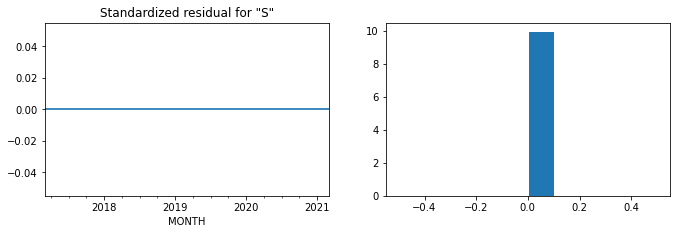

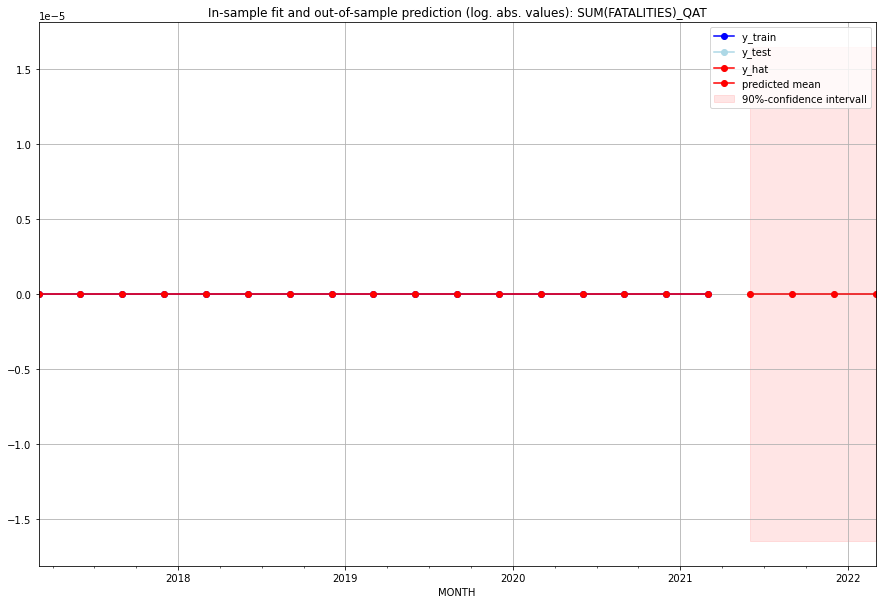

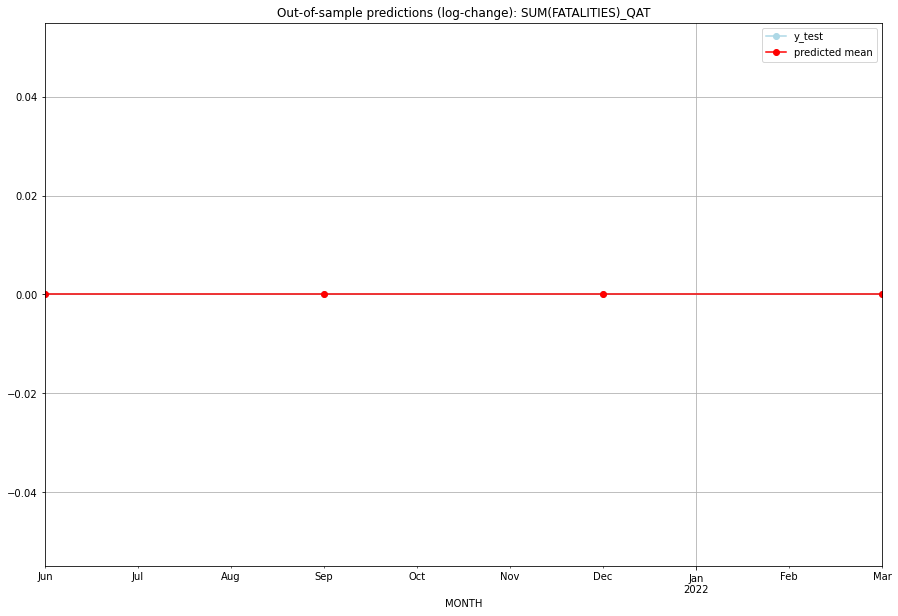

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   QAT   
1 2021-07-01       0.0         0.0           0.0             0.0   QAT   
2 2021-10-01       0.0         0.0           0.0             0.0   QAT   
3 2022-01-01       0.0         0.0           0.0             0.0   QAT   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:05
######## REU (174/234) #########
0
Neighbor countries: []
Getting Data for REU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_REU   No. Observations:                   96
Model:   

<Figure size 432x288 with 0 Axes>

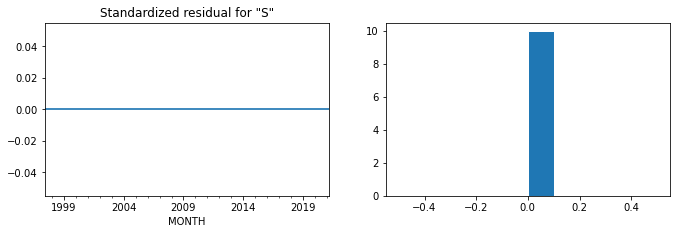

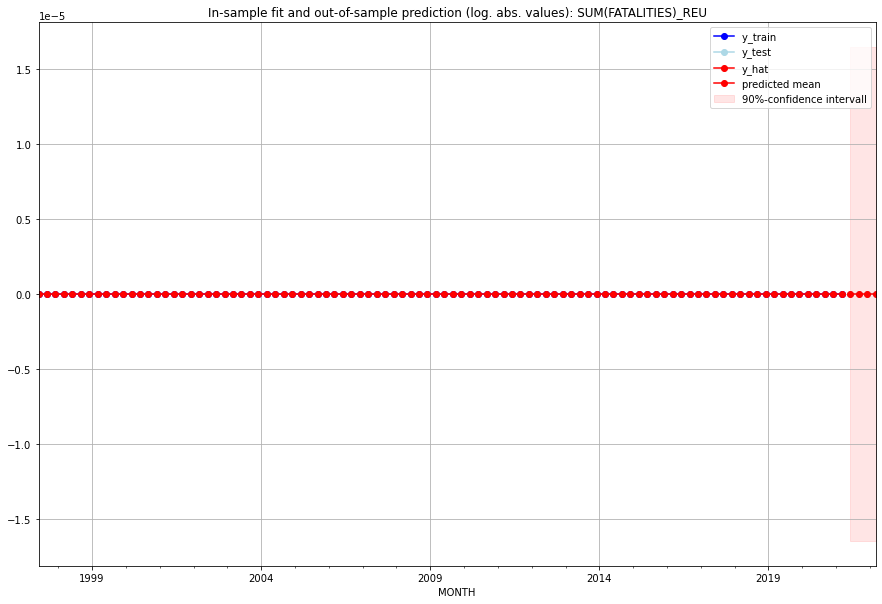

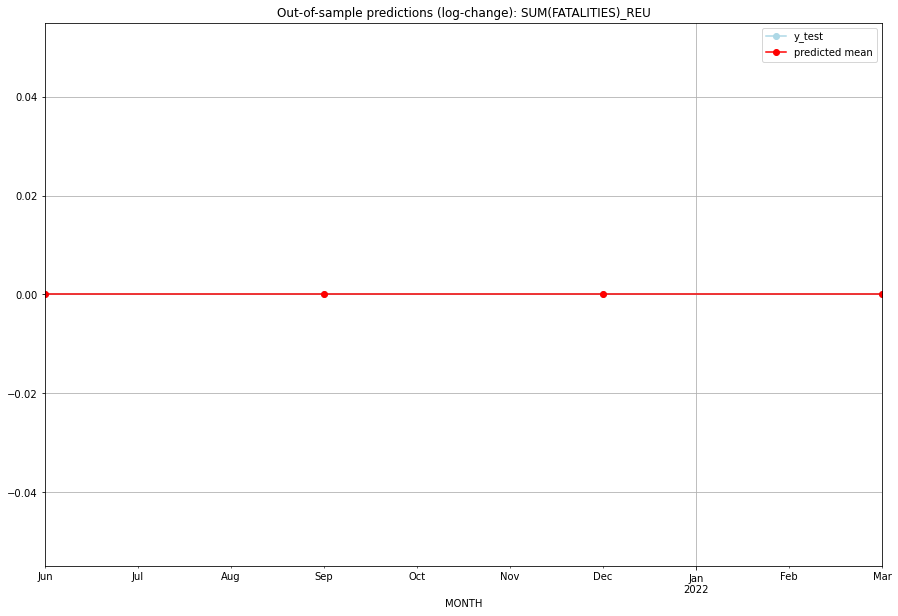

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   REU   
1 2021-07-01       0.0         0.0           0.0             0.0   REU   
2 2021-10-01       0.0         0.0           0.0             0.0   REU   
3 2022-01-01       0.0         0.0           0.0             0.0   REU   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## ROU (175/234) #########
0
Neighbor countries: []
Getting Data for ROU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 64)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.17328679513998632, 'fold_results': [0.17328679513998632, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ROU   No. Observations:                   13
Model:                SARIMAX(0, 0, 2)   Log Likelihood                  -6.225
Date:                 Wed, 19 Oct 2022   AIC                             18.449
Time:                         10:55:22   BIC                             20.144
Sample:                     01-31-2018   HQIC                            18.101
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1      -1.029e-05   1.32e+04  -7.77e-1

<Figure size 432x288 with 0 Axes>

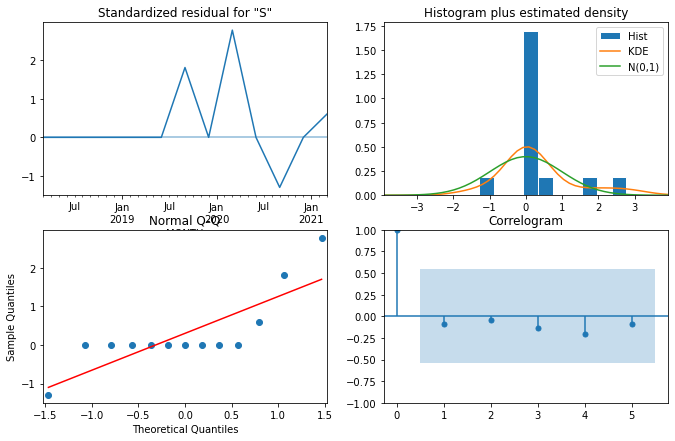

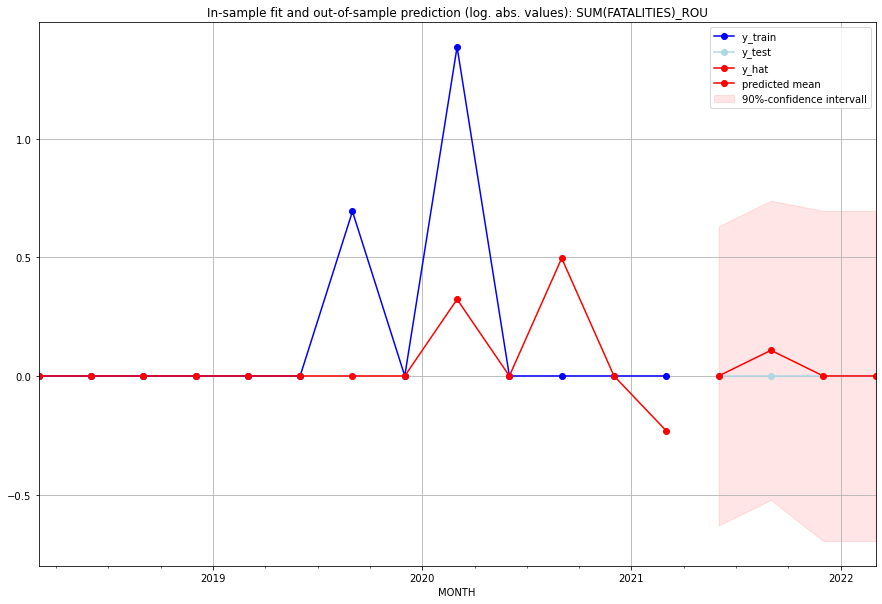

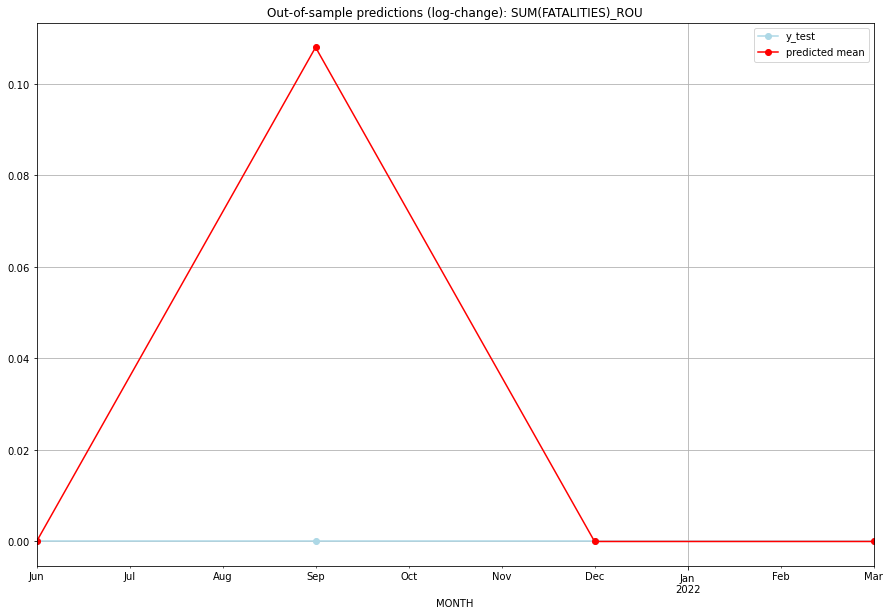

TADDA: 0.02700273021257072
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   0.00000         0.0      0.000000             0.0   ROU   
1 2021-07-01   0.11406         0.0      0.108011             0.0   ROU   
2 2021-10-01   0.00000         0.0      0.000000             0.0   ROU   
3 2022-01-01   0.00000         0.0      0.000000             0.0   ROU   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:06
######## RUS (176/234) #########
0
Neighbor countries: []
Getting Data for RUS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 63)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU co

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6055457531689299, 'fold_results': [0.5498736814676899, 0.6612178248701699]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_RUS   No. Observations:                   13
Model:                SARIMAX(0, 1, 0)   Log Likelihood                  -6.677
Date:                 Wed, 19 Oct 2022   AIC                             15.355
Time:                         10:55:30   BIC                             15.840
Sample:                     01-31-2018   HQIC                            15.175
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1782      0.

<Figure size 432x288 with 0 Axes>

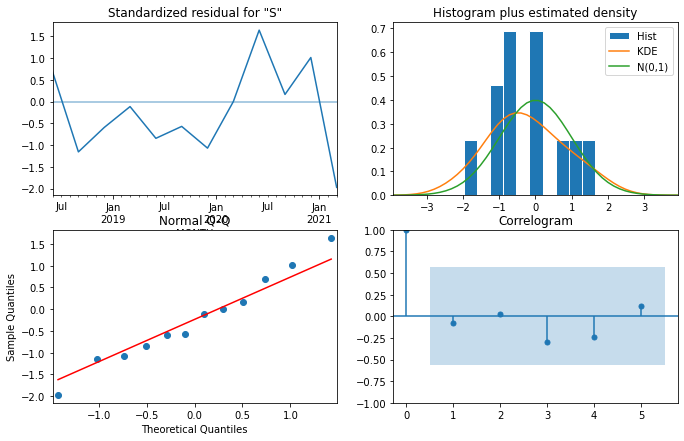

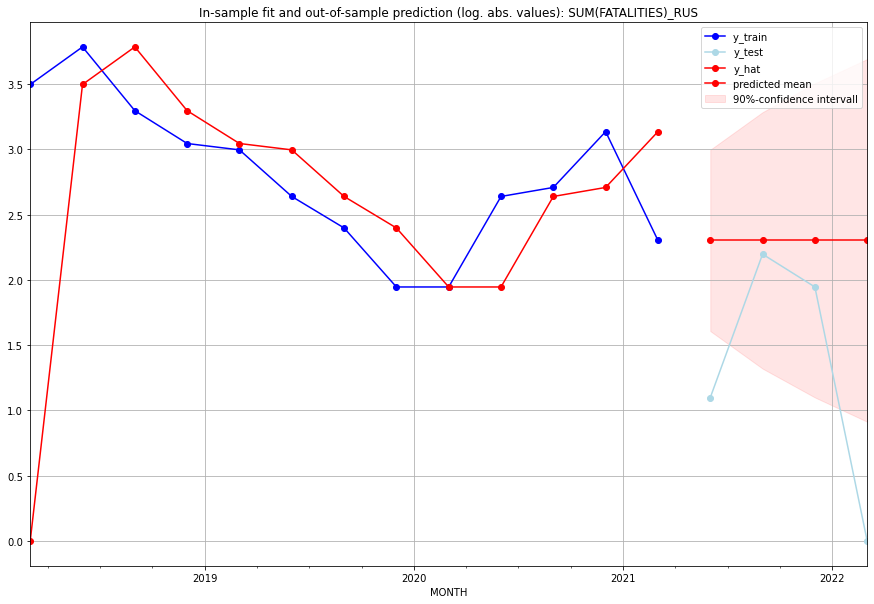

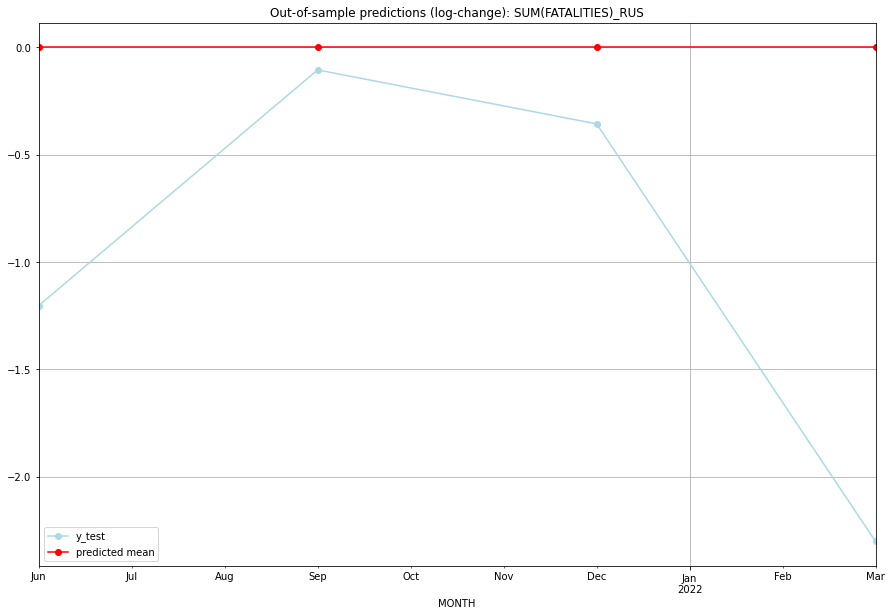

TADDA: 0.9921483392291353
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       9.0         2.0           0.0       -1.203973   RUS   
1 2021-07-01       9.0         8.0           0.0       -0.105361   RUS   
2 2021-10-01       9.0         6.0           0.0       -0.356675   RUS   
3 2022-01-01       9.0         0.0           0.0       -2.302585   RUS   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## RWA (177/234) #########
0
Neighbor countries: []
Getting Data for RWA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU c

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 1.0506998693589407, 'fold_results': [0.8531657935926029, 1.0540977442373805, 1.108964049135126, 1.7660174265235546, 0.47125433330603905]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_RWA   No. Observations:                   96
Model:                SARIMAX(0, 1, 1)   Log Likelihood                -171.692
Date:                 Wed, 19 Oct 2022   AIC                            347.383
Time:                         10:55:52   BIC                            352.491
Sample:                     04-30-1997   HQIC                           349.447
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

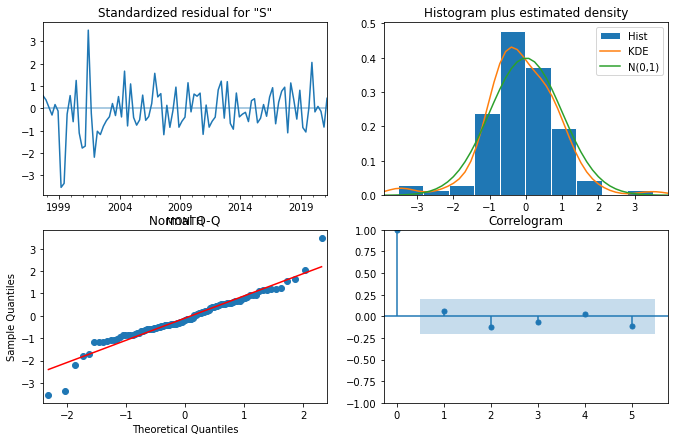

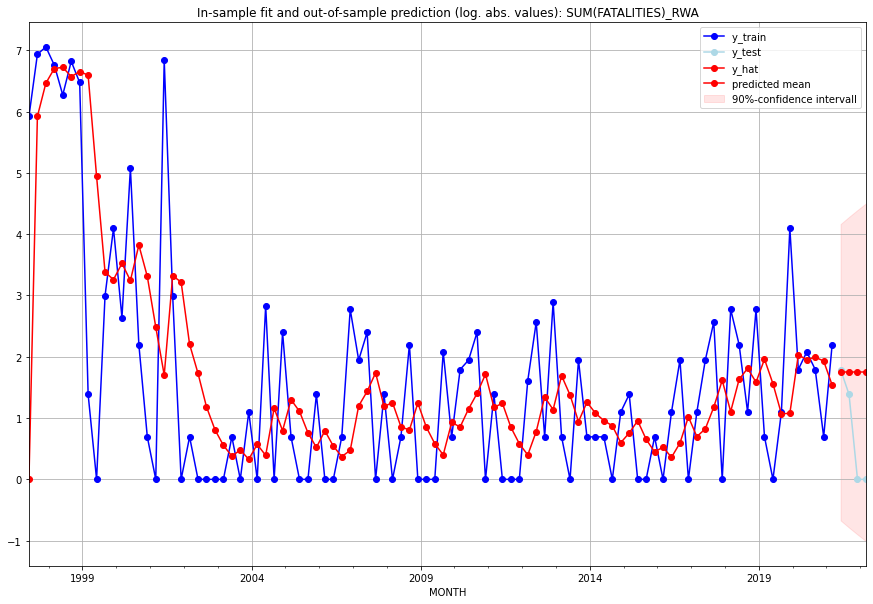

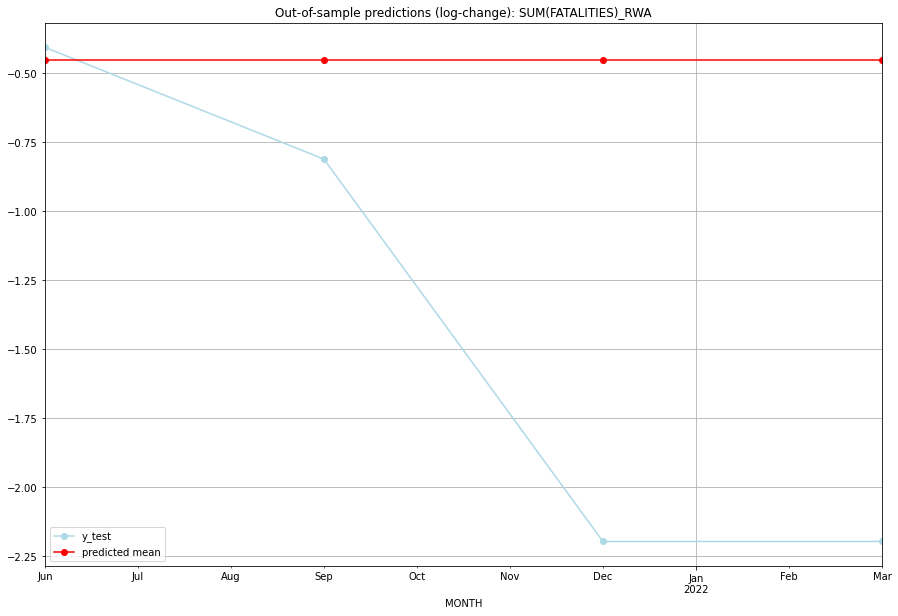

TADDA: 0.9749903434252069
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  4.738789         5.0     -0.449976       -0.405465   RWA   
1 2021-07-01  4.738789         3.0     -0.449976       -0.810930   RWA   
2 2021-10-01  4.738789         0.0     -0.449976       -2.197225   RWA   
3 2022-01-01  4.738789         0.0     -0.449976       -2.197225   RWA   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## SAU (178/234) #########
0
Neighbor countries: []
Getting Data for SAU
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (29, 55)
y: (29, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6550567944083907, 'fold_results': [0.9466398258183949, 0.4556367732635853, 0.17905906239493619, 0.4979943188029934, 1.1959539917620439]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SAU   No. Observations:                   25
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -40.334
Date:                 Wed, 19 Oct 2022   AIC                             82.668
Time:                         10:56:13   BIC                             83.846
Sample:                     01-31-2015   HQIC                            82.981
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

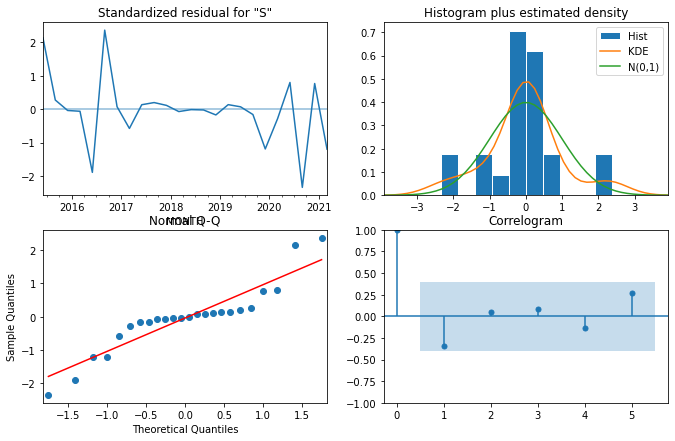

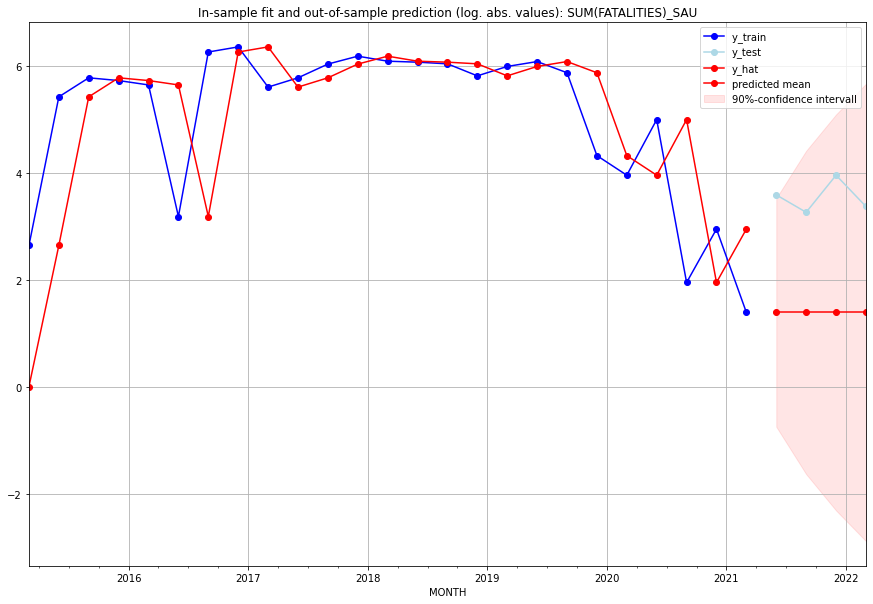

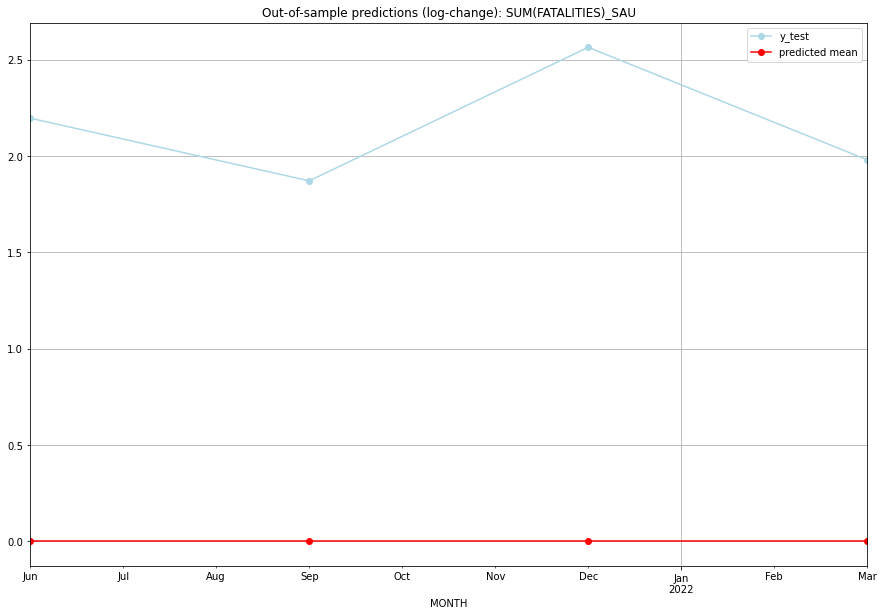

TADDA: 2.1537443951414827
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       3.0        35.0           0.0        2.197225   SAU   
1 2021-07-01       3.0        25.0           0.0        1.871802   SAU   
2 2021-10-01       3.0        51.0           0.0        2.564949   SAU   
3 2022-01-01       3.0        28.0           0.0        1.981001   SAU   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## SDN (179/234) #########
0
Neighbor countries: []
Getting Data for SDN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 60)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU c

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5025839497215215, 'fold_results': [0.7464151618205284, 0.7664859912753899, 0.24502656281148094, 0.2594325896102707, 0.4955594430899377]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SDN   No. Observations:                   96
Model:                SARIMAX(3, 0, 3)   Log Likelihood                -132.306
Date:                 Wed, 19 Oct 2022   AIC                            282.612
Time:                         10:56:31   BIC                            305.691
Sample:                     04-30-1997   HQIC                           291.941
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

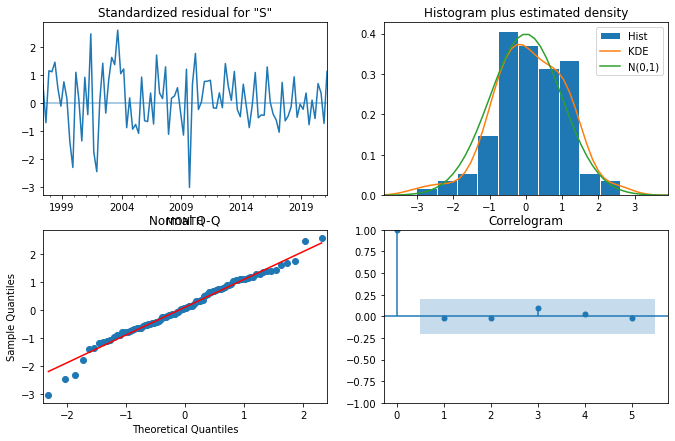

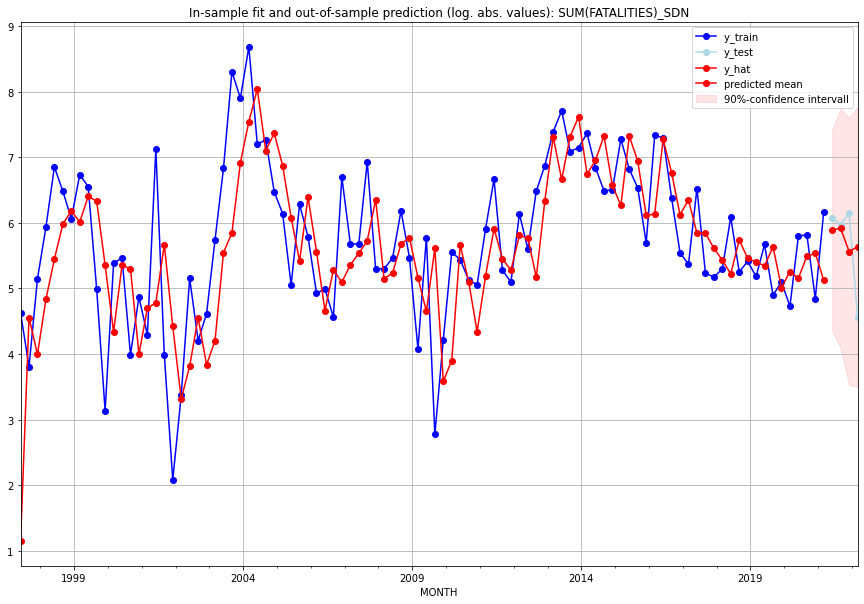

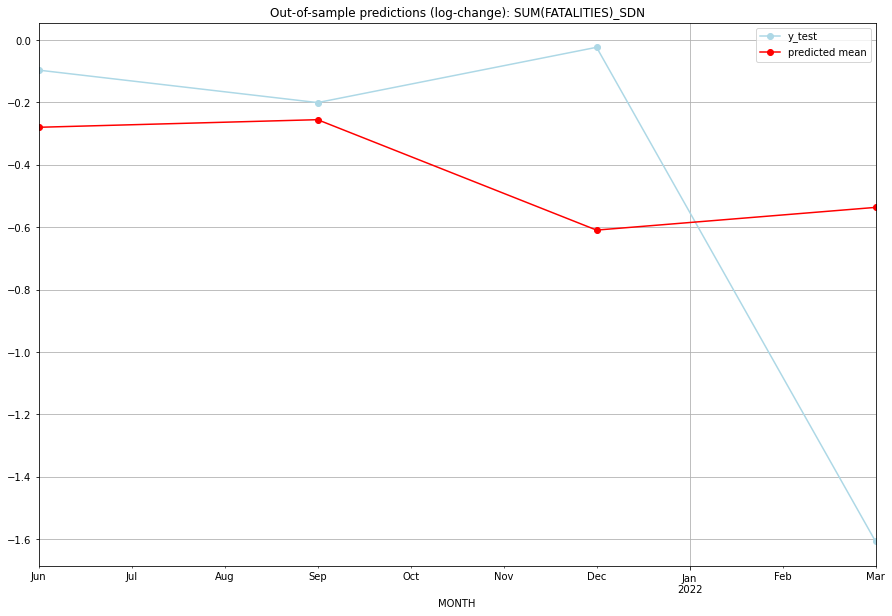

TADDA: 0.4737368338730965
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  361.164224       434.0     -0.279603       -0.096355   SDN   
1 2021-07-01  370.099609       391.0     -0.255230       -0.200439   SDN   
2 2021-10-01  259.483662       467.0     -0.609160       -0.023232   SDN   
3 2022-01-01  279.150730        95.0     -0.536373       -1.607352   SDN   

                                          PARAMETERS  
0  {'params': [2, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## SEN (180/234) #########
0
Neighbor countries: []
Getting Data for SEN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV o

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.8159656429073203, 'fold_results': [0.7871656166852145, 0.6435885937175685, 1.6497735273953364, 0.57536535864613, 0.42393511809235185]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SEN   No. Observations:                   96
Model:                SARIMAX(3, 0, 3)   Log Likelihood                -158.522
Date:                 Wed, 19 Oct 2022   AIC                            337.044
Time:                         10:56:56   BIC                            362.688
Sample:                     04-30-1997   HQIC                           347.410
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

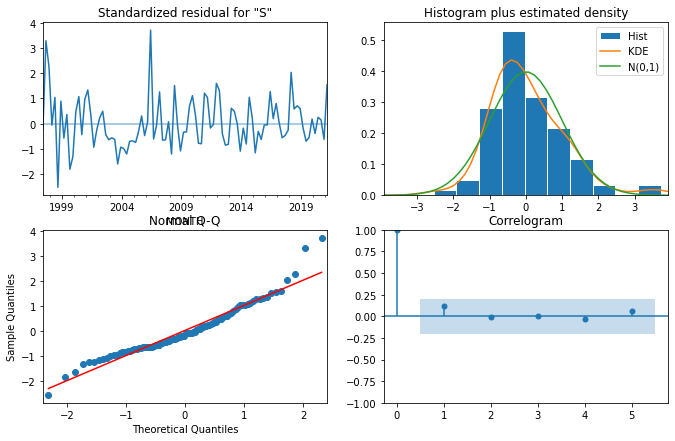

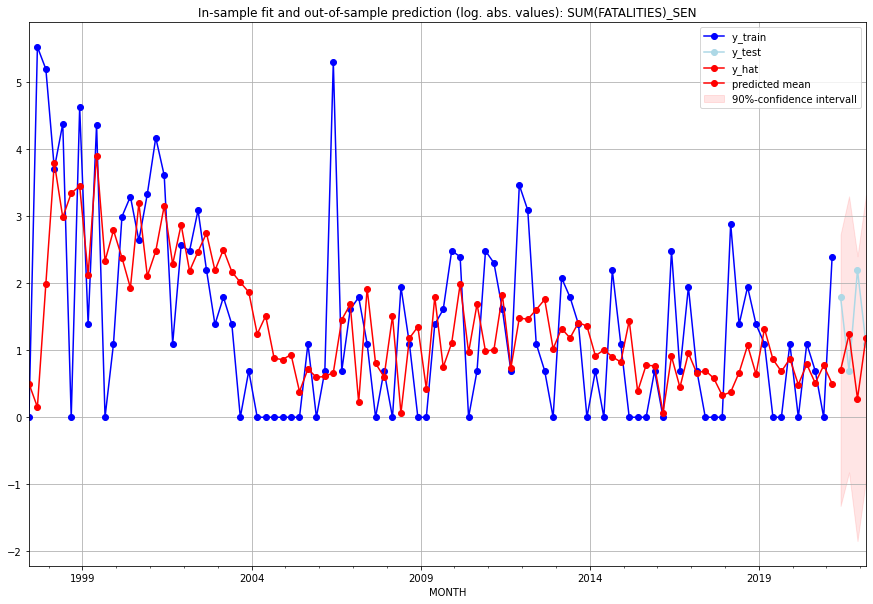

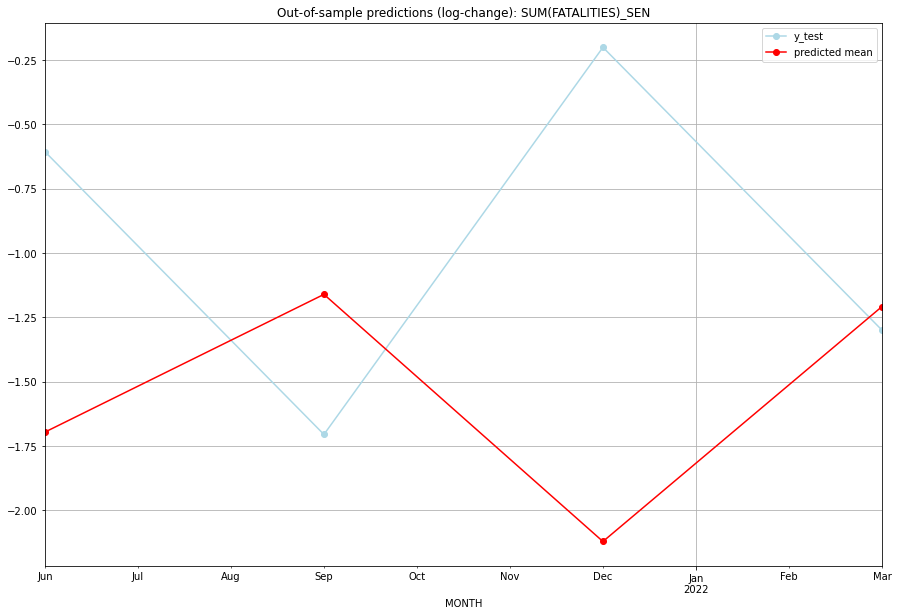

TADDA: 0.9112042340760689
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.018650         5.0     -1.695466       -0.606136   SEN   
1 2021-07-01  2.446770         1.0     -1.160458       -1.704748   SEN   
2 2021-10-01  0.319716         8.0     -2.120479       -0.200671   SEN   
3 2022-01-01  2.287083         2.0     -1.207895       -1.299283   SEN   

                                          PARAMETERS  
0  {'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:23
######## SGP (181/234) #########
0
Neighbor countries: []
Getting Data for SGP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 55)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient d

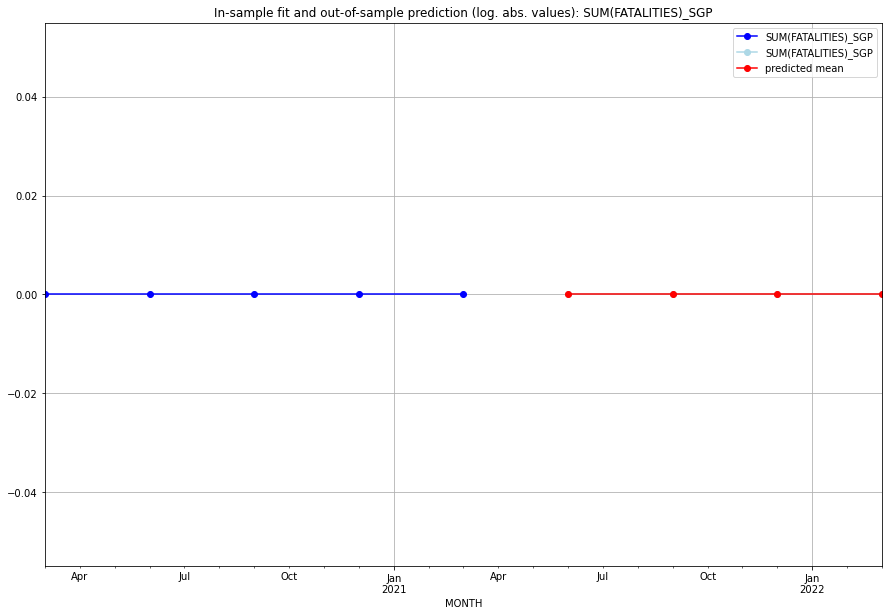

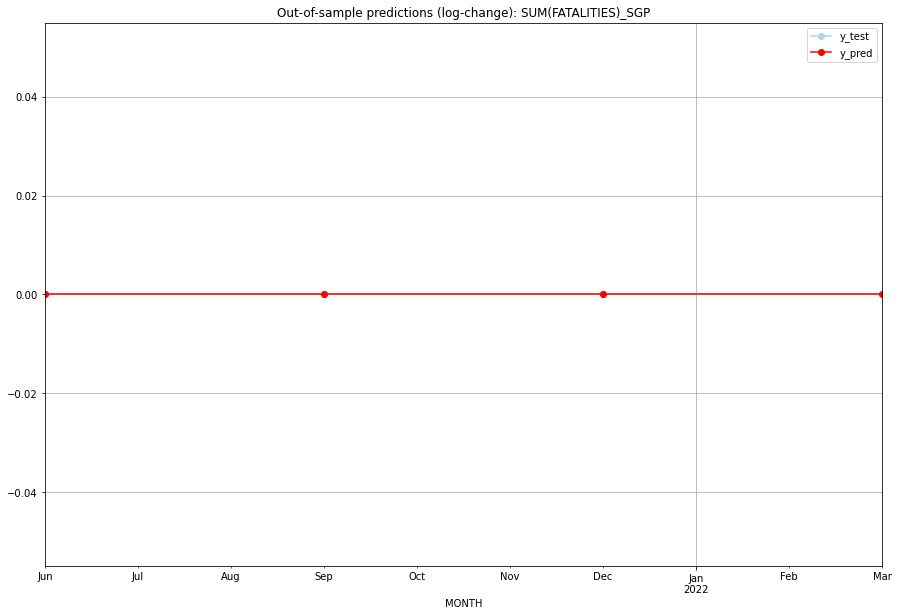

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SGP   
1 2021-07-01       0.0         0.0           0.0             0.0   SGP   
2 2021-10-01       0.0         0.0           0.0             0.0   SGP   
3 2022-01-01       0.0         0.0           0.0             0.0   SGP   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## SHN (182/234) #########
0
Neighbor countries: []
Getting Data for SHN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SHN   No. Observations:                   96
Mode

<Figure size 432x288 with 0 Axes>

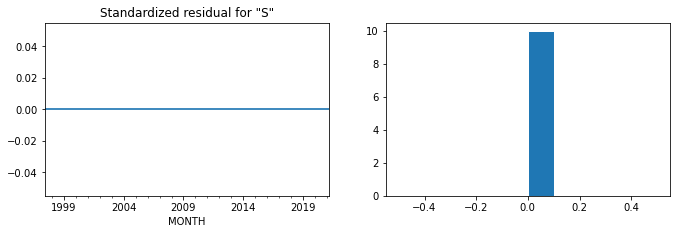

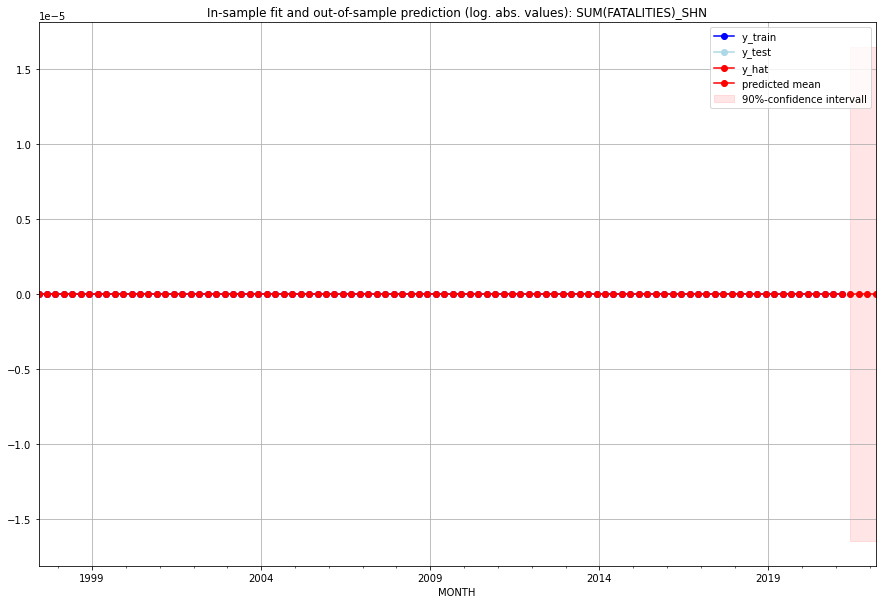

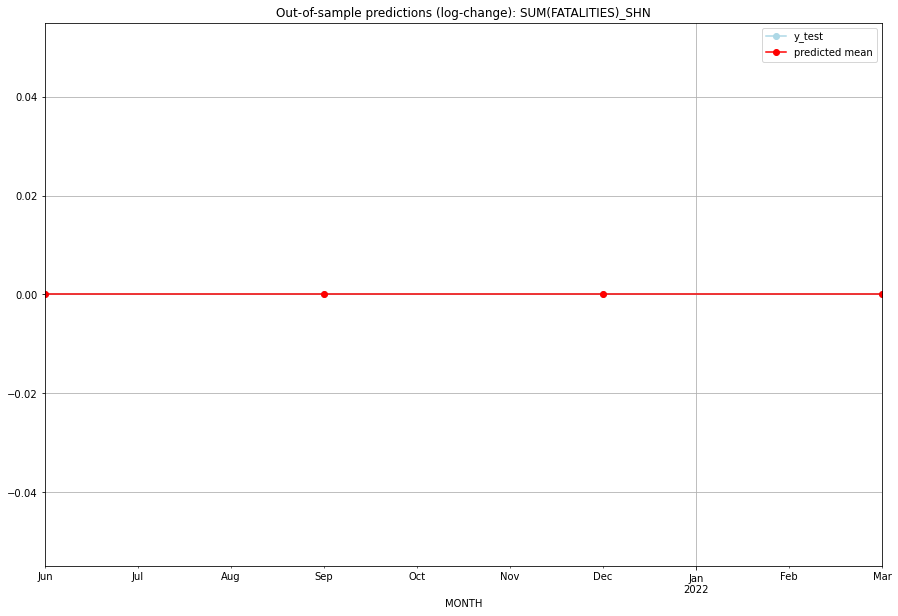

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SHN   
1 2021-07-01       0.0         0.0           0.0             0.0   SHN   
2 2021-10-01       0.0         0.0           0.0             0.0   SHN   
3 2022-01-01       0.0         0.0           0.0             0.0   SHN   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## SJM (183/234) #########
0
Neighbor countries: []
Getting Data for SJM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


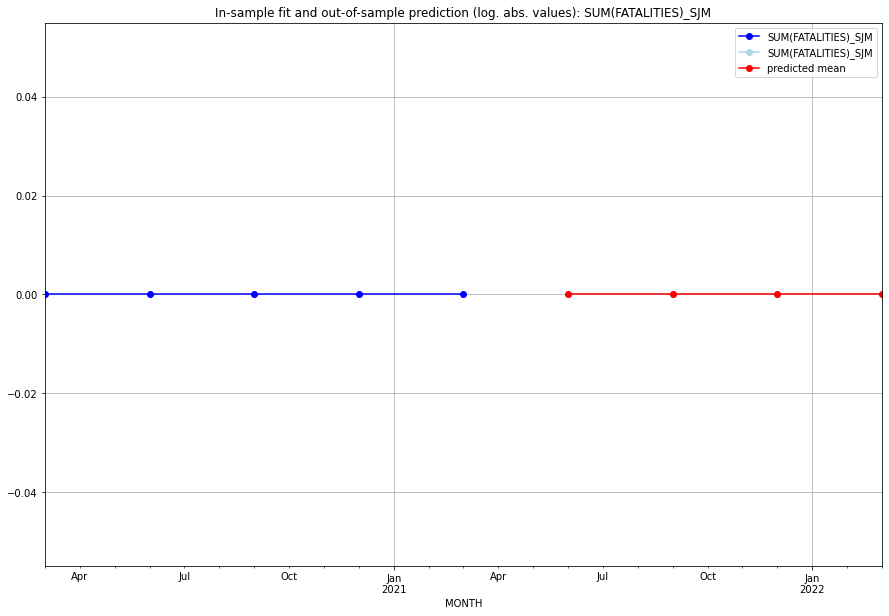

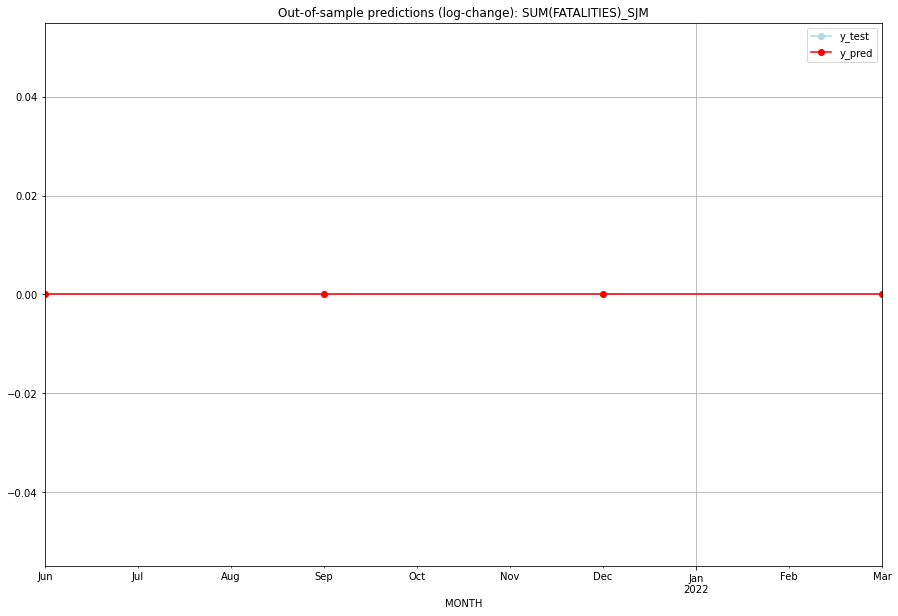

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SJM   
1 2021-07-01       0.0         0.0           0.0             0.0   SJM   
2 2021-10-01       0.0         0.0           0.0             0.0   SJM   
3 2022-01-01       0.0         0.0           0.0             0.0   SJM   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## SLB (184/234) #########
0
Neighbor countries: []
Getting Data for SLB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 57)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


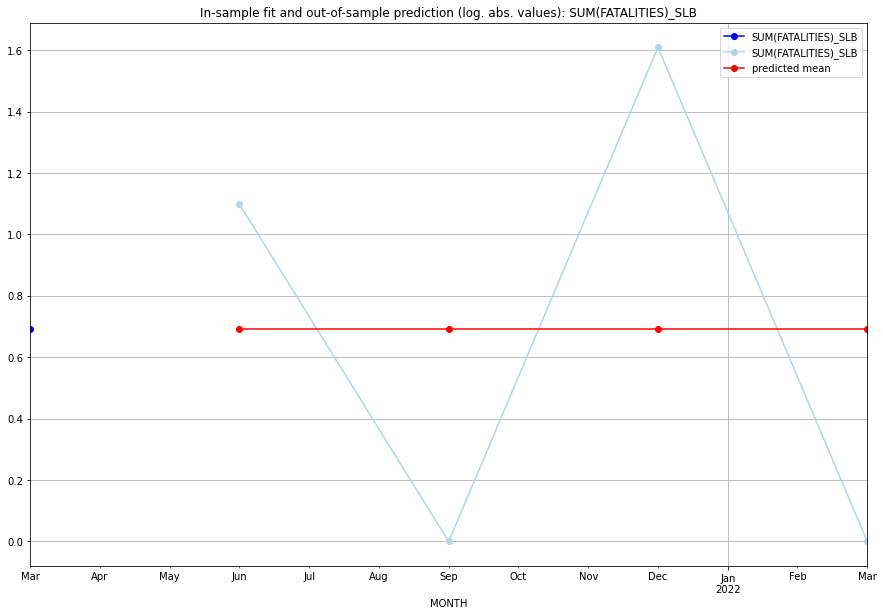

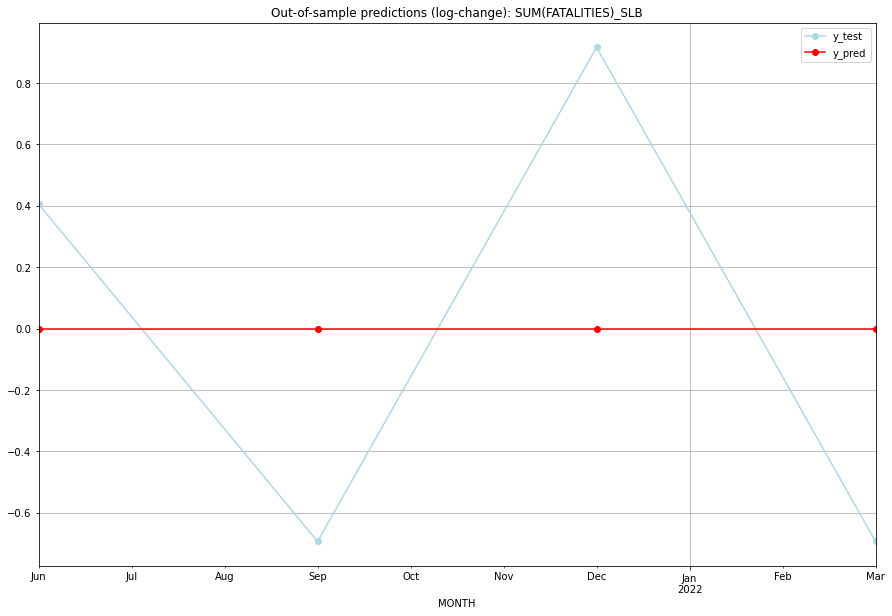

TADDA: 0.6770125502755526
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.693147    1.098612           0.0        0.405465   SLB   
1 2021-07-01  0.693147    0.000000           0.0       -0.693147   SLB   
2 2021-10-01  0.693147    1.609438           0.0        0.916291   SLB   
3 2022-01-01  0.693147    0.000000           0.0       -0.693147   SLB   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:08
######## SLE (185/234) #########
0
Neighbor countries: []
Getting Data for SLE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8385010378488336, 'fold_results': [0.6597643324038145, 0.3465735902799727, 0.7489330683884977, 0.6597643324038146, 1.777469865768068]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SLE   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -137.759
Date:                 Wed, 19 Oct 2022   AIC                            277.518
Time:                         10:57:32   BIC                            280.072
Sample:                     04-30-1997   HQIC                           278.550
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

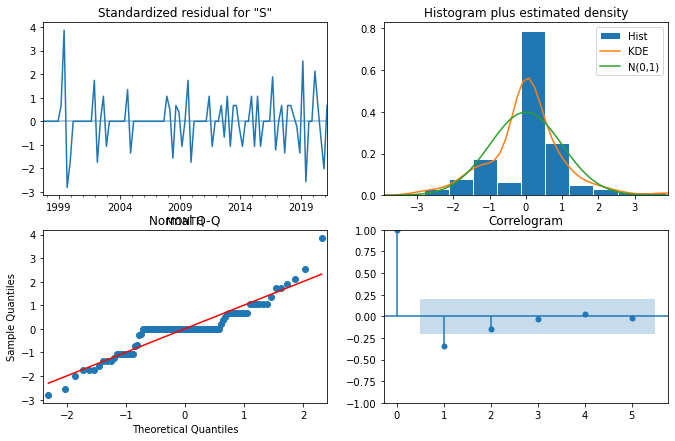

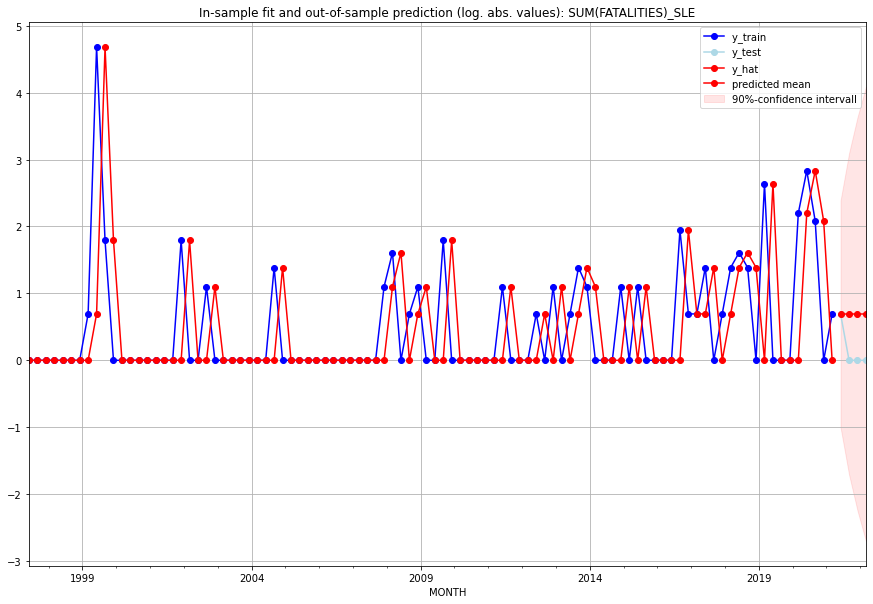

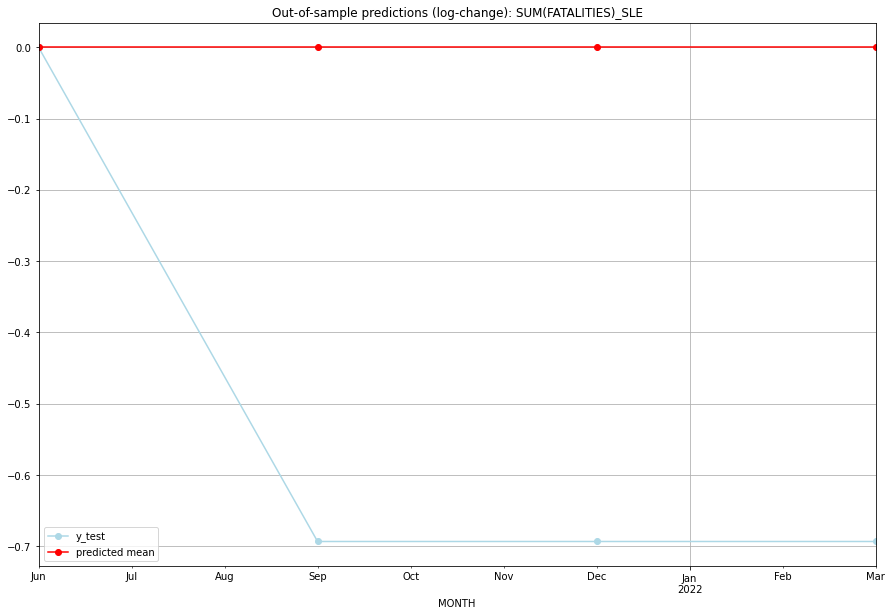

TADDA: 0.5198603854199588
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       1.0         1.0 -1.110223e-16        0.000000   SLE   
1 2021-07-01       1.0         0.0 -1.110223e-16       -0.693147   SLE   
2 2021-10-01       1.0         0.0 -1.110223e-16       -0.693147   SLE   
3 2022-01-01       1.0         0.0 -1.110223e-16       -0.693147   SLE   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## SLV (186/234) #########
0
Neighbor countries: []
Getting Data for SLV
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 63)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.2892158402181231, 'fold_results': [0.2892158402181231, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SLV   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                  -5.965
Date:                 Wed, 19 Oct 2022   AIC                             23.930
Time:                         10:57:46   BIC                             27.320
Sample:                     01-31-2018   HQIC                            23.234
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0470      1.335      0.035 

<Figure size 432x288 with 0 Axes>

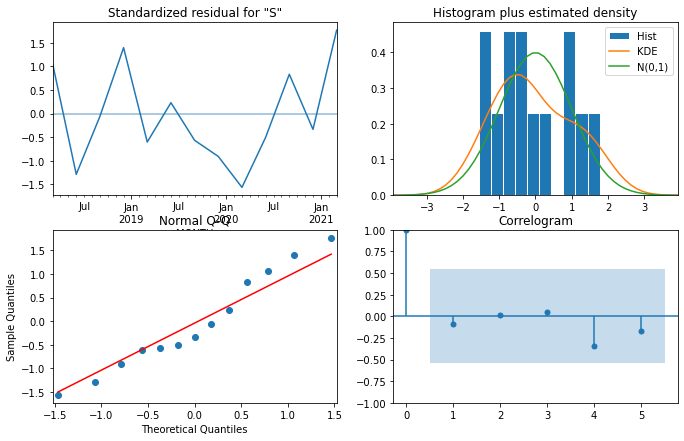

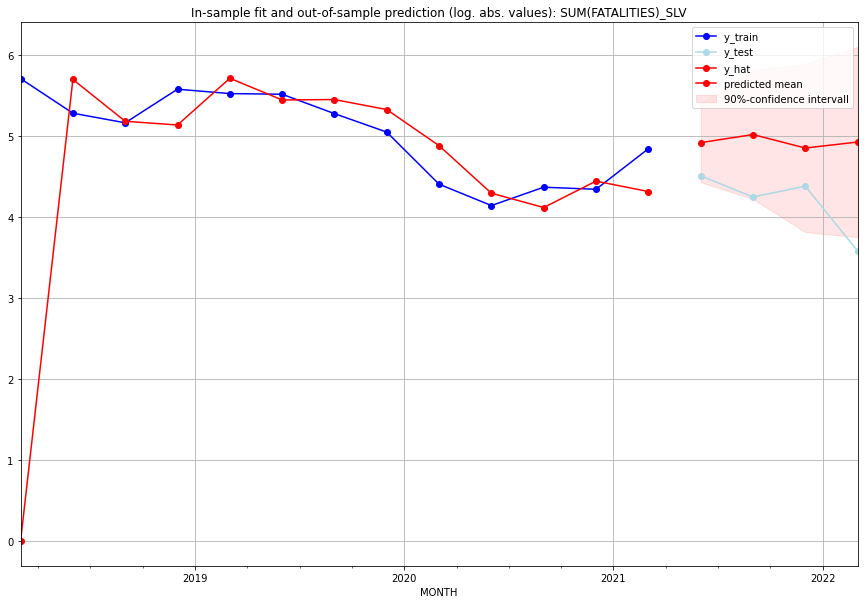

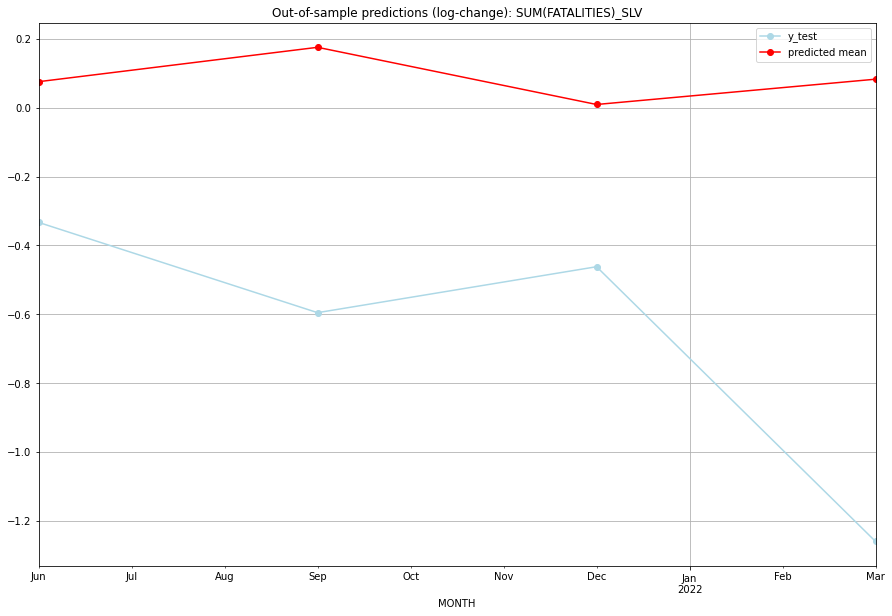

TADDA: 0.8345259439957866
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  135.967448        90.0      0.075556       -0.333328   SLV   
1 2021-07-01  150.357324        69.0      0.175456       -0.595692   SLV   
2 2021-10-01  127.186264        79.0      0.009297       -0.462160   SLV   
3 2022-01-01  136.965701        35.0      0.082818       -1.260668   SLV   

                                          PARAMETERS  
0  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## SMR (187/234) #########
0
Neighbor countries: []
Getting Data for SMR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 32)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insu

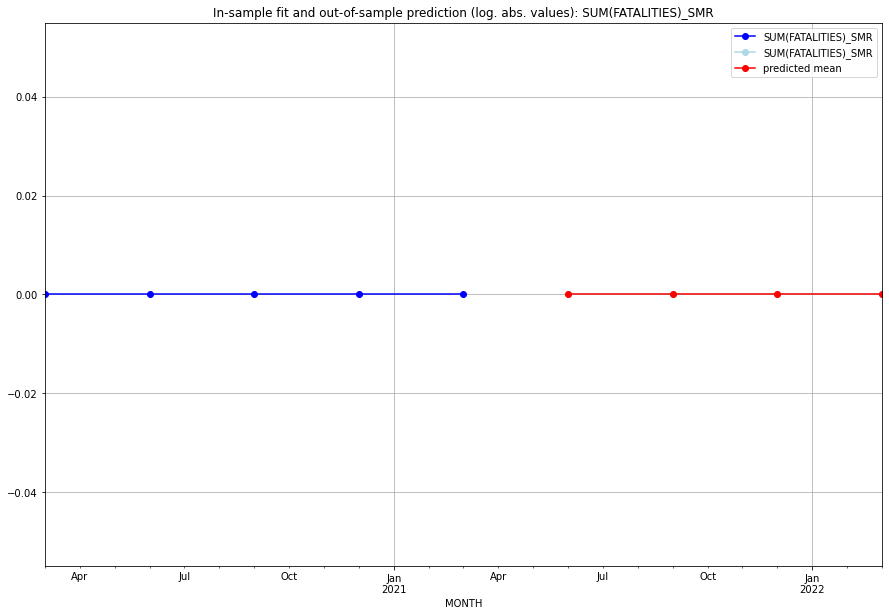

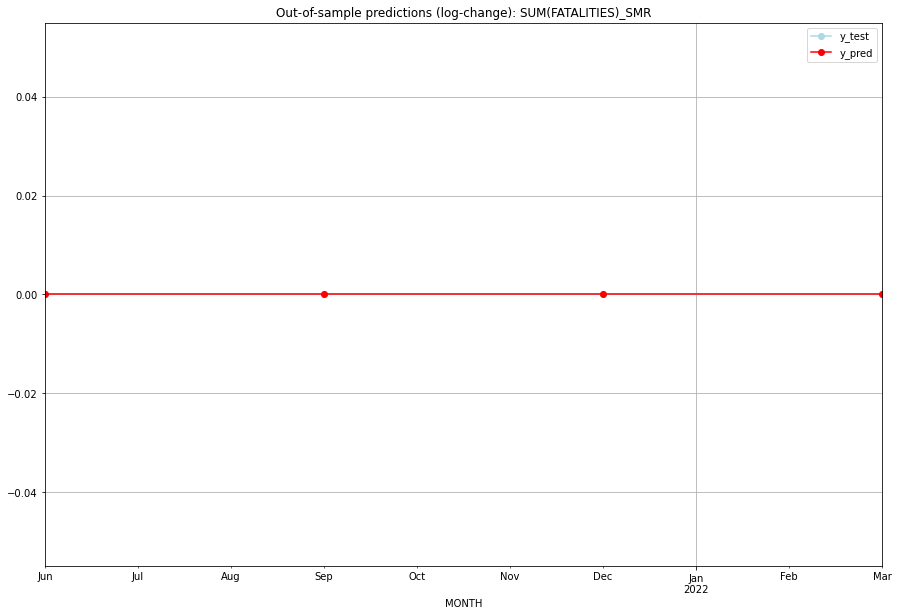

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SMR   
1 2021-07-01       0.0         0.0           0.0             0.0   SMR   
2 2021-10-01       0.0         0.0           0.0             0.0   SMR   
3 2022-01-01       0.0         0.0           0.0             0.0   SMR   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:01
######## SOM (188/234) #########
0
Neighbor countries: []
Getting Data for SOM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 44)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.2514490394538405, 'fold_results': [0.4873295266368738, 0.2684679808271433, 0.16179258213088898, 0.1474657646685893, 0.19218934300570711]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SOM   No. Observations:                   96
Model:                SARIMAX(1, 0, 1)   Log Likelihood                -127.125
Date:                 Wed, 19 Oct 2022   AIC                            264.250
Time:                         10:58:06   BIC                            277.071
Sample:                     04-30-1997   HQIC                           269.432
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

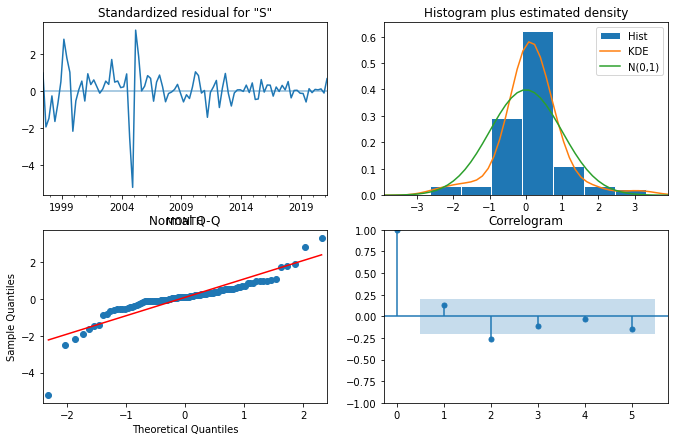

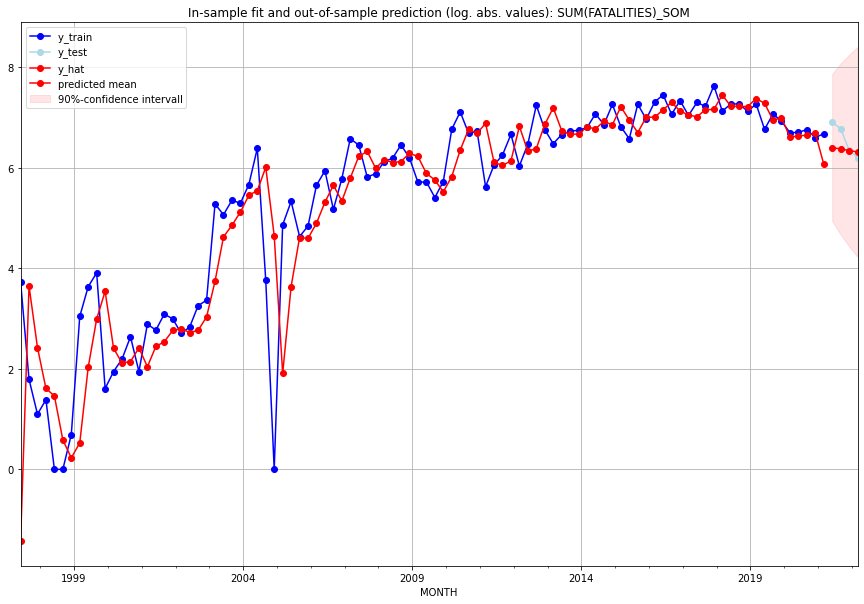

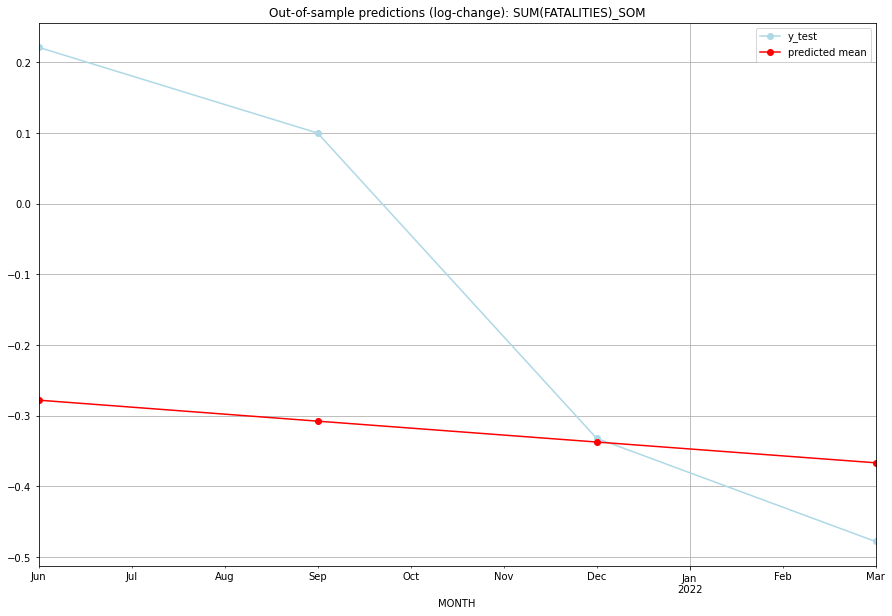

TADDA: 0.40233325487894644
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  604.794065       997.0     -0.278072        0.221142   SOM   
1 2021-07-01  587.069173       883.0     -0.307767        0.099845   SOM   
2 2021-10-01  569.951799       573.0     -0.337307       -0.331982   SOM   
3 2022-01-01  553.418554       495.0     -0.366692       -0.478036   SOM   

                                          PARAMETERS  
0  {'params': [2, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (1, 0, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:20
######## SRB (189/234) #########
0
Neighbor countries: []
Getting Data for SRB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 63)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08664339756999316, 'fold_results': [0.17328679513998632, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SRB   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                  -9.658
Date:                 Wed, 19 Oct 2022   AIC                             21.316
Time:                         10:58:20   BIC                             21.881
Sample:                     01-31-2018   HQIC                            21.199
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.2587      0.071      3.62

<Figure size 432x288 with 0 Axes>

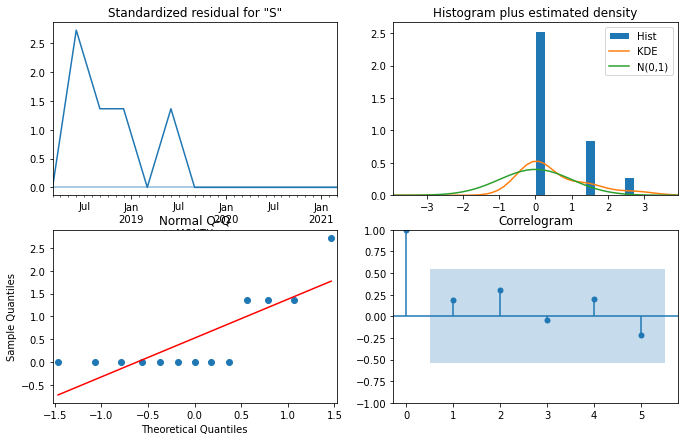

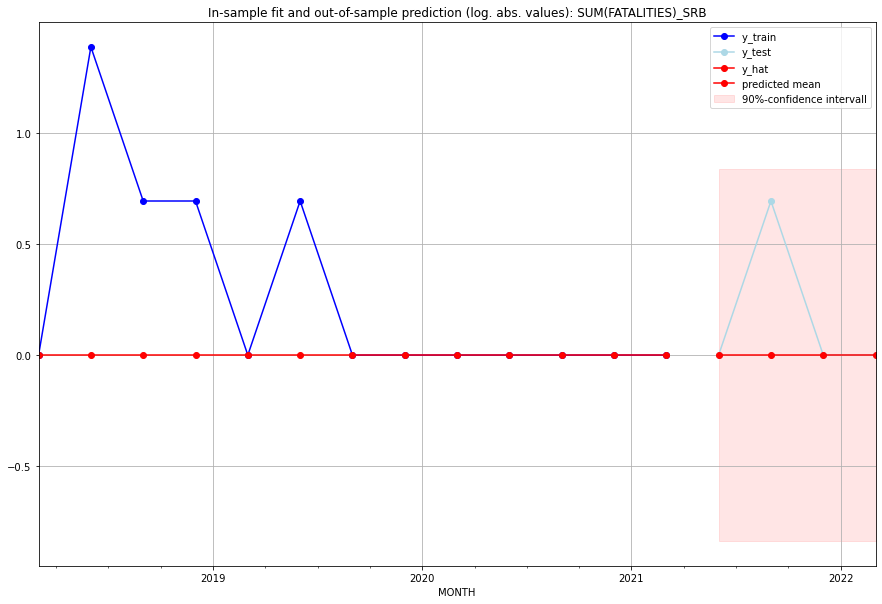

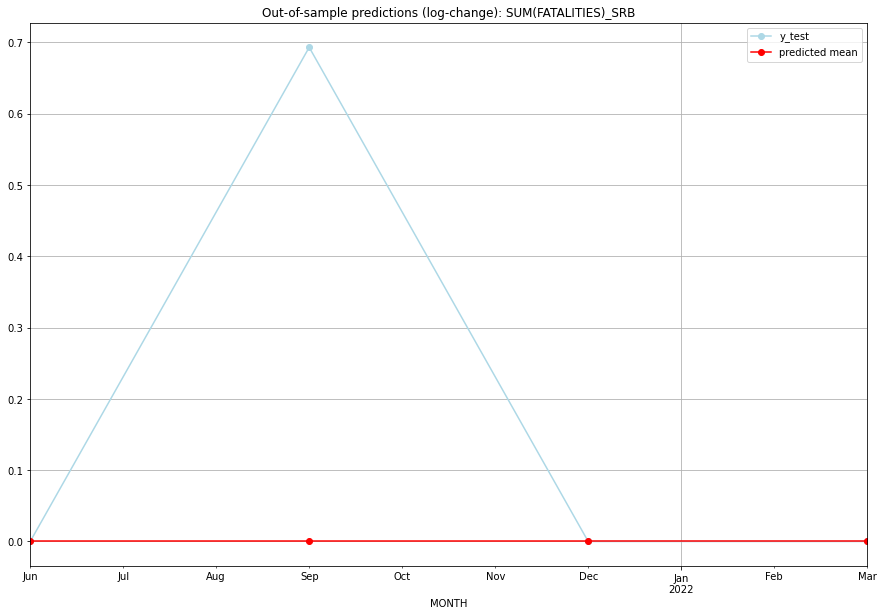

TADDA: 0.17328679513998632
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0        0.000000   SRB   
1 2021-07-01       0.0         1.0           0.0        0.693147   SRB   
2 2021-10-01       0.0         0.0           0.0        0.000000   SRB   
3 2022-01-01       0.0         0.0           0.0        0.000000   SRB   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:11
######## SSD (190/234) #########
0
Neighbor countries: []
Getting Data for SSD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 54)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5857891518998084, 'fold_results': [0.5456235628259258, 0.1709467598608907, 1.0185712017213453, 0.39290030863772807, 0.8009039264531523]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SSD   No. Observations:                   96
Model:                SARIMAX(1, 1, 0)   Log Likelihood                -144.785
Date:                 Wed, 19 Oct 2022   AIC                            293.570
Time:                         10:58:35   BIC                            298.677
Sample:                     04-30-1997   HQIC                           295.634
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

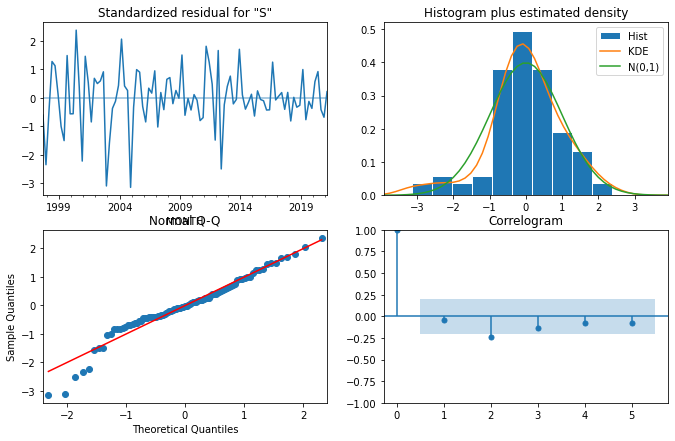

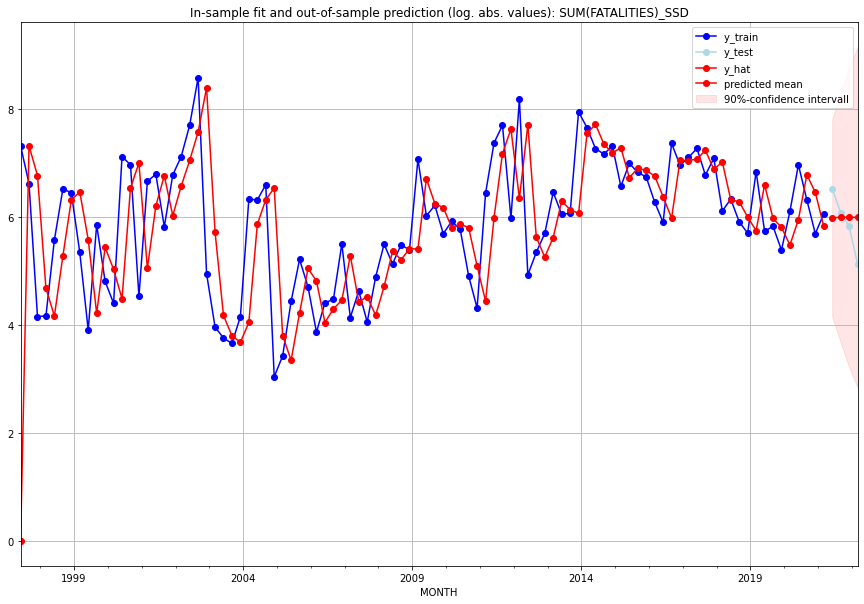

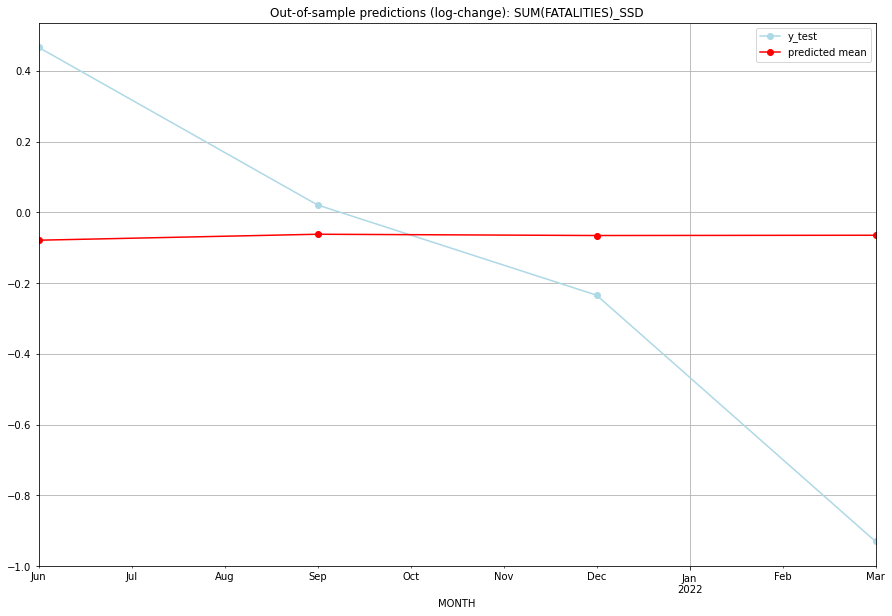

TADDA: 0.45069612582167595
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  397.301229       686.0     -0.078900        0.466226   SSD   
1 2021-07-01  404.077411       439.0     -0.062030        0.020667   SSD   
2 2021-10-01  402.618964       340.0     -0.065637       -0.234226   SSD   
3 2022-01-01  402.930354       169.0     -0.064866       -0.930310   SSD   

                                          PARAMETERS  
0  {'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:17
######## STP (191/234) #########
0
Neighbor countries: []
Getting Data for STP
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 52)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_STP   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                 118.056
Date:                 Wed, 19 Oct 2022   AIC                           -234.112
Time:                         10:59:20   BIC                           -231.547
Sample:                     04-30-1997   HQIC                          -233.075
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0050      0.000     47.749      0.000     

<Figure size 432x288 with 0 Axes>

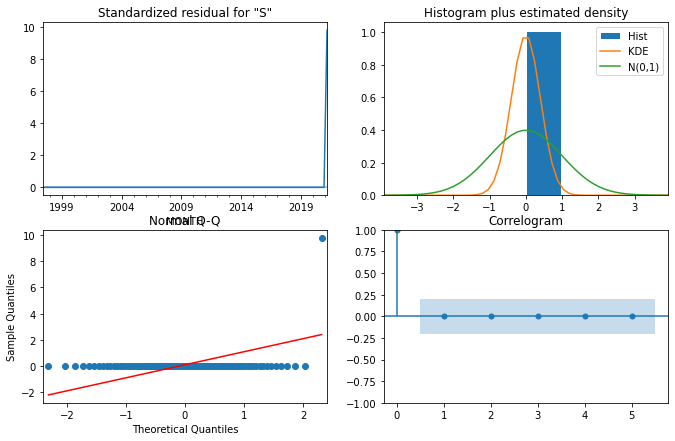

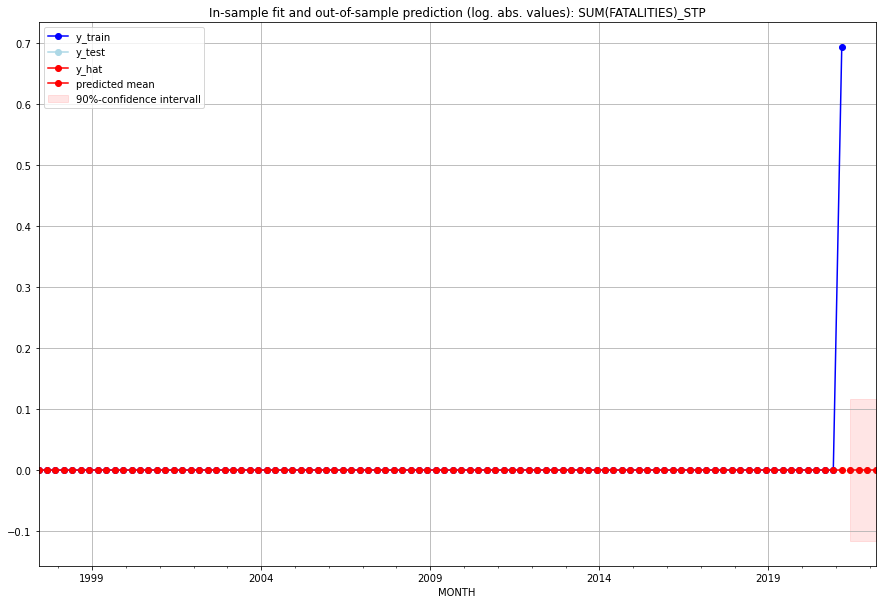

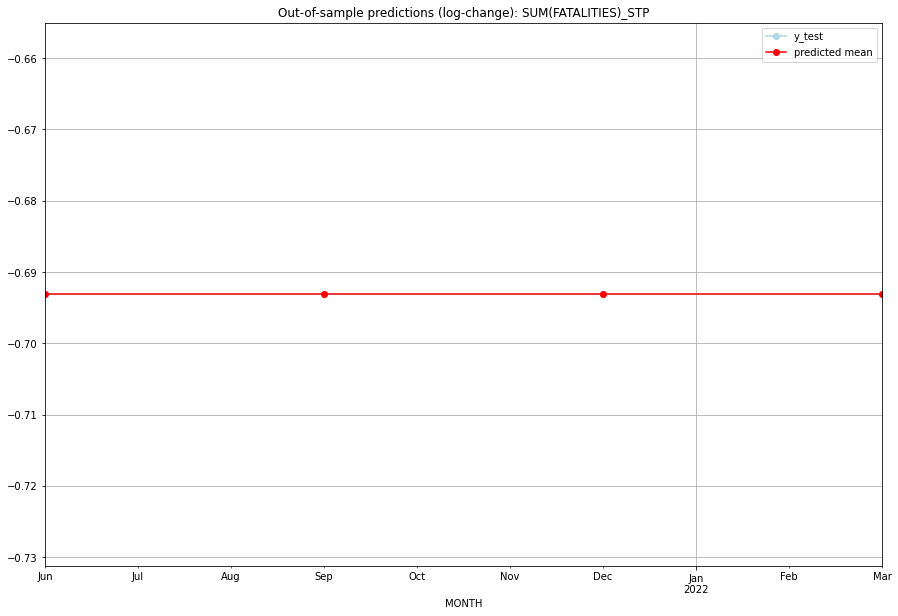

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0     -0.693147       -0.693147   STP   
1 2021-07-01       0.0         0.0     -0.693147       -0.693147   STP   
2 2021-10-01       0.0         0.0     -0.693147       -0.693147   STP   
3 2022-01-01       0.0         0.0     -0.693147       -0.693147   STP   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:46
######## SUR (192/234) #########
0
Neighbor countries: []
Getting Data for SUR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 56)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 paramet

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5198603854199589, 'fold_results': [0.8664339756999315, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SUR   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                 -11.976
Date:                 Wed, 19 Oct 2022   AIC                             25.952
Time:                         10:59:31   BIC                             26.517
Sample:                     01-31-2018   HQIC                            25.836
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.3696      0

<Figure size 432x288 with 0 Axes>

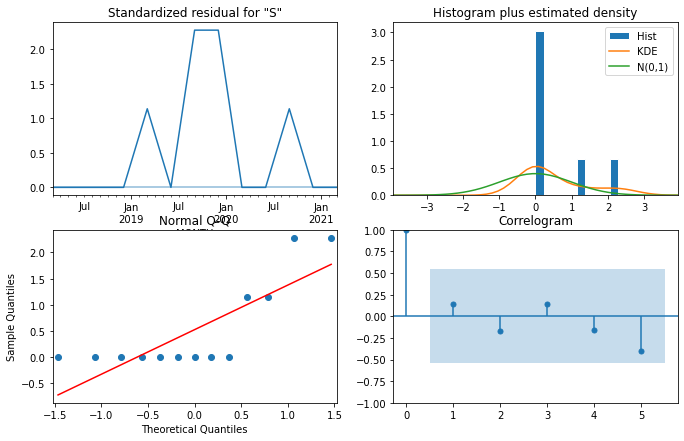

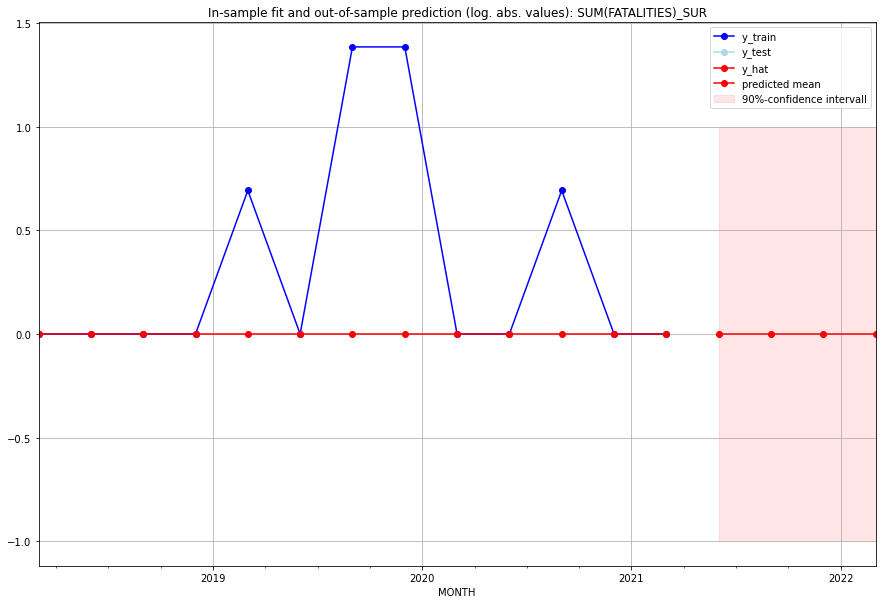

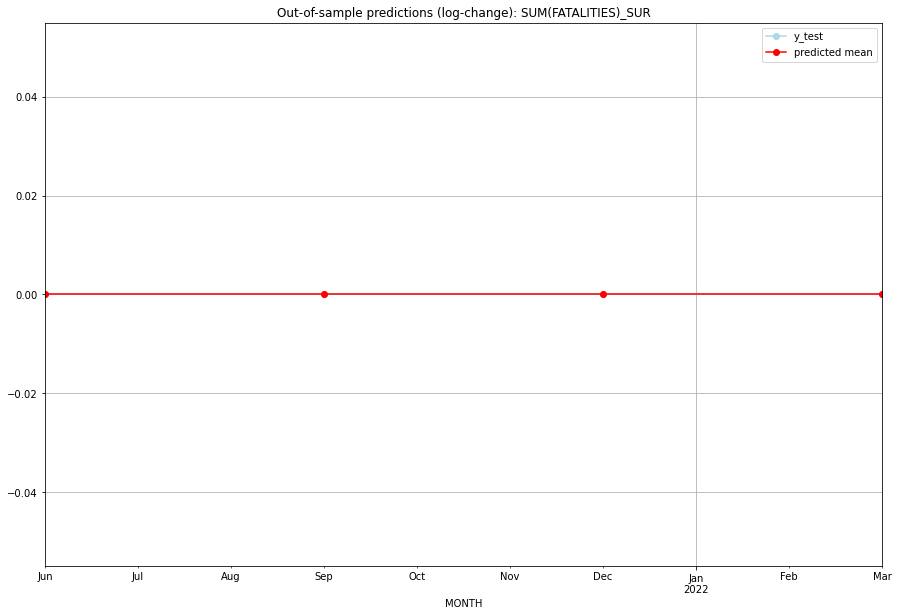

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SUR   
1 2021-07-01       0.0         0.0           0.0             0.0   SUR   
2 2021-10-01       0.0         0.0           0.0             0.0   SUR   
3 2022-01-01       0.0         0.0           0.0             0.0   SUR   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## SVK (193/234) #########
0
Neighbor countries: []
Getting Data for SVK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 65)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross v

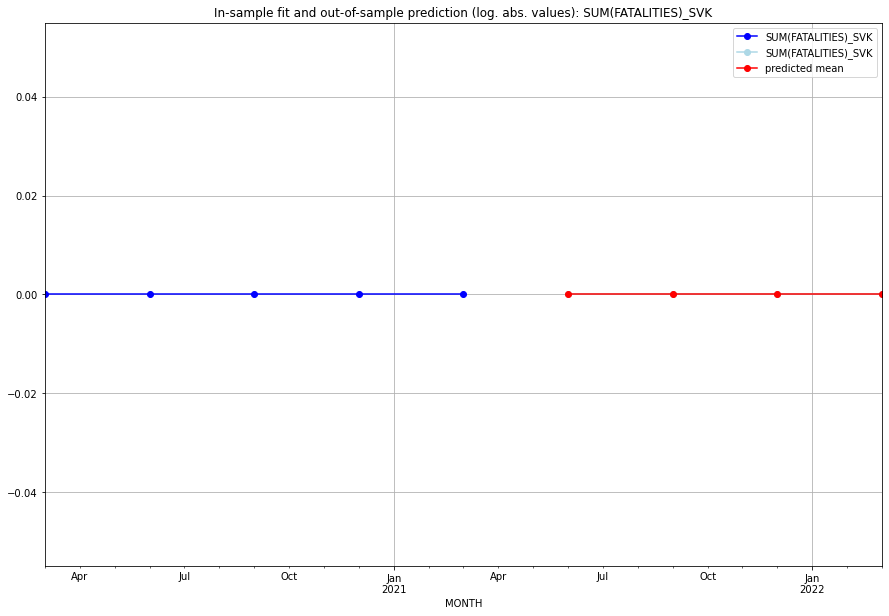

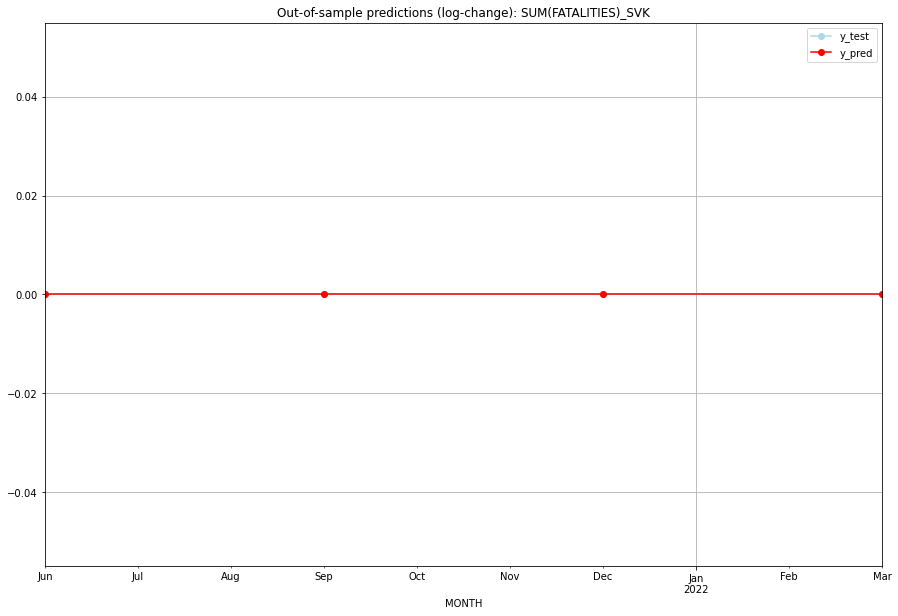

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SVK   
1 2021-07-01       0.0         0.0           0.0             0.0   SVK   
2 2021-10-01       0.0         0.0           0.0             0.0   SVK   
3 2022-01-01       0.0         0.0           0.0             0.0   SVK   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## SVN (194/234) #########
0
Neighbor countries: []
Getting Data for SVN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 63)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


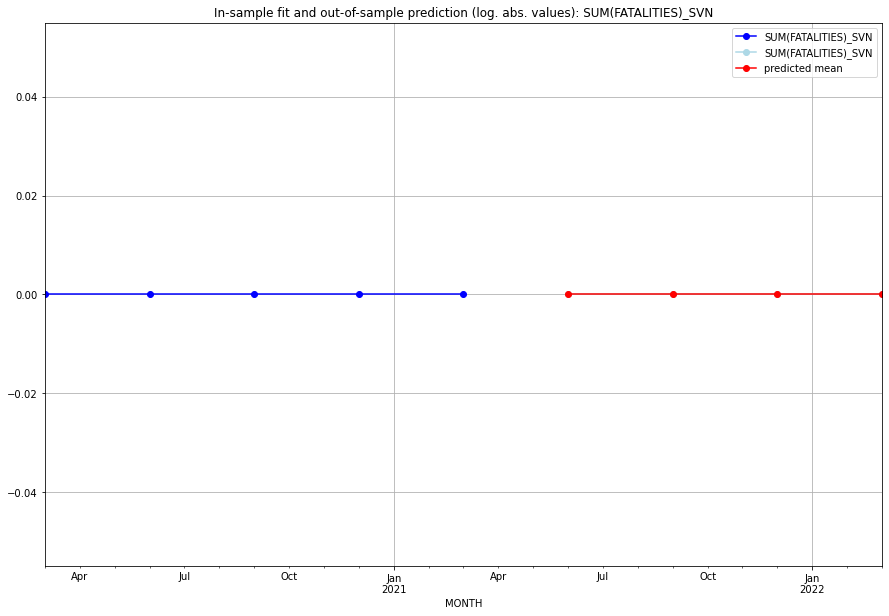

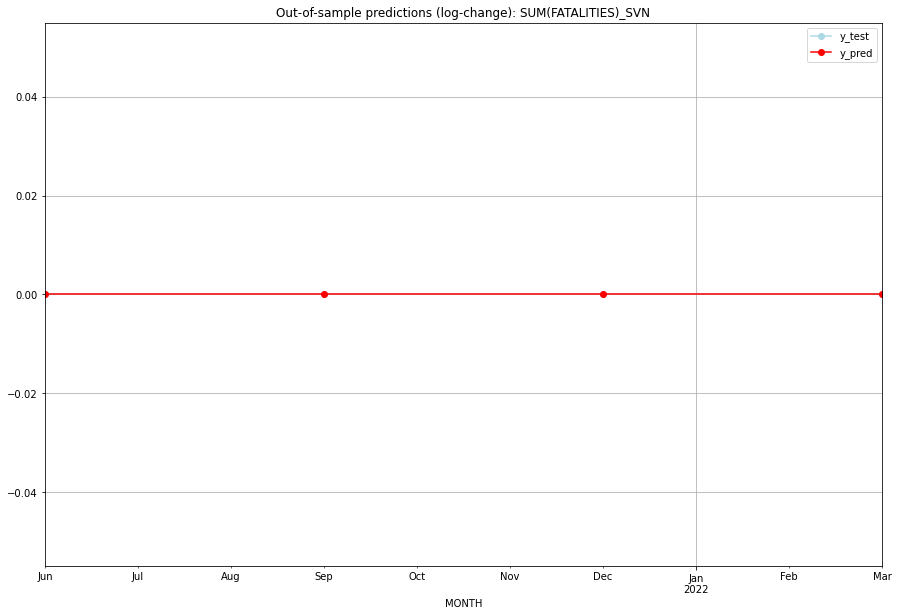

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SVN   
1 2021-07-01       0.0         0.0           0.0             0.0   SVN   
2 2021-10-01       0.0         0.0           0.0             0.0   SVN   
3 2022-01-01       0.0         0.0           0.0             0.0   SVN   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## SWE (195/234) #########
0
Neighbor countries: []
Getting Data for SWE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 65)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


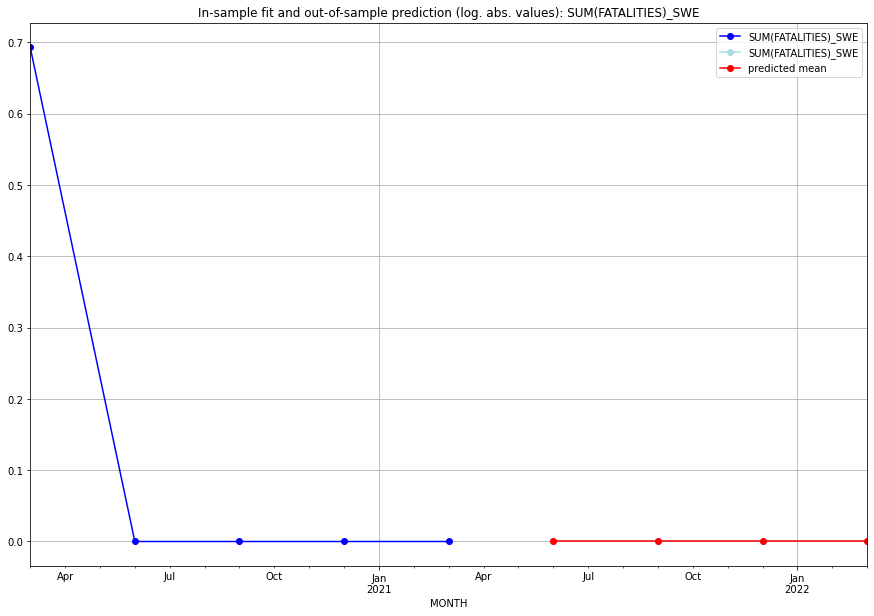

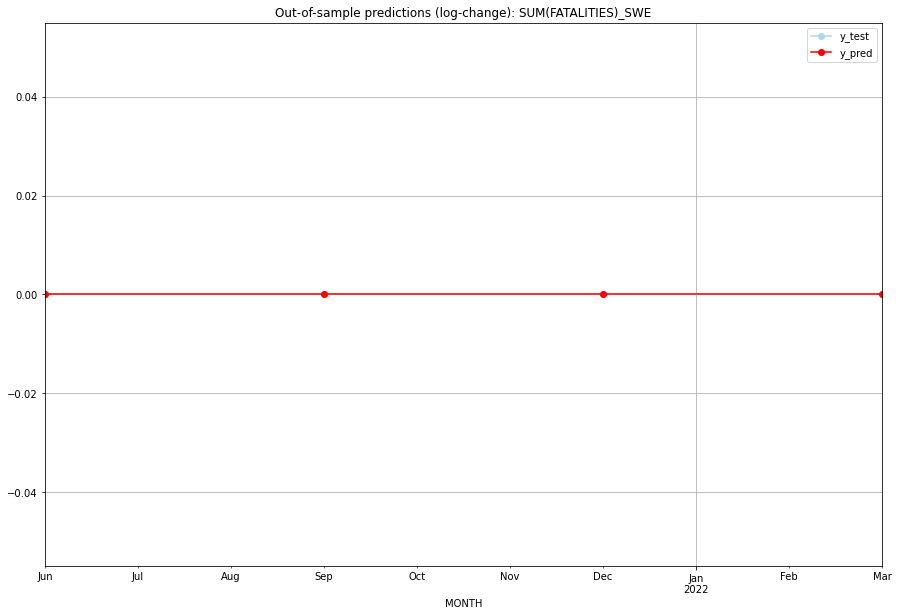

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SWE   
1 2021-07-01       0.0         0.0           0.0             0.0   SWE   
2 2021-10-01       0.0         0.0           0.0             0.0   SWE   
3 2022-01-01       0.0         0.0           0.0             0.0   SWE   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## SWZ (196/234) #########
0
Neighbor countries: []
Getting Data for SWZ
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.19356005054539455, 'fold_results': [0.0, 0.0, 0.0, 0.34657359027997264, 0.6212266624470001]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SWZ   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                 -46.888
Date:                 Wed, 19 Oct 2022   AIC                             95.776
Time:                         11:00:01   BIC                             98.340
Sample:                     04-30-1997   HQIC                            96.812
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2      

<Figure size 432x288 with 0 Axes>

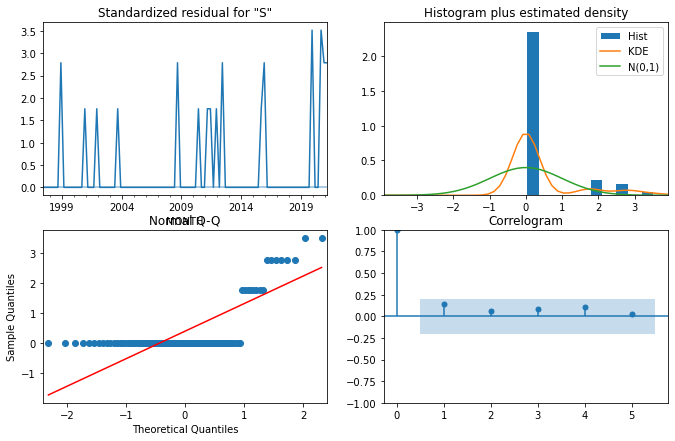

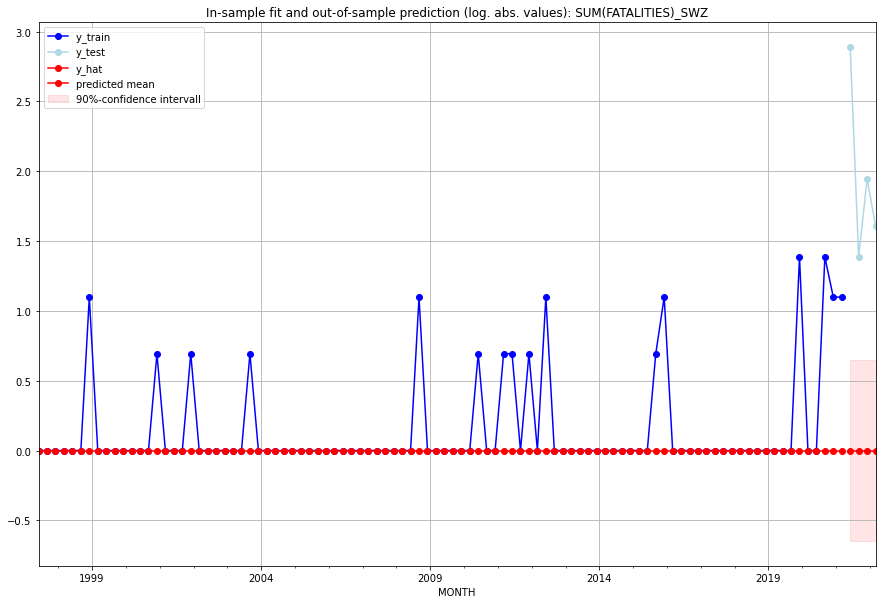

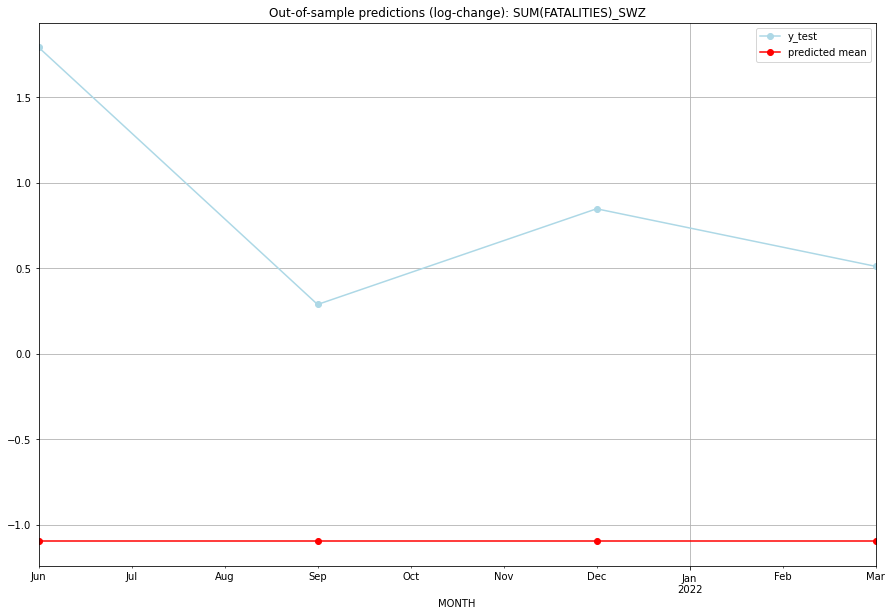

TADDA: 3.056615833794477
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0        17.0     -1.098612        1.791759   SWZ   
1 2021-07-01       0.0         3.0     -1.098612        0.287682   SWZ   
2 2021-10-01       0.0         6.0     -1.098612        0.847298   SWZ   
3 2022-01-01       0.0         4.0     -1.098612        0.510826   SWZ   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:18
######## SXM (197/234) #########
0
Neighbor countries: []
Getting Data for SXM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necess

<Figure size 432x288 with 0 Axes>

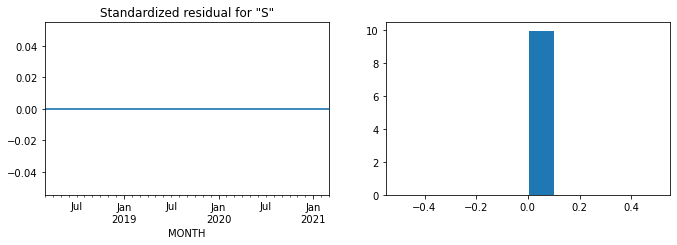

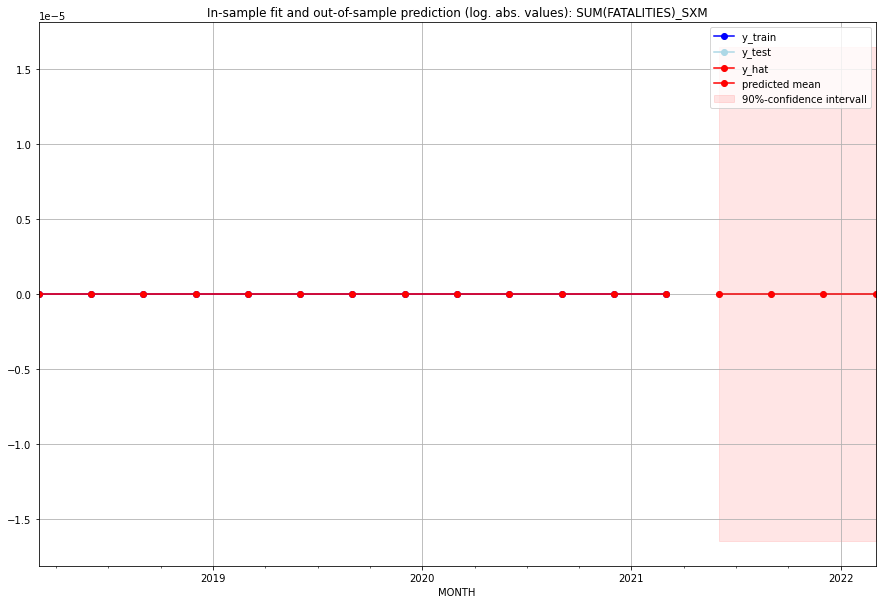

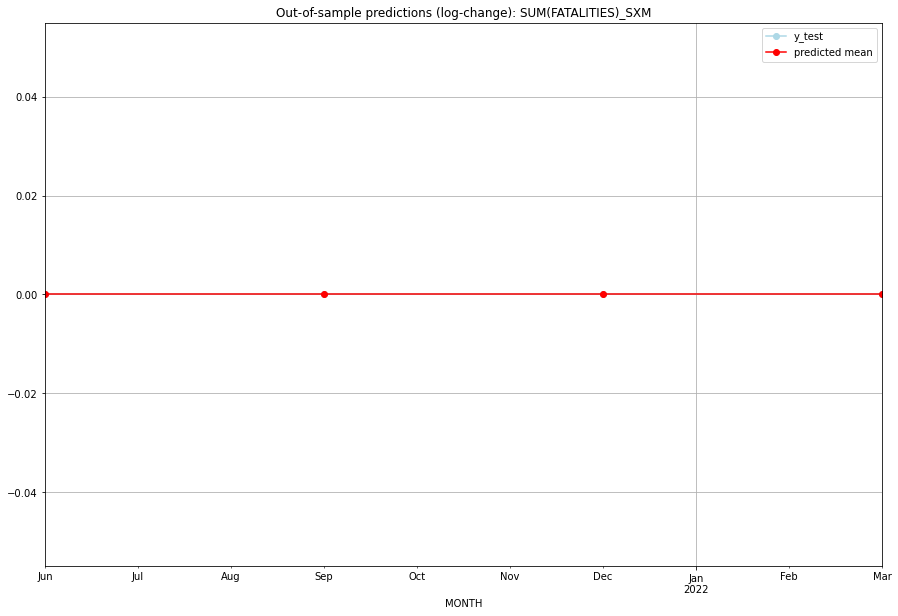

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SXM   
1 2021-07-01       0.0         0.0           0.0             0.0   SXM   
2 2021-10-01       0.0         0.0           0.0             0.0   SXM   
3 2022-01-01       0.0         0.0           0.0             0.0   SXM   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:07
######## SYC (198/234) #########
0
Neighbor countries: []
Getting Data for SYC
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 53)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SYC   No. Observations:                   96
Model:  

<Figure size 432x288 with 0 Axes>

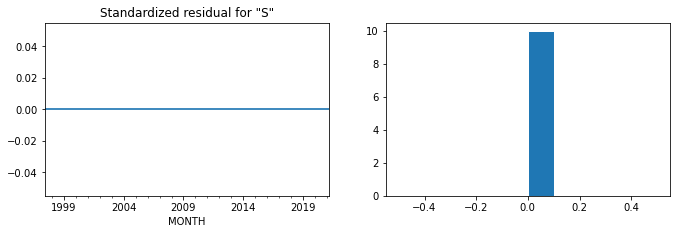

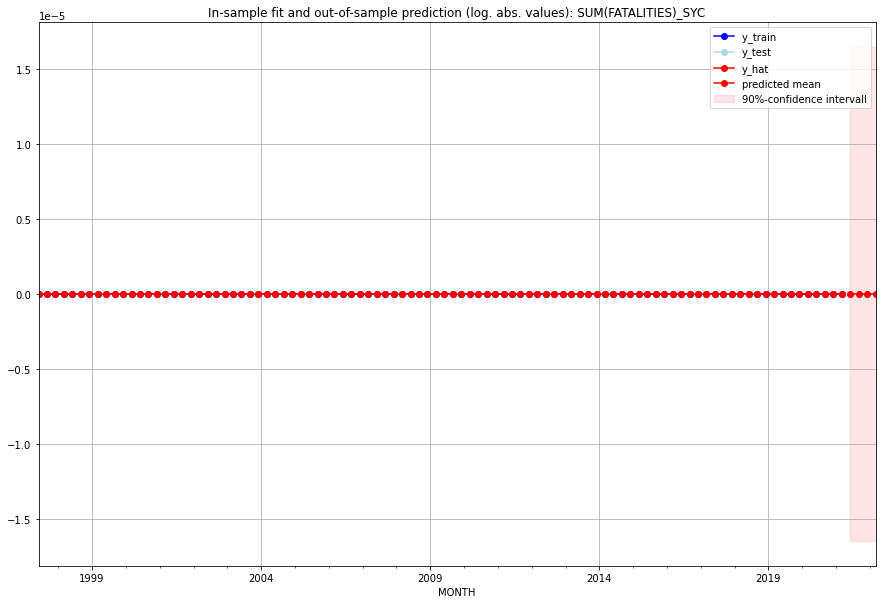

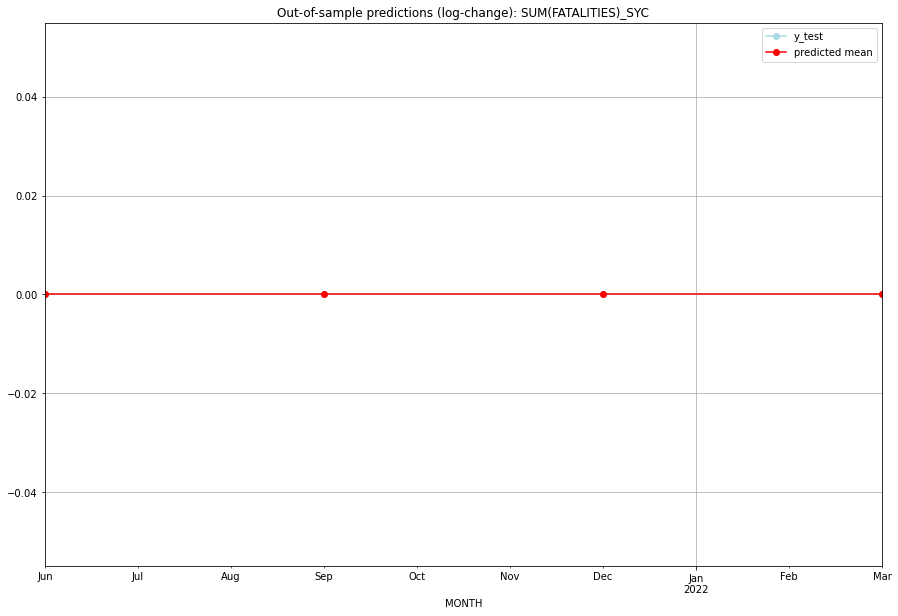

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   SYC   
1 2021-07-01       0.0         0.0           0.0             0.0   SYC   
2 2021-10-01       0.0         0.0           0.0             0.0   SYC   
3 2022-01-01       0.0         0.0           0.0             0.0   SYC   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:07
######## SYR (199/234) #########
0
Neighbor countries: []
Getting Data for SYR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (21, 62)
y: (21, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.25823280952063743, 'fold_results': [0.4547217379173043, 0.061743881123970557, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SYR   No. Observations:                   17
Model:                SARIMAX(1, 0, 3)   Log Likelihood                  -6.623
Date:                 Wed, 19 Oct 2022   AIC                             23.245
Time:                         11:00:27   BIC                             27.411
Sample:                     01-31-2017   HQIC                            23.659
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9975

<Figure size 432x288 with 0 Axes>

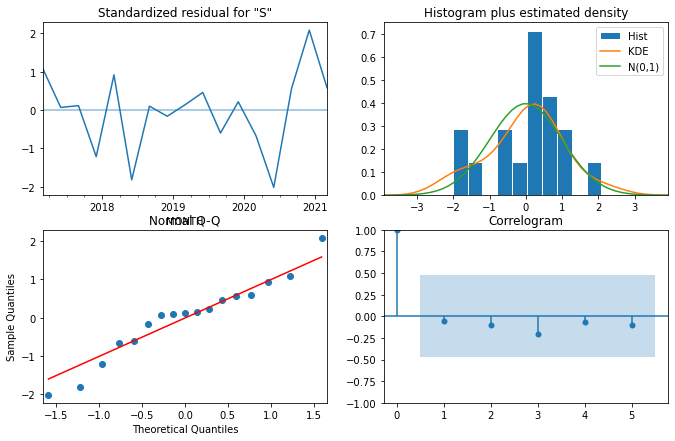

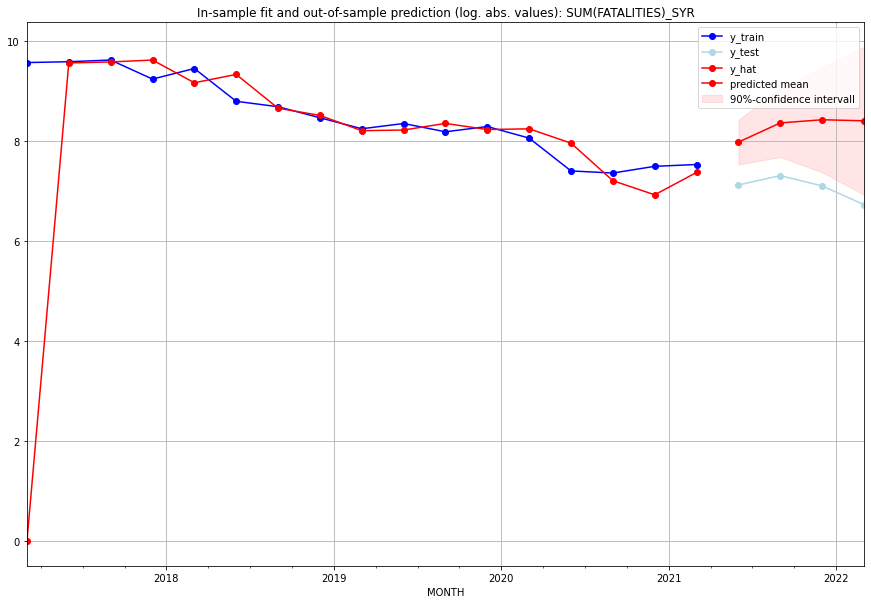

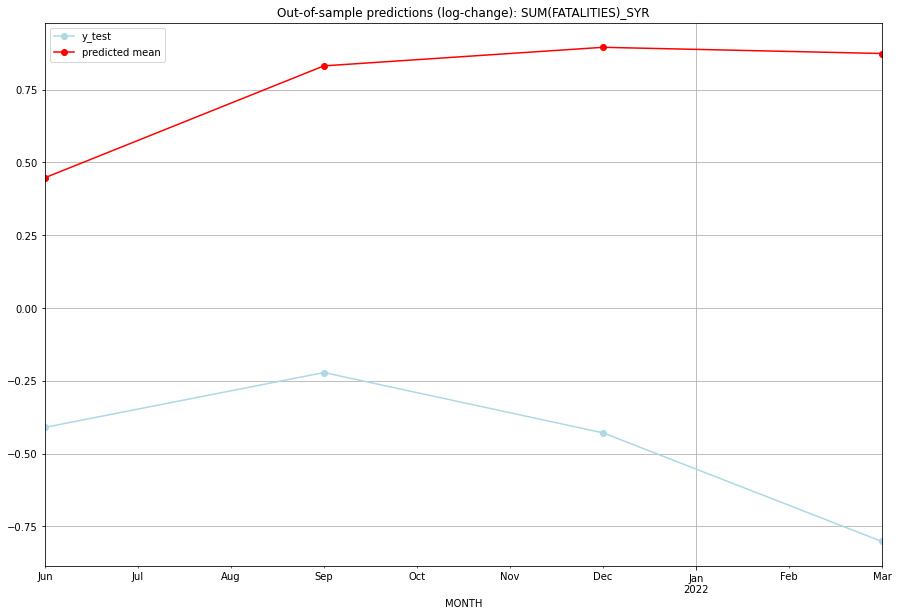

TADDA: 1.989633086726302
Evaluation finished.
       MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  2921.493929      1239.0      0.447569       -0.409757   SYR   
1 2021-07-01  4289.946321      1496.0      0.831639       -0.221405   SYR   
2 2021-10-01  4572.219501      1216.0      0.895349       -0.428480   SYR   
3 2022-01-01  4476.002946       837.0      0.874085       -0.801606   SYR   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## TCA (200/234) #########
0
Neighbor countries: []
Getting Data for TCA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero.

<Figure size 432x288 with 0 Axes>

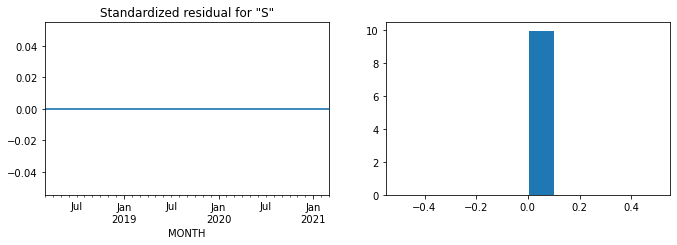

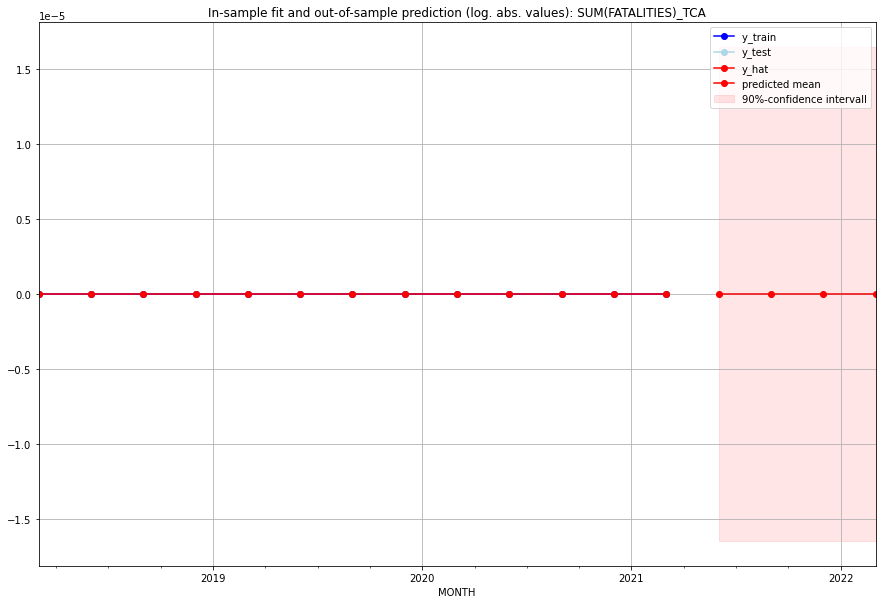

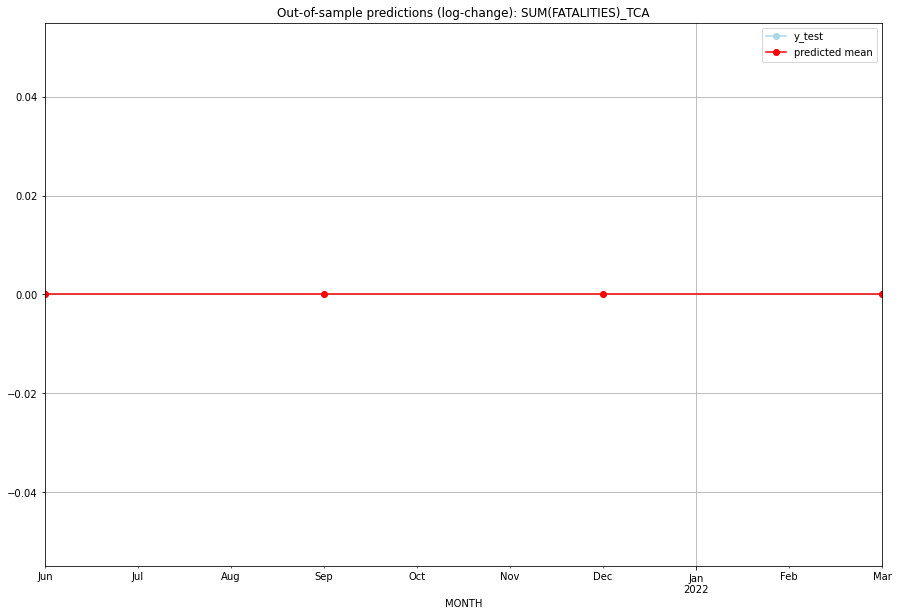

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   TCA   
1 2021-07-01       0.0         0.0           0.0             0.0   TCA   
2 2021-10-01       0.0         0.0           0.0             0.0   TCA   
3 2022-01-01       0.0         0.0           0.0             0.0   TCA   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:05
######## TCD (201/234) #########
0
Neighbor countries: []
Getting Data for TCD
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 59)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 1.0576631190614072, 'fold_results': [1.4130697186476182, 0.931890825112166, 0.7980111824771382, 1.4619580831296468, 0.683385785940468]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TCD   No. Observations:                   96
Model:                SARIMAX(3, 1, 3)   Log Likelihood                -189.245
Date:                 Wed, 19 Oct 2022   AIC                            396.491
Time:                         11:00:44   BIC                            419.475
Sample:                     04-30-1997   HQIC                           405.778
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

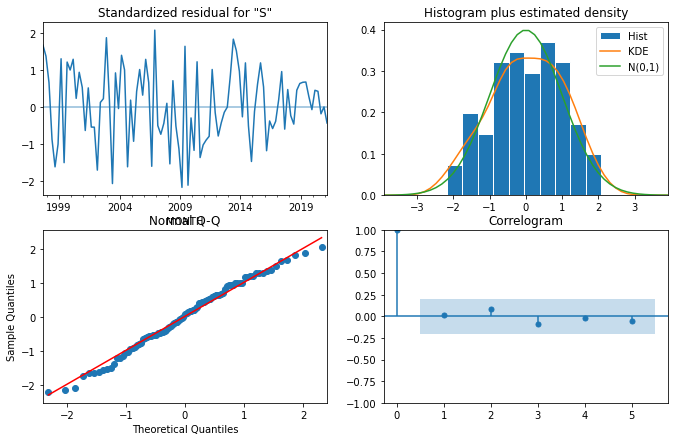

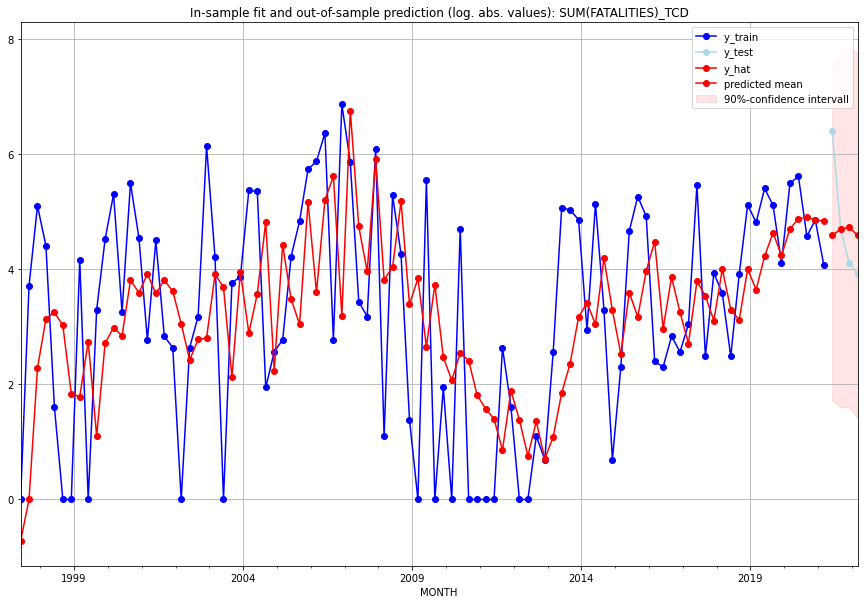

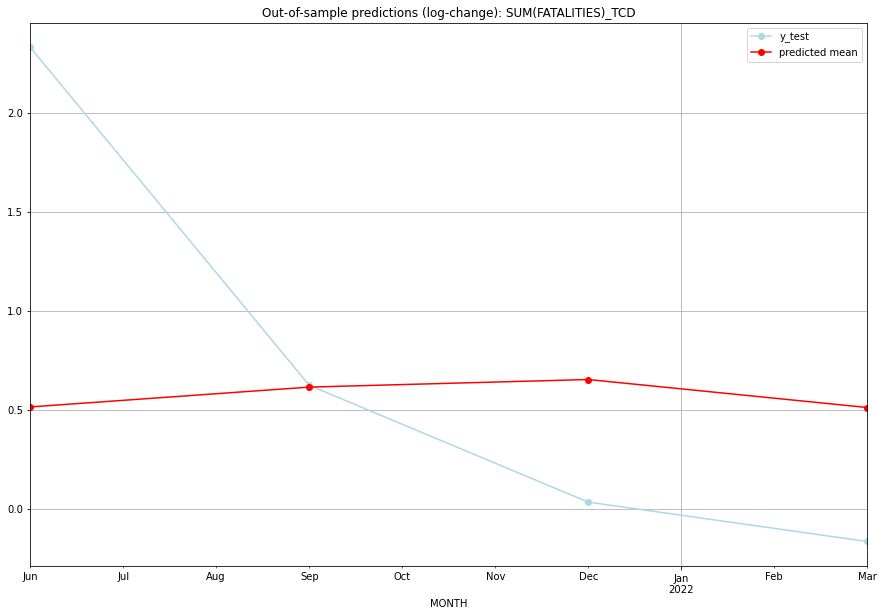

TADDA: 0.9077047293395849
Evaluation finished.
       MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01   97.617170       605.0      0.513708        2.329343   TCD   
1 2021-07-01  108.013814       109.0      0.613937        0.622943   TCD   
2 2021-10-01  112.259711        60.0      0.652146        0.033336   TCD   
3 2022-01-01   97.343326        49.0      0.510927       -0.165514   TCD   

                                          PARAMETERS  
0  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## TGO (202/234) #########
0
Neighbor countries: []
Getting Data for TGO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 61)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV o

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.8730989516874802, 'fold_results': [0.44401561413296026, 1.7430722432410435, 0.6562026281260465, 0.972899199540643, 0.5493050733967073]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TGO   No. Observations:                   96
Model:                SARIMAX(2, 0, 2)   Log Likelihood                -116.918
Date:                 Wed, 19 Oct 2022   AIC                            247.836
Time:                         11:01:12   BIC                            265.786
Sample:                     04-30-1997   HQIC                           255.091
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

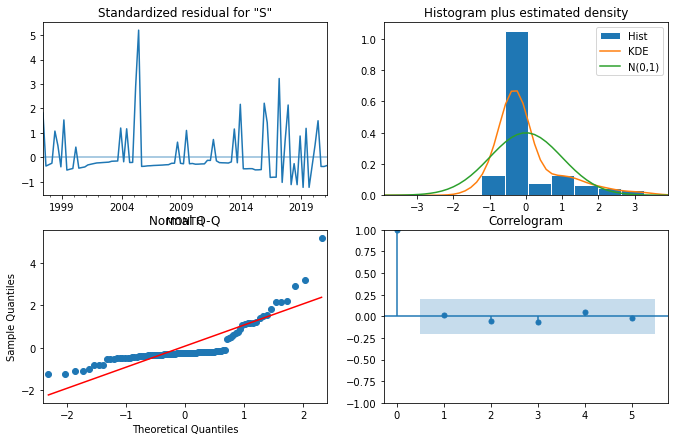

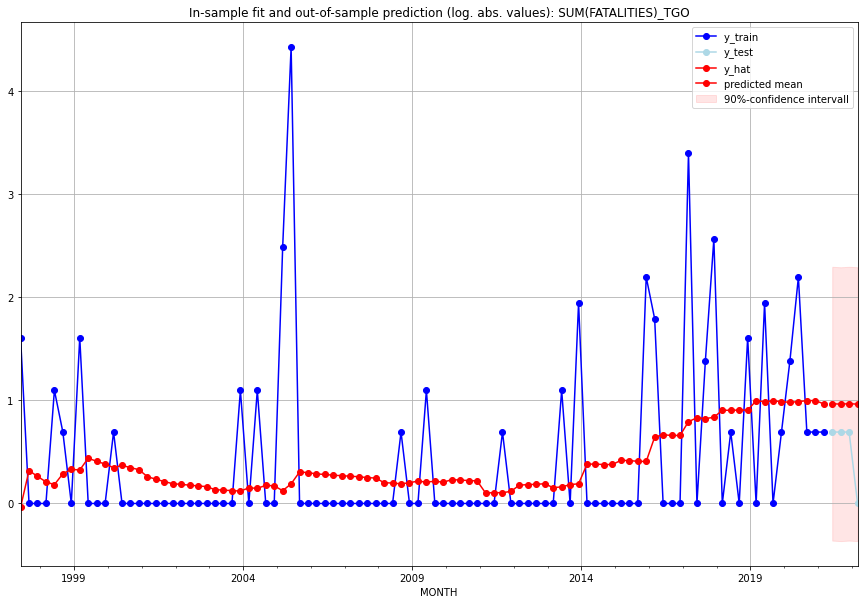

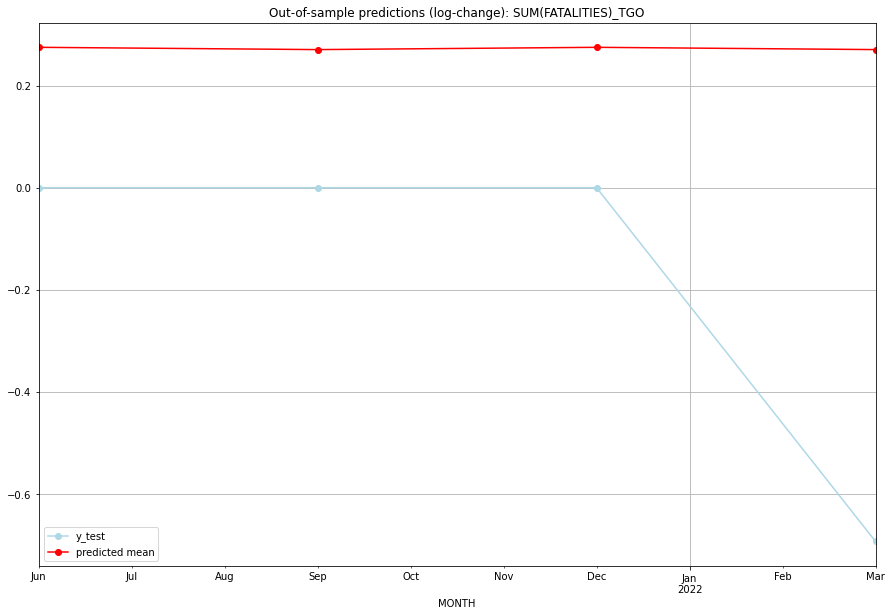

TADDA: 0.5137514240143733
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  1.633222         1.0      0.275061        0.000000   TGO   
1 2021-07-01  1.621443         1.0      0.270578        0.000000   TGO   
2 2021-10-01  1.633197         1.0      0.275052        0.000000   TGO   
3 2022-01-01  1.621460         0.0      0.270584       -0.693147   TGO   

                                          PARAMETERS  
0  {'params': [2, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (2, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:29
######## THA (203/234) #########
0
Neighbor countries: []
Getting Data for THA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 63)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.44266004579567986, 'fold_results': [0.0956958199072182, 0.46111556273968735, 0.8885746923447299, 0.1893310334891023, 0.5785831204976614]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_THA   No. Observations:                   45
Model:                SARIMAX(1, 1, 1)   Log Likelihood                 -23.647
Date:                 Wed, 19 Oct 2022   AIC                             57.294
Time:                         11:01:29   BIC                             66.215
Sample:                     01-31-2010   HQIC                            60.603
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

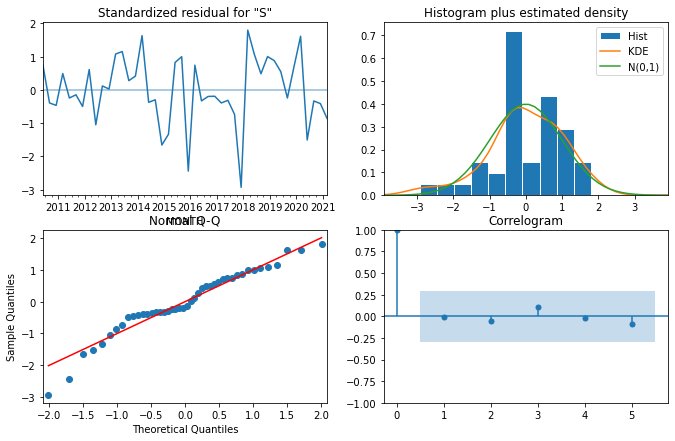

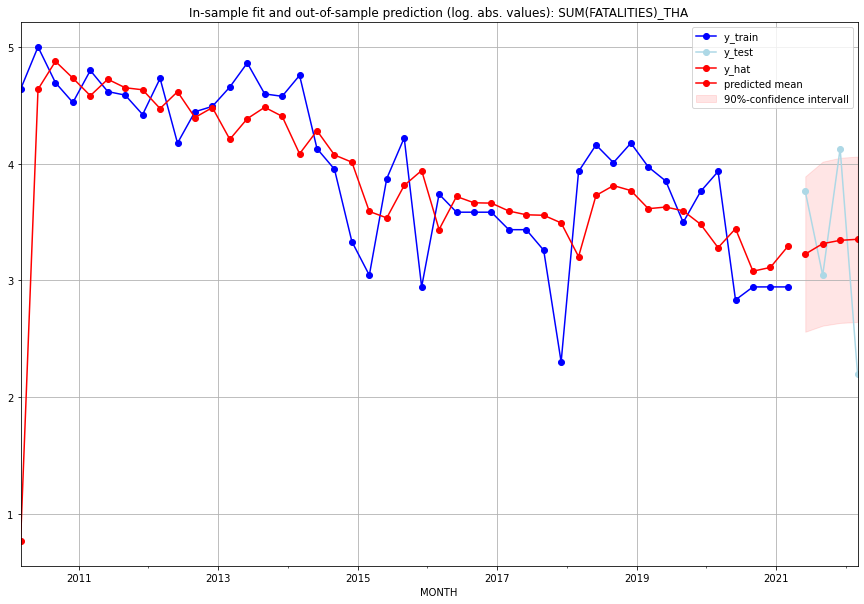

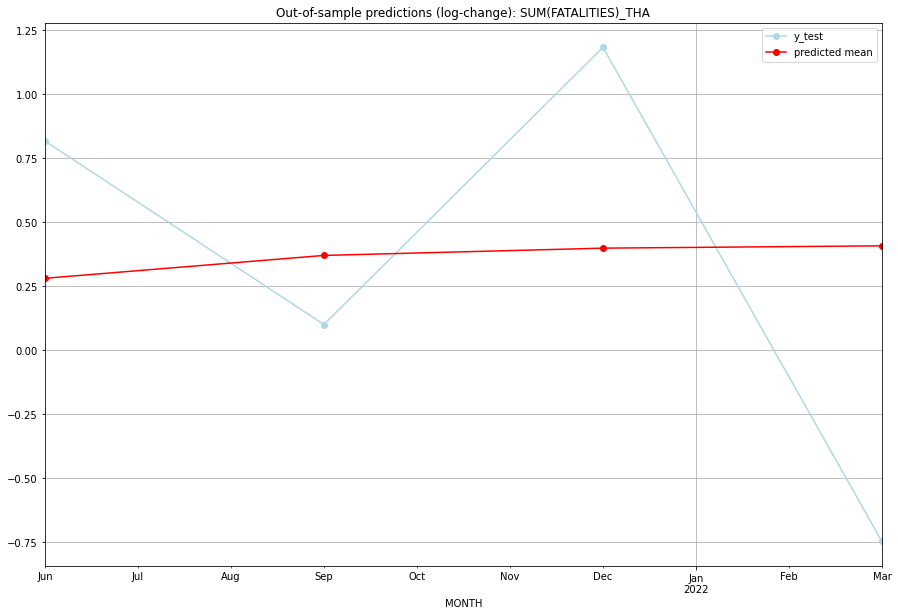

TADDA: 0.7880630653885969
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  24.156851        42.0      0.280691        0.816761   THA   
1 2021-07-01  26.505754        20.0      0.369956        0.100083   THA   
2 2021-10-01  27.297773        61.0      0.398344        1.182695   THA   
3 2022-01-01  27.554398         8.0      0.407372       -0.747214   THA   

                                          PARAMETERS  
0  {'params': [2, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:18
######## TJK (204/234) #########
0
Neighbor countries: []
Getting Data for TJK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 62)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CP

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 1.2273896380673213, 'fold_results': [1.4421542710047734, 1.012625005129869]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TJK   No. Observations:                   13
Model:                SARIMAX(1, 0, 3)   Log Likelihood                 -18.694
Date:                 Wed, 19 Oct 2022   AIC                             51.388
Time:                         11:01:44   BIC                             55.343
Sample:                     01-31-2018   HQIC                            50.575
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.4637      0.1

<Figure size 432x288 with 0 Axes>

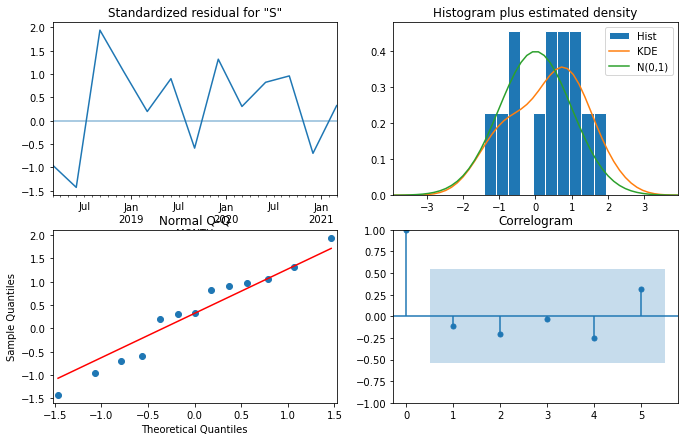

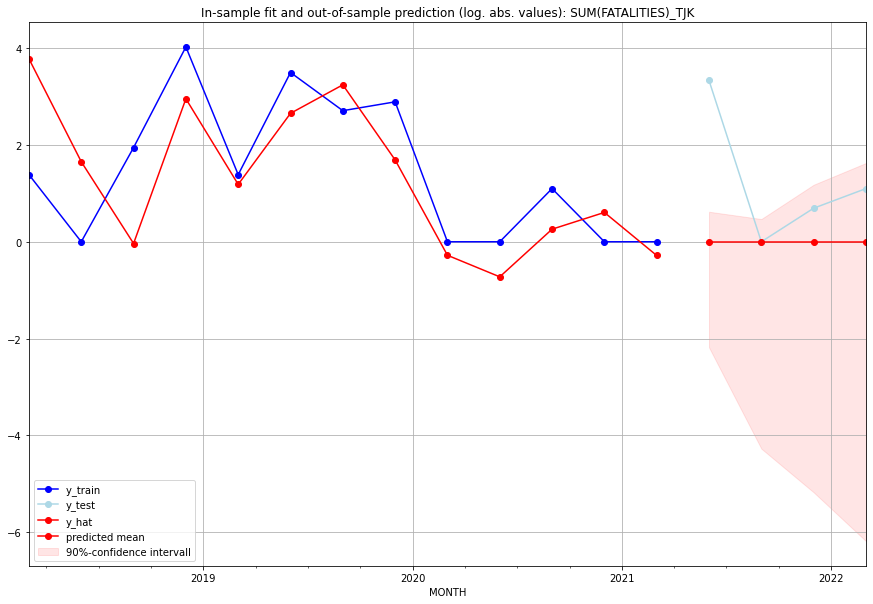

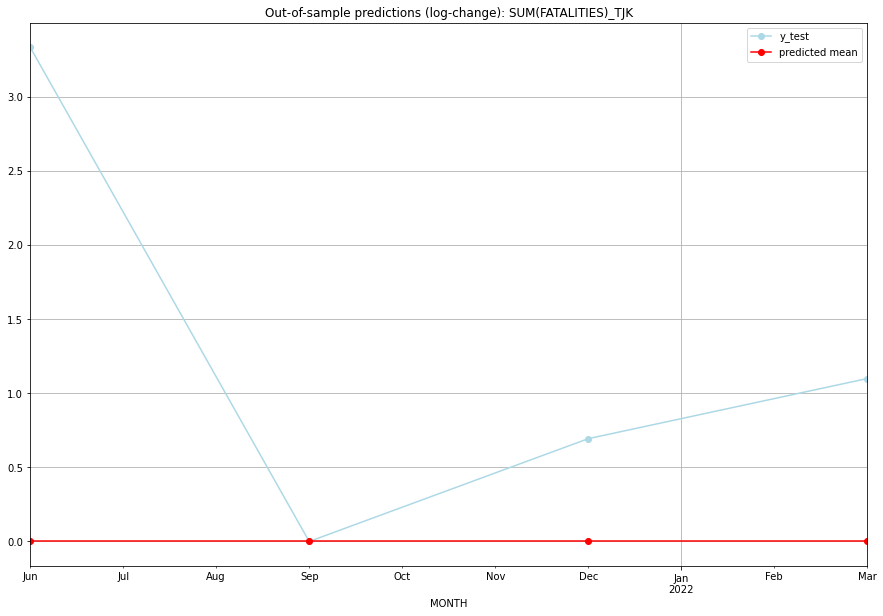

TADDA: 1.2809909948508147
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0        27.0           0.0        3.332205   TJK   
1 2021-07-01       0.0         0.0           0.0        0.000000   TJK   
2 2021-10-01       0.0         1.0           0.0        0.693147   TJK   
3 2022-01-01       0.0         2.0           0.0        1.098612   TJK   

                                          PARAMETERS  
0  {'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:15
######## TKM (205/234) #########
0
Neighbor countries: []
Getting Data for TKM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 50)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4332169878499659, 'fold_results': [0.6931471805599454, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TKM   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                 -19.755
Date:                 Wed, 19 Oct 2022   AIC                             41.510
Time:                         11:01:56   BIC                             42.075
Sample:                     01-31-2018   HQIC                            41.394
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         1.2231      0

<Figure size 432x288 with 0 Axes>

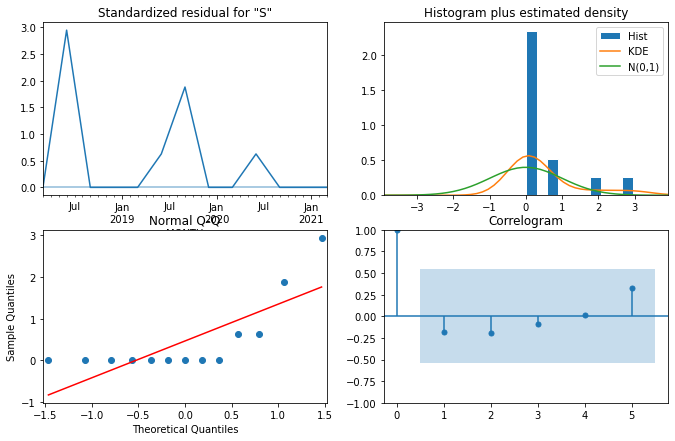

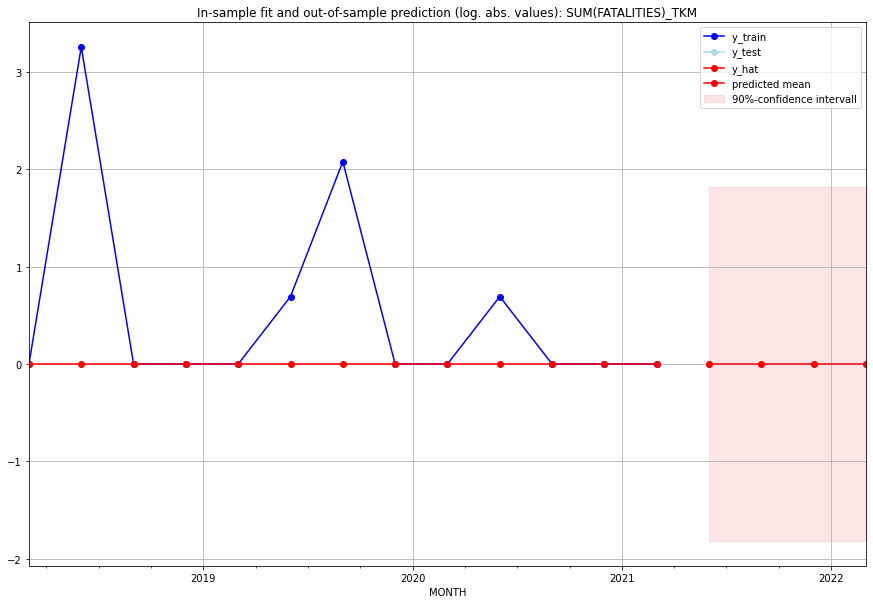

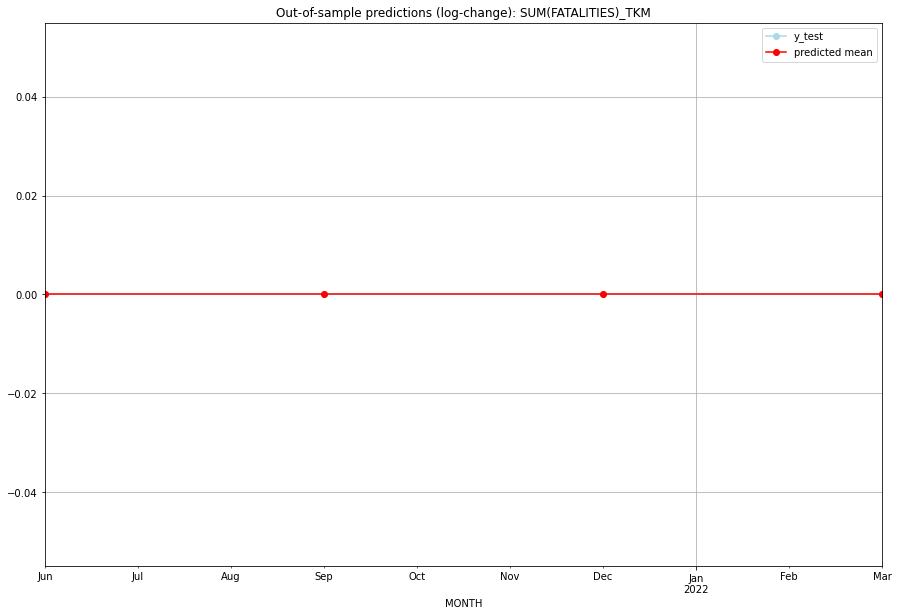

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   TKM   
1 2021-07-01       0.0         0.0           0.0             0.0   TKM   
2 2021-10-01       0.0         0.0           0.0             0.0   TKM   
3 2022-01-01       0.0         0.0           0.0             0.0   TKM   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:11
######## TLS (206/234) #########
0
Neighbor countries: []
Getting Data for TLS
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 53)
y: (100, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best C

<Figure size 432x288 with 0 Axes>

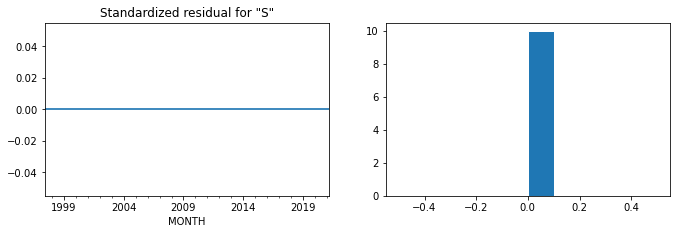

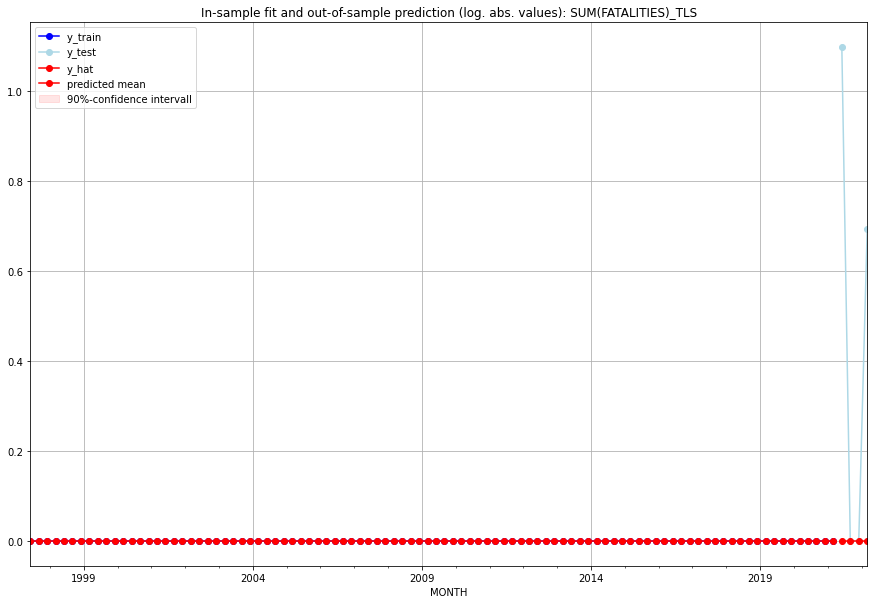

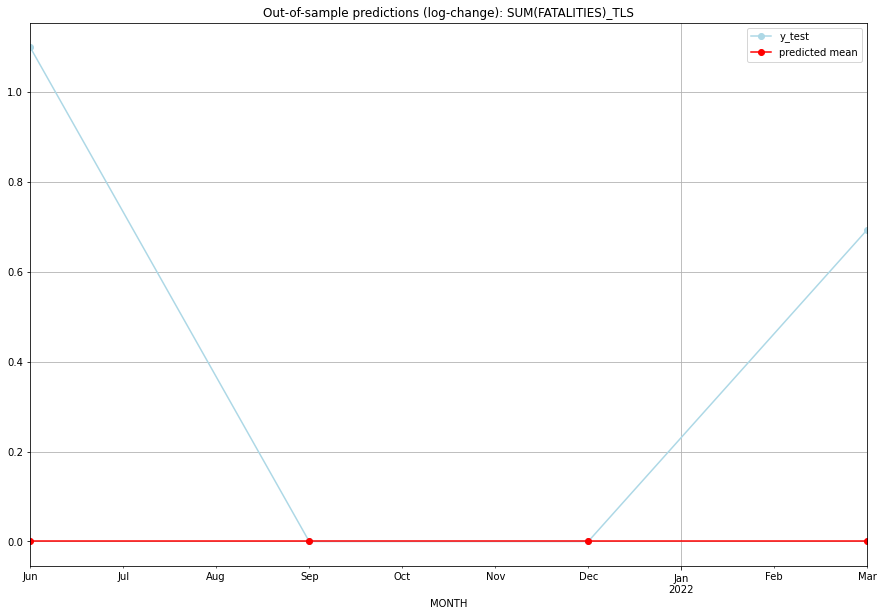

TADDA: 0.44793986730701374
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         2.0           0.0        1.098612   TLS   
1 2021-07-01       0.0         0.0           0.0        0.000000   TLS   
2 2021-10-01       0.0         0.0           0.0        0.000000   TLS   
3 2022-01-01       0.0         1.0           0.0        0.693147   TLS   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:08
######## TON (207/234) #########
0
Neighbor countries: []
Getting Data for TON
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 54)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


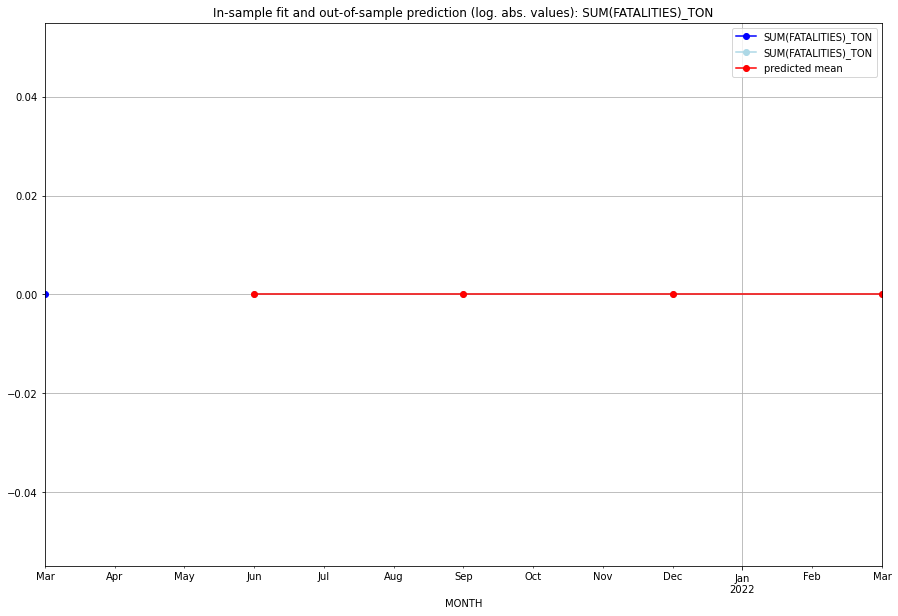

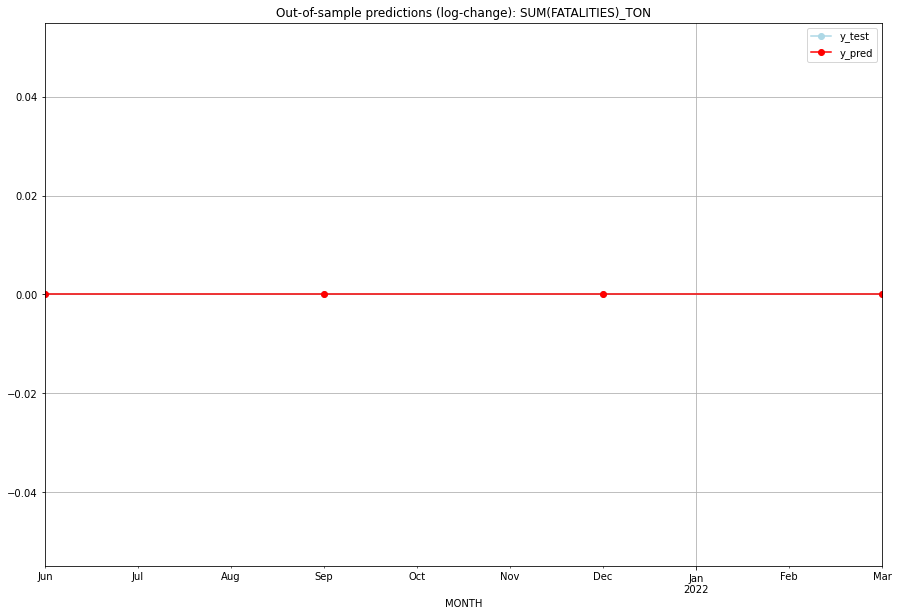

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   TON   
1 2021-07-01       0.0         0.0           0.0             0.0   TON   
2 2021-10-01       0.0         0.0           0.0             0.0   TON   
3 2022-01-01       0.0         0.0           0.0             0.0   TON   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## TTO (208/234) #########
0
Neighbor countries: []
Getting Data for TTO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 51)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4228812328890954, 'fold_results': [0.26903485820401307, 0.5767276075741777]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TTO   No. Observations:                   13
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -11.427
Date:                 Wed, 19 Oct 2022   AIC                             24.853
Time:                         11:02:18   BIC                             25.338
Sample:                     01-31-2018   HQIC                            24.674
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.3932      0

<Figure size 432x288 with 0 Axes>

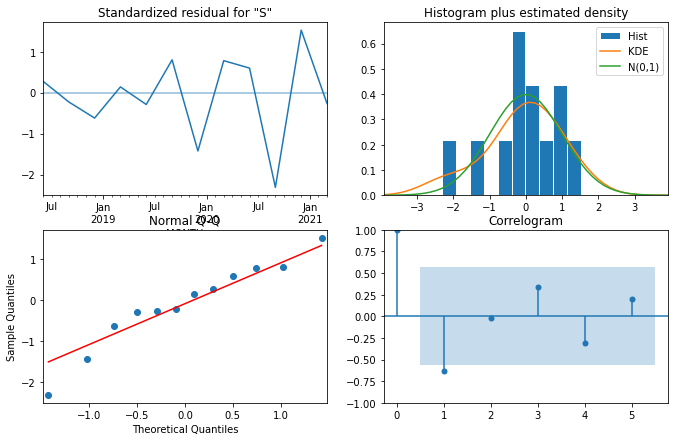

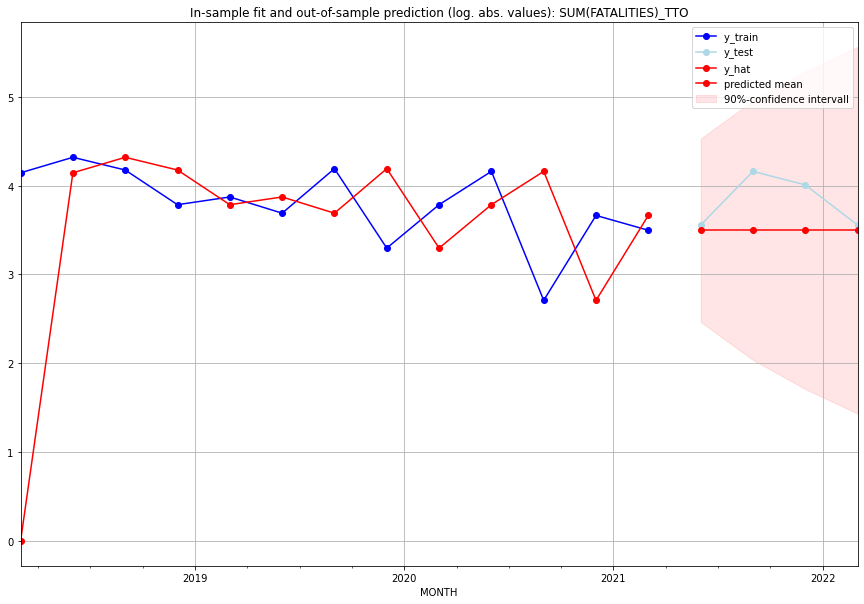

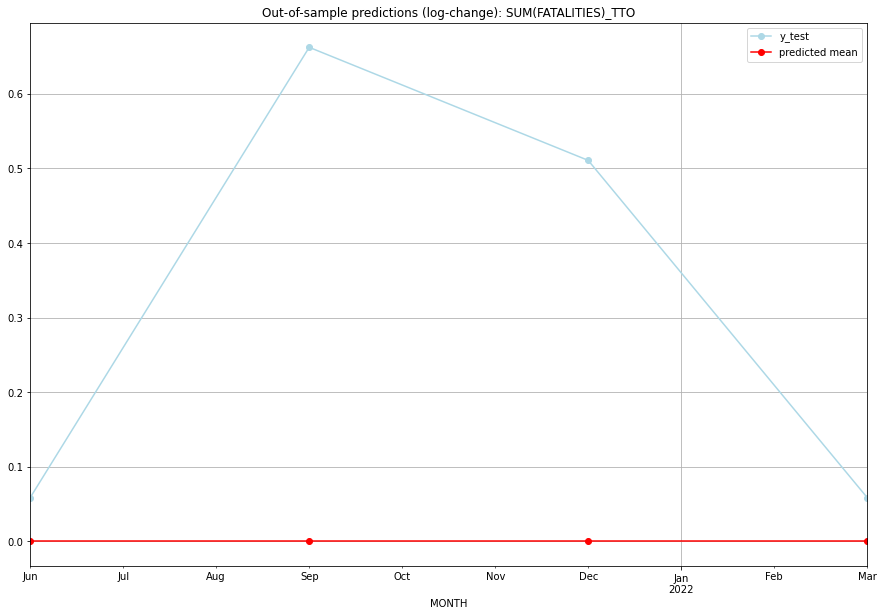

TADDA: 0.32272053642626264
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01      32.0        34.0           0.0        0.058841   TTO   
1 2021-07-01      32.0        63.0           0.0        0.662376   TTO   
2 2021-10-01      32.0        54.0           0.0        0.510826   TTO   
3 2022-01-01      32.0        34.0           0.0        0.058841   TTO   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## TUN (209/234) #########
0
Neighbor countries: []
Getting Data for TUN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 64)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU 

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.454029538840597, 'fold_results': [0.7391677618448707, 0.3499522597032008, 0.41939697566435347, 0.4184476408653623, 0.3431830561251977]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TUN   No. Observations:                   96
Model:                SARIMAX(1, 0, 0)   Log Likelihood                -126.159
Date:                 Wed, 19 Oct 2022   AIC                            258.319
Time:                         11:02:47   BIC                            266.012
Sample:                     04-30-1997   HQIC                           261.428
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

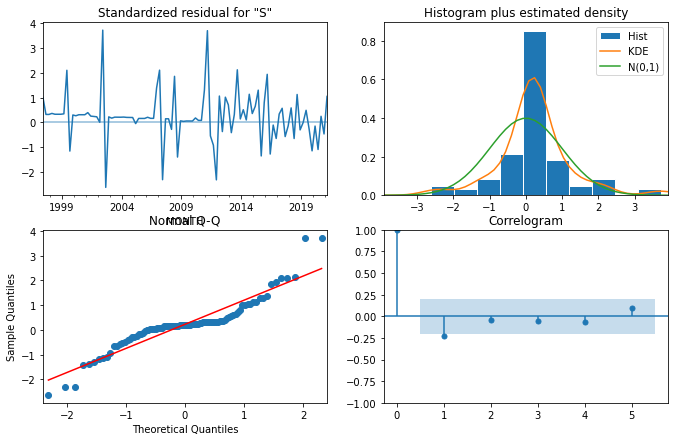

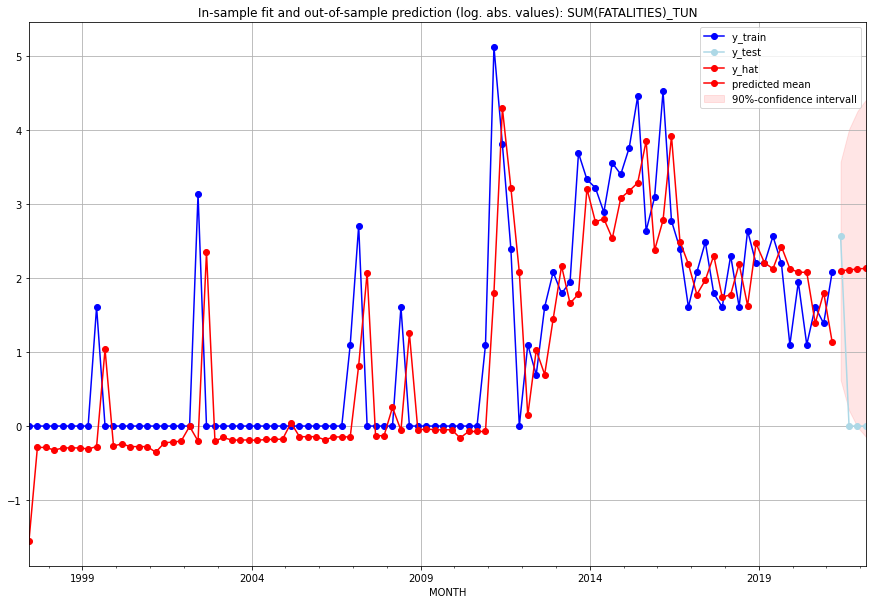

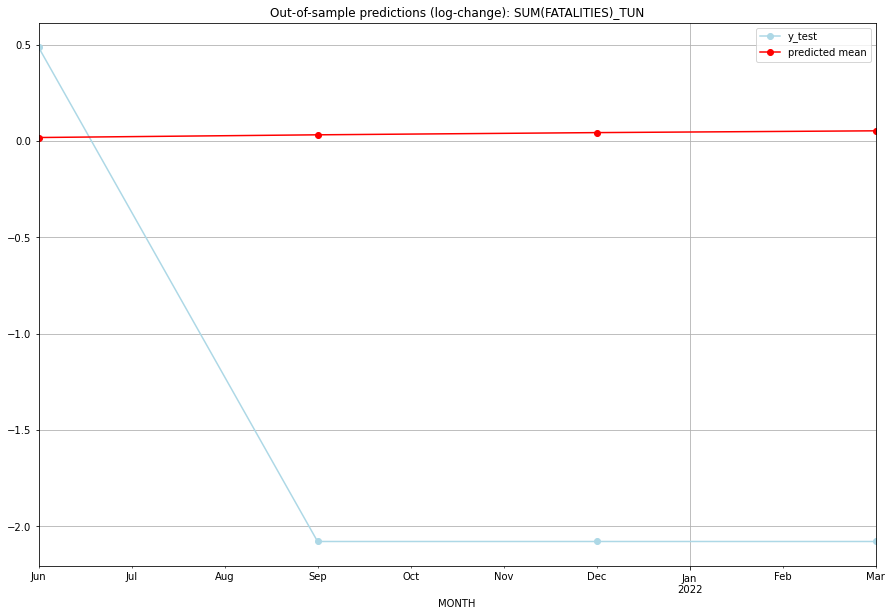

TADDA: 1.7397275121400724
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  7.139308        12.0      0.017264        0.485508   TUN   
1 2021-07-01  7.254527         0.0      0.031320       -2.079442   TUN   
2 2021-10-01  7.349546         0.0      0.042766       -2.079442   TUN   
3 2022-01-01  7.427720         0.0      0.052085       -2.079442   TUN   

                                          PARAMETERS  
0  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [1, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:26
######## TUR (210/234) #########
0
Neighbor countries: []
Getting Data for TUR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (25, 64)
y: (25, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cor

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5110683921921817, 'fold_results': [0.3255154083419405, 0.44542819795714994, 0.5605018819547418, 0.7128280805148944]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TUR   No. Observations:                   21
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -22.122
Date:                 Wed, 19 Oct 2022   AIC                             50.243
Time:                         11:02:59   BIC                             53.230
Sample:                     01-31-2016   HQIC                            50.826
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

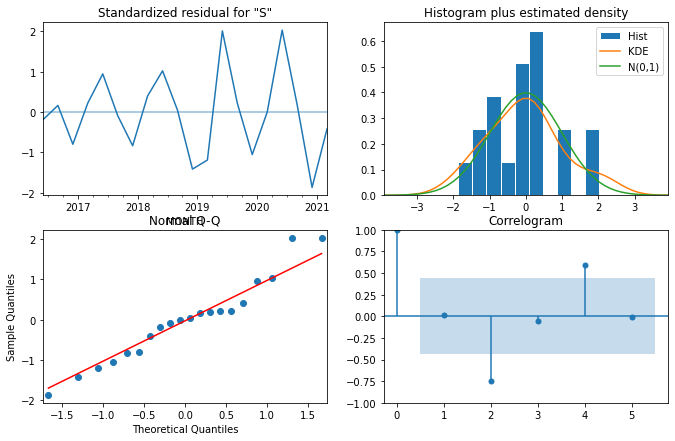

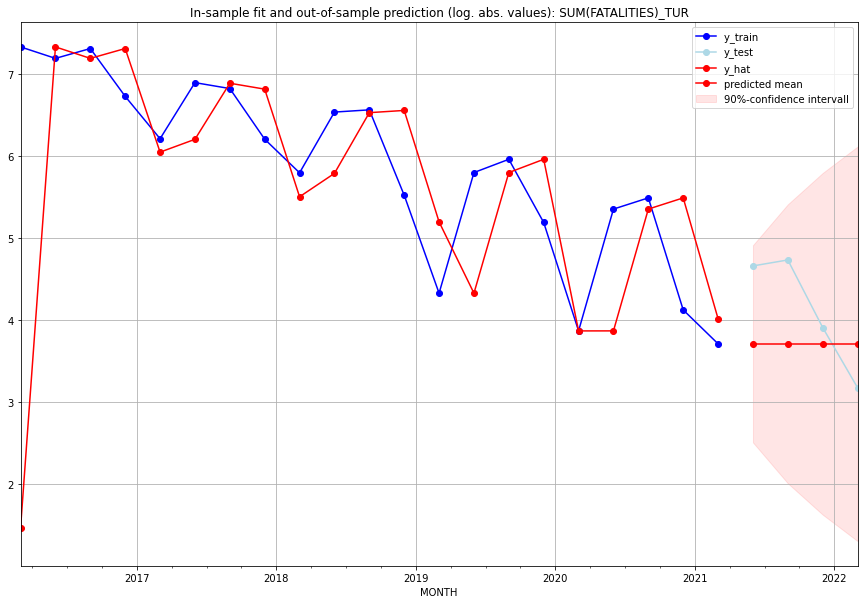

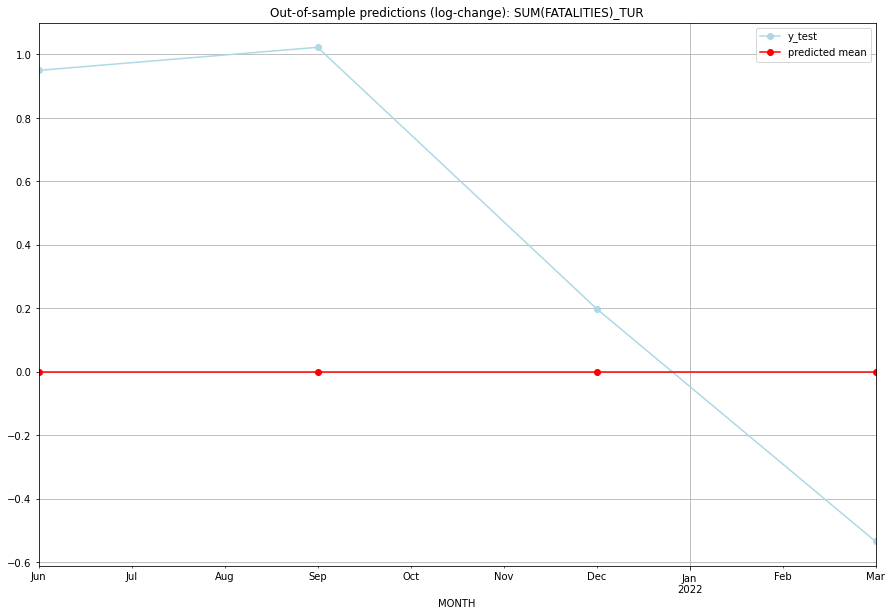

TADDA: 0.6766156460445363
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01      40.0       105.0  1.776357e-15        0.949867   TUR   
1 2021-07-01      40.0       113.0  1.776357e-15        1.022626   TUR   
2 2021-10-01      40.0        49.0  1.776357e-15        0.198451   TUR   
3 2022-01-01      40.0        23.0  1.776357e-15       -0.535518   TUR   

                                          PARAMETERS  
0  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:14
######## TWN (211/234) #########
0
Neighbor countries: []
Getting Data for TWN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 24)
y: (17, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV nece

<Figure size 432x288 with 0 Axes>

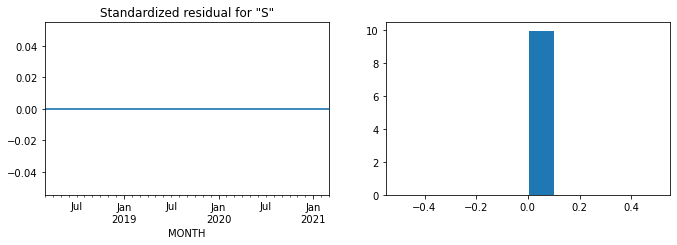

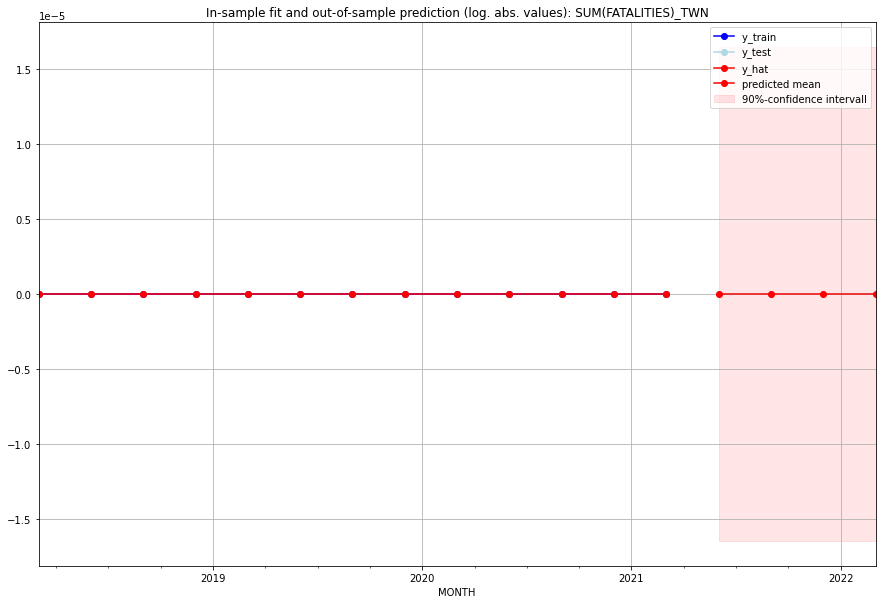

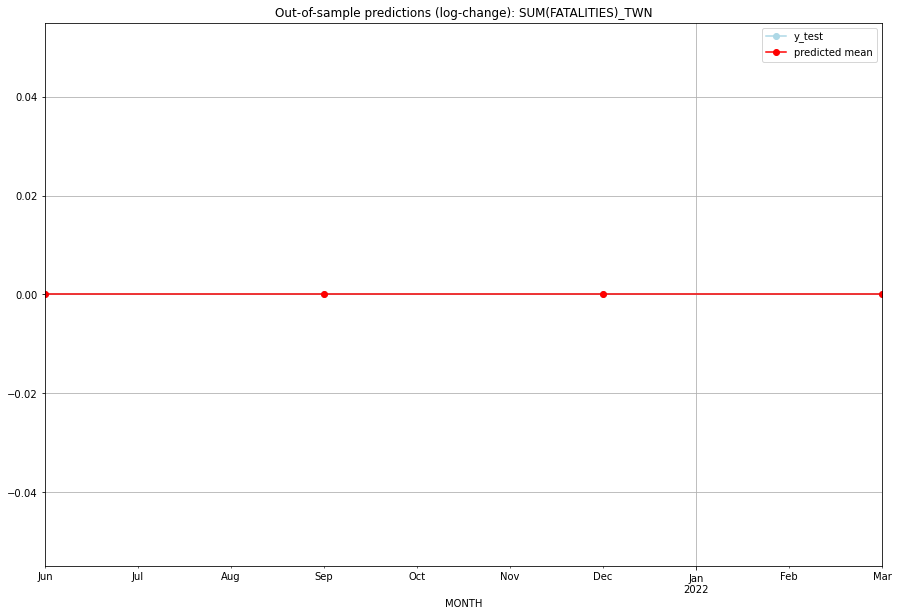

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   TWN   
1 2021-07-01       0.0         0.0           0.0             0.0   TWN   
2 2021-10-01       0.0         0.0           0.0             0.0   TWN   
3 2022-01-01       0.0         0.0           0.0             0.0   TWN   

  PARAMETERS  
0         {}  
1         {}  
2         {}  
3         {}  
Execution time: 00:02
######## TZA (212/234) #########
0
Neighbor countries: []
Getting Data for TZA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 60)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 1.0379280912230373, 'fold_results': [0.9766901844055615, 0.9803617884793817, 0.8568893419880805, 0.6807021885621339, 1.694996952680029]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TZA   No. Observations:                   96
Model:                SARIMAX(3, 0, 2)   Log Likelihood                -157.274
Date:                 Wed, 19 Oct 2022   AIC                            330.548
Time:                         11:03:26   BIC                            351.063
Sample:                     04-30-1997   HQIC                           338.841
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

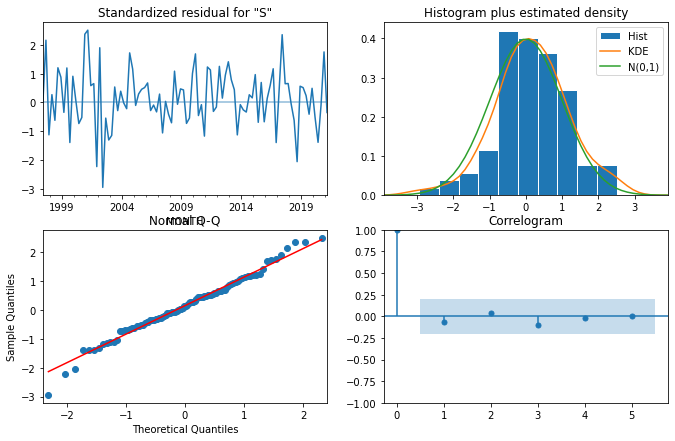

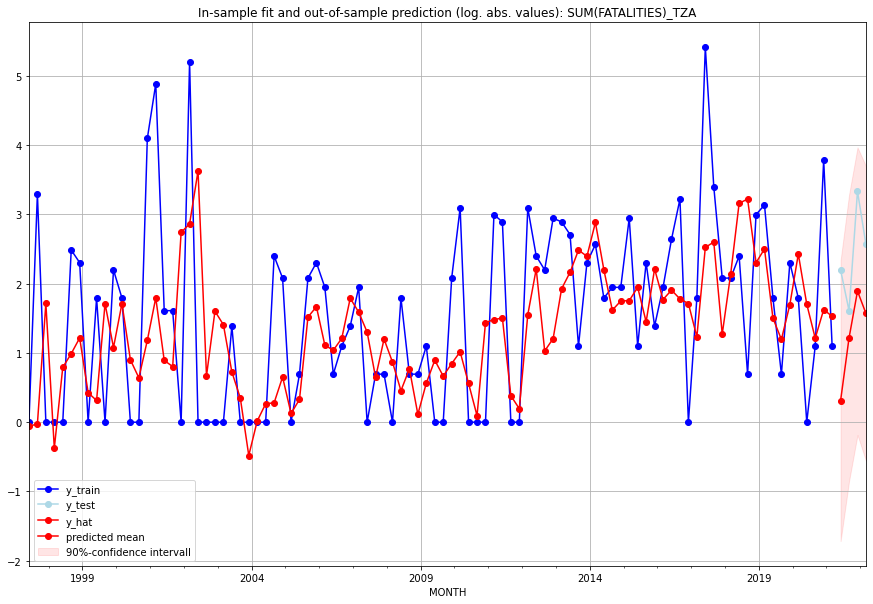

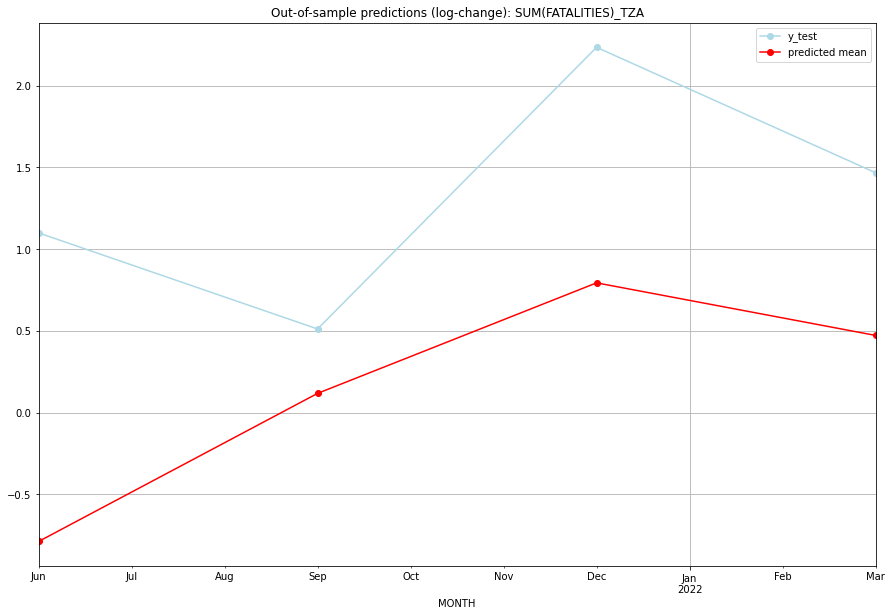

TADDA: 1.376458448056395
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.363033         8.0     -0.788900        1.098612   TZA   
1 2021-07-01  2.372323         4.0      0.116989        0.510826   TZA   
2 2021-10-01  5.629201        27.0      0.792872        2.233592   TZA   
3 2022-01-01  3.807050        12.0      0.471471        1.466337   TZA   

                                          PARAMETERS  
0  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## UGA (213/234) #########
0
Neighbor countries: []
Getting Data for UGA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 62)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU co

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.8903139259829602, 'fold_results': [1.6294792028446783, 1.2684221474919606, 0.818754990001867, 0.1597748864535642, 0.5751384031227319]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_UGA   No. Observations:                   96
Model:                SARIMAX(1, 1, 1)   Log Likelihood                -135.474
Date:                 Wed, 19 Oct 2022   AIC                            276.948
Time:                         11:03:50   BIC                            284.610
Sample:                     04-30-1997   HQIC                           280.044
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

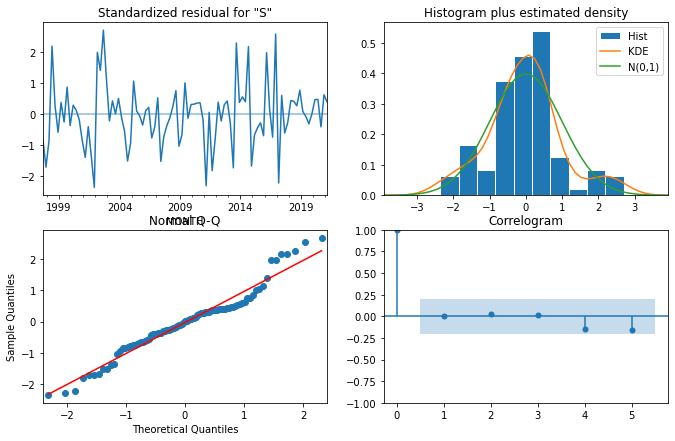

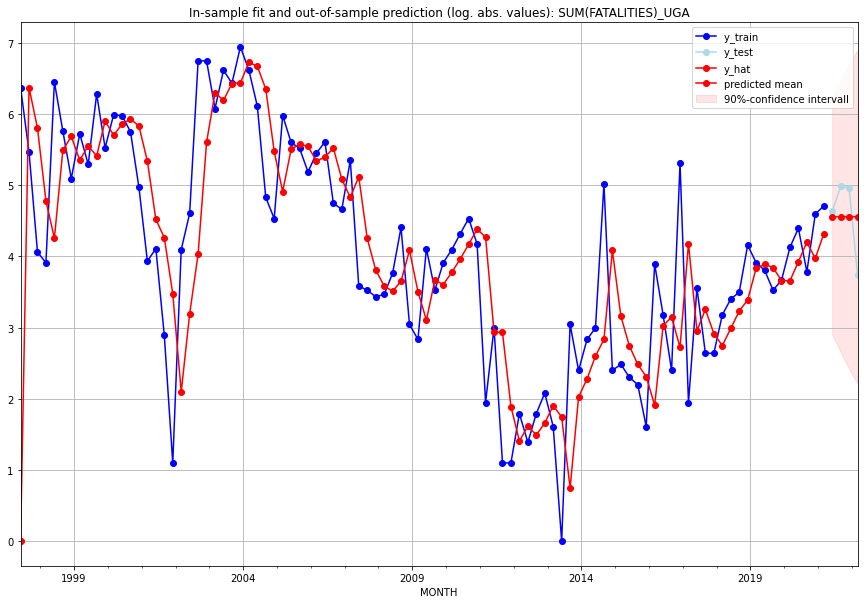

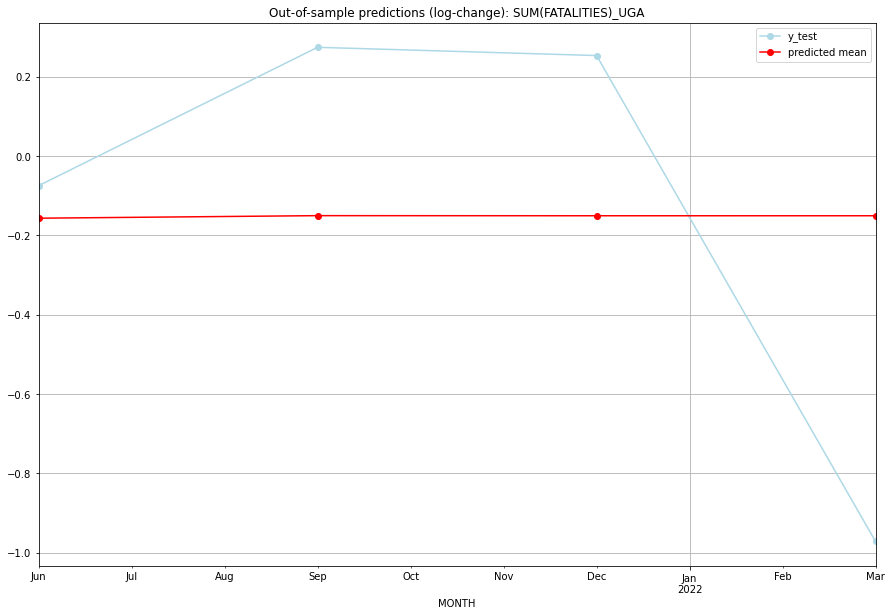

TADDA: 0.5081315158566215
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  93.892783       102.0     -0.156783       -0.074801   UGA   
1 2021-07-01  94.506184       145.0     -0.150339        0.274076   UGA   
2 2021-10-01  94.480897       142.0     -0.150604        0.253314   UGA   
3 2022-01-01  94.481936        41.0     -0.150593       -0.971861   UGA   

                                          PARAMETERS  
0  {'params': [0, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 1, 1), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:25
######## UKR (214/234) #########
0
Neighbor countries: []
Getting Data for UKR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 64)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CP

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5801415138286249, 'fold_results': [0.6919466736357421, 0.46833635402150764]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_UKR   No. Observations:                   13
Model:                SARIMAX(1, 0, 0)   Log Likelihood                 -11.974
Date:                 Wed, 19 Oct 2022   AIC                             31.947
Time:                         11:03:59   BIC                             34.207
Sample:                     01-31-2018   HQIC                            31.483
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0265      0

<Figure size 432x288 with 0 Axes>

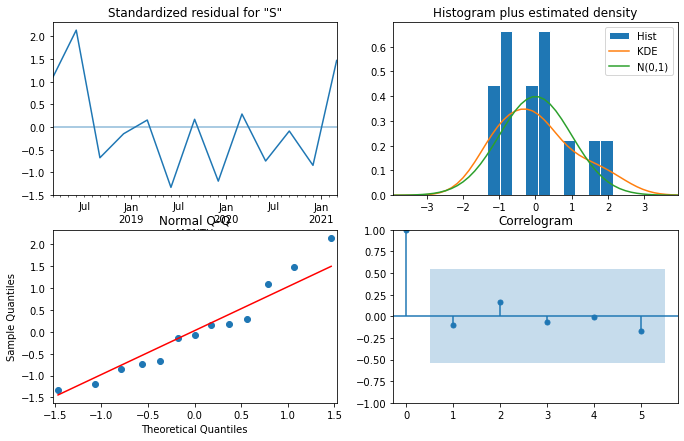

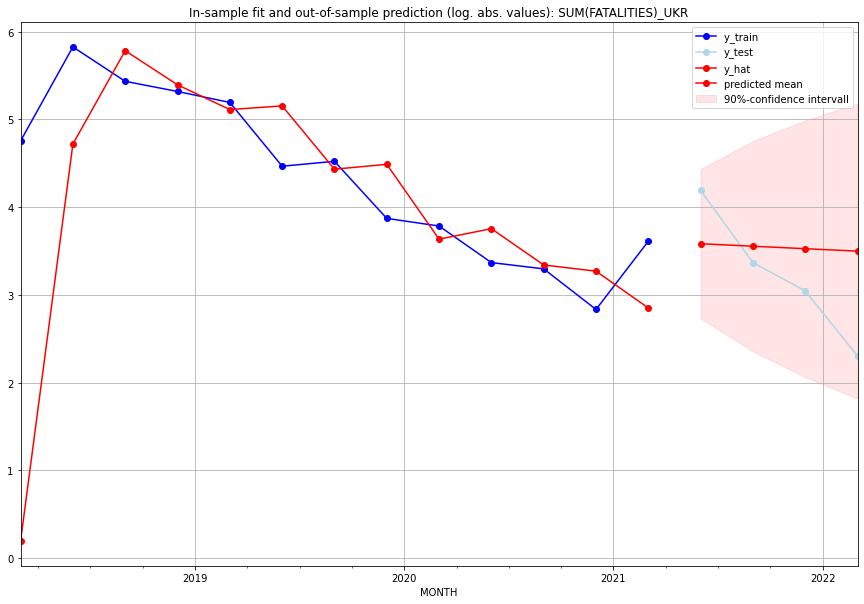

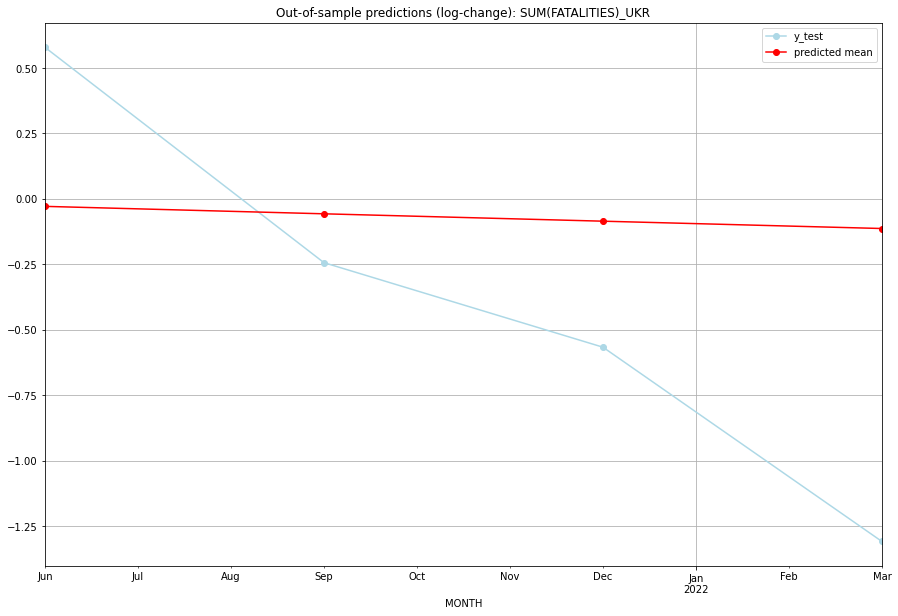

TADDA: 0.6247194574669872
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  34.955842        65.0     -0.028626        0.578737   UKR   
1 2021-07-01  33.948780        28.0     -0.057034       -0.243622   UKR   
2 2021-10-01  32.977285        20.0     -0.085226       -0.566395   UKR   
3 2022-01-01  32.039899         9.0     -0.113202       -1.308333   UKR   

                                          PARAMETERS  
0  {'params': [2, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (1, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:07
######## URY (215/234) #########
0
Neighbor countries: []
Getting Data for URY
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 63)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CP

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.25993019270997947, 'fold_results': [0.5198603854199589, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_URY   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                  -4.150
Date:                 Wed, 19 Oct 2022   AIC                             10.301
Time:                         11:04:03   BIC                             10.866
Sample:                     01-31-2018   HQIC                            10.185
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1109      0.034      3.291

<Figure size 432x288 with 0 Axes>

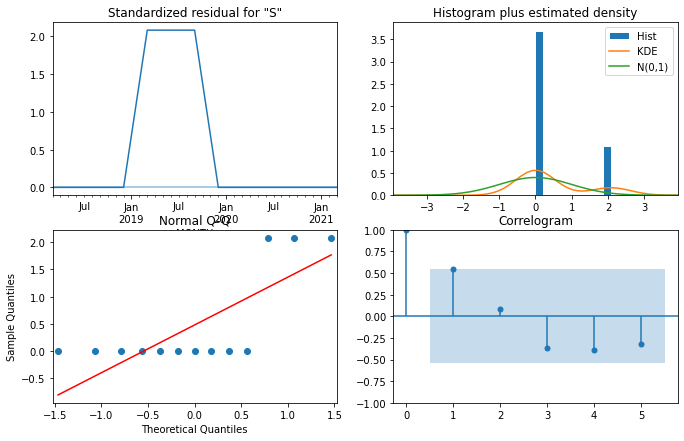

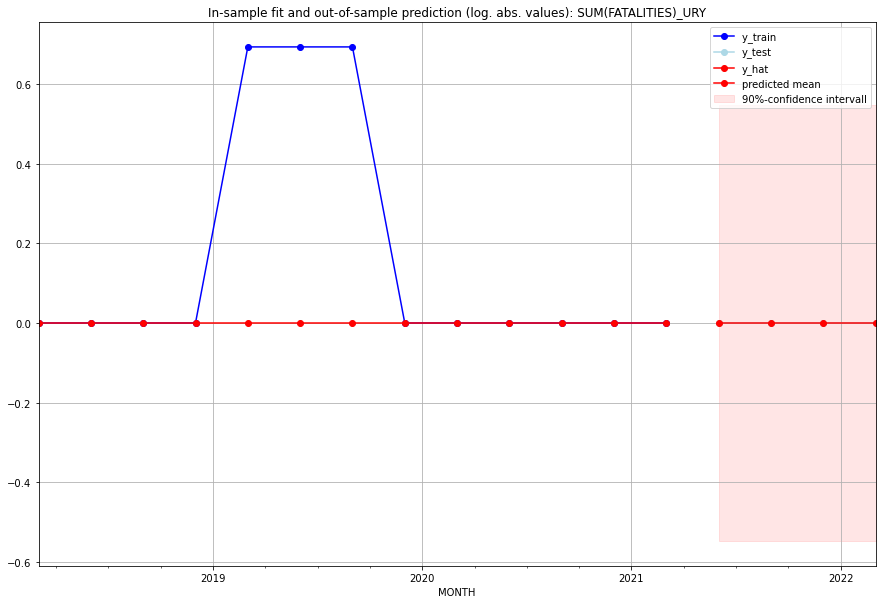

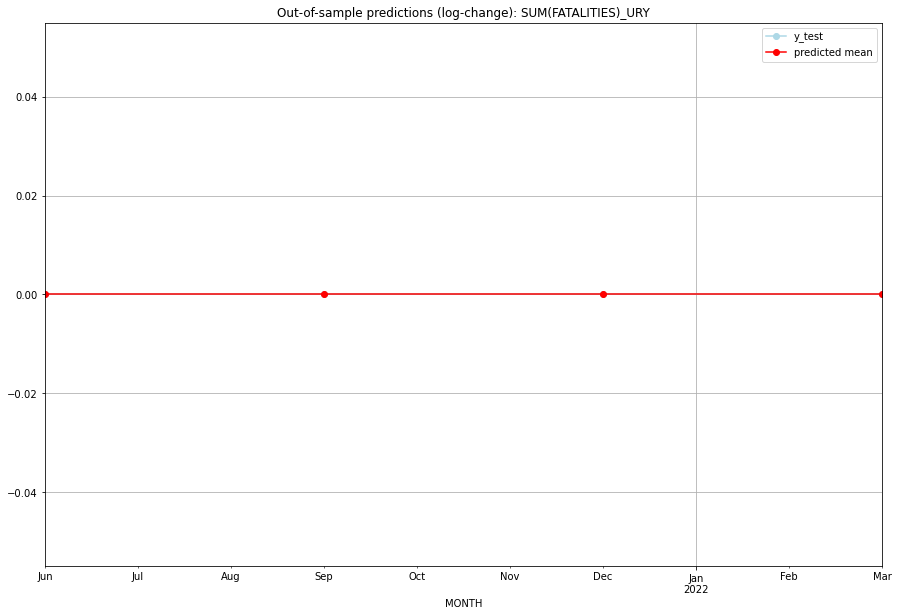

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   URY   
1 2021-07-01       0.0         0.0           0.0             0.0   URY   
2 2021-10-01       0.0         0.0           0.0             0.0   URY   
3 2022-01-01       0.0         0.0           0.0             0.0   URY   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:03
######## USA (216/234) #########
0
Neighbor countries: []
Getting Data for USA
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 63)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross v

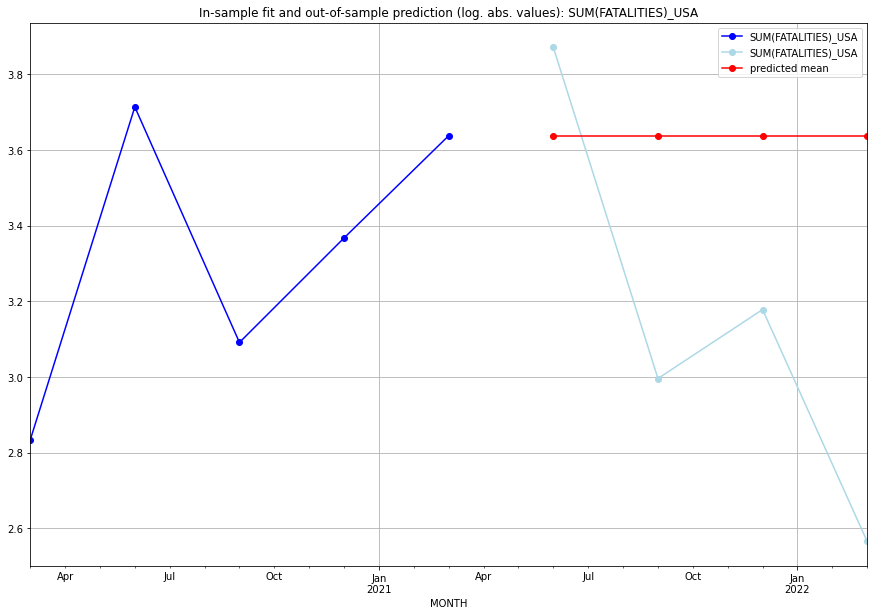

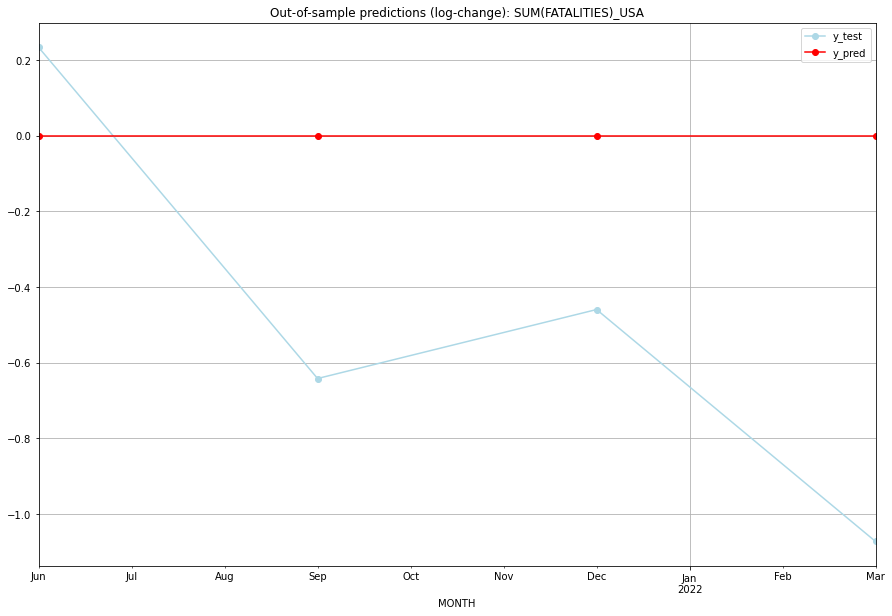

TADDA: 0.6019094672492973
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  3.637586    3.871201           0.0        0.233615   USA   
1 2021-07-01  3.637586    2.995732           0.0       -0.641854   USA   
2 2021-10-01  3.637586    3.178054           0.0       -0.459532   USA   
3 2022-01-01  3.637586    2.564949           0.0       -1.072637   USA   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## UZB (217/234) #########
0
Neighbor countries: []
Getting Data for UZB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 60)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.3841112659335586, 'fold_results': [0.47070336496106513, 0.297519166906052]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_UZB   No. Observations:                   13
Model:                SARIMAX(1, 0, 3)   Log Likelihood                  -8.134
Date:                 Wed, 19 Oct 2022   AIC                             26.268
Time:                         11:04:15   BIC                             29.092
Sample:                     01-31-2018   HQIC                            25.687
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8050      0.

<Figure size 432x288 with 0 Axes>

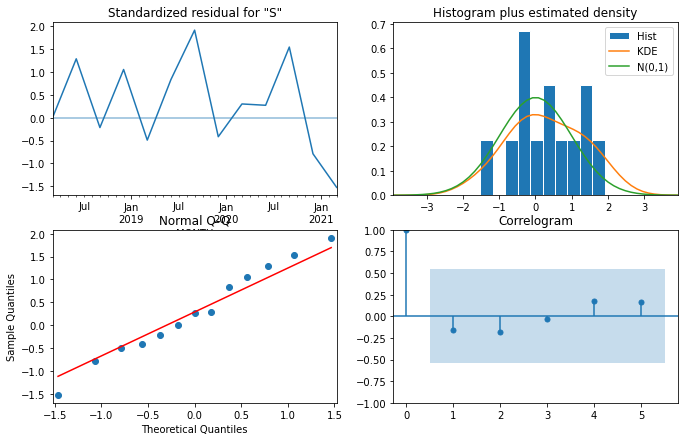

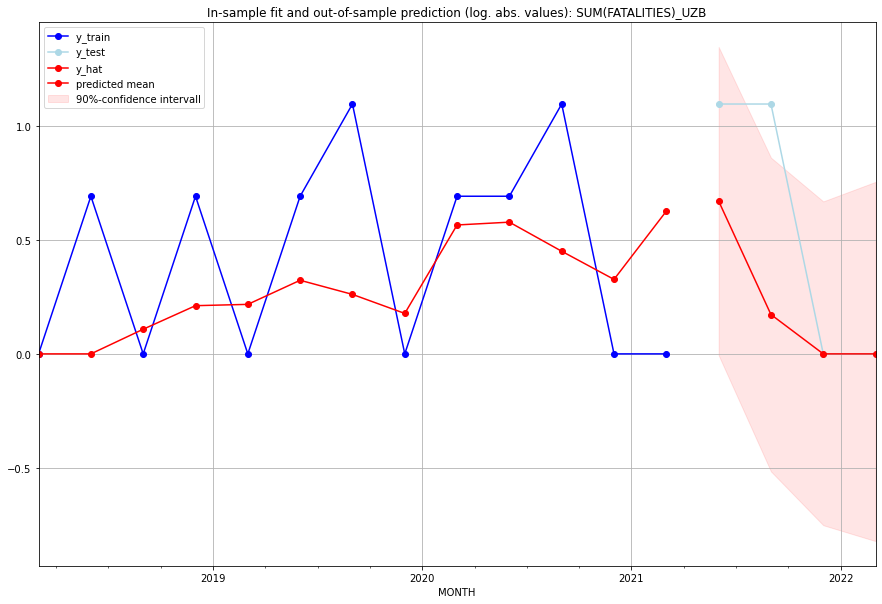

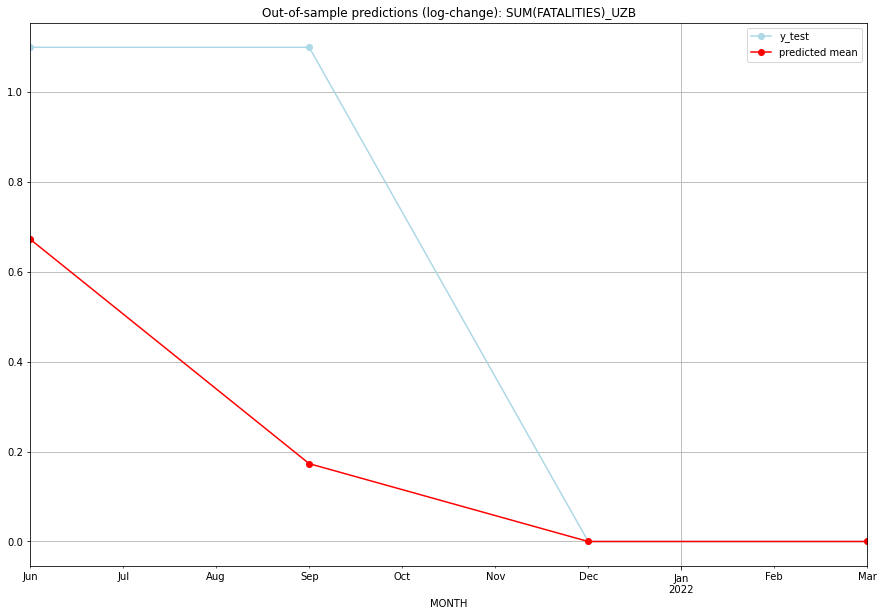

TADDA: 0.3380806741630573
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.957983         2.0      0.671915        1.098612   UZB   
1 2021-07-01  0.188850         2.0      0.172987        1.098612   UZB   
2 2021-10-01  0.000000         0.0      0.000000        0.000000   UZB   
3 2022-01-01  0.000000         0.0      0.000000        0.000000   UZB   

                                          PARAMETERS  
0  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:10
######## VAT (218/234) #########
0
Neighbor countries: []
Getting Data for VAT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 0)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient da

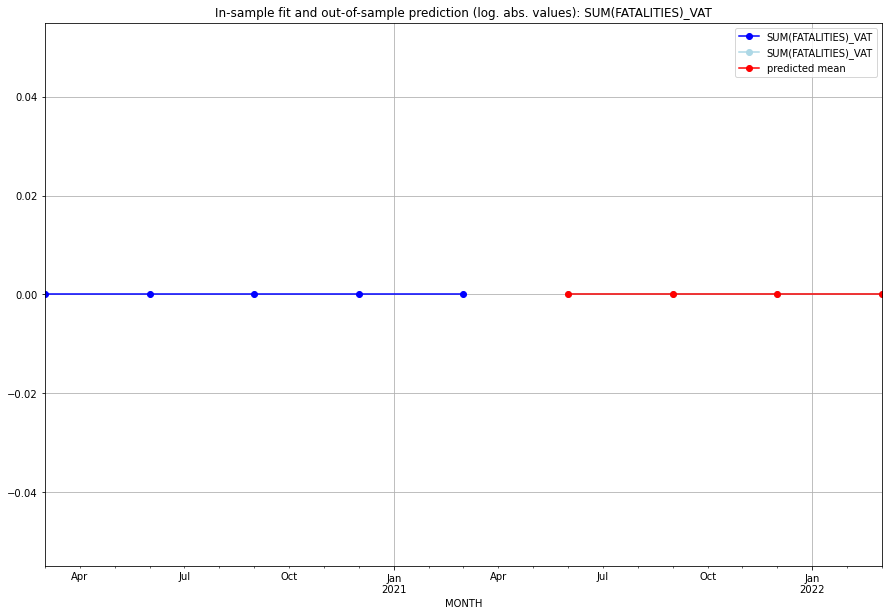

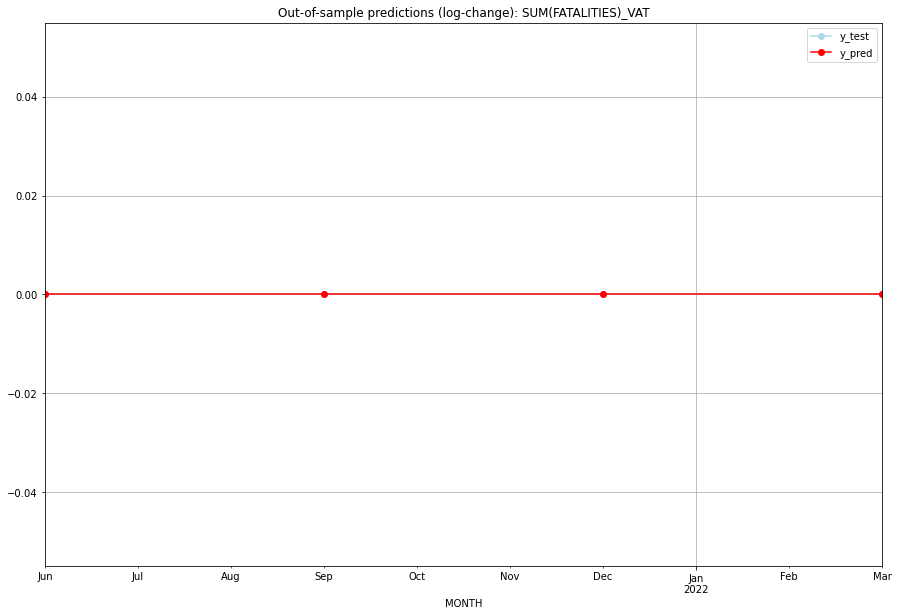

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   VAT   
1 2021-07-01       0.0         0.0           0.0             0.0   VAT   
2 2021-10-01       0.0         0.0           0.0             0.0   VAT   
3 2022-01-01       0.0         0.0           0.0             0.0   VAT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## VCT (219/234) #########
0
Neighbor countries: []
Getting Data for VCT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 49)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


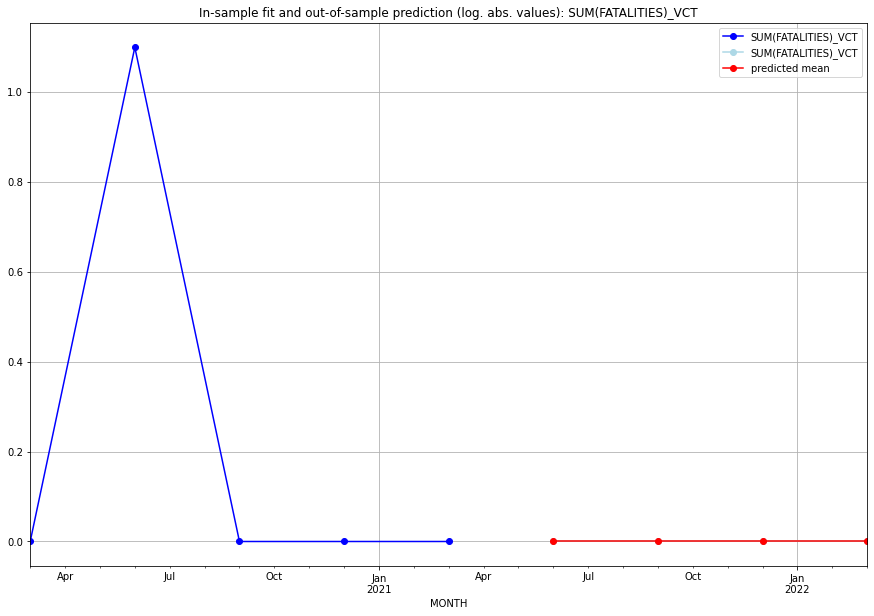

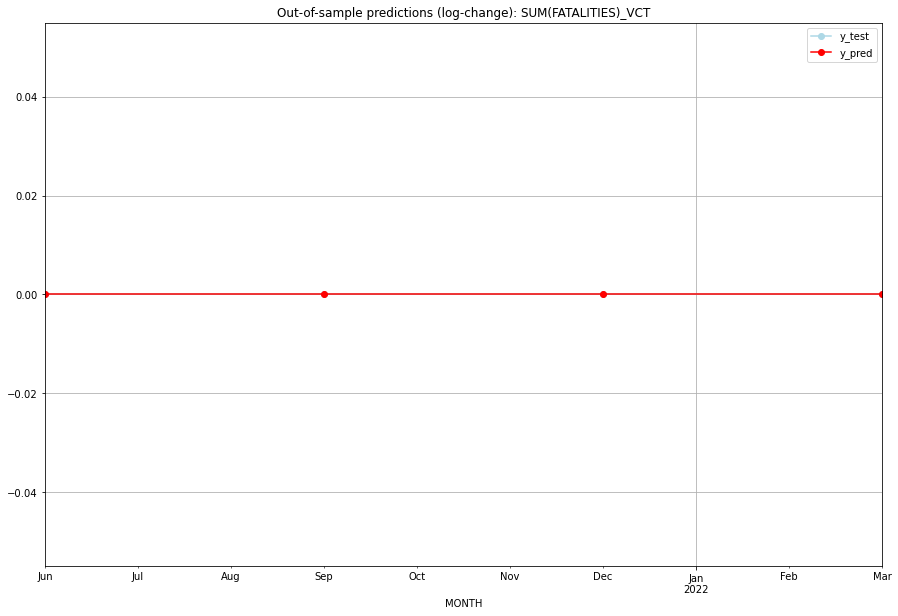

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   VCT   
1 2021-07-01       0.0         0.0           0.0             0.0   VCT   
2 2021-10-01       0.0         0.0           0.0             0.0   VCT   
3 2022-01-01       0.0         0.0           0.0             0.0   VCT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## VEN (220/234) #########
0
Neighbor countries: []
Getting Data for VEN
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 57)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.516079536340383, 'fold_results': [0.516079536340383, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_VEN   No. Observations:                   13
Model:                SARIMAX(3, 0, 2)   Log Likelihood                 -10.812
Date:                 Wed, 19 Oct 2022   AIC                             33.623
Time:                         11:04:32   BIC                             37.013
Sample:                     01-31-2018   HQIC                            32.927
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2957      1.430     -0.207   

<Figure size 432x288 with 0 Axes>

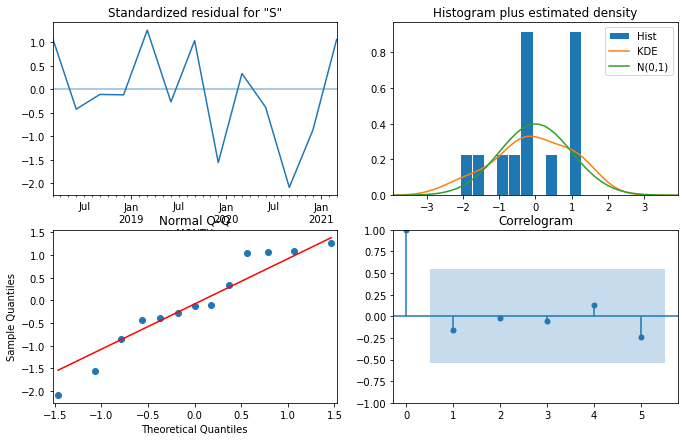

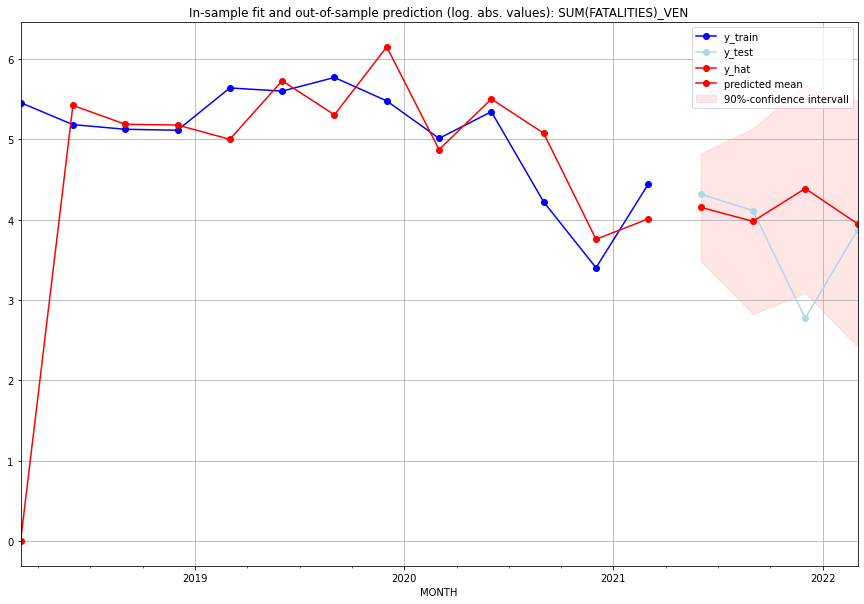

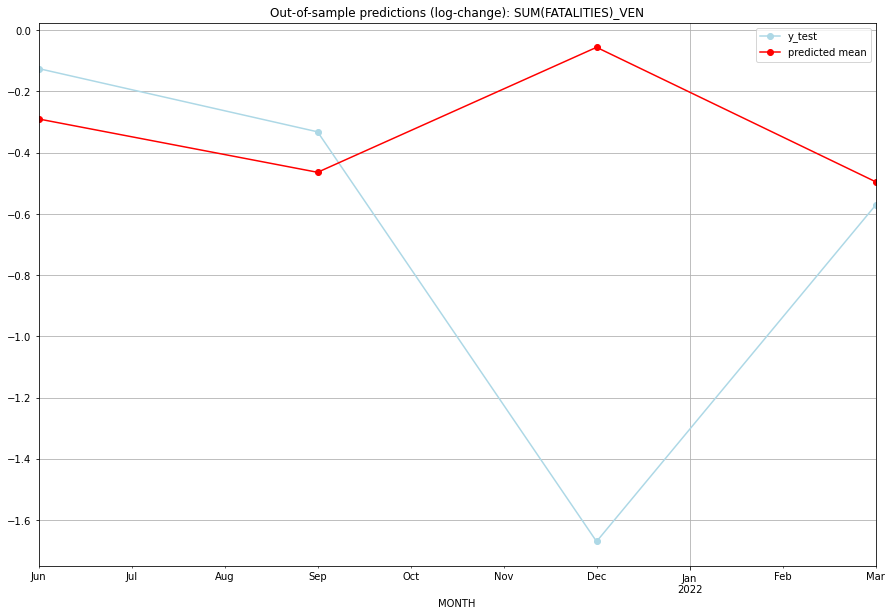

TADDA: 0.49695364642460604
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  62.617189        74.0     -0.289768       -0.125163   VEN   
1 2021-07-01  52.444377        60.0     -0.464010       -0.331777   VEN   
2 2021-10-01  79.395485        15.0     -0.055693       -1.670063   VEN   
3 2022-01-01  50.821724        47.0     -0.494842       -0.571450   VEN   

                                          PARAMETERS  
0  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:11
######## VIR (221/234) #########
0
Neighbor countries: []
Getting Data for VIR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (9, 23)
y: (9, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insuffic

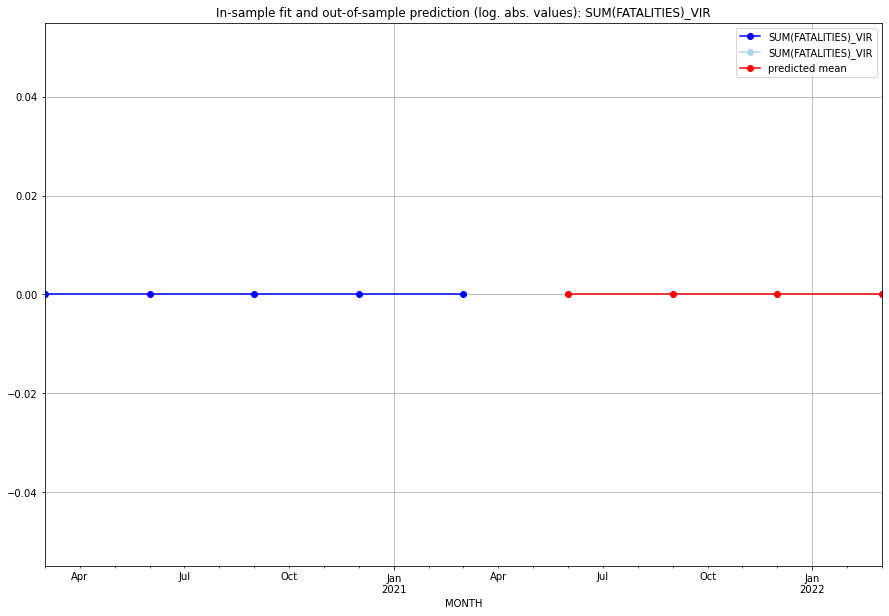

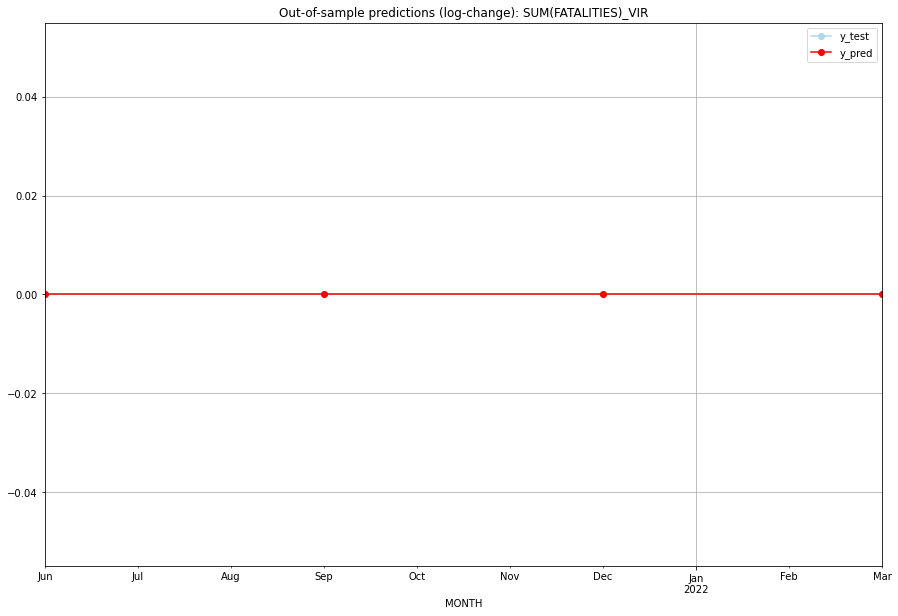

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   VIR   
1 2021-07-01       0.0         0.0           0.0             0.0   VIR   
2 2021-10-01       0.0         0.0           0.0             0.0   VIR   
3 2022-01-01       0.0         0.0           0.0             0.0   VIR   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## VNM (222/234) #########
0
Neighbor countries: []
Getting Data for VNM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (49, 61)
y: (49, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.46029869013184255, 'fold_results': [0.2947981538070475, 0.5834654132428096, 0.5051702097893463, 0.30714017951826966, 0.6109194943017399]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_VNM   No. Observations:                   45
Model:                SARIMAX(3, 1, 2)   Log Likelihood                 -51.933
Date:                 Wed, 19 Oct 2022   AIC                            121.865
Time:                         11:04:53   BIC                            137.923
Sample:                     01-31-2010   HQIC                           127.820
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

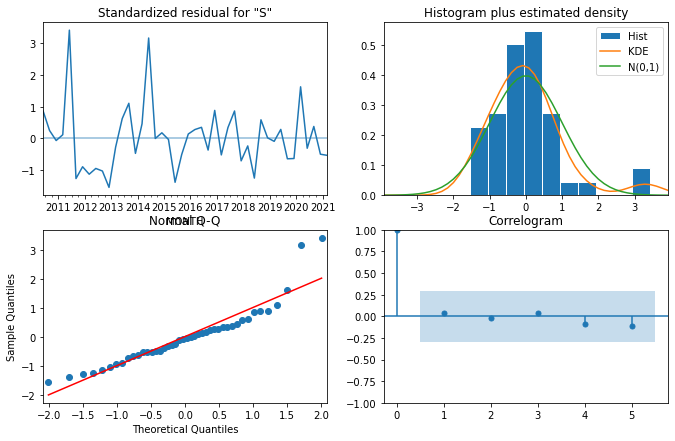

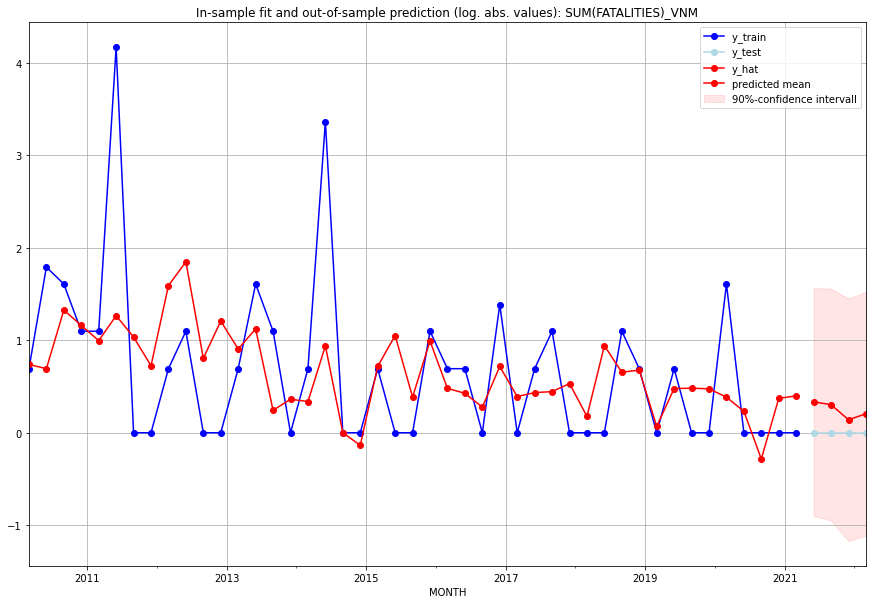

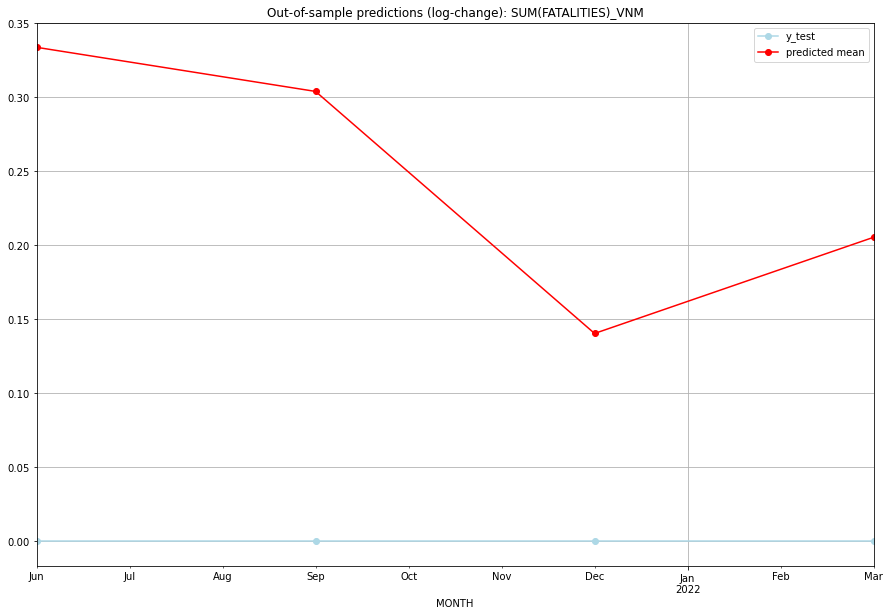

TADDA: 0.24594752311629545
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  0.396258         0.0      0.333796             0.0   VNM   
1 2021-07-01  0.355267         0.0      0.303999             0.0   VNM   
2 2021-10-01  0.150873         0.0      0.140521             0.0   VNM   
3 2022-01-01  0.228108         0.0      0.205475             0.0   VNM   

                                          PARAMETERS  
0  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:23
######## VUT (223/234) #########
0
Neighbor countries: []
Getting Data for VUT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 49)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient 

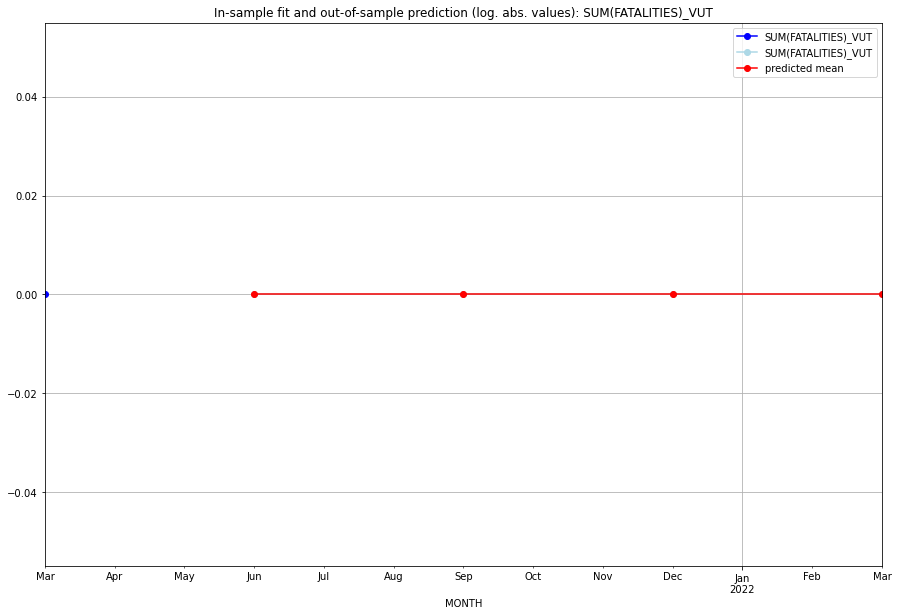

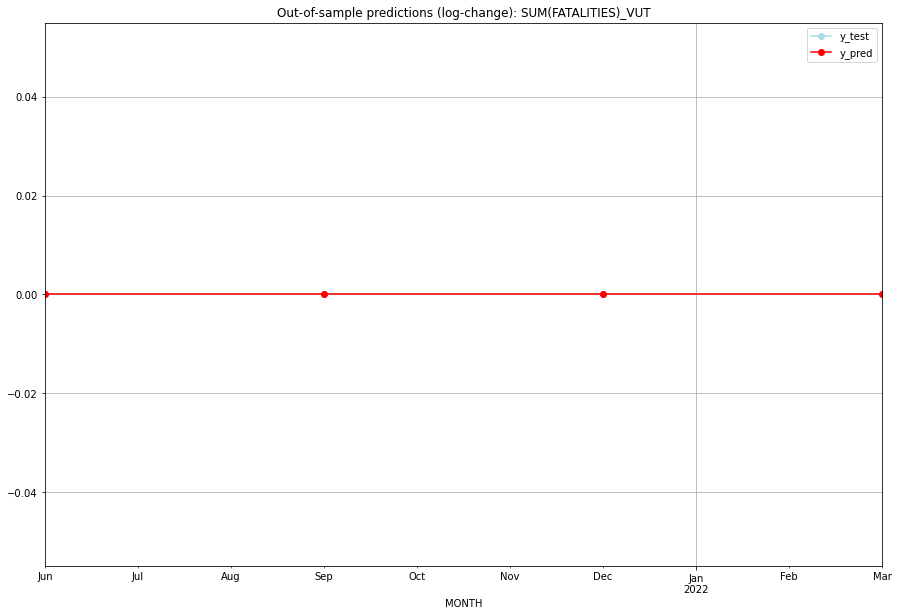

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   VUT   
1 2021-07-01       0.0         0.0           0.0             0.0   VUT   
2 2021-10-01       0.0         0.0           0.0             0.0   VUT   
3 2022-01-01       0.0         0.0           0.0             0.0   VUT   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:02
######## WLF (224/234) #########
0
Neighbor countries: []
Getting Data for WLF
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 0)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


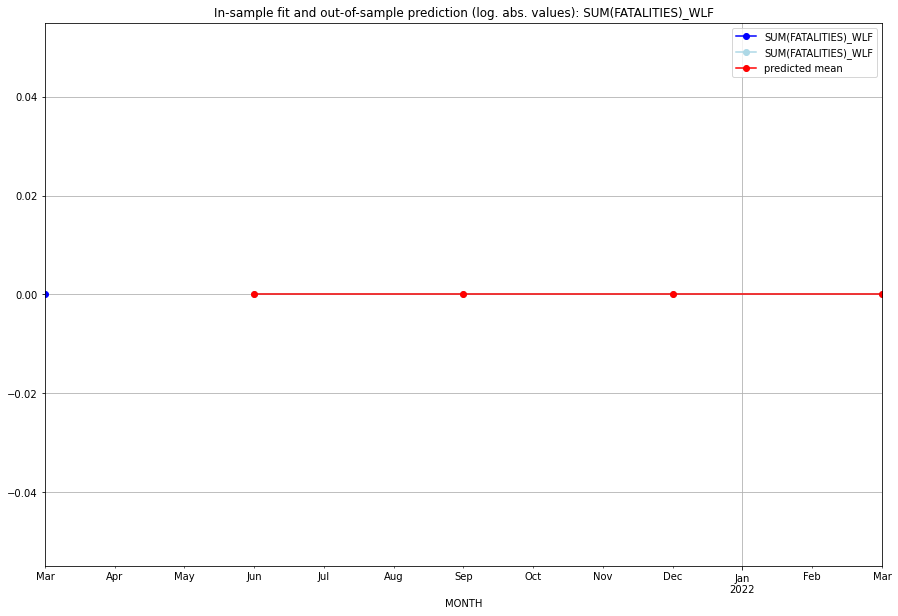

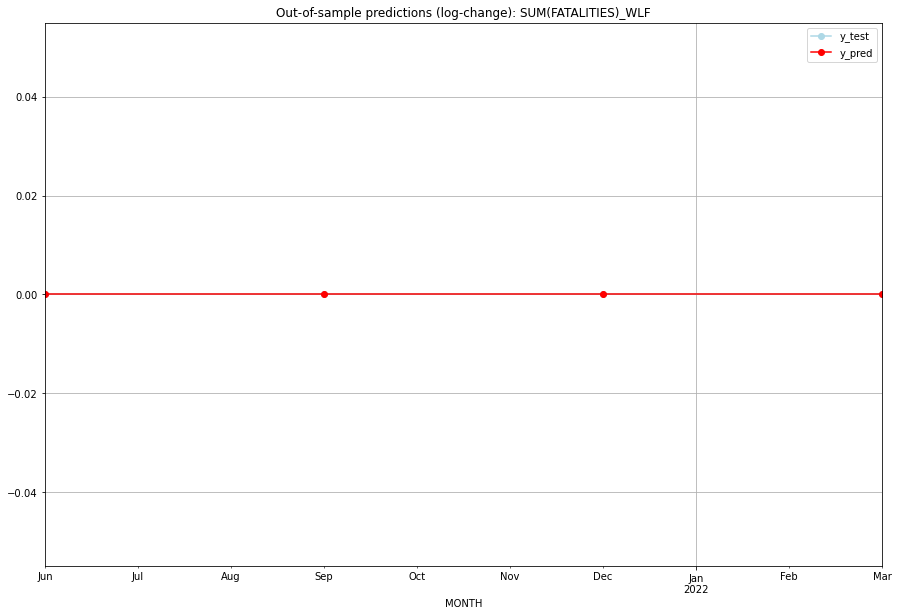

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   WLF   
1 2021-07-01       0.0         0.0           0.0             0.0   WLF   
2 2021-10-01       0.0         0.0           0.0             0.0   WLF   
3 2022-01-01       0.0         0.0           0.0             0.0   WLF   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:03
######## WSM (225/234) #########
0
Neighbor countries: []
Getting Data for WSM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (5, 50)
y: (5, 1)
------------------------------------------------
Training started.
GridSearchCV failed. Insufficient data for cross validation.
No model fitted --> Prediction with Naive Model 


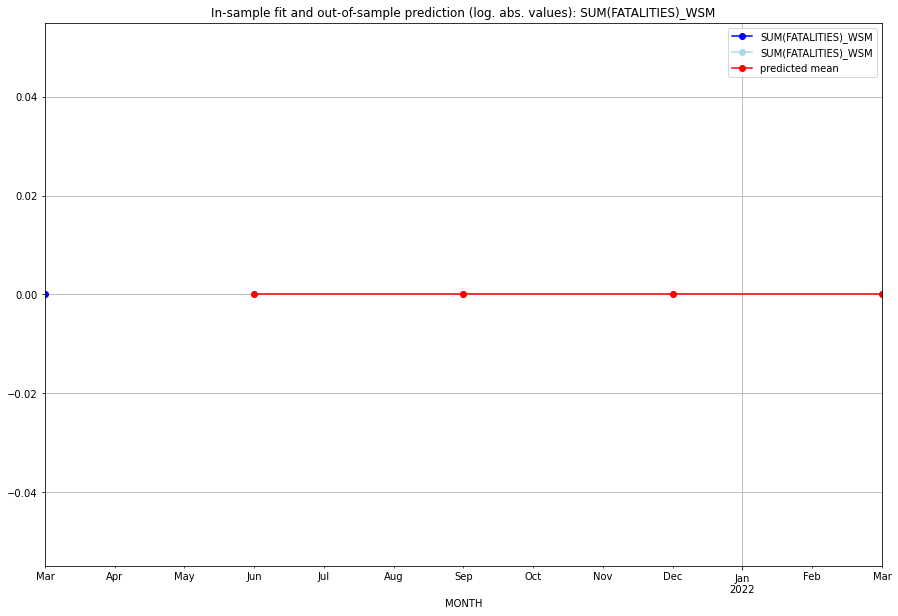

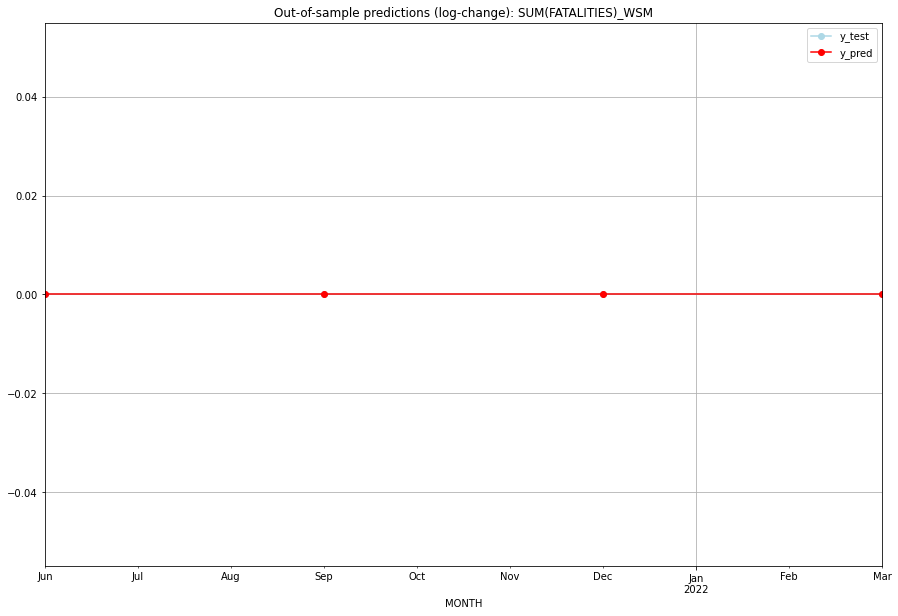

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   WSM   
1 2021-07-01       0.0         0.0           0.0             0.0   WSM   
2 2021-10-01       0.0         0.0           0.0             0.0   WSM   
3 2022-01-01       0.0         0.0           0.0             0.0   WSM   

   PARAMETERS  
0         NaN  
1         NaN  
2         NaN  
3         NaN  
Execution time: 00:04
######## XAR (226/234) #########
0
Neighbor countries: []
Getting Data for XAR
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 parameter combinations are tested.


  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 1.0193104839938416, 'fold_results': [1.8629056774873547, 0.45814536593707755, 0.8330511275438012, 1.151292546497023, 0.7911577025039509]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XAR   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -175.942
Date:                 Wed, 19 Oct 2022   AIC                            353.885
Time:                         11:05:25   BIC                            356.439
Sample:                     04-30-1997   HQIC                           354.917
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

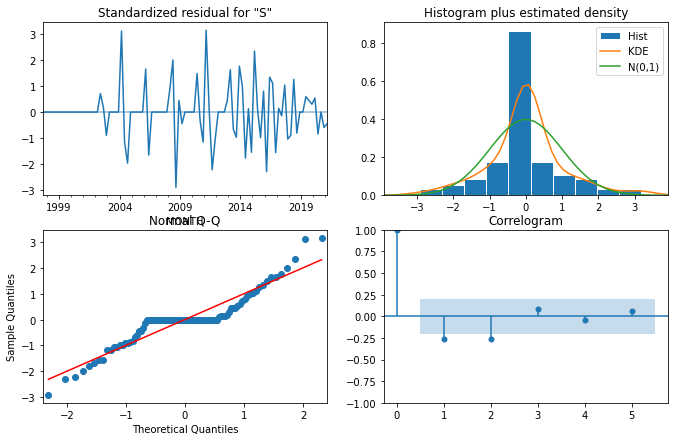

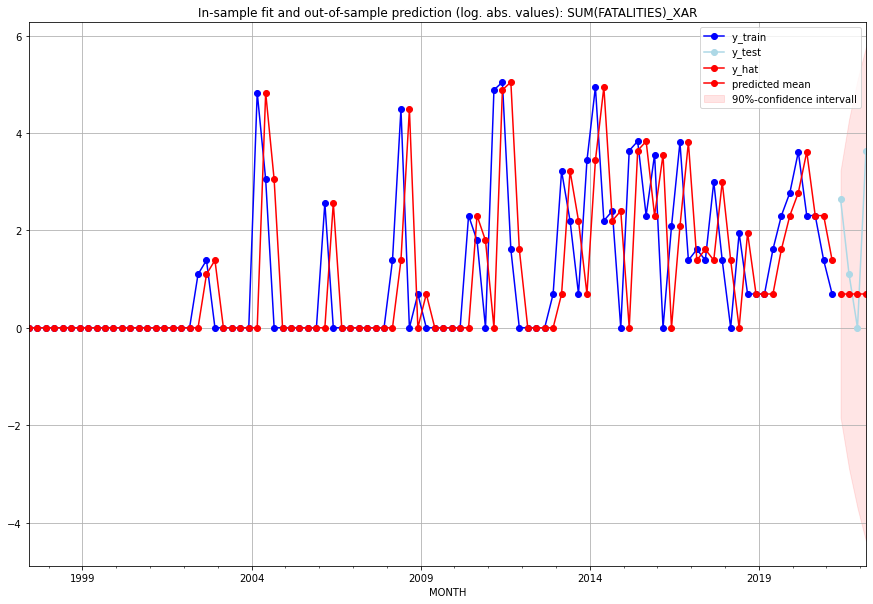

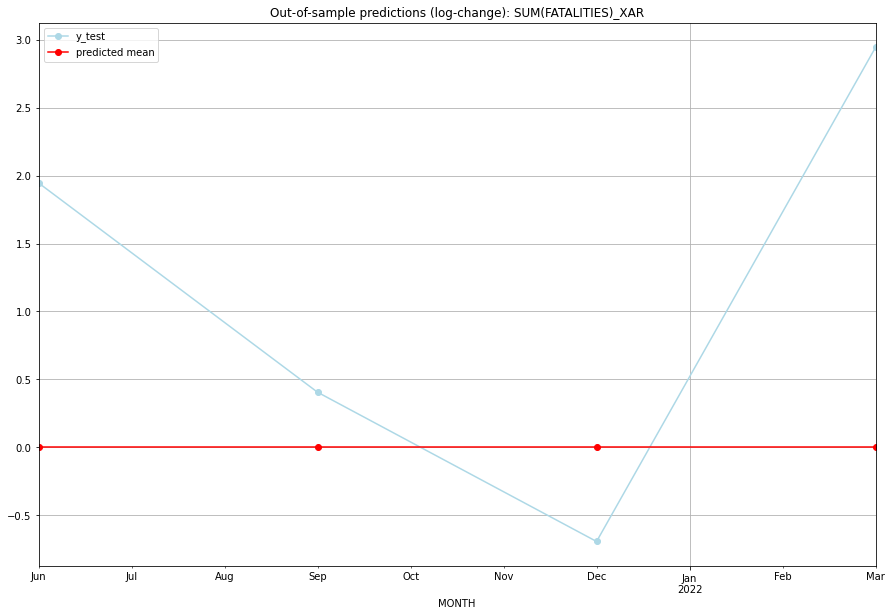

TADDA: 1.4972403542224657
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       1.0        13.0           0.0        1.945910   XAR   
1 2021-07-01       1.0         2.0           0.0        0.405465   XAR   
2 2021-10-01       1.0         0.0           0.0       -0.693147   XAR   
3 2022-01-01       1.0        37.0           0.0        2.944439   XAR   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:16
######## XIT (227/234) #########
0
Neighbor countries: []
Getting Data for XIT
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU co

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XIT   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                 -14.931
Date:                 Wed, 19 Oct 2022   AIC                             31.863
Time:                         11:05:35   BIC                             34.427
Sample:                     04-30-1997   HQIC                            32.899
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0799      0.002     37.614      0.000     

<Figure size 432x288 with 0 Axes>

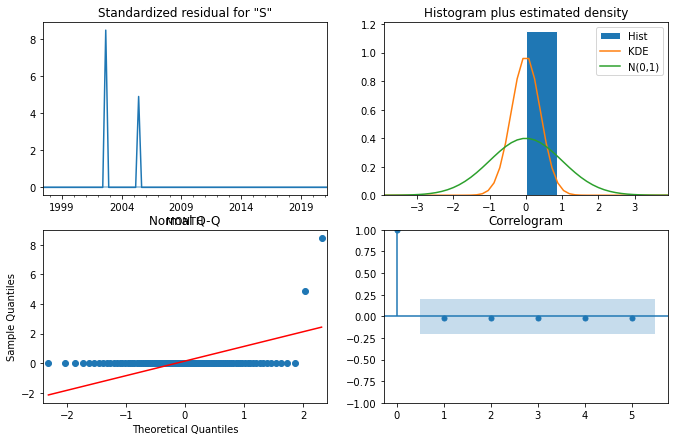

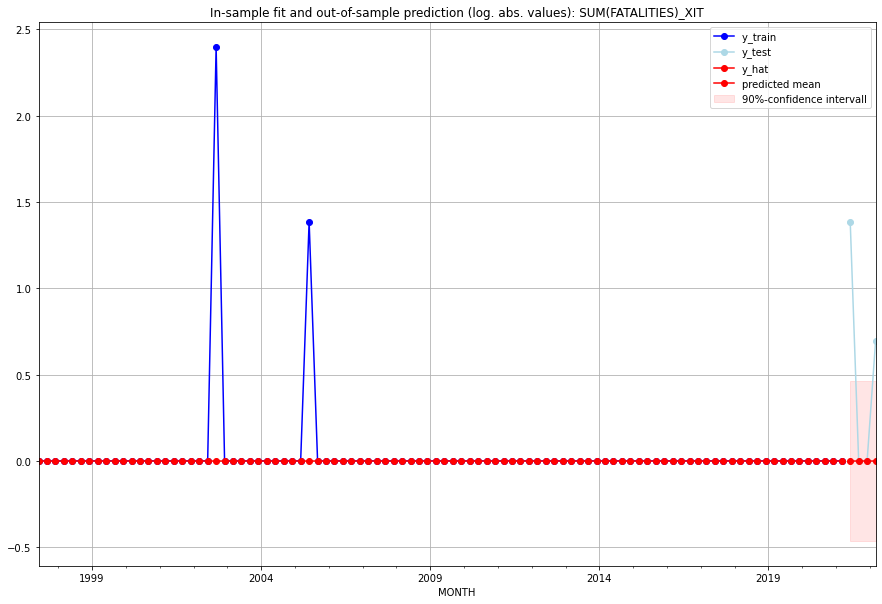

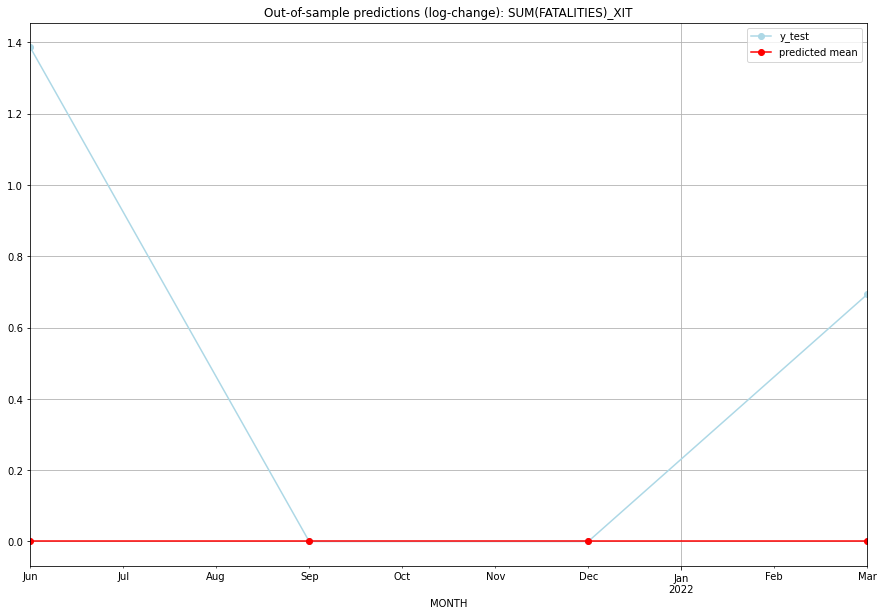

TADDA: 0.5198603854199589
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         3.0           0.0        1.386294   XIT   
1 2021-07-01       0.0         0.0           0.0        0.000000   XIT   
2 2021-10-01       0.0         0.0           0.0        0.000000   XIT   
3 2022-01-01       0.0         1.0           0.0        0.693147   XIT   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:08
######## XKK (228/234) #########
0
Neighbor countries: []
Getting Data for XKK
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 0)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU co

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08958797346140275, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.44793986730701374]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XKK   No. Observations:                   96
Model:                         SARIMAX   Log Likelihood                 -90.179
Date:                 Wed, 19 Oct 2022   AIC                            182.359
Time:                         11:05:47   BIC                            184.923
Sample:                     04-30-1997   HQIC                           183.395
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.3832      

<Figure size 432x288 with 0 Axes>

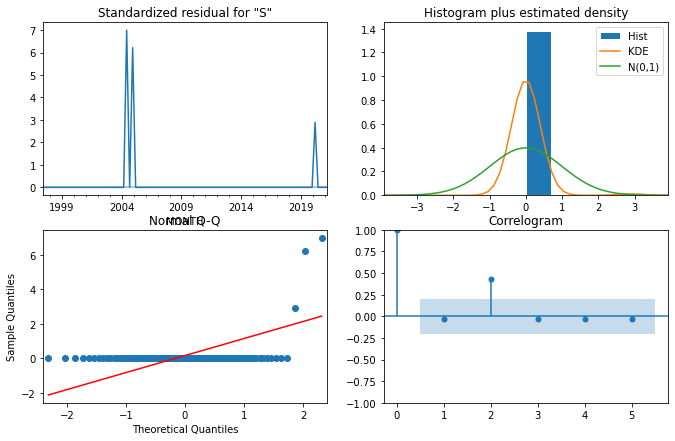

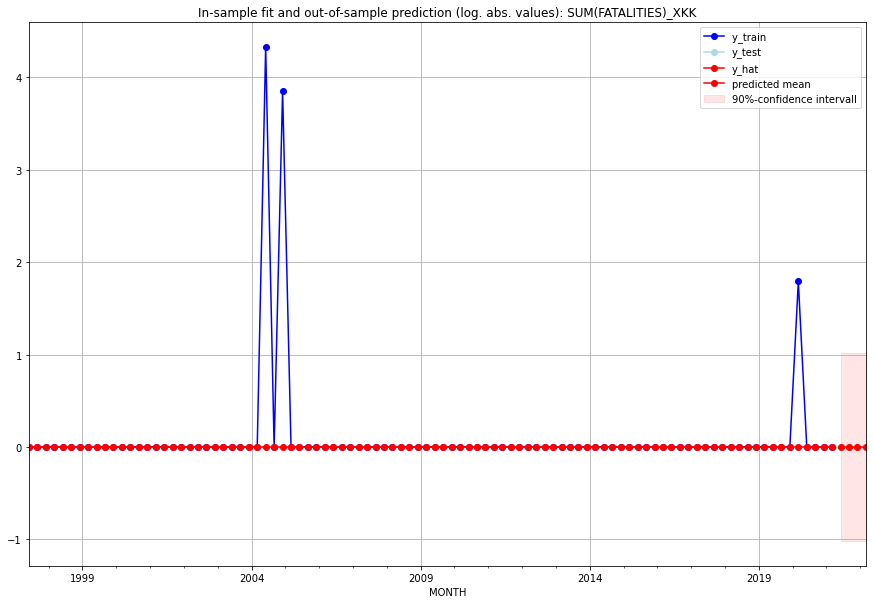

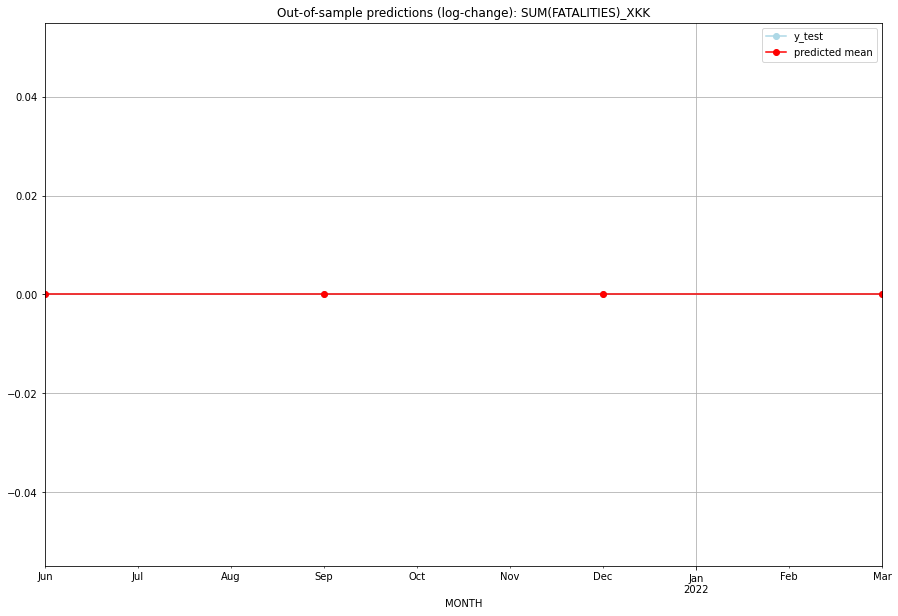

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   XKK   
1 2021-07-01       0.0         0.0           0.0             0.0   XKK   
2 2021-10-01       0.0         0.0           0.0             0.0   XKK   
3 2022-01-01       0.0         0.0           0.0             0.0   XKK   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:13
######## XKO (229/234) #########
0
Neighbor countries: []
Getting Data for XKO
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 paramete

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XKO   No. Observations:                   13
Model:                         SARIMAX   Log Likelihood                  -7.471
Date:                 Wed, 19 Oct 2022   AIC                             16.941
Time:                         11:05:52   BIC                             17.506
Sample:                     01-31-2018   HQIC                            16.825
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1848      0.037      5.048      0.000       0.113       0

<Figure size 432x288 with 0 Axes>

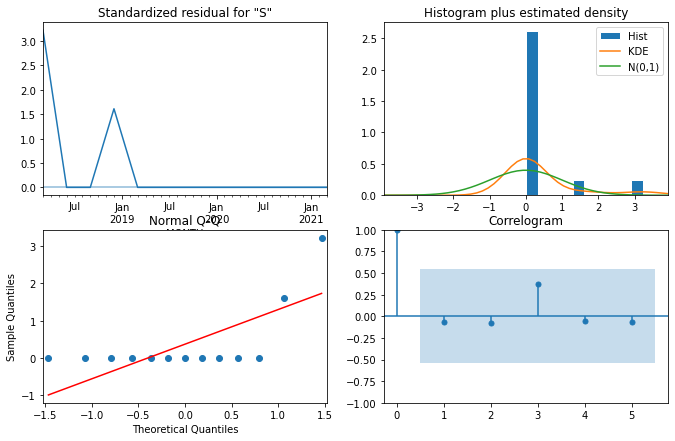

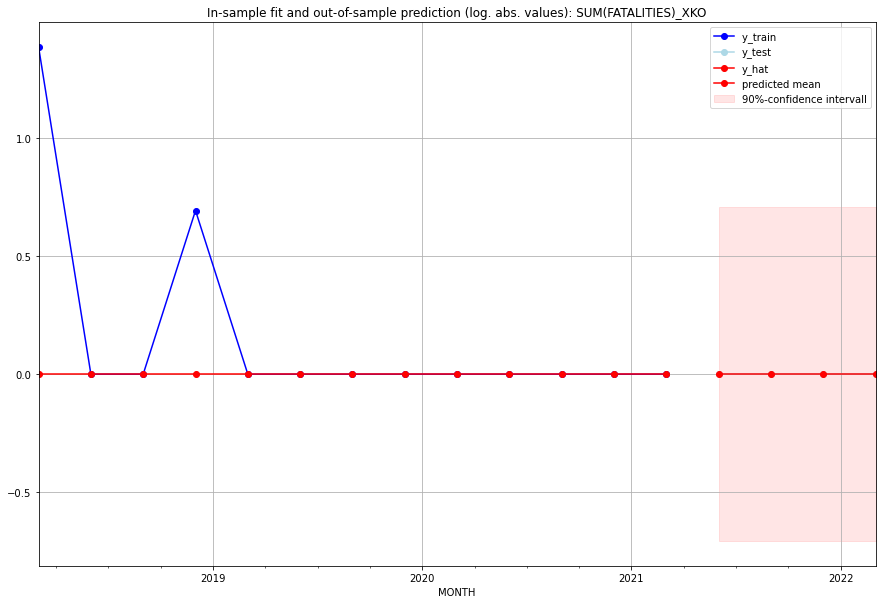

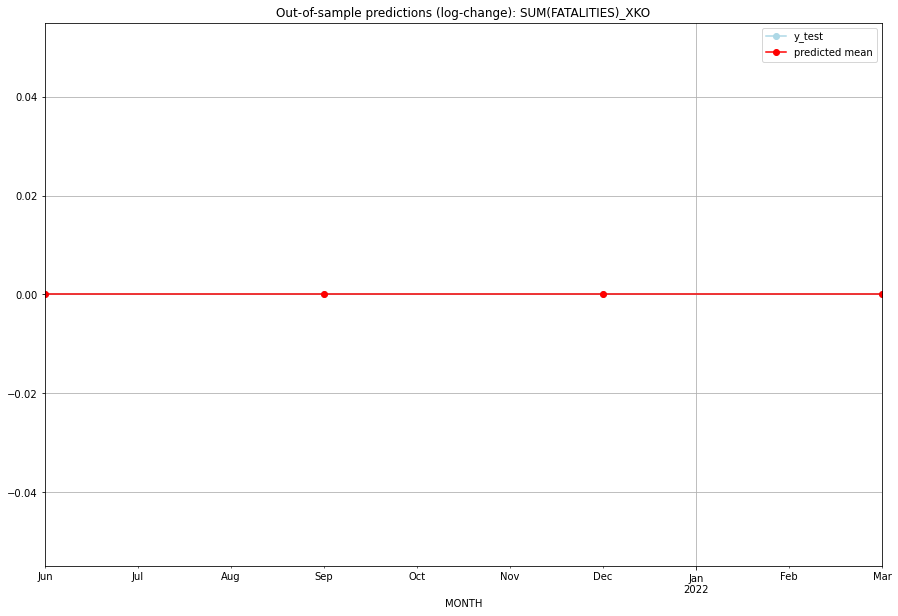

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   XKO   
1 2021-07-01       0.0         0.0           0.0             0.0   XKO   
2 2021-10-01       0.0         0.0           0.0             0.0   XKO   
3 2022-01-01       0.0         0.0           0.0             0.0   XKO   

                                          PARAMETERS  
0  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:03
######## XNC (230/234) #########
0
Neighbor countries: []
Getting Data for XNC
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (17, 0)
y: (17, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 paramete

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0866433932750534, 'fold_results': [0.1732867865501068, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XNC   No. Observations:                   13
Model:                SARIMAX(2, 0, 0)   Log Likelihood                   0.109
Date:                 Wed, 19 Oct 2022   AIC                              5.782
Time:                         11:05:55   BIC                              7.477
Sample:                     01-31-2018   HQIC                             5.434
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1       1.927e-06    4.2e+04   4.59e-11 

<Figure size 432x288 with 0 Axes>

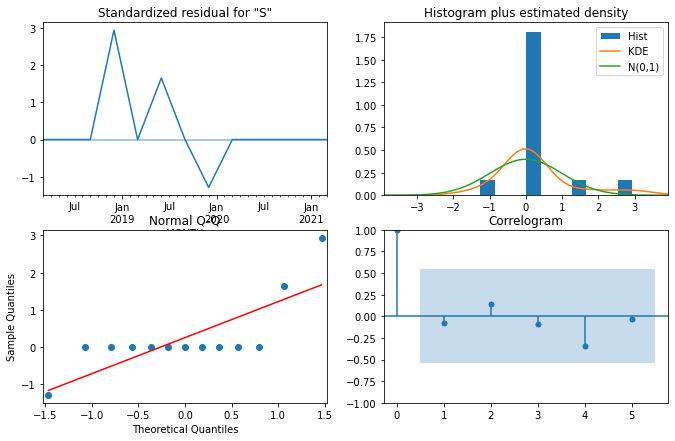

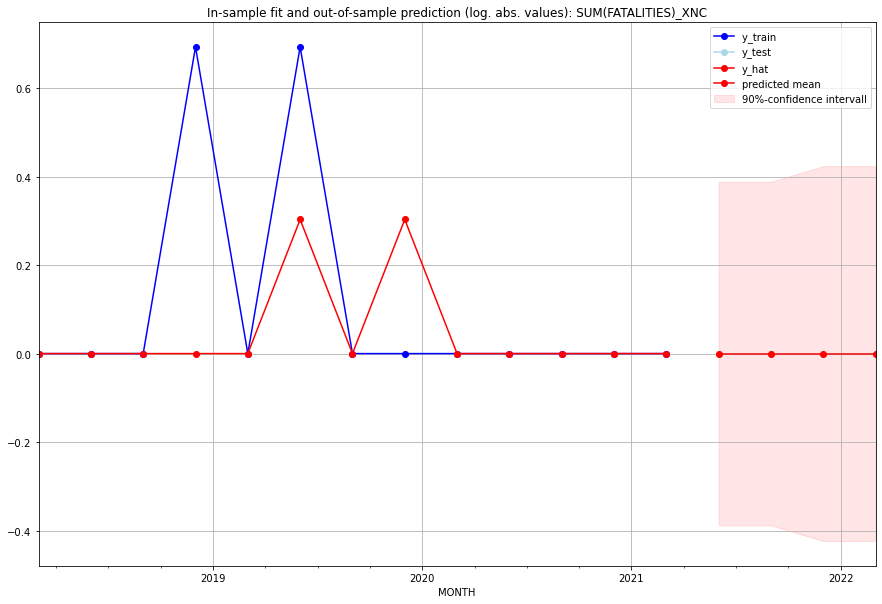

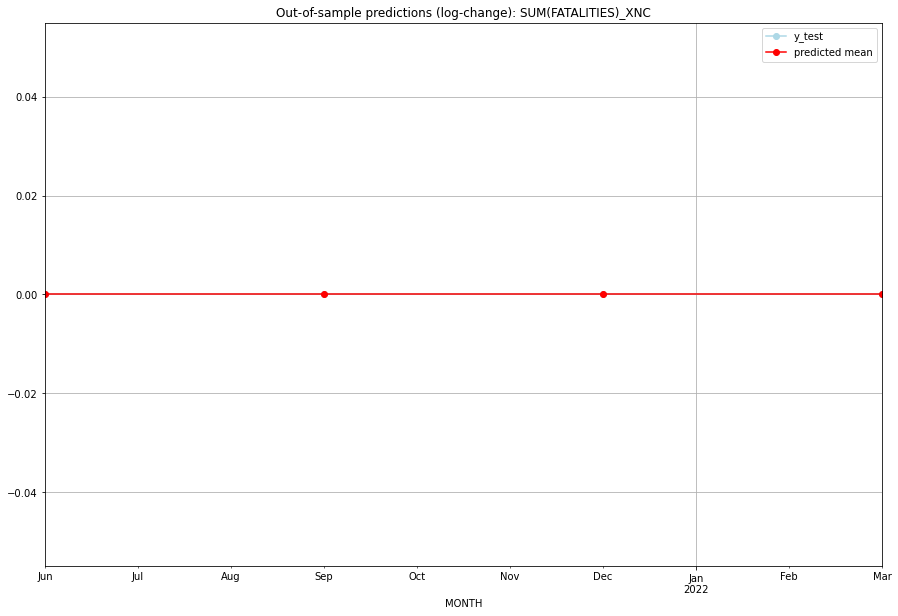

TADDA: 0.0
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       0.0         0.0           0.0             0.0   XNC   
1 2021-07-01       0.0         0.0           0.0             0.0   XNC   
2 2021-10-01       0.0         0.0           0.0             0.0   XNC   
3 2022-01-01       0.0         0.0           0.0             0.0   XNC   

                                          PARAMETERS  
0  {'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:03
######## YEM (231/234) #########
0
Neighbor countries: []
Getting Data for YEM
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (29, 60)
y: (29, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU cores:
128 paramet

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.26357098329827855, 'fold_results': [0.2973938111036474, 0.33240705654140523, nan, 0.27850926354669525, 0.14597380200136634]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_YEM   No. Observations:                   25
Model:                SARIMAX(1, 1, 3)   Log Likelihood                  -9.954
Date:                 Wed, 19 Oct 2022   AIC                             29.908
Time:                         11:06:15   BIC                             35.799
Sample:                     01-31-2015   HQIC                            31.471
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------

<Figure size 432x288 with 0 Axes>

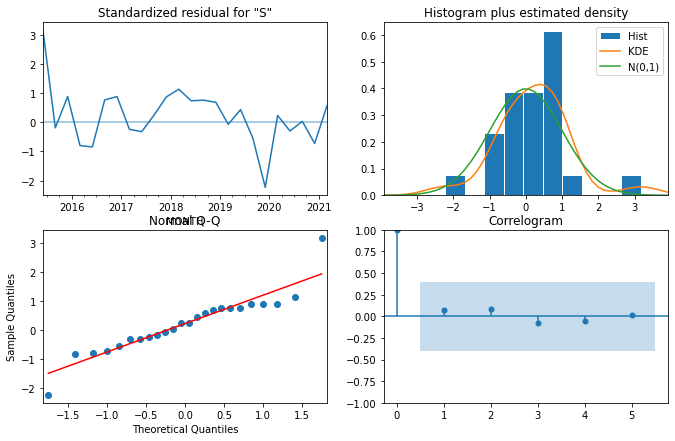

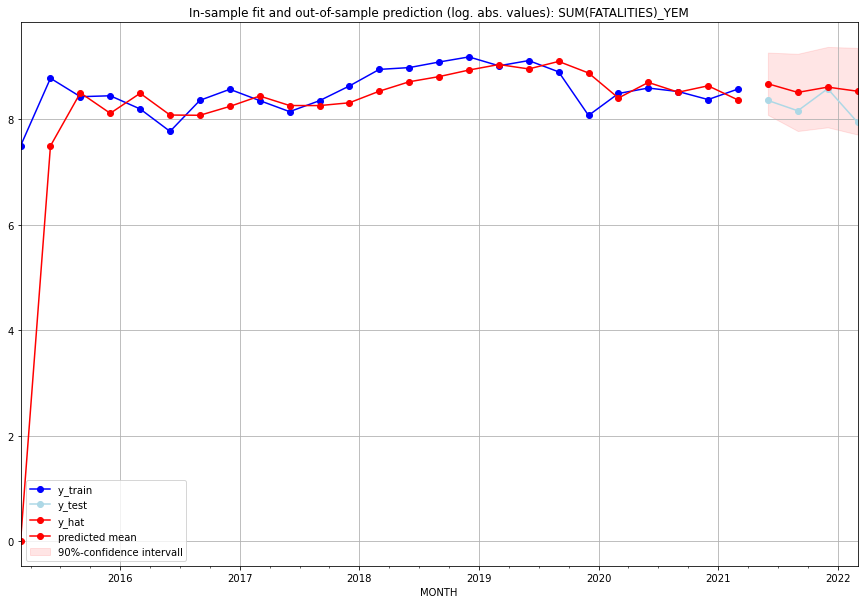

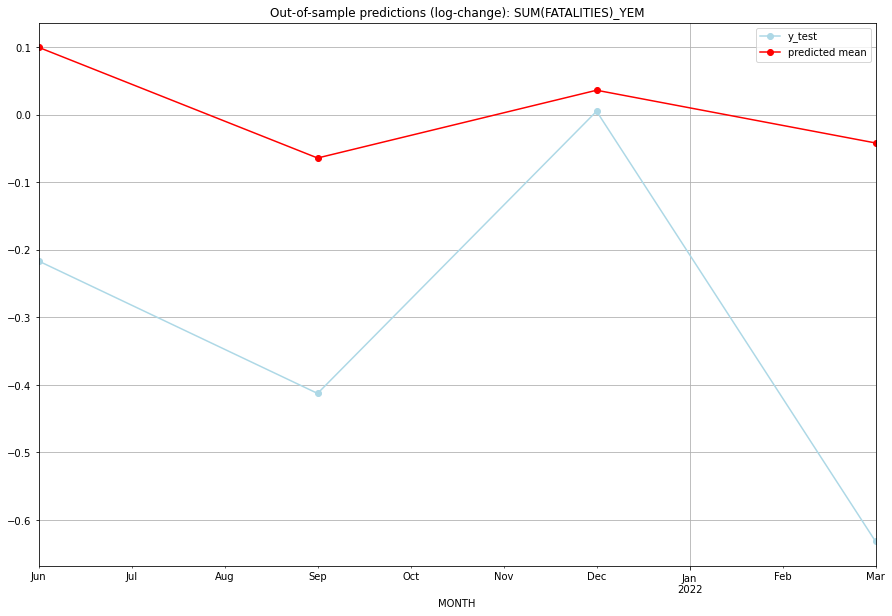

TADDA: 0.34636341656409564
Evaluation finished.
       MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  5842.648001      4258.0      0.099726       -0.216595   YEM   
1 2021-07-01  4959.459735      3500.0     -0.064131       -0.412581   YEM   
2 2021-10-01  5482.885486      5315.0      0.036185        0.005092   YEM   
3 2022-01-01  5071.126623      2811.0     -0.041869       -0.631733   YEM   

                                          PARAMETERS  
0  {'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22
######## ZAF (232/234) #########
0
Neighbor countries: []
Getting Data for ZAF
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 64)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARC

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.32570555289196124, 'fold_results': [0.19871979341703228, 0.4094143971456231, 0.22498636527103721, 0.5775721327029308, 0.21783507592318285]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ZAF   No. Observations:                   96
Model:                SARIMAX(2, 0, 3)   Log Likelihood                -106.674
Date:                 Wed, 19 Oct 2022   AIC                            229.348
Time:                         11:06:33   BIC                            249.863
Sample:                     04-30-1997   HQIC                           237.641
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------

<Figure size 432x288 with 0 Axes>

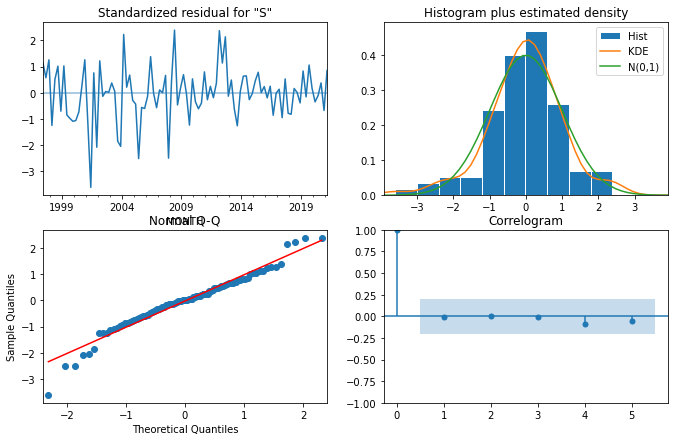

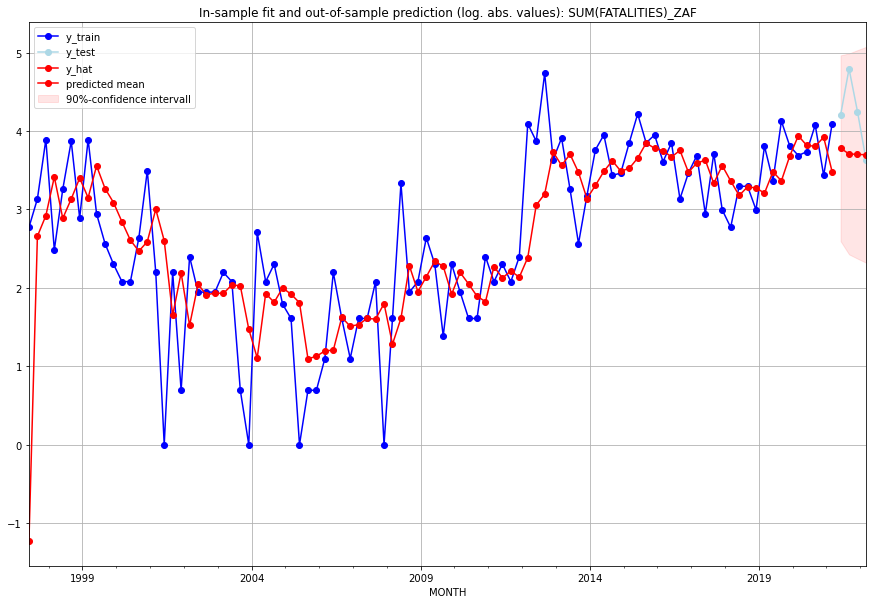

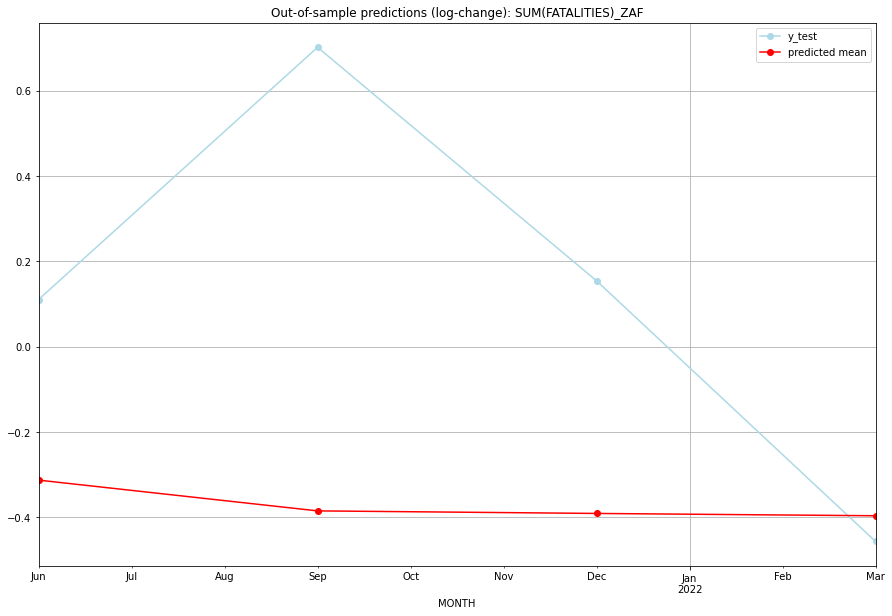

TADDA: 0.801061502881006
Evaluation finished.
       MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01  42.877389        66.0     -0.312945        0.110348   ZAF   
1 2021-07-01  39.826159       120.0     -0.385022        0.701446   ZAF   
2 2021-10-01  39.582079        69.0     -0.391018        0.154151   ZAF   
3 2022-01-01  39.363161        37.0     -0.396427       -0.456758   ZAF   

                                          PARAMETERS  
0  {'params': [2, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
1  {'params': [2, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
2  {'params': [2, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
3  {'params': [2, (2, 0, 3), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:19
######## ZMB (233/234) #########
0
Neighbor countries: []
Getting Data for ZMB
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 59)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 C

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.7043129785983078, 'fold_results': [0.4479398673070139, 0.34657359027997264, 0.7996682793876702, 0.9395722263715257, 0.987810929645357]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ZMB   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -149.768
Date:                 Wed, 19 Oct 2022   AIC                            301.536
Time:                         11:06:48   BIC                            304.090
Sample:                     04-30-1997   HQIC                           302.568
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

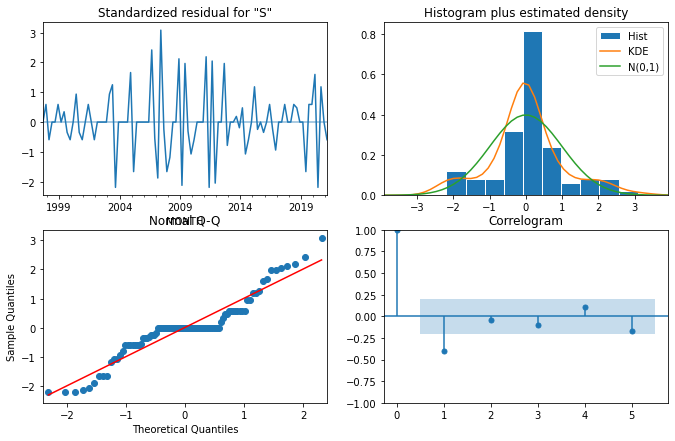

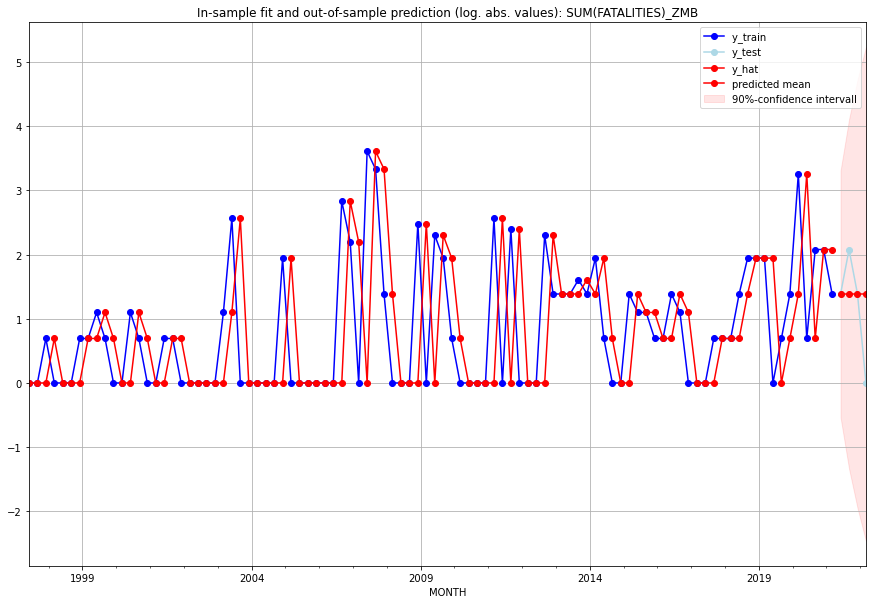

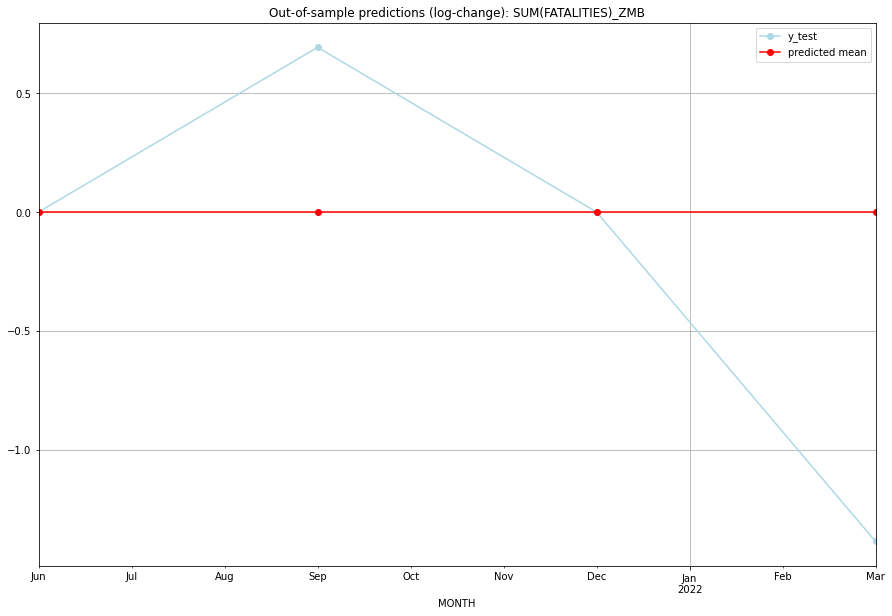

TADDA: 0.5198603854199593
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       3.0         3.0  2.220446e-16        0.000000   ZMB   
1 2021-07-01       3.0         7.0  2.220446e-16        0.693147   ZMB   
2 2021-10-01       3.0         3.0  2.220446e-16        0.000000   ZMB   
3 2022-01-01       3.0         0.0  2.220446e-16       -1.386294   ZMB   

                                          PARAMETERS  
0  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:12
######## ZWE (234/234) #########
0
Neighbor countries: []
Getting Data for ZWE
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (100, 57)
y: (100, 1)
------------------------------------------------
Training started.
Start GRIDSEARCH CV on 48 CPU c

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6494415992389899, 'fold_results': [0.8208535865014424, 0.5858517718785724, 0.35877113132233185, 0.6314321610770641, 0.8502993454155389]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ZWE   No. Observations:                   96
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -139.138
Date:                 Wed, 19 Oct 2022   AIC                            286.276
Time:                         11:07:09   BIC                            296.491
Sample:                     04-30-1997   HQIC                           290.404
                          - 01-31-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

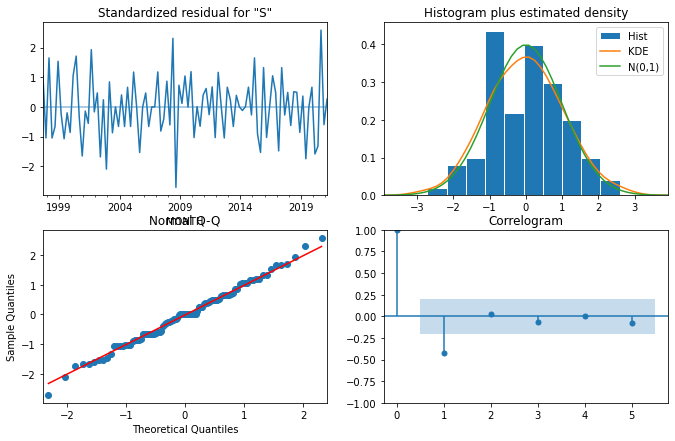

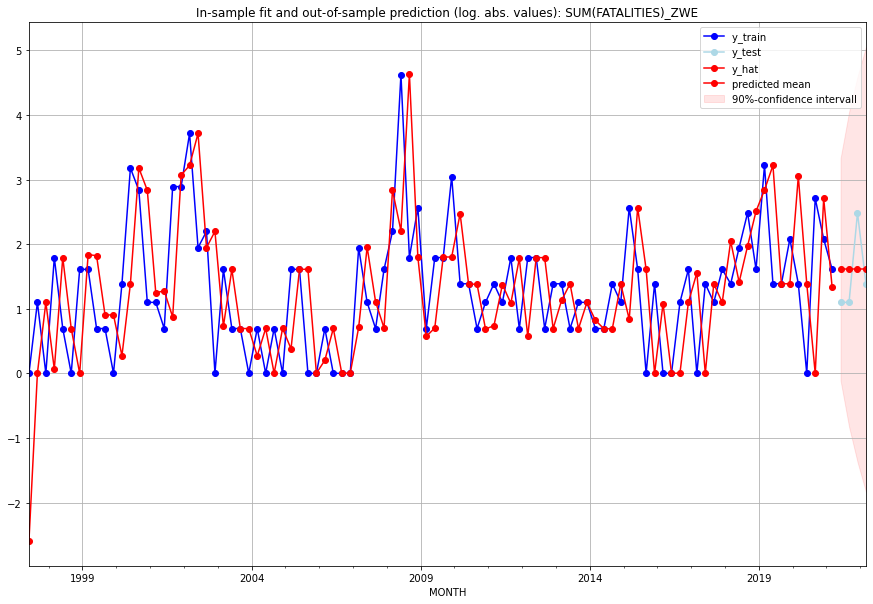

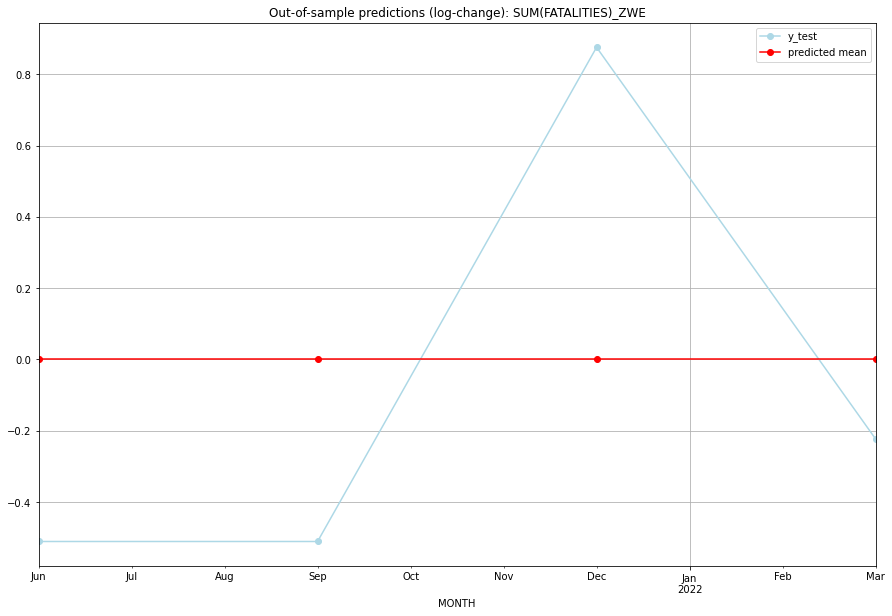

TADDA: 0.5300658840500239
Evaluation finished.
       MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0 2021-04-01       4.0         2.0  8.881784e-16       -0.510826   ZWE   
1 2021-07-01       4.0         2.0  8.881784e-16       -0.510826   ZWE   
2 2021-10-01       4.0        11.0  8.881784e-16        0.875469   ZWE   
3 2022-01-01       4.0         3.0  8.881784e-16       -0.223144   ZWE   

                                          PARAMETERS  
0  {'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
1  {'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
2  {'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
3  {'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...  
Execution time: 00:22


In [8]:
# warnings.simplefilter(action='ignore')

sarimax_res = pd.DataFrame(columns=["MONTH", "FAT_PRED", "FAT_ACTUAL", "LC(FAT_PRED)", "LC(FAT_ACTUAL)", "GID_0", "PARAMETERS", "TIMESTAMP"])
csv_file = "../data/"+MODEL_NAME+"_PREDICTIONS.csv"

if os.path.exists(csv_file):
    existing_res = pd.read_csv("../data/"+MODEL_NAME+"_PREDICTIONS.csv")
    # print(existing_res)
    print("File already exists.")
    
else:
    sarimax_res.to_csv(csv_file, index=False, mode="a", header=True)
    existing_res = sarimax_res

for i, g in enumerate(gid_list):
# for i, g in enumerate(["XNC"]):
    print("######## "+g+" ("+str(i+1)+"/"+str(len(gid_list))+") #########")
    # print(existing_res[existing_res["GID_0"] == g])
    print(len(existing_res[existing_res["GID_0"] == g]))
    
    
    # skip country if results already exiast
    if len(existing_res[existing_res["GID_0"] == g]) > 0:
        print("Model for this country has already been fitted.")
        continue
    
    # add time series of neighboring  countries as predictor variables

    if NEIGHBORS == True:
        neighbor = gid0_neighbors[gid0_neighbors["GID_0"] == g]["NEIGHBOUR"].tolist()
    else:
        neighbor = []
    print("Neighbor countries: "+ str(neighbor))

    # measure time 
    st = time.time()

    res = sarimax(target_variable = TARGET_VARIABLE,
                  target_country = g,
                  predictor_countries = neighbor,
                  n_lags_X = N_LAGS_X,
                  seasonal_periodicity = SEASONAL_PERIODICITY)

    # append country results to csv with timestamp
    res["TIMESTAMP"] = datetime.datetime.now()
    
    res.to_csv(csv_file, index=False, mode="a", header=False)

    et = time.time()
    elapsed_time = et - st
    print('Execution time:', time.strftime("%M:%S", time.gmtime(elapsed_time)))

    sarimax_res = pd.concat([sarimax_res, res], ignore_index=True)

    # break

In [9]:
# varimax_res.to_csv("../data/"+MODEL_NAME+"_PREDICTIONS.csv", index=False)

In [10]:
sarimax_res

,MONTH,FAT_PRED,FAT_ACTUAL,LC(FAT_PRED),LC(FAT_ACTUAL),GID_0,PARAMETERS,TIMESTAMP
0,2021-04-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:31.973869
1,2021-07-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:31.973869
2,2021-10-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:31.973869
3,2022-01-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:31.973869
4,2021-04-01 00:00:00,9236.984675,18574.0,0.117119,0.815611,AFG,"{'params': [1, (3, 0, 2), (0, 0, 0, 0), 'n'], ...",2022-10-19 10:24:07.818918
...,...,...,...,...,...,...,...,...
931,2022-01-01 00:00:00,3.0,0.0,0.0,-1.386294,ZMB,"{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:06:51.314238
932,2021-04-01 00:00:00,4.0,2.0,0.0,-0.510826,ZWE,"{'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:07:13.364045
933,2021-07-01 00:00:00,4.0,2.0,0.0,-0.510826,ZWE,"{'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:07:13.364045
934,2021-10-01 00:00:00,4.0,11.0,0.0,0.875469,ZWE,"{'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:07:13.364045
